In [1]:
import math
import pandas as pd
import tensorflow as tf
# import keras_tuner.tuners as kt
import matplotlib.pyplot as plt
from tensorflow.keras import Model
from tensorflow.keras import Sequential
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.layers import Dense, Dropout
from sklearn.model_selection import train_test_split
from tensorflow.keras.losses import MeanSquaredLogarithmicError
import numpy as np
import pickle
np.random.seed(0)
# from sklearn.datasets import fetch_california_housing

# https://www.analyticsvidhya.com/blog/2021/06/dimensionality-reduction-using-autoencoders-in-python/#:~:text=AutoEncoder%20is%20an%20unsupervised%20Artificial,representation%20of%20the%20input%20data.


# Sequencing data

In [2]:
# hundred = pd.read_csv('hundred_patients.csv')
hundred = pd.read_csv('data/cd_df.csv')
hundred = hundred.set_index("Gene_Symbol")
hundred

,1_CD_plain,2_CD_plain,3_CD_plain,4_CD_plain,5_CD_plain,6_CD_deep_ulcer,7_CD_plain,8_CD_plain,9_CD_plain,12_CD_plain,...,88_control,89_control,90_control,117_control,118_control,121_control,180_control,139_CD_deep_ulcer,237_CD_plain,257_CD_deep_ulcer
Gene_Symbol,,,,,,,,,,,,,,,,,,,,,
AADAC,-0.88125,-8.38590,-3.47650,0.47600,-6.86090,-3.757300,-4.74480,-0.044202,-2.50650,0.006241,...,-1.031600,1.162300,0.199200,0.239030,1.36150,-0.934720,-0.24844,-5.22890,-0.680680,-1.489900
APOA1,-3.04650,-9.36170,-2.63630,0.93493,-6.47840,-5.871500,-9.41770,-0.653090,-4.26860,-0.835050,...,-0.569040,0.744860,0.200140,-0.159320,1.05160,-1.207500,-1.06850,-7.45590,0.396090,-2.945300
APOA4,-0.91813,-7.16960,-2.64860,0.19887,-7.48180,-3.041400,-7.56050,-0.947140,-1.66230,-0.893450,...,-0.829470,0.546240,0.532340,-0.298980,0.26538,-0.071699,-1.20620,-6.29720,0.225200,-1.919800
APOB,-1.31280,-7.41580,-2.54120,1.91080,-7.06560,-3.729600,-6.83770,0.335400,-3.11090,-0.016976,...,-0.000025,1.025300,0.417150,0.146180,1.01690,0.075990,-0.44267,-5.48050,-0.043606,-2.899300
APOC3,-1.27750,-8.08800,-2.16910,0.80647,-7.22960,-3.867300,-8.25420,-0.466340,-1.60880,-0.302970,...,-0.581970,0.590720,0.047763,-0.392290,0.53516,-0.996560,-1.30290,-7.37030,0.002768,-1.891600
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZNRF2P1,0.75275,0.20553,0.21511,0.91831,-0.43523,0.820030,-0.15133,0.290470,-0.84519,-0.451320,...,0.230990,0.308780,-0.100750,0.744780,0.50605,0.533790,-0.27331,-0.18172,1.065300,0.071232
IGLV2_5,0.00000,0.00000,0.00000,0.00000,0.00000,0.000000,0.00000,0.000000,0.00000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.00000,0.000000,0.000000
C6orf106,0.20321,0.33046,0.27613,0.55509,0.41110,0.182290,-0.17804,0.050465,-0.19165,0.157230,...,-0.116330,-0.053497,0.014321,-0.050175,0.12581,0.013297,0.09752,-0.22471,-0.045124,0.016099


In [3]:
hundred = hundred.T
hundred

Gene_Symbol,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,C1QTNF5,ZBTB8B,EEF1A1P16,SLX1A_SULT1A3,SF3A3P1,ZNRF2P1,IGLV2_5,C6orf106,RPL7AP54,LCE2A
1_CD_plain,-0.88125,-3.04650,-0.918130,-1.312800,-1.277500,6.32150,-3.50560,5.42790,3.30580,-1.70320,...,0.0,0.000000,0.0,-1.293100,0.0,0.752750,0.0,0.203210,0.0,-0.29728
2_CD_plain,-8.38590,-9.36170,-7.169600,-7.415800,-8.088000,9.67970,-5.17740,-0.42569,8.04170,-5.07250,...,0.0,0.000000,0.0,-2.402600,0.0,0.205530,0.0,0.330460,0.0,-0.38409
3_CD_plain,-3.47650,-2.63630,-2.648600,-2.541200,-2.169100,7.92790,-4.07780,7.18170,5.55740,-4.25090,...,0.0,0.000000,0.0,-1.088200,0.0,0.215110,0.0,0.276130,0.0,-0.38409
4_CD_plain,0.47600,0.93493,0.198870,1.910800,0.806470,0.22229,-0.52026,-2.39740,-2.62100,0.84513,...,0.0,0.000000,0.0,-0.270780,0.0,0.918310,0.0,0.555090,0.0,1.75320
5_CD_plain,-6.86090,-6.47840,-7.481800,-7.065600,-7.229600,9.27050,-5.17740,0.88511,7.74180,-5.39240,...,0.0,0.000000,0.0,-2.662700,0.0,-0.435230,0.0,0.411100,0.0,-0.38409
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
121_control,-0.93472,-1.20750,-0.071699,0.075990,-0.996560,4.89670,1.88000,1.25710,-0.30353,0.07381,...,0.0,0.045057,0.0,-0.047652,0.0,0.533790,0.0,0.013297,0.0,-0.38409
180_control,-0.24844,-1.06850,-1.206200,-0.442670,-1.302900,0.72500,-2.27430,-2.21660,1.06760,-0.13725,...,0.0,0.000000,0.0,-0.666580,0.0,-0.273310,0.0,0.097520,0.0,0.93399
139_CD_deep_ulcer,-5.22890,-7.45590,-6.297200,-5.480500,-7.370300,9.03570,-3.91130,1.55580,7.39930,-4.61280,...,0.0,0.000000,0.0,-1.208500,0.0,-0.181720,0.0,-0.224710,0.0,-0.38409
237_CD_plain,-0.68068,0.39609,0.225200,-0.043606,0.002768,5.92230,-0.31168,2.62370,1.93600,-0.93539,...,0.0,0.000000,0.0,0.116260,0.0,1.065300,0.0,-0.045124,0.0,0.74461


## Data pre-processing

In [4]:
shuffled_df = hundred.sample(frac=1)
# shuffled_df.drop(columns=shuffled_df.columns[-1], 
#         axis=1, 
#         inplace=True)
shuffled_df

Gene_Symbol,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,C1QTNF5,ZBTB8B,EEF1A1P16,SLX1A_SULT1A3,SF3A3P1,ZNRF2P1,IGLV2_5,C6orf106,RPL7AP54,LCE2A
55_control,-1.54050,0.33354,-1.22470,-1.234700,0.55181,1.4302,2.953400,3.16100,0.8389,-1.76750,...,0.0,1.805,0.0,-0.363710,0.0,-1.68760,0.0,-0.186280,0.0,3.96110
168_CD_plain,-0.92136,-2.54660,-2.48800,-2.419100,-2.00960,4.8755,-2.640900,1.40780,2.9396,-3.14160,...,0.0,0.000,0.0,-0.137580,0.0,-0.61447,0.0,-0.502180,0.0,-0.34847
72_control,-0.47416,-0.31107,-0.96473,-0.925070,0.89119,3.1870,0.094616,-0.43266,-1.1968,-1.21560,...,0.0,0.000,0.0,1.323000,0.0,-2.25830,0.0,0.306260,0.0,2.30290
120_control,-1.48090,-1.67250,-2.15810,-0.826770,-1.36390,6.3541,-0.465450,1.36980,5.3490,-0.60178,...,0.0,0.000,0.0,-0.093367,0.0,-0.24557,0.0,-0.040139,0.0,0.52046
258_CD_plain,-1.56310,-1.67960,-1.38710,-0.013321,-1.14760,3.4411,-2.164800,1.30790,1.6726,-0.25756,...,0.0,0.000,0.0,-0.317870,0.0,0.53458,0.0,-0.354780,0.0,-0.38409
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107_CD_plain,-1.11610,-1.74270,-0.53816,-1.745400,-1.30290,1.3587,-3.166600,4.08550,2.9676,-1.82800,...,0.0,0.000,0.0,-0.680500,0.0,-0.29973,0.0,0.181170,0.0,-0.38409
279_CD_plain,-7.68410,-8.46800,-8.22400,-8.402600,-8.83370,7.2140,-5.177400,11.71480,4.5251,-5.26600,...,0.0,0.000,0.0,-1.778200,0.0,1.41090,0.0,-0.118140,0.0,-0.38409
179_CD_plain,-1.26450,-0.73212,-0.60830,-0.691130,-0.87280,3.0501,-1.596200,2.46790,2.9987,-0.73609,...,0.0,0.000,0.0,-0.656300,0.0,0.47181,0.0,-0.147120,0.0,0.33310
70_CD_deep_ulcer,-4.27330,-4.14290,-3.11200,-4.005200,-2.91910,4.9455,-1.944200,3.96700,4.7686,-3.55790,...,0.0,0.000,0.0,-0.548890,0.0,-1.35550,0.0,-0.098449,0.0,-0.38409


In [5]:
# train:val:test 70:30

split_pt = int(0.7*len(shuffled_df))
# split_pt_test = int(0.7*len(shuffled_df))

x_train = shuffled_df[:split_pt]
# x_val = shuffled_df[split_pt_train:split_pt_test]
x_test = shuffled_df[split_pt:]

# print("train set:",x_train.shape)
# print("val set:",x_val.shape)
# print("test set:",x_test.shape)

# Feature scaling

In [6]:
from sklearn.preprocessing import MinMaxScaler
# link to california housing dataset autoecncoder tutorial

def scale_datasets(x_train, x_test):
  """
  Standard Scale test and train data
  """
  standard_scaler = MinMaxScaler()
  x_train_scaled = pd.DataFrame(
      standard_scaler.fit_transform(x_train),
      index = x_train.index,
      columns=x_train.columns
  )
#   x_val_scaled = pd.DataFrame(
#       standard_scaler.transform(x_val),
#       index = x_val.index,
#       columns = x_val.columns
#   )
  x_test_scaled = pd.DataFrame(
      standard_scaler.transform(x_test),
      index = x_test.index,
      columns = x_test.columns
  )
  return x_train_scaled, x_test_scaled
  
x_train_scaled, x_test_scaled = scale_datasets(x_train, x_test)

In [7]:
x_train_scaled

Gene_Symbol,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,C1QTNF5,ZBTB8B,EEF1A1P16,SLX1A_SULT1A3,SF3A3P1,ZNRF2P1,IGLV2_5,C6orf106,RPL7AP54,LCE2A
55_control,0.702813,0.799052,0.719665,0.729547,0.794953,0.256451,1.000000,0.363133,0.374212,0.611161,...,0.0,0.71077,0.0,0.564155,0.0,0.410548,0.0,0.466889,0.0,1.000000
168_CD_plain,0.751408,0.603707,0.622768,0.627712,0.606860,0.520576,0.311962,0.251356,0.553554,0.441131,...,0.0,0.00000,0.0,0.619646,0.0,0.576526,0.0,0.247033,0.0,0.008198
72_control,0.786508,0.755331,0.739605,0.756170,0.819875,0.391132,0.648401,0.134017,0.200420,0.679453,...,0.0,0.00000,0.0,0.978062,0.0,0.322280,0.0,0.809681,0.0,0.618383
120_control,0.707491,0.662993,0.648072,0.764621,0.654276,0.633929,0.579519,0.248934,0.759250,0.755407,...,0.0,0.00000,0.0,0.630496,0.0,0.633583,0.0,0.568599,0.0,0.208173
258_CD_plain,0.701039,0.662511,0.707208,0.834562,0.670160,0.410612,0.370517,0.244987,0.445387,0.798000,...,0.0,0.00000,0.0,0.575404,0.0,0.754246,0.0,0.349619,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15_CD_plain,0.382762,0.384030,0.377332,0.360165,0.300915,0.340090,0.077348,0.890965,0.261140,0.205779,...,0.0,0.00000,0.0,0.424522,0.0,0.647019,0.0,0.358576,0.0,0.000000
182_CD_plain,0.679910,0.584723,0.722426,0.643867,0.740014,0.650358,0.468650,0.295686,0.649939,0.609862,...,0.0,0.00000,0.0,0.643529,0.0,0.676222,0.0,0.534238,0.0,0.646805
164_CD_plain,0.754656,0.556562,0.694062,0.748334,0.535534,0.133869,0.319071,0.154562,0.440487,0.824013,...,0.0,0.00000,0.0,0.592646,0.0,0.784037,0.0,0.401977,0.0,0.232271
53_CD_plain,0.591140,0.585802,0.750282,0.753309,0.603372,0.469634,0.213239,0.348800,0.485094,0.722492,...,0.0,0.00000,0.0,0.503764,0.0,0.726674,0.0,0.482674,0.0,0.000000


In [8]:
x_train_scaled.isnull().values.any()

False

In [9]:
x_test_scaled.isnull().values.any()

False

In [10]:
x_train_scaled.to_csv('data/260_sample_train_scaled.csv', index_label = "Patient_ID")
x_test_scaled.to_csv('data/260_sample_test_scaled.csv', index_label = "Patient_ID")

# Autoencoder model

In [36]:
from tensorflow.keras import Input
from tensorflow.keras.layers import Conv1D, Conv2D, LeakyReLU, MaxPool1D, AveragePooling1D, UpSampling1D, Flatten, Dense, Reshape, BatchNormalization
# https://towardsdatascience.com/improve-your-model-performance-with-auto-encoders-d4ee543b4154
from tensorflow.keras import initializers

# n_inputs = 120
# bottleneck_features = 32

class AutoEncoder(Model):

    def __init__(self, n_inputs, init_fn, n_bottleneck=32):

        super().__init__()

        self.encoder = Sequential(
            [

                Input(shape=(n_inputs,)),
                # encoder level 1
#                 Dense(n_inputs*2, kernel_initializer=init_fn,
#     bias_initializer=initializers.Ones()),
                Dense(n_inputs*2, kernel_initializer=init_fn, bias_initializer=initializers.Zeros()),
                BatchNormalization(),
                LeakyReLU(),
                # encoder level 2
                Dense(n_inputs, kernel_initializer=init_fn, bias_initializer=initializers.Zeros()),
                BatchNormalization(),
                LeakyReLU(),
                # bottleneck
                Dense(n_bottleneck, kernel_initializer=init_fn, bias_initializer=initializers.Zeros())
            ]
        )

        self.decoder = Sequential(
            [
                
                # define decoder, level 1
                Dense(n_inputs, kernel_initializer=init_fn, bias_initializer=initializers.Zeros()),
                BatchNormalization(),
                LeakyReLU(),
                # decoder level 2,
                Dense(n_inputs*2, kernel_initializer=init_fn, bias_initializer=initializers.Zeros()),
                BatchNormalization(),
                LeakyReLU(),
                # output layer
                Dense(n_inputs, activation='linear', kernel_initializer=init_fn, bias_initializer=initializers.Zeros())
            ]
        )

    def call(self, inputs):

        encoded = self.encoder(inputs)
        decoded = self.decoder(encoded)
        return decoded
    



## Hyperparameter grid search

In [10]:
# initialisation functions

# https://stackoverflow.com/questions/49433936/how-do-i-initialize-weights-in-pytorch

        
def get_init(init_fn):
    if init_fn == 'init_xavier_uniform':
        initializer = tf.keras.initializers.GlorotUniform()
    elif init_fn == 'init_xavier_normal':
        initializer = tf.keras.initializers.GlorotNormal()
    elif init_fn == 'zeros':
        initializer = tf.keras.initializers.Zeros()
    elif init_fn == 'ones':
        initializer = tf.keras.initializers.Ones()
    elif init_fn == 'he_uniform':
        initializer = tf.keras.initializers.heUniform()
    elif init_fn == 'he_normal':
        initializer = tf.keras.initializers.heNormal()
        
    return initializer

In [11]:
x_train_scaled

Gene_Symbol,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,MICA,LOC646430,LOC441956,ITGAV,SMCHD1,ASPN,TMEM97,LOC389458,PTPN7,RPS12P31
55_control,0.702813,0.799052,0.719665,0.729547,0.794953,0.256451,1.000000,0.363133,0.374212,0.611161,...,0.529274,0.0,0.0,0.364776,0.465986,0.922559,0.854193,0.224260,0.883418,0.0
168_CD_plain,0.751408,0.603707,0.622768,0.627712,0.606860,0.520576,0.311962,0.251356,0.553554,0.441131,...,0.485551,0.0,0.0,0.522378,0.578564,0.522145,0.692076,0.021080,0.517763,0.0
72_control,0.786508,0.755331,0.739605,0.756170,0.819875,0.391132,0.648401,0.134017,0.200420,0.679453,...,0.682864,0.0,0.0,0.042221,0.025102,0.789751,0.878183,0.048352,0.429987,0.0
120_control,0.707491,0.662993,0.648072,0.764621,0.654276,0.633929,0.579519,0.248934,0.759250,0.755407,...,0.760504,0.0,0.0,0.517359,0.672548,0.565864,0.505961,0.021080,0.490510,0.0
258_CD_plain,0.701039,0.662511,0.707208,0.834562,0.670160,0.410612,0.370517,0.244987,0.445387,0.798000,...,0.601023,0.0,0.0,0.490289,0.858259,0.686037,0.392018,0.021080,0.633386,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15_CD_plain,0.382762,0.384030,0.377332,0.360165,0.300915,0.340090,0.077348,0.890965,0.261140,0.205779,...,0.403338,0.0,0.0,0.568061,0.445374,0.442044,0.695490,0.021080,0.324311,0.0
182_CD_plain,0.679910,0.584723,0.722426,0.643867,0.740014,0.650358,0.468650,0.295686,0.649939,0.609862,...,0.563382,0.0,0.0,0.457702,0.485198,0.507829,0.801229,0.021080,0.574480,0.0
164_CD_plain,0.754656,0.556562,0.694062,0.748334,0.535534,0.133869,0.319071,0.154562,0.440487,0.824013,...,0.278042,0.0,0.0,0.474069,0.769644,0.659954,0.314433,0.167705,0.847694,0.0
53_CD_plain,0.591140,0.585802,0.750282,0.753309,0.603372,0.469634,0.213239,0.348800,0.485094,0.722492,...,0.455270,0.0,0.0,0.506542,0.676451,0.677115,0.459944,0.021080,0.659798,0.0


In [12]:
from keras.wrappers.scikit_learn import KerasRegressor
from sklearn.model_selection import GridSearchCV

from keras.optimizers import Adam, SGD, Adadelta


def create_model(optimizer, learn_rate, init):
#     <return a compiled but untrained keras model>
    n_bottleneck = 32 ####
    init_fn = get_init(init)
    
    if optimizer=="Adam":
        opt = Adam(learning_rate=learn_rate)
    elif optimizer=="SGD":
        opt = SGD(learning_rate=learn_rate)
    else:
        opt = Adadelta(learning_rate=lrn_rate) # need some default 
    auto_encoder = AutoEncoder(len(x_train_scaled.columns), init_fn, n_bottleneck)
    auto_encoder.compile(optimizer=opt, loss='mse', metrics=['mse'])
    return auto_encoder

model = KerasRegressor(build_fn = create_model)
learn_rate = [0.001, 0.01, 0.1, 0.2]
init = ['init_xavier_uniform', 'init_xavier_normal', 'zeros', 'ones', 'he_uniform', 'he_normal']
batch_size = [16, 32, 60, 100, 182]


param_grid = {'optimizer':['SGD', 'Adam'], 'epochs':[80,100, 150], 'batch_size':batch_size, 'learn_rate':learn_rate, 'init':init}
grid = GridSearchCV(estimator=model, scoring='neg_mean_squared_error', param_grid=param_grid)
result = grid.fit(x_train_scaled, x_train_scaled)
print(result)

Epoch 1/80


C:\Users\shard\AppData\Local\Temp\ipykernel_38404\3329143887.py:23: DeprecationWarning: KerasRegressor is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  model = KerasRegressor(build_fn = create_model)


10/10 [==============================] - 1s 2ms/step - loss: 1.0799 - mse: 1.0799
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: 1.0642 - mse: 1.0642
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: 1.0511 - mse: 1.0511
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: 1.0459 - mse: 1.0459
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: 1.0376 - mse: 1.0376
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: 1.0300 - mse: 1.0300
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: 1.0206 - mse: 1.0206
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: 1.0146 - mse: 1.0146
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: 1.0013 - mse: 1.0013
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: 1.0071 - mse: 1.0071
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: 0.9963 

10/10 [==============================] - 0s 2ms/step - loss: 0.9099 - mse: 0.9099
Epoch 14/80
10/10 [==============================] - 0s 2ms/step - loss: 0.9034 - mse: 0.9034
Epoch 15/80
10/10 [==============================] - 0s 2ms/step - loss: 0.8985 - mse: 0.8985
Epoch 16/80
10/10 [==============================] - 0s 2ms/step - loss: 0.8914 - mse: 0.8914
Epoch 17/80
10/10 [==============================] - 0s 2ms/step - loss: 0.8809 - mse: 0.8809
Epoch 18/80
10/10 [==============================] - 0s 2ms/step - loss: 0.8720 - mse: 0.8720
Epoch 19/80
10/10 [==============================] - 0s 2ms/step - loss: 0.8674 - mse: 0.8674
Epoch 20/80
10/10 [==============================] - 0s 2ms/step - loss: 0.8599 - mse: 0.8599
Epoch 21/80
10/10 [==============================] - 0s 2ms/step - loss: 0.8514 - mse: 0.8514
Epoch 22/80
10/10 [==============================] - 0s 2ms/step - loss: 0.8409 - mse: 0.8409
Epoch 23/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.8817 - mse: 0.8817
Epoch 26/80
10/10 [==============================] - 0s 2ms/step - loss: 0.8721 - mse: 0.8721
Epoch 27/80
10/10 [==============================] - 0s 2ms/step - loss: 0.8631 - mse: 0.8631
Epoch 28/80
10/10 [==============================] - 0s 2ms/step - loss: 0.8532 - mse: 0.8532
Epoch 29/80
10/10 [==============================] - 0s 2ms/step - loss: 0.8512 - mse: 0.8512
Epoch 30/80
10/10 [==============================] - 0s 2ms/step - loss: 0.8439 - mse: 0.8439
Epoch 31/80
10/10 [==============================] - 0s 2ms/step - loss: 0.8392 - mse: 0.8392
Epoch 32/80
10/10 [==============================] - 0s 2ms/step - loss: 0.8316 - mse: 0.8316
Epoch 33/80
10/10 [==============================] - 0s 2ms/step - loss: 0.8317 - mse: 0.8317
Epoch 34/80
10/10 [==============================] - 0s 2ms/step - loss: 0.8208 - mse: 0.8208
Epoch 35/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0176 - mse: 0.0176
Epoch 24/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0171 - mse: 0.0171
Epoch 25/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0188 - mse: 0.0188
Epoch 26/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0172 - mse: 0.0172
Epoch 27/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0168 - mse: 0.0168
Epoch 28/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0174 - mse: 0.0174
Epoch 29/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0170 - mse: 0.0170
Epoch 30/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0188 - mse: 0.0188
Epoch 31/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0180 - mse: 0.0180
Epoch 32/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0151 - mse: 0.0151
Epoch 33/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0174 - mse: 0.0174
Epoch 36/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0216 - mse: 0.0216
Epoch 37/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0189 - mse: 0.0189
Epoch 38/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0222 - mse: 0.0222
Epoch 39/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0180 - mse: 0.0180
Epoch 40/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0190 - mse: 0.0190
Epoch 41/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0194 - mse: 0.0194
Epoch 42/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0220 - mse: 0.0220
Epoch 43/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0181 - mse: 0.0181
Epoch 44/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0197 - mse: 0.0197
Epoch 45/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.1100 - mse: 0.1100
Epoch 48/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1032 - mse: 0.1032
Epoch 49/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1034 - mse: 0.1034
Epoch 50/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1005 - mse: 0.1005
Epoch 51/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0997 - mse: 0.0997
Epoch 52/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0958 - mse: 0.0958
Epoch 53/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0981 - mse: 0.0981
Epoch 54/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0973 - mse: 0.0973
Epoch 55/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0910 - mse: 0.0910
Epoch 56/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0851 - mse: 0.0851
Epoch 57/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0815 - mse: 0.0815
Epoch 60/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0739 - mse: 0.0739
Epoch 61/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0766 - mse: 0.0766
Epoch 62/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0742 - mse: 0.0742
Epoch 63/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0711 - mse: 0.0711
Epoch 64/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0680 - mse: 0.0680
Epoch 65/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0714 - mse: 0.0714
Epoch 66/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0657 - mse: 0.0657
Epoch 67/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0655 - mse: 0.0655
Epoch 68/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0676 - mse: 0.0676
Epoch 69/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0646 - mse: 0.0646
Epoch 72/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0621 - mse: 0.0621
Epoch 73/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0657 - mse: 0.0657
Epoch 74/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0650 - mse: 0.0650
Epoch 75/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0613 - mse: 0.0613
Epoch 76/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0611 - mse: 0.0611
Epoch 77/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0588 - mse: 0.0588
Epoch 78/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0565 - mse: 0.0565
Epoch 79/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0550 - mse: 0.0550
Epoch 80/80
3/3 [==============================] - 0s 2ms/step
Epoch 1/80
10/10 [==============================] - 1s 3ms/step - loss: 0.5130 - mse: 0.5130
Epoch 2/80

10/10 [==============================] - 0s 2ms/step - loss: 0.0902 - mse: 0.0902
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0713 - mse: 0.0713
Epoch 5/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1140 - mse: 0.1140
Epoch 6/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0673 - mse: 0.0673
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0467 - mse: 0.0467
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0523 - mse: 0.0523
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0374 - mse: 0.0374
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0261 - mse: 0.0261
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0244 - mse: 0.0244
Epoch 12/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0263 - mse: 0.0263
Epoch 13/80
10/10 [==============================] - 0s 3ms/step - loss: 0.025

10/10 [==============================] - 0s 2ms/step - loss: 0.0236 - mse: 0.0236
Epoch 16/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0275 - mse: 0.0275
Epoch 17/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0280 - mse: 0.0280
Epoch 18/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0234 - mse: 0.0234
Epoch 19/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0220 - mse: 0.0220
Epoch 20/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0206 - mse: 0.0206
Epoch 21/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0210 - mse: 0.0210
Epoch 22/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0197 - mse: 0.0197
Epoch 23/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0230 - mse: 0.0230
Epoch 24/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0327 - mse: 0.0327
Epoch 25/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0302 - mse: 0.0302
Epoch 28/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0326 - mse: 0.0326
Epoch 29/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0264 - mse: 0.0264
Epoch 30/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0297 - mse: 0.0297
Epoch 31/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0245 - mse: 0.0245
Epoch 32/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0254 - mse: 0.0254
Epoch 33/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0291 - mse: 0.0291
Epoch 34/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0287 - mse: 0.0287
Epoch 35/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0266 - mse: 0.0266
Epoch 36/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0248 - mse: 0.0248
Epoch 37/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0333 - mse: 0.0333
Epoch 40/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0312 - mse: 0.0312
Epoch 41/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0337 - mse: 0.0337
Epoch 42/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0292 - mse: 0.0292
Epoch 43/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0448 - mse: 0.0448
Epoch 44/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0319 - mse: 0.0319
Epoch 45/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0309 - mse: 0.0309
Epoch 46/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0305 - mse: 0.0305
Epoch 47/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0293 - mse: 0.0293
Epoch 48/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0284 - mse: 0.0284
Epoch 49/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0343 - mse: 0.0343
Epoch 52/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0324 - mse: 0.0324
Epoch 53/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0302 - mse: 0.0302
Epoch 54/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0435 - mse: 0.0435
Epoch 55/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0754 - mse: 0.0754
Epoch 56/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0516 - mse: 0.0516
Epoch 57/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0366 - mse: 0.0366
Epoch 58/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0339 - mse: 0.0339
Epoch 59/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0339 - mse: 0.0339
Epoch 60/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0354 - mse: 0.0354
Epoch 61/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0246 - mse: 0.0246
Epoch 64/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0222 - mse: 0.0222
Epoch 65/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0231 - mse: 0.0231
Epoch 66/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0248 - mse: 0.0248
Epoch 67/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0212 - mse: 0.0212
Epoch 68/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0226 - mse: 0.0226
Epoch 69/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 70/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0233 - mse: 0.0233
Epoch 71/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0261 - mse: 0.0261
Epoch 72/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0209 - mse: 0.0209
Epoch 73/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0216 - mse: 0.0216
Epoch 76/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0225 - mse: 0.0225
Epoch 77/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0199 - mse: 0.0199
Epoch 78/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0218 - mse: 0.0218
Epoch 79/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0210 - mse: 0.0210
Epoch 80/80
3/3 [==============================] - 0s 1ms/step
Epoch 1/80
10/10 [==============================] - 1s 2ms/step - loss: 0.6217 - mse: 0.6217
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2139 - mse: 0.2139
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1104 - mse: 0.1104
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0731 - mse: 0.0731
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0616 - mse: 0.0616
Epoch 6/80
10/

10/10 [==============================] - 0s 2ms/step - loss: 0.0381 - mse: 0.0381
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0319 - mse: 0.0319
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0341 - mse: 0.0341
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0405 - mse: 0.0405
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0405 - mse: 0.0405
Epoch 12/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0319 - mse: 0.0319
Epoch 13/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0402 - mse: 0.0402
Epoch 14/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0349 - mse: 0.0349
Epoch 15/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0256 - mse: 0.0256
Epoch 16/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0250 - mse: 0.0250
Epoch 17/80
10/10 [==============================] - 0s 2ms/step - loss: 0

10/10 [==============================] - 0s 2ms/step - loss: 0.0266 - mse: 0.0266
Epoch 20/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0291 - mse: 0.0291
Epoch 21/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0240 - mse: 0.0240
Epoch 22/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0247 - mse: 0.0247
Epoch 23/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0269 - mse: 0.0269
Epoch 24/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0299 - mse: 0.0299
Epoch 25/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0314 - mse: 0.0314
Epoch 26/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0296 - mse: 0.0296
Epoch 27/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0247 - mse: 0.0247
Epoch 28/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0256 - mse: 0.0256
Epoch 29/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.0794 - mse: 0.0794
Epoch 32/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0763 - mse: 0.0763
Epoch 33/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0765 - mse: 0.0765
Epoch 34/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0693 - mse: 0.0693
Epoch 35/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0790 - mse: 0.0790
Epoch 36/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1057 - mse: 0.1057
Epoch 37/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0904 - mse: 0.0904
Epoch 38/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0799 - mse: 0.0799
Epoch 39/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0741 - mse: 0.0741
Epoch 40/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0615 - mse: 0.0615
Epoch 41/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0582 - mse: 0.0582
Epoch 44/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0396 - mse: 0.0396
Epoch 45/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0366 - mse: 0.0366
Epoch 46/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0319 - mse: 0.0319
Epoch 47/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0320 - mse: 0.0320
Epoch 48/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0303 - mse: 0.0303
Epoch 49/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0395 - mse: 0.0395
Epoch 50/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0393 - mse: 0.0393
Epoch 51/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0308 - mse: 0.0308
Epoch 52/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0370 - mse: 0.0370
Epoch 53/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.7033 - mse: 0.7033
Epoch 56/80
10/10 [==============================] - 0s 2ms/step - loss: 0.6933 - mse: 0.6933
Epoch 57/80
10/10 [==============================] - 0s 2ms/step - loss: 0.6925 - mse: 0.6925
Epoch 58/80
10/10 [==============================] - 0s 2ms/step - loss: 0.6854 - mse: 0.6854
Epoch 59/80
10/10 [==============================] - 0s 2ms/step - loss: 0.6817 - mse: 0.6817
Epoch 60/80
10/10 [==============================] - 0s 2ms/step - loss: 0.6754 - mse: 0.6754
Epoch 61/80
10/10 [==============================] - 0s 2ms/step - loss: 0.6728 - mse: 0.6728
Epoch 62/80
10/10 [==============================] - 0s 2ms/step - loss: 0.6714 - mse: 0.6714
Epoch 63/80
10/10 [==============================] - 0s 2ms/step - loss: 0.6624 - mse: 0.6624
Epoch 64/80
10/10 [==============================] - 0s 2ms/step - loss: 0.6628 - mse: 0.6628
Epoch 65/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.5779 - mse: 0.5779
Epoch 68/80
10/10 [==============================] - 0s 2ms/step - loss: 0.5594 - mse: 0.5594
Epoch 69/80
10/10 [==============================] - 0s 2ms/step - loss: 0.5564 - mse: 0.5564
Epoch 70/80
10/10 [==============================] - 0s 2ms/step - loss: 0.5556 - mse: 0.5556
Epoch 71/80
10/10 [==============================] - 0s 2ms/step - loss: 0.5529 - mse: 0.5529
Epoch 72/80
10/10 [==============================] - 0s 2ms/step - loss: 0.5495 - mse: 0.5495
Epoch 73/80
10/10 [==============================] - 0s 2ms/step - loss: 0.5395 - mse: 0.5395
Epoch 74/80
10/10 [==============================] - 0s 2ms/step - loss: 0.5372 - mse: 0.5372
Epoch 75/80
10/10 [==============================] - 0s 2ms/step - loss: 0.5383 - mse: 0.5383
Epoch 76/80
10/10 [==============================] - 0s 2ms/step - loss: 0.5323 - mse: 0.5323
Epoch 77/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.5776 - mse: 0.5776
Epoch 80/80
3/3 [==============================] - 0s 1ms/step
Epoch 1/80
10/10 [==============================] - 1s 2ms/step - loss: 0.4617 - mse: 0.4617
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1178 - mse: 0.1178
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0639 - mse: 0.0639
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0392 - mse: 0.0392
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0313 - mse: 0.0313
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0280 - mse: 0.0280
Epoch 7/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0244 - mse: 0.0244
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0248 - mse: 0.0248
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0249 - mse: 0.0249
Epoch 10/80
10/10 

10/10 [==============================] - 0s 2ms/step - loss: 0.0245 - mse: 0.0245
Epoch 12/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0247 - mse: 0.0247
Epoch 13/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0273 - mse: 0.0273
Epoch 14/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0258 - mse: 0.0258
Epoch 15/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0199 - mse: 0.0199
Epoch 16/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0185 - mse: 0.0185
Epoch 17/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0225 - mse: 0.0225
Epoch 18/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0236 - mse: 0.0236
Epoch 19/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0234 - mse: 0.0234
Epoch 20/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0259 - mse: 0.0259
Epoch 21/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0199 - mse: 0.0199
Epoch 24/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0216 - mse: 0.0216
Epoch 25/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0233 - mse: 0.0233
Epoch 26/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0299 - mse: 0.0299
Epoch 27/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0288 - mse: 0.0288
Epoch 28/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0282 - mse: 0.0282
Epoch 29/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0247 - mse: 0.0247
Epoch 30/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0286 - mse: 0.0286
Epoch 31/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0267 - mse: 0.0267
Epoch 32/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0249 - mse: 0.0249
Epoch 33/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.1638 - mse: 0.1638
Epoch 36/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1593 - mse: 0.1593
Epoch 37/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1570 - mse: 0.1570
Epoch 38/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1490 - mse: 0.1490
Epoch 39/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1415 - mse: 0.1415
Epoch 40/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1364 - mse: 0.1364
Epoch 41/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1380 - mse: 0.1380
Epoch 42/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1335 - mse: 0.1335
Epoch 43/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1373 - mse: 0.1373
Epoch 44/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1241 - mse: 0.1241
Epoch 45/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.1061 - mse: 0.1061
Epoch 48/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1078 - mse: 0.1078
Epoch 49/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1014 - mse: 0.1014
Epoch 50/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1007 - mse: 0.1007
Epoch 51/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0987 - mse: 0.0987
Epoch 52/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1012 - mse: 0.1012
Epoch 53/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1024 - mse: 0.1024
Epoch 54/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0895 - mse: 0.0895
Epoch 55/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0964 - mse: 0.0964
Epoch 56/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0878 - mse: 0.0878
Epoch 57/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.0172 - mse: 0.0172
Epoch 60/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0155 - mse: 0.0155
Epoch 61/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0159 - mse: 0.0159
Epoch 62/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0129 - mse: 0.0129
Epoch 63/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0145 - mse: 0.0145
Epoch 64/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0132 - mse: 0.0132
Epoch 65/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0128 - mse: 0.0128
Epoch 66/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0147 - mse: 0.0147
Epoch 67/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0170 - mse: 0.0170
Epoch 68/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0146 - mse: 0.0146
Epoch 69/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.0154 - mse: 0.0154
Epoch 72/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0173 - mse: 0.0173
Epoch 73/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0146 - mse: 0.0146
Epoch 74/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0170 - mse: 0.0170
Epoch 75/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0144 - mse: 0.0144
Epoch 76/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0141 - mse: 0.0141
Epoch 77/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0142 - mse: 0.0142
Epoch 78/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0144 - mse: 0.0144
Epoch 79/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0155 - mse: 0.0155
Epoch 80/80
3/3 [==============================] - 0s 2ms/step
Epoch 1/80
10/10 [==============================] - 1s 3ms/step - loss: 0.4720 - mse: 0.4720
Epoch 2/80

10/10 [==============================] - 0s 2ms/step - loss: 0.2693 - mse: 0.2693
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1774 - mse: 0.1774
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1308 - mse: 0.1308
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1071 - mse: 0.1071
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0865 - mse: 0.0865
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0743 - mse: 0.0743
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0644 - mse: 0.0644
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0588 - mse: 0.0588
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0548 - mse: 0.0548
Epoch 12/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0507 - mse: 0.0507
Epoch 13/80
10/10 [==============================] - 0s 2ms/step - loss: 0.047

10/10 [==============================] - 0s 2ms/step - loss: 0.0336 - mse: 0.0336
Epoch 16/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0328 - mse: 0.0328
Epoch 17/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0344 - mse: 0.0344
Epoch 18/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0317 - mse: 0.0317
Epoch 19/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0328 - mse: 0.0328
Epoch 20/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0359 - mse: 0.0359
Epoch 21/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0308 - mse: 0.0308
Epoch 22/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0291 - mse: 0.0291
Epoch 23/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0298 - mse: 0.0298
Epoch 24/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0268 - mse: 0.0268
Epoch 25/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0360 - mse: 0.0360
Epoch 28/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0385 - mse: 0.0385
Epoch 29/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0508 - mse: 0.0508
Epoch 30/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0390 - mse: 0.0390
Epoch 31/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0367 - mse: 0.0367
Epoch 32/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0405 - mse: 0.0405
Epoch 33/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0437 - mse: 0.0437
Epoch 34/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0426 - mse: 0.0426
Epoch 35/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0337 - mse: 0.0337
Epoch 36/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0325 - mse: 0.0325
Epoch 37/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0296 - mse: 0.0296
Epoch 40/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0316 - mse: 0.0316
Epoch 41/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0268 - mse: 0.0268
Epoch 42/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0291 - mse: 0.0291
Epoch 43/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0406 - mse: 0.0406
Epoch 44/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0372 - mse: 0.0372
Epoch 45/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0280 - mse: 0.0280
Epoch 46/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0272 - mse: 0.0272
Epoch 47/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0261 - mse: 0.0261
Epoch 48/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0243 - mse: 0.0243
Epoch 49/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0246 - mse: 0.0246
Epoch 52/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0253 - mse: 0.0253
Epoch 53/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0330 - mse: 0.0330
Epoch 54/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0326 - mse: 0.0326
Epoch 55/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0281 - mse: 0.0281
Epoch 56/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0318 - mse: 0.0318
Epoch 57/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0296 - mse: 0.0296
Epoch 58/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0281 - mse: 0.0281
Epoch 59/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0305 - mse: 0.0305
Epoch 60/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0298 - mse: 0.0298
Epoch 61/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0192 - mse: 0.0192
Epoch 64/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0172 - mse: 0.0172
Epoch 65/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0204 - mse: 0.0204
Epoch 66/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0176 - mse: 0.0176
Epoch 67/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0164 - mse: 0.0164
Epoch 68/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0172 - mse: 0.0172
Epoch 69/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0168 - mse: 0.0168
Epoch 70/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0166 - mse: 0.0166
Epoch 71/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0150 - mse: 0.0150
Epoch 72/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0170 - mse: 0.0170
Epoch 73/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0258 - mse: 0.0258
Epoch 76/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0205 - mse: 0.0205
Epoch 77/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0204 - mse: 0.0204
Epoch 78/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0181 - mse: 0.0181
Epoch 79/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0227 - mse: 0.0227
Epoch 80/80
3/3 [==============================] - 0s 2ms/step
Epoch 1/80
10/10 [==============================] - 1s 2ms/step - loss: 0.6153 - mse: 0.6153
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2184 - mse: 0.2184
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1192 - mse: 0.1192
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0913 - mse: 0.0913
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0723 - mse: 0.0723
Epoch 6/80
10/

10/10 [==============================] - 0s 3ms/step - loss: 0.3402 - mse: 0.3402
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1716 - mse: 0.1716
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0985 - mse: 0.0985
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0809 - mse: 0.0809
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0750 - mse: 0.0750
Epoch 12/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0736 - mse: 0.0736
Epoch 13/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1041 - mse: 0.1041
Epoch 14/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0648 - mse: 0.0648
Epoch 15/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0594 - mse: 0.0594
Epoch 16/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0634 - mse: 0.0634
Epoch 17/80
10/10 [==============================] - 0s 2ms/step - loss: 0

10/10 [==============================] - 0s 2ms/step - loss: 0.0553 - mse: 0.0553
Epoch 20/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0542 - mse: 0.0542
Epoch 21/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0538 - mse: 0.0538
Epoch 22/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0473 - mse: 0.0473
Epoch 23/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0659 - mse: 0.0659
Epoch 24/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0486 - mse: 0.0486
Epoch 25/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0517 - mse: 0.0517
Epoch 26/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0722 - mse: 0.0722
Epoch 27/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1088 - mse: 0.1088
Epoch 28/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0686 - mse: 0.0686
Epoch 29/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0592 - mse: 0.0592
Epoch 32/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0632 - mse: 0.0632
Epoch 33/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0875 - mse: 0.0875
Epoch 34/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0660 - mse: 0.0660
Epoch 35/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0795 - mse: 0.0795
Epoch 36/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0800 - mse: 0.0800
Epoch 37/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0670 - mse: 0.0670
Epoch 38/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0499 - mse: 0.0499
Epoch 39/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0555 - mse: 0.0555
Epoch 40/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0543 - mse: 0.0543
Epoch 41/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.2857 - mse: 0.2857
Epoch 44/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2857 - mse: 0.2857
Epoch 45/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2857 - mse: 0.2857
Epoch 46/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2856 - mse: 0.2856
Epoch 47/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2856 - mse: 0.2856
Epoch 48/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2855 - mse: 0.2855
Epoch 49/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2855 - mse: 0.2855
Epoch 50/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2854 - mse: 0.2854
Epoch 51/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2854 - mse: 0.2854
Epoch 52/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2853 - mse: 0.2853
Epoch 53/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.2861 - mse: 0.2861
Epoch 56/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2860 - mse: 0.2860
Epoch 57/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2860 - mse: 0.2860
Epoch 58/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2859 - mse: 0.2859
Epoch 59/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2859 - mse: 0.2859
Epoch 60/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2859 - mse: 0.2859
Epoch 61/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2858 - mse: 0.2858
Epoch 62/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2858 - mse: 0.2858
Epoch 63/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2857 - mse: 0.2857
Epoch 64/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2857 - mse: 0.2857
Epoch 65/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0520 - mse: 0.0520
Epoch 68/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0514 - mse: 0.0514
Epoch 69/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0508 - mse: 0.0508
Epoch 70/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0502 - mse: 0.0502
Epoch 71/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0497 - mse: 0.0497
Epoch 72/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0492 - mse: 0.0492
Epoch 73/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0487 - mse: 0.0487
Epoch 74/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0483 - mse: 0.0483
Epoch 75/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0478 - mse: 0.0478
Epoch 76/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0474 - mse: 0.0474
Epoch 77/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0452 - mse: 0.0452
Epoch 80/80
3/3 [==============================] - 0s 2ms/step
Epoch 1/80
10/10 [==============================] - 1s 2ms/step - loss: 0.2849 - mse: 0.2849
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2761 - mse: 0.2761
Epoch 3/80
10/10 [==============================] - 0s 3ms/step - loss: 0.2675 - mse: 0.2675
Epoch 4/80
10/10 [==============================] - 0s 3ms/step - loss: 0.2591 - mse: 0.2591
Epoch 5/80
10/10 [==============================] - 0s 3ms/step - loss: 0.2510 - mse: 0.2510
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2431 - mse: 0.2431
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2355 - mse: 0.2355
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2282 - mse: 0.2282
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2210 - mse: 0.2210
Epoch 10/80
10/10 

10/10 [==============================] - 0s 2ms/step - loss: 0.2846 - mse: 0.2846
Epoch 12/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2842 - mse: 0.2842
Epoch 13/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2837 - mse: 0.2837
Epoch 14/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2833 - mse: 0.2833
Epoch 15/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2829 - mse: 0.2829
Epoch 16/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2824 - mse: 0.2824
Epoch 17/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2820 - mse: 0.2820
Epoch 18/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2815 - mse: 0.2815
Epoch 19/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2811 - mse: 0.2811
Epoch 20/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2807 - mse: 0.2807
Epoch 21/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.2769 - mse: 0.2769
Epoch 24/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2765 - mse: 0.2765
Epoch 25/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2761 - mse: 0.2761
Epoch 26/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2756 - mse: 0.2756
Epoch 27/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2752 - mse: 0.2752
Epoch 28/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2748 - mse: 0.2748
Epoch 29/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2744 - mse: 0.2744
Epoch 30/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2739 - mse: 0.2739
Epoch 31/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2735 - mse: 0.2735
Epoch 32/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2731 - mse: 0.2731
Epoch 33/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.2729 - mse: 0.2729
Epoch 36/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2725 - mse: 0.2725
Epoch 37/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2721 - mse: 0.2721
Epoch 38/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2716 - mse: 0.2716
Epoch 39/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2712 - mse: 0.2712
Epoch 40/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2708 - mse: 0.2708
Epoch 41/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2704 - mse: 0.2704
Epoch 42/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2700 - mse: 0.2700
Epoch 43/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2696 - mse: 0.2696
Epoch 44/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2691 - mse: 0.2691
Epoch 45/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 48/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0413 - mse: 0.0413
Epoch 49/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0413 - mse: 0.0413
Epoch 50/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 51/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0415 - mse: 0.0415
Epoch 52/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 53/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0412 - mse: 0.0412
Epoch 54/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 55/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0413 - mse: 0.0413
Epoch 56/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0413 - mse: 0.0413
Epoch 57/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0399 - mse: 0.0399
Epoch 60/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0401 - mse: 0.0401
Epoch 61/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0402 - mse: 0.0402
Epoch 62/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0401 - mse: 0.0401
Epoch 63/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0400 - mse: 0.0400
Epoch 64/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0400 - mse: 0.0400
Epoch 65/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0400 - mse: 0.0400
Epoch 66/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0400 - mse: 0.0400
Epoch 67/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0400 - mse: 0.0400
Epoch 68/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0400 - mse: 0.0400
Epoch 69/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.1101 - mse: 0.1101
Epoch 72/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1088 - mse: 0.1088
Epoch 73/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1076 - mse: 0.1076
Epoch 74/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1064 - mse: 0.1064
Epoch 75/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1052 - mse: 0.1052
Epoch 76/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1040 - mse: 0.1040
Epoch 77/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1029 - mse: 0.1029
Epoch 78/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1018 - mse: 0.1018
Epoch 79/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1007 - mse: 0.1007
Epoch 80/80
3/3 [==============================] - 0s 2ms/step
Epoch 1/80
10/10 [==============================] - 1s 2ms/step - loss: 0.2858 - mse: 0.2858
Epoch 2/80

10/10 [==============================] - 0s 2ms/step - loss: 0.2779 - mse: 0.2779
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2736 - mse: 0.2736
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2694 - mse: 0.2694
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2653 - mse: 0.2653
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2612 - mse: 0.2612
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2572 - mse: 0.2572
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2534 - mse: 0.2534
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2495 - mse: 0.2495
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2457 - mse: 0.2457
Epoch 12/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2420 - mse: 0.2420
Epoch 13/80
10/10 [==============================] - 0s 2ms/step - loss: 0.238

10/10 [==============================] - 0s 3ms/step - loss: 0.0422 - mse: 0.0422
Epoch 16/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 17/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 18/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0445 - mse: 0.0445
Epoch 19/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0431 - mse: 0.0431
Epoch 20/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0447 - mse: 0.0447
Epoch 21/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0444 - mse: 0.0444
Epoch 22/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0431 - mse: 0.0431
Epoch 23/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0430 - mse: 0.0430
Epoch 24/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 25/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 28/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0410 - mse: 0.0410
Epoch 29/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0408 - mse: 0.0408
Epoch 30/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0418 - mse: 0.0418
Epoch 31/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 32/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0426 - mse: 0.0426
Epoch 33/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0415 - mse: 0.0415
Epoch 34/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0420 - mse: 0.0420
Epoch 35/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0412 - mse: 0.0412
Epoch 36/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0412 - mse: 0.0412
Epoch 37/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0421 - mse: 0.0421
Epoch 40/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0433 - mse: 0.0433
Epoch 41/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0428 - mse: 0.0428
Epoch 42/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0420 - mse: 0.0420
Epoch 43/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0429 - mse: 0.0429
Epoch 44/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0421 - mse: 0.0421
Epoch 45/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0420 - mse: 0.0420
Epoch 46/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0427 - mse: 0.0427
Epoch 47/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0443 - mse: 0.0443
Epoch 48/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0483 - mse: 0.0483
Epoch 49/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0806 - mse: 0.0806
Epoch 52/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0791 - mse: 0.0791
Epoch 53/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0778 - mse: 0.0778
Epoch 54/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0764 - mse: 0.0764
Epoch 55/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0752 - mse: 0.0752
Epoch 56/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0739 - mse: 0.0739
Epoch 57/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0727 - mse: 0.0727
Epoch 58/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0716 - mse: 0.0716
Epoch 59/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0705 - mse: 0.0705
Epoch 60/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0694 - mse: 0.0694
Epoch 61/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0654 - mse: 0.0654
Epoch 64/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0645 - mse: 0.0645
Epoch 65/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0636 - mse: 0.0636
Epoch 66/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0627 - mse: 0.0627
Epoch 67/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0619 - mse: 0.0619
Epoch 68/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0611 - mse: 0.0611
Epoch 69/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0604 - mse: 0.0604
Epoch 70/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0596 - mse: 0.0596
Epoch 71/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0590 - mse: 0.0590
Epoch 72/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0583 - mse: 0.0583
Epoch 73/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0456 - mse: 0.0456
Epoch 76/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0448 - mse: 0.0448
Epoch 77/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0530 - mse: 0.0530
Epoch 78/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0530 - mse: 0.0530
Epoch 79/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0487 - mse: 0.0487
Epoch 80/80
3/3 [==============================] - 0s 2ms/step
Epoch 1/80
10/10 [==============================] - 1s 3ms/step - loss: 0.1086 - mse: 0.1086
Epoch 2/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0539 - mse: 0.0539
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0473 - mse: 0.0473
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0452 - mse: 0.0452
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0457 - mse: 0.0457
Epoch 6/80
10/

10/10 [==============================] - 0s 3ms/step - loss: 0.0413 - mse: 0.0413
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0425 - mse: 0.0425
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0500 - mse: 0.0500
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0410 - mse: 0.0410
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0433 - mse: 0.0433
Epoch 12/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0436 - mse: 0.0436
Epoch 13/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0448 - mse: 0.0448
Epoch 14/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0451 - mse: 0.0451
Epoch 15/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0420 - mse: 0.0420
Epoch 16/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0420 - mse: 0.0420
Epoch 17/80
10/10 [==============================] - 0s 2ms/step - loss: 0

10/10 [==============================] - 0s 2ms/step - loss: 0.0829 - mse: 0.0829
Epoch 20/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0831 - mse: 0.0831
Epoch 21/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0831 - mse: 0.0831
Epoch 22/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0832 - mse: 0.0832
Epoch 23/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0830 - mse: 0.0830
Epoch 24/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0831 - mse: 0.0831
Epoch 25/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0831 - mse: 0.0831
Epoch 26/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0831 - mse: 0.0831
Epoch 27/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0829 - mse: 0.0829
Epoch 28/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0829 - mse: 0.0829
Epoch 29/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0816 - mse: 0.0816
Epoch 32/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0817 - mse: 0.0817
Epoch 33/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0816 - mse: 0.0816
Epoch 34/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0820 - mse: 0.0820
Epoch 35/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0816 - mse: 0.0816
Epoch 36/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0816 - mse: 0.0816
Epoch 37/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0816 - mse: 0.0816
Epoch 38/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0818 - mse: 0.0818
Epoch 39/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0816 - mse: 0.0816
Epoch 40/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0816 - mse: 0.0816
Epoch 41/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0816 - mse: 0.0816
Epoch 44/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0817 - mse: 0.0817
Epoch 45/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0814 - mse: 0.0814
Epoch 46/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0814 - mse: 0.0814
Epoch 47/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0814 - mse: 0.0814
Epoch 48/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0815 - mse: 0.0815
Epoch 49/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0815 - mse: 0.0815
Epoch 50/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0814 - mse: 0.0814
Epoch 51/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0815 - mse: 0.0815
Epoch 52/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0814 - mse: 0.0814
Epoch 53/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 17750.5996 - mse: 17750.5996
Epoch 46/80
10/10 [==============================] - 0s 2ms/step - loss: 17774.2129 - mse: 17774.2129
Epoch 47/80
10/10 [==============================] - 0s 2ms/step - loss: 16392.4590 - mse: 16392.4590
Epoch 48/80
10/10 [==============================] - 0s 2ms/step - loss: 16041.8789 - mse: 16041.8789
Epoch 49/80
10/10 [==============================] - 0s 2ms/step - loss: 7409.2007 - mse: 7409.2007
Epoch 50/80
10/10 [==============================] - 0s 2ms/step - loss: 5743.3667 - mse: 5743.3667
Epoch 51/80
10/10 [==============================] - 0s 2ms/step - loss: 7181.3706 - mse: 7181.3706
Epoch 52/80
10/10 [==============================] - 0s 2ms/step - loss: 6044.5742 - mse: 6044.5742
Epoch 53/80
10/10 [==============================] - 0s 2ms/step - loss: 5204.1318 - mse: 5204.1318
Epoch 54/80
10/10 [==============================] - 0s 2ms/step - loss: 4928.7202 - mse: 4928.7202
Epoc

10/10 [==============================] - 0s 2ms/step - loss: 16974.2656 - mse: 16974.2656
Epoch 46/80
10/10 [==============================] - 0s 2ms/step - loss: 16221.6699 - mse: 16221.6699
Epoch 47/80
10/10 [==============================] - 0s 2ms/step - loss: 16098.2812 - mse: 16098.2812
Epoch 48/80
10/10 [==============================] - 0s 2ms/step - loss: 14913.3252 - mse: 14913.3252
Epoch 49/80
10/10 [==============================] - 0s 2ms/step - loss: 13649.7812 - mse: 13649.7812
Epoch 50/80
10/10 [==============================] - 0s 2ms/step - loss: 11429.5264 - mse: 11429.5264
Epoch 51/80
10/10 [==============================] - 0s 3ms/step - loss: 8520.6611 - mse: 8520.6611
Epoch 52/80
10/10 [==============================] - 0s 3ms/step - loss: 6127.5645 - mse: 6127.5645
Epoch 53/80
10/10 [==============================] - 0s 2ms/step - loss: 5471.8350 - mse: 5471.8350
Epoch 54/80
10/10 [==============================] - 0s 2ms/step - loss: 5027.7012 - mse: 5027.7012


10/10 [==============================] - 0s 2ms/step - loss: 0.0791 - mse: 0.0791
Epoch 50/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0792 - mse: 0.0792
Epoch 51/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0792 - mse: 0.0792
Epoch 52/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0791 - mse: 0.0791
Epoch 53/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0788 - mse: 0.0788
Epoch 54/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0788 - mse: 0.0788
Epoch 55/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0788 - mse: 0.0788
Epoch 56/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0796 - mse: 0.0796
Epoch 57/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0789 - mse: 0.0789
Epoch 58/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0786 - mse: 0.0786
Epoch 59/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0775 - mse: 0.0775
Epoch 62/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0775 - mse: 0.0775
Epoch 63/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0773 - mse: 0.0773
Epoch 64/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0773 - mse: 0.0773
Epoch 65/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0771 - mse: 0.0771
Epoch 66/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0770 - mse: 0.0770
Epoch 67/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0782 - mse: 0.0782
Epoch 68/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0769 - mse: 0.0769
Epoch 69/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0772 - mse: 0.0772
Epoch 70/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0769 - mse: 0.0769
Epoch 71/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.0765 - mse: 0.0765
Epoch 74/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0763 - mse: 0.0763
Epoch 75/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0761 - mse: 0.0761
Epoch 76/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0760 - mse: 0.0760
Epoch 77/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0759 - mse: 0.0759
Epoch 78/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0761 - mse: 0.0761
Epoch 79/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0759 - mse: 0.0759
Epoch 80/80
3/3 [==============================] - 0s 2ms/step
Epoch 1/80
10/10 [==============================] - 1s 2ms/step - loss: 121350.9688 - mse: 121350.9688
Epoch 2/80
10/10 [==============================] - 0s 3ms/step - loss: 71386.5781 - mse: 71386.5781
Epoch 3/80
10/10 [==============================] - 0s 3ms/step - loss: 38988.8789 - ms

10/10 [==============================] - 0s 2ms/step - loss: 2.9212 - mse: 2.9212
Epoch 80/80
3/3 [==============================] - 0s 2ms/step
Epoch 1/80
10/10 [==============================] - 1s 3ms/step - loss: 124031.7422 - mse: 124031.7422
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: 71212.0156 - mse: 71212.0156
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: 39715.1680 - mse: 39715.1680
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: 22438.4473 - mse: 22438.4473
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: 13091.2471 - mse: 13091.2471
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: 8203.6143 - mse: 8203.6143
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: 5832.7153 - mse: 5832.7153
Epoch 8/80
10/10 [==============================] - 0s 3ms/step - loss: 3933.5249 - mse: 3933.5249
Epoch 9/80
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 21215.2461 - mse: 21215.2461
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: 13225.0938 - mse: 13225.0938
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: 8552.2764 - mse: 8552.2764
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: 5604.8452 - mse: 5604.8452
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: 3925.4233 - mse: 3925.4233
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: 3367.0325 - mse: 3367.0325
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: 2999.7971 - mse: 2999.7971
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: 2801.6257 - mse: 2801.6257
Epoch 12/80
10/10 [==============================] - 0s 2ms/step - loss: 2530.5208 - mse: 2530.5208
Epoch 13/80
10/10 [==============================] - 0s 2ms/step - loss: 2226.2205 - mse: 2226.2205
Epoch 14/80
1

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/80
10/10 [=====================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/80
10/10 [=====================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/80
10/10 [=====================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/80
10/10 [=====================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 3ms/step - loss: 38095.8906 - mse: 38095.8906
Epoch 2/80
10/10 [==============================] - 0s 3ms/step - loss: 415.7420 - mse: 415.7420
Epoch 3/80
10/10 [==============================] - 0s 3ms/step - loss: 26.3821 - mse: 26.3821
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: 152.4130 - mse: 152.4130
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: 132.7781 - mse: 132.7781
Epoch 6/80
10/10 [==============================] - 0s 3ms/step - loss: 42.4625 - mse: 42.4625
Epoch 7/80
10/10 [==============================] - 0s 3ms/step - loss: 3.5085 - mse: 3.5085
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: 1.1267 - mse: 1.1267
Epoch 9/80
10/10 [==============================] - 0s 3ms/step - loss: 2.0464 - mse: 2.0464
Epoch 10/80
10/10 [==============================] - 0s 3ms/step - loss: 0.7663 - mse: 0.7663
Epoch 11/80
10/10 [==============================] - 0s 

10/10 [==============================] - 0s 2ms/step - loss: 0.1066 - mse: 0.1066
Epoch 14/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0793 - mse: 0.0793
Epoch 15/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0805 - mse: 0.0805
Epoch 16/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0789 - mse: 0.0789
Epoch 17/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0770 - mse: 0.0770
Epoch 18/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0772 - mse: 0.0772
Epoch 19/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0765 - mse: 0.0765
Epoch 20/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0766 - mse: 0.0766
Epoch 21/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0767 - mse: 0.0767
Epoch 22/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0766 - mse: 0.0766
Epoch 23/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.1227 - mse: 0.1227
Epoch 26/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1227 - mse: 0.1227
Epoch 27/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1216 - mse: 0.1216
Epoch 28/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1213 - mse: 0.1213
Epoch 29/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1203 - mse: 0.1203
Epoch 30/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1217 - mse: 0.1217
Epoch 31/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1203 - mse: 0.1203
Epoch 32/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1208 - mse: 0.1208
Epoch 33/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1183 - mse: 0.1183
Epoch 34/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1191 - mse: 0.1191
Epoch 35/80
10/10 [==============================] - 0s 2ms/step - loss:

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/80
10/10 [=====================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/80
10/10 [=====================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/80
10/10 [=====================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/80
10/10 [=====================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 3ms/step - loss: 24261.2227 - mse: 24261.2227
Epoch 2/80
10/10 [==============================] - 0s 3ms/step - loss: 2329.4810 - mse: 2329.4810
Epoch 3/80
10/10 [==============================] - 0s 3ms/step - loss: 1676.3180 - mse: 1676.3180
Epoch 4/80
10/10 [==============================] - 0s 3ms/step - loss: 158.2142 - mse: 158.2142
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: 256.5505 - mse: 256.5505
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: 20.8989 - mse: 20.8989
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: 38.3966 - mse: 38.3966
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: 6.7056 - mse: 6.7056
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: 8.0809 - mse: 8.0809
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: 4.5116 - mse: 4.5116
Epoch 11/80
10/10 [=============================

10/10 [==============================] - 0s 3ms/step - loss: 2.0639 - mse: 2.0639
Epoch 14/80
10/10 [==============================] - 0s 3ms/step - loss: 1.9477 - mse: 1.9477
Epoch 15/80
10/10 [==============================] - 0s 2ms/step - loss: 1.8616 - mse: 1.8616
Epoch 16/80
10/10 [==============================] - 0s 3ms/step - loss: 1.7866 - mse: 1.7866
Epoch 17/80
10/10 [==============================] - 0s 2ms/step - loss: 1.7042 - mse: 1.7042
Epoch 18/80
10/10 [==============================] - 0s 2ms/step - loss: 1.6811 - mse: 1.6811
Epoch 19/80
10/10 [==============================] - 0s 3ms/step - loss: 1.5553 - mse: 1.5553
Epoch 20/80
10/10 [==============================] - 0s 2ms/step - loss: 1.4889 - mse: 1.4889
Epoch 21/80
10/10 [==============================] - 0s 2ms/step - loss: 1.4204 - mse: 1.4204
Epoch 22/80
10/10 [==============================] - 0s 2ms/step - loss: 1.3454 - mse: 1.3454
Epoch 23/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 1.3061 - mse: 1.3061
Epoch 26/80
10/10 [==============================] - 0s 2ms/step - loss: 1.2340 - mse: 1.2340
Epoch 27/80
10/10 [==============================] - 0s 2ms/step - loss: 1.1685 - mse: 1.1685
Epoch 28/80
10/10 [==============================] - 0s 2ms/step - loss: 1.0969 - mse: 1.0969
Epoch 29/80
10/10 [==============================] - 0s 3ms/step - loss: 1.0346 - mse: 1.0346
Epoch 30/80
10/10 [==============================] - 0s 2ms/step - loss: 0.9730 - mse: 0.9730
Epoch 31/80
10/10 [==============================] - 0s 2ms/step - loss: 0.9150 - mse: 0.9150
Epoch 32/80
10/10 [==============================] - 0s 3ms/step - loss: 0.8587 - mse: 0.8587
Epoch 33/80
10/10 [==============================] - 0s 3ms/step - loss: 0.8050 - mse: 0.8050
Epoch 34/80
10/10 [==============================] - 0s 3ms/step - loss: 0.7533 - mse: 0.7533
Epoch 35/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.8873 - mse: 0.8873
Epoch 17/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8805 - mse: 0.8805
Epoch 18/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8751 - mse: 0.8751
Epoch 19/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8615 - mse: 0.8615
Epoch 20/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8662 - mse: 0.8662
Epoch 21/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8563 - mse: 0.8563
Epoch 22/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8460 - mse: 0.8460
Epoch 23/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8446 - mse: 0.8446
Epoch 24/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8375 - mse: 0.8375
Epoch 25/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8291 - mse: 0.8291
Epoch 26/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.5772 - mse: 0.5772
Epoch 88/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5758 - mse: 0.5758
Epoch 89/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5663 - mse: 0.5663
Epoch 90/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5742 - mse: 0.5742
Epoch 91/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5581 - mse: 0.5581
Epoch 92/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5632 - mse: 0.5632
Epoch 93/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5584 - mse: 0.5584
Epoch 94/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5506 - mse: 0.5506
Epoch 95/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5490 - mse: 0.5490
Epoch 96/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5440 - mse: 0.5440
Epoch 97/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.6611 - mse: 0.6611
Epoch 58/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6537 - mse: 0.6537
Epoch 59/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6477 - mse: 0.6477
Epoch 60/100
10/10 [==============================] - 0s 3ms/step - loss: 0.6419 - mse: 0.6419
Epoch 61/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6401 - mse: 0.6401
Epoch 62/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6310 - mse: 0.6310
Epoch 63/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6302 - mse: 0.6302
Epoch 64/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6278 - mse: 0.6278
Epoch 65/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6249 - mse: 0.6249
Epoch 66/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6194 - mse: 0.6194
Epoch 67/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0171 - mse: 0.0171
Epoch 28/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0183 - mse: 0.0183
Epoch 29/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0163 - mse: 0.0163
Epoch 30/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0164 - mse: 0.0164
Epoch 31/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0145 - mse: 0.0145
Epoch 32/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0154 - mse: 0.0154
Epoch 33/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0156 - mse: 0.0156
Epoch 34/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0167 - mse: 0.0167
Epoch 35/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0146 - mse: 0.0146
Epoch 36/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0148 - mse: 0.0148
Epoch 37/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0204 - mse: 0.0204
Epoch 99/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0188 - mse: 0.0188
Epoch 100/100
3/3 [==============================] - 0s 2ms/step
Epoch 1/100
10/10 [==============================] - 1s 3ms/step - loss: 0.4767 - mse: 0.4767
Epoch 2/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1177 - mse: 0.1177
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0685 - mse: 0.0685
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0506 - mse: 0.0506
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0403 - mse: 0.0403
Epoch 6/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0332 - mse: 0.0332
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0311 - mse: 0.0311
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0270 - mse: 0.0270
Epoch 

10/10 [==============================] - 0s 2ms/step - loss: 0.0193 - mse: 0.0193
Epoch 69/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0161 - mse: 0.0161
Epoch 70/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0156 - mse: 0.0156
Epoch 71/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0166 - mse: 0.0166
Epoch 72/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0156 - mse: 0.0156
Epoch 73/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0188 - mse: 0.0188
Epoch 74/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0223 - mse: 0.0223
Epoch 75/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0167 - mse: 0.0167
Epoch 76/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0209 - mse: 0.0209
Epoch 77/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0177 - mse: 0.0177
Epoch 78/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.1475 - mse: 0.1475
Epoch 39/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1441 - mse: 0.1441
Epoch 40/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1397 - mse: 0.1397
Epoch 41/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1313 - mse: 0.1313
Epoch 42/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1317 - mse: 0.1317
Epoch 43/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1296 - mse: 0.1296
Epoch 44/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1224 - mse: 0.1224
Epoch 45/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1213 - mse: 0.1213
Epoch 46/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1235 - mse: 0.1235
Epoch 47/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1149 - mse: 0.1149
Epoch 48/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.5869 - mse: 0.5869
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5530 - mse: 0.5530
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5271 - mse: 0.5271
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: 0.4889 - mse: 0.4889
Epoch 12/100
10/10 [==============================] - 0s 2ms/step - loss: 0.4524 - mse: 0.4524
Epoch 13/100
10/10 [==============================] - 0s 2ms/step - loss: 0.4209 - mse: 0.4209
Epoch 14/100
10/10 [==============================] - 0s 2ms/step - loss: 0.4036 - mse: 0.4036
Epoch 15/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3805 - mse: 0.3805
Epoch 16/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3551 - mse: 0.3551
Epoch 17/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3366 - mse: 0.3366
Epoch 18/100
10/10 [==============================] - 0s 2ms/ste

10/10 [==============================] - 0s 2ms/step - loss: 0.0613 - mse: 0.0613
Epoch 80/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0555 - mse: 0.0555
Epoch 81/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0578 - mse: 0.0578
Epoch 82/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0562 - mse: 0.0562
Epoch 83/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0570 - mse: 0.0570
Epoch 84/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0544 - mse: 0.0544
Epoch 85/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0548 - mse: 0.0548
Epoch 86/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0542 - mse: 0.0542
Epoch 87/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0506 - mse: 0.0506
Epoch 88/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0537 - mse: 0.0537
Epoch 89/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0149 - mse: 0.0149
Epoch 50/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0175 - mse: 0.0175
Epoch 51/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0162 - mse: 0.0162
Epoch 52/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0151 - mse: 0.0151
Epoch 53/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0192 - mse: 0.0192
Epoch 54/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0198 - mse: 0.0198
Epoch 55/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 56/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0163 - mse: 0.0163
Epoch 57/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0155 - mse: 0.0155
Epoch 58/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0165 - mse: 0.0165
Epoch 59/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0347 - mse: 0.0347
Epoch 20/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0431 - mse: 0.0431
Epoch 21/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0392 - mse: 0.0392
Epoch 22/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0325 - mse: 0.0325
Epoch 23/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0320 - mse: 0.0320
Epoch 24/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0352 - mse: 0.0352
Epoch 25/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0280 - mse: 0.0280
Epoch 26/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0278 - mse: 0.0278
Epoch 27/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0276 - mse: 0.0276
Epoch 28/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0285 - mse: 0.0285
Epoch 29/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0181 - mse: 0.0181
Epoch 91/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0167 - mse: 0.0167
Epoch 92/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0159 - mse: 0.0159
Epoch 93/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0135 - mse: 0.0135
Epoch 94/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0149 - mse: 0.0149
Epoch 95/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0152 - mse: 0.0152
Epoch 96/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0180 - mse: 0.0180
Epoch 97/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0151 - mse: 0.0151
Epoch 98/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0148 - mse: 0.0148
Epoch 99/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0119 - mse: 0.0119
Epoch 100/100
3/3 [==============================] - 0s 2ms/ste

10/10 [==============================] - 0s 2ms/step - loss: 0.0219 - mse: 0.0219
Epoch 61/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0197 - mse: 0.0197
Epoch 62/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0253 - mse: 0.0253
Epoch 63/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0223 - mse: 0.0223
Epoch 64/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0202 - mse: 0.0202
Epoch 65/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0210 - mse: 0.0210
Epoch 66/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0188 - mse: 0.0188
Epoch 67/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0197 - mse: 0.0197
Epoch 68/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0195 - mse: 0.0195
Epoch 69/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0201 - mse: 0.0201
Epoch 70/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0328 - mse: 0.0328
Epoch 31/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0278 - mse: 0.0278
Epoch 32/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0279 - mse: 0.0279
Epoch 33/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0316 - mse: 0.0316
Epoch 34/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0292 - mse: 0.0292
Epoch 35/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0263 - mse: 0.0263
Epoch 36/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0251 - mse: 0.0251
Epoch 37/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0247 - mse: 0.0247
Epoch 38/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0244 - mse: 0.0244
Epoch 39/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0249 - mse: 0.0249
Epoch 40/100
10/10 [==============================] - 0s 2ms/st

3/3 [==============================] - 0s 1ms/step
Epoch 1/100
10/10 [==============================] - 1s 2ms/step - loss: 12.4845 - mse: 12.4845
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: 3.6392 - mse: 3.6392
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: 0.7329 - mse: 0.7329
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2700 - mse: 0.2700
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1122 - mse: 0.1122
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0585 - mse: 0.0585
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0391 - mse: 0.0391
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0304 - mse: 0.0304
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0268 - mse: 0.0268
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0275 - mse: 0.0275
Epoch 

10/10 [==============================] - 0s 2ms/step - loss: 0.0156 - mse: 0.0156
Epoch 72/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0199 - mse: 0.0199
Epoch 73/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0212 - mse: 0.0212
Epoch 74/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0191 - mse: 0.0191
Epoch 75/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0206 - mse: 0.0206
Epoch 76/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0201 - mse: 0.0201
Epoch 77/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0192 - mse: 0.0192
Epoch 78/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0253 - mse: 0.0253
Epoch 79/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0269 - mse: 0.0269
Epoch 80/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0189 - mse: 0.0189
Epoch 81/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0230 - mse: 0.0230
Epoch 42/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0220 - mse: 0.0220
Epoch 43/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0274 - mse: 0.0274
Epoch 44/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0360 - mse: 0.0360
Epoch 45/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0324 - mse: 0.0324
Epoch 46/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0235 - mse: 0.0235
Epoch 47/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0223 - mse: 0.0223
Epoch 48/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0283 - mse: 0.0283
Epoch 49/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0255 - mse: 0.0255
Epoch 50/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0275 - mse: 0.0275
Epoch 51/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0332 - mse: 0.0332
Epoch 12/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0317 - mse: 0.0317
Epoch 13/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0294 - mse: 0.0294
Epoch 14/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0275 - mse: 0.0275
Epoch 15/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0263 - mse: 0.0263
Epoch 16/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0306 - mse: 0.0306
Epoch 17/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0293 - mse: 0.0293
Epoch 18/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0290 - mse: 0.0290
Epoch 19/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0254 - mse: 0.0254
Epoch 20/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0242 - mse: 0.0242
Epoch 21/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0176 - mse: 0.0176
Epoch 83/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0168 - mse: 0.0168
Epoch 84/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0158 - mse: 0.0158
Epoch 85/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0148 - mse: 0.0148
Epoch 86/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0150 - mse: 0.0150
Epoch 87/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0162 - mse: 0.0162
Epoch 88/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0148 - mse: 0.0148
Epoch 89/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0148 - mse: 0.0148
Epoch 90/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0172 - mse: 0.0172
Epoch 91/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0137 - mse: 0.0137
Epoch 92/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0262 - mse: 0.0262
Epoch 53/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0240 - mse: 0.0240
Epoch 54/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0242 - mse: 0.0242
Epoch 55/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0220 - mse: 0.0220
Epoch 56/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0265 - mse: 0.0265
Epoch 57/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0244 - mse: 0.0244
Epoch 58/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0225 - mse: 0.0225
Epoch 59/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0205 - mse: 0.0205
Epoch 60/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0224 - mse: 0.0224
Epoch 61/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0237 - mse: 0.0237
Epoch 62/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0822 - mse: 0.0822
Epoch 23/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0738 - mse: 0.0738
Epoch 24/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0817 - mse: 0.0817
Epoch 25/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1711 - mse: 0.1711
Epoch 26/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1055 - mse: 0.1055
Epoch 27/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0741 - mse: 0.0741
Epoch 28/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0716 - mse: 0.0716
Epoch 29/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1137 - mse: 0.1137
Epoch 30/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0603 - mse: 0.0603
Epoch 31/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0693 - mse: 0.0693
Epoch 32/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0357 - mse: 0.0357
Epoch 94/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0227 - mse: 0.0227
Epoch 95/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0249 - mse: 0.0249
Epoch 96/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0275 - mse: 0.0275
Epoch 97/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0323 - mse: 0.0323
Epoch 98/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0380 - mse: 0.0380
Epoch 99/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0325 - mse: 0.0325
Epoch 100/100
3/3 [==============================] - 0s 2ms/step
Epoch 1/100
10/10 [==============================] - 1s 3ms/step - loss: 25.1896 - mse: 25.1896
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: 6.3830 - mse: 6.3830
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: 3.6832 - mse: 3.6832

10/10 [==============================] - 0s 2ms/step - loss: 0.0404 - mse: 0.0404
Epoch 64/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0338 - mse: 0.0338
Epoch 65/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0346 - mse: 0.0346
Epoch 66/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0347 - mse: 0.0347
Epoch 67/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0308 - mse: 0.0308
Epoch 68/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0259 - mse: 0.0259
Epoch 69/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0244 - mse: 0.0244
Epoch 70/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0283 - mse: 0.0283
Epoch 71/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0288 - mse: 0.0288
Epoch 72/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0402 - mse: 0.0402
Epoch 73/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.7610 - mse: 0.7610
Epoch 34/100
10/10 [==============================] - 0s 2ms/step - loss: 0.7690 - mse: 0.7690
Epoch 35/100
10/10 [==============================] - 0s 2ms/step - loss: 0.7532 - mse: 0.7532
Epoch 36/100
10/10 [==============================] - 0s 2ms/step - loss: 0.7563 - mse: 0.7563
Epoch 37/100
10/10 [==============================] - 0s 2ms/step - loss: 0.7439 - mse: 0.7439
Epoch 38/100
10/10 [==============================] - 0s 2ms/step - loss: 0.7389 - mse: 0.7389
Epoch 39/100
10/10 [==============================] - 0s 2ms/step - loss: 0.7342 - mse: 0.7342
Epoch 40/100
10/10 [==============================] - 0s 2ms/step - loss: 0.7270 - mse: 0.7270
Epoch 41/100
10/10 [==============================] - 0s 2ms/step - loss: 0.7220 - mse: 0.7220
Epoch 42/100
10/10 [==============================] - 0s 2ms/step - loss: 0.7227 - mse: 0.7227
Epoch 43/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.9765 - mse: 0.9765
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: 0.9734 - mse: 0.9734
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: 0.9636 - mse: 0.9636
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: 0.9512 - mse: 0.9512
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: 0.9477 - mse: 0.9477
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: 0.9379 - mse: 0.9379
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: 0.9330 - mse: 0.9330
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: 0.9276 - mse: 0.9276
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: 0.9258 - mse: 0.9258
Epoch 12/100
10/10 [==============================] - 0s 2ms/step - loss: 0.9127 - mse: 0.9127
Epoch 13/100
10/10 [==============================] - 0s 2ms/step - l

10/10 [==============================] - 0s 2ms/step - loss: 0.6204 - mse: 0.6204
Epoch 75/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6181 - mse: 0.6181
Epoch 76/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6165 - mse: 0.6165
Epoch 77/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6102 - mse: 0.6102
Epoch 78/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6061 - mse: 0.6061
Epoch 79/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6046 - mse: 0.6046
Epoch 80/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5997 - mse: 0.5997
Epoch 81/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5978 - mse: 0.5978
Epoch 82/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5863 - mse: 0.5863
Epoch 83/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5868 - mse: 0.5868
Epoch 84/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0150 - mse: 0.0150
Epoch 45/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0129 - mse: 0.0129
Epoch 46/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0147 - mse: 0.0147
Epoch 47/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0139 - mse: 0.0139
Epoch 48/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0125 - mse: 0.0125
Epoch 49/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0123 - mse: 0.0123
Epoch 50/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0160 - mse: 0.0160
Epoch 51/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0128 - mse: 0.0128
Epoch 52/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0125 - mse: 0.0125
Epoch 53/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0130 - mse: 0.0130
Epoch 54/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0251 - mse: 0.0251
Epoch 15/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0226 - mse: 0.0226
Epoch 16/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0294 - mse: 0.0294
Epoch 17/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0242 - mse: 0.0242
Epoch 18/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0208 - mse: 0.0208
Epoch 19/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0215 - mse: 0.0215
Epoch 20/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0166 - mse: 0.0166
Epoch 21/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0223 - mse: 0.0223
Epoch 22/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0203 - mse: 0.0203
Epoch 23/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0210 - mse: 0.0210
Epoch 24/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0176 - mse: 0.0176
Epoch 86/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0165 - mse: 0.0165
Epoch 87/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0224 - mse: 0.0224
Epoch 88/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0170 - mse: 0.0170
Epoch 89/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0200 - mse: 0.0200
Epoch 90/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0161 - mse: 0.0161
Epoch 91/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0174 - mse: 0.0174
Epoch 92/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0191 - mse: 0.0191
Epoch 93/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0174 - mse: 0.0174
Epoch 94/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0173 - mse: 0.0173
Epoch 95/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0913 - mse: 0.0913
Epoch 56/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0862 - mse: 0.0862
Epoch 57/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0888 - mse: 0.0888
Epoch 58/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0829 - mse: 0.0829
Epoch 59/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0869 - mse: 0.0869
Epoch 60/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0798 - mse: 0.0798
Epoch 61/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0773 - mse: 0.0773
Epoch 62/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0782 - mse: 0.0782
Epoch 63/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0825 - mse: 0.0825
Epoch 64/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0821 - mse: 0.0821
Epoch 65/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.2301 - mse: 0.2301
Epoch 26/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2121 - mse: 0.2121
Epoch 27/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2003 - mse: 0.2003
Epoch 28/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1952 - mse: 0.1952
Epoch 29/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1920 - mse: 0.1920
Epoch 30/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1806 - mse: 0.1806
Epoch 31/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1675 - mse: 0.1675
Epoch 32/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1634 - mse: 0.1634
Epoch 33/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1559 - mse: 0.1559
Epoch 34/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1544 - mse: 0.1544
Epoch 35/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0491 - mse: 0.0491
Epoch 97/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0494 - mse: 0.0494
Epoch 98/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0458 - mse: 0.0458
Epoch 99/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0523 - mse: 0.0523
Epoch 100/100
3/3 [==============================] - 0s 1ms/step
Epoch 1/100
10/10 [==============================] - 1s 2ms/step - loss: 0.9483 - mse: 0.9483
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8874 - mse: 0.8874
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8232 - mse: 0.8232
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: 0.7622 - mse: 0.7622
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: 0.7067 - mse: 0.7067
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6637 - mse: 0.6637
Epoc

10/10 [==============================] - 0s 2ms/step - loss: 0.0149 - mse: 0.0149
Epoch 67/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0158 - mse: 0.0158
Epoch 68/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0142 - mse: 0.0142
Epoch 69/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0198 - mse: 0.0198
Epoch 70/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0157 - mse: 0.0157
Epoch 71/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0176 - mse: 0.0176
Epoch 72/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0160 - mse: 0.0160
Epoch 73/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0164 - mse: 0.0164
Epoch 74/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0161 - mse: 0.0161
Epoch 75/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0163 - mse: 0.0163
Epoch 76/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0207 - mse: 0.0207
Epoch 37/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0202 - mse: 0.0202
Epoch 38/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0187 - mse: 0.0187
Epoch 39/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0182 - mse: 0.0182
Epoch 40/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0167 - mse: 0.0167
Epoch 41/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0178 - mse: 0.0178
Epoch 42/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0168 - mse: 0.0168
Epoch 43/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0189 - mse: 0.0189
Epoch 44/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0187 - mse: 0.0187
Epoch 45/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0178 - mse: 0.0178
Epoch 46/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0452 - mse: 0.0452
Epoch 7/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0460 - mse: 0.0460
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0423 - mse: 0.0423
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0566 - mse: 0.0566
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0358 - mse: 0.0358
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0385 - mse: 0.0385
Epoch 12/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0307 - mse: 0.0307
Epoch 13/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0303 - mse: 0.0303
Epoch 14/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0309 - mse: 0.0309
Epoch 15/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0338 - mse: 0.0338
Epoch 16/100
10/10 [==============================] - 0s 2ms/step 

10/10 [==============================] - 0s 2ms/step - loss: 0.0187 - mse: 0.0187
Epoch 78/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0193 - mse: 0.0193
Epoch 79/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0176 - mse: 0.0176
Epoch 80/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0187 - mse: 0.0187
Epoch 81/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0188 - mse: 0.0188
Epoch 82/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0202 - mse: 0.0202
Epoch 83/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0177 - mse: 0.0177
Epoch 84/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0201 - mse: 0.0201
Epoch 85/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0177 - mse: 0.0177
Epoch 86/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0200 - mse: 0.0200
Epoch 87/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0227 - mse: 0.0227
Epoch 48/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0230 - mse: 0.0230
Epoch 49/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0238 - mse: 0.0238
Epoch 50/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0230 - mse: 0.0230
Epoch 51/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0247 - mse: 0.0247
Epoch 52/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0241 - mse: 0.0241
Epoch 53/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0255 - mse: 0.0255
Epoch 54/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0231 - mse: 0.0231
Epoch 55/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0199 - mse: 0.0199
Epoch 56/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0202 - mse: 0.0202
Epoch 57/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0459 - mse: 0.0459
Epoch 18/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0389 - mse: 0.0389
Epoch 19/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0370 - mse: 0.0370
Epoch 20/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0356 - mse: 0.0356
Epoch 21/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0383 - mse: 0.0383
Epoch 22/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0342 - mse: 0.0342
Epoch 23/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0313 - mse: 0.0313
Epoch 24/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0306 - mse: 0.0306
Epoch 25/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0342 - mse: 0.0342
Epoch 26/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0305 - mse: 0.0305
Epoch 27/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0218 - mse: 0.0218
Epoch 89/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0208 - mse: 0.0208
Epoch 90/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0198 - mse: 0.0198
Epoch 91/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0211 - mse: 0.0211
Epoch 92/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0203 - mse: 0.0203
Epoch 93/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0226 - mse: 0.0226
Epoch 94/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0195 - mse: 0.0195
Epoch 95/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0195 - mse: 0.0195
Epoch 96/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0196 - mse: 0.0196
Epoch 97/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0297 - mse: 0.0297
Epoch 98/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0261 - mse: 0.0261
Epoch 59/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0244 - mse: 0.0244
Epoch 60/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0245 - mse: 0.0245
Epoch 61/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0315 - mse: 0.0315
Epoch 62/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0259 - mse: 0.0259
Epoch 63/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0262 - mse: 0.0262
Epoch 64/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0255 - mse: 0.0255
Epoch 65/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0235 - mse: 0.0235
Epoch 66/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0260 - mse: 0.0260
Epoch 67/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0251 - mse: 0.0251
Epoch 68/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0436 - mse: 0.0436
Epoch 29/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0437 - mse: 0.0437
Epoch 30/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0368 - mse: 0.0368
Epoch 31/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0434 - mse: 0.0434
Epoch 32/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0391 - mse: 0.0391
Epoch 33/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0383 - mse: 0.0383
Epoch 34/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0358 - mse: 0.0358
Epoch 35/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0467 - mse: 0.0467
Epoch 36/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0360 - mse: 0.0360
Epoch 37/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0360 - mse: 0.0360
Epoch 38/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0172 - mse: 0.0172
Epoch 100/100
3/3 [==============================] - 0s 2ms/step
Epoch 1/100
10/10 [==============================] - 1s 2ms/step - loss: 0.5931 - mse: 0.5931
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2095 - mse: 0.2095
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1075 - mse: 0.1075
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0853 - mse: 0.0853
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0682 - mse: 0.0682
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0452 - mse: 0.0452
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0495 - mse: 0.0495
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0396 - mse: 0.0396
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0393 - mse: 0.0393
Epoch 1

10/10 [==============================] - 0s 2ms/step - loss: 0.0309 - mse: 0.0309
Epoch 70/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0239 - mse: 0.0239
Epoch 71/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0237 - mse: 0.0237
Epoch 72/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0273 - mse: 0.0273
Epoch 73/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0256 - mse: 0.0256
Epoch 74/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0233 - mse: 0.0233
Epoch 75/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0229 - mse: 0.0229
Epoch 76/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0232 - mse: 0.0232
Epoch 77/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0238 - mse: 0.0238
Epoch 78/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0260 - mse: 0.0260
Epoch 79/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0206 - mse: 0.0206
Epoch 40/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0243 - mse: 0.0243
Epoch 41/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0228 - mse: 0.0228
Epoch 42/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0216 - mse: 0.0216
Epoch 43/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0209 - mse: 0.0209
Epoch 44/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0195 - mse: 0.0195
Epoch 45/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0227 - mse: 0.0227
Epoch 46/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0233 - mse: 0.0233
Epoch 47/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0192 - mse: 0.0192
Epoch 48/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0219 - mse: 0.0219
Epoch 49/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0656 - mse: 0.0656
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0662 - mse: 0.0662
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0545 - mse: 0.0545
Epoch 12/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1033 - mse: 0.1033
Epoch 13/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0801 - mse: 0.0801
Epoch 14/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0698 - mse: 0.0698
Epoch 15/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0631 - mse: 0.0631
Epoch 16/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0768 - mse: 0.0768
Epoch 17/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0815 - mse: 0.0815
Epoch 18/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0888 - mse: 0.0888
Epoch 19/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0272 - mse: 0.0272
Epoch 81/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0285 - mse: 0.0285
Epoch 82/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0336 - mse: 0.0336
Epoch 83/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0317 - mse: 0.0317
Epoch 84/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0296 - mse: 0.0296
Epoch 85/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0272 - mse: 0.0272
Epoch 86/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0228 - mse: 0.0228
Epoch 87/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0305 - mse: 0.0305
Epoch 88/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0355 - mse: 0.0355
Epoch 89/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0262 - mse: 0.0262
Epoch 90/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0418 - mse: 0.0418
Epoch 51/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0379 - mse: 0.0379
Epoch 52/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0376 - mse: 0.0376
Epoch 53/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0318 - mse: 0.0318
Epoch 54/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0411 - mse: 0.0411
Epoch 55/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0359 - mse: 0.0359
Epoch 56/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0381 - mse: 0.0381
Epoch 57/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0468 - mse: 0.0468
Epoch 58/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0363 - mse: 0.0363
Epoch 59/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0301 - mse: 0.0301
Epoch 60/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.2868 - mse: 0.2868
Epoch 21/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2867 - mse: 0.2867
Epoch 22/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2867 - mse: 0.2867
Epoch 23/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2866 - mse: 0.2866
Epoch 24/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2866 - mse: 0.2866
Epoch 25/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2865 - mse: 0.2865
Epoch 26/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2865 - mse: 0.2865
Epoch 27/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2865 - mse: 0.2865
Epoch 28/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2864 - mse: 0.2864
Epoch 29/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2864 - mse: 0.2864
Epoch 30/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.2828 - mse: 0.2828
Epoch 92/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2827 - mse: 0.2827
Epoch 93/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2827 - mse: 0.2827
Epoch 94/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2826 - mse: 0.2826
Epoch 95/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2826 - mse: 0.2826
Epoch 96/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2825 - mse: 0.2825
Epoch 97/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2825 - mse: 0.2825
Epoch 98/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2825 - mse: 0.2825
Epoch 99/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2824 - mse: 0.2824
Epoch 100/100
3/3 [==============================] - 0s 2ms/step
Epoch 1/100
10/10 [==============================] - 1s 2ms/step - loss: 0.2885 - mse: 0.2885

10/10 [==============================] - 0s 2ms/step - loss: 0.2852 - mse: 0.2852
Epoch 62/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2852 - mse: 0.2852
Epoch 63/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2851 - mse: 0.2851
Epoch 64/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2851 - mse: 0.2851
Epoch 65/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2850 - mse: 0.2850
Epoch 66/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2850 - mse: 0.2850
Epoch 67/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2849 - mse: 0.2849
Epoch 68/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2849 - mse: 0.2849
Epoch 69/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2848 - mse: 0.2848
Epoch 70/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2848 - mse: 0.2848
Epoch 71/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.1116 - mse: 0.1116
Epoch 32/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1085 - mse: 0.1085
Epoch 33/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1054 - mse: 0.1054
Epoch 34/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1024 - mse: 0.1024
Epoch 35/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0996 - mse: 0.0996
Epoch 36/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0970 - mse: 0.0970
Epoch 37/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0944 - mse: 0.0944
Epoch 38/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0918 - mse: 0.0918
Epoch 39/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0894 - mse: 0.0894
Epoch 40/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0871 - mse: 0.0871
Epoch 41/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 1s 3ms/step - loss: 0.2849 - mse: 0.2849
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2761 - mse: 0.2761
Epoch 3/100
10/10 [==============================] - 0s 3ms/step - loss: 0.2675 - mse: 0.2675
Epoch 4/100
10/10 [==============================] - 0s 3ms/step - loss: 0.2592 - mse: 0.2592
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2510 - mse: 0.2510
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2431 - mse: 0.2431
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2354 - mse: 0.2354
Epoch 8/100
10/10 [==============================] - 0s 3ms/step - loss: 0.2280 - mse: 0.2280
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2208 - mse: 0.2208
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2139 - mse: 0.2139
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - los

10/10 [==============================] - 0s 2ms/step - loss: 0.0485 - mse: 0.0485
Epoch 73/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0480 - mse: 0.0480
Epoch 74/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0476 - mse: 0.0476
Epoch 75/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0472 - mse: 0.0472
Epoch 76/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0468 - mse: 0.0468
Epoch 77/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0464 - mse: 0.0464
Epoch 78/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0461 - mse: 0.0461
Epoch 79/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0457 - mse: 0.0457
Epoch 80/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0454 - mse: 0.0454
Epoch 81/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0451 - mse: 0.0451
Epoch 82/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.2698 - mse: 0.2698
Epoch 43/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2694 - mse: 0.2694
Epoch 44/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2690 - mse: 0.2690
Epoch 45/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2685 - mse: 0.2685
Epoch 46/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2681 - mse: 0.2681
Epoch 47/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2677 - mse: 0.2677
Epoch 48/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2673 - mse: 0.2673
Epoch 49/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2669 - mse: 0.2669
Epoch 50/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2665 - mse: 0.2665
Epoch 51/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2661 - mse: 0.2661
Epoch 52/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.2834 - mse: 0.2834
Epoch 13/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2830 - mse: 0.2830
Epoch 14/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2825 - mse: 0.2825
Epoch 15/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2821 - mse: 0.2821
Epoch 16/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2817 - mse: 0.2817
Epoch 17/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2812 - mse: 0.2812
Epoch 18/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2808 - mse: 0.2808
Epoch 19/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2803 - mse: 0.2803
Epoch 20/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2799 - mse: 0.2799
Epoch 21/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2795 - mse: 0.2795
Epoch 22/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.2535 - mse: 0.2535
Epoch 84/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2531 - mse: 0.2531
Epoch 85/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2527 - mse: 0.2527
Epoch 86/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2523 - mse: 0.2523
Epoch 87/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2519 - mse: 0.2519
Epoch 88/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2516 - mse: 0.2516
Epoch 89/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2512 - mse: 0.2512
Epoch 90/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2508 - mse: 0.2508
Epoch 91/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2504 - mse: 0.2504
Epoch 92/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2500 - mse: 0.2500
Epoch 93/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0417 - mse: 0.0417
Epoch 54/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0416 - mse: 0.0416
Epoch 55/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0412 - mse: 0.0412
Epoch 56/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0413 - mse: 0.0413
Epoch 57/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0412 - mse: 0.0412
Epoch 58/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0413 - mse: 0.0413
Epoch 59/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 60/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0415 - mse: 0.0415
Epoch 61/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 62/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0413 - mse: 0.0413
Epoch 63/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0399 - mse: 0.0399
Epoch 24/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0399 - mse: 0.0399
Epoch 25/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0399 - mse: 0.0399
Epoch 26/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0399 - mse: 0.0399
Epoch 27/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0399 - mse: 0.0399
Epoch 28/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0399 - mse: 0.0399
Epoch 29/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0399 - mse: 0.0399
Epoch 30/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0400 - mse: 0.0400
Epoch 31/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0400 - mse: 0.0400
Epoch 32/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0401 - mse: 0.0401
Epoch 33/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0409 - mse: 0.0409
Epoch 95/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0409 - mse: 0.0409
Epoch 96/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0409 - mse: 0.0409
Epoch 97/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0408 - mse: 0.0408
Epoch 98/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0408 - mse: 0.0408
Epoch 99/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0408 - mse: 0.0408
Epoch 100/100
3/3 [==============================] - 0s 2ms/step
Epoch 1/100
10/10 [==============================] - 1s 2ms/step - loss: 0.2875 - mse: 0.2875
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2830 - mse: 0.2830
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2787 - mse: 0.2787
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2744 - mse: 0.2744
Ep

10/10 [==============================] - 0s 2ms/step - loss: 0.1191 - mse: 0.1191
Epoch 65/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1177 - mse: 0.1177
Epoch 66/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1163 - mse: 0.1163
Epoch 67/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1150 - mse: 0.1150
Epoch 68/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1137 - mse: 0.1137
Epoch 69/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1123 - mse: 0.1123
Epoch 70/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1111 - mse: 0.1111
Epoch 71/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1098 - mse: 0.1098
Epoch 72/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1086 - mse: 0.1086
Epoch 73/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1073 - mse: 0.1073
Epoch 74/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.1754 - mse: 0.1754
Epoch 35/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1729 - mse: 0.1729
Epoch 36/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1705 - mse: 0.1705
Epoch 37/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1682 - mse: 0.1682
Epoch 38/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1659 - mse: 0.1659
Epoch 39/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1636 - mse: 0.1636
Epoch 40/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1614 - mse: 0.1614
Epoch 41/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1592 - mse: 0.1592
Epoch 42/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1571 - mse: 0.1571
Epoch 43/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1550 - mse: 0.1550
Epoch 44/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0457 - mse: 0.0457
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0425 - mse: 0.0425
Epoch 6/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0428 - mse: 0.0428
Epoch 8/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0453 - mse: 0.0453
Epoch 9/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0435 - mse: 0.0435
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0430 - mse: 0.0430
Epoch 12/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0428 - mse: 0.0428
Epoch 13/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0418 - mse: 0.0418
Epoch 14/100
10/10 [==============================] - 0s 2ms/step - 

10/10 [==============================] - 0s 2ms/step - loss: 0.0438 - mse: 0.0438
Epoch 76/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0439 - mse: 0.0439
Epoch 77/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0445 - mse: 0.0445
Epoch 78/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0482 - mse: 0.0482
Epoch 79/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0479 - mse: 0.0479
Epoch 80/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0478 - mse: 0.0478
Epoch 81/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0475 - mse: 0.0475
Epoch 82/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0432 - mse: 0.0432
Epoch 83/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0425 - mse: 0.0425
Epoch 84/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0435 - mse: 0.0435
Epoch 85/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0410 - mse: 0.0410
Epoch 46/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0425 - mse: 0.0425
Epoch 47/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0422 - mse: 0.0422
Epoch 48/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0409 - mse: 0.0409
Epoch 49/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0409 - mse: 0.0409
Epoch 50/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0412 - mse: 0.0412
Epoch 51/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0416 - mse: 0.0416
Epoch 52/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0415 - mse: 0.0415
Epoch 53/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0417 - mse: 0.0417
Epoch 54/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0416 - mse: 0.0416
Epoch 55/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.1884 - mse: 0.1884
Epoch 16/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1832 - mse: 0.1832
Epoch 17/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1781 - mse: 0.1781
Epoch 18/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1732 - mse: 0.1732
Epoch 19/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1685 - mse: 0.1685
Epoch 20/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1639 - mse: 0.1639
Epoch 21/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1595 - mse: 0.1595
Epoch 22/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1553 - mse: 0.1553
Epoch 23/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1511 - mse: 0.1511
Epoch 24/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1472 - mse: 0.1472
Epoch 25/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0523 - mse: 0.0523
Epoch 87/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0519 - mse: 0.0519
Epoch 88/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0515 - mse: 0.0515
Epoch 89/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0511 - mse: 0.0511
Epoch 90/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0507 - mse: 0.0507
Epoch 91/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0504 - mse: 0.0504
Epoch 92/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0501 - mse: 0.0501
Epoch 93/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0497 - mse: 0.0497
Epoch 94/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0494 - mse: 0.0494
Epoch 95/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0491 - mse: 0.0491
Epoch 96/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0730 - mse: 0.0730
Epoch 57/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0718 - mse: 0.0718
Epoch 58/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0707 - mse: 0.0707
Epoch 59/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0696 - mse: 0.0696
Epoch 60/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0686 - mse: 0.0686
Epoch 61/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0675 - mse: 0.0675
Epoch 62/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0665 - mse: 0.0665
Epoch 63/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0656 - mse: 0.0656
Epoch 64/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0647 - mse: 0.0647
Epoch 65/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0638 - mse: 0.0638
Epoch 66/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0437 - mse: 0.0437
Epoch 27/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0431 - mse: 0.0431
Epoch 28/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0432 - mse: 0.0432
Epoch 29/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0443 - mse: 0.0443
Epoch 30/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0461 - mse: 0.0461
Epoch 31/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0437 - mse: 0.0437
Epoch 32/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0447 - mse: 0.0447
Epoch 33/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0456 - mse: 0.0456
Epoch 34/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0464 - mse: 0.0464
Epoch 35/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0458 - mse: 0.0458
Epoch 36/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0440 - mse: 0.0440
Epoch 98/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0477 - mse: 0.0477
Epoch 99/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0440 - mse: 0.0440
Epoch 100/100
3/3 [==============================] - 0s 1ms/step
Epoch 1/100
10/10 [==============================] - 1s 3ms/step - loss: 0.1065 - mse: 0.1065
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0534 - mse: 0.0534
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0461 - mse: 0.0461
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0442 - mse: 0.0442
Epoch 5/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 6/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0416 - mse: 0.0416
Epoch 7/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0427 - mse: 0.0427
Epoch

10/10 [==============================] - 0s 3ms/step - loss: 0.0463 - mse: 0.0463
Epoch 68/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0437 - mse: 0.0437
Epoch 69/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0431 - mse: 0.0431
Epoch 70/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0469 - mse: 0.0469
Epoch 71/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0445 - mse: 0.0445
Epoch 72/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0421 - mse: 0.0421
Epoch 73/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0432 - mse: 0.0432
Epoch 74/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0468 - mse: 0.0468
Epoch 75/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0445 - mse: 0.0445
Epoch 76/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0432 - mse: 0.0432
Epoch 77/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0830 - mse: 0.0830
Epoch 38/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0838 - mse: 0.0838
Epoch 39/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0827 - mse: 0.0827
Epoch 40/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828
Epoch 41/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0830 - mse: 0.0830
Epoch 42/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828
Epoch 43/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0829 - mse: 0.0829
Epoch 44/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0830 - mse: 0.0830
Epoch 45/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0829 - mse: 0.0829
Epoch 46/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0830 - mse: 0.0830
Epoch 47/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0903 - mse: 0.0903
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0819 - mse: 0.0819
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0823 - mse: 0.0823
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0823 - mse: 0.0823
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0820 - mse: 0.0820
Epoch 12/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0820 - mse: 0.0820
Epoch 13/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0819 - mse: 0.0819
Epoch 14/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0819 - mse: 0.0819
Epoch 15/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0822 - mse: 0.0822
Epoch 16/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0818 - mse: 0.0818
Epoch 17/100
10/10 [==============================] - 0s 2ms/step

10/10 [==============================] - 0s 2ms/step - loss: 0.0824 - mse: 0.0824
Epoch 79/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0824 - mse: 0.0824
Epoch 80/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0823 - mse: 0.0823
Epoch 81/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0830 - mse: 0.0830
Epoch 82/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0825 - mse: 0.0825
Epoch 83/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0823 - mse: 0.0823
Epoch 84/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0824 - mse: 0.0824
Epoch 85/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0824 - mse: 0.0824
Epoch 86/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0825 - mse: 0.0825
Epoch 87/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0825 - mse: 0.0825
Epoch 88/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 17139.6074 - mse: 17139.6074
Epoch 46/100
10/10 [==============================] - 0s 2ms/step - loss: 16216.7324 - mse: 16216.7324
Epoch 47/100
10/10 [==============================] - 0s 2ms/step - loss: 14876.5986 - mse: 14876.5986
Epoch 48/100
10/10 [==============================] - 0s 2ms/step - loss: 15080.1260 - mse: 15080.1260
Epoch 49/100
10/10 [==============================] - 0s 2ms/step - loss: 14535.2070 - mse: 14535.2070
Epoch 50/100
10/10 [==============================] - 0s 3ms/step - loss: 13458.2119 - mse: 13458.2119
Epoch 51/100
10/10 [==============================] - 0s 2ms/step - loss: 12454.8262 - mse: 12454.8262
Epoch 52/100
10/10 [==============================] - 0s 3ms/step - loss: 11923.8076 - mse: 11923.8076
Epoch 53/100
10/10 [==============================] - 0s 2ms/step - loss: 11178.5645 - mse: 11178.5645
Epoch 54/100
10/10 [==============================] - 0s 2ms/step - loss: 10879.2471 -

10/10 [==============================] - 0s 3ms/step - loss: 122448.0859 - mse: 122448.0859
Epoch 5/100
10/10 [==============================] - 0s 3ms/step - loss: 120491.0547 - mse: 120491.0547
Epoch 6/100
10/10 [==============================] - 0s 3ms/step - loss: 112972.8984 - mse: 112972.8984
Epoch 7/100
10/10 [==============================] - 0s 3ms/step - loss: 109281.0703 - mse: 109281.0703
Epoch 8/100
10/10 [==============================] - 0s 3ms/step - loss: 103988.5625 - mse: 103988.5625
Epoch 9/100
10/10 [==============================] - 0s 3ms/step - loss: 100469.0469 - mse: 100469.0469
Epoch 10/100
10/10 [==============================] - 0s 3ms/step - loss: 92179.6719 - mse: 92179.6719
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: 89263.6562 - mse: 89263.6562
Epoch 12/100
10/10 [==============================] - 0s 3ms/step - loss: 86561.6953 - mse: 86561.6953
Epoch 13/100
10/10 [==============================] - 0s 2ms/step - loss: 79720

10/10 [==============================] - 0s 2ms/step - loss: 5216.2876 - mse: 5216.2876
Epoch 64/100
10/10 [==============================] - 0s 2ms/step - loss: 3734.9539 - mse: 3734.9539
Epoch 65/100
10/10 [==============================] - 0s 2ms/step - loss: 2958.7097 - mse: 2958.7097
Epoch 66/100
10/10 [==============================] - 0s 2ms/step - loss: 3078.2017 - mse: 3078.2017
Epoch 67/100
10/10 [==============================] - 0s 2ms/step - loss: 4213.0542 - mse: 4213.0542
Epoch 68/100
10/10 [==============================] - 0s 2ms/step - loss: 4255.8872 - mse: 4255.8872
Epoch 69/100
10/10 [==============================] - 0s 2ms/step - loss: 3761.7908 - mse: 3761.7908
Epoch 70/100
10/10 [==============================] - 0s 3ms/step - loss: 4053.1143 - mse: 4053.1143
Epoch 71/100
10/10 [==============================] - 0s 2ms/step - loss: 4032.9937 - mse: 4032.9937
Epoch 72/100
10/10 [==============================] - 0s 3ms/step - loss: 3705.7856 - mse: 3705.7856
Epo

10/10 [==============================] - 0s 2ms/step - loss: 0.0515 - mse: 0.0515
Epoch 24/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0514 - mse: 0.0514
Epoch 25/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0521 - mse: 0.0521
Epoch 26/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0509 - mse: 0.0509
Epoch 27/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0516 - mse: 0.0516
Epoch 28/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0511 - mse: 0.0511
Epoch 29/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0512 - mse: 0.0512
Epoch 30/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0517 - mse: 0.0517
Epoch 31/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0520 - mse: 0.0520
Epoch 32/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0511 - mse: 0.0511
Epoch 33/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0760 - mse: 0.0760
Epoch 95/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0758 - mse: 0.0758
Epoch 96/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0757 - mse: 0.0757
Epoch 97/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0760 - mse: 0.0760
Epoch 98/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0757 - mse: 0.0757
Epoch 99/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0758 - mse: 0.0758
Epoch 100/100
3/3 [==============================] - 0s 1ms/step
Epoch 1/100
10/10 [==============================] - 1s 2ms/step - loss: 100218.3438 - mse: 100218.3438
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8841 - mse: 0.8841
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: 1.4036 - mse: 1.4036
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6232 - mse:

10/10 [==============================] - 0s 2ms/step - loss: 0.0489 - mse: 0.0489
Epoch 65/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0488 - mse: 0.0488
Epoch 66/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0484 - mse: 0.0484
Epoch 67/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0488 - mse: 0.0488
Epoch 68/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0489 - mse: 0.0489
Epoch 69/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0487 - mse: 0.0487
Epoch 70/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0489 - mse: 0.0489
Epoch 71/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0491 - mse: 0.0491
Epoch 72/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0491 - mse: 0.0491
Epoch 73/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0486 - mse: 0.0486
Epoch 74/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 546.3008 - mse: 546.3008
Epoch 33/100
10/10 [==============================] - 0s 3ms/step - loss: 511.0061 - mse: 511.0061
Epoch 34/100
10/10 [==============================] - 0s 2ms/step - loss: 483.2774 - mse: 483.2774
Epoch 35/100
10/10 [==============================] - 0s 3ms/step - loss: 450.7279 - mse: 450.7279
Epoch 36/100
10/10 [==============================] - 0s 3ms/step - loss: 420.7647 - mse: 420.7647
Epoch 37/100
10/10 [==============================] - 0s 3ms/step - loss: 393.5079 - mse: 393.5079
Epoch 38/100
10/10 [==============================] - 0s 3ms/step - loss: 369.5349 - mse: 369.5349
Epoch 39/100
10/10 [==============================] - 0s 3ms/step - loss: 346.7936 - mse: 346.7936
Epoch 40/100
10/10 [==============================] - 0s 3ms/step - loss: 325.2802 - mse: 325.2802
Epoch 41/100
10/10 [==============================] - 0s 3ms/step - loss: 303.5129 - mse: 303.5129
Epoch 42/100
10/10 [===

10/10 [==============================] - 0s 3ms/step - loss: 12.5518 - mse: 12.5518
Epoch 99/100
10/10 [==============================] - 0s 4ms/step - loss: 11.7272 - mse: 11.7272
Epoch 100/100
3/3 [==============================] - 0s 1ms/step
Epoch 1/100
10/10 [==============================] - 1s 3ms/step - loss: 123595.9453 - mse: 123595.9453
Epoch 2/100
10/10 [==============================] - 0s 3ms/step - loss: 69816.3281 - mse: 69816.3281
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: 37999.6445 - mse: 37999.6445
Epoch 4/100
10/10 [==============================] - 0s 3ms/step - loss: 21626.4824 - mse: 21626.4824
Epoch 5/100
10/10 [==============================] - 0s 3ms/step - loss: 12484.3262 - mse: 12484.3262
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: 8066.1421 - mse: 8066.1421
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: 5482.6079 - mse: 5482.6079
Epoch 8/100
10/10 [=======================

10/10 [==============================] - 0s 3ms/step - loss: 9.7006 - mse: 9.7006
Epoch 63/100
10/10 [==============================] - 0s 2ms/step - loss: 11.3924 - mse: 11.3924
Epoch 64/100
10/10 [==============================] - 0s 3ms/step - loss: 9.4860 - mse: 9.4860
Epoch 65/100
10/10 [==============================] - 0s 2ms/step - loss: 8.4708 - mse: 8.4708
Epoch 66/100
10/10 [==============================] - 0s 2ms/step - loss: 8.3990 - mse: 8.3990
Epoch 67/100
10/10 [==============================] - 0s 2ms/step - loss: 7.8098 - mse: 7.8098
Epoch 68/100
10/10 [==============================] - 0s 3ms/step - loss: 7.9295 - mse: 7.9295
Epoch 69/100
10/10 [==============================] - 0s 3ms/step - loss: 6.9692 - mse: 6.9692
Epoch 70/100
10/10 [==============================] - 0s 3ms/step - loss: 7.2391 - mse: 7.2391
Epoch 71/100
10/10 [==============================] - 0s 3ms/step - loss: 6.8645 - mse: 6.8645
Epoch 72/100
10/10 [==============================] - 0s 2ms/

10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 32/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 33/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 34/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 35/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 36/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 37/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 38/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 39/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 40/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 41/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 42/100
10/10 [==============

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

Epoch 1/100
10/10 [==============================] - 1s 2ms/step - loss: 38052.9453 - mse: 38052.9453
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: 375.9962 - mse: 375.9962
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: 31.8684 - mse: 31.8684
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: 166.5691 - mse: 166.5691
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: 140.7594 - mse: 140.7594
Epoch 6/100
10/10 [==============================] - 0s 3ms/step - loss: 45.1427 - mse: 45.1427
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: 3.9334 - mse: 3.9334
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: 1.0790 - mse: 1.0790
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: 2.1007 - mse: 2.1007
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8556 - mse: 0.8556
Epoch 11/100
10/10 [===============

10/10 [==============================] - 0s 3ms/step - loss: 0.0804 - mse: 0.0804
Epoch 88/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0800 - mse: 0.0800
Epoch 89/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0794 - mse: 0.0794
Epoch 90/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0796 - mse: 0.0796
Epoch 91/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0796 - mse: 0.0796
Epoch 92/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0810 - mse: 0.0810
Epoch 93/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0793 - mse: 0.0793
Epoch 94/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0785 - mse: 0.0785
Epoch 95/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0790 - mse: 0.0790
Epoch 96/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0772 - mse: 0.0772
Epoch 97/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.1068 - mse: 0.1068
Epoch 58/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1045 - mse: 0.1045
Epoch 59/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1050 - mse: 0.1050
Epoch 60/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1038 - mse: 0.1038
Epoch 61/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1037 - mse: 0.1037
Epoch 62/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1030 - mse: 0.1030
Epoch 63/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1015 - mse: 0.1015
Epoch 64/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1019 - mse: 0.1019
Epoch 65/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1015 - mse: 0.1015
Epoch 66/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1011 - mse: 0.1011
Epoch 67/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.1111 - mse: 0.1111
Epoch 28/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1096 - mse: 0.1096
Epoch 29/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1108 - mse: 0.1108
Epoch 30/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1092 - mse: 0.1092
Epoch 31/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1088 - mse: 0.1088
Epoch 32/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1082 - mse: 0.1082
Epoch 33/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1090 - mse: 0.1090
Epoch 34/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1077 - mse: 0.1077
Epoch 35/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1074 - mse: 0.1074
Epoch 36/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1070 - mse: 0.1070
Epoch 37/100
10/10 [==============================] - 0s 3ms/st

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
10/10 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 3ms/step - loss: 23583.1016 - mse: 23583.1016
Epoch 2/100
10/10 [==============================] - 0s 3ms/step - loss: 1954.7280 - mse: 1954.7280
Epoch 3/100
10/10 [==============================] - 0s 3ms/step - loss: 1536.0292 - mse: 1536.0292
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: 141.9089 - mse: 141.9089
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: 228.6274 - mse: 228.6274
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: 18.2821 - mse: 18.2821
Epoch 7/100
10/10 [==============================] - 0s 3ms/step - loss: 34.4586 - mse: 34.4586
Epoch 8/100
10/10 [==============================] - 0s 3ms/step - loss: 5.6530 - mse: 5.6530
Epoch 9/100
10/10 [==============================] - 0s 3ms/step - loss: 6.6962 - mse: 6.6962
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: 3.8582 - mse: 3.8582
Epoch 11/100
10/10 [===================

10/10 [==============================] - 0s 3ms/step - loss: 0.0276 - mse: 0.0276
Epoch 88/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0260 - mse: 0.0260
Epoch 89/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0250 - mse: 0.0250
Epoch 90/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0244 - mse: 0.0244
Epoch 91/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0269 - mse: 0.0269
Epoch 92/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0262 - mse: 0.0262
Epoch 93/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0270 - mse: 0.0270
Epoch 94/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0251 - mse: 0.0251
Epoch 95/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0273 - mse: 0.0273
Epoch 96/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0263 - mse: 0.0263
Epoch 97/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0238 - mse: 0.0238
Epoch 58/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0226 - mse: 0.0226
Epoch 59/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0232 - mse: 0.0232
Epoch 60/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0251 - mse: 0.0251
Epoch 61/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0238 - mse: 0.0238
Epoch 62/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0243 - mse: 0.0243
Epoch 63/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0247 - mse: 0.0247
Epoch 64/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0265 - mse: 0.0265
Epoch 65/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0237 - mse: 0.0237
Epoch 66/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0240 - mse: 0.0240
Epoch 67/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 1.1546 - mse: 1.1546
Epoch 28/100
10/10 [==============================] - 0s 3ms/step - loss: 1.0780 - mse: 1.0780
Epoch 29/100
10/10 [==============================] - 0s 2ms/step - loss: 1.0121 - mse: 1.0121
Epoch 30/100
10/10 [==============================] - 0s 2ms/step - loss: 0.9518 - mse: 0.9518
Epoch 31/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8839 - mse: 0.8839
Epoch 32/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8310 - mse: 0.8310
Epoch 33/100
10/10 [==============================] - 0s 2ms/step - loss: 0.7720 - mse: 0.7720
Epoch 34/100
10/10 [==============================] - 0s 2ms/step - loss: 0.7201 - mse: 0.7201
Epoch 35/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6862 - mse: 0.6862
Epoch 36/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6236 - mse: 0.6236
Epoch 37/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.5115 - mse: 0.5115
Epoch 99/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5186 - mse: 0.5186
Epoch 100/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5091 - mse: 0.5091
Epoch 101/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5094 - mse: 0.5094
Epoch 102/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5012 - mse: 0.5012
Epoch 103/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4962 - mse: 0.4962
Epoch 104/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4925 - mse: 0.4925
Epoch 105/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4980 - mse: 0.4980
Epoch 106/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4891 - mse: 0.4891
Epoch 107/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4848 - mse: 0.4848
Epoch 108/150
10/10 [==============================] - 

10/10 [==============================] - 0s 2ms/step - loss: 0.4685 - mse: 0.4685
Epoch 120/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4605 - mse: 0.4605
Epoch 121/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4647 - mse: 0.4647
Epoch 122/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4563 - mse: 0.4563
Epoch 123/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4569 - mse: 0.4569
Epoch 124/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4513 - mse: 0.4513
Epoch 125/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4565 - mse: 0.4565
Epoch 126/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4499 - mse: 0.4499
Epoch 127/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4514 - mse: 0.4514
Epoch 128/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4476 - mse: 0.4476
Epoch 129/150
10/10 [==============================] -

Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3686 - mse: 0.3686
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3649 - mse: 0.3649
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3637 - mse: 0.3637
Epoch 143/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3608 - mse: 0.3608
Epoch 144/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3615 - mse: 0.3615
Epoch 145/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3530 - mse: 0.3530
Epoch 146/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3561 - mse: 0.3561
Epoch 147/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3522 - mse: 0.3522
Epoch 148/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3576 - mse: 0.3576
Epoch 149/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3487 - mse: 0.3487
Epoch 150/150
3/3 [=====================

10/10 [==============================] - 0s 2ms/step - loss: 0.9023 - mse: 0.9023
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8882 - mse: 0.8882
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8905 - mse: 0.8905
Epoch 13/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8893 - mse: 0.8893
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8757 - mse: 0.8757
Epoch 15/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8654 - mse: 0.8654
Epoch 16/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8689 - mse: 0.8689
Epoch 17/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8559 - mse: 0.8559
Epoch 18/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8479 - mse: 0.8479
Epoch 19/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8445 - mse: 0.8445
Epoch 20/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0164 - mse: 0.0164
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0162 - mse: 0.0162
Epoch 33/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0177 - mse: 0.0177
Epoch 34/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0141 - mse: 0.0141
Epoch 35/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0149 - mse: 0.0149
Epoch 36/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0141 - mse: 0.0141
Epoch 37/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0148 - mse: 0.0148
Epoch 38/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0154 - mse: 0.0154
Epoch 39/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0135 - mse: 0.0135
Epoch 40/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0130 - mse: 0.0130
Epoch 41/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0117 - mse: 0.0117
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0116 - mse: 0.0116
Epoch 54/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0125 - mse: 0.0125
Epoch 55/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0141 - mse: 0.0141
Epoch 56/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0139 - mse: 0.0139
Epoch 57/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0125 - mse: 0.0125
Epoch 58/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0126 - mse: 0.0126
Epoch 59/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0116 - mse: 0.0116
Epoch 60/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0141 - mse: 0.0141
Epoch 61/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0141 - mse: 0.0141
Epoch 62/150
10/10 [==============================] - 0s 3ms/st

Epoch 138/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0110 - mse: 0.0110
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0102 - mse: 0.0102
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0103 - mse: 0.0103
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0105 - mse: 0.0105
Epoch 142/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0103 - mse: 0.0103
Epoch 143/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0093 - mse: 0.0093
Epoch 144/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0095 - mse: 0.0095
Epoch 145/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0118 - mse: 0.0118
Epoch 146/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0105 - mse: 0.0105
Epoch 147/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0090 - mse: 0.0090
Epoch 148/150
10/10 [===================

10/10 [==============================] - 0s 3ms/step - loss: 0.0284 - mse: 0.0284
Epoch 9/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0248 - mse: 0.0248
Epoch 10/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0256 - mse: 0.0256
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0256 - mse: 0.0256
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0232 - mse: 0.0232
Epoch 13/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0270 - mse: 0.0270
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0333 - mse: 0.0333
Epoch 15/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0324 - mse: 0.0324
Epoch 16/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0259 - mse: 0.0259
Epoch 17/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0242 - mse: 0.0242
Epoch 18/150
10/10 [==============================] - 0s 3ms/ste

10/10 [==============================] - 0s 3ms/step - loss: 0.0222 - mse: 0.0222
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0264 - mse: 0.0264
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0243 - mse: 0.0243
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0221 - mse: 0.0221
Epoch 33/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0216 - mse: 0.0216
Epoch 34/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0249 - mse: 0.0249
Epoch 35/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0247 - mse: 0.0247
Epoch 36/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0182 - mse: 0.0182
Epoch 37/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0221 - mse: 0.0221
Epoch 38/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0220 - mse: 0.0220
Epoch 39/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.1032 - mse: 0.1032
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1095 - mse: 0.1095
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1004 - mse: 0.1004
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0948 - mse: 0.0948
Epoch 54/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0969 - mse: 0.0969
Epoch 55/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0992 - mse: 0.0992
Epoch 56/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0938 - mse: 0.0938
Epoch 57/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0897 - mse: 0.0897
Epoch 58/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0908 - mse: 0.0908
Epoch 59/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0881 - mse: 0.0881
Epoch 60/150
10/10 [==============================] - 0s 2ms/st

Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0389 - mse: 0.0389
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0458 - mse: 0.0458
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0379 - mse: 0.0379
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0388 - mse: 0.0388
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0423 - mse: 0.0423
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0392 - mse: 0.0392
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0377 - mse: 0.0377
Epoch 143/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0405 - mse: 0.0405
Epoch 144/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0400 - mse: 0.0400
Epoch 145/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0381 - mse: 0.0381
Epoch 146/150
10/10 [===================

10/10 [==============================] - 0s 2ms/step - loss: 0.6742 - mse: 0.6742
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6304 - mse: 0.6304
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5906 - mse: 0.5906
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5497 - mse: 0.5497
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5079 - mse: 0.5079
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4859 - mse: 0.4859
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4598 - mse: 0.4598
Epoch 13/150
10/10 [==============================] - 0s 3ms/step - loss: 0.4377 - mse: 0.4377
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4066 - mse: 0.4066
Epoch 15/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3863 - mse: 0.3863
Epoch 16/150
10/10 [==============================] - 0s 2ms/step 

10/10 [==============================] - 0s 2ms/step - loss: 0.1926 - mse: 0.1926
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1870 - mse: 0.1870
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1734 - mse: 0.1734
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1705 - mse: 0.1705
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1644 - mse: 0.1644
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1557 - mse: 0.1557
Epoch 33/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1545 - mse: 0.1545
Epoch 34/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1488 - mse: 0.1488
Epoch 35/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1409 - mse: 0.1409
Epoch 36/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1350 - mse: 0.1350
Epoch 37/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.1024 - mse: 0.1024
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0989 - mse: 0.0989
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0930 - mse: 0.0930
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0931 - mse: 0.0931
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0901 - mse: 0.0901
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0873 - mse: 0.0873
Epoch 54/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0937 - mse: 0.0937
Epoch 55/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0893 - mse: 0.0893
Epoch 56/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0840 - mse: 0.0840
Epoch 57/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0860 - mse: 0.0860
Epoch 58/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0358 - mse: 0.0358
Epoch 135/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0380 - mse: 0.0380
Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0356 - mse: 0.0356
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0361 - mse: 0.0361
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0349 - mse: 0.0349
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0345 - mse: 0.0345
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0435 - mse: 0.0435
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0332 - mse: 0.0332
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0334 - mse: 0.0334
Epoch 143/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0335 - mse: 0.0335
Epoch 144/150
10/10 [==============================] -

10/10 [==============================] - 0s 3ms/step - loss: 0.0715 - mse: 0.0715
Epoch 5/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0460 - mse: 0.0460
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0351 - mse: 0.0351
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0318 - mse: 0.0318
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0283 - mse: 0.0283
Epoch 9/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0256 - mse: 0.0256
Epoch 10/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0272 - mse: 0.0272
Epoch 11/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0274 - mse: 0.0274
Epoch 12/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0258 - mse: 0.0258
Epoch 13/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0273 - mse: 0.0273
Epoch 14/150
10/10 [==============================] - 0s 3ms/step - 

10/10 [==============================] - 0s 3ms/step - loss: 0.0278 - mse: 0.0278
Epoch 26/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0232 - mse: 0.0232
Epoch 27/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0218 - mse: 0.0218
Epoch 28/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0219 - mse: 0.0219
Epoch 29/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0216 - mse: 0.0216
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0207 - mse: 0.0207
Epoch 31/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0229 - mse: 0.0229
Epoch 32/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0287 - mse: 0.0287
Epoch 33/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0283 - mse: 0.0283
Epoch 34/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0246 - mse: 0.0246
Epoch 35/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0212 - mse: 0.0212
Epoch 47/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0220 - mse: 0.0220
Epoch 48/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0189 - mse: 0.0189
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0244 - mse: 0.0244
Epoch 50/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0184 - mse: 0.0184
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0182 - mse: 0.0182
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0199 - mse: 0.0199
Epoch 53/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0186 - mse: 0.0186
Epoch 54/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0163 - mse: 0.0163
Epoch 55/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0164 - mse: 0.0164
Epoch 56/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0130 - mse: 0.0130
Epoch 133/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0116 - mse: 0.0116
Epoch 134/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0119 - mse: 0.0119
Epoch 135/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0143 - mse: 0.0143
Epoch 136/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0153 - mse: 0.0153
Epoch 137/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0143 - mse: 0.0143
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0128 - mse: 0.0128
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0122 - mse: 0.0122
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0123 - mse: 0.0123
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0116 - mse: 0.0116
Epoch 142/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.4328 - mse: 0.4328
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2767 - mse: 0.2767
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1828 - mse: 0.1828
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1341 - mse: 0.1341
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1053 - mse: 0.1053
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0904 - mse: 0.0904
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0808 - mse: 0.0808
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0658 - mse: 0.0658
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0657 - mse: 0.0657
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0526 - mse: 0.0526
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - lo

10/10 [==============================] - 0s 2ms/step - loss: 0.0308 - mse: 0.0308
Epoch 24/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0312 - mse: 0.0312
Epoch 25/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0287 - mse: 0.0287
Epoch 26/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0285 - mse: 0.0285
Epoch 27/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0271 - mse: 0.0271
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0255 - mse: 0.0255
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0309 - mse: 0.0309
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0246 - mse: 0.0246
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0269 - mse: 0.0269
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0269 - mse: 0.0269
Epoch 33/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0282 - mse: 0.0282
Epoch 45/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0236 - mse: 0.0236
Epoch 46/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0231 - mse: 0.0231
Epoch 47/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0233 - mse: 0.0233
Epoch 48/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0250 - mse: 0.0250
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0269 - mse: 0.0269
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0235 - mse: 0.0235
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0215 - mse: 0.0215
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0255 - mse: 0.0255
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0276 - mse: 0.0276
Epoch 54/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0243 - mse: 0.0243
Epoch 131/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0223 - mse: 0.0223
Epoch 132/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0198 - mse: 0.0198
Epoch 133/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0237 - mse: 0.0237
Epoch 134/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0209 - mse: 0.0209
Epoch 135/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0204 - mse: 0.0204
Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0203 - mse: 0.0203
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0215 - mse: 0.0215
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0192 - mse: 0.0192
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0221 - mse: 0.0221
Epoch 140/150
10/10 [==============================] -

3/3 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 1s 2ms/step - loss: 0.7543 - mse: 0.7543
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3965 - mse: 0.3965
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2416 - mse: 0.2416
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1610 - mse: 0.1610
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1331 - mse: 0.1331
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1011 - mse: 0.1011
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0839 - mse: 0.0839
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0700 - mse: 0.0700
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0623 - mse: 0.0623
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0569 - mse: 0.0569
Epoch 11

10/10 [==============================] - 0s 2ms/step - loss: 0.0318 - mse: 0.0318
Epoch 21/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0285 - mse: 0.0285
Epoch 22/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0278 - mse: 0.0278
Epoch 23/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0290 - mse: 0.0290
Epoch 24/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0255 - mse: 0.0255
Epoch 25/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0278 - mse: 0.0278
Epoch 26/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0271 - mse: 0.0271
Epoch 27/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0260 - mse: 0.0260
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0254 - mse: 0.0254
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0253 - mse: 0.0253
Epoch 30/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0368 - mse: 0.0368
Epoch 42/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0262 - mse: 0.0262
Epoch 43/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0349 - mse: 0.0349
Epoch 44/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0255 - mse: 0.0255
Epoch 45/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0332 - mse: 0.0332
Epoch 46/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0346 - mse: 0.0346
Epoch 47/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0284 - mse: 0.0284
Epoch 48/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0270 - mse: 0.0270
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0291 - mse: 0.0291
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0280 - mse: 0.0280
Epoch 51/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0196 - mse: 0.0196
Epoch 128/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0188 - mse: 0.0188
Epoch 129/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0186 - mse: 0.0186
Epoch 130/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0206 - mse: 0.0206
Epoch 131/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0210 - mse: 0.0210
Epoch 132/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0207 - mse: 0.0207
Epoch 133/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0192 - mse: 0.0192
Epoch 134/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0245 - mse: 0.0245
Epoch 135/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0197 - mse: 0.0197
Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0186 - mse: 0.0186
Epoch 137/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.0235 - mse: 0.0235
Epoch 148/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0229 - mse: 0.0229
Epoch 149/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0202 - mse: 0.0202
Epoch 150/150
3/3 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 1s 2ms/step - loss: 11.1762 - mse: 11.1762
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: 1.7650 - mse: 1.7650
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5827 - mse: 0.5827
Epoch 4/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1806 - mse: 0.1806
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0746 - mse: 0.0746
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0439 - mse: 0.0439
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0376 - mse: 0.0376
E

10/10 [==============================] - 0s 2ms/step - loss: 0.0246 - mse: 0.0246
Epoch 18/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0264 - mse: 0.0264
Epoch 19/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0254 - mse: 0.0254
Epoch 20/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0275 - mse: 0.0275
Epoch 21/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0269 - mse: 0.0269
Epoch 22/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0274 - mse: 0.0274
Epoch 23/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0258 - mse: 0.0258
Epoch 24/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0322 - mse: 0.0322
Epoch 25/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0390 - mse: 0.0390
Epoch 26/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0291 - mse: 0.0291
Epoch 27/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0190 - mse: 0.0190
Epoch 39/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0202 - mse: 0.0202
Epoch 40/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0187 - mse: 0.0187
Epoch 41/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0171 - mse: 0.0171
Epoch 42/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0204 - mse: 0.0204
Epoch 43/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0185 - mse: 0.0185
Epoch 44/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0187 - mse: 0.0187
Epoch 45/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0196 - mse: 0.0196
Epoch 46/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0207 - mse: 0.0207
Epoch 47/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0187 - mse: 0.0187
Epoch 48/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0148 - mse: 0.0148
Epoch 125/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0131 - mse: 0.0131
Epoch 126/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0144 - mse: 0.0144
Epoch 127/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0144 - mse: 0.0144
Epoch 128/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0134 - mse: 0.0134
Epoch 129/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0136 - mse: 0.0136
Epoch 130/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0147 - mse: 0.0147
Epoch 131/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0131 - mse: 0.0131
Epoch 132/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0135 - mse: 0.0135
Epoch 133/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0145 - mse: 0.0145
Epoch 134/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.0142 - mse: 0.0142
Epoch 145/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0125 - mse: 0.0125
Epoch 146/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0133 - mse: 0.0133
Epoch 147/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0127 - mse: 0.0127
Epoch 148/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0123 - mse: 0.0123
Epoch 149/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0129 - mse: 0.0129
Epoch 150/150
3/3 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 1s 2ms/step - loss: 0.6090 - mse: 0.6090
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2533 - mse: 0.2533
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1310 - mse: 0.1310
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0894 - mse: 0.08

10/10 [==============================] - 0s 2ms/step - loss: 0.0307 - mse: 0.0307
Epoch 15/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0273 - mse: 0.0273
Epoch 16/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0271 - mse: 0.0271
Epoch 17/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0305 - mse: 0.0305
Epoch 18/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0352 - mse: 0.0352
Epoch 19/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0264 - mse: 0.0264
Epoch 20/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0233 - mse: 0.0233
Epoch 21/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0269 - mse: 0.0269
Epoch 22/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0227 - mse: 0.0227
Epoch 23/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0211 - mse: 0.0211
Epoch 24/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0233 - mse: 0.0233
Epoch 36/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0243 - mse: 0.0243
Epoch 37/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0261 - mse: 0.0261
Epoch 38/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0225 - mse: 0.0225
Epoch 39/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0218 - mse: 0.0218
Epoch 40/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0207 - mse: 0.0207
Epoch 41/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0255 - mse: 0.0255
Epoch 42/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0256 - mse: 0.0256
Epoch 43/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0250 - mse: 0.0250
Epoch 44/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0249 - mse: 0.0249
Epoch 45/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0423 - mse: 0.0423
Epoch 57/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0378 - mse: 0.0378
Epoch 58/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0365 - mse: 0.0365
Epoch 59/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0669 - mse: 0.0669
Epoch 60/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0520 - mse: 0.0520
Epoch 61/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0476 - mse: 0.0476
Epoch 62/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0383 - mse: 0.0383
Epoch 63/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0317 - mse: 0.0317
Epoch 64/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0268 - mse: 0.0268
Epoch 65/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0321 - mse: 0.0321
Epoch 66/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0309 - mse: 0.0309
Epoch 77/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0353 - mse: 0.0353
Epoch 78/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0349 - mse: 0.0349
Epoch 79/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0347 - mse: 0.0347
Epoch 80/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0329 - mse: 0.0329
Epoch 81/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0321 - mse: 0.0321
Epoch 82/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0327 - mse: 0.0327
Epoch 83/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0287 - mse: 0.0287
Epoch 84/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0339 - mse: 0.0339
Epoch 85/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0307 - mse: 0.0307
Epoch 86/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0321 - mse: 0.0321
Epoch 98/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0255 - mse: 0.0255
Epoch 99/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0229 - mse: 0.0229
Epoch 100/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0224 - mse: 0.0224
Epoch 101/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0264 - mse: 0.0264
Epoch 102/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0294 - mse: 0.0294
Epoch 103/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0272 - mse: 0.0272
Epoch 104/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0233 - mse: 0.0233
Epoch 105/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0281 - mse: 0.0281
Epoch 106/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0235 - mse: 0.0235
Epoch 107/150
10/10 [==============================] - 0

10/10 [==============================] - 0s 2ms/step - loss: 0.0381 - mse: 0.0381
Epoch 119/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0374 - mse: 0.0374
Epoch 120/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0302 - mse: 0.0302
Epoch 121/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0211 - mse: 0.0211
Epoch 122/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0204 - mse: 0.0204
Epoch 123/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0212 - mse: 0.0212
Epoch 124/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0260 - mse: 0.0260
Epoch 125/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0317 - mse: 0.0317
Epoch 126/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0403 - mse: 0.0403
Epoch 127/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0330 - mse: 0.0330
Epoch 128/150
10/10 [==============================] -

Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0295 - mse: 0.0295
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0244 - mse: 0.0244
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0238 - mse: 0.0238
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0262 - mse: 0.0262
Epoch 143/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0217 - mse: 0.0217
Epoch 144/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0247 - mse: 0.0247
Epoch 145/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0238 - mse: 0.0238
Epoch 146/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0212 - mse: 0.0212
Epoch 147/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0256 - mse: 0.0256
Epoch 148/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0224 - mse: 0.0224
Epoch 149/150
10/10 [===================

10/10 [==============================] - 0s 2ms/step - loss: 0.9416 - mse: 0.9416
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9284 - mse: 0.9284
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9273 - mse: 0.9273
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9177 - mse: 0.9177
Epoch 13/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9114 - mse: 0.9114
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9050 - mse: 0.9050
Epoch 15/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8944 - mse: 0.8944
Epoch 16/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8906 - mse: 0.8906
Epoch 17/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8844 - mse: 0.8844
Epoch 18/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8763 - mse: 0.8763
Epoch 19/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.8092 - mse: 0.8092
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8054 - mse: 0.8054
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.7976 - mse: 0.7976
Epoch 33/150
10/10 [==============================] - 0s 2ms/step - loss: 0.7909 - mse: 0.7909
Epoch 34/150
10/10 [==============================] - 0s 2ms/step - loss: 0.7800 - mse: 0.7800
Epoch 35/150
10/10 [==============================] - 0s 2ms/step - loss: 0.7783 - mse: 0.7783
Epoch 36/150
10/10 [==============================] - 0s 2ms/step - loss: 0.7741 - mse: 0.7741
Epoch 37/150
10/10 [==============================] - 0s 2ms/step - loss: 0.7656 - mse: 0.7656
Epoch 38/150
10/10 [==============================] - 0s 2ms/step - loss: 0.7563 - mse: 0.7563
Epoch 39/150
10/10 [==============================] - 0s 2ms/step - loss: 0.7578 - mse: 0.7578
Epoch 40/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.7083 - mse: 0.7083
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6986 - mse: 0.6986
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6954 - mse: 0.6954
Epoch 54/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6865 - mse: 0.6865
Epoch 55/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6859 - mse: 0.6859
Epoch 56/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6758 - mse: 0.6758
Epoch 57/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6771 - mse: 0.6771
Epoch 58/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6702 - mse: 0.6702
Epoch 59/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6670 - mse: 0.6670
Epoch 60/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6563 - mse: 0.6563
Epoch 61/150
10/10 [==============================] - 0s 2ms/st

Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3912 - mse: 0.3912
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3930 - mse: 0.3930
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3869 - mse: 0.3869
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3889 - mse: 0.3889
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3739 - mse: 0.3739
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3751 - mse: 0.3751
Epoch 143/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3729 - mse: 0.3729
Epoch 144/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3760 - mse: 0.3760
Epoch 145/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3728 - mse: 0.3728
Epoch 146/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3707 - mse: 0.3707
Epoch 147/150
10/10 [===================

10/10 [==============================] - 0s 2ms/step - loss: 0.0254 - mse: 0.0254
Epoch 8/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0219 - mse: 0.0219
Epoch 9/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0218 - mse: 0.0218
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0266 - mse: 0.0266
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0246 - mse: 0.0246
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0198 - mse: 0.0198
Epoch 13/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0205 - mse: 0.0205
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0263 - mse: 0.0263
Epoch 15/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0225 - mse: 0.0225
Epoch 16/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0216 - mse: 0.0216
Epoch 17/150
10/10 [==============================] - 0s 3ms/step

10/10 [==============================] - 0s 2ms/step - loss: 0.0159 - mse: 0.0159
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0152 - mse: 0.0152
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0161 - mse: 0.0161
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0186 - mse: 0.0186
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0145 - mse: 0.0145
Epoch 33/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0155 - mse: 0.0155
Epoch 34/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0146 - mse: 0.0146
Epoch 35/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0146 - mse: 0.0146
Epoch 36/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0155 - mse: 0.0155
Epoch 37/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0136 - mse: 0.0136
Epoch 38/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0302 - mse: 0.0302
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0248 - mse: 0.0248
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0275 - mse: 0.0275
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0243 - mse: 0.0243
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0214 - mse: 0.0214
Epoch 54/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0237 - mse: 0.0237
Epoch 55/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0239 - mse: 0.0239
Epoch 56/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0199 - mse: 0.0199
Epoch 57/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0190 - mse: 0.0190
Epoch 58/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0184 - mse: 0.0184
Epoch 59/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0166 - mse: 0.0166
Epoch 136/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0162 - mse: 0.0162
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0133 - mse: 0.0133
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0138 - mse: 0.0138
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0215 - mse: 0.0215
Epoch 140/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0223 - mse: 0.0223
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0186 - mse: 0.0186
Epoch 142/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0189 - mse: 0.0189
Epoch 143/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0237 - mse: 0.0237
Epoch 144/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0224 - mse: 0.0224
Epoch 145/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.0425 - mse: 0.0425
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0352 - mse: 0.0352
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0326 - mse: 0.0326
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0302 - mse: 0.0302
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0278 - mse: 0.0278
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0271 - mse: 0.0271
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0265 - mse: 0.0265
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0256 - mse: 0.0256
Epoch 13/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0258 - mse: 0.0258
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0254 - mse: 0.0254
Epoch 15/150
10/10 [==============================] - 0s 2ms/step -

10/10 [==============================] - 0s 2ms/step - loss: 0.2278 - mse: 0.2278
Epoch 27/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2228 - mse: 0.2228
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2211 - mse: 0.2211
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1988 - mse: 0.1988
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1964 - mse: 0.1964
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1889 - mse: 0.1889
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1819 - mse: 0.1819
Epoch 33/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1728 - mse: 0.1728
Epoch 34/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1709 - mse: 0.1709
Epoch 35/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1652 - mse: 0.1652
Epoch 36/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.1296 - mse: 0.1296
Epoch 48/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1211 - mse: 0.1211
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1240 - mse: 0.1240
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1167 - mse: 0.1167
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1115 - mse: 0.1115
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1073 - mse: 0.1073
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1066 - mse: 0.1066
Epoch 54/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1067 - mse: 0.1067
Epoch 55/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0998 - mse: 0.0998
Epoch 56/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1033 - mse: 0.1033
Epoch 57/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0471 - mse: 0.0471
Epoch 134/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0450 - mse: 0.0450
Epoch 135/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0460 - mse: 0.0460
Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0472 - mse: 0.0472
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0463 - mse: 0.0463
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0471 - mse: 0.0471
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0458 - mse: 0.0458
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0429 - mse: 0.0429
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0455 - mse: 0.0455
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0407 - mse: 0.0407
Epoch 143/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.8326 - mse: 0.8326
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 0.7848 - mse: 0.7848
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 0.7420 - mse: 0.7420
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6847 - mse: 0.6847
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6488 - mse: 0.6488
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6112 - mse: 0.6112
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5717 - mse: 0.5717
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5362 - mse: 0.5362
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5104 - mse: 0.5104
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4795 - mse: 0.4795
Epoch 13/150
10/10 [==============================] - 0s 2ms/step - l

10/10 [==============================] - 0s 2ms/step - loss: 0.2294 - mse: 0.2294
Epoch 25/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2188 - mse: 0.2188
Epoch 26/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2085 - mse: 0.2085
Epoch 27/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1960 - mse: 0.1960
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1875 - mse: 0.1875
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1855 - mse: 0.1855
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1755 - mse: 0.1755
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1735 - mse: 0.1735
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1658 - mse: 0.1658
Epoch 33/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1547 - mse: 0.1547
Epoch 34/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0157 - mse: 0.0157
Epoch 46/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0209 - mse: 0.0209
Epoch 47/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0177 - mse: 0.0177
Epoch 48/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0188 - mse: 0.0188
Epoch 49/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0165 - mse: 0.0165
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0160 - mse: 0.0160
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0174 - mse: 0.0174
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0155 - mse: 0.0155
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0169 - mse: 0.0169
Epoch 54/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0149 - mse: 0.0149
Epoch 55/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0096 - mse: 0.0096
Epoch 132/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0088 - mse: 0.0088
Epoch 133/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0107 - mse: 0.0107
Epoch 134/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0109 - mse: 0.0109
Epoch 135/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0092 - mse: 0.0092
Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0083 - mse: 0.0083
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0083 - mse: 0.0083
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0092 - mse: 0.0092
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0091 - mse: 0.0091
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0088 - mse: 0.0088
Epoch 141/150
10/10 [==============================] -

10/10 [==============================] - 1s 2ms/step - loss: 0.5065 - mse: 0.5065
Epoch 2/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1407 - mse: 0.1407
Epoch 3/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1252 - mse: 0.1252
Epoch 4/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0822 - mse: 0.0822
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0720 - mse: 0.0720
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0520 - mse: 0.0520
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0400 - mse: 0.0400
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0531 - mse: 0.0531
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0467 - mse: 0.0467
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0562 - mse: 0.0562
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - los

10/10 [==============================] - 0s 2ms/step - loss: 0.0213 - mse: 0.0213
Epoch 23/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0212 - mse: 0.0212
Epoch 24/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0240 - mse: 0.0240
Epoch 25/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0236 - mse: 0.0236
Epoch 26/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0238 - mse: 0.0238
Epoch 27/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0279 - mse: 0.0279
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0248 - mse: 0.0248
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0247 - mse: 0.0247
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0257 - mse: 0.0257
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0262 - mse: 0.0262
Epoch 32/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0208 - mse: 0.0208
Epoch 44/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0196 - mse: 0.0196
Epoch 45/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0210 - mse: 0.0210
Epoch 46/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0222 - mse: 0.0222
Epoch 47/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0237 - mse: 0.0237
Epoch 48/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0223 - mse: 0.0223
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0174 - mse: 0.0174
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0172 - mse: 0.0172
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0168 - mse: 0.0168
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0216 - mse: 0.0216
Epoch 53/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0120 - mse: 0.0120
Epoch 130/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0138 - mse: 0.0138
Epoch 131/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0121 - mse: 0.0121
Epoch 132/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0134 - mse: 0.0134
Epoch 133/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0134 - mse: 0.0134
Epoch 134/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0134 - mse: 0.0134
Epoch 135/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0125 - mse: 0.0125
Epoch 136/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0109 - mse: 0.0109
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0134 - mse: 0.0134
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0140 - mse: 0.0140
Epoch 139/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.0170 - mse: 0.0170
Epoch 150/150
3/3 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 1s 2ms/step - loss: 0.7958 - mse: 0.7958
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4172 - mse: 0.4172
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2552 - mse: 0.2552
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1763 - mse: 0.1763
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1231 - mse: 0.1231
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0941 - mse: 0.0941
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0827 - mse: 0.0827
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0740 - mse: 0.0740
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0630 - mse: 0.0630
Epoch 1

10/10 [==============================] - 0s 2ms/step - loss: 0.0324 - mse: 0.0324
Epoch 20/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0403 - mse: 0.0403
Epoch 21/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0450 - mse: 0.0450
Epoch 22/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0370 - mse: 0.0370
Epoch 23/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0358 - mse: 0.0358
Epoch 24/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0423 - mse: 0.0423
Epoch 25/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0357 - mse: 0.0357
Epoch 26/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0309 - mse: 0.0309
Epoch 27/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0346 - mse: 0.0346
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0278 - mse: 0.0278
Epoch 29/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0279 - mse: 0.0279
Epoch 41/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0250 - mse: 0.0250
Epoch 42/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0255 - mse: 0.0255
Epoch 43/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0244 - mse: 0.0244
Epoch 44/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0240 - mse: 0.0240
Epoch 45/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0222 - mse: 0.0222
Epoch 46/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0218 - mse: 0.0218
Epoch 47/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0253 - mse: 0.0253
Epoch 48/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0230 - mse: 0.0230
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0253 - mse: 0.0253
Epoch 50/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0218 - mse: 0.0218
Epoch 127/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0179 - mse: 0.0179
Epoch 128/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0236 - mse: 0.0236
Epoch 129/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0210 - mse: 0.0210
Epoch 130/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0211 - mse: 0.0211
Epoch 131/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0218 - mse: 0.0218
Epoch 132/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0222 - mse: 0.0222
Epoch 133/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0216 - mse: 0.0216
Epoch 134/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0213 - mse: 0.0213
Epoch 135/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0217 - mse: 0.0217
Epoch 136/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.0203 - mse: 0.0203
Epoch 147/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0181 - mse: 0.0181
Epoch 148/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0186 - mse: 0.0186
Epoch 149/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0194 - mse: 0.0194
Epoch 150/150
3/3 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 1s 2ms/step - loss: 11.9288 - mse: 11.9288
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: 2.4150 - mse: 2.4150
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: 0.7729 - mse: 0.7729
Epoch 4/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2880 - mse: 0.2880
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1291 - mse: 0.1291
Epoch 6/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0631 - mse: 0.0631

10/10 [==============================] - 0s 2ms/step - loss: 0.0532 - mse: 0.0532
Epoch 17/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0550 - mse: 0.0550
Epoch 18/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0776 - mse: 0.0776
Epoch 19/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0652 - mse: 0.0652
Epoch 20/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0556 - mse: 0.0556
Epoch 21/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0405 - mse: 0.0405
Epoch 22/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0484 - mse: 0.0484
Epoch 23/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0433 - mse: 0.0433
Epoch 24/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0646 - mse: 0.0646
Epoch 25/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0602 - mse: 0.0602
Epoch 26/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0244 - mse: 0.0244
Epoch 38/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0327 - mse: 0.0327
Epoch 39/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0311 - mse: 0.0311
Epoch 40/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0283 - mse: 0.0283
Epoch 41/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0363 - mse: 0.0363
Epoch 42/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0302 - mse: 0.0302
Epoch 43/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0252 - mse: 0.0252
Epoch 44/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0317 - mse: 0.0317
Epoch 45/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0251 - mse: 0.0251
Epoch 46/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0342 - mse: 0.0342
Epoch 47/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0181 - mse: 0.0181
Epoch 124/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0193 - mse: 0.0193
Epoch 125/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0180 - mse: 0.0180
Epoch 126/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0191 - mse: 0.0191
Epoch 127/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0184 - mse: 0.0184
Epoch 128/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0228 - mse: 0.0228
Epoch 129/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0199 - mse: 0.0199
Epoch 130/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0238 - mse: 0.0238
Epoch 131/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0182 - mse: 0.0182
Epoch 132/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0177 - mse: 0.0177
Epoch 133/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.0171 - mse: 0.0171
Epoch 144/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0175 - mse: 0.0175
Epoch 145/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0176 - mse: 0.0176
Epoch 146/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0183 - mse: 0.0183
Epoch 147/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0215 - mse: 0.0215
Epoch 148/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0173 - mse: 0.0173
Epoch 149/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0183 - mse: 0.0183
Epoch 150/150
3/3 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 1s 2ms/step - loss: 8.9522 - mse: 8.9522
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: 1.1827 - mse: 1.1827
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3696 - mse: 0.

10/10 [==============================] - 0s 2ms/step - loss: 0.0308 - mse: 0.0308
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0301 - mse: 0.0301
Epoch 15/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0275 - mse: 0.0275
Epoch 16/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0313 - mse: 0.0313
Epoch 17/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0273 - mse: 0.0273
Epoch 18/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0295 - mse: 0.0295
Epoch 19/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0243 - mse: 0.0243
Epoch 20/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0273 - mse: 0.0273
Epoch 21/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0262 - mse: 0.0262
Epoch 22/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0240 - mse: 0.0240
Epoch 23/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0209 - mse: 0.0209
Epoch 35/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0207 - mse: 0.0207
Epoch 36/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0231 - mse: 0.0231
Epoch 37/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0215 - mse: 0.0215
Epoch 38/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0193 - mse: 0.0193
Epoch 39/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0207 - mse: 0.0207
Epoch 40/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0195 - mse: 0.0195
Epoch 41/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0225 - mse: 0.0225
Epoch 42/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0193 - mse: 0.0193
Epoch 43/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0201 - mse: 0.0201
Epoch 44/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0190 - mse: 0.0190
Epoch 56/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0177 - mse: 0.0177
Epoch 57/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0163 - mse: 0.0163
Epoch 58/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0189 - mse: 0.0189
Epoch 59/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0163 - mse: 0.0163
Epoch 60/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0165 - mse: 0.0165
Epoch 61/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0220 - mse: 0.0220
Epoch 62/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0264 - mse: 0.0264
Epoch 63/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0261 - mse: 0.0261
Epoch 64/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0198 - mse: 0.0198
Epoch 65/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0273 - mse: 0.0273
Epoch 76/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0236 - mse: 0.0236
Epoch 77/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0247 - mse: 0.0247
Epoch 78/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0200 - mse: 0.0200
Epoch 79/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0194 - mse: 0.0194
Epoch 80/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0258 - mse: 0.0258
Epoch 81/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0347 - mse: 0.0347
Epoch 82/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0270 - mse: 0.0270
Epoch 83/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0223 - mse: 0.0223
Epoch 84/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0250 - mse: 0.0250
Epoch 85/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0202 - mse: 0.0202
Epoch 97/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0182 - mse: 0.0182
Epoch 98/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0199 - mse: 0.0199
Epoch 99/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0197 - mse: 0.0197
Epoch 100/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0176 - mse: 0.0176
Epoch 101/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0199 - mse: 0.0199
Epoch 102/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0239 - mse: 0.0239
Epoch 103/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0225 - mse: 0.0225
Epoch 104/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0210 - mse: 0.0210
Epoch 105/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0211 - mse: 0.0211
Epoch 106/150
10/10 [==============================] - 0s

10/10 [==============================] - 0s 2ms/step - loss: 0.0311 - mse: 0.0311
Epoch 118/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0304 - mse: 0.0304
Epoch 119/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0245 - mse: 0.0245
Epoch 120/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0254 - mse: 0.0254
Epoch 121/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0214 - mse: 0.0214
Epoch 122/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0284 - mse: 0.0284
Epoch 123/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0300 - mse: 0.0300
Epoch 124/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0350 - mse: 0.0350
Epoch 125/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0296 - mse: 0.0296
Epoch 126/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0330 - mse: 0.0330
Epoch 127/150
10/10 [==============================] -

Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0237 - mse: 0.0237
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0222 - mse: 0.0222
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0233 - mse: 0.0233
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0210 - mse: 0.0210
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0213 - mse: 0.0213
Epoch 143/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0247 - mse: 0.0247
Epoch 144/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0198 - mse: 0.0198
Epoch 145/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0224 - mse: 0.0224
Epoch 146/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0228 - mse: 0.0228
Epoch 147/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0202 - mse: 0.0202
Epoch 148/150
10/10 [===================

10/10 [==============================] - 0s 2ms/step - loss: 0.2418 - mse: 0.2418
Epoch 9/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2120 - mse: 0.2120
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1114 - mse: 0.1114
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0847 - mse: 0.0847
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0844 - mse: 0.0844
Epoch 13/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0805 - mse: 0.0805
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1640 - mse: 0.1640
Epoch 15/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1310 - mse: 0.1310
Epoch 16/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1220 - mse: 0.1220
Epoch 17/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0848 - mse: 0.0848
Epoch 18/150
10/10 [==============================] - 0s 2ms/ste

10/10 [==============================] - 0s 2ms/step - loss: 0.1496 - mse: 0.1496
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1137 - mse: 0.1137
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0631 - mse: 0.0631
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0659 - mse: 0.0659
Epoch 33/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0539 - mse: 0.0539
Epoch 34/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0602 - mse: 0.0602
Epoch 35/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0800 - mse: 0.0800
Epoch 36/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0751 - mse: 0.0751
Epoch 37/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0739 - mse: 0.0739
Epoch 38/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0648 - mse: 0.0648
Epoch 39/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.2870 - mse: 0.2870
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2870 - mse: 0.2870
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2870 - mse: 0.2870
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2869 - mse: 0.2869
Epoch 54/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2869 - mse: 0.2869
Epoch 55/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2868 - mse: 0.2868
Epoch 56/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2868 - mse: 0.2868
Epoch 57/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2867 - mse: 0.2867
Epoch 58/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2867 - mse: 0.2867
Epoch 59/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2866 - mse: 0.2866
Epoch 60/150
10/10 [==============================] - 0s 2ms/st

Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2832 - mse: 0.2832
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2832 - mse: 0.2832
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2831 - mse: 0.2831
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2831 - mse: 0.2831
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2830 - mse: 0.2830
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2830 - mse: 0.2830
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2830 - mse: 0.2830
Epoch 143/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2829 - mse: 0.2829
Epoch 144/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2829 - mse: 0.2829
Epoch 145/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2828 - mse: 0.2828
Epoch 146/150
10/10 [===================

10/10 [==============================] - 0s 2ms/step - loss: 0.2865 - mse: 0.2865
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2865 - mse: 0.2865
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2865 - mse: 0.2865
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2864 - mse: 0.2864
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2864 - mse: 0.2864
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2863 - mse: 0.2863
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2863 - mse: 0.2863
Epoch 13/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2862 - mse: 0.2862
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2862 - mse: 0.2862
Epoch 15/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2861 - mse: 0.2861
Epoch 16/150
10/10 [==============================] - 0s 2ms/step 

10/10 [==============================] - 0s 2ms/step - loss: 0.2873 - mse: 0.2873
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2873 - mse: 0.2873
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2872 - mse: 0.2872
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2872 - mse: 0.2872
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2872 - mse: 0.2872
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2871 - mse: 0.2871
Epoch 33/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2871 - mse: 0.2871
Epoch 34/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2870 - mse: 0.2870
Epoch 35/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2870 - mse: 0.2870
Epoch 36/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2869 - mse: 0.2869
Epoch 37/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.2858 - mse: 0.2858
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2857 - mse: 0.2857
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2857 - mse: 0.2857
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2856 - mse: 0.2856
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2856 - mse: 0.2856
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2856 - mse: 0.2856
Epoch 54/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2855 - mse: 0.2855
Epoch 55/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2855 - mse: 0.2855
Epoch 56/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2854 - mse: 0.2854
Epoch 57/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2854 - mse: 0.2854
Epoch 58/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.2820 - mse: 0.2820
Epoch 135/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2819 - mse: 0.2819
Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2819 - mse: 0.2819
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2818 - mse: 0.2818
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2818 - mse: 0.2818
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2818 - mse: 0.2818
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2817 - mse: 0.2817
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2817 - mse: 0.2817
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2816 - mse: 0.2816
Epoch 143/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2816 - mse: 0.2816
Epoch 144/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.2585 - mse: 0.2585
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2504 - mse: 0.2504
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2426 - mse: 0.2426
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2350 - mse: 0.2350
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2277 - mse: 0.2277
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2206 - mse: 0.2206
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2136 - mse: 0.2136
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2069 - mse: 0.2069
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2004 - mse: 0.2004
Epoch 13/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1942 - mse: 0.1942
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - 

10/10 [==============================] - 0s 2ms/step - loss: 0.1319 - mse: 0.1319
Epoch 26/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1278 - mse: 0.1278
Epoch 27/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1240 - mse: 0.1240
Epoch 28/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1203 - mse: 0.1203
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1167 - mse: 0.1167
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1132 - mse: 0.1132
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1099 - mse: 0.1099
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1067 - mse: 0.1067
Epoch 33/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1037 - mse: 0.1037
Epoch 34/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1007 - mse: 0.1007
Epoch 35/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0744 - mse: 0.0744
Epoch 47/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0727 - mse: 0.0727
Epoch 48/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0711 - mse: 0.0711
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0695 - mse: 0.0695
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0680 - mse: 0.0680
Epoch 51/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0666 - mse: 0.0666
Epoch 52/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0652 - mse: 0.0652
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0639 - mse: 0.0639
Epoch 54/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0627 - mse: 0.0627
Epoch 55/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0616 - mse: 0.0616
Epoch 56/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0400 - mse: 0.0400
Epoch 133/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0400 - mse: 0.0400
Epoch 134/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0400 - mse: 0.0400
Epoch 135/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0400 - mse: 0.0400
Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0399 - mse: 0.0399
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0399 - mse: 0.0399
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0399 - mse: 0.0399
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0399 - mse: 0.0399
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0399 - mse: 0.0399
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0399 - mse: 0.0399
Epoch 142/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.2886 - mse: 0.2886
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2882 - mse: 0.2882
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2877 - mse: 0.2877
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2873 - mse: 0.2873
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2868 - mse: 0.2868
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2864 - mse: 0.2864
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2859 - mse: 0.2859
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2855 - mse: 0.2855
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2851 - mse: 0.2851
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2846 - mse: 0.2846
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - lo

10/10 [==============================] - 0s 2ms/step - loss: 0.2778 - mse: 0.2778
Epoch 24/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2774 - mse: 0.2774
Epoch 25/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2769 - mse: 0.2769
Epoch 26/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2765 - mse: 0.2765
Epoch 27/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2761 - mse: 0.2761
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2756 - mse: 0.2756
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2752 - mse: 0.2752
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2748 - mse: 0.2748
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2744 - mse: 0.2744
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2739 - mse: 0.2739
Epoch 33/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.2680 - mse: 0.2680
Epoch 45/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2676 - mse: 0.2676
Epoch 46/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2672 - mse: 0.2672
Epoch 47/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2668 - mse: 0.2668
Epoch 48/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2664 - mse: 0.2664
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2660 - mse: 0.2660
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2656 - mse: 0.2656
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2652 - mse: 0.2652
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2647 - mse: 0.2647
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2643 - mse: 0.2643
Epoch 54/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.2351 - mse: 0.2351
Epoch 131/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2347 - mse: 0.2347
Epoch 132/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2344 - mse: 0.2344
Epoch 133/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2340 - mse: 0.2340
Epoch 134/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2336 - mse: 0.2336
Epoch 135/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2333 - mse: 0.2333
Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2329 - mse: 0.2329
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2326 - mse: 0.2326
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2322 - mse: 0.2322
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2319 - mse: 0.2319
Epoch 140/150
10/10 [==============================] -

3/3 [==============================] - 0s 1ms/step
Epoch 1/150
10/10 [==============================] - 1s 2ms/step - loss: 0.2877 - mse: 0.2877
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2873 - mse: 0.2873
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2868 - mse: 0.2868
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2864 - mse: 0.2864
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2859 - mse: 0.2859
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2855 - mse: 0.2855
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2850 - mse: 0.2850
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2846 - mse: 0.2846
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2842 - mse: 0.2842
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2837 - mse: 0.2837
Epoch 11

10/10 [==============================] - 0s 2ms/step - loss: 0.0412 - mse: 0.0412
Epoch 21/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0413 - mse: 0.0413
Epoch 22/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 23/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0412 - mse: 0.0412
Epoch 24/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0412 - mse: 0.0412
Epoch 25/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0411 - mse: 0.0411
Epoch 26/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0411 - mse: 0.0411
Epoch 27/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0411 - mse: 0.0411
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0411 - mse: 0.0411
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0411 - mse: 0.0411
Epoch 30/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0415 - mse: 0.0415
Epoch 42/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 43/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 44/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 45/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 46/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 47/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0413 - mse: 0.0413
Epoch 48/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0413 - mse: 0.0413
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0413 - mse: 0.0413
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0413 - mse: 0.0413
Epoch 51/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 128/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 129/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0413 - mse: 0.0413
Epoch 130/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0413 - mse: 0.0413
Epoch 131/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0414 - mse: 0.0414
Epoch 132/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 133/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0413 - mse: 0.0413
Epoch 134/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 135/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 137/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.0401 - mse: 0.0401
Epoch 148/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0401 - mse: 0.0401
Epoch 149/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0404 - mse: 0.0404
Epoch 150/150
3/3 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 1s 3ms/step - loss: 0.2540 - mse: 0.2540
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1815 - mse: 0.1815
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1278 - mse: 0.1278
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0913 - mse: 0.0913
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0684 - mse: 0.0684
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0547 - mse: 0.0547
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0472 - mse: 0.0472
Epo

10/10 [==============================] - 0s 2ms/step - loss: 0.0408 - mse: 0.0408
Epoch 18/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0407 - mse: 0.0407
Epoch 19/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0407 - mse: 0.0407
Epoch 20/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0407 - mse: 0.0407
Epoch 21/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0407 - mse: 0.0407
Epoch 22/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0407 - mse: 0.0407
Epoch 23/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0408 - mse: 0.0408
Epoch 24/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 25/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0407 - mse: 0.0407
Epoch 26/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0407 - mse: 0.0407
Epoch 27/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.1667 - mse: 0.1667
Epoch 39/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1645 - mse: 0.1645
Epoch 40/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1623 - mse: 0.1623
Epoch 41/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1601 - mse: 0.1601
Epoch 42/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1579 - mse: 0.1579
Epoch 43/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1558 - mse: 0.1558
Epoch 44/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1537 - mse: 0.1537
Epoch 45/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1517 - mse: 0.1517
Epoch 46/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1497 - mse: 0.1497
Epoch 47/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1478 - mse: 0.1478
Epoch 48/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0672 - mse: 0.0672
Epoch 125/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0668 - mse: 0.0668
Epoch 126/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0663 - mse: 0.0663
Epoch 127/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0658 - mse: 0.0658
Epoch 128/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0654 - mse: 0.0654
Epoch 129/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0649 - mse: 0.0649
Epoch 130/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0645 - mse: 0.0645
Epoch 131/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0641 - mse: 0.0641
Epoch 132/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0637 - mse: 0.0637
Epoch 133/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0633 - mse: 0.0633
Epoch 134/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.0593 - mse: 0.0593
Epoch 145/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0589 - mse: 0.0589
Epoch 146/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0586 - mse: 0.0586
Epoch 147/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0583 - mse: 0.0583
Epoch 148/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0580 - mse: 0.0580
Epoch 149/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0577 - mse: 0.0577
Epoch 150/150
3/3 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 1s 2ms/step - loss: 0.2850 - mse: 0.2850
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2806 - mse: 0.2806
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2762 - mse: 0.2762
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2720 - mse: 0.27

10/10 [==============================] - 0s 2ms/step - loss: 0.2347 - mse: 0.2347
Epoch 15/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2312 - mse: 0.2312
Epoch 16/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2278 - mse: 0.2278
Epoch 17/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2244 - mse: 0.2244
Epoch 18/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2211 - mse: 0.2211
Epoch 19/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2178 - mse: 0.2178
Epoch 20/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2146 - mse: 0.2146
Epoch 21/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2115 - mse: 0.2115
Epoch 22/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2084 - mse: 0.2084
Epoch 23/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2054 - mse: 0.2054
Epoch 24/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.1727 - mse: 0.1727
Epoch 36/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1703 - mse: 0.1703
Epoch 37/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1680 - mse: 0.1680
Epoch 38/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1657 - mse: 0.1657
Epoch 39/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1635 - mse: 0.1635
Epoch 40/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1612 - mse: 0.1612
Epoch 41/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1591 - mse: 0.1591
Epoch 42/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1569 - mse: 0.1569
Epoch 43/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1548 - mse: 0.1548
Epoch 44/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1527 - mse: 0.1527
Epoch 45/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0449 - mse: 0.0449
Epoch 57/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0432 - mse: 0.0432
Epoch 58/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0421 - mse: 0.0421
Epoch 59/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 60/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0432 - mse: 0.0432
Epoch 61/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0432 - mse: 0.0432
Epoch 62/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0427 - mse: 0.0427
Epoch 63/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0434 - mse: 0.0434
Epoch 64/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0485 - mse: 0.0485
Epoch 65/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0493 - mse: 0.0493
Epoch 66/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0443 - mse: 0.0443
Epoch 77/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0424 - mse: 0.0424
Epoch 78/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0426 - mse: 0.0426
Epoch 79/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0430 - mse: 0.0430
Epoch 80/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0431 - mse: 0.0431
Epoch 81/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0449 - mse: 0.0449
Epoch 82/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0455 - mse: 0.0455
Epoch 83/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0443 - mse: 0.0443
Epoch 84/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0434 - mse: 0.0434
Epoch 85/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0443 - mse: 0.0443
Epoch 86/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0411 - mse: 0.0411
Epoch 98/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0418 - mse: 0.0418
Epoch 99/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0411 - mse: 0.0411
Epoch 100/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0417 - mse: 0.0417
Epoch 101/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 102/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0415 - mse: 0.0415
Epoch 103/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0416 - mse: 0.0416
Epoch 104/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0412 - mse: 0.0412
Epoch 105/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0417 - mse: 0.0417
Epoch 106/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0417 - mse: 0.0417
Epoch 107/150
10/10 [==============================] - 0

10/10 [==============================] - 0s 2ms/step - loss: 0.0456 - mse: 0.0456
Epoch 119/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0449 - mse: 0.0449
Epoch 120/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0420 - mse: 0.0420
Epoch 121/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0413 - mse: 0.0413
Epoch 122/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0413 - mse: 0.0413
Epoch 123/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0433 - mse: 0.0433
Epoch 124/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0458 - mse: 0.0458
Epoch 125/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0441 - mse: 0.0441
Epoch 126/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0417 - mse: 0.0417
Epoch 127/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0423 - mse: 0.0423
Epoch 128/150
10/10 [==============================] -

Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0427 - mse: 0.0427
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0416 - mse: 0.0416
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0467 - mse: 0.0467
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0496 - mse: 0.0496
Epoch 143/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0454 - mse: 0.0454
Epoch 144/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0427 - mse: 0.0427
Epoch 145/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0423 - mse: 0.0423
Epoch 146/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0423 - mse: 0.0423
Epoch 147/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0430 - mse: 0.0430
Epoch 148/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0429 - mse: 0.0429
Epoch 149/150
10/10 [===================

10/10 [==============================] - 0s 2ms/step - loss: 0.2230 - mse: 0.2230
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2165 - mse: 0.2165
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2102 - mse: 0.2102
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2042 - mse: 0.2042
Epoch 13/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1983 - mse: 0.1983
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1926 - mse: 0.1926
Epoch 15/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1872 - mse: 0.1872
Epoch 16/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1820 - mse: 0.1820
Epoch 17/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1770 - mse: 0.1770
Epoch 18/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1721 - mse: 0.1721
Epoch 19/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.1246 - mse: 0.1246
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1216 - mse: 0.1216
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1186 - mse: 0.1186
Epoch 33/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1158 - mse: 0.1158
Epoch 34/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1131 - mse: 0.1131
Epoch 35/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1105 - mse: 0.1105
Epoch 36/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1079 - mse: 0.1079
Epoch 37/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1056 - mse: 0.1056
Epoch 38/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1033 - mse: 0.1033
Epoch 39/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1010 - mse: 0.1010
Epoch 40/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0795 - mse: 0.0795
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0781 - mse: 0.0781
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0767 - mse: 0.0767
Epoch 54/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0754 - mse: 0.0754
Epoch 55/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0741 - mse: 0.0741
Epoch 56/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0729 - mse: 0.0729
Epoch 57/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0717 - mse: 0.0717
Epoch 58/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0705 - mse: 0.0705
Epoch 59/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0694 - mse: 0.0694
Epoch 60/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0684 - mse: 0.0684
Epoch 61/150
10/10 [==============================] - 0s 2ms/st

Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0416 - mse: 0.0416
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0415 - mse: 0.0415
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0415 - mse: 0.0415
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0413 - mse: 0.0413
Epoch 143/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0412 - mse: 0.0412
Epoch 144/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0412 - mse: 0.0412
Epoch 145/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0411 - mse: 0.0411
Epoch 146/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0411 - mse: 0.0411
Epoch 147/150
10/10 [===================

10/10 [==============================] - 0s 2ms/step - loss: 0.0438 - mse: 0.0438
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0456 - mse: 0.0456
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0475 - mse: 0.0475
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0451 - mse: 0.0451
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0479 - mse: 0.0479
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0459 - mse: 0.0459
Epoch 13/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0491 - mse: 0.0491
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0475 - mse: 0.0475
Epoch 15/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0446 - mse: 0.0446
Epoch 16/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0503 - mse: 0.0503
Epoch 17/150
10/10 [==============================] - 0s 2ms/step

10/10 [==============================] - 0s 2ms/step - loss: 0.0483 - mse: 0.0483
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0455 - mse: 0.0455
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0450 - mse: 0.0450
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0453 - mse: 0.0453
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0446 - mse: 0.0446
Epoch 33/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0454 - mse: 0.0454
Epoch 34/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0489 - mse: 0.0489
Epoch 35/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0453 - mse: 0.0453
Epoch 36/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0519 - mse: 0.0519
Epoch 37/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0510 - mse: 0.0510
Epoch 38/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0451 - mse: 0.0451
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0425 - mse: 0.0425
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0429 - mse: 0.0429
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0434 - mse: 0.0434
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0459 - mse: 0.0459
Epoch 54/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0435 - mse: 0.0435
Epoch 55/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0446 - mse: 0.0446
Epoch 56/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0438 - mse: 0.0438
Epoch 57/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0430 - mse: 0.0430
Epoch 58/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0481 - mse: 0.0481
Epoch 59/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0460 - mse: 0.0460
Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0477 - mse: 0.0477
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0448 - mse: 0.0448
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0441 - mse: 0.0441
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0433 - mse: 0.0433
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0427 - mse: 0.0427
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0438 - mse: 0.0438
Epoch 142/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0481 - mse: 0.0481
Epoch 143/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0465 - mse: 0.0465
Epoch 144/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0478 - mse: 0.0478
Epoch 145/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.0434 - mse: 0.0434
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0423 - mse: 0.0423
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0428 - mse: 0.0428
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0433 - mse: 0.0433
Epoch 9/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0455 - mse: 0.0455
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0424 - mse: 0.0424
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0441 - mse: 0.0441
Epoch 13/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0440 - mse: 0.0440
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0441 - mse: 0.0441
Epoch 15/150
10/10 [==============================] - 0s 2ms/step -

10/10 [==============================] - 0s 2ms/step - loss: 0.0833 - mse: 0.0833
Epoch 27/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0830 - mse: 0.0830
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0837 - mse: 0.0837
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0836 - mse: 0.0836
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0850 - mse: 0.0850
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0829 - mse: 0.0829
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0829 - mse: 0.0829
Epoch 33/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0830 - mse: 0.0830
Epoch 34/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0829 - mse: 0.0829
Epoch 35/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0829 - mse: 0.0829
Epoch 36/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0827 - mse: 0.0827
Epoch 48/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0826 - mse: 0.0826
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0826 - mse: 0.0826
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0829 - mse: 0.0829
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0829 - mse: 0.0829
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0826 - mse: 0.0826
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828
Epoch 54/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0825 - mse: 0.0825
Epoch 55/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0825 - mse: 0.0825
Epoch 56/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0825 - mse: 0.0825
Epoch 57/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0819 - mse: 0.0819
Epoch 134/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0820 - mse: 0.0820
Epoch 135/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0819 - mse: 0.0819
Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0820 - mse: 0.0820
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0819 - mse: 0.0819
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0822 - mse: 0.0822
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0842 - mse: 0.0842
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0823 - mse: 0.0823
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0818 - mse: 0.0818
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0820 - mse: 0.0820
Epoch 143/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 65.6261 - mse: 65.6261
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 12.8073 - mse: 12.8073
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 2.5684 - mse: 2.5684
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5636 - mse: 0.5636
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0973 - mse: 0.0973
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0831 - mse: 0.0831
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0830 - mse: 0.0830
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0830 - mse: 0.0830
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0829 - mse: 0.0829
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0830 - mse: 0.0830
Epoch 13/150
10/10 [==============================] - 0s 2ms/step

10/10 [==============================] - 0s 2ms/step - loss: 0.0818 - mse: 0.0818
Epoch 25/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0815 - mse: 0.0815
Epoch 26/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0816 - mse: 0.0816
Epoch 27/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0815 - mse: 0.0815
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0817 - mse: 0.0817
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0817 - mse: 0.0817
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0815 - mse: 0.0815
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0816 - mse: 0.0816
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0814 - mse: 0.0814
Epoch 33/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0815 - mse: 0.0815
Epoch 34/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 21046.1133 - mse: 21046.1133
Epoch 42/150
10/10 [==============================] - 0s 3ms/step - loss: 20285.3203 - mse: 20285.3203
Epoch 43/150
10/10 [==============================] - 0s 2ms/step - loss: 20021.8086 - mse: 20021.8086
Epoch 44/150
10/10 [==============================] - 0s 2ms/step - loss: 18312.3984 - mse: 18312.3984
Epoch 45/150
10/10 [==============================] - 0s 2ms/step - loss: 17064.2656 - mse: 17064.2656
Epoch 46/150
10/10 [==============================] - 0s 2ms/step - loss: 15985.5928 - mse: 15985.5928
Epoch 47/150
10/10 [==============================] - 0s 2ms/step - loss: 15217.9102 - mse: 15217.9102
Epoch 48/150
10/10 [==============================] - 0s 2ms/step - loss: 14347.1318 - mse: 14347.1318
Epoch 49/150
10/10 [==============================] - 0s 3ms/step - loss: 13469.3467 - mse: 13469.3467
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 13259.1807 -

10/10 [==============================] - 0s 2ms/step - loss: 14262.2900 - mse: 14262.2900
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 13596.0654 - mse: 13596.0654
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 12298.3223 - mse: 12298.3223
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 12160.4043 - mse: 12160.4043
Epoch 54/150
10/10 [==============================] - 0s 2ms/step - loss: 5860.4399 - mse: 5860.4399
Epoch 55/150
10/10 [==============================] - 0s 2ms/step - loss: 10887.9785 - mse: 10887.9785
Epoch 56/150
10/10 [==============================] - 0s 2ms/step - loss: 10124.2168 - mse: 10124.2168
Epoch 57/150
10/10 [==============================] - 0s 2ms/step - loss: 9614.9141 - mse: 9614.9141
Epoch 58/150
10/10 [==============================] - 0s 2ms/step - loss: 9114.0273 - mse: 9114.0273
Epoch 59/150
10/10 [==============================] - 0s 2ms/step - loss: 9529.9541 - mse: 9

10/10 [==============================] - 0s 2ms/step - loss: 5545.6899 - mse: 5545.6899
Epoch 60/150
10/10 [==============================] - 0s 2ms/step - loss: 6158.8945 - mse: 6158.8945
Epoch 61/150
10/10 [==============================] - 0s 2ms/step - loss: 6244.6553 - mse: 6244.6553
Epoch 62/150
10/10 [==============================] - 0s 2ms/step - loss: 4960.8179 - mse: 4960.8179
Epoch 63/150
10/10 [==============================] - 0s 2ms/step - loss: 4044.0425 - mse: 4044.0425
Epoch 64/150
10/10 [==============================] - 0s 2ms/step - loss: 3975.8762 - mse: 3975.8762
Epoch 65/150
10/10 [==============================] - 0s 2ms/step - loss: 4004.6926 - mse: 4004.6926
Epoch 66/150
10/10 [==============================] - 0s 2ms/step - loss: 3926.3408 - mse: 3926.3408
Epoch 67/150
10/10 [==============================] - 0s 2ms/step - loss: 6095.3052 - mse: 6095.3052
Epoch 68/150
10/10 [==============================] - 0s 2ms/step - loss: 7879.0908 - mse: 7879.0908
Epo

10/10 [==============================] - 0s 2ms/step - loss: 4409.4395 - mse: 4409.4395
Epoch 69/150
10/10 [==============================] - 0s 2ms/step - loss: 4428.4570 - mse: 4428.4570
Epoch 70/150
10/10 [==============================] - 0s 2ms/step - loss: 4329.7144 - mse: 4329.7144
Epoch 71/150
10/10 [==============================] - 0s 2ms/step - loss: 4251.7344 - mse: 4251.7344
Epoch 72/150
10/10 [==============================] - 0s 2ms/step - loss: 4378.9072 - mse: 4378.9072
Epoch 73/150
10/10 [==============================] - 0s 2ms/step - loss: 4237.2964 - mse: 4237.2964
Epoch 74/150
10/10 [==============================] - 0s 2ms/step - loss: 4195.4624 - mse: 4195.4624
Epoch 75/150
10/10 [==============================] - 0s 2ms/step - loss: 4100.5435 - mse: 4100.5435
Epoch 76/150
10/10 [==============================] - 0s 2ms/step - loss: 4080.8064 - mse: 4080.8064
Epoch 77/150
10/10 [==============================] - 0s 3ms/step - loss: 4162.4727 - mse: 4162.4727
Epo

10/10 [==============================] - 0s 2ms/step - loss: 4014.8005 - mse: 4014.8005
Epoch 78/150
10/10 [==============================] - 0s 2ms/step - loss: 3946.8176 - mse: 3946.8176
Epoch 79/150
10/10 [==============================] - 0s 3ms/step - loss: 3858.7681 - mse: 3858.7681
Epoch 80/150
10/10 [==============================] - 0s 2ms/step - loss: 3855.3154 - mse: 3855.3154
Epoch 81/150
10/10 [==============================] - 0s 2ms/step - loss: 3831.9751 - mse: 3831.9751
Epoch 82/150
10/10 [==============================] - 0s 2ms/step - loss: 3783.1455 - mse: 3783.1455
Epoch 83/150
10/10 [==============================] - 0s 2ms/step - loss: 3739.2488 - mse: 3739.2488
Epoch 84/150
10/10 [==============================] - 0s 2ms/step - loss: 3710.5369 - mse: 3710.5369
Epoch 85/150
10/10 [==============================] - 0s 2ms/step - loss: 3714.0369 - mse: 3714.0369
Epoch 86/150
10/10 [==============================] - 0s 2ms/step - loss: 3720.1636 - mse: 3720.1636
Epo

10/10 [==============================] - 0s 2ms/step - loss: 0.9942 - mse: 0.9942
Epoch 94/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6870 - mse: 0.6870
Epoch 95/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6749 - mse: 0.6749
Epoch 96/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4726 - mse: 0.4726
Epoch 97/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4834 - mse: 0.4834
Epoch 98/150
10/10 [==============================] - 0s 2ms/step - loss: 1.2150 - mse: 1.2150
Epoch 99/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6558 - mse: 0.6558
Epoch 100/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8729 - mse: 0.8729
Epoch 101/150
10/10 [==============================] - 0s 2ms/step - loss: 1.0901 - mse: 1.0901
Epoch 102/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4286 - mse: 0.4286
Epoch 103/150
10/10 [==============================] - 0s 2m

10/10 [==============================] - 0s 2ms/step - loss: 0.0759 - mse: 0.0759
Epoch 115/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0757 - mse: 0.0757
Epoch 116/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0755 - mse: 0.0755
Epoch 117/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0756 - mse: 0.0756
Epoch 118/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0755 - mse: 0.0755
Epoch 119/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0756 - mse: 0.0756
Epoch 120/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0752 - mse: 0.0752
Epoch 121/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0766 - mse: 0.0766
Epoch 122/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0754 - mse: 0.0754
Epoch 123/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0751 - mse: 0.0751
Epoch 124/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.0736 - mse: 0.0736
Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0735 - mse: 0.0735
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0731 - mse: 0.0731
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0731 - mse: 0.0731
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0731 - mse: 0.0731
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0730 - mse: 0.0730
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0731 - mse: 0.0731
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0728 - mse: 0.0728
Epoch 143/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0729 - mse: 0.0729
Epoch 144/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0726 - mse: 0.0726
Epoch 145/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 1.7281 - mse: 1.7281
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2217 - mse: 0.2217
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0831 - mse: 0.0831
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0821 - mse: 0.0821
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0824 - mse: 0.0824
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0825 - mse: 0.0825
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0820 - mse: 0.0820
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0832 - mse: 0.0832
Epoch 13/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0826 - mse: 0.0826
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0820 - mse: 0.0820
Epoch 15/150
10/10 [==============================] - 0s 2ms/step -

10/10 [==============================] - 0s 2ms/step - loss: 1025.6221 - mse: 1025.6221
Epoch 25/150
10/10 [==============================] - 0s 2ms/step - loss: 914.9125 - mse: 914.9125
Epoch 26/150
10/10 [==============================] - 0s 2ms/step - loss: 856.9693 - mse: 856.9693
Epoch 27/150
10/10 [==============================] - 0s 2ms/step - loss: 751.0787 - mse: 751.0787
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 672.1670 - mse: 672.1670
Epoch 29/150
10/10 [==============================] - 0s 3ms/step - loss: 622.1860 - mse: 622.1860
Epoch 30/150
10/10 [==============================] - 0s 3ms/step - loss: 578.0493 - mse: 578.0493
Epoch 31/150
10/10 [==============================] - 0s 3ms/step - loss: 541.9866 - mse: 541.9866
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 503.9457 - mse: 503.9457
Epoch 33/150
10/10 [==============================] - 0s 2ms/step - loss: 463.7473 - mse: 463.7473
Epoch 34/150
10/10 [=

10/10 [==============================] - 0s 2ms/step - loss: 135.0657 - mse: 135.0657
Epoch 42/150
10/10 [==============================] - 0s 2ms/step - loss: 140.2379 - mse: 140.2379
Epoch 43/150
10/10 [==============================] - 0s 2ms/step - loss: 95.6152 - mse: 95.6152
Epoch 44/150
10/10 [==============================] - 0s 2ms/step - loss: 111.6506 - mse: 111.6506
Epoch 45/150
10/10 [==============================] - 0s 2ms/step - loss: 93.5992 - mse: 93.5992
Epoch 46/150
10/10 [==============================] - 0s 2ms/step - loss: 71.2218 - mse: 71.2218
Epoch 47/150
10/10 [==============================] - 0s 3ms/step - loss: 86.2921 - mse: 86.2921
Epoch 48/150
10/10 [==============================] - 0s 2ms/step - loss: 90.0220 - mse: 90.0220
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 54.0429 - mse: 54.0429
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 58.2892 - mse: 58.2892
Epoch 51/150
10/10 [=================

10/10 [==============================] - 0s 2ms/step - loss: 19.5905 - mse: 19.5905
Epoch 58/150
10/10 [==============================] - 0s 2ms/step - loss: 18.7447 - mse: 18.7447
Epoch 59/150
10/10 [==============================] - 0s 2ms/step - loss: 16.4441 - mse: 16.4441
Epoch 60/150
10/10 [==============================] - 0s 2ms/step - loss: 13.9669 - mse: 13.9669
Epoch 61/150
10/10 [==============================] - 0s 2ms/step - loss: 17.4233 - mse: 17.4233
Epoch 62/150
10/10 [==============================] - 0s 2ms/step - loss: 10.4993 - mse: 10.4993
Epoch 63/150
10/10 [==============================] - 0s 2ms/step - loss: 14.0981 - mse: 14.0981
Epoch 64/150
10/10 [==============================] - 0s 2ms/step - loss: 9.9812 - mse: 9.9812
Epoch 65/150
10/10 [==============================] - 0s 2ms/step - loss: 10.6077 - mse: 10.6077
Epoch 66/150
10/10 [==============================] - 0s 2ms/step - loss: 7.3797 - mse: 7.3797
Epoch 67/150
10/10 [===========================

10/10 [==============================] - 0s 2ms/step - loss: 68.9189 - mse: 68.9189
Epoch 75/150
10/10 [==============================] - 0s 2ms/step - loss: 66.3586 - mse: 66.3586
Epoch 76/150
10/10 [==============================] - 0s 2ms/step - loss: 68.0797 - mse: 68.0797
Epoch 77/150
10/10 [==============================] - 0s 2ms/step - loss: 60.7167 - mse: 60.7167
Epoch 78/150
10/10 [==============================] - 0s 2ms/step - loss: 59.0701 - mse: 59.0701
Epoch 79/150
10/10 [==============================] - 0s 2ms/step - loss: 55.4199 - mse: 55.4199
Epoch 80/150
10/10 [==============================] - 0s 2ms/step - loss: 54.4716 - mse: 54.4716
Epoch 81/150
10/10 [==============================] - 0s 2ms/step - loss: 50.9869 - mse: 50.9869
Epoch 82/150
10/10 [==============================] - 0s 2ms/step - loss: 49.0327 - mse: 49.0327
Epoch 83/150
10/10 [==============================] - 0s 2ms/step - loss: 48.1846 - mse: 48.1846
Epoch 84/150
10/10 [=======================

10/10 [==============================] - 0s 2ms/step - loss: 26.7889 - mse: 26.7889
Epoch 91/150
10/10 [==============================] - 0s 2ms/step - loss: 25.5302 - mse: 25.5302
Epoch 92/150
10/10 [==============================] - 0s 2ms/step - loss: 25.0324 - mse: 25.0324
Epoch 93/150
10/10 [==============================] - 0s 2ms/step - loss: 23.2237 - mse: 23.2237
Epoch 94/150
10/10 [==============================] - 0s 2ms/step - loss: 22.5729 - mse: 22.5729
Epoch 95/150
10/10 [==============================] - 0s 2ms/step - loss: 21.6033 - mse: 21.6033
Epoch 96/150
10/10 [==============================] - 0s 2ms/step - loss: 21.5185 - mse: 21.5185
Epoch 97/150
10/10 [==============================] - 0s 2ms/step - loss: 20.1843 - mse: 20.1843
Epoch 98/150
10/10 [==============================] - 0s 2ms/step - loss: 19.4844 - mse: 19.4844
Epoch 99/150
10/10 [==============================] - 0s 2ms/step - loss: 18.7108 - mse: 18.7108
Epoch 100/150
10/10 [======================

Epoch 118/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 119/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 120/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 121/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 122/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 123/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 124/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 125/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 126/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 127/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 128/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 129/

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: 34199.4375 - mse: 34199.4375
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: 362.5470 - mse: 362.5470
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: 34.8531 - mse: 34.8531
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 170.1184 - mse: 170.1184
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 133.2236 - mse: 133.2236
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 36.5565 - mse: 36.5565
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 1.9555 - mse: 1.9555
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 1.9406 - mse: 1.9406
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 2.2537 - mse: 2.2537
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6137 - mse: 0.6137
Epoch 11/150
10/10 [===========================

10/10 [==============================] - 0s 2ms/step - loss: 0.1370 - mse: 0.1370
Epoch 23/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1371 - mse: 0.1371
Epoch 24/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1360 - mse: 0.1360
Epoch 25/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1357 - mse: 0.1357
Epoch 26/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1353 - mse: 0.1353
Epoch 27/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1342 - mse: 0.1342
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1338 - mse: 0.1338
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1343 - mse: 0.1343
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1336 - mse: 0.1336
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1327 - mse: 0.1327
Epoch 32/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0921 - mse: 0.0921
Epoch 44/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0918 - mse: 0.0918
Epoch 45/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0918 - mse: 0.0918
Epoch 46/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0904 - mse: 0.0904
Epoch 47/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0908 - mse: 0.0908
Epoch 48/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0902 - mse: 0.0902
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0911 - mse: 0.0911
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0899 - mse: 0.0899
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0904 - mse: 0.0904
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0886 - mse: 0.0886
Epoch 53/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0578 - mse: 0.0578
Epoch 130/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0583 - mse: 0.0583
Epoch 131/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0564 - mse: 0.0564
Epoch 132/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0565 - mse: 0.0565
Epoch 133/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0557 - mse: 0.0557
Epoch 134/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0555 - mse: 0.0555
Epoch 135/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0552 - mse: 0.0552
Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0552 - mse: 0.0552
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0546 - mse: 0.0546
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0557 - mse: 0.0557
Epoch 139/150
10/10 [==============================] -

10/10 [==============================] - 0s 3ms/step - loss: 0.0572 - mse: 0.0572
Epoch 150/150
3/3 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 1s 3ms/step - loss: 37179.8945 - mse: 37179.8945
Epoch 2/150
10/10 [==============================] - 0s 3ms/step - loss: 388.5124 - mse: 388.5124
Epoch 3/150
10/10 [==============================] - 0s 3ms/step - loss: 32.0569 - mse: 32.0569
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 167.0010 - mse: 167.0010
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 138.8091 - mse: 138.8091
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 42.4479 - mse: 42.4479
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 3.1618 - mse: 3.1618
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 1.3611 - mse: 1.3611
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 2.19

10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 21/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 22/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 23/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 24/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 25/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 26/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 27/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 31/150
10/10 [==============

10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 113/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 114/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 115/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 116/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 117/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 118/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 119/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 120/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 121/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 122/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 123/150
10/10 [===

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

Epoch 1/150
10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
10/10

10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 94/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 95/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 96/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 97/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 98/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 99/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 100/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 101/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 102/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 103/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 104/150
10/10 [=========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 3ms/step - loss: 25450.9902 - mse: 25450.9902
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: 2453.6099 - mse: 2453.6099
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: 1775.2617 - mse: 1775.2617
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 128.0226 - mse: 128.0226
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 270.0782 - mse: 270.0782
Epoch 6/150
10/10 [==============================] - 0s 3ms/step - loss: 19.8462 - mse: 19.8462
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 38.2471 - mse: 38.2471
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 9.0516 - mse: 9.0516
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 8.6006 - mse: 8.6006
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 5.4019 - mse: 5.4019
Epoch 11/150
10/10 [===================

10/10 [==============================] - 0s 2ms/step - loss: 0.0237 - mse: 0.0237
Epoch 88/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0256 - mse: 0.0256
Epoch 89/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0258 - mse: 0.0258
Epoch 90/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0241 - mse: 0.0241
Epoch 91/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0252 - mse: 0.0252
Epoch 92/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0250 - mse: 0.0250
Epoch 93/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0253 - mse: 0.0253
Epoch 94/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0257 - mse: 0.0257
Epoch 95/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0232 - mse: 0.0232
Epoch 96/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0284 - mse: 0.0284
Epoch 97/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 1.8372 - mse: 1.8372
Epoch 23/150
10/10 [==============================] - 0s 3ms/step - loss: 1.7308 - mse: 1.7308
Epoch 24/150
10/10 [==============================] - 0s 3ms/step - loss: 1.6410 - mse: 1.6410
Epoch 25/150
10/10 [==============================] - 0s 3ms/step - loss: 1.5407 - mse: 1.5407
Epoch 26/150
10/10 [==============================] - 0s 3ms/step - loss: 1.4531 - mse: 1.4531
Epoch 27/150
10/10 [==============================] - 0s 2ms/step - loss: 1.3666 - mse: 1.3666
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 1.2811 - mse: 1.2811
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 1.2070 - mse: 1.2070
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 1.1241 - mse: 1.1241
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 1.0832 - mse: 1.0832
Epoch 32/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.2802 - mse: 0.2802
Epoch 44/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2557 - mse: 0.2557
Epoch 45/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2275 - mse: 0.2275
Epoch 46/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2040 - mse: 0.2040
Epoch 47/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1836 - mse: 0.1836
Epoch 48/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1644 - mse: 0.1644
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1524 - mse: 0.1524
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1340 - mse: 0.1340
Epoch 51/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1304 - mse: 0.1304
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1107 - mse: 0.1107
Epoch 53/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0243 - mse: 0.0243
Epoch 130/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0226 - mse: 0.0226
Epoch 131/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0251 - mse: 0.0251
Epoch 132/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0276 - mse: 0.0276
Epoch 133/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0272 - mse: 0.0272
Epoch 134/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0250 - mse: 0.0250
Epoch 135/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0327 - mse: 0.0327
Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0323 - mse: 0.0323
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0267 - mse: 0.0267
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0262 - mse: 0.0262
Epoch 139/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.0280 - mse: 0.0280
Epoch 150/150
3/3 [==============================] - 0s 1ms/step
Epoch 1/150
10/10 [==============================] - 1s 2ms/step - loss: 24325.1875 - mse: 24325.1875
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: 2326.9480 - mse: 2326.9480
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: 1649.1637 - mse: 1649.1637
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 169.2362 - mse: 169.2362
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 250.9516 - mse: 250.9516
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 21.7006 - mse: 21.7006
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 36.5380 - mse: 36.5380
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 7.0058 - mse: 7.0058
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - lo

Epoch 20/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9200 - mse: 0.9200
Epoch 21/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9164 - mse: 0.9164
Epoch 22/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9134 - mse: 0.9134
Epoch 23/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9106 - mse: 0.9106
Epoch 24/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9002 - mse: 0.9002
Epoch 25/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8981 - mse: 0.8981
Epoch 26/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8982 - mse: 0.8982
Epoch 27/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8912 - mse: 0.8912
Epoch 28/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8903 - mse: 0.8903
Epoch 29/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8828 - mse: 0.8828
Epoch 30/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8838 - 

5/5 [==============================] - 0s 2ms/step - loss: 0.8472 - mse: 0.8472
Epoch 37/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8510 - mse: 0.8510
Epoch 38/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8401 - mse: 0.8401
Epoch 39/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8362 - mse: 0.8362
Epoch 40/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8389 - mse: 0.8389
Epoch 41/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8314 - mse: 0.8314
Epoch 42/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8305 - mse: 0.8305
Epoch 43/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8266 - mse: 0.8266
Epoch 44/80
5/5 [==============================] - 0s 3ms/step - loss: 0.8266 - mse: 0.8266
Epoch 45/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8201 - mse: 0.8201
Epoch 46/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8141 - mse: 0.8141


5/5 [==============================] - 0s 2ms/step - loss: 0.7629 - mse: 0.7629
Epoch 53/80
5/5 [==============================] - 0s 2ms/step - loss: 0.7607 - mse: 0.7607
Epoch 54/80
5/5 [==============================] - 0s 2ms/step - loss: 0.7556 - mse: 0.7556
Epoch 55/80
5/5 [==============================] - 0s 2ms/step - loss: 0.7500 - mse: 0.7500
Epoch 56/80
5/5 [==============================] - 0s 2ms/step - loss: 0.7493 - mse: 0.7493
Epoch 57/80
5/5 [==============================] - 0s 2ms/step - loss: 0.7482 - mse: 0.7482
Epoch 58/80
5/5 [==============================] - 0s 2ms/step - loss: 0.7433 - mse: 0.7433
Epoch 59/80
5/5 [==============================] - 0s 2ms/step - loss: 0.7372 - mse: 0.7372
Epoch 60/80
5/5 [==============================] - 0s 2ms/step - loss: 0.7362 - mse: 0.7362
Epoch 61/80
5/5 [==============================] - 0s 2ms/step - loss: 0.7363 - mse: 0.7363
Epoch 62/80
5/5 [==============================] - 0s 2ms/step - loss: 0.7322 - mse: 0.7322


5/5 [==============================] - 0s 3ms/step - loss: 0.0104 - mse: 0.0104
Epoch 69/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0102 - mse: 0.0102
Epoch 70/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0088 - mse: 0.0088
Epoch 71/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0107 - mse: 0.0107
Epoch 72/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0088 - mse: 0.0088
Epoch 73/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0095 - mse: 0.0095
Epoch 74/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0091 - mse: 0.0091
Epoch 75/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0088 - mse: 0.0088
Epoch 76/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0093 - mse: 0.0093
Epoch 77/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0107 - mse: 0.0107
Epoch 78/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0093 - mse: 0.0093


5/5 [==============================] - 0s 3ms/step - loss: 0.0752 - mse: 0.0752
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0497 - mse: 0.0497
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0340 - mse: 0.0340
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0289 - mse: 0.0289
Epoch 8/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0244 - mse: 0.0244
Epoch 9/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0226 - mse: 0.0226
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0210 - mse: 0.0210
Epoch 11/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 12/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0174 - mse: 0.0174
Epoch 13/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0190 - mse: 0.0190
Epoch 14/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0163 - mse: 0.0163
Epoch

5/5 [==============================] - 0s 2ms/step - loss: 0.5179 - mse: 0.5179
Epoch 21/80
5/5 [==============================] - 0s 2ms/step - loss: 0.4968 - mse: 0.4968
Epoch 22/80
5/5 [==============================] - 0s 2ms/step - loss: 0.4819 - mse: 0.4819
Epoch 23/80
5/5 [==============================] - 0s 2ms/step - loss: 0.4651 - mse: 0.4651
Epoch 24/80
5/5 [==============================] - 0s 2ms/step - loss: 0.4504 - mse: 0.4504
Epoch 25/80
5/5 [==============================] - 0s 2ms/step - loss: 0.4504 - mse: 0.4504
Epoch 26/80
5/5 [==============================] - 0s 2ms/step - loss: 0.4279 - mse: 0.4279
Epoch 27/80
5/5 [==============================] - 0s 2ms/step - loss: 0.4162 - mse: 0.4162
Epoch 28/80
5/5 [==============================] - 0s 3ms/step - loss: 0.4057 - mse: 0.4057
Epoch 29/80
5/5 [==============================] - 0s 2ms/step - loss: 0.3925 - mse: 0.3925
Epoch 30/80
5/5 [==============================] - 0s 2ms/step - loss: 0.3741 - mse: 0.3741


5/5 [==============================] - 0s 2ms/step - loss: 0.3015 - mse: 0.3015
Epoch 37/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2958 - mse: 0.2958
Epoch 38/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2924 - mse: 0.2924
Epoch 39/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2817 - mse: 0.2817
Epoch 40/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2795 - mse: 0.2795
Epoch 41/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2685 - mse: 0.2685
Epoch 42/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2623 - mse: 0.2623
Epoch 43/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2546 - mse: 0.2546
Epoch 44/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2518 - mse: 0.2518
Epoch 45/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2490 - mse: 0.2490
Epoch 46/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2373 - mse: 0.2373


5/5 [==============================] - 0s 3ms/step - loss: 0.0159 - mse: 0.0159
Epoch 53/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0178 - mse: 0.0178
Epoch 54/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0155 - mse: 0.0155
Epoch 55/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0130 - mse: 0.0130
Epoch 56/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0126 - mse: 0.0126
Epoch 57/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0134 - mse: 0.0134
Epoch 58/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0144 - mse: 0.0144
Epoch 59/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0122 - mse: 0.0122
Epoch 60/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0135 - mse: 0.0135
Epoch 61/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0127 - mse: 0.0127
Epoch 62/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0125 - mse: 0.0125


5/5 [==============================] - 0s 3ms/step - loss: 0.0131 - mse: 0.0131
Epoch 69/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0138 - mse: 0.0138
Epoch 70/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0123 - mse: 0.0123
Epoch 71/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0137 - mse: 0.0137
Epoch 72/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0130 - mse: 0.0130
Epoch 73/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0125 - mse: 0.0125
Epoch 74/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0124 - mse: 0.0124
Epoch 75/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0120 - mse: 0.0120
Epoch 76/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0125 - mse: 0.0125
Epoch 77/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0125 - mse: 0.0125
Epoch 78/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0155 - mse: 0.0155


5/5 [==============================] - 0s 2ms/step - loss: 0.3224 - mse: 0.3224
Epoch 5/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2477 - mse: 0.2477
Epoch 6/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1983 - mse: 0.1983
Epoch 7/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1656 - mse: 0.1656
Epoch 8/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1335 - mse: 0.1335
Epoch 9/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1109 - mse: 0.1109
Epoch 10/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0985 - mse: 0.0985
Epoch 11/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0833 - mse: 0.0833
Epoch 12/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0797 - mse: 0.0797
Epoch 13/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0669 - mse: 0.0669
Epoch 14/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0627 - mse: 0.0627
Epoch

5/5 [==============================] - 0s 2ms/step - loss: 0.0471 - mse: 0.0471
Epoch 21/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0486 - mse: 0.0486
Epoch 22/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0425 - mse: 0.0425
Epoch 23/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0376 - mse: 0.0376
Epoch 24/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0378 - mse: 0.0378
Epoch 25/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0378 - mse: 0.0378
Epoch 26/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0341 - mse: 0.0341
Epoch 27/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0345 - mse: 0.0345
Epoch 28/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0375 - mse: 0.0375
Epoch 29/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0327 - mse: 0.0327
Epoch 30/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0319 - mse: 0.0319


5/5 [==============================] - 0s 3ms/step - loss: 0.0302 - mse: 0.0302
Epoch 37/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0294 - mse: 0.0294
Epoch 38/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0283 - mse: 0.0283
Epoch 39/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0264 - mse: 0.0264
Epoch 40/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0298 - mse: 0.0298
Epoch 41/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0290 - mse: 0.0290
Epoch 42/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0267 - mse: 0.0267
Epoch 43/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0263 - mse: 0.0263
Epoch 44/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0272 - mse: 0.0272
Epoch 45/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0266 - mse: 0.0266
Epoch 46/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0252 - mse: 0.0252


5/5 [==============================] - 0s 3ms/step - loss: 0.0200 - mse: 0.0200
Epoch 53/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0195 - mse: 0.0195
Epoch 54/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0194 - mse: 0.0194
Epoch 55/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0201 - mse: 0.0201
Epoch 56/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0195 - mse: 0.0195
Epoch 57/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0207 - mse: 0.0207
Epoch 58/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0207 - mse: 0.0207
Epoch 59/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0199 - mse: 0.0199
Epoch 60/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 61/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0212 - mse: 0.0212
Epoch 62/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0228 - mse: 0.0228


5/5 [==============================] - 0s 2ms/step - loss: 0.0183 - mse: 0.0183
Epoch 69/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0197 - mse: 0.0197
Epoch 70/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 71/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0181 - mse: 0.0181
Epoch 72/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0204 - mse: 0.0204
Epoch 73/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 74/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0181 - mse: 0.0181
Epoch 75/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0178 - mse: 0.0178
Epoch 76/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0187 - mse: 0.0187
Epoch 77/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0221 - mse: 0.0221
Epoch 78/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0180 - mse: 0.0180


5/5 [==============================] - 0s 3ms/step - loss: 0.1356 - mse: 0.1356
Epoch 5/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0964 - mse: 0.0964
Epoch 6/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0745 - mse: 0.0745
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0605 - mse: 0.0605
Epoch 8/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0531 - mse: 0.0531
Epoch 9/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0479 - mse: 0.0479
Epoch 10/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0468 - mse: 0.0468
Epoch 11/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0374 - mse: 0.0374
Epoch 12/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0355 - mse: 0.0355
Epoch 13/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0325 - mse: 0.0325
Epoch 14/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0313 - mse: 0.0313
Epoch

5/5 [==============================] - 0s 3ms/step - loss: 0.0304 - mse: 0.0304
Epoch 21/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0274 - mse: 0.0274
Epoch 22/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0277 - mse: 0.0277
Epoch 23/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0253 - mse: 0.0253
Epoch 24/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0235 - mse: 0.0235
Epoch 25/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0247 - mse: 0.0247
Epoch 26/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0242 - mse: 0.0242
Epoch 27/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0235 - mse: 0.0235
Epoch 28/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0226 - mse: 0.0226
Epoch 29/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0258 - mse: 0.0258
Epoch 30/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0211 - mse: 0.0211


5/5 [==============================] - 0s 3ms/step - loss: 0.0227 - mse: 0.0227
Epoch 37/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0231 - mse: 0.0231
Epoch 38/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0226 - mse: 0.0226
Epoch 39/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0209 - mse: 0.0209
Epoch 40/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0202 - mse: 0.0202
Epoch 41/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0202 - mse: 0.0202
Epoch 42/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0245 - mse: 0.0245
Epoch 43/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0283 - mse: 0.0283
Epoch 44/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0277 - mse: 0.0277
Epoch 45/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0272 - mse: 0.0272
Epoch 46/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213


5/5 [==============================] - 0s 3ms/step - loss: 0.0344 - mse: 0.0344
Epoch 53/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0280 - mse: 0.0280
Epoch 54/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0337 - mse: 0.0337
Epoch 55/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0380 - mse: 0.0380
Epoch 56/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0352 - mse: 0.0352
Epoch 57/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0345 - mse: 0.0345
Epoch 58/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0339 - mse: 0.0339
Epoch 59/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0340 - mse: 0.0340
Epoch 60/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0363 - mse: 0.0363
Epoch 61/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0289 - mse: 0.0289
Epoch 62/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0282 - mse: 0.0282


5/5 [==============================] - 0s 3ms/step - loss: 0.0796 - mse: 0.0796
Epoch 69/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0620 - mse: 0.0620
Epoch 70/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0575 - mse: 0.0575
Epoch 71/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0522 - mse: 0.0522
Epoch 72/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0419 - mse: 0.0419
Epoch 73/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 74/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0419 - mse: 0.0419
Epoch 75/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0495 - mse: 0.0495
Epoch 76/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0470 - mse: 0.0470
Epoch 77/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0491 - mse: 0.0491
Epoch 78/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0458 - mse: 0.0458


5/5 [==============================] - 0s 2ms/step - loss: 1.0144 - mse: 1.0144
Epoch 5/80
5/5 [==============================] - 0s 2ms/step - loss: 1.0071 - mse: 1.0071
Epoch 6/80
5/5 [==============================] - 0s 2ms/step - loss: 1.0045 - mse: 1.0045
Epoch 7/80
5/5 [==============================] - 0s 2ms/step - loss: 1.0009 - mse: 1.0009
Epoch 8/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9930 - mse: 0.9930
Epoch 9/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9925 - mse: 0.9925
Epoch 10/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9806 - mse: 0.9806
Epoch 11/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9808 - mse: 0.9808
Epoch 12/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9767 - mse: 0.9767
Epoch 13/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9689 - mse: 0.9689
Epoch 14/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9660 - mse: 0.9660
Epoch

5/5 [==============================] - 0s 2ms/step - loss: 0.9487 - mse: 0.9487
Epoch 21/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9415 - mse: 0.9415
Epoch 22/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9402 - mse: 0.9402
Epoch 23/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9302 - mse: 0.9302
Epoch 24/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9324 - mse: 0.9324
Epoch 25/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9242 - mse: 0.9242
Epoch 26/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9208 - mse: 0.9208
Epoch 27/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9199 - mse: 0.9199
Epoch 28/80
5/5 [==============================] - 0s 3ms/step - loss: 0.9189 - mse: 0.9189
Epoch 29/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9067 - mse: 0.9067
Epoch 30/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9036 - mse: 0.9036


5/5 [==============================] - 0s 3ms/step - loss: 0.0122 - mse: 0.0122
Epoch 37/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0121 - mse: 0.0121
Epoch 38/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0125 - mse: 0.0125
Epoch 39/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0122 - mse: 0.0122
Epoch 40/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0130 - mse: 0.0130
Epoch 41/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0123 - mse: 0.0123
Epoch 42/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0117 - mse: 0.0117
Epoch 43/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0121 - mse: 0.0121
Epoch 44/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0145 - mse: 0.0145
Epoch 45/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0133 - mse: 0.0133
Epoch 46/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0121 - mse: 0.0121


5/5 [==============================] - 0s 2ms/step - loss: 0.0112 - mse: 0.0112
Epoch 53/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0112 - mse: 0.0112
Epoch 54/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0100 - mse: 0.0100
Epoch 55/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0105 - mse: 0.0105
Epoch 56/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0115 - mse: 0.0115
Epoch 57/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0115 - mse: 0.0115
Epoch 58/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0120 - mse: 0.0120
Epoch 59/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0109 - mse: 0.0109
Epoch 60/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0106 - mse: 0.0106
Epoch 61/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0117 - mse: 0.0117
Epoch 62/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0100 - mse: 0.0100


5/5 [==============================] - 0s 3ms/step - loss: 0.1559 - mse: 0.1559
Epoch 69/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1424 - mse: 0.1424
Epoch 70/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1426 - mse: 0.1426
Epoch 71/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1403 - mse: 0.1403
Epoch 72/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1346 - mse: 0.1346
Epoch 73/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1402 - mse: 0.1402
Epoch 74/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1376 - mse: 0.1376
Epoch 75/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1311 - mse: 0.1311
Epoch 76/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1439 - mse: 0.1439
Epoch 77/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1293 - mse: 0.1293
Epoch 78/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1213 - mse: 0.1213


5/5 [==============================] - 0s 3ms/step - loss: 0.8871 - mse: 0.8871
Epoch 5/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8504 - mse: 0.8504
Epoch 6/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8217 - mse: 0.8217
Epoch 7/80
5/5 [==============================] - 0s 2ms/step - loss: 0.7944 - mse: 0.7944
Epoch 8/80
5/5 [==============================] - 0s 2ms/step - loss: 0.7688 - mse: 0.7688
Epoch 9/80
5/5 [==============================] - 0s 2ms/step - loss: 0.7355 - mse: 0.7355
Epoch 10/80
5/5 [==============================] - 0s 2ms/step - loss: 0.7154 - mse: 0.7154
Epoch 11/80
5/5 [==============================] - 0s 2ms/step - loss: 0.6870 - mse: 0.6870
Epoch 12/80
5/5 [==============================] - 0s 2ms/step - loss: 0.6660 - mse: 0.6660
Epoch 13/80
5/5 [==============================] - 0s 3ms/step - loss: 0.6435 - mse: 0.6435
Epoch 14/80
5/5 [==============================] - 0s 2ms/step - loss: 0.6229 - mse: 0.6229
Epoch

5/5 [==============================] - 0s 3ms/step - loss: 0.0206 - mse: 0.0206
Epoch 21/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0180 - mse: 0.0180
Epoch 22/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0220 - mse: 0.0220
Epoch 23/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0200 - mse: 0.0200
Epoch 24/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0265 - mse: 0.0265
Epoch 25/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0281 - mse: 0.0281
Epoch 26/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0220 - mse: 0.0220
Epoch 27/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0212 - mse: 0.0212
Epoch 28/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0199 - mse: 0.0199
Epoch 29/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0189 - mse: 0.0189
Epoch 30/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0193 - mse: 0.0193


5/5 [==============================] - 0s 3ms/step - loss: 0.0171 - mse: 0.0171
Epoch 37/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0183 - mse: 0.0183
Epoch 38/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0209 - mse: 0.0209
Epoch 39/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0210 - mse: 0.0210
Epoch 40/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0189 - mse: 0.0189
Epoch 41/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0170 - mse: 0.0170
Epoch 42/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0168 - mse: 0.0168
Epoch 43/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0175 - mse: 0.0175
Epoch 44/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0170 - mse: 0.0170
Epoch 45/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0140 - mse: 0.0140
Epoch 46/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0145 - mse: 0.0145


5/5 [==============================] - 0s 3ms/step - loss: 0.0163 - mse: 0.0163
Epoch 53/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0159 - mse: 0.0159
Epoch 54/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0146 - mse: 0.0146
Epoch 55/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0153 - mse: 0.0153
Epoch 56/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0136 - mse: 0.0136
Epoch 57/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0136 - mse: 0.0136
Epoch 58/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0138 - mse: 0.0138
Epoch 59/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0141 - mse: 0.0141
Epoch 60/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0139 - mse: 0.0139
Epoch 61/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0134 - mse: 0.0134
Epoch 62/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0151 - mse: 0.0151


5/5 [==============================] - 0s 3ms/step - loss: 0.0201 - mse: 0.0201
Epoch 69/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0219 - mse: 0.0219
Epoch 70/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0189 - mse: 0.0189
Epoch 71/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0196 - mse: 0.0196
Epoch 72/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0217 - mse: 0.0217
Epoch 73/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0210 - mse: 0.0210
Epoch 74/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0206 - mse: 0.0206
Epoch 75/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0217 - mse: 0.0217
Epoch 76/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0196 - mse: 0.0196
Epoch 77/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0211 - mse: 0.0211
Epoch 78/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0174 - mse: 0.0174


5/5 [==============================] - 0s 3ms/step - loss: 0.3294 - mse: 0.3294
Epoch 5/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2602 - mse: 0.2602
Epoch 6/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2016 - mse: 0.2016
Epoch 7/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1617 - mse: 0.1617
Epoch 8/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1394 - mse: 0.1394
Epoch 9/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1145 - mse: 0.1145
Epoch 10/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0985 - mse: 0.0985
Epoch 11/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0879 - mse: 0.0879
Epoch 12/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0774 - mse: 0.0774
Epoch 13/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0699 - mse: 0.0699
Epoch 14/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0640 - mse: 0.0640
Epoch

5/5 [==============================] - 0s 3ms/step - loss: 0.0193 - mse: 0.0193
Epoch 21/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0204 - mse: 0.0204
Epoch 22/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0191 - mse: 0.0191
Epoch 23/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0180 - mse: 0.0180
Epoch 24/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 25/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0187 - mse: 0.0187
Epoch 26/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0176 - mse: 0.0176
Epoch 27/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0182 - mse: 0.0182
Epoch 28/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0197 - mse: 0.0197
Epoch 29/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0227 - mse: 0.0227
Epoch 30/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0204 - mse: 0.0204


5/5 [==============================] - 0s 3ms/step - loss: 0.0360 - mse: 0.0360
Epoch 37/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0307 - mse: 0.0307
Epoch 38/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0384 - mse: 0.0384
Epoch 39/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0278 - mse: 0.0278
Epoch 40/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0273 - mse: 0.0273
Epoch 41/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0320 - mse: 0.0320
Epoch 42/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0398 - mse: 0.0398
Epoch 43/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0338 - mse: 0.0338
Epoch 44/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0349 - mse: 0.0349
Epoch 45/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0312 - mse: 0.0312
Epoch 46/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0386 - mse: 0.0386


5/5 [==============================] - 0s 2ms/step - loss: 0.0192 - mse: 0.0192
Epoch 53/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0200 - mse: 0.0200
Epoch 54/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0199 - mse: 0.0199
Epoch 55/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0197 - mse: 0.0197
Epoch 56/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0196 - mse: 0.0196
Epoch 57/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0161 - mse: 0.0161
Epoch 58/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0160 - mse: 0.0160
Epoch 59/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0175 - mse: 0.0175
Epoch 60/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0163 - mse: 0.0163
Epoch 61/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0191 - mse: 0.0191
Epoch 62/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0165 - mse: 0.0165


5/5 [==============================] - 0s 2ms/step - loss: 0.0169 - mse: 0.0169
Epoch 69/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0168 - mse: 0.0168
Epoch 70/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0169 - mse: 0.0169
Epoch 71/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0161 - mse: 0.0161
Epoch 72/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0168 - mse: 0.0168
Epoch 73/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0187 - mse: 0.0187
Epoch 74/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0183 - mse: 0.0183
Epoch 75/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0141 - mse: 0.0141
Epoch 76/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0168 - mse: 0.0168
Epoch 77/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0168 - mse: 0.0168
Epoch 78/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0180 - mse: 0.0180


5/5 [==============================] - 0s 3ms/step - loss: 8.2751 - mse: 8.2751
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: 3.8695 - mse: 3.8695
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: 2.1196 - mse: 2.1196
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: 1.2165 - mse: 1.2165
Epoch 8/80
5/5 [==============================] - 0s 3ms/step - loss: 0.7548 - mse: 0.7548
Epoch 9/80
5/5 [==============================] - 0s 3ms/step - loss: 0.4453 - mse: 0.4453
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2758 - mse: 0.2758
Epoch 11/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1726 - mse: 0.1726
Epoch 12/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1165 - mse: 0.1165
Epoch 13/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0905 - mse: 0.0905
Epoch 14/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0876 - mse: 0.0876
Epoch

5/5 [==============================] - 0s 3ms/step - loss: 0.0375 - mse: 0.0375
Epoch 21/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 22/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0429 - mse: 0.0429
Epoch 23/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0507 - mse: 0.0507
Epoch 24/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0433 - mse: 0.0433
Epoch 25/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0507 - mse: 0.0507
Epoch 26/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0442 - mse: 0.0442
Epoch 27/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0515 - mse: 0.0515
Epoch 28/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0458 - mse: 0.0458
Epoch 29/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0371 - mse: 0.0371
Epoch 30/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0389 - mse: 0.0389


5/5 [==============================] - 0s 3ms/step - loss: 0.0559 - mse: 0.0559
Epoch 37/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0542 - mse: 0.0542
Epoch 38/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0629 - mse: 0.0629
Epoch 39/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0625 - mse: 0.0625
Epoch 40/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0530 - mse: 0.0530
Epoch 41/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0494 - mse: 0.0494
Epoch 42/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0515 - mse: 0.0515
Epoch 43/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0635 - mse: 0.0635
Epoch 44/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0778 - mse: 0.0778
Epoch 45/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0724 - mse: 0.0724
Epoch 46/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0635 - mse: 0.0635


5/5 [==============================] - 0s 2ms/step - loss: 0.2865 - mse: 0.2865
Epoch 53/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2865 - mse: 0.2865
Epoch 54/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2864 - mse: 0.2864
Epoch 55/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2864 - mse: 0.2864
Epoch 56/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2864 - mse: 0.2864
Epoch 57/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2864 - mse: 0.2864
Epoch 58/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2864 - mse: 0.2864
Epoch 59/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2863 - mse: 0.2863
Epoch 60/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2863 - mse: 0.2863
Epoch 61/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2863 - mse: 0.2863
Epoch 62/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2863 - mse: 0.2863


5/5 [==============================] - 0s 3ms/step - loss: 0.2870 - mse: 0.2870
Epoch 69/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2870 - mse: 0.2870
Epoch 70/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2870 - mse: 0.2870
Epoch 71/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2869 - mse: 0.2869
Epoch 72/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2869 - mse: 0.2869
Epoch 73/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2869 - mse: 0.2869
Epoch 74/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2869 - mse: 0.2869
Epoch 75/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2868 - mse: 0.2868
Epoch 76/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2868 - mse: 0.2868
Epoch 77/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2868 - mse: 0.2868
Epoch 78/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2868 - mse: 0.2868


5/5 [==============================] - 0s 3ms/step - loss: 0.2728 - mse: 0.2728
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2685 - mse: 0.2685
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2642 - mse: 0.2642
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2601 - mse: 0.2601
Epoch 8/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2559 - mse: 0.2559
Epoch 9/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2518 - mse: 0.2518
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2478 - mse: 0.2478
Epoch 11/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2439 - mse: 0.2439
Epoch 12/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2400 - mse: 0.2400
Epoch 13/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2362 - mse: 0.2362
Epoch 14/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2324 - mse: 0.2324
Epoch

5/5 [==============================] - 0s 3ms/step - loss: 0.2116 - mse: 0.2116
Epoch 21/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2083 - mse: 0.2083
Epoch 22/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2049 - mse: 0.2049
Epoch 23/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2016 - mse: 0.2016
Epoch 24/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1984 - mse: 0.1984
Epoch 25/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1953 - mse: 0.1953
Epoch 26/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1921 - mse: 0.1921
Epoch 27/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1891 - mse: 0.1891
Epoch 28/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1861 - mse: 0.1861
Epoch 29/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1831 - mse: 0.1831
Epoch 30/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1802 - mse: 0.1802


5/5 [==============================] - 0s 2ms/step - loss: 0.2814 - mse: 0.2814
Epoch 37/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2812 - mse: 0.2812
Epoch 38/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2810 - mse: 0.2810
Epoch 39/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2808 - mse: 0.2808
Epoch 40/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2805 - mse: 0.2805
Epoch 41/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2803 - mse: 0.2803
Epoch 42/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2801 - mse: 0.2801
Epoch 43/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2799 - mse: 0.2799
Epoch 44/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2797 - mse: 0.2797
Epoch 45/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2794 - mse: 0.2794
Epoch 46/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2792 - mse: 0.2792


5/5 [==============================] - 0s 2ms/step - loss: 0.2755 - mse: 0.2755
Epoch 53/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2753 - mse: 0.2753
Epoch 54/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2751 - mse: 0.2751
Epoch 55/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2749 - mse: 0.2749
Epoch 56/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2747 - mse: 0.2747
Epoch 57/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2745 - mse: 0.2745
Epoch 58/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2742 - mse: 0.2742
Epoch 59/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2740 - mse: 0.2740
Epoch 60/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2738 - mse: 0.2738
Epoch 61/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2736 - mse: 0.2736
Epoch 62/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2734 - mse: 0.2734


5/5 [==============================] - 0s 2ms/step - loss: 0.2732 - mse: 0.2732
Epoch 69/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2730 - mse: 0.2730
Epoch 70/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2728 - mse: 0.2728
Epoch 71/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2726 - mse: 0.2726
Epoch 72/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2724 - mse: 0.2724
Epoch 73/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2722 - mse: 0.2722
Epoch 74/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2719 - mse: 0.2719
Epoch 75/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2717 - mse: 0.2717
Epoch 76/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2715 - mse: 0.2715
Epoch 77/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2713 - mse: 0.2713
Epoch 78/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2711 - mse: 0.2711


5/5 [==============================] - 0s 3ms/step - loss: 0.1621 - mse: 0.1621
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1357 - mse: 0.1357
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1136 - mse: 0.1136
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0958 - mse: 0.0958
Epoch 8/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0816 - mse: 0.0816
Epoch 9/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0704 - mse: 0.0704
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0620 - mse: 0.0620
Epoch 11/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0557 - mse: 0.0557
Epoch 12/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0510 - mse: 0.0510
Epoch 13/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0476 - mse: 0.0476
Epoch 14/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0452 - mse: 0.0452
Epoch

5/5 [==============================] - 0s 3ms/step - loss: 0.0410 - mse: 0.0410
Epoch 21/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0409 - mse: 0.0409
Epoch 22/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0408 - mse: 0.0408
Epoch 23/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 24/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 25/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 26/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 27/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 28/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 29/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0406 - mse: 0.0406
Epoch 30/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0406 - mse: 0.0406


5/5 [==============================] - 0s 3ms/step - loss: 0.2199 - mse: 0.2199
Epoch 37/80
5/5 [==============================] - 0s 5ms/step - loss: 0.2182 - mse: 0.2182
Epoch 38/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2166 - mse: 0.2166
Epoch 39/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2150 - mse: 0.2150
Epoch 40/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2135 - mse: 0.2135
Epoch 41/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2119 - mse: 0.2119
Epoch 42/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2103 - mse: 0.2103
Epoch 43/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2088 - mse: 0.2088
Epoch 44/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2073 - mse: 0.2073
Epoch 45/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2058 - mse: 0.2058
Epoch 46/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2043 - mse: 0.2043


5/5 [==============================] - 0s 3ms/step - loss: 0.1957 - mse: 0.1957
Epoch 53/80
5/5 [==============================] - 0s 4ms/step - loss: 0.1943 - mse: 0.1943
Epoch 54/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1929 - mse: 0.1929
Epoch 55/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1915 - mse: 0.1915
Epoch 56/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1901 - mse: 0.1901
Epoch 57/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1888 - mse: 0.1888
Epoch 58/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1874 - mse: 0.1874
Epoch 59/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1861 - mse: 0.1861
Epoch 60/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1848 - mse: 0.1848
Epoch 61/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1835 - mse: 0.1835
Epoch 62/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1822 - mse: 0.1822


5/5 [==============================] - 0s 3ms/step - loss: 0.0419 - mse: 0.0419
Epoch 69/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0418 - mse: 0.0418
Epoch 70/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0415 - mse: 0.0415
Epoch 71/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0415 - mse: 0.0415
Epoch 72/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0416 - mse: 0.0416
Epoch 73/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0413 - mse: 0.0413
Epoch 74/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0415 - mse: 0.0415
Epoch 75/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0414 - mse: 0.0414
Epoch 76/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0415 - mse: 0.0415
Epoch 77/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0418 - mse: 0.0418
Epoch 78/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0418 - mse: 0.0418


5/5 [==============================] - 0s 3ms/step - loss: 0.0528 - mse: 0.0528
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0447 - mse: 0.0447
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0450 - mse: 0.0450
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0427 - mse: 0.0427
Epoch 8/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0410 - mse: 0.0410
Epoch 9/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0417 - mse: 0.0417
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 11/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0405 - mse: 0.0405
Epoch 12/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0405 - mse: 0.0405
Epoch 13/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0404 - mse: 0.0404
Epoch 14/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0401 - mse: 0.0401
Epoch

5/5 [==============================] - 0s 2ms/step - loss: 0.2156 - mse: 0.2156
Epoch 21/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2124 - mse: 0.2124
Epoch 22/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2093 - mse: 0.2093
Epoch 23/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2063 - mse: 0.2063
Epoch 24/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2033 - mse: 0.2033
Epoch 25/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2004 - mse: 0.2004
Epoch 26/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1975 - mse: 0.1975
Epoch 27/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1947 - mse: 0.1947
Epoch 28/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1919 - mse: 0.1919
Epoch 29/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1892 - mse: 0.1892
Epoch 30/80
5/5 [==============================] - 0s 5ms/step - loss: 0.1865 - mse: 0.1865


5/5 [==============================] - 0s 2ms/step - loss: 0.1696 - mse: 0.1696
Epoch 37/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1673 - mse: 0.1673
Epoch 38/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1650 - mse: 0.1650
Epoch 39/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1627 - mse: 0.1627
Epoch 40/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1605 - mse: 0.1605
Epoch 41/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1583 - mse: 0.1583
Epoch 42/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1562 - mse: 0.1562
Epoch 43/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1541 - mse: 0.1541
Epoch 44/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1521 - mse: 0.1521
Epoch 45/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1500 - mse: 0.1500
Epoch 46/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1481 - mse: 0.1481


5/5 [==============================] - 0s 2ms/step - loss: 0.1377 - mse: 0.1377
Epoch 53/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1360 - mse: 0.1360
Epoch 54/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1343 - mse: 0.1343
Epoch 55/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1326 - mse: 0.1326
Epoch 56/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1309 - mse: 0.1309
Epoch 57/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1293 - mse: 0.1293
Epoch 58/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1277 - mse: 0.1277
Epoch 59/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1261 - mse: 0.1261
Epoch 60/80
5/5 [==============================] - 0s 5ms/step - loss: 0.1246 - mse: 0.1246
Epoch 61/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1230 - mse: 0.1230
Epoch 62/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1216 - mse: 0.1216


5/5 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 69/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0422 - mse: 0.0422
Epoch 70/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0433 - mse: 0.0433
Epoch 71/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 72/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0439 - mse: 0.0439
Epoch 73/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0420 - mse: 0.0420
Epoch 74/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0425 - mse: 0.0425
Epoch 75/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0430 - mse: 0.0430
Epoch 76/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 77/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0428 - mse: 0.0428
Epoch 78/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424


5/5 [==============================] - 0s 3ms/step - loss: 0.0554 - mse: 0.0554
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0459 - mse: 0.0459
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0455 - mse: 0.0455
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0429 - mse: 0.0429
Epoch 8/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0432 - mse: 0.0432
Epoch 9/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0426 - mse: 0.0426
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0418 - mse: 0.0418
Epoch 11/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0418 - mse: 0.0418
Epoch 12/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0411 - mse: 0.0411
Epoch 13/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0417 - mse: 0.0417
Epoch 14/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0414 - mse: 0.0414
Epoch

5/5 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828
Epoch 21/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828
Epoch 22/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828
Epoch 23/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828
Epoch 24/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828
Epoch 25/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828
Epoch 26/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828
Epoch 27/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0829 - mse: 0.0829
Epoch 28/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0829 - mse: 0.0829
Epoch 29/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828
Epoch 30/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828


5/5 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 37/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0829 - mse: 0.0829
Epoch 38/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0827 - mse: 0.0827
Epoch 39/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0829 - mse: 0.0829
Epoch 40/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 41/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 42/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 43/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828
Epoch 44/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 45/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 46/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0829 - mse: 0.0829


5/5 [==============================] - 0s 3ms/step - loss: 44967.0781 - mse: 44967.0781
Epoch 49/80
5/5 [==============================] - 0s 3ms/step - loss: 43475.3984 - mse: 43475.3984
Epoch 50/80
5/5 [==============================] - 0s 3ms/step - loss: 42417.7031 - mse: 42417.7031
Epoch 51/80
5/5 [==============================] - 0s 3ms/step - loss: 41545.6016 - mse: 41545.6016
Epoch 52/80
5/5 [==============================] - 0s 3ms/step - loss: 39814.4180 - mse: 39814.4180
Epoch 53/80
5/5 [==============================] - 0s 3ms/step - loss: 39201.9375 - mse: 39201.9375
Epoch 54/80
5/5 [==============================] - 0s 3ms/step - loss: 38271.8633 - mse: 38271.8633
Epoch 55/80
5/5 [==============================] - 0s 3ms/step - loss: 36447.2695 - mse: 36447.2695
Epoch 56/80
5/5 [==============================] - 0s 3ms/step - loss: 37409.6875 - mse: 37409.6875
Epoch 57/80
5/5 [==============================] - 0s 3ms/step - loss: 35808.7070 - mse: 35808.7070
Epoch 58/80


5/5 [==============================] - 0s 3ms/step - loss: 42508.2930 - mse: 42508.2930
Epoch 51/80
5/5 [==============================] - 0s 3ms/step - loss: 41633.7930 - mse: 41633.7930
Epoch 52/80
5/5 [==============================] - 0s 4ms/step - loss: 40255.2383 - mse: 40255.2383
Epoch 53/80
5/5 [==============================] - 0s 3ms/step - loss: 38895.9297 - mse: 38895.9297
Epoch 54/80
5/5 [==============================] - 0s 3ms/step - loss: 38615.5156 - mse: 38615.5156
Epoch 55/80
5/5 [==============================] - 0s 3ms/step - loss: 37222.9844 - mse: 37222.9844
Epoch 56/80
5/5 [==============================] - 0s 3ms/step - loss: 36528.0820 - mse: 36528.0820
Epoch 57/80
5/5 [==============================] - 0s 3ms/step - loss: 35932.5234 - mse: 35932.5234
Epoch 58/80
5/5 [==============================] - 0s 3ms/step - loss: 34116.7656 - mse: 34116.7656
Epoch 59/80
5/5 [==============================] - 0s 3ms/step - loss: 33410.9297 - mse: 33410.9297
Epoch 60/80


5/5 [==============================] - 0s 3ms/step - loss: 40414.7773 - mse: 40414.7773
Epoch 53/80
5/5 [==============================] - 0s 3ms/step - loss: 38418.1953 - mse: 38418.1953
Epoch 54/80
5/5 [==============================] - 0s 3ms/step - loss: 37546.3984 - mse: 37546.3984
Epoch 55/80
5/5 [==============================] - 0s 3ms/step - loss: 36776.9609 - mse: 36776.9609
Epoch 56/80
5/5 [==============================] - 0s 3ms/step - loss: 35817.5742 - mse: 35817.5742
Epoch 57/80
5/5 [==============================] - 0s 3ms/step - loss: 35292.0703 - mse: 35292.0703
Epoch 58/80
5/5 [==============================] - 0s 3ms/step - loss: 33682.0273 - mse: 33682.0273
Epoch 59/80
5/5 [==============================] - 0s 3ms/step - loss: 33514.4805 - mse: 33514.4805
Epoch 60/80
5/5 [==============================] - 0s 3ms/step - loss: 32873.0000 - mse: 32873.0000
Epoch 61/80
5/5 [==============================] - 0s 3ms/step - loss: 31928.8828 - mse: 31928.8828
Epoch 62/80


Epoch 58/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0443 - mse: 0.0443
Epoch 59/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0443 - mse: 0.0443
Epoch 60/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0443 - mse: 0.0443
Epoch 61/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0446 - mse: 0.0446
Epoch 62/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0443 - mse: 0.0443
Epoch 63/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0444 - mse: 0.0444
Epoch 64/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0444 - mse: 0.0444
Epoch 65/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0444 - mse: 0.0444
Epoch 66/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0446 - mse: 0.0446
Epoch 67/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0445 - mse: 0.0445
Epoch 68/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0444 - 

5/5 [==============================] - 0s 3ms/step - loss: 0.0785 - mse: 0.0785
Epoch 75/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0784 - mse: 0.0784
Epoch 76/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0784 - mse: 0.0784
Epoch 77/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0784 - mse: 0.0784
Epoch 78/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0784 - mse: 0.0784
Epoch 79/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0783 - mse: 0.0783
Epoch 80/80
2/2 [==============================] - 0s 3ms/step
Epoch 1/80
5/5 [==============================] - 1s 3ms/step - loss: 309268.0000 - mse: 309268.0000
Epoch 2/80
5/5 [==============================] - 0s 3ms/step - loss: 5060.0034 - mse: 5060.0034
Epoch 3/80
5/5 [==============================] - 0s 2ms/step - loss: 69.3542 - mse: 69.3542
Epoch 4/80
5/5 [==============================] - 0s 3ms/step - loss: 1.0165 - mse: 1.0165
Epoch 5/80
5/5 

5/5 [==============================] - 0s 3ms/step - loss: 18026.9492 - mse: 18026.9492
Epoch 9/80
5/5 [==============================] - 0s 3ms/step - loss: 13755.1357 - mse: 13755.1357
Epoch 10/80
5/5 [==============================] - 0s 4ms/step - loss: 10531.5254 - mse: 10531.5254
Epoch 11/80
5/5 [==============================] - 0s 3ms/step - loss: 7983.6431 - mse: 7983.6431
Epoch 12/80
5/5 [==============================] - 0s 3ms/step - loss: 6310.6904 - mse: 6310.6904
Epoch 13/80
5/5 [==============================] - 0s 3ms/step - loss: 5218.6235 - mse: 5218.6235
Epoch 14/80
5/5 [==============================] - 0s 3ms/step - loss: 4469.2783 - mse: 4469.2783
Epoch 15/80
5/5 [==============================] - 0s 3ms/step - loss: 3824.1970 - mse: 3824.1970
Epoch 16/80
5/5 [==============================] - 0s 3ms/step - loss: 3714.3186 - mse: 3714.3186
Epoch 17/80
5/5 [==============================] - 0s 3ms/step - loss: 3252.9194 - mse: 3252.9194
Epoch 18/80
5/5 [==========

5/5 [==============================] - 0s 3ms/step - loss: 4135.1460 - mse: 4135.1460
Epoch 15/80
5/5 [==============================] - 0s 3ms/step - loss: 3878.0061 - mse: 3878.0061
Epoch 16/80
5/5 [==============================] - 0s 3ms/step - loss: 3352.3223 - mse: 3352.3223
Epoch 17/80
5/5 [==============================] - 0s 3ms/step - loss: 3178.0093 - mse: 3178.0093
Epoch 18/80
5/5 [==============================] - 0s 3ms/step - loss: 3039.0916 - mse: 3039.0916
Epoch 19/80
5/5 [==============================] - 0s 3ms/step - loss: 2893.0496 - mse: 2893.0496
Epoch 20/80
5/5 [==============================] - 0s 3ms/step - loss: 2819.5095 - mse: 2819.5095
Epoch 21/80
5/5 [==============================] - 0s 3ms/step - loss: 2707.5625 - mse: 2707.5625
Epoch 22/80
5/5 [==============================] - 0s 3ms/step - loss: 2554.9736 - mse: 2554.9736
Epoch 23/80
5/5 [==============================] - 0s 3ms/step - loss: 2430.6321 - mse: 2430.6321
Epoch 24/80
5/5 [===============

5/5 [==============================] - 0s 3ms/step - loss: 2859.5754 - mse: 2859.5754
Epoch 21/80
5/5 [==============================] - 0s 3ms/step - loss: 2710.2993 - mse: 2710.2993
Epoch 22/80
5/5 [==============================] - 0s 3ms/step - loss: 2658.6699 - mse: 2658.6699
Epoch 23/80
5/5 [==============================] - 0s 3ms/step - loss: 2511.7961 - mse: 2511.7961
Epoch 24/80
5/5 [==============================] - 0s 4ms/step - loss: 2389.8152 - mse: 2389.8152
Epoch 25/80
5/5 [==============================] - 0s 3ms/step - loss: 2250.2222 - mse: 2250.2222
Epoch 26/80
5/5 [==============================] - 0s 3ms/step - loss: 2180.8472 - mse: 2180.8472
Epoch 27/80
5/5 [==============================] - 0s 3ms/step - loss: 2193.8967 - mse: 2193.8967
Epoch 28/80
5/5 [==============================] - 0s 3ms/step - loss: 2117.4182 - mse: 2117.4182
Epoch 29/80
5/5 [==============================] - 0s 3ms/step - loss: 2022.3895 - mse: 2022.3895
Epoch 30/80
5/5 [===============

5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 28/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 29/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 30/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 31/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 32/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 33/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 34/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 35/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 36/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 37/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 38/80
5/5 [==============================] - 0s 3ms/step - l

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
5/5 [==============================] - 0s 3ms/step

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
5/5 [==============================] - 0s 2ms/step

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/80
5/5 [==============================] - 0s 2ms/step

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
5/5 [==============================] - 0s 3ms/step

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 4ms/step - loss: 69936.3516 - mse: 69936.3516
Epoch 2/80
5/5 [==============================] - 0s 3ms/step - loss: 2339.5476 - mse: 2339.5476
Epoch 3/80
5/5 [==============================] - 0s 3ms/step - loss: 458.5271 - mse: 458.5271
Epoch 4/80
5/5 [==============================] - 0s 3ms/step - loss: 53.2112 - mse: 53.2112
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: 28.6117 - mse: 28.6117
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: 149.5401 - mse: 149.5401
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: 249.5965 - mse: 249.5965
Epoch 8/80
5/5 [==============================] - 0s 3ms/step - loss: 263.9765 - mse: 263.9765
Epoch 9/80
5/5 [==============================] - 0s 3ms/step - loss: 208.1737 - mse: 208.1737
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: 128.0993 - mse: 128.0993
Epoch 11/80
5/5 [==============================] - 0s 3ms/

5/5 [==============================] - 0s 5ms/step - loss: 2.2285 - mse: 2.2285
Epoch 17/80
5/5 [==============================] - 0s 3ms/step - loss: 2.4156 - mse: 2.4156
Epoch 18/80
5/5 [==============================] - 0s 3ms/step - loss: 1.7306 - mse: 1.7306
Epoch 19/80
5/5 [==============================] - 0s 3ms/step - loss: 0.8757 - mse: 0.8757
Epoch 20/80
5/5 [==============================] - 0s 4ms/step - loss: 0.3104 - mse: 0.3104
Epoch 21/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0971 - mse: 0.0971
Epoch 22/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0895 - mse: 0.0895
Epoch 23/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1283 - mse: 0.1283
Epoch 24/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1387 - mse: 0.1387
Epoch 25/80
5/5 [==============================] - 0s 4ms/step - loss: 0.1181 - mse: 0.1181
Epoch 26/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0940 - mse: 0.0940


5/5 [==============================] - 0s 4ms/step - loss: 0.1044 - mse: 0.1044
Epoch 33/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1026 - mse: 0.1026
Epoch 34/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1038 - mse: 0.1038
Epoch 35/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1035 - mse: 0.1035
Epoch 36/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1039 - mse: 0.1039
Epoch 37/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1034 - mse: 0.1034
Epoch 38/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1037 - mse: 0.1037
Epoch 39/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1030 - mse: 0.1030
Epoch 40/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1028 - mse: 0.1028
Epoch 41/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1034 - mse: 0.1034
Epoch 42/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1029 - mse: 0.1029


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/80
5/5 [==============================] - 0s 3ms/step

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
5/5 [==============================] - 0s 2ms/step

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
5/5 [==============================] - 0s 3ms/step

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
5/5 [==============================] - 0s 2ms/step

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 4ms/step - loss: 44436.8789 - mse: 44436.8789
Epoch 2/80
5/5 [==============================] - 0s 4ms/step - loss: 280.0546 - mse: 280.0546
Epoch 3/80
5/5 [==============================] - 0s 3ms/step - loss: 977.2554 - mse: 977.2554
Epoch 4/80
5/5 [==============================] - 0s 3ms/step - loss: 2856.1514 - mse: 2856.1514
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: 2146.1484 - mse: 2146.1484
Epoch 6/80
5/5 [==============================] - 0s 4ms/step - loss: 441.0468 - mse: 441.0468
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: 67.6117 - mse: 67.6117
Epoch 8/80
5/5 [==============================] - 0s 3ms/step - loss: 356.4936 - mse: 356.4936
Epoch 9/80
5/5 [==============================] - 0s 3ms/step - loss: 293.6625 - mse: 293.6625
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: 59.1260 - mse: 59.1260
Epoch 11/80
5/5 [==============================] - 0s 3m

Epoch 16/80
5/5 [==============================] - 0s 3ms/step - loss: 10.2817 - mse: 10.2817
Epoch 17/80
5/5 [==============================] - 0s 3ms/step - loss: 7.4531 - mse: 7.4531
Epoch 18/80
5/5 [==============================] - 0s 3ms/step - loss: 3.4043 - mse: 3.4043
Epoch 19/80
5/5 [==============================] - 0s 3ms/step - loss: 3.6938 - mse: 3.6938
Epoch 20/80
5/5 [==============================] - 0s 3ms/step - loss: 3.9396 - mse: 3.9396
Epoch 21/80
5/5 [==============================] - 0s 3ms/step - loss: 2.9503 - mse: 2.9503
Epoch 22/80
5/5 [==============================] - 0s 3ms/step - loss: 2.6477 - mse: 2.6477
Epoch 23/80
5/5 [==============================] - 0s 3ms/step - loss: 2.6878 - mse: 2.6878
Epoch 24/80
5/5 [==============================] - 0s 3ms/step - loss: 2.4339 - mse: 2.4339
Epoch 25/80
5/5 [==============================] - 0s 3ms/step - loss: 2.2297 - mse: 2.2297
Epoch 26/80
5/5 [==============================] - 0s 3ms/step - loss: 2.1213 

5/5 [==============================] - 0s 3ms/step - loss: 2.7621 - mse: 2.7621
Epoch 25/80
5/5 [==============================] - 0s 3ms/step - loss: 2.5966 - mse: 2.5966
Epoch 26/80
5/5 [==============================] - 0s 4ms/step - loss: 2.5206 - mse: 2.5206
Epoch 27/80
5/5 [==============================] - 0s 4ms/step - loss: 2.4867 - mse: 2.4867
Epoch 28/80
5/5 [==============================] - 0s 3ms/step - loss: 2.4124 - mse: 2.4124
Epoch 29/80
5/5 [==============================] - 0s 3ms/step - loss: 2.3453 - mse: 2.3453
Epoch 30/80
5/5 [==============================] - 0s 3ms/step - loss: 2.2870 - mse: 2.2870
Epoch 31/80
5/5 [==============================] - 0s 3ms/step - loss: 2.2319 - mse: 2.2319
Epoch 32/80
5/5 [==============================] - 0s 4ms/step - loss: 2.1735 - mse: 2.1735
Epoch 33/80
5/5 [==============================] - 0s 3ms/step - loss: 2.1208 - mse: 2.1208
Epoch 34/80
5/5 [==============================] - 0s 3ms/step - loss: 2.0672 - mse: 2.0672


5/5 [==============================] - 0s 2ms/step - loss: 0.8667 - mse: 0.8667
Epoch 41/100
5/5 [==============================] - 0s 2ms/step - loss: 0.8606 - mse: 0.8606
Epoch 42/100
5/5 [==============================] - 0s 2ms/step - loss: 0.8587 - mse: 0.8587
Epoch 43/100
5/5 [==============================] - 0s 2ms/step - loss: 0.8543 - mse: 0.8543
Epoch 44/100
5/5 [==============================] - 0s 2ms/step - loss: 0.8491 - mse: 0.8491
Epoch 45/100
5/5 [==============================] - 0s 2ms/step - loss: 0.8472 - mse: 0.8472
Epoch 46/100
5/5 [==============================] - 0s 3ms/step - loss: 0.8427 - mse: 0.8427
Epoch 47/100
5/5 [==============================] - 0s 2ms/step - loss: 0.8392 - mse: 0.8392
Epoch 48/100
5/5 [==============================] - 0s 2ms/step - loss: 0.8396 - mse: 0.8396
Epoch 49/100
5/5 [==============================] - 0s 2ms/step - loss: 0.8372 - mse: 0.8372
Epoch 50/100
5/5 [==============================] - 0s 2ms/step - loss: 0.8316 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.9345 - mse: 0.9345
Epoch 15/100
5/5 [==============================] - 0s 2ms/step - loss: 0.9335 - mse: 0.9335
Epoch 16/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9289 - mse: 0.9289
Epoch 17/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9228 - mse: 0.9228
Epoch 18/100
5/5 [==============================] - 0s 2ms/step - loss: 0.9181 - mse: 0.9181
Epoch 19/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9200 - mse: 0.9200
Epoch 20/100
5/5 [==============================] - 0s 2ms/step - loss: 0.9127 - mse: 0.9127
Epoch 21/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9051 - mse: 0.9051
Epoch 22/100
5/5 [==============================] - 0s 2ms/step - loss: 0.9036 - mse: 0.9036
Epoch 23/100
5/5 [==============================] - 0s 3ms/step - loss: 0.8988 - mse: 0.8988
Epoch 24/100
5/5 [==============================] - 0s 2ms/step - loss: 0.8946 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.6751 - mse: 0.6751
Epoch 90/100
5/5 [==============================] - 0s 2ms/step - loss: 0.6730 - mse: 0.6730
Epoch 91/100
5/5 [==============================] - 0s 2ms/step - loss: 0.6799 - mse: 0.6799
Epoch 92/100
5/5 [==============================] - 0s 3ms/step - loss: 0.6709 - mse: 0.6709
Epoch 93/100
5/5 [==============================] - 0s 2ms/step - loss: 0.6720 - mse: 0.6720
Epoch 94/100
5/5 [==============================] - 0s 2ms/step - loss: 0.6710 - mse: 0.6710
Epoch 95/100
5/5 [==============================] - 0s 2ms/step - loss: 0.6668 - mse: 0.6668
Epoch 96/100
5/5 [==============================] - 0s 2ms/step - loss: 0.6609 - mse: 0.6609
Epoch 97/100
5/5 [==============================] - 0s 2ms/step - loss: 0.6619 - mse: 0.6619
Epoch 98/100
5/5 [==============================] - 0s 3ms/step - loss: 0.6548 - mse: 0.6548
Epoch 99/100
5/5 [==============================] - 0s 3ms/step - loss: 0.6508 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0095 - mse: 0.0095
Epoch 64/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0108 - mse: 0.0108
Epoch 65/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0095 - mse: 0.0095
Epoch 66/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0086 - mse: 0.0086
Epoch 67/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0100 - mse: 0.0100
Epoch 68/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0096 - mse: 0.0096
Epoch 69/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0093 - mse: 0.0093
Epoch 70/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0113 - mse: 0.0113
Epoch 71/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0097 - mse: 0.0097
Epoch 72/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0091 - mse: 0.0091
Epoch 73/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0091 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0117 - mse: 0.0117
Epoch 38/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0117 - mse: 0.0117
Epoch 39/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0135 - mse: 0.0135
Epoch 40/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0130 - mse: 0.0130
Epoch 41/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0121 - mse: 0.0121
Epoch 42/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0106 - mse: 0.0106
Epoch 43/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0125 - mse: 0.0125
Epoch 44/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0133 - mse: 0.0133
Epoch 45/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0105 - mse: 0.0105
Epoch 46/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0117 - mse: 0.0117
Epoch 47/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0115 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0214 - mse: 0.0214
Epoch 12/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0202 - mse: 0.0202
Epoch 13/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0172 - mse: 0.0172
Epoch 14/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0175 - mse: 0.0175
Epoch 15/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0177 - mse: 0.0177
Epoch 16/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0177 - mse: 0.0177
Epoch 17/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0161 - mse: 0.0161
Epoch 18/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0142 - mse: 0.0142
Epoch 19/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0142 - mse: 0.0142
Epoch 20/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0142 - mse: 0.0142
Epoch 21/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0144 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.1022 - mse: 0.1022
Epoch 87/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1003 - mse: 0.1003
Epoch 88/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0956 - mse: 0.0956
Epoch 89/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0997 - mse: 0.0997
Epoch 90/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0995 - mse: 0.0995
Epoch 91/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0934 - mse: 0.0934
Epoch 92/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0907 - mse: 0.0907
Epoch 93/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0961 - mse: 0.0961
Epoch 94/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0948 - mse: 0.0948
Epoch 95/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0920 - mse: 0.0920
Epoch 96/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0960 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.1738 - mse: 0.1738
Epoch 61/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1664 - mse: 0.1664
Epoch 62/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1630 - mse: 0.1630
Epoch 63/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1625 - mse: 0.1625
Epoch 64/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1544 - mse: 0.1544
Epoch 65/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1561 - mse: 0.1561
Epoch 66/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1523 - mse: 0.1523
Epoch 67/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1539 - mse: 0.1539
Epoch 68/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1420 - mse: 0.1420
Epoch 69/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1423 - mse: 0.1423
Epoch 70/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1442 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.3106 - mse: 0.3106
Epoch 35/100
5/5 [==============================] - 0s 3ms/step - loss: 0.3016 - mse: 0.3016
Epoch 36/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2949 - mse: 0.2949
Epoch 37/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2854 - mse: 0.2854
Epoch 38/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2769 - mse: 0.2769
Epoch 39/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2691 - mse: 0.2691
Epoch 40/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2634 - mse: 0.2634
Epoch 41/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2576 - mse: 0.2576
Epoch 42/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2532 - mse: 0.2532
Epoch 43/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2465 - mse: 0.2465
Epoch 44/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2395 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0335 - mse: 0.0335
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0285 - mse: 0.0285
Epoch 10/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0299 - mse: 0.0299
Epoch 11/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0273 - mse: 0.0273
Epoch 12/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0242 - mse: 0.0242
Epoch 13/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0224 - mse: 0.0224
Epoch 14/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0231 - mse: 0.0231
Epoch 15/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0220 - mse: 0.0220
Epoch 16/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0193 - mse: 0.0193
Epoch 17/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0205 - mse: 0.0205
Epoch 18/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0229 - mse

5/5 [==============================] - 0s 3ms/step - loss: 0.0128 - mse: 0.0128
Epoch 84/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0131 - mse: 0.0131
Epoch 85/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0120 - mse: 0.0120
Epoch 86/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0129 - mse: 0.0129
Epoch 87/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0137 - mse: 0.0137
Epoch 88/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0131 - mse: 0.0131
Epoch 89/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0122 - mse: 0.0122
Epoch 90/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0125 - mse: 0.0125
Epoch 91/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0121 - mse: 0.0121
Epoch 92/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0136 - mse: 0.0136
Epoch 93/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0122 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0143 - mse: 0.0143
Epoch 58/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0142 - mse: 0.0142
Epoch 59/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0145 - mse: 0.0145
Epoch 60/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0147 - mse: 0.0147
Epoch 61/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0148 - mse: 0.0148
Epoch 62/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0142 - mse: 0.0142
Epoch 63/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0157 - mse: 0.0157
Epoch 64/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0150 - mse: 0.0150
Epoch 65/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0128 - mse: 0.0128
Epoch 66/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0126 - mse: 0.0126
Epoch 67/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0134 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0302 - mse: 0.0302
Epoch 32/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0315 - mse: 0.0315
Epoch 33/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0312 - mse: 0.0312
Epoch 34/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0309 - mse: 0.0309
Epoch 35/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0287 - mse: 0.0287
Epoch 36/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0286 - mse: 0.0286
Epoch 37/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0276 - mse: 0.0276
Epoch 38/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0299 - mse: 0.0299
Epoch 39/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0274 - mse: 0.0274
Epoch 40/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0285 - mse: 0.0285
Epoch 41/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0306 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.2606 - mse: 0.2606
Epoch 6/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2140 - mse: 0.2140
Epoch 7/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1733 - mse: 0.1733
Epoch 8/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1456 - mse: 0.1456
Epoch 9/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1159 - mse: 0.1159
Epoch 10/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1058 - mse: 0.1058
Epoch 11/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0930 - mse: 0.0930
Epoch 12/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0814 - mse: 0.0814
Epoch 13/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0801 - mse: 0.0801
Epoch 14/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0646 - mse: 0.0646
Epoch 15/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0634 - mse: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.0228 - mse: 0.0228
Epoch 81/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0190 - mse: 0.0190
Epoch 82/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0241 - mse: 0.0241
Epoch 83/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0179 - mse: 0.0179
Epoch 84/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0175 - mse: 0.0175
Epoch 85/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0195 - mse: 0.0195
Epoch 86/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0237 - mse: 0.0237
Epoch 87/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0200 - mse: 0.0200
Epoch 88/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0195 - mse: 0.0195
Epoch 89/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0210 - mse: 0.0210
Epoch 90/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0195 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0247 - mse: 0.0247
Epoch 55/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0227 - mse: 0.0227
Epoch 56/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0238 - mse: 0.0238
Epoch 57/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0229 - mse: 0.0229
Epoch 58/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0218 - mse: 0.0218
Epoch 59/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0219 - mse: 0.0219
Epoch 60/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0221 - mse: 0.0221
Epoch 61/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0272 - mse: 0.0272
Epoch 62/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0254 - mse: 0.0254
Epoch 63/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0272 - mse: 0.0272
Epoch 64/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0242 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0220 - mse: 0.0220
Epoch 29/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0223 - mse: 0.0223
Epoch 30/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0224 - mse: 0.0224
Epoch 31/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0216 - mse: 0.0216
Epoch 32/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0230 - mse: 0.0230
Epoch 33/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0218 - mse: 0.0218
Epoch 34/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0204 - mse: 0.0204
Epoch 35/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0226 - mse: 0.0226
Epoch 36/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0233 - mse: 0.0233
Epoch 37/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0272 - mse: 0.0272
Epoch 38/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0215 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.4155 - mse: 0.4155
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2478 - mse: 0.2478
Epoch 4/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1615 - mse: 0.1615
Epoch 5/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1175 - mse: 0.1175
Epoch 6/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0907 - mse: 0.0907
Epoch 7/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0783 - mse: 0.0783
Epoch 8/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0629 - mse: 0.0629
Epoch 9/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0579 - mse: 0.0579
Epoch 10/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0556 - mse: 0.0556
Epoch 11/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0545 - mse: 0.0545
Epoch 12/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0476 - mse: 0.04

5/5 [==============================] - 0s 2ms/step - loss: 0.0177 - mse: 0.0177
Epoch 78/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0153 - mse: 0.0153
Epoch 79/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0140 - mse: 0.0140
Epoch 80/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0148 - mse: 0.0148
Epoch 81/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0147 - mse: 0.0147
Epoch 82/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0153 - mse: 0.0153
Epoch 83/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0174 - mse: 0.0174
Epoch 84/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0168 - mse: 0.0168
Epoch 85/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0167 - mse: 0.0167
Epoch 86/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0149 - mse: 0.0149
Epoch 87/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0140 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0167 - mse: 0.0167
Epoch 52/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0171 - mse: 0.0171
Epoch 53/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0188 - mse: 0.0188
Epoch 54/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0168 - mse: 0.0168
Epoch 55/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0172 - mse: 0.0172
Epoch 56/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0154 - mse: 0.0154
Epoch 57/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0183 - mse: 0.0183
Epoch 58/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0168 - mse: 0.0168
Epoch 59/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0158 - mse: 0.0158
Epoch 60/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0158 - mse: 0.0158
Epoch 61/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0177 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0658 - mse: 0.0658
Epoch 26/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0669 - mse: 0.0669
Epoch 27/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0642 - mse: 0.0642
Epoch 28/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0633 - mse: 0.0633
Epoch 29/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0769 - mse: 0.0769
Epoch 30/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0888 - mse: 0.0888
Epoch 31/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0714 - mse: 0.0714
Epoch 32/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0648 - mse: 0.0648
Epoch 33/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0501 - mse: 0.0501
Epoch 34/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0503 - mse: 0.0503
Epoch 35/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0566 - ms

2/2 [==============================] - 0s 3ms/step
Epoch 1/100
5/5 [==============================] - 1s 3ms/step - loss: 35.5044 - mse: 35.5044
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: 17.7033 - mse: 17.7033
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 8.8904 - mse: 8.8904
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: 4.8592 - mse: 4.8592
Epoch 5/100
5/5 [==============================] - 0s 3ms/step - loss: 3.2803 - mse: 3.2803
Epoch 6/100
5/5 [==============================] - 0s 3ms/step - loss: 2.0839 - mse: 2.0839
Epoch 7/100
5/5 [==============================] - 0s 3ms/step - loss: 1.4050 - mse: 1.4050
Epoch 8/100
5/5 [==============================] - 0s 3ms/step - loss: 0.7949 - mse: 0.7949
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: 0.5506 - mse: 0.5506
Epoch 10/100
5/5 [==============================] - 0s 3ms/step - loss: 0.3501 - mse: 0.3501
Epoch 11/100
5/5 [======

5/5 [==============================] - 0s 3ms/step - loss: 0.0276 - mse: 0.0276
Epoch 75/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0246 - mse: 0.0246
Epoch 76/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0275 - mse: 0.0275
Epoch 77/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0341 - mse: 0.0341
Epoch 78/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0360 - mse: 0.0360
Epoch 79/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0343 - mse: 0.0343
Epoch 80/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0434 - mse: 0.0434
Epoch 81/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0369 - mse: 0.0369
Epoch 82/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0357 - mse: 0.0357
Epoch 83/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0319 - mse: 0.0319
Epoch 84/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0286 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.8153 - mse: 0.8153
Epoch 49/100
5/5 [==============================] - 0s 2ms/step - loss: 0.8072 - mse: 0.8072
Epoch 50/100
5/5 [==============================] - 0s 2ms/step - loss: 0.8075 - mse: 0.8075
Epoch 51/100
5/5 [==============================] - 0s 2ms/step - loss: 0.8011 - mse: 0.8011
Epoch 52/100
5/5 [==============================] - 0s 2ms/step - loss: 0.8030 - mse: 0.8030
Epoch 53/100
5/5 [==============================] - 0s 3ms/step - loss: 0.7980 - mse: 0.7980
Epoch 54/100
5/5 [==============================] - 0s 2ms/step - loss: 0.7972 - mse: 0.7972
Epoch 55/100
5/5 [==============================] - 0s 3ms/step - loss: 0.7945 - mse: 0.7945
Epoch 56/100
5/5 [==============================] - 0s 3ms/step - loss: 0.7834 - mse: 0.7834
Epoch 57/100
5/5 [==============================] - 0s 2ms/step - loss: 0.7821 - mse: 0.7821
Epoch 58/100
5/5 [==============================] - 0s 2ms/step - loss: 0.7802 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.9451 - mse: 0.9451
Epoch 23/100
5/5 [==============================] - 0s 2ms/step - loss: 0.9416 - mse: 0.9416
Epoch 24/100
5/5 [==============================] - 0s 2ms/step - loss: 0.9329 - mse: 0.9329
Epoch 25/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9345 - mse: 0.9345
Epoch 26/100
5/5 [==============================] - 0s 2ms/step - loss: 0.9270 - mse: 0.9270
Epoch 27/100
5/5 [==============================] - 0s 2ms/step - loss: 0.9197 - mse: 0.9197
Epoch 28/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9223 - mse: 0.9223
Epoch 29/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9133 - mse: 0.9133
Epoch 30/100
5/5 [==============================] - 0s 2ms/step - loss: 0.9136 - mse: 0.9136
Epoch 31/100
5/5 [==============================] - 0s 2ms/step - loss: 0.9085 - mse: 0.9085
Epoch 32/100
5/5 [==============================] - 0s 2ms/step - loss: 0.9056 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.7071 - mse: 0.7071
Epoch 98/100
5/5 [==============================] - 0s 3ms/step - loss: 0.7007 - mse: 0.7007
Epoch 99/100
5/5 [==============================] - 0s 2ms/step - loss: 0.6968 - mse: 0.6968
Epoch 100/100
2/2 [==============================] - 0s 3ms/step
Epoch 1/100
5/5 [==============================] - 1s 3ms/step - loss: 0.9813 - mse: 0.9813
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9685 - mse: 0.9685
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9665 - mse: 0.9665
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9630 - mse: 0.9630
Epoch 5/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9570 - mse: 0.9570
Epoch 6/100
5/5 [==============================] - 0s 2ms/step - loss: 0.9549 - mse: 0.9549
Epoch 7/100
5/5 [==============================] - 0s 2ms/step - loss: 0.9424 - mse: 0.9424
Epoch 8/100
5/5 [========

5/5 [==============================] - 0s 3ms/step - loss: 0.0135 - mse: 0.0135
Epoch 72/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0110 - mse: 0.0110
Epoch 73/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0106 - mse: 0.0106
Epoch 74/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0118 - mse: 0.0118
Epoch 75/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0131 - mse: 0.0131
Epoch 76/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0108 - mse: 0.0108
Epoch 77/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0119 - mse: 0.0119
Epoch 78/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0115 - mse: 0.0115
Epoch 79/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0112 - mse: 0.0112
Epoch 80/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0115 - mse: 0.0115
Epoch 81/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0100 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0111 - mse: 0.0111
Epoch 46/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0113 - mse: 0.0113
Epoch 47/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0099 - mse: 0.0099
Epoch 48/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0109 - mse: 0.0109
Epoch 49/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0101 - mse: 0.0101
Epoch 50/100
5/5 [==============================] - 0s 5ms/step - loss: 0.0092 - mse: 0.0092
Epoch 51/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0132 - mse: 0.0132
Epoch 52/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0124 - mse: 0.0124
Epoch 53/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0097 - mse: 0.0097
Epoch 54/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0096 - mse: 0.0096
Epoch 55/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0104 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.0155 - mse: 0.0155
Epoch 20/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0147 - mse: 0.0147
Epoch 21/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0148 - mse: 0.0148
Epoch 22/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0147 - mse: 0.0147
Epoch 23/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0136 - mse: 0.0136
Epoch 24/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0124 - mse: 0.0124
Epoch 25/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0128 - mse: 0.0128
Epoch 26/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0143 - mse: 0.0143
Epoch 27/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0121 - mse: 0.0121
Epoch 28/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0134 - mse: 0.0134
Epoch 29/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0126 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0982 - mse: 0.0982
Epoch 95/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1021 - mse: 0.1021
Epoch 96/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0982 - mse: 0.0982
Epoch 97/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0966 - mse: 0.0966
Epoch 98/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0987 - mse: 0.0987
Epoch 99/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0916 - mse: 0.0916
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
5/5 [==============================] - 1s 3ms/step - loss: 0.9977 - mse: 0.9977
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9513 - mse: 0.9513
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9111 - mse: 0.9111
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: 0.8693 - mse: 0.8693
Epoch 5/100
5/5 [=====

5/5 [==============================] - 0s 2ms/step - loss: 0.1387 - mse: 0.1387
Epoch 69/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1359 - mse: 0.1359
Epoch 70/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1367 - mse: 0.1367
Epoch 71/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1303 - mse: 0.1303
Epoch 72/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1306 - mse: 0.1306
Epoch 73/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1265 - mse: 0.1265
Epoch 74/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1287 - mse: 0.1287
Epoch 75/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1236 - mse: 0.1236
Epoch 76/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1241 - mse: 0.1241
Epoch 77/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1199 - mse: 0.1199
Epoch 78/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1170 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.2665 - mse: 0.2665
Epoch 43/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2601 - mse: 0.2601
Epoch 44/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2540 - mse: 0.2540
Epoch 45/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2469 - mse: 0.2469
Epoch 46/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2432 - mse: 0.2432
Epoch 47/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2403 - mse: 0.2403
Epoch 48/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2290 - mse: 0.2290
Epoch 49/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2329 - mse: 0.2329
Epoch 50/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2200 - mse: 0.2200
Epoch 51/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2234 - mse: 0.2234
Epoch 52/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2097 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0223 - mse: 0.0223
Epoch 17/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0212 - mse: 0.0212
Epoch 18/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0245 - mse: 0.0245
Epoch 19/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0244 - mse: 0.0244
Epoch 20/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0238 - mse: 0.0238
Epoch 21/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0195 - mse: 0.0195
Epoch 22/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0214 - mse: 0.0214
Epoch 23/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0209 - mse: 0.0209
Epoch 24/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0191 - mse: 0.0191
Epoch 25/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0218 - mse: 0.0218
Epoch 26/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0220 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0122 - mse: 0.0122
Epoch 92/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0121 - mse: 0.0121
Epoch 93/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0117 - mse: 0.0117
Epoch 94/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0110 - mse: 0.0110
Epoch 95/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0115 - mse: 0.0115
Epoch 96/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0099 - mse: 0.0099
Epoch 97/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0108 - mse: 0.0108
Epoch 98/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0111 - mse: 0.0111
Epoch 99/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0123 - mse: 0.0123
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
5/5 [==============================] - 1s 3ms/step - loss: 0.7104 - mse: 0.7104
Epoch 2/100
5/5 [==

5/5 [==============================] - 0s 3ms/step - loss: 0.0118 - mse: 0.0118
Epoch 66/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0124 - mse: 0.0124
Epoch 67/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0122 - mse: 0.0122
Epoch 68/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0127 - mse: 0.0127
Epoch 69/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0127 - mse: 0.0127
Epoch 70/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0122 - mse: 0.0122
Epoch 71/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0141 - mse: 0.0141
Epoch 72/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0135 - mse: 0.0135
Epoch 73/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0137 - mse: 0.0137
Epoch 74/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0130 - mse: 0.0130
Epoch 75/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0110 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0261 - mse: 0.0261
Epoch 40/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0288 - mse: 0.0288
Epoch 41/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0282 - mse: 0.0282
Epoch 42/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0278 - mse: 0.0278
Epoch 43/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0289 - mse: 0.0289
Epoch 44/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0280 - mse: 0.0280
Epoch 45/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0274 - mse: 0.0274
Epoch 46/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0258 - mse: 0.0258
Epoch 47/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0259 - mse: 0.0259
Epoch 48/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0254 - mse: 0.0254
Epoch 49/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0224 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0698 - mse: 0.0698
Epoch 14/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0670 - mse: 0.0670
Epoch 15/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0593 - mse: 0.0593
Epoch 16/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0561 - mse: 0.0561
Epoch 17/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0520 - mse: 0.0520
Epoch 18/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0513 - mse: 0.0513
Epoch 19/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0520 - mse: 0.0520
Epoch 20/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0474 - mse: 0.0474
Epoch 21/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0438 - mse: 0.0438
Epoch 22/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0408 - mse: 0.0408
Epoch 23/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0400 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0184 - mse: 0.0184
Epoch 89/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0203 - mse: 0.0203
Epoch 90/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0195 - mse: 0.0195
Epoch 91/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0197 - mse: 0.0197
Epoch 92/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0182 - mse: 0.0182
Epoch 93/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0171 - mse: 0.0171
Epoch 94/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0194 - mse: 0.0194
Epoch 95/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0186 - mse: 0.0186
Epoch 96/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0172 - mse: 0.0172
Epoch 97/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0173 - mse: 0.0173
Epoch 98/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0180 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0187 - mse: 0.0187
Epoch 63/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0204 - mse: 0.0204
Epoch 64/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0186 - mse: 0.0186
Epoch 65/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0174 - mse: 0.0174
Epoch 66/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0203 - mse: 0.0203
Epoch 67/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 68/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0176 - mse: 0.0176
Epoch 69/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0208 - mse: 0.0208
Epoch 70/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 71/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0210 - mse: 0.0210
Epoch 72/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0176 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0220 - mse: 0.0220
Epoch 37/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0225 - mse: 0.0225
Epoch 38/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0204 - mse: 0.0204
Epoch 39/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0218 - mse: 0.0218
Epoch 40/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 41/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0240 - mse: 0.0240
Epoch 42/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0222 - mse: 0.0222
Epoch 43/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0207 - mse: 0.0207
Epoch 44/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0206 - mse: 0.0206
Epoch 45/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0205 - mse: 0.0205
Epoch 46/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0194 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0449 - mse: 0.0449
Epoch 11/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0387 - mse: 0.0387
Epoch 12/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0375 - mse: 0.0375
Epoch 13/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0336 - mse: 0.0336
Epoch 14/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0322 - mse: 0.0322
Epoch 15/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0319 - mse: 0.0319
Epoch 16/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0334 - mse: 0.0334
Epoch 17/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0296 - mse: 0.0296
Epoch 18/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0285 - mse: 0.0285
Epoch 19/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0241 - mse: 0.0241
Epoch 20/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0243 - ms

5/5 [==============================] - 0s 6ms/step - loss: 0.0146 - mse: 0.0146
Epoch 86/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0163 - mse: 0.0163
Epoch 87/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0161 - mse: 0.0161
Epoch 88/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0157 - mse: 0.0157
Epoch 89/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0146 - mse: 0.0146
Epoch 90/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0151 - mse: 0.0151
Epoch 91/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0150 - mse: 0.0150
Epoch 92/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0137 - mse: 0.0137
Epoch 93/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0149 - mse: 0.0149
Epoch 94/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0130 - mse: 0.0130
Epoch 95/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0180 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0178 - mse: 0.0178
Epoch 60/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0164 - mse: 0.0164
Epoch 61/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0163 - mse: 0.0163
Epoch 62/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0172 - mse: 0.0172
Epoch 63/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0164 - mse: 0.0164
Epoch 64/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0173 - mse: 0.0173
Epoch 65/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0160 - mse: 0.0160
Epoch 66/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0167 - mse: 0.0167
Epoch 67/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 68/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0175 - mse: 0.0175
Epoch 69/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0175 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0404 - mse: 0.0404
Epoch 34/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0352 - mse: 0.0352
Epoch 35/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0326 - mse: 0.0326
Epoch 36/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0353 - mse: 0.0353
Epoch 37/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0311 - mse: 0.0311
Epoch 38/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0296 - mse: 0.0296
Epoch 39/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0313 - mse: 0.0313
Epoch 40/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0296 - mse: 0.0296
Epoch 41/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0269 - mse: 0.0269
Epoch 42/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0333 - mse: 0.0333
Epoch 43/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0291 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.9681 - mse: 0.9681
Epoch 8/100
5/5 [==============================] - 0s 3ms/step - loss: 0.6126 - mse: 0.6126
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: 0.4739 - mse: 0.4739
Epoch 10/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2759 - mse: 0.2759
Epoch 11/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2025 - mse: 0.2025
Epoch 12/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1309 - mse: 0.1309
Epoch 13/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0877 - mse: 0.0877
Epoch 14/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0636 - mse: 0.0636
Epoch 15/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0506 - mse: 0.0506
Epoch 16/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0394 - mse: 0.0394
Epoch 17/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0340 - mse:

5/5 [==============================] - 0s 3ms/step - loss: 0.0561 - mse: 0.0561
Epoch 83/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0642 - mse: 0.0642
Epoch 84/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0650 - mse: 0.0650
Epoch 85/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0417 - mse: 0.0417
Epoch 86/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0377 - mse: 0.0377
Epoch 87/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0469 - mse: 0.0469
Epoch 88/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0669 - mse: 0.0669
Epoch 89/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0415 - mse: 0.0415
Epoch 90/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0359 - mse: 0.0359
Epoch 91/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0322 - mse: 0.0322
Epoch 92/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0319 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.2880 - mse: 0.2880
Epoch 57/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2880 - mse: 0.2880
Epoch 58/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2880 - mse: 0.2880
Epoch 59/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2880 - mse: 0.2880
Epoch 60/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2879 - mse: 0.2879
Epoch 61/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2879 - mse: 0.2879
Epoch 62/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2879 - mse: 0.2879
Epoch 63/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2879 - mse: 0.2879
Epoch 64/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2878 - mse: 0.2878
Epoch 65/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2878 - mse: 0.2878
Epoch 66/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2878 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.2861 - mse: 0.2861
Epoch 31/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2861 - mse: 0.2861
Epoch 32/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2861 - mse: 0.2861
Epoch 33/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2861 - mse: 0.2861
Epoch 34/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2860 - mse: 0.2860
Epoch 35/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2860 - mse: 0.2860
Epoch 36/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2860 - mse: 0.2860
Epoch 37/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2860 - mse: 0.2860
Epoch 38/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2859 - mse: 0.2859
Epoch 39/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2859 - mse: 0.2859
Epoch 40/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2859 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.2878 - mse: 0.2878
Epoch 5/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2878 - mse: 0.2878
Epoch 6/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2878 - mse: 0.2878
Epoch 7/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2878 - mse: 0.2878
Epoch 8/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2877 - mse: 0.2877
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2877 - mse: 0.2877
Epoch 10/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2877 - mse: 0.2877
Epoch 11/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2877 - mse: 0.2877
Epoch 12/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2876 - mse: 0.2876
Epoch 13/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2876 - mse: 0.2876
Epoch 14/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2876 - mse: 0.

5/5 [==============================] - 0s 3ms/step - loss: 0.0869 - mse: 0.0869
Epoch 80/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0858 - mse: 0.0858
Epoch 81/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0847 - mse: 0.0847
Epoch 82/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0836 - mse: 0.0836
Epoch 83/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0826 - mse: 0.0826
Epoch 84/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0816 - mse: 0.0816
Epoch 85/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0806 - mse: 0.0806
Epoch 86/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0796 - mse: 0.0796
Epoch 87/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0786 - mse: 0.0786
Epoch 88/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0777 - mse: 0.0777
Epoch 89/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0767 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.1242 - mse: 0.1242
Epoch 54/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1223 - mse: 0.1223
Epoch 55/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1204 - mse: 0.1204
Epoch 56/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1186 - mse: 0.1186
Epoch 57/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1168 - mse: 0.1168
Epoch 58/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1151 - mse: 0.1151
Epoch 59/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1134 - mse: 0.1134
Epoch 60/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1117 - mse: 0.1117
Epoch 61/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1100 - mse: 0.1100
Epoch 62/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1084 - mse: 0.1084
Epoch 63/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1068 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.1884 - mse: 0.1884
Epoch 28/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1854 - mse: 0.1854
Epoch 29/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1824 - mse: 0.1824
Epoch 30/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1795 - mse: 0.1795
Epoch 31/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1766 - mse: 0.1766
Epoch 32/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1738 - mse: 0.1738
Epoch 33/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1710 - mse: 0.1710
Epoch 34/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1683 - mse: 0.1683
Epoch 35/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1656 - mse: 0.1656
Epoch 36/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1630 - mse: 0.1630
Epoch 37/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1604 - ms

5/5 [==============================] - 1s 3ms/step - loss: 0.2876 - mse: 0.2876
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2873 - mse: 0.2873
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2871 - mse: 0.2871
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2869 - mse: 0.2869
Epoch 5/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2867 - mse: 0.2867
Epoch 6/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2864 - mse: 0.2864
Epoch 7/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2862 - mse: 0.2862
Epoch 8/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2860 - mse: 0.2860
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2858 - mse: 0.2858
Epoch 10/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2855 - mse: 0.2855
Epoch 11/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2853 - mse: 0.285

5/5 [==============================] - 0s 3ms/step - loss: 0.2704 - mse: 0.2704
Epoch 77/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2702 - mse: 0.2702
Epoch 78/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2700 - mse: 0.2700
Epoch 79/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2698 - mse: 0.2698
Epoch 80/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2696 - mse: 0.2696
Epoch 81/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2694 - mse: 0.2694
Epoch 82/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2692 - mse: 0.2692
Epoch 83/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2690 - mse: 0.2690
Epoch 84/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2688 - mse: 0.2688
Epoch 85/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2686 - mse: 0.2686
Epoch 86/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2683 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.2770 - mse: 0.2770
Epoch 51/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2768 - mse: 0.2768
Epoch 52/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2766 - mse: 0.2766
Epoch 53/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2764 - mse: 0.2764
Epoch 54/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2762 - mse: 0.2762
Epoch 55/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2760 - mse: 0.2760
Epoch 56/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2758 - mse: 0.2758
Epoch 57/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2755 - mse: 0.2755
Epoch 58/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2753 - mse: 0.2753
Epoch 59/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2751 - mse: 0.2751
Epoch 60/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2749 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 25/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 26/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 27/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 28/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 29/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 30/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 31/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 32/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 33/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 34/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0412 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0400 - mse: 0.0400
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
5/5 [==============================] - 1s 3ms/step - loss: 0.2727 - mse: 0.2727
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2315 - mse: 0.2315
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1949 - mse: 0.1949
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1636 - mse: 0.1636
Epoch 5/100
5/5 [==============================] - 0s 4ms/step - loss: 0.1368 - mse: 0.1368
Epoch 6/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1147 - mse: 0.1147
Epoch 7/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0967 - mse: 0.0967
Epoch 8/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0824 - mse: 0.0824
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0712 - mse: 0.0712
Epoch 10/100
5/5 [=========

5/5 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 74/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 75/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 76/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 77/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 78/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 79/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0406 - mse: 0.0406
Epoch 80/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 81/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 82/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 83/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0407 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.2029 - mse: 0.2029
Epoch 48/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2014 - mse: 0.2014
Epoch 49/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2000 - mse: 0.2000
Epoch 50/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1985 - mse: 0.1985
Epoch 51/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1971 - mse: 0.1971
Epoch 52/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1957 - mse: 0.1957
Epoch 53/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1943 - mse: 0.1943
Epoch 54/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1929 - mse: 0.1929
Epoch 55/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1915 - mse: 0.1915
Epoch 56/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1902 - mse: 0.1902
Epoch 57/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1888 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.2465 - mse: 0.2465
Epoch 22/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2446 - mse: 0.2446
Epoch 23/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2428 - mse: 0.2428
Epoch 24/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2409 - mse: 0.2409
Epoch 25/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2391 - mse: 0.2391
Epoch 26/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2373 - mse: 0.2373
Epoch 27/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2355 - mse: 0.2355
Epoch 28/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2337 - mse: 0.2337
Epoch 29/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2320 - mse: 0.2320
Epoch 30/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2302 - mse: 0.2302
Epoch 31/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2285 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.1445 - mse: 0.1445
Epoch 97/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1435 - mse: 0.1435
Epoch 98/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1426 - mse: 0.1426
Epoch 99/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1417 - mse: 0.1417
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
5/5 [==============================] - 1s 3ms/step - loss: 0.1711 - mse: 0.1711
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0521 - mse: 0.0521
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0711 - mse: 0.0711
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0547 - mse: 0.0547
Epoch 5/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0450 - mse: 0.0450
Epoch 6/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0466 - mse: 0.0466
Epoch 7/100
5/5 [=======

5/5 [==============================] - 0s 3ms/step - loss: 0.0425 - mse: 0.0425
Epoch 71/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0417 - mse: 0.0417
Epoch 72/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0416 - mse: 0.0416
Epoch 73/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0415 - mse: 0.0415
Epoch 74/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0417 - mse: 0.0417
Epoch 75/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0417 - mse: 0.0417
Epoch 76/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0414 - mse: 0.0414
Epoch 77/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0417 - mse: 0.0417
Epoch 78/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0415 - mse: 0.0415
Epoch 79/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0417 - mse: 0.0417
Epoch 80/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0415 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0403 - mse: 0.0403
Epoch 45/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0403 - mse: 0.0403
Epoch 46/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0406 - mse: 0.0406
Epoch 47/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0408 - mse: 0.0408
Epoch 48/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0405 - mse: 0.0405
Epoch 49/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0403 - mse: 0.0403
Epoch 50/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0402 - mse: 0.0402
Epoch 51/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0402 - mse: 0.0402
Epoch 52/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0401 - mse: 0.0401
Epoch 53/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0403 - mse: 0.0403
Epoch 54/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0404 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.2220 - mse: 0.2220
Epoch 19/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2187 - mse: 0.2187
Epoch 20/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2155 - mse: 0.2155
Epoch 21/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2124 - mse: 0.2124
Epoch 22/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2093 - mse: 0.2093
Epoch 23/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2062 - mse: 0.2062
Epoch 24/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2033 - mse: 0.2033
Epoch 25/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2004 - mse: 0.2004
Epoch 26/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1975 - mse: 0.1975
Epoch 27/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1947 - mse: 0.1947
Epoch 28/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1919 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0870 - mse: 0.0870
Epoch 94/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0862 - mse: 0.0862
Epoch 95/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0854 - mse: 0.0854
Epoch 96/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0846 - mse: 0.0846
Epoch 97/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0838 - mse: 0.0838
Epoch 98/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0830 - mse: 0.0830
Epoch 99/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0823 - mse: 0.0823
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
5/5 [==============================] - 1s 3ms/step - loss: 0.2852 - mse: 0.2852
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2808 - mse: 0.2808
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2764 - mse: 0.2764
Epoch 4/100
5/5 [====

5/5 [==============================] - 0s 3ms/step - loss: 0.1142 - mse: 0.1142
Epoch 68/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1128 - mse: 0.1128
Epoch 69/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1115 - mse: 0.1115
Epoch 70/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1102 - mse: 0.1102
Epoch 71/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1090 - mse: 0.1090
Epoch 72/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1077 - mse: 0.1077
Epoch 73/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1065 - mse: 0.1065
Epoch 74/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1053 - mse: 0.1053
Epoch 75/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1041 - mse: 0.1041
Epoch 76/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1030 - mse: 0.1030
Epoch 77/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1018 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0419 - mse: 0.0419
Epoch 42/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0422 - mse: 0.0422
Epoch 43/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0422 - mse: 0.0422
Epoch 44/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 45/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0417 - mse: 0.0417
Epoch 46/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0415 - mse: 0.0415
Epoch 47/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0425 - mse: 0.0425
Epoch 48/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0422 - mse: 0.0422
Epoch 49/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0416 - mse: 0.0416
Epoch 50/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0419 - mse: 0.0419
Epoch 51/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0431 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0402 - mse: 0.0402
Epoch 16/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0404 - mse: 0.0404
Epoch 17/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0404 - mse: 0.0404
Epoch 18/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0408 - mse: 0.0408
Epoch 19/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0410 - mse: 0.0410
Epoch 20/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0404 - mse: 0.0404
Epoch 21/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 22/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0408 - mse: 0.0408
Epoch 23/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0406 - mse: 0.0406
Epoch 24/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0405 - mse: 0.0405
Epoch 25/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0412 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 91/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0405 - mse: 0.0405
Epoch 92/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0408 - mse: 0.0408
Epoch 93/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0406 - mse: 0.0406
Epoch 94/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0409 - mse: 0.0409
Epoch 95/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0410 - mse: 0.0410
Epoch 96/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0415 - mse: 0.0415
Epoch 97/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0437 - mse: 0.0437
Epoch 98/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0456 - mse: 0.0456
Epoch 99/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0444 - mse: 0.0444
Epoch 100/100
2/2 [==============================] - 0s 4ms/step
Epoch 1/100
5/5 [=

5/5 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828
Epoch 65/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828
Epoch 66/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0829 - mse: 0.0829
Epoch 67/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828
Epoch 68/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828
Epoch 69/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0829 - mse: 0.0829
Epoch 70/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0829 - mse: 0.0829
Epoch 71/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0829 - mse: 0.0829
Epoch 72/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828
Epoch 73/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828
Epoch 74/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0828 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0817 - mse: 0.0817
Epoch 39/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0816 - mse: 0.0816
Epoch 40/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0817 - mse: 0.0817
Epoch 41/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0818 - mse: 0.0818
Epoch 42/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0817 - mse: 0.0817
Epoch 43/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0817 - mse: 0.0817
Epoch 44/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0817 - mse: 0.0817
Epoch 45/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0816 - mse: 0.0816
Epoch 46/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0816 - mse: 0.0816
Epoch 47/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0816 - mse: 0.0816
Epoch 48/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0816 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.3386 - mse: 0.3386
Epoch 13/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1045 - mse: 0.1045
Epoch 14/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0817 - mse: 0.0817
Epoch 15/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0818 - mse: 0.0818
Epoch 16/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0816 - mse: 0.0816
Epoch 17/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0817 - mse: 0.0817
Epoch 18/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0817 - mse: 0.0817
Epoch 19/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0815 - mse: 0.0815
Epoch 20/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0816 - mse: 0.0816
Epoch 21/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0817 - mse: 0.0817
Epoch 22/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0816 - ms

5/5 [==============================] - 0s 3ms/step - loss: 18037.2090 - mse: 18037.2090
Epoch 81/100
5/5 [==============================] - 0s 3ms/step - loss: 17572.0254 - mse: 17572.0254
Epoch 82/100
5/5 [==============================] - 0s 3ms/step - loss: 16890.8398 - mse: 16890.8398
Epoch 83/100
5/5 [==============================] - 0s 2ms/step - loss: 16102.1279 - mse: 16102.1279
Epoch 84/100
5/5 [==============================] - 0s 3ms/step - loss: 15575.5996 - mse: 15575.5996
Epoch 85/100
5/5 [==============================] - 0s 3ms/step - loss: 15202.1016 - mse: 15202.1016
Epoch 86/100
5/5 [==============================] - 0s 3ms/step - loss: 14479.8643 - mse: 14479.8643
Epoch 87/100
5/5 [==============================] - 0s 2ms/step - loss: 13937.0078 - mse: 13937.0078
Epoch 88/100
5/5 [==============================] - 0s 3ms/step - loss: 13846.2832 - mse: 13846.2832
Epoch 89/100
5/5 [==============================] - 0s 3ms/step - loss: 12573.7598 - mse: 12573.7598
Epo

5/5 [==============================] - 0s 3ms/step - loss: 55235.9297 - mse: 55235.9297
Epoch 41/100
5/5 [==============================] - 0s 3ms/step - loss: 53204.3320 - mse: 53204.3320
Epoch 42/100
5/5 [==============================] - 0s 3ms/step - loss: 51614.6602 - mse: 51614.6602
Epoch 43/100
5/5 [==============================] - 0s 3ms/step - loss: 51773.3906 - mse: 51773.3906
Epoch 44/100
5/5 [==============================] - 0s 3ms/step - loss: 50095.4883 - mse: 50095.4883
Epoch 45/100
5/5 [==============================] - 0s 3ms/step - loss: 48331.9844 - mse: 48331.9844
Epoch 46/100
5/5 [==============================] - 0s 3ms/step - loss: 46582.3125 - mse: 46582.3125
Epoch 47/100
5/5 [==============================] - 0s 3ms/step - loss: 45660.8438 - mse: 45660.8438
Epoch 48/100
5/5 [==============================] - 0s 3ms/step - loss: 44480.0156 - mse: 44480.0156
Epoch 49/100
5/5 [==============================] - 0s 3ms/step - loss: 43640.4531 - mse: 43640.4531
Epo

2/2 [==============================] - 0s 2ms/step
Epoch 1/100
5/5 [==============================] - 1s 3ms/step - loss: 155204.2812 - mse: 155204.2812
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: 152201.6094 - mse: 152201.6094
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 147653.9375 - mse: 147653.9375
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: 142418.6250 - mse: 142418.6250
Epoch 5/100
5/5 [==============================] - 0s 3ms/step - loss: 138340.6094 - mse: 138340.6094
Epoch 6/100
5/5 [==============================] - 0s 3ms/step - loss: 133770.6875 - mse: 133770.6875
Epoch 7/100
5/5 [==============================] - 0s 3ms/step - loss: 127184.9141 - mse: 127184.9141
Epoch 8/100
5/5 [==============================] - 0s 3ms/step - loss: 127753.8906 - mse: 127753.8906
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: 123655.8203 - mse: 123655.8203
Epoch 10/100
5/5 [=============

5/5 [==============================] - 0s 3ms/step - loss: 0.0805 - mse: 0.0805
Epoch 67/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0803 - mse: 0.0803
Epoch 68/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0803 - mse: 0.0803
Epoch 69/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0798 - mse: 0.0798
Epoch 70/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0797 - mse: 0.0797
Epoch 71/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0799 - mse: 0.0799
Epoch 72/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0800 - mse: 0.0800
Epoch 73/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0802 - mse: 0.0802
Epoch 74/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0798 - mse: 0.0798
Epoch 75/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0801 - mse: 0.0801
Epoch 76/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0800 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0819 - mse: 0.0819
Epoch 54/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0819 - mse: 0.0819
Epoch 55/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0818 - mse: 0.0818
Epoch 56/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0818 - mse: 0.0818
Epoch 57/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0818 - mse: 0.0818
Epoch 58/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0817 - mse: 0.0817
Epoch 59/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0817 - mse: 0.0817
Epoch 60/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0817 - mse: 0.0817
Epoch 61/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0816 - mse: 0.0816
Epoch 62/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0814 - mse: 0.0814
Epoch 63/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0815 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0820 - mse: 0.0820
Epoch 28/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0818 - mse: 0.0818
Epoch 29/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0818 - mse: 0.0818
Epoch 30/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0818 - mse: 0.0818
Epoch 31/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0817 - mse: 0.0817
Epoch 32/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0817 - mse: 0.0817
Epoch 33/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0816 - mse: 0.0816
Epoch 34/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0816 - mse: 0.0816
Epoch 35/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0815 - mse: 0.0815
Epoch 36/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0815 - mse: 0.0815
Epoch 37/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0815 - ms

5/5 [==============================] - 1s 3ms/step - loss: 142041.2656 - mse: 142041.2656
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: 105224.0312 - mse: 105224.0312
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 78923.8438 - mse: 78923.8438
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: 58983.0469 - mse: 58983.0469
Epoch 5/100
5/5 [==============================] - 0s 3ms/step - loss: 43477.6211 - mse: 43477.6211
Epoch 6/100
5/5 [==============================] - 0s 3ms/step - loss: 30951.5859 - mse: 30951.5859
Epoch 7/100
5/5 [==============================] - 0s 3ms/step - loss: 23439.6094 - mse: 23439.6094
Epoch 8/100
5/5 [==============================] - 0s 3ms/step - loss: 17168.0703 - mse: 17168.0703
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: 13155.5273 - mse: 13155.5273
Epoch 10/100
5/5 [==============================] - 0s 3ms/step - loss: 10037.3740 - mse: 10037.3740
Epoch 1

5/5 [==============================] - 0s 3ms/step - loss: 563.9893 - mse: 563.9893
Epoch 67/100
5/5 [==============================] - 0s 3ms/step - loss: 547.6073 - mse: 547.6073
Epoch 68/100
5/5 [==============================] - 0s 2ms/step - loss: 531.4303 - mse: 531.4303
Epoch 69/100
5/5 [==============================] - 0s 3ms/step - loss: 516.1010 - mse: 516.1010
Epoch 70/100
5/5 [==============================] - 0s 3ms/step - loss: 501.2615 - mse: 501.2615
Epoch 71/100
5/5 [==============================] - 0s 3ms/step - loss: 486.9559 - mse: 486.9559
Epoch 72/100
5/5 [==============================] - 0s 3ms/step - loss: 473.1100 - mse: 473.1100
Epoch 73/100
5/5 [==============================] - 0s 3ms/step - loss: 460.3614 - mse: 460.3614
Epoch 74/100
5/5 [==============================] - 0s 3ms/step - loss: 447.1584 - mse: 447.1584
Epoch 75/100
5/5 [==============================] - 0s 3ms/step - loss: 434.4612 - mse: 434.4612
Epoch 76/100
5/5 [=========================

5/5 [==============================] - 0s 3ms/step - loss: 1977.2883 - mse: 1977.2883
Epoch 32/100
5/5 [==============================] - 0s 3ms/step - loss: 1876.6603 - mse: 1876.6603
Epoch 33/100
5/5 [==============================] - 0s 3ms/step - loss: 1849.2592 - mse: 1849.2592
Epoch 34/100
5/5 [==============================] - 0s 3ms/step - loss: 1740.4565 - mse: 1740.4565
Epoch 35/100
5/5 [==============================] - 0s 3ms/step - loss: 1698.4949 - mse: 1698.4949
Epoch 36/100
5/5 [==============================] - 0s 3ms/step - loss: 1651.0531 - mse: 1651.0531
Epoch 37/100
5/5 [==============================] - 0s 3ms/step - loss: 1566.7085 - mse: 1566.7085
Epoch 38/100
5/5 [==============================] - 0s 3ms/step - loss: 1381.0890 - mse: 1381.0890
Epoch 39/100
5/5 [==============================] - 0s 3ms/step - loss: 1318.8442 - mse: 1318.8442
Epoch 40/100
5/5 [==============================] - 0s 3ms/step - loss: 3567.2417 - mse: 3567.2417
Epoch 41/100
5/5 [=====

5/5 [==============================] - 0s 3ms/step - loss: 250.6208 - mse: 250.6208
Epoch 98/100
5/5 [==============================] - 0s 3ms/step - loss: 244.5100 - mse: 244.5100
Epoch 99/100
5/5 [==============================] - 0s 3ms/step - loss: 238.4860 - mse: 238.4860
Epoch 100/100
2/2 [==============================] - 0s 3ms/step
Epoch 1/100
5/5 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
5/5 [==========================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: 71387.1016 - mse: 71387.1016
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: 2365.0144 - mse: 2365.0144
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 667.1044 - mse: 667.1044
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: 138.3694 - mse: 138.3694
Epoch 5/100
5/5 [==============================] - 0s 3ms/step - loss: 6.3273 - mse: 6.3273
Epoch 6/100
5/5 [==============================] - 0s 3ms/step - loss: 60.3451 - mse: 60.3451
Epoch 7/100
5/5 [==============================] - 0s 3ms/step - loss: 143.7362 - mse: 143.7362
Epoch 8/100
5/5 [==============================] - 0s 3ms/step - loss: 179.1779 - mse: 179.1779
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: 158.3114 - mse: 158.3114
Epoch 10/100
5/5 [==============================] - 0s 3ms/step - loss: 107.8417 - mse: 107.8417
Epoch 11/100
5/5 [==============================] -

5/5 [==============================] - 0s 3ms/step - loss: 0.0893 - mse: 0.0893
Epoch 76/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0893 - mse: 0.0893
Epoch 77/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0898 - mse: 0.0898
Epoch 78/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0894 - mse: 0.0894
Epoch 79/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0883 - mse: 0.0883
Epoch 80/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0882 - mse: 0.0882
Epoch 81/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0886 - mse: 0.0886
Epoch 82/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0886 - mse: 0.0886
Epoch 83/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0880 - mse: 0.0880
Epoch 84/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0877 - mse: 0.0877
Epoch 85/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0886 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.1373 - mse: 0.1373
Epoch 50/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1357 - mse: 0.1357
Epoch 51/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1359 - mse: 0.1359
Epoch 52/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1368 - mse: 0.1368
Epoch 53/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1368 - mse: 0.1368
Epoch 54/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1364 - mse: 0.1364
Epoch 55/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1361 - mse: 0.1361
Epoch 56/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1355 - mse: 0.1355
Epoch 57/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1358 - mse: 0.1358
Epoch 58/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1354 - mse: 0.1354
Epoch 59/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1354 - ms

5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 26/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 27/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 28/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 29/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 30/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 31/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 32/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 33/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 34/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 35/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 36/100
5/5 [==============================] - 0s 2

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/100
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/100
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: 45659.9258 - mse: 45659.9258
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: 229.4984 - mse: 229.4984
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 1169.7091 - mse: 1169.7091
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: 3160.6560 - mse: 3160.6560
Epoch 5/100
5/5 [==============================] - 0s 3ms/step - loss: 2343.4202 - mse: 2343.4202
Epoch 6/100
5/5 [==============================] - 0s 3ms/step - loss: 511.9619 - mse: 511.9619
Epoch 7/100
5/5 [==============================] - 0s 3ms/step - loss: 54.5047 - mse: 54.5047
Epoch 8/100
5/5 [==============================] - 0s 3ms/step - loss: 340.1672 - mse: 340.1672
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: 327.5264 - mse: 327.5264
Epoch 10/100
5/5 [==============================] - 0s 3ms/step - loss: 91.9758 - mse: 91.9758
Epoch 11/100
5/5 [===========================

5/5 [==============================] - 0s 3ms/step - loss: 0.5609 - mse: 0.5609
Epoch 76/100
5/5 [==============================] - 0s 3ms/step - loss: 0.5413 - mse: 0.5413
Epoch 77/100
5/5 [==============================] - 0s 3ms/step - loss: 0.5222 - mse: 0.5222
Epoch 78/100
5/5 [==============================] - 0s 3ms/step - loss: 0.5024 - mse: 0.5024
Epoch 79/100
5/5 [==============================] - 0s 3ms/step - loss: 0.4877 - mse: 0.4877
Epoch 80/100
5/5 [==============================] - 0s 3ms/step - loss: 0.4690 - mse: 0.4690
Epoch 81/100
5/5 [==============================] - 0s 3ms/step - loss: 0.4491 - mse: 0.4491
Epoch 82/100
5/5 [==============================] - 0s 3ms/step - loss: 0.4326 - mse: 0.4326
Epoch 83/100
5/5 [==============================] - 0s 3ms/step - loss: 0.4185 - mse: 0.4185
Epoch 84/100
5/5 [==============================] - 0s 3ms/step - loss: 0.4008 - mse: 0.4008
Epoch 85/100
5/5 [==============================] - 0s 3ms/step - loss: 0.3859 - ms

5/5 [==============================] - 0s 3ms/step - loss: 1.4161 - mse: 1.4161
Epoch 50/100
5/5 [==============================] - 0s 3ms/step - loss: 1.3881 - mse: 1.3881
Epoch 51/100
5/5 [==============================] - 0s 3ms/step - loss: 1.2779 - mse: 1.2779
Epoch 52/100
5/5 [==============================] - 0s 3ms/step - loss: 1.2842 - mse: 1.2842
Epoch 53/100
5/5 [==============================] - 0s 3ms/step - loss: 1.1997 - mse: 1.1997
Epoch 54/100
5/5 [==============================] - 0s 3ms/step - loss: 1.1812 - mse: 1.1812
Epoch 55/100
5/5 [==============================] - 0s 3ms/step - loss: 1.0909 - mse: 1.0909
Epoch 56/100
5/5 [==============================] - 0s 3ms/step - loss: 1.0915 - mse: 1.0915
Epoch 57/100
5/5 [==============================] - 0s 3ms/step - loss: 1.0234 - mse: 1.0234
Epoch 58/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9706 - mse: 0.9706
Epoch 59/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9464 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.9288 - mse: 0.9288
Epoch 24/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9270 - mse: 0.9270
Epoch 25/150
5/5 [==============================] - 0s 3ms/step - loss: 0.9227 - mse: 0.9227
Epoch 26/150
5/5 [==============================] - 0s 3ms/step - loss: 0.9182 - mse: 0.9182
Epoch 27/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9145 - mse: 0.9145
Epoch 28/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9094 - mse: 0.9094
Epoch 29/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9048 - mse: 0.9048
Epoch 30/150
5/5 [==============================] - 0s 3ms/step - loss: 0.9000 - mse: 0.9000
Epoch 31/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8918 - mse: 0.8918
Epoch 32/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8911 - mse: 0.8911
Epoch 33/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8909 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.6543 - mse: 0.6543
Epoch 112/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6494 - mse: 0.6494
Epoch 113/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6508 - mse: 0.6508
Epoch 114/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6430 - mse: 0.6430
Epoch 115/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6431 - mse: 0.6431
Epoch 116/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6371 - mse: 0.6371
Epoch 117/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6379 - mse: 0.6379
Epoch 118/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6360 - mse: 0.6360
Epoch 119/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6298 - mse: 0.6298
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6296 - mse: 0.6296
Epoch 121/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.6526 - mse: 0.6526
Epoch 136/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6494 - mse: 0.6494
Epoch 137/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6419 - mse: 0.6419
Epoch 138/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6367 - mse: 0.6367
Epoch 139/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6428 - mse: 0.6428
Epoch 140/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6356 - mse: 0.6356
Epoch 141/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6403 - mse: 0.6403
Epoch 142/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6342 - mse: 0.6342
Epoch 143/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6274 - mse: 0.6274
Epoch 144/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6279 - mse: 0.6279
Epoch 145/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.9797 - mse: 0.9797
Epoch 10/150
5/5 [==============================] - 0s 3ms/step - loss: 0.9838 - mse: 0.9838
Epoch 11/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9757 - mse: 0.9757
Epoch 12/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9717 - mse: 0.9717
Epoch 13/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9637 - mse: 0.9637
Epoch 14/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9644 - mse: 0.9644
Epoch 15/150
5/5 [==============================] - 0s 3ms/step - loss: 0.9592 - mse: 0.9592
Epoch 16/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9536 - mse: 0.9536
Epoch 17/150
5/5 [==============================] - 0s 3ms/step - loss: 0.9458 - mse: 0.9458
Epoch 18/150
5/5 [==============================] - 0s 3ms/step - loss: 0.9436 - mse: 0.9436
Epoch 19/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9434 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.8640 - mse: 0.8640
Epoch 35/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8656 - mse: 0.8656
Epoch 36/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8567 - mse: 0.8567
Epoch 37/150
5/5 [==============================] - 0s 3ms/step - loss: 0.8547 - mse: 0.8547
Epoch 38/150
5/5 [==============================] - 0s 3ms/step - loss: 0.8473 - mse: 0.8473
Epoch 39/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8494 - mse: 0.8494
Epoch 40/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8411 - mse: 0.8411
Epoch 41/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8388 - mse: 0.8388
Epoch 42/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8419 - mse: 0.8419
Epoch 43/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8323 - mse: 0.8323
Epoch 44/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8293 - ms

Epoch 122/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6147 - mse: 0.6147
Epoch 123/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6133 - mse: 0.6133
Epoch 124/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6064 - mse: 0.6064
Epoch 125/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6100 - mse: 0.6100
Epoch 126/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6008 - mse: 0.6008
Epoch 127/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5988 - mse: 0.5988
Epoch 128/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5992 - mse: 0.5992
Epoch 129/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5950 - mse: 0.5950
Epoch 130/150
5/5 [==============================] - 0s 3ms/step - loss: 0.5933 - mse: 0.5933
Epoch 131/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5929 - mse: 0.5929
Epoch 132/150
5/5 [==============================] - 0s 2ms/

5/5 [==============================] - 0s 4ms/step - loss: 0.0063 - mse: 0.0063
Epoch 147/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0063 - mse: 0.0063
Epoch 148/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0082 - mse: 0.0082
Epoch 149/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0075 - mse: 0.0075
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 1s 3ms/step - loss: 0.6799 - mse: 0.6799
Epoch 2/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1835 - mse: 0.1835
Epoch 3/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0901 - mse: 0.0901
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0714 - mse: 0.0714
Epoch 5/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0449 - mse: 0.0449
Epoch 6/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0341 - mse: 0.0341
Epoch 7/150
5/5 [====

5/5 [==============================] - 0s 3ms/step - loss: 0.0145 - mse: 0.0145
Epoch 21/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0147 - mse: 0.0147
Epoch 22/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0142 - mse: 0.0142
Epoch 23/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0138 - mse: 0.0138
Epoch 24/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0156 - mse: 0.0156
Epoch 25/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0156 - mse: 0.0156
Epoch 26/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0167 - mse: 0.0167
Epoch 27/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0150 - mse: 0.0150
Epoch 28/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0144 - mse: 0.0144
Epoch 29/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0127 - mse: 0.0127
Epoch 30/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0138 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0092 - mse: 0.0092
Epoch 109/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0090 - mse: 0.0090
Epoch 110/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0077 - mse: 0.0077
Epoch 111/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0098 - mse: 0.0098
Epoch 112/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0111 - mse: 0.0111
Epoch 113/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0082 - mse: 0.0082
Epoch 114/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0073 - mse: 0.0073
Epoch 115/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0086 - mse: 0.0086
Epoch 116/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0090 - mse: 0.0090
Epoch 117/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0086 - mse: 0.0086
Epoch 118/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.0073 - mse: 0.0073
Epoch 133/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0067 - mse: 0.0067
Epoch 134/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0076 - mse: 0.0076
Epoch 135/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0091 - mse: 0.0091
Epoch 136/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0091 - mse: 0.0091
Epoch 137/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0075 - mse: 0.0075
Epoch 138/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0066 - mse: 0.0066
Epoch 139/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0071 - mse: 0.0071
Epoch 140/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0088 - mse: 0.0088
Epoch 141/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0084 - mse: 0.0084
Epoch 142/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.8062 - mse: 0.8062
Epoch 7/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7756 - mse: 0.7756
Epoch 8/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7533 - mse: 0.7533
Epoch 9/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7214 - mse: 0.7214
Epoch 10/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6946 - mse: 0.6946
Epoch 11/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6751 - mse: 0.6751
Epoch 12/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6504 - mse: 0.6504
Epoch 13/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6279 - mse: 0.6279
Epoch 14/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6095 - mse: 0.6095
Epoch 15/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5877 - mse: 0.5877
Epoch 16/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5690 - mse: 

5/5 [==============================] - 0s 2ms/step - loss: 0.3342 - mse: 0.3342
Epoch 32/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3243 - mse: 0.3243
Epoch 33/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3224 - mse: 0.3224
Epoch 34/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3089 - mse: 0.3089
Epoch 35/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2963 - mse: 0.2963
Epoch 36/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2854 - mse: 0.2854
Epoch 37/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2767 - mse: 0.2767
Epoch 38/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2774 - mse: 0.2774
Epoch 39/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2666 - mse: 0.2666
Epoch 40/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2607 - mse: 0.2607
Epoch 41/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2524 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0660 - mse: 0.0660
Epoch 120/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0663 - mse: 0.0663
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0627 - mse: 0.0627
Epoch 122/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0628 - mse: 0.0628
Epoch 123/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0627 - mse: 0.0627
Epoch 124/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0623 - mse: 0.0623
Epoch 125/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0661 - mse: 0.0661
Epoch 126/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0595 - mse: 0.0595
Epoch 127/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0590 - mse: 0.0590
Epoch 128/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0598 - mse: 0.0598
Epoch 129/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.0539 - mse: 0.0539
Epoch 144/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0522 - mse: 0.0522
Epoch 145/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0521 - mse: 0.0521
Epoch 146/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0513 - mse: 0.0513
Epoch 147/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0504 - mse: 0.0504
Epoch 148/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0525 - mse: 0.0525
Epoch 149/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0522 - mse: 0.0522
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 1s 2ms/step - loss: 0.9787 - mse: 0.9787
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9289 - mse: 0.9289
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8817 - mse: 0.8817
Epoch 4/150
5/5

5/5 [==============================] - 0s 2ms/step - loss: 0.5381 - mse: 0.5381
Epoch 18/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5209 - mse: 0.5209
Epoch 19/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5075 - mse: 0.5075
Epoch 20/150
5/5 [==============================] - 0s 2ms/step - loss: 0.4877 - mse: 0.4877
Epoch 21/150
5/5 [==============================] - 0s 2ms/step - loss: 0.4825 - mse: 0.4825
Epoch 22/150
5/5 [==============================] - 0s 3ms/step - loss: 0.4553 - mse: 0.4553
Epoch 23/150
5/5 [==============================] - 0s 2ms/step - loss: 0.4460 - mse: 0.4460
Epoch 24/150
5/5 [==============================] - 0s 2ms/step - loss: 0.4293 - mse: 0.4293
Epoch 25/150
5/5 [==============================] - 0s 2ms/step - loss: 0.4241 - mse: 0.4241
Epoch 26/150
5/5 [==============================] - 0s 3ms/step - loss: 0.4147 - mse: 0.4147
Epoch 27/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3967 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0169 - mse: 0.0169
Epoch 43/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0169 - mse: 0.0169
Epoch 44/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0136 - mse: 0.0136
Epoch 45/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 46/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0183 - mse: 0.0183
Epoch 47/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0140 - mse: 0.0140
Epoch 48/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0137 - mse: 0.0137
Epoch 49/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0138 - mse: 0.0138
Epoch 50/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0140 - mse: 0.0140
Epoch 51/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0150 - mse: 0.0150
Epoch 52/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0144 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0134 - mse: 0.0134
Epoch 67/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0118 - mse: 0.0118
Epoch 68/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0130 - mse: 0.0130
Epoch 69/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0142 - mse: 0.0142
Epoch 70/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0162 - mse: 0.0162
Epoch 71/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0153 - mse: 0.0153
Epoch 72/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0137 - mse: 0.0137
Epoch 73/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0136 - mse: 0.0136
Epoch 74/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0124 - mse: 0.0124
Epoch 75/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0113 - mse: 0.0113
Epoch 76/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0117 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0125 - mse: 0.0125
Epoch 92/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0125 - mse: 0.0125
Epoch 93/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0119 - mse: 0.0119
Epoch 94/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0111 - mse: 0.0111
Epoch 95/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0124 - mse: 0.0124
Epoch 96/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0111 - mse: 0.0111
Epoch 97/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0119 - mse: 0.0119
Epoch 98/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0125 - mse: 0.0125
Epoch 99/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0112 - mse: 0.0112
Epoch 100/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0108 - mse: 0.0108
Epoch 101/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0106 - 

5/5 [==============================] - 0s 3ms/step - loss: 0.0100 - mse: 0.0100
Epoch 117/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0110 - mse: 0.0110
Epoch 118/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0104 - mse: 0.0104
Epoch 119/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0112 - mse: 0.0112
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0097 - mse: 0.0097
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0108 - mse: 0.0108
Epoch 122/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0101 - mse: 0.0101
Epoch 123/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0106 - mse: 0.0106
Epoch 124/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0124 - mse: 0.0124
Epoch 125/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0097 - mse: 0.0097
Epoch 126/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.0090 - mse: 0.0090
Epoch 141/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0079 - mse: 0.0079
Epoch 142/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0076 - mse: 0.0076
Epoch 143/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0096 - mse: 0.0096
Epoch 144/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0083 - mse: 0.0083
Epoch 145/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0076 - mse: 0.0076
Epoch 146/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0082 - mse: 0.0082
Epoch 147/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0074 - mse: 0.0074
Epoch 148/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0089 - mse: 0.0089
Epoch 149/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0083 - mse: 0.0083
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/1

5/5 [==============================] - 0s 2ms/step - loss: 0.0698 - mse: 0.0698
Epoch 15/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0640 - mse: 0.0640
Epoch 16/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0589 - mse: 0.0589
Epoch 17/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0546 - mse: 0.0546
Epoch 18/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0499 - mse: 0.0499
Epoch 19/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0543 - mse: 0.0543
Epoch 20/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0467 - mse: 0.0467
Epoch 21/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0472 - mse: 0.0472
Epoch 22/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0442 - mse: 0.0442
Epoch 23/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0437 - mse: 0.0437
Epoch 24/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0393 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0298 - mse: 0.0298
Epoch 40/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0266 - mse: 0.0266
Epoch 41/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0292 - mse: 0.0292
Epoch 42/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0301 - mse: 0.0301
Epoch 43/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0264 - mse: 0.0264
Epoch 44/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0265 - mse: 0.0265
Epoch 45/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0266 - mse: 0.0266
Epoch 46/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0245 - mse: 0.0245
Epoch 47/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0261 - mse: 0.0261
Epoch 48/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0256 - mse: 0.0256
Epoch 49/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0250 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0201 - mse: 0.0201
Epoch 64/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0203 - mse: 0.0203
Epoch 65/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0205 - mse: 0.0205
Epoch 66/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0184 - mse: 0.0184
Epoch 67/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0255 - mse: 0.0255
Epoch 68/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0213 - mse: 0.0213
Epoch 69/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0208 - mse: 0.0208
Epoch 70/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0224 - mse: 0.0224
Epoch 71/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0197 - mse: 0.0197
Epoch 72/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0210 - mse: 0.0210
Epoch 73/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0250 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0190 - mse: 0.0190
Epoch 88/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0177 - mse: 0.0177
Epoch 89/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0190 - mse: 0.0190
Epoch 90/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0199 - mse: 0.0199
Epoch 91/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0199 - mse: 0.0199
Epoch 92/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 93/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0186 - mse: 0.0186
Epoch 94/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0196 - mse: 0.0196
Epoch 95/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0198 - mse: 0.0198
Epoch 96/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0203 - mse: 0.0203
Epoch 97/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0178 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0221 - mse: 0.0221
Epoch 113/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0231 - mse: 0.0231
Epoch 114/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0215 - mse: 0.0215
Epoch 115/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0215 - mse: 0.0215
Epoch 116/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0208 - mse: 0.0208
Epoch 117/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0200 - mse: 0.0200
Epoch 118/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0193 - mse: 0.0193
Epoch 119/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0241 - mse: 0.0241
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 122/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.0168 - mse: 0.0168
Epoch 137/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0145 - mse: 0.0145
Epoch 138/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0148 - mse: 0.0148
Epoch 139/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0159 - mse: 0.0159
Epoch 140/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0176 - mse: 0.0176
Epoch 141/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 142/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0170 - mse: 0.0170
Epoch 143/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0168 - mse: 0.0168
Epoch 144/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0202 - mse: 0.0202
Epoch 145/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 146/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.0746 - mse: 0.0746
Epoch 11/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0533 - mse: 0.0533
Epoch 12/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 13/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0440 - mse: 0.0440
Epoch 14/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0300 - mse: 0.0300
Epoch 15/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0254 - mse: 0.0254
Epoch 16/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0507 - mse: 0.0507
Epoch 17/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0457 - mse: 0.0457
Epoch 18/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0561 - mse: 0.0561
Epoch 19/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0409 - mse: 0.0409
Epoch 20/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0295 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0187 - mse: 0.0187
Epoch 36/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0183 - mse: 0.0183
Epoch 37/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0174 - mse: 0.0174
Epoch 38/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0197 - mse: 0.0197
Epoch 39/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 40/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0174 - mse: 0.0174
Epoch 41/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0193 - mse: 0.0193
Epoch 42/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0192 - mse: 0.0192
Epoch 43/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0184 - mse: 0.0184
Epoch 44/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0173 - mse: 0.0173
Epoch 45/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0179 - ms

Epoch 123/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0206 - mse: 0.0206
Epoch 124/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0174 - mse: 0.0174
Epoch 125/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0186 - mse: 0.0186
Epoch 126/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0167 - mse: 0.0167
Epoch 127/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0187 - mse: 0.0187
Epoch 128/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0194 - mse: 0.0194
Epoch 129/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0182 - mse: 0.0182
Epoch 130/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0207 - mse: 0.0207
Epoch 131/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0209 - mse: 0.0209
Epoch 132/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0195 - mse: 0.0195
Epoch 133/150
5/5 [==============================] - 0s 3ms/

5/5 [==============================] - 0s 2ms/step - loss: 0.0127 - mse: 0.0127
Epoch 148/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0132 - mse: 0.0132
Epoch 149/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0123 - mse: 0.0123
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
5/5 [==============================] - 1s 2ms/step - loss: 0.8198 - mse: 0.8198
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: 0.4060 - mse: 0.4060
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2285 - mse: 0.2285
Epoch 4/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1462 - mse: 0.1462
Epoch 5/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1005 - mse: 0.1005
Epoch 6/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0785 - mse: 0.0785
Epoch 7/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0690 - mse: 0.0690
Epoch 8/150
5/5 [======

5/5 [==============================] - 0s 2ms/step - loss: 0.0262 - mse: 0.0262
Epoch 22/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0240 - mse: 0.0240
Epoch 23/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0242 - mse: 0.0242
Epoch 24/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0273 - mse: 0.0273
Epoch 25/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0226 - mse: 0.0226
Epoch 26/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0243 - mse: 0.0243
Epoch 27/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0217 - mse: 0.0217
Epoch 28/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0264 - mse: 0.0264
Epoch 29/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0236 - mse: 0.0236
Epoch 30/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0224 - mse: 0.0224
Epoch 31/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0209 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0167 - mse: 0.0167
Epoch 110/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0162 - mse: 0.0162
Epoch 111/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0128 - mse: 0.0128
Epoch 112/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0150 - mse: 0.0150
Epoch 113/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0145 - mse: 0.0145
Epoch 114/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0142 - mse: 0.0142
Epoch 115/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0149 - mse: 0.0149
Epoch 116/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0136 - mse: 0.0136
Epoch 117/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0132 - mse: 0.0132
Epoch 118/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0136 - mse: 0.0136
Epoch 119/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.0136 - mse: 0.0136
Epoch 134/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0138 - mse: 0.0138
Epoch 135/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0132 - mse: 0.0132
Epoch 136/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0138 - mse: 0.0138
Epoch 137/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0127 - mse: 0.0127
Epoch 138/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0132 - mse: 0.0132
Epoch 139/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0162 - mse: 0.0162
Epoch 140/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0136 - mse: 0.0136
Epoch 141/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0128 - mse: 0.0128
Epoch 142/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0136 - mse: 0.0136
Epoch 143/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 1.5852 - mse: 1.5852
Epoch 8/150
5/5 [==============================] - 0s 3ms/step - loss: 0.7860 - mse: 0.7860
Epoch 9/150
5/5 [==============================] - 0s 3ms/step - loss: 0.4998 - mse: 0.4998
Epoch 10/150
5/5 [==============================] - 0s 4ms/step - loss: 0.3330 - mse: 0.3330
Epoch 11/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1991 - mse: 0.1991
Epoch 12/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1380 - mse: 0.1380
Epoch 13/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1236 - mse: 0.1236
Epoch 14/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1159 - mse: 0.1159
Epoch 15/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1247 - mse: 0.1247
Epoch 16/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1428 - mse: 0.1428
Epoch 17/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1446 - mse:

5/5 [==============================] - 0s 3ms/step - loss: 0.0492 - mse: 0.0492
Epoch 33/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0640 - mse: 0.0640
Epoch 34/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0486 - mse: 0.0486
Epoch 35/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0452 - mse: 0.0452
Epoch 36/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0481 - mse: 0.0481
Epoch 37/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 38/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0379 - mse: 0.0379
Epoch 39/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0378 - mse: 0.0378
Epoch 40/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0574 - mse: 0.0574
Epoch 41/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0543 - mse: 0.0543
Epoch 42/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0518 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0346 - mse: 0.0346
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0487 - mse: 0.0487
Epoch 122/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0522 - mse: 0.0522
Epoch 123/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0517 - mse: 0.0517
Epoch 124/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0538 - mse: 0.0538
Epoch 125/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0521 - mse: 0.0521
Epoch 126/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0366 - mse: 0.0366
Epoch 127/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0297 - mse: 0.0297
Epoch 128/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0455 - mse: 0.0455
Epoch 129/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0382 - mse: 0.0382
Epoch 130/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.0263 - mse: 0.0263
Epoch 145/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0208 - mse: 0.0208
Epoch 146/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0265 - mse: 0.0265
Epoch 147/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0269 - mse: 0.0269
Epoch 148/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0294 - mse: 0.0294
Epoch 149/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0309 - mse: 0.0309
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
5/5 [==============================] - 1s 3ms/step - loss: 40.2682 - mse: 40.2682
Epoch 2/150
5/5 [==============================] - 0s 3ms/step - loss: 21.5933 - mse: 21.5933
Epoch 3/150
5/5 [==============================] - 0s 3ms/step - loss: 10.9202 - mse: 10.9202
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: 5.8151 - mse: 5.8151
Epoch 5/150

5/5 [==============================] - 0s 3ms/step - loss: 0.0517 - mse: 0.0517
Epoch 19/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0517 - mse: 0.0517
Epoch 20/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0380 - mse: 0.0380
Epoch 21/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0522 - mse: 0.0522
Epoch 22/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0434 - mse: 0.0434
Epoch 23/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0408 - mse: 0.0408
Epoch 24/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0460 - mse: 0.0460
Epoch 25/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0707 - mse: 0.0707
Epoch 26/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0602 - mse: 0.0602
Epoch 27/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0466 - mse: 0.0466
Epoch 28/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0424 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.8606 - mse: 0.8606
Epoch 44/150
5/5 [==============================] - 0s 3ms/step - loss: 0.8593 - mse: 0.8593
Epoch 45/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8531 - mse: 0.8531
Epoch 46/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8504 - mse: 0.8504
Epoch 47/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8462 - mse: 0.8462
Epoch 48/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8499 - mse: 0.8499
Epoch 49/150
5/5 [==============================] - 0s 3ms/step - loss: 0.8422 - mse: 0.8422
Epoch 50/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8434 - mse: 0.8434
Epoch 51/150
5/5 [==============================] - 0s 3ms/step - loss: 0.8355 - mse: 0.8355
Epoch 52/150
5/5 [==============================] - 0s 3ms/step - loss: 0.8282 - mse: 0.8282
Epoch 53/150
5/5 [==============================] - 0s 3ms/step - loss: 0.8343 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.7385 - mse: 0.7385
Epoch 68/150
5/5 [==============================] - 0s 3ms/step - loss: 0.7306 - mse: 0.7306
Epoch 69/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7330 - mse: 0.7330
Epoch 70/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7299 - mse: 0.7299
Epoch 71/150
5/5 [==============================] - 0s 3ms/step - loss: 0.7263 - mse: 0.7263
Epoch 72/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7237 - mse: 0.7237
Epoch 73/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7212 - mse: 0.7212
Epoch 74/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7124 - mse: 0.7124
Epoch 75/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7134 - mse: 0.7134
Epoch 76/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7082 - mse: 0.7082
Epoch 77/150
5/5 [==============================] - 0s 3ms/step - loss: 0.7115 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.6683 - mse: 0.6683
Epoch 93/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6640 - mse: 0.6640
Epoch 94/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6621 - mse: 0.6621
Epoch 95/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6563 - mse: 0.6563
Epoch 96/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6564 - mse: 0.6564
Epoch 97/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6507 - mse: 0.6507
Epoch 98/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6529 - mse: 0.6529
Epoch 99/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6494 - mse: 0.6494
Epoch 100/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6465 - mse: 0.6465
Epoch 101/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6452 - mse: 0.6452
Epoch 102/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6423 -

5/5 [==============================] - 0s 2ms/step - loss: 0.6299 - mse: 0.6299
Epoch 118/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6320 - mse: 0.6320
Epoch 119/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6253 - mse: 0.6253
Epoch 120/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6258 - mse: 0.6258
Epoch 121/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6152 - mse: 0.6152
Epoch 122/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6183 - mse: 0.6183
Epoch 123/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6144 - mse: 0.6144
Epoch 124/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6124 - mse: 0.6124
Epoch 125/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6144 - mse: 0.6144
Epoch 126/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6151 - mse: 0.6151
Epoch 127/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.5899 - mse: 0.5899
Epoch 142/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5807 - mse: 0.5807
Epoch 143/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5875 - mse: 0.5875
Epoch 144/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5840 - mse: 0.5840
Epoch 145/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5781 - mse: 0.5781
Epoch 146/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5759 - mse: 0.5759
Epoch 147/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5738 - mse: 0.5738
Epoch 148/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5766 - mse: 0.5766
Epoch 149/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5755 - mse: 0.5755
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 1s 3ms/step - loss: 0.6478 - mse: 0.6478
Epoch 2/150

5/5 [==============================] - 0s 3ms/step - loss: 0.0147 - mse: 0.0147
Epoch 16/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0156 - mse: 0.0156
Epoch 17/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0174 - mse: 0.0174
Epoch 18/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0180 - mse: 0.0180
Epoch 19/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0149 - mse: 0.0149
Epoch 20/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0235 - mse: 0.0235
Epoch 21/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0132 - mse: 0.0132
Epoch 22/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0164 - mse: 0.0164
Epoch 23/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0134 - mse: 0.0134
Epoch 24/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0148 - mse: 0.0148
Epoch 25/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0170 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0118 - mse: 0.0118
Epoch 41/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0129 - mse: 0.0129
Epoch 42/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0113 - mse: 0.0113
Epoch 43/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0122 - mse: 0.0122
Epoch 44/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0116 - mse: 0.0116
Epoch 45/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0109 - mse: 0.0109
Epoch 46/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0102 - mse: 0.0102
Epoch 47/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0126 - mse: 0.0126
Epoch 48/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0105 - mse: 0.0105
Epoch 49/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0130 - mse: 0.0130
Epoch 50/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0140 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0114 - mse: 0.0114
Epoch 65/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0121 - mse: 0.0121
Epoch 66/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0097 - mse: 0.0097
Epoch 67/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0114 - mse: 0.0114
Epoch 68/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0104 - mse: 0.0104
Epoch 69/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0110 - mse: 0.0110
Epoch 70/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0093 - mse: 0.0093
Epoch 71/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0091 - mse: 0.0091
Epoch 72/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0093 - mse: 0.0093
Epoch 73/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0107 - mse: 0.0107
Epoch 74/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0108 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0091 - mse: 0.0091
Epoch 90/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0100 - mse: 0.0100
Epoch 91/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0095 - mse: 0.0095
Epoch 92/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0111 - mse: 0.0111
Epoch 93/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0120 - mse: 0.0120
Epoch 94/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0084 - mse: 0.0084
Epoch 95/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0109 - mse: 0.0109
Epoch 96/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0097 - mse: 0.0097
Epoch 97/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0094 - mse: 0.0094
Epoch 98/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0086 - mse: 0.0086
Epoch 99/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0088 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0690 - mse: 0.0690
Epoch 115/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0706 - mse: 0.0706
Epoch 116/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0716 - mse: 0.0716
Epoch 117/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0676 - mse: 0.0676
Epoch 118/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0664 - mse: 0.0664
Epoch 119/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0672 - mse: 0.0672
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0701 - mse: 0.0701
Epoch 121/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0673 - mse: 0.0673
Epoch 122/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0659 - mse: 0.0659
Epoch 123/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0636 - mse: 0.0636
Epoch 124/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.0622 - mse: 0.0622
Epoch 139/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0594 - mse: 0.0594
Epoch 140/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0576 - mse: 0.0576
Epoch 141/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0590 - mse: 0.0590
Epoch 142/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0585 - mse: 0.0585
Epoch 143/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0611 - mse: 0.0611
Epoch 144/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0565 - mse: 0.0565
Epoch 145/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0591 - mse: 0.0591
Epoch 146/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0590 - mse: 0.0590
Epoch 147/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0592 - mse: 0.0592
Epoch 148/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.6400 - mse: 0.6400
Epoch 13/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6146 - mse: 0.6146
Epoch 14/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5992 - mse: 0.5992
Epoch 15/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5735 - mse: 0.5735
Epoch 16/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5546 - mse: 0.5546
Epoch 17/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5351 - mse: 0.5351
Epoch 18/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5147 - mse: 0.5147
Epoch 19/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5012 - mse: 0.5012
Epoch 20/150
5/5 [==============================] - 0s 2ms/step - loss: 0.4793 - mse: 0.4793
Epoch 21/150
5/5 [==============================] - 0s 2ms/step - loss: 0.4673 - mse: 0.4673
Epoch 22/150
5/5 [==============================] - 0s 2ms/step - loss: 0.4529 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.2984 - mse: 0.2984
Epoch 38/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2950 - mse: 0.2950
Epoch 39/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2909 - mse: 0.2909
Epoch 40/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2776 - mse: 0.2776
Epoch 41/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2648 - mse: 0.2648
Epoch 42/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2590 - mse: 0.2590
Epoch 43/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2574 - mse: 0.2574
Epoch 44/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2467 - mse: 0.2467
Epoch 45/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2427 - mse: 0.2427
Epoch 46/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2382 - mse: 0.2382
Epoch 47/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2352 - ms

Epoch 125/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0643 - mse: 0.0643
Epoch 126/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0678 - mse: 0.0678
Epoch 127/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0619 - mse: 0.0619
Epoch 128/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0638 - mse: 0.0638
Epoch 129/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0657 - mse: 0.0657
Epoch 130/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0599 - mse: 0.0599
Epoch 131/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0602 - mse: 0.0602
Epoch 132/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0622 - mse: 0.0622
Epoch 133/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0596 - mse: 0.0596
Epoch 134/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0579 - mse: 0.0579
Epoch 135/150
5/5 [==============================] - 0s 2ms/

5/5 [==============================] - 0s 3ms/step - loss: 0.0097 - mse: 0.0097
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 1s 3ms/step - loss: 0.7263 - mse: 0.7263
Epoch 2/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1883 - mse: 0.1883
Epoch 3/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0940 - mse: 0.0940
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0616 - mse: 0.0616
Epoch 5/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0447 - mse: 0.0447
Epoch 6/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0401 - mse: 0.0401
Epoch 7/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0443 - mse: 0.0443
Epoch 8/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0533 - mse: 0.0533
Epoch 9/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0400 - mse: 0.0400
Epoch 10/150
5/5 [=========

5/5 [==============================] - 0s 3ms/step - loss: 0.0210 - mse: 0.0210
Epoch 24/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0206 - mse: 0.0206
Epoch 25/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0181 - mse: 0.0181
Epoch 26/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0189 - mse: 0.0189
Epoch 27/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0236 - mse: 0.0236
Epoch 28/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0201 - mse: 0.0201
Epoch 29/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0195 - mse: 0.0195
Epoch 30/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0176 - mse: 0.0176
Epoch 31/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0156 - mse: 0.0156
Epoch 32/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0163 - mse: 0.0163
Epoch 33/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0206 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0104 - mse: 0.0104
Epoch 112/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0098 - mse: 0.0098
Epoch 113/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0097 - mse: 0.0097
Epoch 114/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0093 - mse: 0.0093
Epoch 115/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0101 - mse: 0.0101
Epoch 116/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0097 - mse: 0.0097
Epoch 117/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0085 - mse: 0.0085
Epoch 118/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0104 - mse: 0.0104
Epoch 119/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0109 - mse: 0.0109
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0089 - mse: 0.0089
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.0102 - mse: 0.0102
Epoch 136/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0087 - mse: 0.0087
Epoch 137/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0095 - mse: 0.0095
Epoch 138/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0089 - mse: 0.0089
Epoch 139/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0091 - mse: 0.0091
Epoch 140/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0103 - mse: 0.0103
Epoch 141/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0083 - mse: 0.0083
Epoch 142/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0084 - mse: 0.0084
Epoch 143/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0105 - mse: 0.0105
Epoch 144/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0082 - mse: 0.0082
Epoch 145/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.1188 - mse: 0.1188
Epoch 10/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0990 - mse: 0.0990
Epoch 11/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0868 - mse: 0.0868
Epoch 12/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0747 - mse: 0.0747
Epoch 13/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0670 - mse: 0.0670
Epoch 14/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0634 - mse: 0.0634
Epoch 15/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0595 - mse: 0.0595
Epoch 16/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0590 - mse: 0.0590
Epoch 17/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0525 - mse: 0.0525
Epoch 18/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0505 - mse: 0.0505
Epoch 19/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0482 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0287 - mse: 0.0287
Epoch 35/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0284 - mse: 0.0284
Epoch 36/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0291 - mse: 0.0291
Epoch 37/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0288 - mse: 0.0288
Epoch 38/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0253 - mse: 0.0253
Epoch 39/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0281 - mse: 0.0281
Epoch 40/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0292 - mse: 0.0292
Epoch 41/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0264 - mse: 0.0264
Epoch 42/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0255 - mse: 0.0255
Epoch 43/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0289 - mse: 0.0289
Epoch 44/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0240 - ms

Epoch 122/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0170 - mse: 0.0170
Epoch 123/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0179 - mse: 0.0179
Epoch 124/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0165 - mse: 0.0165
Epoch 125/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0158 - mse: 0.0158
Epoch 126/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0155 - mse: 0.0155
Epoch 127/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0157 - mse: 0.0157
Epoch 128/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0170 - mse: 0.0170
Epoch 129/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0190 - mse: 0.0190
Epoch 130/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0193 - mse: 0.0193
Epoch 131/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0165 - mse: 0.0165
Epoch 132/150
5/5 [==============================] - 0s 2ms/

5/5 [==============================] - 0s 3ms/step - loss: 0.0149 - mse: 0.0149
Epoch 147/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0168 - mse: 0.0168
Epoch 148/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0152 - mse: 0.0152
Epoch 149/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0158 - mse: 0.0158
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 1s 2ms/step - loss: 0.8719 - mse: 0.8719
Epoch 2/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6051 - mse: 0.6051
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: 0.4364 - mse: 0.4364
Epoch 4/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3244 - mse: 0.3244
Epoch 5/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2449 - mse: 0.2449
Epoch 6/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1937 - mse: 0.1937
Epoch 7/150
5/5 [====

5/5 [==============================] - 0s 2ms/step - loss: 0.0455 - mse: 0.0455
Epoch 21/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0435 - mse: 0.0435
Epoch 22/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 23/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0400 - mse: 0.0400
Epoch 24/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0387 - mse: 0.0387
Epoch 25/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0369 - mse: 0.0369
Epoch 26/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0426 - mse: 0.0426
Epoch 27/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0355 - mse: 0.0355
Epoch 28/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0333 - mse: 0.0333
Epoch 29/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0338 - mse: 0.0338
Epoch 30/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0341 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0166 - mse: 0.0166
Epoch 109/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0162 - mse: 0.0162
Epoch 110/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 111/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0197 - mse: 0.0197
Epoch 112/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0167 - mse: 0.0167
Epoch 113/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0164 - mse: 0.0164
Epoch 114/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0169 - mse: 0.0169
Epoch 115/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0162 - mse: 0.0162
Epoch 116/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0174 - mse: 0.0174
Epoch 117/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0182 - mse: 0.0182
Epoch 118/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.0156 - mse: 0.0156
Epoch 133/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0148 - mse: 0.0148
Epoch 134/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0162 - mse: 0.0162
Epoch 135/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0221 - mse: 0.0221
Epoch 136/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0188 - mse: 0.0188
Epoch 137/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0202 - mse: 0.0202
Epoch 138/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0202 - mse: 0.0202
Epoch 139/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0201 - mse: 0.0201
Epoch 140/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0177 - mse: 0.0177
Epoch 141/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0157 - mse: 0.0157
Epoch 142/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.6240 - mse: 0.6240
Epoch 7/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3668 - mse: 0.3668
Epoch 8/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1416 - mse: 0.1416
Epoch 9/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1119 - mse: 0.1119
Epoch 10/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0840 - mse: 0.0840
Epoch 11/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0603 - mse: 0.0603
Epoch 12/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0484 - mse: 0.0484
Epoch 13/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0315 - mse: 0.0315
Epoch 14/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0250 - mse: 0.0250
Epoch 15/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0241 - mse: 0.0241
Epoch 16/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0230 - mse: 

5/5 [==============================] - 0s 4ms/step - loss: 0.0218 - mse: 0.0218
Epoch 32/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 33/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0200 - mse: 0.0200
Epoch 34/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0186 - mse: 0.0186
Epoch 35/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 36/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0189 - mse: 0.0189
Epoch 37/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0185 - mse: 0.0185
Epoch 38/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0197 - mse: 0.0197
Epoch 39/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0199 - mse: 0.0199
Epoch 40/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0204 - mse: 0.0204
Epoch 41/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0196 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0183 - mse: 0.0183
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0207 - mse: 0.0207
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0166 - mse: 0.0166
Epoch 122/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0158 - mse: 0.0158
Epoch 123/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0180 - mse: 0.0180
Epoch 124/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0184 - mse: 0.0184
Epoch 125/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0208 - mse: 0.0208
Epoch 126/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0219 - mse: 0.0219
Epoch 127/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0216 - mse: 0.0216
Epoch 128/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0198 - mse: 0.0198
Epoch 129/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.0192 - mse: 0.0192
Epoch 144/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0206 - mse: 0.0206
Epoch 145/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0187 - mse: 0.0187
Epoch 146/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0223 - mse: 0.0223
Epoch 147/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0196 - mse: 0.0196
Epoch 148/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0176 - mse: 0.0176
Epoch 149/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0178 - mse: 0.0178
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 1s 2ms/step - loss: 0.8085 - mse: 0.8085
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: 0.4132 - mse: 0.4132
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2340 - mse: 0.2340
Epoch 4/150
5/5

5/5 [==============================] - 0s 3ms/step - loss: 0.0310 - mse: 0.0310
Epoch 18/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0330 - mse: 0.0330
Epoch 19/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0292 - mse: 0.0292
Epoch 20/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0294 - mse: 0.0294
Epoch 21/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0274 - mse: 0.0274
Epoch 22/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0280 - mse: 0.0280
Epoch 23/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0277 - mse: 0.0277
Epoch 24/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0244 - mse: 0.0244
Epoch 25/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0252 - mse: 0.0252
Epoch 26/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0261 - mse: 0.0261
Epoch 27/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0246 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0192 - mse: 0.0192
Epoch 43/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0190 - mse: 0.0190
Epoch 44/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0199 - mse: 0.0199
Epoch 45/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0188 - mse: 0.0188
Epoch 46/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0176 - mse: 0.0176
Epoch 47/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0166 - mse: 0.0166
Epoch 48/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0171 - mse: 0.0171
Epoch 49/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0192 - mse: 0.0192
Epoch 50/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0179 - mse: 0.0179
Epoch 51/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0172 - mse: 0.0172
Epoch 52/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0177 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0165 - mse: 0.0165
Epoch 67/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0160 - mse: 0.0160
Epoch 68/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0144 - mse: 0.0144
Epoch 69/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0188 - mse: 0.0188
Epoch 70/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0168 - mse: 0.0168
Epoch 71/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0160 - mse: 0.0160
Epoch 72/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0164 - mse: 0.0164
Epoch 73/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0172 - mse: 0.0172
Epoch 74/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0182 - mse: 0.0182
Epoch 75/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0167 - mse: 0.0167
Epoch 76/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0141 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0155 - mse: 0.0155
Epoch 92/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0140 - mse: 0.0140
Epoch 93/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0165 - mse: 0.0165
Epoch 94/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0162 - mse: 0.0162
Epoch 95/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0145 - mse: 0.0145
Epoch 96/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0152 - mse: 0.0152
Epoch 97/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0143 - mse: 0.0143
Epoch 98/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0131 - mse: 0.0131
Epoch 99/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0145 - mse: 0.0145
Epoch 100/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0147 - mse: 0.0147
Epoch 101/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0155 - 

5/5 [==============================] - 0s 3ms/step - loss: 0.0562 - mse: 0.0562
Epoch 117/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0645 - mse: 0.0645
Epoch 118/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0582 - mse: 0.0582
Epoch 119/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0541 - mse: 0.0541
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0656 - mse: 0.0656
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0536 - mse: 0.0536
Epoch 122/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0507 - mse: 0.0507
Epoch 123/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0696 - mse: 0.0696
Epoch 124/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0791 - mse: 0.0791
Epoch 125/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0490 - mse: 0.0490
Epoch 126/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.0317 - mse: 0.0317
Epoch 141/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0458 - mse: 0.0458
Epoch 142/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0437 - mse: 0.0437
Epoch 143/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0463 - mse: 0.0463
Epoch 144/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0469 - mse: 0.0469
Epoch 145/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 146/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0482 - mse: 0.0482
Epoch 147/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0437 - mse: 0.0437
Epoch 148/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0372 - mse: 0.0372
Epoch 149/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0404 - mse: 0.0404
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/1

5/5 [==============================] - 0s 3ms/step - loss: 0.1481 - mse: 0.1481
Epoch 15/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0917 - mse: 0.0917
Epoch 16/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0575 - mse: 0.0575
Epoch 17/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0445 - mse: 0.0445
Epoch 18/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 19/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0330 - mse: 0.0330
Epoch 20/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0300 - mse: 0.0300
Epoch 21/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0311 - mse: 0.0311
Epoch 22/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0325 - mse: 0.0325
Epoch 23/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0246 - mse: 0.0246
Epoch 24/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0254 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0315 - mse: 0.0315
Epoch 40/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0309 - mse: 0.0309
Epoch 41/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0301 - mse: 0.0301
Epoch 42/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0288 - mse: 0.0288
Epoch 43/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0294 - mse: 0.0294
Epoch 44/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0369 - mse: 0.0369
Epoch 45/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0343 - mse: 0.0343
Epoch 46/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0299 - mse: 0.0299
Epoch 47/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0292 - mse: 0.0292
Epoch 48/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0359 - mse: 0.0359
Epoch 49/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0337 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.2879 - mse: 0.2879
Epoch 64/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2878 - mse: 0.2878
Epoch 65/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2878 - mse: 0.2878
Epoch 66/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2878 - mse: 0.2878
Epoch 67/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2878 - mse: 0.2878
Epoch 68/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2878 - mse: 0.2878
Epoch 69/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2877 - mse: 0.2877
Epoch 70/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2877 - mse: 0.2877
Epoch 71/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2877 - mse: 0.2877
Epoch 72/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2877 - mse: 0.2877
Epoch 73/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2876 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.2857 - mse: 0.2857
Epoch 88/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2857 - mse: 0.2857
Epoch 89/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2857 - mse: 0.2857
Epoch 90/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2856 - mse: 0.2856
Epoch 91/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2856 - mse: 0.2856
Epoch 92/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2856 - mse: 0.2856
Epoch 93/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2856 - mse: 0.2856
Epoch 94/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2856 - mse: 0.2856
Epoch 95/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2855 - mse: 0.2855
Epoch 96/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2855 - mse: 0.2855
Epoch 97/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2855 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.2843 - mse: 0.2843
Epoch 113/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2843 - mse: 0.2843
Epoch 114/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2843 - mse: 0.2843
Epoch 115/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2842 - mse: 0.2842
Epoch 116/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2842 - mse: 0.2842
Epoch 117/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2842 - mse: 0.2842
Epoch 118/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2842 - mse: 0.2842
Epoch 119/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2841 - mse: 0.2841
Epoch 120/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2841 - mse: 0.2841
Epoch 121/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2841 - mse: 0.2841
Epoch 122/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.2855 - mse: 0.2855
Epoch 137/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2855 - mse: 0.2855
Epoch 138/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2854 - mse: 0.2854
Epoch 139/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2854 - mse: 0.2854
Epoch 140/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2854 - mse: 0.2854
Epoch 141/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2854 - mse: 0.2854
Epoch 142/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2853 - mse: 0.2853
Epoch 143/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2853 - mse: 0.2853
Epoch 144/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2853 - mse: 0.2853
Epoch 145/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2853 - mse: 0.2853
Epoch 146/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.2493 - mse: 0.2493
Epoch 11/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2453 - mse: 0.2453
Epoch 12/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2414 - mse: 0.2414
Epoch 13/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2376 - mse: 0.2376
Epoch 14/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2338 - mse: 0.2338
Epoch 15/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2300 - mse: 0.2300
Epoch 16/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2264 - mse: 0.2264
Epoch 17/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2228 - mse: 0.2228
Epoch 18/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2192 - mse: 0.2192
Epoch 19/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2157 - mse: 0.2157
Epoch 20/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2123 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.1659 - mse: 0.1659
Epoch 36/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1632 - mse: 0.1632
Epoch 37/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1607 - mse: 0.1607
Epoch 38/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1581 - mse: 0.1581
Epoch 39/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1557 - mse: 0.1557
Epoch 40/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1532 - mse: 0.1532
Epoch 41/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1508 - mse: 0.1508
Epoch 42/150
5/5 [==============================] - 0s 4ms/step - loss: 0.1485 - mse: 0.1485
Epoch 43/150
5/5 [==============================] - 0s 4ms/step - loss: 0.1462 - mse: 0.1462
Epoch 44/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1439 - mse: 0.1439
Epoch 45/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1416 - ms

Epoch 123/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0551 - mse: 0.0551
Epoch 124/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0547 - mse: 0.0547
Epoch 125/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0543 - mse: 0.0543
Epoch 126/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0539 - mse: 0.0539
Epoch 127/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0536 - mse: 0.0536
Epoch 128/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0532 - mse: 0.0532
Epoch 129/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0529 - mse: 0.0529
Epoch 130/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0525 - mse: 0.0525
Epoch 131/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0522 - mse: 0.0522
Epoch 132/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0519 - mse: 0.0519
Epoch 133/150
5/5 [==============================] - 0s 3ms/

5/5 [==============================] - 0s 3ms/step - loss: 0.0468 - mse: 0.0468
Epoch 148/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0466 - mse: 0.0466
Epoch 149/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0464 - mse: 0.0464
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
5/5 [==============================] - 1s 3ms/step - loss: 0.2869 - mse: 0.2869
Epoch 2/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2824 - mse: 0.2824
Epoch 3/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2780 - mse: 0.2780
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2736 - mse: 0.2736
Epoch 5/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2693 - mse: 0.2693
Epoch 6/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2650 - mse: 0.2650
Epoch 7/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2608 - mse: 0.2608
Epoch 8/150
5/5 [======

5/5 [==============================] - 0s 3ms/step - loss: 0.2075 - mse: 0.2075
Epoch 22/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2041 - mse: 0.2041
Epoch 23/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2009 - mse: 0.2009
Epoch 24/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1976 - mse: 0.1976
Epoch 25/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1945 - mse: 0.1945
Epoch 26/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1914 - mse: 0.1914
Epoch 27/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1883 - mse: 0.1883
Epoch 28/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1853 - mse: 0.1853
Epoch 29/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1823 - mse: 0.1823
Epoch 30/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1794 - mse: 0.1794
Epoch 31/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1765 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0611 - mse: 0.0611
Epoch 110/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0605 - mse: 0.0605
Epoch 111/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0600 - mse: 0.0600
Epoch 112/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0594 - mse: 0.0594
Epoch 113/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0589 - mse: 0.0589
Epoch 114/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0584 - mse: 0.0584
Epoch 115/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0579 - mse: 0.0579
Epoch 116/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0574 - mse: 0.0574
Epoch 117/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0569 - mse: 0.0569
Epoch 118/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0565 - mse: 0.0565
Epoch 119/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.2611 - mse: 0.2611
Epoch 134/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2609 - mse: 0.2609
Epoch 135/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2607 - mse: 0.2607
Epoch 136/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2605 - mse: 0.2605
Epoch 137/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2603 - mse: 0.2603
Epoch 138/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2601 - mse: 0.2601
Epoch 139/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2599 - mse: 0.2599
Epoch 140/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2597 - mse: 0.2597
Epoch 141/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2595 - mse: 0.2595
Epoch 142/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2593 - mse: 0.2593
Epoch 143/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.2854 - mse: 0.2854
Epoch 8/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2851 - mse: 0.2851
Epoch 9/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2849 - mse: 0.2849
Epoch 10/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2847 - mse: 0.2847
Epoch 11/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2845 - mse: 0.2845
Epoch 12/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2842 - mse: 0.2842
Epoch 13/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2840 - mse: 0.2840
Epoch 14/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2838 - mse: 0.2838
Epoch 15/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2836 - mse: 0.2836
Epoch 16/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2834 - mse: 0.2834
Epoch 17/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2831 - mse:

5/5 [==============================] - 0s 2ms/step - loss: 0.2815 - mse: 0.2815
Epoch 33/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2813 - mse: 0.2813
Epoch 34/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2811 - mse: 0.2811
Epoch 35/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2809 - mse: 0.2809
Epoch 36/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2807 - mse: 0.2807
Epoch 37/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2804 - mse: 0.2804
Epoch 38/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2802 - mse: 0.2802
Epoch 39/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2800 - mse: 0.2800
Epoch 40/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2798 - mse: 0.2798
Epoch 41/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2796 - mse: 0.2796
Epoch 42/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2793 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.2629 - mse: 0.2629
Epoch 121/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2627 - mse: 0.2627
Epoch 122/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2625 - mse: 0.2625
Epoch 123/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2623 - mse: 0.2623
Epoch 124/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2621 - mse: 0.2621
Epoch 125/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2619 - mse: 0.2619
Epoch 126/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2617 - mse: 0.2617
Epoch 127/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2615 - mse: 0.2615
Epoch 128/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2613 - mse: 0.2613
Epoch 129/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2611 - mse: 0.2611
Epoch 130/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.2577 - mse: 0.2577
Epoch 145/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2575 - mse: 0.2575
Epoch 146/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2573 - mse: 0.2573
Epoch 147/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2571 - mse: 0.2571
Epoch 148/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2569 - mse: 0.2569
Epoch 149/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2567 - mse: 0.2567
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
5/5 [==============================] - 1s 3ms/step - loss: 0.2733 - mse: 0.2733
Epoch 2/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2322 - mse: 0.2322
Epoch 3/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1956 - mse: 0.1956
Epoch 4/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1642 - mse: 0.1642
Epoch 5/150
5/5 [

5/5 [==============================] - 0s 3ms/step - loss: 0.0421 - mse: 0.0421
Epoch 19/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0418 - mse: 0.0418
Epoch 20/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0415 - mse: 0.0415
Epoch 21/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0414 - mse: 0.0414
Epoch 22/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0413 - mse: 0.0413
Epoch 23/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 24/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 25/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 26/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 27/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 28/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0412 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 44/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0400 - mse: 0.0400
Epoch 45/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 46/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 47/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 48/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 49/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 50/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 51/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 52/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 53/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0399 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 68/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 69/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 70/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 71/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 72/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 73/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 74/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 75/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 76/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 77/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0399 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 93/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 94/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0406 - mse: 0.0406
Epoch 95/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 96/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 97/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 98/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 99/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 100/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 101/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 102/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0407 -

5/5 [==============================] - 0s 2ms/step - loss: 0.1272 - mse: 0.1272
Epoch 118/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1264 - mse: 0.1264
Epoch 119/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1256 - mse: 0.1256
Epoch 120/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1249 - mse: 0.1249
Epoch 121/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1241 - mse: 0.1241
Epoch 122/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1234 - mse: 0.1234
Epoch 123/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1226 - mse: 0.1226
Epoch 124/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1219 - mse: 0.1219
Epoch 125/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1211 - mse: 0.1211
Epoch 126/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1204 - mse: 0.1204
Epoch 127/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.1099 - mse: 0.1099
Epoch 142/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1093 - mse: 0.1093
Epoch 143/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1087 - mse: 0.1087
Epoch 144/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1081 - mse: 0.1081
Epoch 145/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1074 - mse: 0.1074
Epoch 146/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1068 - mse: 0.1068
Epoch 147/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1062 - mse: 0.1062
Epoch 148/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1057 - mse: 0.1057
Epoch 149/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1051 - mse: 0.1051
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
5/5 [==============================] - 1s 3ms/step - loss: 0.2860 - mse: 0.2860
Epoch 2/150

5/5 [==============================] - 0s 2ms/step - loss: 0.2581 - mse: 0.2581
Epoch 16/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2561 - mse: 0.2561
Epoch 17/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2542 - mse: 0.2542
Epoch 18/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2522 - mse: 0.2522
Epoch 19/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2503 - mse: 0.2503
Epoch 20/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2484 - mse: 0.2484
Epoch 21/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2465 - mse: 0.2465
Epoch 22/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2446 - mse: 0.2446
Epoch 23/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2428 - mse: 0.2428
Epoch 24/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2409 - mse: 0.2409
Epoch 25/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2391 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.2135 - mse: 0.2135
Epoch 41/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2119 - mse: 0.2119
Epoch 42/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2103 - mse: 0.2103
Epoch 43/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2088 - mse: 0.2088
Epoch 44/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2073 - mse: 0.2073
Epoch 45/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2058 - mse: 0.2058
Epoch 46/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2043 - mse: 0.2043
Epoch 47/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2028 - mse: 0.2028
Epoch 48/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2013 - mse: 0.2013
Epoch 49/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1999 - mse: 0.1999
Epoch 50/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1984 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0433 - mse: 0.0433
Epoch 65/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0420 - mse: 0.0420
Epoch 66/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0421 - mse: 0.0421
Epoch 67/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0419 - mse: 0.0419
Epoch 68/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0415 - mse: 0.0415
Epoch 69/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0414 - mse: 0.0414
Epoch 70/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0414 - mse: 0.0414
Epoch 71/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0414 - mse: 0.0414
Epoch 72/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 73/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0414 - mse: 0.0414
Epoch 74/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0417 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0417 - mse: 0.0417
Epoch 90/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0416 - mse: 0.0416
Epoch 91/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0415 - mse: 0.0415
Epoch 92/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0417 - mse: 0.0417
Epoch 93/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0415 - mse: 0.0415
Epoch 94/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0417 - mse: 0.0417
Epoch 95/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0415 - mse: 0.0415
Epoch 96/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0415 - mse: 0.0415
Epoch 97/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0416 - mse: 0.0416
Epoch 98/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0418 - mse: 0.0418
Epoch 99/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0422 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0405 - mse: 0.0405
Epoch 115/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0405 - mse: 0.0405
Epoch 116/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0403 - mse: 0.0403
Epoch 117/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0408 - mse: 0.0408
Epoch 118/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 119/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0404 - mse: 0.0404
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0405 - mse: 0.0405
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0402 - mse: 0.0402
Epoch 122/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0408 - mse: 0.0408
Epoch 123/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0403 - mse: 0.0403
Epoch 124/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.0406 - mse: 0.0406
Epoch 139/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0414 - mse: 0.0414
Epoch 140/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 141/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 142/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0408 - mse: 0.0408
Epoch 143/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0404 - mse: 0.0404
Epoch 144/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0404 - mse: 0.0404
Epoch 145/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0409 - mse: 0.0409
Epoch 146/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0403 - mse: 0.0403
Epoch 147/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0405 - mse: 0.0405
Epoch 148/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.2429 - mse: 0.2429
Epoch 13/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2393 - mse: 0.2393
Epoch 14/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2357 - mse: 0.2357
Epoch 15/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2322 - mse: 0.2322
Epoch 16/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2287 - mse: 0.2287
Epoch 17/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2253 - mse: 0.2253
Epoch 18/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2220 - mse: 0.2220
Epoch 19/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2188 - mse: 0.2188
Epoch 20/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2155 - mse: 0.2155
Epoch 21/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2124 - mse: 0.2124
Epoch 22/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2093 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.1683 - mse: 0.1683
Epoch 38/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1660 - mse: 0.1660
Epoch 39/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1638 - mse: 0.1638
Epoch 40/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1616 - mse: 0.1616
Epoch 41/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1594 - mse: 0.1594
Epoch 42/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1572 - mse: 0.1572
Epoch 43/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1551 - mse: 0.1551
Epoch 44/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1531 - mse: 0.1531
Epoch 45/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1511 - mse: 0.1511
Epoch 46/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1491 - mse: 0.1491
Epoch 47/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1471 - ms

Epoch 125/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0668 - mse: 0.0668
Epoch 126/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0663 - mse: 0.0663
Epoch 127/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0659 - mse: 0.0659
Epoch 128/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0655 - mse: 0.0655
Epoch 129/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0650 - mse: 0.0650
Epoch 130/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0646 - mse: 0.0646
Epoch 131/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0642 - mse: 0.0642
Epoch 132/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0637 - mse: 0.0637
Epoch 133/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0633 - mse: 0.0633
Epoch 134/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0629 - mse: 0.0629
Epoch 135/150
5/5 [==============================] - 0s 2ms/

5/5 [==============================] - 0s 2ms/step - loss: 0.0565 - mse: 0.0565
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 1s 3ms/step - loss: 0.2869 - mse: 0.2869
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2824 - mse: 0.2824
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2781 - mse: 0.2781
Epoch 4/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2738 - mse: 0.2738
Epoch 5/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2695 - mse: 0.2695
Epoch 6/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2654 - mse: 0.2654
Epoch 7/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2613 - mse: 0.2613
Epoch 8/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2573 - mse: 0.2573
Epoch 9/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2534 - mse: 0.2534
Epoch 10/150
5/5 [=========

5/5 [==============================] - 0s 2ms/step - loss: 0.2052 - mse: 0.2052
Epoch 24/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2023 - mse: 0.2023
Epoch 25/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1993 - mse: 0.1993
Epoch 26/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1965 - mse: 0.1965
Epoch 27/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1937 - mse: 0.1937
Epoch 28/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1909 - mse: 0.1909
Epoch 29/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1882 - mse: 0.1882
Epoch 30/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1855 - mse: 0.1855
Epoch 31/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1829 - mse: 0.1829
Epoch 32/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1804 - mse: 0.1804
Epoch 33/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1778 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0738 - mse: 0.0738
Epoch 112/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0732 - mse: 0.0732
Epoch 113/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0726 - mse: 0.0726
Epoch 114/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0721 - mse: 0.0721
Epoch 115/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0715 - mse: 0.0715
Epoch 116/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0709 - mse: 0.0709
Epoch 117/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0704 - mse: 0.0704
Epoch 118/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0698 - mse: 0.0698
Epoch 119/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0693 - mse: 0.0693
Epoch 120/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0688 - mse: 0.0688
Epoch 121/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.0427 - mse: 0.0427
Epoch 136/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0426 - mse: 0.0426
Epoch 137/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0426 - mse: 0.0426
Epoch 138/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0419 - mse: 0.0419
Epoch 139/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0430 - mse: 0.0430
Epoch 140/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 141/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0420 - mse: 0.0420
Epoch 142/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0420 - mse: 0.0420
Epoch 143/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0438 - mse: 0.0438
Epoch 144/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0435 - mse: 0.0435
Epoch 145/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.0409 - mse: 0.0409
Epoch 10/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0408 - mse: 0.0408
Epoch 11/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 12/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0410 - mse: 0.0410
Epoch 13/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0405 - mse: 0.0405
Epoch 14/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0404 - mse: 0.0404
Epoch 15/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0404 - mse: 0.0404
Epoch 16/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0406 - mse: 0.0406
Epoch 17/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 18/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0405 - mse: 0.0405
Epoch 19/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0410 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0415 - mse: 0.0415
Epoch 35/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0406 - mse: 0.0406
Epoch 36/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0406 - mse: 0.0406
Epoch 37/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 38/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0408 - mse: 0.0408
Epoch 39/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0417 - mse: 0.0417
Epoch 40/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0419 - mse: 0.0419
Epoch 41/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0426 - mse: 0.0426
Epoch 42/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 43/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0406 - mse: 0.0406
Epoch 44/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0421 - ms

Epoch 122/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0410 - mse: 0.0410
Epoch 123/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 124/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0410 - mse: 0.0410
Epoch 125/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 126/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0410 - mse: 0.0410
Epoch 127/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0410 - mse: 0.0410
Epoch 128/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0419 - mse: 0.0419
Epoch 129/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0429 - mse: 0.0429
Epoch 130/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0409 - mse: 0.0409
Epoch 131/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0411 - mse: 0.0411
Epoch 132/150
5/5 [==============================] - 0s 3ms/

5/5 [==============================] - 0s 3ms/step - loss: 0.0420 - mse: 0.0420
Epoch 147/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0419 - mse: 0.0419
Epoch 148/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0429 - mse: 0.0429
Epoch 149/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0435 - mse: 0.0435
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 1s 3ms/step - loss: 36632.1836 - mse: 36632.1836
Epoch 2/150
5/5 [==============================] - 0s 3ms/step - loss: 1105.0055 - mse: 1105.0055
Epoch 3/150
5/5 [==============================] - 0s 3ms/step - loss: 484.5010 - mse: 484.5010
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: 213.2750 - mse: 213.2750
Epoch 5/150
5/5 [==============================] - 0s 3ms/step - loss: 94.2284 - mse: 94.2284
Epoch 6/150
5/5 [==============================] - 0s 3ms/step - loss: 41.5037 - mse: 41.

5/5 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828
Epoch 20/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0829 - mse: 0.0829
Epoch 21/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0829 - mse: 0.0829
Epoch 22/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0829 - mse: 0.0829
Epoch 23/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0829 - mse: 0.0829
Epoch 24/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 25/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 26/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828
Epoch 27/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828
Epoch 28/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 29/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0828 - ms

Epoch 44/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0816 - mse: 0.0816
Epoch 45/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0816 - mse: 0.0816
Epoch 46/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0816 - mse: 0.0816
Epoch 47/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0818 - mse: 0.0818
Epoch 48/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0818 - mse: 0.0818
Epoch 49/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0816 - mse: 0.0816
Epoch 50/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0816 - mse: 0.0816
Epoch 51/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0817 - mse: 0.0817
Epoch 52/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0817 - mse: 0.0817
Epoch 53/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0816 - mse: 0.0816
Epoch 54/150
5/5 [==============================] - 0s 2ms/step - loss

5/5 [==============================] - 0s 2ms/step - loss: 0.0826 - mse: 0.0826
Epoch 69/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0826 - mse: 0.0826
Epoch 70/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0826 - mse: 0.0826
Epoch 71/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0826 - mse: 0.0826
Epoch 72/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0827 - mse: 0.0827
Epoch 73/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0826 - mse: 0.0826
Epoch 74/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0826 - mse: 0.0826
Epoch 75/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0826 - mse: 0.0826
Epoch 76/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0826 - mse: 0.0826
Epoch 77/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 78/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0826 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0813 - mse: 0.0813
Epoch 93/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0813 - mse: 0.0813
Epoch 94/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0814 - mse: 0.0814
Epoch 95/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0813 - mse: 0.0813
Epoch 96/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0813 - mse: 0.0813
Epoch 97/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0813 - mse: 0.0813
Epoch 98/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0813 - mse: 0.0813
Epoch 99/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0813 - mse: 0.0813
Epoch 100/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0813 - mse: 0.0813
Epoch 101/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0812 - mse: 0.0812
Epoch 102/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0814 -

5/5 [==============================] - 0s 3ms/step - loss: 4588.7373 - mse: 4588.7373
Epoch 108/150
5/5 [==============================] - 0s 4ms/step - loss: 4569.4897 - mse: 4569.4902
Epoch 109/150
5/5 [==============================] - 0s 3ms/step - loss: 4559.0991 - mse: 4559.0991
Epoch 110/150
5/5 [==============================] - 0s 3ms/step - loss: 4549.0815 - mse: 4549.0815
Epoch 111/150
5/5 [==============================] - 0s 3ms/step - loss: 4529.8989 - mse: 4529.8989
Epoch 112/150
5/5 [==============================] - 0s 4ms/step - loss: 4497.5132 - mse: 4497.5132
Epoch 113/150
5/5 [==============================] - 0s 3ms/step - loss: 4488.1069 - mse: 4488.1069
Epoch 114/150
5/5 [==============================] - 0s 3ms/step - loss: 4465.2334 - mse: 4465.2334
Epoch 115/150
5/5 [==============================] - 0s 3ms/step - loss: 4439.8882 - mse: 4439.8882
Epoch 116/150
5/5 [==============================] - 0s 3ms/step - loss: 4435.4146 - mse: 4435.4146
Epoch 117/150


Epoch 38/150
5/5 [==============================] - 0s 3ms/step - loss: 58296.2617 - mse: 58296.2617
Epoch 39/150
5/5 [==============================] - 0s 3ms/step - loss: 58261.9648 - mse: 58261.9648
Epoch 40/150
5/5 [==============================] - 0s 3ms/step - loss: 55547.8711 - mse: 55547.8711
Epoch 41/150
5/5 [==============================] - 0s 3ms/step - loss: 54044.7188 - mse: 54044.7188
Epoch 42/150
5/5 [==============================] - 0s 3ms/step - loss: 53105.1406 - mse: 53105.1406
Epoch 43/150
5/5 [==============================] - 0s 3ms/step - loss: 51491.3828 - mse: 51491.3828
Epoch 44/150
5/5 [==============================] - 0s 3ms/step - loss: 51135.3789 - mse: 51135.3789
Epoch 45/150
5/5 [==============================] - 0s 3ms/step - loss: 49730.1914 - mse: 49730.1914
Epoch 46/150
5/5 [==============================] - 0s 4ms/step - loss: 48413.9375 - mse: 48413.9375
Epoch 47/150
5/5 [==============================] - 0s 4ms/step - loss: 47130.8828 - mse: 4

5/5 [==============================] - 0s 3ms/step - loss: 42780.0703 - mse: 42780.0703
Epoch 50/150
5/5 [==============================] - 0s 3ms/step - loss: 42861.3477 - mse: 42861.3477
Epoch 51/150
5/5 [==============================] - 0s 3ms/step - loss: 40262.6719 - mse: 40262.6719
Epoch 52/150
5/5 [==============================] - 0s 3ms/step - loss: 39868.3242 - mse: 39868.3242
Epoch 53/150
5/5 [==============================] - 0s 3ms/step - loss: 40094.5898 - mse: 40094.5898
Epoch 54/150
5/5 [==============================] - 0s 3ms/step - loss: 37722.0469 - mse: 37722.0469
Epoch 55/150
5/5 [==============================] - 0s 3ms/step - loss: 37073.9297 - mse: 37073.9297
Epoch 56/150
5/5 [==============================] - 0s 3ms/step - loss: 36239.9297 - mse: 36239.9297
Epoch 57/150
5/5 [==============================] - 0s 3ms/step - loss: 34560.7305 - mse: 34560.7305
Epoch 58/150
5/5 [==============================] - 0s 3ms/step - loss: 34719.9922 - mse: 34719.9922
Epo

5/5 [==============================] - 0s 3ms/step - loss: 34412.0703 - mse: 34412.0703
Epoch 61/150
5/5 [==============================] - 0s 3ms/step - loss: 33394.0352 - mse: 33394.0352
Epoch 62/150
5/5 [==============================] - 0s 3ms/step - loss: 31860.5000 - mse: 31860.5000
Epoch 63/150
5/5 [==============================] - 0s 3ms/step - loss: 31410.4082 - mse: 31410.4082
Epoch 64/150
5/5 [==============================] - 0s 4ms/step - loss: 30861.5273 - mse: 30861.5273
Epoch 65/150
5/5 [==============================] - 0s 4ms/step - loss: 30970.8125 - mse: 30970.8125
Epoch 66/150
5/5 [==============================] - 0s 4ms/step - loss: 29567.0762 - mse: 29567.0762
Epoch 67/150
5/5 [==============================] - 0s 4ms/step - loss: 28485.1523 - mse: 28485.1523
Epoch 68/150
5/5 [==============================] - 0s 4ms/step - loss: 28083.7344 - mse: 28083.7344
Epoch 69/150
5/5 [==============================] - 0s 3ms/step - loss: 27358.7285 - mse: 27358.7285
Epo

5/5 [==============================] - 0s 3ms/step - loss: 25283.6875 - mse: 25283.6875
Epoch 72/150
5/5 [==============================] - 0s 3ms/step - loss: 24654.5625 - mse: 24654.5625
Epoch 73/150
5/5 [==============================] - 0s 3ms/step - loss: 23147.2969 - mse: 23147.2969
Epoch 74/150
5/5 [==============================] - 0s 3ms/step - loss: 21867.1738 - mse: 21867.1738
Epoch 75/150
5/5 [==============================] - 0s 3ms/step - loss: 22019.6426 - mse: 22019.6426
Epoch 76/150
5/5 [==============================] - 0s 3ms/step - loss: 21266.0957 - mse: 21266.0957
Epoch 77/150
5/5 [==============================] - 0s 3ms/step - loss: 20611.5410 - mse: 20611.5410
Epoch 78/150
5/5 [==============================] - 0s 3ms/step - loss: 20074.7793 - mse: 20074.7793
Epoch 79/150
5/5 [==============================] - 0s 3ms/step - loss: 19625.6797 - mse: 19625.6797
Epoch 80/150
5/5 [==============================] - 0s 3ms/step - loss: 18970.1465 - mse: 18970.1465
Epo

5/5 [==============================] - 0s 2ms/step - loss: 0.0789 - mse: 0.0789
Epoch 91/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0791 - mse: 0.0791
Epoch 92/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0790 - mse: 0.0790
Epoch 93/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0789 - mse: 0.0789
Epoch 94/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0789 - mse: 0.0789
Epoch 95/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0788 - mse: 0.0788
Epoch 96/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0790 - mse: 0.0790
Epoch 97/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0788 - mse: 0.0788
Epoch 98/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0789 - mse: 0.0789
Epoch 99/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0787 - mse: 0.0787
Epoch 100/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0787 - m

5/5 [==============================] - 0s 2ms/step - loss: 0.1415 - mse: 0.1415
Epoch 28/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1414 - mse: 0.1414
Epoch 29/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1424 - mse: 0.1424
Epoch 30/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1418 - mse: 0.1418
Epoch 31/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1429 - mse: 0.1429
Epoch 32/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1412 - mse: 0.1412
Epoch 33/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1412 - mse: 0.1412
Epoch 34/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1417 - mse: 0.1417
Epoch 35/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1408 - mse: 0.1408
Epoch 36/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1409 - mse: 0.1409
Epoch 37/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1424 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.1370 - mse: 0.1370
Epoch 116/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1344 - mse: 0.1344
Epoch 117/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1360 - mse: 0.1360
Epoch 118/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1356 - mse: 0.1356
Epoch 119/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1354 - mse: 0.1354
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1357 - mse: 0.1357
Epoch 121/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1346 - mse: 0.1346
Epoch 122/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1351 - mse: 0.1351
Epoch 123/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1367 - mse: 0.1367
Epoch 124/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1349 - mse: 0.1349
Epoch 125/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 1.7551 - mse: 1.7551
Epoch 52/150
5/5 [==============================] - 0s 3ms/step - loss: 1.5552 - mse: 1.5552
Epoch 53/150
5/5 [==============================] - 0s 3ms/step - loss: 1.3802 - mse: 1.3802
Epoch 54/150
5/5 [==============================] - 0s 2ms/step - loss: 1.2233 - mse: 1.2233
Epoch 55/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0856 - mse: 1.0856
Epoch 56/150
5/5 [==============================] - 0s 3ms/step - loss: 0.9641 - mse: 0.9641
Epoch 57/150
5/5 [==============================] - 0s 3ms/step - loss: 0.8574 - mse: 0.8574
Epoch 58/150
5/5 [==============================] - 0s 3ms/step - loss: 0.7624 - mse: 0.7624
Epoch 59/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6783 - mse: 0.6783
Epoch 60/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6045 - mse: 0.6045
Epoch 61/150
5/5 [==============================] - 0s 3ms/step - loss: 0.5390 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0400 - mse: 0.0400
Epoch 76/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0400 - mse: 0.0400
Epoch 77/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0400 - mse: 0.0400
Epoch 78/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0400 - mse: 0.0400
Epoch 79/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0400 - mse: 0.0400
Epoch 80/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0401 - mse: 0.0401
Epoch 81/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0400 - mse: 0.0400
Epoch 82/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0402 - mse: 0.0402
Epoch 83/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0400 - mse: 0.0400
Epoch 84/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0400 - mse: 0.0400
Epoch 85/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0401 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.2423 - mse: 0.2423
Epoch 99/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2301 - mse: 0.2301
Epoch 100/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2186 - mse: 0.2186
Epoch 101/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2078 - mse: 0.2078
Epoch 102/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1981 - mse: 0.1981
Epoch 103/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1887 - mse: 0.1887
Epoch 104/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1808 - mse: 0.1808
Epoch 105/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1727 - mse: 0.1727
Epoch 106/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1652 - mse: 0.1652
Epoch 107/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1588 - mse: 0.1588
Epoch 108/150
5/5 [==============================] - 0s 2ms/step - loss: 0.

5/5 [==============================] - 0s 3ms/step - loss: 13.6492 - mse: 13.6492
Epoch 117/150
5/5 [==============================] - 0s 4ms/step - loss: 8.2230 - mse: 8.2230
Epoch 118/150
5/5 [==============================] - 0s 4ms/step - loss: 7.1548 - mse: 7.1548
Epoch 119/150
5/5 [==============================] - 0s 3ms/step - loss: 10.6284 - mse: 10.6284
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 10.7026 - mse: 10.7026
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 7.7455 - mse: 7.7455
Epoch 122/150
5/5 [==============================] - 0s 3ms/step - loss: 9.5147 - mse: 9.5147
Epoch 123/150
5/5 [==============================] - 0s 3ms/step - loss: 5.3776 - mse: 5.3776
Epoch 124/150
5/5 [==============================] - 0s 3ms/step - loss: 4.9835 - mse: 4.9835
Epoch 125/150
5/5 [==============================] - 0s 3ms/step - loss: 4.3600 - mse: 4.3600
Epoch 126/150
5/5 [==============================] - 0s 3ms/step - l

Epoch 136/150
5/5 [==============================] - 0s 3ms/step - loss: 2.9942 - mse: 2.9942
Epoch 137/150
5/5 [==============================] - 0s 3ms/step - loss: 3.2785 - mse: 3.2785
Epoch 138/150
5/5 [==============================] - 0s 3ms/step - loss: 2.7243 - mse: 2.7243
Epoch 139/150
5/5 [==============================] - 0s 3ms/step - loss: 2.5350 - mse: 2.5350
Epoch 140/150
5/5 [==============================] - 0s 3ms/step - loss: 2.1784 - mse: 2.1784
Epoch 141/150
5/5 [==============================] - 0s 3ms/step - loss: 1.9794 - mse: 1.9794
Epoch 142/150
5/5 [==============================] - 0s 3ms/step - loss: 2.8585 - mse: 2.8585
Epoch 143/150
5/5 [==============================] - 0s 3ms/step - loss: 2.0365 - mse: 2.0365
Epoch 144/150
5/5 [==============================] - 0s 3ms/step - loss: 1.8006 - mse: 1.8006
Epoch 145/150
5/5 [==============================] - 0s 3ms/step - loss: 3.3907 - mse: 3.3907
Epoch 146/150
5/5 [==============================] - 0s 3ms/

5/5 [==============================] - 0s 3ms/step - loss: 60003.8477 - mse: 60003.8477
Epoch 5/150
5/5 [==============================] - 0s 3ms/step - loss: 44736.1289 - mse: 44736.1289
Epoch 6/150
5/5 [==============================] - 0s 3ms/step - loss: 33501.2812 - mse: 33501.2812
Epoch 7/150
5/5 [==============================] - 0s 3ms/step - loss: 25486.2637 - mse: 25486.2637
Epoch 8/150
5/5 [==============================] - 0s 3ms/step - loss: 18743.7520 - mse: 18743.7520
Epoch 9/150
5/5 [==============================] - 0s 3ms/step - loss: 14738.6709 - mse: 14738.6709
Epoch 10/150
5/5 [==============================] - 0s 3ms/step - loss: 11537.0684 - mse: 11537.0684
Epoch 11/150
5/5 [==============================] - 0s 3ms/step - loss: 9079.9814 - mse: 9079.9814
Epoch 12/150
5/5 [==============================] - 0s 4ms/step - loss: 7308.1582 - mse: 7308.1582
Epoch 13/150
5/5 [==============================] - 0s 3ms/step - loss: 5914.0483 - mse: 5914.0483
Epoch 14/150
5

5/5 [==============================] - 0s 3ms/step - loss: 2900.9192 - mse: 2900.9192
Epoch 21/150
5/5 [==============================] - 0s 3ms/step - loss: 2762.4810 - mse: 2762.4810
Epoch 22/150
5/5 [==============================] - 0s 3ms/step - loss: 2644.2097 - mse: 2644.2097
Epoch 23/150
5/5 [==============================] - 0s 3ms/step - loss: 3046.3308 - mse: 3046.3308
Epoch 24/150
5/5 [==============================] - 0s 3ms/step - loss: 4798.1841 - mse: 4798.1846
Epoch 25/150
5/5 [==============================] - 0s 3ms/step - loss: 4201.5298 - mse: 4201.5298
Epoch 26/150
5/5 [==============================] - 0s 3ms/step - loss: 3246.0222 - mse: 3246.0222
Epoch 27/150
5/5 [==============================] - 0s 3ms/step - loss: 2628.4011 - mse: 2628.4011
Epoch 28/150
5/5 [==============================] - 0s 3ms/step - loss: 2433.3936 - mse: 2433.3936
Epoch 29/150
5/5 [==============================] - 0s 3ms/step - loss: 1974.5214 - mse: 1974.5214
Epoch 30/150
5/5 [=====

Epoch 104/150
5/5 [==============================] - 0s 3ms/step - loss: 67.5437 - mse: 67.5437
Epoch 105/150
5/5 [==============================] - 0s 3ms/step - loss: 63.3411 - mse: 63.3411
Epoch 106/150
5/5 [==============================] - 0s 3ms/step - loss: 62.2484 - mse: 62.2484
Epoch 107/150
5/5 [==============================] - 0s 3ms/step - loss: 58.6671 - mse: 58.6671
Epoch 108/150
5/5 [==============================] - 0s 3ms/step - loss: 52.8959 - mse: 52.8959
Epoch 109/150
5/5 [==============================] - 0s 3ms/step - loss: 51.5506 - mse: 51.5506
Epoch 110/150
5/5 [==============================] - 0s 3ms/step - loss: 43.0070 - mse: 43.0070
Epoch 111/150
5/5 [==============================] - 0s 3ms/step - loss: 43.5187 - mse: 43.5187
Epoch 112/150
5/5 [==============================] - 0s 3ms/step - loss: 41.5220 - mse: 41.5220
Epoch 113/150
5/5 [==============================] - 0s 3ms/step - loss: 40.5999 - mse: 40.5999
Epoch 114/150
5/5 [=====================

5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 44/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 45/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 46/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 47/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 48/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 49/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 50/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 51/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 52/150
5/5 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 53/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 54/150
5/5 [==============================] - 0s 3

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/150
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/150
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: 69753.6406 - mse: 69753.6406
Epoch 2/150
5/5 [==============================] - 0s 3ms/step - loss: 2303.9902 - mse: 2303.9902
Epoch 3/150
5/5 [==============================] - 0s 3ms/step - loss: 676.3043 - mse: 676.3043
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: 148.1660 - mse: 148.1660
Epoch 5/150
5/5 [==============================] - 0s 3ms/step - loss: 6.6876 - mse: 6.6876
Epoch 6/150
5/5 [==============================] - 0s 2ms/step - loss: 49.4039 - mse: 49.4039
Epoch 7/150
5/5 [==============================] - 0s 3ms/step - loss: 126.6740 - mse: 126.6740
Epoch 8/150
5/5 [==============================] - 0s 3ms/step - loss: 162.8676 - mse: 162.8676
Epoch 9/150
5/5 [==============================] - 0s 3ms/step - loss: 147.0152 - mse: 147.0152
Epoch 10/150
5/5 [==============================] - 0s 3ms/step - loss: 102.1479 - mse: 102.1479
Epoch 11/150
5/5 [==============================] -

5/5 [==============================] - 0s 3ms/step - loss: 0.1280 - mse: 0.1280
Epoch 25/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1210 - mse: 0.1210
Epoch 26/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0998 - mse: 0.0998
Epoch 27/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0825 - mse: 0.0825
Epoch 28/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0759 - mse: 0.0759
Epoch 29/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0760 - mse: 0.0760
Epoch 30/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0761 - mse: 0.0761
Epoch 31/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0765 - mse: 0.0765
Epoch 32/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0763 - mse: 0.0763
Epoch 33/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0748 - mse: 0.0748
Epoch 34/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0745 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0680 - mse: 0.0680
Epoch 113/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0674 - mse: 0.0674
Epoch 114/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0673 - mse: 0.0673
Epoch 115/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0671 - mse: 0.0671
Epoch 116/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0673 - mse: 0.0673
Epoch 117/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0682 - mse: 0.0682
Epoch 118/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0668 - mse: 0.0668
Epoch 119/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0666 - mse: 0.0666
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0672 - mse: 0.0672
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0666 - mse: 0.0666
Epoch 122/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.0928 - mse: 0.0928
Epoch 136/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0937 - mse: 0.0937
Epoch 137/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0936 - mse: 0.0936
Epoch 138/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0931 - mse: 0.0931
Epoch 139/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0929 - mse: 0.0929
Epoch 140/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0925 - mse: 0.0925
Epoch 141/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0927 - mse: 0.0927
Epoch 142/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0917 - mse: 0.0917
Epoch 143/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0913 - mse: 0.0913
Epoch 144/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0913 - mse: 0.0913
Epoch 145/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.1406 - mse: 0.1406
Epoch 73/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1399 - mse: 0.1399
Epoch 74/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1387 - mse: 0.1387
Epoch 75/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1397 - mse: 0.1397
Epoch 76/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1391 - mse: 0.1391
Epoch 77/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1387 - mse: 0.1387
Epoch 78/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1386 - mse: 0.1386
Epoch 79/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1385 - mse: 0.1385
Epoch 80/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1378 - mse: 0.1378
Epoch 81/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1373 - mse: 0.1373
Epoch 82/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1367 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.0811 - mse: 0.0811
Epoch 97/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0808 - mse: 0.0808
Epoch 98/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0802 - mse: 0.0802
Epoch 99/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0811 - mse: 0.0811
Epoch 100/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0802 - mse: 0.0802
Epoch 101/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0800 - mse: 0.0800
Epoch 102/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0796 - mse: 0.0796
Epoch 103/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0799 - mse: 0.0799
Epoch 104/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0794 - mse: 0.0794
Epoch 105/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0807 - mse: 0.0807
Epoch 106/150
5/5 [==============================] - 0s 3ms/step - loss: 0.07

Epoch 129/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 130/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 131/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 132/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 133/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 134/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 135/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 136/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 137/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 138/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 139/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 140/150
5/5 [=============

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/150
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/150
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/150
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: 47800.2617 - mse: 47800.2617
Epoch 2/150
5/5 [==============================] - 0s 3ms/step - loss: 263.1445 - mse: 263.1445
Epoch 3/150
5/5 [==============================] - 0s 3ms/step - loss: 1084.8479 - mse: 1084.8479
Epoch 4/150
5/5 [==============================] - 0s 4ms/step - loss: 3086.8811 - mse: 3086.8811
Epoch 5/150
5/5 [==============================] - 0s 4ms/step - loss: 2365.4780 - mse: 2365.4780
Epoch 6/150
5/5 [==============================] - 0s 4ms/step - loss: 552.3467 - mse: 552.3467
Epoch 7/150
5/5 [==============================] - 0s 4ms/step - loss: 44.2609 - mse: 44.2609
Epoch 8/150
5/5 [==============================] - 0s 3ms/step - loss: 309.5045 - mse: 309.5045
Epoch 9/150
5/5 [==============================] - 0s 3ms/step - loss: 326.2245 - mse: 326.2245
Epoch 10/150
5/5 [==============================] - 0s 3ms/step - loss: 105.5444 - mse: 105.5444
Epoch 11/150
5/5 [=========================

5/5 [==============================] - 0s 3ms/step - loss: 2.6831 - mse: 2.6831
Epoch 25/150
5/5 [==============================] - 0s 3ms/step - loss: 2.5870 - mse: 2.5870
Epoch 26/150
5/5 [==============================] - 0s 3ms/step - loss: 2.5655 - mse: 2.5655
Epoch 27/150
5/5 [==============================] - 0s 3ms/step - loss: 2.4776 - mse: 2.4776
Epoch 28/150
5/5 [==============================] - 0s 3ms/step - loss: 2.4059 - mse: 2.4059
Epoch 29/150
5/5 [==============================] - 0s 3ms/step - loss: 2.3591 - mse: 2.3591
Epoch 30/150
5/5 [==============================] - 0s 3ms/step - loss: 2.3002 - mse: 2.3002
Epoch 31/150
5/5 [==============================] - 0s 3ms/step - loss: 2.2454 - mse: 2.2454
Epoch 32/150
5/5 [==============================] - 0s 3ms/step - loss: 2.1884 - mse: 2.1884
Epoch 33/150
5/5 [==============================] - 0s 3ms/step - loss: 2.1419 - mse: 2.1419
Epoch 34/150
5/5 [==============================] - 0s 3ms/step - loss: 2.0851 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.1314 - mse: 0.1314
Epoch 113/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1260 - mse: 0.1260
Epoch 114/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1220 - mse: 0.1220
Epoch 115/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1169 - mse: 0.1169
Epoch 116/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1106 - mse: 0.1106
Epoch 117/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1079 - mse: 0.1079
Epoch 118/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1024 - mse: 0.1024
Epoch 119/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0986 - mse: 0.0986
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0958 - mse: 0.0958
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0902 - mse: 0.0902
Epoch 122/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.0376 - mse: 0.0376
Epoch 136/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0355 - mse: 0.0355
Epoch 137/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0346 - mse: 0.0346
Epoch 138/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0341 - mse: 0.0341
Epoch 139/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0333 - mse: 0.0333
Epoch 140/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0322 - mse: 0.0322
Epoch 141/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0322 - mse: 0.0322
Epoch 142/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0309 - mse: 0.0309
Epoch 143/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0300 - mse: 0.0300
Epoch 144/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0293 - mse: 0.0293
Epoch 145/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.6098 - mse: 0.6098
Epoch 73/150
5/5 [==============================] - 0s 3ms/step - loss: 0.5832 - mse: 0.5832
Epoch 74/150
5/5 [==============================] - 0s 3ms/step - loss: 0.5594 - mse: 0.5594
Epoch 75/150
5/5 [==============================] - 0s 3ms/step - loss: 0.5344 - mse: 0.5344
Epoch 76/150
5/5 [==============================] - 0s 3ms/step - loss: 0.5091 - mse: 0.5091
Epoch 77/150
5/5 [==============================] - 0s 3ms/step - loss: 0.4897 - mse: 0.4897
Epoch 78/150
5/5 [==============================] - 0s 3ms/step - loss: 0.4658 - mse: 0.4658
Epoch 79/150
5/5 [==============================] - 0s 3ms/step - loss: 0.4465 - mse: 0.4465
Epoch 80/150
5/5 [==============================] - 0s 3ms/step - loss: 0.4272 - mse: 0.4272
Epoch 81/150
5/5 [==============================] - 0s 3ms/step - loss: 0.4070 - mse: 0.4070
Epoch 82/150
5/5 [==============================] - 0s 4ms/step - loss: 0.3921 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.2101 - mse: 0.2101
Epoch 97/150
5/5 [==============================] - 0s 4ms/step - loss: 0.2031 - mse: 0.2031
Epoch 98/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1907 - mse: 0.1907
Epoch 99/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1848 - mse: 0.1848
Epoch 100/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1711 - mse: 0.1711
Epoch 101/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1629 - mse: 0.1629
Epoch 102/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1556 - mse: 0.1556
Epoch 103/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1499 - mse: 0.1499
Epoch 104/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1476 - mse: 0.1476
Epoch 105/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1359 - mse: 0.1359
Epoch 106/150
5/5 [==============================] - 0s 3ms/step - loss: 0.13

3/3 [==============================] - 0s 3ms/step - loss: 0.9208 - mse: 0.9208
Epoch 42/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9163 - mse: 0.9163
Epoch 43/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9187 - mse: 0.9187
Epoch 44/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9150 - mse: 0.9150
Epoch 45/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9088 - mse: 0.9088
Epoch 46/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9079 - mse: 0.9079
Epoch 47/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9035 - mse: 0.9035
Epoch 48/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9018 - mse: 0.9018
Epoch 49/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9018 - mse: 0.9018
Epoch 50/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8993 - mse: 0.8993
Epoch 51/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8972 - mse: 0.8972


3/3 [==============================] - 0s 3ms/step - loss: 0.8455 - mse: 0.8455
Epoch 58/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8449 - mse: 0.8449
Epoch 59/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8419 - mse: 0.8419
Epoch 60/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8428 - mse: 0.8428
Epoch 61/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8406 - mse: 0.8406
Epoch 62/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8359 - mse: 0.8359
Epoch 63/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8366 - mse: 0.8366
Epoch 64/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8346 - mse: 0.8346
Epoch 65/80
3/3 [==============================] - 0s 2ms/step - loss: 0.8340 - mse: 0.8340
Epoch 66/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8309 - mse: 0.8309
Epoch 67/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8296 - mse: 0.8296


3/3 [==============================] - 0s 3ms/step - loss: 0.0087 - mse: 0.0087
Epoch 74/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0113 - mse: 0.0113
Epoch 75/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0091 - mse: 0.0091
Epoch 76/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0097 - mse: 0.0097
Epoch 77/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0089 - mse: 0.0089
Epoch 78/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0084 - mse: 0.0084
Epoch 79/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0077 - mse: 0.0077
Epoch 80/80
1/1 [==============================] - 0s 95ms/step
Epoch 1/80
3/3 [==============================] - 1s 3ms/step - loss: 0.8356 - mse: 0.8356
Epoch 2/80
3/3 [==============================] - 0s 4ms/step - loss: 0.3400 - mse: 0.3400
Epoch 3/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1505 - mse: 0.1505
Epoch 4/80
3/3 [===============

3/3 [==============================] - 0s 4ms/step - loss: 0.0338 - mse: 0.0338
Epoch 10/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0268 - mse: 0.0268
Epoch 11/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0235 - mse: 0.0235
Epoch 12/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0219 - mse: 0.0219
Epoch 13/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0204 - mse: 0.0204
Epoch 14/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0181 - mse: 0.0181
Epoch 15/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0174 - mse: 0.0174
Epoch 16/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0170 - mse: 0.0170
Epoch 17/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0147 - mse: 0.0147
Epoch 18/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0157 - mse: 0.0157
Epoch 19/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0140 - mse: 0.0140


3/3 [==============================] - 0s 3ms/step - loss: 0.5805 - mse: 0.5805
Epoch 26/80
3/3 [==============================] - 0s 3ms/step - loss: 0.5676 - mse: 0.5676
Epoch 27/80
3/3 [==============================] - 0s 3ms/step - loss: 0.5532 - mse: 0.5532
Epoch 28/80
3/3 [==============================] - 0s 3ms/step - loss: 0.5448 - mse: 0.5448
Epoch 29/80
3/3 [==============================] - 0s 3ms/step - loss: 0.5335 - mse: 0.5335
Epoch 30/80
3/3 [==============================] - 0s 3ms/step - loss: 0.5250 - mse: 0.5250
Epoch 31/80
3/3 [==============================] - 0s 3ms/step - loss: 0.5128 - mse: 0.5128
Epoch 32/80
3/3 [==============================] - 0s 3ms/step - loss: 0.4980 - mse: 0.4980
Epoch 33/80
3/3 [==============================] - 0s 3ms/step - loss: 0.4876 - mse: 0.4876
Epoch 34/80
3/3 [==============================] - 0s 3ms/step - loss: 0.4806 - mse: 0.4806
Epoch 35/80
3/3 [==============================] - 0s 4ms/step - loss: 0.4743 - mse: 0.4743


3/3 [==============================] - 0s 3ms/step - loss: 0.3906 - mse: 0.3906
Epoch 42/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3830 - mse: 0.3830
Epoch 43/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3728 - mse: 0.3728
Epoch 44/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3740 - mse: 0.3740
Epoch 45/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3690 - mse: 0.3690
Epoch 46/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3644 - mse: 0.3644
Epoch 47/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3533 - mse: 0.3533
Epoch 48/80
3/3 [==============================] - 0s 4ms/step - loss: 0.3418 - mse: 0.3418
Epoch 49/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3389 - mse: 0.3389
Epoch 50/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3359 - mse: 0.3359
Epoch 51/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3353 - mse: 0.3353


3/3 [==============================] - 0s 4ms/step - loss: 0.3130 - mse: 0.3130
Epoch 58/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3078 - mse: 0.3078
Epoch 59/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3128 - mse: 0.3128
Epoch 60/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3001 - mse: 0.3001
Epoch 61/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2986 - mse: 0.2986
Epoch 62/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2910 - mse: 0.2910
Epoch 63/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2885 - mse: 0.2885
Epoch 64/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2839 - mse: 0.2839
Epoch 65/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2786 - mse: 0.2786
Epoch 66/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2776 - mse: 0.2776
Epoch 67/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2731 - mse: 0.2731


3/3 [==============================] - 0s 3ms/step - loss: 0.0124 - mse: 0.0124
Epoch 74/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0119 - mse: 0.0119
Epoch 75/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0112 - mse: 0.0112
Epoch 76/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0121 - mse: 0.0121
Epoch 77/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0119 - mse: 0.0119
Epoch 78/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0120 - mse: 0.0120
Epoch 79/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0123 - mse: 0.0123
Epoch 80/80
1/1 [==============================] - 0s 100ms/step
Epoch 1/80
3/3 [==============================] - 1s 4ms/step - loss: 0.8014 - mse: 0.8014
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3997 - mse: 0.3997
Epoch 3/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2304 - mse: 0.2304
Epoch 4/80
3/3 [==============

3/3 [==============================] - 0s 3ms/step - loss: 0.0500 - mse: 0.0500
Epoch 10/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0389 - mse: 0.0389
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0311 - mse: 0.0311
Epoch 12/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0298 - mse: 0.0298
Epoch 13/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0250 - mse: 0.0250
Epoch 14/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0277 - mse: 0.0277
Epoch 15/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0318 - mse: 0.0318
Epoch 16/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0339 - mse: 0.0339
Epoch 17/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0279 - mse: 0.0279
Epoch 18/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0280 - mse: 0.0280
Epoch 19/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0300 - mse: 0.0300


3/3 [==============================] - 0s 3ms/step - loss: 0.0527 - mse: 0.0527
Epoch 26/80
3/3 [==============================] - 0s 2ms/step - loss: 0.0498 - mse: 0.0498
Epoch 27/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0519 - mse: 0.0519
Epoch 28/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0465 - mse: 0.0465
Epoch 29/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0454 - mse: 0.0454
Epoch 30/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0451 - mse: 0.0451
Epoch 31/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0478 - mse: 0.0478
Epoch 32/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0421 - mse: 0.0421
Epoch 33/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0392 - mse: 0.0392
Epoch 34/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0397 - mse: 0.0397
Epoch 35/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0382 - mse: 0.0382


3/3 [==============================] - 0s 3ms/step - loss: 0.0328 - mse: 0.0328
Epoch 42/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0337 - mse: 0.0337
Epoch 43/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0343 - mse: 0.0343
Epoch 44/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0347 - mse: 0.0347
Epoch 45/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0350 - mse: 0.0350
Epoch 46/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0342 - mse: 0.0342
Epoch 47/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0313 - mse: 0.0313
Epoch 48/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0314 - mse: 0.0314
Epoch 49/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0298 - mse: 0.0298
Epoch 50/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0284 - mse: 0.0284
Epoch 51/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0319 - mse: 0.0319


3/3 [==============================] - 0s 3ms/step - loss: 0.0201 - mse: 0.0201
Epoch 58/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0205 - mse: 0.0205
Epoch 59/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0203 - mse: 0.0203
Epoch 60/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0186 - mse: 0.0186
Epoch 61/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0186 - mse: 0.0186
Epoch 62/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0197 - mse: 0.0197
Epoch 63/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0225 - mse: 0.0225
Epoch 64/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0251 - mse: 0.0251
Epoch 65/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0211 - mse: 0.0211
Epoch 66/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0208 - mse: 0.0208
Epoch 67/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0198 - mse: 0.0198


3/3 [==============================] - 0s 3ms/step - loss: 0.0183 - mse: 0.0183
Epoch 74/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0190 - mse: 0.0190
Epoch 75/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0187 - mse: 0.0187
Epoch 76/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0175 - mse: 0.0175
Epoch 77/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0179 - mse: 0.0179
Epoch 78/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0172 - mse: 0.0172
Epoch 79/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0176 - mse: 0.0176
Epoch 80/80
1/1 [==============================] - 0s 92ms/step
Epoch 1/80
3/3 [==============================] - 1s 4ms/step - loss: 22.4173 - mse: 22.4173
Epoch 2/80
3/3 [==============================] - 0s 4ms/step - loss: 14.1839 - mse: 14.1839
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: 6.3183 - mse: 6.3183
Epoch 4/80
3/3 [===========

3/3 [==============================] - 1s 4ms/step - loss: 16.8187 - mse: 16.8187
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: 6.2103 - mse: 6.2103
Epoch 3/80
3/3 [==============================] - 0s 4ms/step - loss: 8.7727 - mse: 8.7727
Epoch 4/80
3/3 [==============================] - 0s 4ms/step - loss: 2.9626 - mse: 2.9626
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: 3.9587 - mse: 3.9587
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: 1.7909 - mse: 1.7909
Epoch 7/80
3/3 [==============================] - 0s 4ms/step - loss: 1.0727 - mse: 1.0727
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: 0.7670 - mse: 0.7670
Epoch 9/80
3/3 [==============================] - 0s 4ms/step - loss: 0.6026 - mse: 0.6026
Epoch 10/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2894 - mse: 0.2894
Epoch 11/80
3/3 [==============================] - 0s 4ms/step - loss: 0.3028 - mse: 0.3028
Epoch 

3/3 [==============================] - 0s 3ms/step - loss: 0.0429 - mse: 0.0429
Epoch 18/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0393 - mse: 0.0393
Epoch 19/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0414 - mse: 0.0414
Epoch 20/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0363 - mse: 0.0363
Epoch 21/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0348 - mse: 0.0348
Epoch 22/80
3/3 [==============================] - 0s 2ms/step - loss: 0.0353 - mse: 0.0353
Epoch 23/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0347 - mse: 0.0347
Epoch 24/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0348 - mse: 0.0348
Epoch 25/80
3/3 [==============================] - 0s 2ms/step - loss: 0.0304 - mse: 0.0304
Epoch 26/80
3/3 [==============================] - 0s 2ms/step - loss: 0.0288 - mse: 0.0288
Epoch 27/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0335 - mse: 0.0335


3/3 [==============================] - 0s 3ms/step - loss: 0.0265 - mse: 0.0265
Epoch 34/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0253 - mse: 0.0253
Epoch 35/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0262 - mse: 0.0262
Epoch 36/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0266 - mse: 0.0266
Epoch 37/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0255 - mse: 0.0255
Epoch 38/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0241 - mse: 0.0241
Epoch 39/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0242 - mse: 0.0242
Epoch 40/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0227 - mse: 0.0227
Epoch 41/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0281 - mse: 0.0281
Epoch 42/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0229 - mse: 0.0229
Epoch 43/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0229 - mse: 0.0229


3/3 [==============================] - 0s 4ms/step - loss: 0.0308 - mse: 0.0308
Epoch 50/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0316 - mse: 0.0316
Epoch 51/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0378 - mse: 0.0378
Epoch 52/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0370 - mse: 0.0370
Epoch 53/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0474 - mse: 0.0474
Epoch 54/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0345 - mse: 0.0345
Epoch 55/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0427 - mse: 0.0427
Epoch 56/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0368 - mse: 0.0368
Epoch 57/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0419 - mse: 0.0419
Epoch 58/80
3/3 [==============================] - 0s 5ms/step - loss: 0.0485 - mse: 0.0485
Epoch 59/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0411 - mse: 0.0411


3/3 [==============================] - 0s 4ms/step - loss: 0.0255 - mse: 0.0255
Epoch 66/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0261 - mse: 0.0261
Epoch 67/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0396 - mse: 0.0396
Epoch 68/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0301 - mse: 0.0301
Epoch 69/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0288 - mse: 0.0288
Epoch 70/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0270 - mse: 0.0270
Epoch 71/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0317 - mse: 0.0317
Epoch 72/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0277 - mse: 0.0277
Epoch 73/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0271 - mse: 0.0271
Epoch 74/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0255 - mse: 0.0255
Epoch 75/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0237 - mse: 0.0237


3/3 [==============================] - 1s 3ms/step - loss: 1.0380 - mse: 1.0380
Epoch 2/80
3/3 [==============================] - 0s 2ms/step - loss: 1.0329 - mse: 1.0329
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: 1.0311 - mse: 1.0311
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: 1.0244 - mse: 1.0244
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: 1.0223 - mse: 1.0223
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: 1.0266 - mse: 1.0266
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: 1.0165 - mse: 1.0165
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: 1.0129 - mse: 1.0129
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: 1.0097 - mse: 1.0097
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: 1.0127 - mse: 1.0127
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: 1.0067 - mse: 1.0067
Epoch 12

3/3 [==============================] - 0s 3ms/step - loss: 0.9709 - mse: 0.9709
Epoch 18/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9705 - mse: 0.9705
Epoch 19/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9649 - mse: 0.9649
Epoch 20/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9667 - mse: 0.9667
Epoch 21/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9631 - mse: 0.9631
Epoch 22/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9637 - mse: 0.9637
Epoch 23/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9577 - mse: 0.9577
Epoch 24/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9566 - mse: 0.9566
Epoch 25/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9566 - mse: 0.9566
Epoch 26/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9498 - mse: 0.9498
Epoch 27/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9488 - mse: 0.9488


3/3 [==============================] - 0s 3ms/step - loss: 0.9279 - mse: 0.9279
Epoch 34/80
3/3 [==============================] - 0s 4ms/step - loss: 0.9274 - mse: 0.9274
Epoch 35/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9233 - mse: 0.9233
Epoch 36/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9176 - mse: 0.9176
Epoch 37/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9184 - mse: 0.9184
Epoch 38/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9164 - mse: 0.9164
Epoch 39/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9093 - mse: 0.9093
Epoch 40/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9106 - mse: 0.9106
Epoch 41/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9055 - mse: 0.9055
Epoch 42/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9012 - mse: 0.9012
Epoch 43/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9015 - mse: 0.9015


3/3 [==============================] - 0s 3ms/step - loss: 0.0098 - mse: 0.0098
Epoch 50/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0101 - mse: 0.0101
Epoch 51/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0103 - mse: 0.0103
Epoch 52/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0095 - mse: 0.0095
Epoch 53/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0097 - mse: 0.0097
Epoch 54/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0107 - mse: 0.0107
Epoch 55/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0104 - mse: 0.0104
Epoch 56/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0090 - mse: 0.0090
Epoch 57/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0108 - mse: 0.0108
Epoch 58/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0104 - mse: 0.0104
Epoch 59/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0087 - mse: 0.0087


3/3 [==============================] - 0s 3ms/step - loss: 0.0097 - mse: 0.0097
Epoch 66/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0105 - mse: 0.0105
Epoch 67/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0117 - mse: 0.0117
Epoch 68/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0098 - mse: 0.0098
Epoch 69/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0095 - mse: 0.0095
Epoch 70/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0106 - mse: 0.0106
Epoch 71/80
3/3 [==============================] - 0s 5ms/step - loss: 0.0100 - mse: 0.0100
Epoch 72/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0088 - mse: 0.0088
Epoch 73/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0089 - mse: 0.0089
Epoch 74/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0095 - mse: 0.0095
Epoch 75/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0097 - mse: 0.0097


3/3 [==============================] - 1s 3ms/step - loss: 0.9944 - mse: 0.9944
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9702 - mse: 0.9702
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9457 - mse: 0.9457
Epoch 4/80
3/3 [==============================] - 0s 4ms/step - loss: 0.9190 - mse: 0.9190
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8985 - mse: 0.8985
Epoch 6/80
3/3 [==============================] - 0s 2ms/step - loss: 0.8784 - mse: 0.8784
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8558 - mse: 0.8558
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8359 - mse: 0.8359
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8176 - mse: 0.8176
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8025 - mse: 0.8025
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: 0.7831 - mse: 0.7831
Epoch 12

3/3 [==============================] - 0s 3ms/step - loss: 0.7337 - mse: 0.7337
Epoch 18/80
3/3 [==============================] - 0s 3ms/step - loss: 0.7122 - mse: 0.7122
Epoch 19/80
3/3 [==============================] - 0s 3ms/step - loss: 0.7007 - mse: 0.7007
Epoch 20/80
3/3 [==============================] - 0s 3ms/step - loss: 0.6853 - mse: 0.6853
Epoch 21/80
3/3 [==============================] - 0s 3ms/step - loss: 0.6689 - mse: 0.6689
Epoch 22/80
3/3 [==============================] - 0s 2ms/step - loss: 0.6585 - mse: 0.6585
Epoch 23/80
3/3 [==============================] - 0s 2ms/step - loss: 0.6410 - mse: 0.6410
Epoch 24/80
3/3 [==============================] - 0s 3ms/step - loss: 0.6300 - mse: 0.6300
Epoch 25/80
3/3 [==============================] - 0s 3ms/step - loss: 0.6161 - mse: 0.6161
Epoch 26/80
3/3 [==============================] - 0s 3ms/step - loss: 0.6054 - mse: 0.6054
Epoch 27/80
3/3 [==============================] - 0s 2ms/step - loss: 0.5902 - mse: 0.5902


3/3 [==============================] - 0s 3ms/step - loss: 0.0266 - mse: 0.0266
Epoch 34/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0247 - mse: 0.0247
Epoch 35/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0233 - mse: 0.0233
Epoch 36/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0218 - mse: 0.0218
Epoch 37/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0193 - mse: 0.0193
Epoch 38/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0151 - mse: 0.0151
Epoch 39/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0149 - mse: 0.0149
Epoch 40/80
3/3 [==============================] - 0s 5ms/step - loss: 0.0182 - mse: 0.0182
Epoch 41/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0175 - mse: 0.0175
Epoch 42/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0152 - mse: 0.0152
Epoch 43/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0167 - mse: 0.0167


3/3 [==============================] - 0s 4ms/step - loss: 0.0199 - mse: 0.0199
Epoch 50/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0222 - mse: 0.0222
Epoch 51/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0216 - mse: 0.0216
Epoch 52/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0166 - mse: 0.0166
Epoch 53/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0182 - mse: 0.0182
Epoch 54/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0159 - mse: 0.0159
Epoch 55/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0147 - mse: 0.0147
Epoch 56/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0127 - mse: 0.0127
Epoch 57/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0122 - mse: 0.0122
Epoch 58/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0137 - mse: 0.0137
Epoch 59/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0139 - mse: 0.0139


3/3 [==============================] - 0s 3ms/step - loss: 0.0133 - mse: 0.0133
Epoch 66/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0144 - mse: 0.0144
Epoch 67/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0147 - mse: 0.0147
Epoch 68/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0154 - mse: 0.0154
Epoch 69/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0176 - mse: 0.0176
Epoch 70/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0152 - mse: 0.0152
Epoch 71/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0146 - mse: 0.0146
Epoch 72/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0135 - mse: 0.0135
Epoch 73/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0127 - mse: 0.0127
Epoch 74/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0125 - mse: 0.0125
Epoch 75/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0135 - mse: 0.0135


3/3 [==============================] - 1s 3ms/step - loss: 0.9504 - mse: 0.9504
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: 0.7543 - mse: 0.7543
Epoch 3/80
3/3 [==============================] - 0s 2ms/step - loss: 0.6042 - mse: 0.6042
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: 0.4887 - mse: 0.4887
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: 0.4062 - mse: 0.4062
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3467 - mse: 0.3467
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3003 - mse: 0.3003
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2524 - mse: 0.2524
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2131 - mse: 0.2131
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1901 - mse: 0.1901
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1664 - mse: 0.1664
Epoch 12

3/3 [==============================] - 0s 3ms/step - loss: 0.0846 - mse: 0.0846
Epoch 18/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0845 - mse: 0.0845
Epoch 19/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0757 - mse: 0.0757
Epoch 20/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0707 - mse: 0.0707
Epoch 21/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0680 - mse: 0.0680
Epoch 22/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0629 - mse: 0.0629
Epoch 23/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0615 - mse: 0.0615
Epoch 24/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0557 - mse: 0.0557
Epoch 25/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0613 - mse: 0.0613
Epoch 26/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0510 - mse: 0.0510
Epoch 27/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0489 - mse: 0.0489


3/3 [==============================] - 0s 4ms/step - loss: 0.0196 - mse: 0.0196
Epoch 34/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0197 - mse: 0.0197
Epoch 35/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0194 - mse: 0.0194
Epoch 36/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0200 - mse: 0.0200
Epoch 37/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0192 - mse: 0.0192
Epoch 38/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0201 - mse: 0.0201
Epoch 39/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0189 - mse: 0.0189
Epoch 40/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0190 - mse: 0.0190
Epoch 41/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0192 - mse: 0.0192
Epoch 42/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0199 - mse: 0.0199
Epoch 43/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0193 - mse: 0.0193


3/3 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 50/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0202 - mse: 0.0202
Epoch 51/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0202 - mse: 0.0202
Epoch 52/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0217 - mse: 0.0217
Epoch 53/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0201 - mse: 0.0201
Epoch 54/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0215 - mse: 0.0215
Epoch 55/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0210 - mse: 0.0210
Epoch 56/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0211 - mse: 0.0211
Epoch 57/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0221 - mse: 0.0221
Epoch 58/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0277 - mse: 0.0277
Epoch 59/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0212 - mse: 0.0212


3/3 [==============================] - 0s 3ms/step - loss: 0.0174 - mse: 0.0174
Epoch 66/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0164 - mse: 0.0164
Epoch 67/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0168 - mse: 0.0168
Epoch 68/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0175 - mse: 0.0175
Epoch 69/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0169 - mse: 0.0169
Epoch 70/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 71/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0177 - mse: 0.0177
Epoch 72/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0176 - mse: 0.0176
Epoch 73/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0174 - mse: 0.0174
Epoch 74/80
3/3 [==============================] - 0s 2ms/step - loss: 0.0176 - mse: 0.0176
Epoch 75/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0189 - mse: 0.0189


3/3 [==============================] - 1s 3ms/step - loss: 0.9059 - mse: 0.9059
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: 0.5752 - mse: 0.5752
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3975 - mse: 0.3975
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2821 - mse: 0.2821
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2112 - mse: 0.2112
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1644 - mse: 0.1644
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1308 - mse: 0.1308
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1053 - mse: 0.1053
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0886 - mse: 0.0886
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0812 - mse: 0.0812
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0682 - mse: 0.0682
Epoch 12

3/3 [==============================] - 0s 3ms/step - loss: 0.1882 - mse: 0.1882
Epoch 18/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1614 - mse: 0.1614
Epoch 19/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1209 - mse: 0.1209
Epoch 20/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1255 - mse: 0.1255
Epoch 21/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1155 - mse: 0.1155
Epoch 22/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0888 - mse: 0.0888
Epoch 23/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0733 - mse: 0.0733
Epoch 24/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0958 - mse: 0.0958
Epoch 25/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0681 - mse: 0.0681
Epoch 26/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0561 - mse: 0.0561
Epoch 27/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0492 - mse: 0.0492


3/3 [==============================] - 0s 4ms/step - loss: 0.0559 - mse: 0.0559
Epoch 34/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0713 - mse: 0.0713
Epoch 35/80
3/3 [==============================] - 0s 5ms/step - loss: 0.0588 - mse: 0.0588
Epoch 36/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0512 - mse: 0.0512
Epoch 37/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0463 - mse: 0.0463
Epoch 38/80
3/3 [==============================] - 0s 5ms/step - loss: 0.0322 - mse: 0.0322
Epoch 39/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0330 - mse: 0.0330
Epoch 40/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0345 - mse: 0.0345
Epoch 41/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0282 - mse: 0.0282
Epoch 42/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0351 - mse: 0.0351
Epoch 43/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0371 - mse: 0.0371


3/3 [==============================] - 0s 3ms/step - loss: 0.0311 - mse: 0.0311
Epoch 50/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0290 - mse: 0.0290
Epoch 51/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0279 - mse: 0.0279
Epoch 52/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0294 - mse: 0.0294
Epoch 53/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0302 - mse: 0.0302
Epoch 54/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0330 - mse: 0.0330
Epoch 55/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0303 - mse: 0.0303
Epoch 56/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0295 - mse: 0.0295
Epoch 57/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0354 - mse: 0.0354
Epoch 58/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0339 - mse: 0.0339
Epoch 59/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0339 - mse: 0.0339


3/3 [==============================] - 0s 3ms/step - loss: 0.2868 - mse: 0.2868
Epoch 66/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2868 - mse: 0.2868
Epoch 67/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2867 - mse: 0.2867
Epoch 68/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2867 - mse: 0.2867
Epoch 69/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2867 - mse: 0.2867
Epoch 70/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2867 - mse: 0.2867
Epoch 71/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2867 - mse: 0.2867
Epoch 72/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2867 - mse: 0.2867
Epoch 73/80
3/3 [==============================] - 0s 2ms/step - loss: 0.2867 - mse: 0.2867
Epoch 74/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2867 - mse: 0.2867
Epoch 75/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2866 - mse: 0.2866


3/3 [==============================] - 1s 3ms/step - loss: 0.2879 - mse: 0.2879
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2879 - mse: 0.2879
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2879 - mse: 0.2879
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2879 - mse: 0.2879
Epoch 5/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2878 - mse: 0.2878
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2878 - mse: 0.2878
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2878 - mse: 0.2878
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2878 - mse: 0.2878
Epoch 9/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2878 - mse: 0.2878
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2878 - mse: 0.2878
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2878 - mse: 0.2878
Epoch 12

3/3 [==============================] - 0s 4ms/step - loss: 0.2462 - mse: 0.2462
Epoch 18/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2439 - mse: 0.2439
Epoch 19/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2415 - mse: 0.2415
Epoch 20/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2392 - mse: 0.2392
Epoch 21/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2369 - mse: 0.2369
Epoch 22/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2346 - mse: 0.2346
Epoch 23/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2324 - mse: 0.2324
Epoch 24/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2301 - mse: 0.2301
Epoch 25/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2279 - mse: 0.2279
Epoch 26/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2257 - mse: 0.2257
Epoch 27/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2235 - mse: 0.2235


3/3 [==============================] - 0s 4ms/step - loss: 0.2115 - mse: 0.2115
Epoch 34/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2095 - mse: 0.2095
Epoch 35/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2075 - mse: 0.2075
Epoch 36/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2054 - mse: 0.2054
Epoch 37/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2035 - mse: 0.2035
Epoch 38/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2015 - mse: 0.2015
Epoch 39/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1996 - mse: 0.1996
Epoch 40/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1976 - mse: 0.1976
Epoch 41/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1957 - mse: 0.1957
Epoch 42/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1938 - mse: 0.1938
Epoch 43/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1920 - mse: 0.1920


3/3 [==============================] - 0s 4ms/step - loss: 0.2828 - mse: 0.2828
Epoch 50/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2827 - mse: 0.2827
Epoch 51/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2826 - mse: 0.2826
Epoch 52/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2824 - mse: 0.2824
Epoch 53/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2823 - mse: 0.2823
Epoch 54/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2822 - mse: 0.2822
Epoch 55/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2820 - mse: 0.2820
Epoch 56/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2819 - mse: 0.2819
Epoch 57/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2818 - mse: 0.2818
Epoch 58/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2816 - mse: 0.2816
Epoch 59/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2815 - mse: 0.2815


3/3 [==============================] - 0s 3ms/step - loss: 0.2783 - mse: 0.2783
Epoch 66/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2782 - mse: 0.2782
Epoch 67/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2780 - mse: 0.2780
Epoch 68/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2779 - mse: 0.2779
Epoch 69/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2778 - mse: 0.2778
Epoch 70/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2776 - mse: 0.2776
Epoch 71/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2775 - mse: 0.2775
Epoch 72/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2774 - mse: 0.2774
Epoch 73/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2772 - mse: 0.2772
Epoch 74/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2771 - mse: 0.2771
Epoch 75/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2770 - mse: 0.2770


3/3 [==============================] - 1s 4ms/step - loss: 0.2825 - mse: 0.2825
Epoch 2/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2565 - mse: 0.2565
Epoch 3/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2323 - mse: 0.2323
Epoch 4/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2097 - mse: 0.2097
Epoch 5/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1890 - mse: 0.1890
Epoch 6/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1700 - mse: 0.1700
Epoch 7/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1529 - mse: 0.1529
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1374 - mse: 0.1374
Epoch 9/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1234 - mse: 0.1234
Epoch 10/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1113 - mse: 0.1113
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1005 - mse: 0.1005
Epoch 12

3/3 [==============================] - 0s 4ms/step - loss: 0.0591 - mse: 0.0591
Epoch 18/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0555 - mse: 0.0555
Epoch 19/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0526 - mse: 0.0526
Epoch 20/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0501 - mse: 0.0501
Epoch 21/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0481 - mse: 0.0481
Epoch 22/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0464 - mse: 0.0464
Epoch 23/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0451 - mse: 0.0451
Epoch 24/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0440 - mse: 0.0440
Epoch 25/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0431 - mse: 0.0431
Epoch 26/80
3/3 [==============================] - 0s 5ms/step - loss: 0.0424 - mse: 0.0424
Epoch 27/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0418 - mse: 0.0418


3/3 [==============================] - 0s 3ms/step - loss: 0.0410 - mse: 0.0410
Epoch 34/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0409 - mse: 0.0409
Epoch 35/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0408 - mse: 0.0408
Epoch 36/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0408 - mse: 0.0408
Epoch 37/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 38/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 39/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 40/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 41/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 42/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 43/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407


3/3 [==============================] - 0s 3ms/step - loss: 0.2306 - mse: 0.2306
Epoch 50/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2295 - mse: 0.2295
Epoch 51/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2285 - mse: 0.2285
Epoch 52/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2275 - mse: 0.2275
Epoch 53/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2265 - mse: 0.2265
Epoch 54/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2255 - mse: 0.2255
Epoch 55/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2245 - mse: 0.2245
Epoch 56/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2235 - mse: 0.2235
Epoch 57/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2225 - mse: 0.2225
Epoch 58/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2215 - mse: 0.2215
Epoch 59/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2205 - mse: 0.2205


3/3 [==============================] - 0s 3ms/step - loss: 0.2150 - mse: 0.2150
Epoch 66/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2140 - mse: 0.2140
Epoch 67/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2131 - mse: 0.2131
Epoch 68/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2121 - mse: 0.2121
Epoch 69/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2112 - mse: 0.2112
Epoch 70/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2103 - mse: 0.2103
Epoch 71/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2093 - mse: 0.2093
Epoch 72/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2084 - mse: 0.2084
Epoch 73/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2075 - mse: 0.2075
Epoch 74/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2066 - mse: 0.2066
Epoch 75/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2057 - mse: 0.2057


3/3 [==============================] - 1s 4ms/step - loss: 0.2296 - mse: 0.2296
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0773 - mse: 0.0773
Epoch 3/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0498 - mse: 0.0498
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0664 - mse: 0.0664
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0694 - mse: 0.0694
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0570 - mse: 0.0570
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0471 - mse: 0.0471
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0452 - mse: 0.0452
Epoch 9/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0466 - mse: 0.0466
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0462 - mse: 0.0462
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0440 - mse: 0.0440
Epoch 12

3/3 [==============================] - 0s 4ms/step - loss: 0.0404 - mse: 0.0404
Epoch 18/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0402 - mse: 0.0402
Epoch 19/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0403 - mse: 0.0403
Epoch 20/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0402 - mse: 0.0402
Epoch 21/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0403 - mse: 0.0403
Epoch 22/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 23/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 24/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 25/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0400 - mse: 0.0400
Epoch 26/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 27/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0401 - mse: 0.0401


3/3 [==============================] - 0s 4ms/step - loss: 0.2155 - mse: 0.2155
Epoch 34/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2136 - mse: 0.2136
Epoch 35/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2118 - mse: 0.2118
Epoch 36/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2099 - mse: 0.2099
Epoch 37/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2081 - mse: 0.2081
Epoch 38/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2063 - mse: 0.2063
Epoch 39/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2045 - mse: 0.2045
Epoch 40/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2027 - mse: 0.2027
Epoch 41/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2010 - mse: 0.2010
Epoch 42/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1992 - mse: 0.1992
Epoch 43/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1975 - mse: 0.1975


3/3 [==============================] - 0s 3ms/step - loss: 0.1857 - mse: 0.1857
Epoch 50/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1841 - mse: 0.1841
Epoch 51/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1825 - mse: 0.1825
Epoch 52/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1810 - mse: 0.1810
Epoch 53/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1795 - mse: 0.1795
Epoch 54/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1780 - mse: 0.1780
Epoch 55/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1765 - mse: 0.1765
Epoch 56/80
3/3 [==============================] - 0s 2ms/step - loss: 0.1750 - mse: 0.1750
Epoch 57/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1735 - mse: 0.1735
Epoch 58/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1721 - mse: 0.1721
Epoch 59/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1706 - mse: 0.1706


3/3 [==============================] - 0s 3ms/step - loss: 0.1632 - mse: 0.1632
Epoch 66/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1618 - mse: 0.1618
Epoch 67/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1605 - mse: 0.1605
Epoch 68/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1592 - mse: 0.1592
Epoch 69/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1579 - mse: 0.1579
Epoch 70/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1567 - mse: 0.1567
Epoch 71/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1554 - mse: 0.1554
Epoch 72/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1542 - mse: 0.1542
Epoch 73/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1529 - mse: 0.1529
Epoch 74/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1517 - mse: 0.1517
Epoch 75/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1505 - mse: 0.1505


3/3 [==============================] - 1s 3ms/step - loss: 0.1875 - mse: 0.1875
Epoch 2/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0592 - mse: 0.0592
Epoch 3/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0947 - mse: 0.0947
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0614 - mse: 0.0614
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0495 - mse: 0.0495
Epoch 6/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0562 - mse: 0.0562
Epoch 7/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0512 - mse: 0.0512
Epoch 8/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0453 - mse: 0.0453
Epoch 9/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0448 - mse: 0.0448
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0444 - mse: 0.0444
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0431 - mse: 0.0431
Epoch 12

3/3 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 18/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 19/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0410 - mse: 0.0410
Epoch 20/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0410 - mse: 0.0410
Epoch 21/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0410 - mse: 0.0410
Epoch 22/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0410 - mse: 0.0410
Epoch 23/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0409 - mse: 0.0409
Epoch 24/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0409 - mse: 0.0409
Epoch 25/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0408 - mse: 0.0408
Epoch 26/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0409 - mse: 0.0409
Epoch 27/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0408 - mse: 0.0408


3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 34/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0829 - mse: 0.0829
Epoch 35/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 36/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 37/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 38/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 39/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 40/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 41/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 42/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 43/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827


3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 50/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 51/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 52/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 53/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 54/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 55/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 56/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 57/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0827 - mse: 0.0827
Epoch 58/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0828 - mse: 0.0828
Epoch 59/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0827 - mse: 0.0827


Epoch 60/80
3/3 [==============================] - 0s 3ms/step - loss: 60564.0352 - mse: 60564.0352
Epoch 61/80
3/3 [==============================] - 0s 4ms/step - loss: 58361.6289 - mse: 58361.6289
Epoch 62/80
3/3 [==============================] - 0s 3ms/step - loss: 57161.6406 - mse: 57161.6406
Epoch 63/80
3/3 [==============================] - 0s 3ms/step - loss: 58108.0703 - mse: 58108.0703
Epoch 64/80
3/3 [==============================] - 0s 3ms/step - loss: 56710.0352 - mse: 56710.0352
Epoch 65/80
3/3 [==============================] - 0s 3ms/step - loss: 56014.7539 - mse: 56014.7539
Epoch 66/80
3/3 [==============================] - 0s 3ms/step - loss: 54552.8477 - mse: 54552.8477
Epoch 67/80
3/3 [==============================] - 0s 4ms/step - loss: 53451.9062 - mse: 53451.9062
Epoch 68/80
3/3 [==============================] - 0s 3ms/step - loss: 53280.6602 - mse: 53280.6602
Epoch 69/80
3/3 [==============================] - 0s 3ms/step - loss: 52104.4844 - mse: 52104.4844


3/3 [==============================] - 0s 3ms/step - loss: 59987.5625 - mse: 59987.5625
Epoch 62/80
3/3 [==============================] - 0s 4ms/step - loss: 58376.7891 - mse: 58376.7891
Epoch 63/80
3/3 [==============================] - 0s 4ms/step - loss: 57424.9570 - mse: 57424.9570
Epoch 64/80
3/3 [==============================] - 0s 3ms/step - loss: 55265.0898 - mse: 55265.0898
Epoch 65/80
3/3 [==============================] - 0s 3ms/step - loss: 56204.1992 - mse: 56204.1992
Epoch 66/80
3/3 [==============================] - 0s 3ms/step - loss: 54275.9375 - mse: 54275.9375
Epoch 67/80
3/3 [==============================] - 0s 4ms/step - loss: 54523.3086 - mse: 54523.3086
Epoch 68/80
3/3 [==============================] - 0s 3ms/step - loss: 52872.8750 - mse: 52872.8750
Epoch 69/80
3/3 [==============================] - 0s 3ms/step - loss: 52446.8711 - mse: 52446.8711
Epoch 70/80
3/3 [==============================] - 0s 3ms/step - loss: 51067.2305 - mse: 51067.2305
Epoch 71/80


3/3 [==============================] - 0s 4ms/step - loss: 60510.0977 - mse: 60510.0977
Epoch 63/80
3/3 [==============================] - 0s 3ms/step - loss: 60195.7656 - mse: 60195.7656
Epoch 64/80
3/3 [==============================] - 0s 3ms/step - loss: 58753.7656 - mse: 58753.7656
Epoch 65/80
3/3 [==============================] - 0s 4ms/step - loss: 57101.0938 - mse: 57101.0938
Epoch 66/80
3/3 [==============================] - 0s 3ms/step - loss: 56698.2773 - mse: 56698.2773
Epoch 67/80
3/3 [==============================] - 0s 3ms/step - loss: 56132.6797 - mse: 56132.6797
Epoch 68/80
3/3 [==============================] - 0s 3ms/step - loss: 54322.6562 - mse: 54322.6562
Epoch 69/80
3/3 [==============================] - 0s 3ms/step - loss: 54640.3906 - mse: 54640.3906
Epoch 70/80
3/3 [==============================] - 0s 3ms/step - loss: 53554.9570 - mse: 53554.9570
Epoch 71/80
3/3 [==============================] - 0s 4ms/step - loss: 52744.8242 - mse: 52744.8242
Epoch 72/80


3/3 [==============================] - 0s 3ms/step - loss: 55929.0156 - mse: 55929.0156
Epoch 64/80
3/3 [==============================] - 0s 4ms/step - loss: 55981.4258 - mse: 55981.4258
Epoch 65/80
3/3 [==============================] - 0s 4ms/step - loss: 54979.0156 - mse: 54979.0156
Epoch 66/80
3/3 [==============================] - 0s 4ms/step - loss: 53165.7891 - mse: 53165.7891
Epoch 67/80
3/3 [==============================] - 0s 4ms/step - loss: 53033.9336 - mse: 53033.9336
Epoch 68/80
3/3 [==============================] - 0s 4ms/step - loss: 52164.5664 - mse: 52164.5664
Epoch 69/80
3/3 [==============================] - 0s 4ms/step - loss: 51657.7344 - mse: 51657.7344
Epoch 70/80
3/3 [==============================] - 0s 4ms/step - loss: 49622.3633 - mse: 49622.3633
Epoch 71/80
3/3 [==============================] - 0s 3ms/step - loss: 49961.9688 - mse: 49961.9688
Epoch 72/80
3/3 [==============================] - 0s 3ms/step - loss: 50369.3945 - mse: 50369.3945
Epoch 73/80


3/3 [==============================] - 0s 3ms/step - loss: 0.0833 - mse: 0.0833
Epoch 78/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0900 - mse: 0.0900
Epoch 79/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1026 - mse: 0.1026
Epoch 80/80
1/1 [==============================] - 0s 94ms/step
Epoch 1/80
3/3 [==============================] - 1s 3ms/step - loss: 577187.3125 - mse: 577187.3125
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: 88317.9609 - mse: 88317.9609
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: 14581.9980 - mse: 14581.9980
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: 3905.5581 - mse: 3905.5581
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: 1148.1805 - mse: 1148.1805
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: 346.7841 - mse: 346.7841
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: 105.3324 - mse

3/3 [==============================] - 0s 3ms/step - loss: 0.1255 - mse: 0.1255
Epoch 13/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1634 - mse: 0.1634
Epoch 14/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1676 - mse: 0.1676
Epoch 15/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1599 - mse: 0.1599
Epoch 16/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1405 - mse: 0.1405
Epoch 17/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1153 - mse: 0.1153
Epoch 18/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0966 - mse: 0.0966
Epoch 19/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0999 - mse: 0.0999
Epoch 20/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1329 - mse: 0.1329
Epoch 21/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1307 - mse: 0.1307
Epoch 22/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2274 - mse: 0.2274


3/3 [==============================] - 0s 3ms/step - loss: 6573.5449 - mse: 6573.5449
Epoch 20/80
3/3 [==============================] - 0s 4ms/step - loss: 5807.3291 - mse: 5807.3291
Epoch 21/80
3/3 [==============================] - 0s 4ms/step - loss: 5062.9648 - mse: 5062.9648
Epoch 22/80
3/3 [==============================] - 0s 3ms/step - loss: 4583.1084 - mse: 4583.1084
Epoch 23/80
3/3 [==============================] - 0s 4ms/step - loss: 4245.3647 - mse: 4245.3647
Epoch 24/80
3/3 [==============================] - 0s 3ms/step - loss: 4001.6841 - mse: 4001.6841
Epoch 25/80
3/3 [==============================] - 0s 4ms/step - loss: 3777.4329 - mse: 3777.4329
Epoch 26/80
3/3 [==============================] - 0s 4ms/step - loss: 3513.0571 - mse: 3513.0571
Epoch 27/80
3/3 [==============================] - 0s 3ms/step - loss: 3400.4109 - mse: 3400.4109
Epoch 28/80
3/3 [==============================] - 0s 3ms/step - loss: 3303.4109 - mse: 3303.4109
Epoch 29/80
3/3 [===============

3/3 [==============================] - 0s 3ms/step - loss: 4240.0513 - mse: 4240.0513
Epoch 24/80
3/3 [==============================] - 0s 3ms/step - loss: 3846.3313 - mse: 3846.3313
Epoch 25/80
3/3 [==============================] - 0s 3ms/step - loss: 3618.5857 - mse: 3618.5857
Epoch 26/80
3/3 [==============================] - 0s 3ms/step - loss: 3502.5579 - mse: 3502.5579
Epoch 27/80
3/3 [==============================] - 0s 3ms/step - loss: 3342.2422 - mse: 3342.2422
Epoch 28/80
3/3 [==============================] - 0s 3ms/step - loss: 3322.8984 - mse: 3322.8984
Epoch 29/80
3/3 [==============================] - 0s 4ms/step - loss: 3188.4521 - mse: 3188.4521
Epoch 30/80
3/3 [==============================] - 0s 4ms/step - loss: 3265.0029 - mse: 3265.0029
Epoch 31/80
3/3 [==============================] - 0s 3ms/step - loss: 3024.7783 - mse: 3024.7783
Epoch 32/80
3/3 [==============================] - 0s 3ms/step - loss: 2973.4966 - mse: 2973.4966
Epoch 33/80
3/3 [===============

3/3 [==============================] - 0s 3ms/step - loss: 3388.6289 - mse: 3388.6289
Epoch 27/80
3/3 [==============================] - 0s 3ms/step - loss: 3146.7385 - mse: 3146.7385
Epoch 28/80
3/3 [==============================] - 0s 3ms/step - loss: 3105.2051 - mse: 3105.2051
Epoch 29/80
3/3 [==============================] - 0s 4ms/step - loss: 3020.3923 - mse: 3020.3923
Epoch 30/80
3/3 [==============================] - 0s 3ms/step - loss: 2946.8013 - mse: 2946.8013
Epoch 31/80
3/3 [==============================] - 0s 3ms/step - loss: 2876.2456 - mse: 2876.2456
Epoch 32/80
3/3 [==============================] - 0s 4ms/step - loss: 2812.8784 - mse: 2812.8784
Epoch 33/80
3/3 [==============================] - 0s 3ms/step - loss: 2739.7266 - mse: 2739.7266
Epoch 34/80
3/3 [==============================] - 0s 3ms/step - loss: 2697.1653 - mse: 2697.1653
Epoch 35/80
3/3 [==============================] - 0s 3ms/step - loss: 2640.0730 - mse: 2640.0730
Epoch 36/80
3/3 [===============

3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 36/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 37/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 38/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 39/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 40/80
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 41/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 42/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 43/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 44/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 45/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 46/80
3/3 [==============================] - 0s 3ms/step - l

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 11046561396031488.0000 - mse: 11046561396031488.0000
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
3/3 [===================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 20566566861012992.0000 - mse: 20566566861012992.0000
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
3/3 [===================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 16731264144900096.0000 - mse: 16731264144900096.0000
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
3/3 [===================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 8307667193823232.0000 - mse: 8307667193823232.0000
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
3/3 [=====================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 4ms/step - loss: 108048.5781 - mse: 108048.5781
Epoch 2/80
3/3 [==============================] - 0s 4ms/step - loss: 14144.6543 - mse: 14144.6543
Epoch 3/80
3/3 [==============================] - 0s 4ms/step - loss: 1881.6825 - mse: 1881.6825
Epoch 4/80
3/3 [==============================] - 0s 4ms/step - loss: 917.9956 - mse: 917.9957
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: 427.2900 - mse: 427.2900
Epoch 6/80
3/3 [==============================] - 0s 4ms/step - loss: 150.4998 - mse: 150.4998
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: 25.4646 - mse: 25.4646
Epoch 8/80
3/3 [==============================] - 0s 4ms/step - loss: 3.7542 - mse: 3.7542
Epoch 9/80
3/3 [==============================] - 0s 5ms/step - loss: 40.7884 - mse: 40.7883
Epoch 10/80
3/3 [==============================] - 0s 4ms/step - loss: 99.5239 - mse: 99.5239
Epoch 11/80
3/3 [==============================] - 0s 4ms/

3/3 [==============================] - 0s 3ms/step - loss: 149.6223 - mse: 149.6223
Epoch 16/80
3/3 [==============================] - 0s 3ms/step - loss: 117.6838 - mse: 117.6838
Epoch 17/80
3/3 [==============================] - 0s 3ms/step - loss: 84.7002 - mse: 84.7002
Epoch 18/80
3/3 [==============================] - 0s 3ms/step - loss: 55.4292 - mse: 55.4292
Epoch 19/80
3/3 [==============================] - 0s 4ms/step - loss: 32.4410 - mse: 32.4410
Epoch 20/80
3/3 [==============================] - 0s 3ms/step - loss: 16.4111 - mse: 16.4111
Epoch 21/80
3/3 [==============================] - 0s 4ms/step - loss: 6.6638 - mse: 6.6638
Epoch 22/80
3/3 [==============================] - 0s 3ms/step - loss: 1.8019 - mse: 1.8019
Epoch 23/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1956 - mse: 0.1956
Epoch 24/80
3/3 [==============================] - 0s 4ms/step - loss: 0.3740 - mse: 0.3740
Epoch 25/80
3/3 [==============================] - 0s 3ms/step - loss: 1.223

3/3 [==============================] - 0s 4ms/step - loss: 2.4560 - mse: 2.4560
Epoch 30/80
3/3 [==============================] - 0s 3ms/step - loss: 1.8228 - mse: 1.8228
Epoch 31/80
3/3 [==============================] - 0s 3ms/step - loss: 1.2041 - mse: 1.2041
Epoch 32/80
3/3 [==============================] - 0s 4ms/step - loss: 0.7084 - mse: 0.7084
Epoch 33/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3760 - mse: 0.3760
Epoch 34/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1965 - mse: 0.1965
Epoch 35/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1308 - mse: 0.1308
Epoch 36/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1327 - mse: 0.1327
Epoch 37/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1604 - mse: 0.1604
Epoch 38/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1863 - mse: 0.1863
Epoch 39/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1983 - mse: 0.1983


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 109231266129248256.0000 - mse: 109231274719182848.0000
Epoch 2/80
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
3/3 [=================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 125556986577158144.0000 - mse: 125556986577158144.0000
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
3/3 [=================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 4ms/step - loss: 71577214830772224.0000 - mse: 71577214830772224.0000
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
3/3 [===================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 276439144735965184.0000 - mse: 276439144735965184.0000
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
3/3 [=================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 83525.9688 - mse: 83525.9688
Epoch 2/80
3/3 [==============================] - 0s 4ms/step - loss: 1603.5938 - mse: 1603.5938
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: 189.4162 - mse: 189.4162
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: 235.7025 - mse: 235.7025
Epoch 5/80
3/3 [==============================] - 0s 4ms/step - loss: 1426.8091 - mse: 1426.8091
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: 2755.7190 - mse: 2755.7190
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: 3103.7854 - mse: 3103.7854
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: 2309.9646 - mse: 2309.9646
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: 1113.9270 - mse: 1113.9270
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: 270.4093 - mse: 270.4093
Epoch 11/80
3/3 [===========================

3/3 [==============================] - 0s 4ms/step - loss: 264.8428 - mse: 264.8428
Epoch 16/80
3/3 [==============================] - 0s 3ms/step - loss: 108.9228 - mse: 108.9228
Epoch 17/80
3/3 [==============================] - 0s 4ms/step - loss: 18.0508 - mse: 18.0508
Epoch 18/80
3/3 [==============================] - 0s 3ms/step - loss: 9.3108 - mse: 9.3108
Epoch 19/80
3/3 [==============================] - 0s 4ms/step - loss: 38.8929 - mse: 38.8929
Epoch 20/80
3/3 [==============================] - 0s 4ms/step - loss: 57.8388 - mse: 57.8388
Epoch 21/80
3/3 [==============================] - 0s 4ms/step - loss: 49.1963 - mse: 49.1963
Epoch 22/80
3/3 [==============================] - 0s 4ms/step - loss: 25.2915 - mse: 25.2915
Epoch 23/80
3/3 [==============================] - 0s 3ms/step - loss: 7.4783 - mse: 7.4783
Epoch 24/80
3/3 [==============================] - 0s 3ms/step - loss: 4.0049 - mse: 4.0049
Epoch 25/80
3/3 [==============================] - 0s 3ms/step - loss: 8.3

3/3 [==============================] - 0s 3ms/step - loss: 4.1200 - mse: 4.1200
Epoch 30/80
3/3 [==============================] - 0s 3ms/step - loss: 2.9920 - mse: 2.9920
Epoch 31/80
3/3 [==============================] - 0s 3ms/step - loss: 3.4548 - mse: 3.4548
Epoch 32/80
3/3 [==============================] - 0s 4ms/step - loss: 4.0639 - mse: 4.0639
Epoch 33/80
3/3 [==============================] - 0s 4ms/step - loss: 3.9671 - mse: 3.9671
Epoch 34/80
3/3 [==============================] - 0s 4ms/step - loss: 3.3563 - mse: 3.3563
Epoch 35/80
3/3 [==============================] - 0s 4ms/step - loss: 2.8709 - mse: 2.8709
Epoch 36/80
3/3 [==============================] - 0s 3ms/step - loss: 2.7709 - mse: 2.7709
Epoch 37/80
3/3 [==============================] - 0s 3ms/step - loss: 2.8719 - mse: 2.8719
Epoch 38/80
3/3 [==============================] - 0s 3ms/step - loss: 2.9051 - mse: 2.9051
Epoch 39/80
3/3 [==============================] - 0s 3ms/step - loss: 2.7964 - mse: 2.7964


3/3 [==============================] - 0s 3ms/step - loss: 0.9306 - mse: 0.9306
Epoch 25/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9261 - mse: 0.9261
Epoch 26/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9253 - mse: 0.9253
Epoch 27/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9217 - mse: 0.9217
Epoch 28/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9200 - mse: 0.9200
Epoch 29/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9163 - mse: 0.9163
Epoch 30/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9163 - mse: 0.9163
Epoch 31/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9164 - mse: 0.9164
Epoch 32/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9096 - mse: 0.9096
Epoch 33/100
3/3 [==============================] - 0s 2ms/step - loss: 0.9086 - mse: 0.9086
Epoch 34/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9016 - ms

3/3 [==============================] - 0s 2ms/step - loss: 0.7867 - mse: 0.7867
Epoch 100/100
1/1 [==============================] - 0s 94ms/step
Epoch 1/100
3/3 [==============================] - 1s 4ms/step - loss: 1.0159 - mse: 1.0159
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: 1.0121 - mse: 1.0121
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: 1.0076 - mse: 1.0076
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: 1.0055 - mse: 1.0055
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: 1.0071 - mse: 1.0071
Epoch 6/100
3/3 [==============================] - 0s 4ms/step - loss: 1.0005 - mse: 1.0005
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9963 - mse: 0.9963
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9969 - mse: 0.9969
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9944 - mse: 0.9944
Epoch 10/100
3/3 [========

3/3 [==============================] - 0s 3ms/step - loss: 0.8353 - mse: 0.8353
Epoch 74/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8296 - mse: 0.8296
Epoch 75/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8285 - mse: 0.8285
Epoch 76/100
3/3 [==============================] - 0s 2ms/step - loss: 0.8281 - mse: 0.8281
Epoch 77/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8260 - mse: 0.8260
Epoch 78/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8241 - mse: 0.8241
Epoch 79/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8216 - mse: 0.8216
Epoch 80/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8229 - mse: 0.8229
Epoch 81/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8162 - mse: 0.8162
Epoch 82/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8138 - mse: 0.8138
Epoch 83/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8131 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0114 - mse: 0.0114
Epoch 48/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0113 - mse: 0.0113
Epoch 49/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0138 - mse: 0.0138
Epoch 50/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0106 - mse: 0.0106
Epoch 51/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0101 - mse: 0.0101
Epoch 52/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0106 - mse: 0.0106
Epoch 53/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0100 - mse: 0.0100
Epoch 54/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0110 - mse: 0.0110
Epoch 55/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0091 - mse: 0.0091
Epoch 56/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0104 - mse: 0.0104
Epoch 57/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0109 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0136 - mse: 0.0136
Epoch 22/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0121 - mse: 0.0121
Epoch 23/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0141 - mse: 0.0141
Epoch 24/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0129 - mse: 0.0129
Epoch 25/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0135 - mse: 0.0135
Epoch 26/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0124 - mse: 0.0124
Epoch 27/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0125 - mse: 0.0125
Epoch 28/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0119 - mse: 0.0119
Epoch 29/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0111 - mse: 0.0111
Epoch 30/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0114 - mse: 0.0114
Epoch 31/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0117 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0079 - mse: 0.0079
Epoch 97/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0086 - mse: 0.0086
Epoch 98/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0090 - mse: 0.0090
Epoch 99/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0085 - mse: 0.0085
Epoch 100/100
1/1 [==============================] - 0s 99ms/step
Epoch 1/100
3/3 [==============================] - 1s 3ms/step - loss: 0.9896 - mse: 0.9896
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9617 - mse: 0.9617
Epoch 3/100
3/3 [==============================] - 0s 4ms/step - loss: 0.9359 - mse: 0.9359
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9146 - mse: 0.9146
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8875 - mse: 0.8875
Epoch 6/100
3/3 [==============================] - 0s 4ms/step - loss: 0.8686 - mse: 0.8686
Epoch 7/100
3/3 [======

3/3 [==============================] - 0s 3ms/step - loss: 0.2534 - mse: 0.2534
Epoch 71/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2517 - mse: 0.2517
Epoch 72/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2462 - mse: 0.2462
Epoch 73/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2399 - mse: 0.2399
Epoch 74/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2338 - mse: 0.2338
Epoch 75/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2336 - mse: 0.2336
Epoch 76/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2296 - mse: 0.2296
Epoch 77/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2247 - mse: 0.2247
Epoch 78/100
3/3 [==============================] - 0s 2ms/step - loss: 0.2243 - mse: 0.2243
Epoch 79/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2212 - mse: 0.2212
Epoch 80/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2192 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.4091 - mse: 0.4091
Epoch 45/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3997 - mse: 0.3997
Epoch 46/100
3/3 [==============================] - 0s 4ms/step - loss: 0.3910 - mse: 0.3910
Epoch 47/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3860 - mse: 0.3860
Epoch 48/100
3/3 [==============================] - 0s 4ms/step - loss: 0.3811 - mse: 0.3811
Epoch 49/100
3/3 [==============================] - 0s 4ms/step - loss: 0.3718 - mse: 0.3718
Epoch 50/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3668 - mse: 0.3668
Epoch 51/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3614 - mse: 0.3614
Epoch 52/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3536 - mse: 0.3536
Epoch 53/100
3/3 [==============================] - 0s 4ms/step - loss: 0.3471 - mse: 0.3471
Epoch 54/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3436 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0181 - mse: 0.0181
Epoch 19/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0146 - mse: 0.0146
Epoch 20/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0164 - mse: 0.0164
Epoch 21/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 22/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0205 - mse: 0.0205
Epoch 23/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0315 - mse: 0.0315
Epoch 24/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0285 - mse: 0.0285
Epoch 25/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0267 - mse: 0.0267
Epoch 26/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0192 - mse: 0.0192
Epoch 27/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0194 - mse: 0.0194
Epoch 28/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0163 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0114 - mse: 0.0114
Epoch 94/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0120 - mse: 0.0120
Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0110 - mse: 0.0110
Epoch 96/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0110 - mse: 0.0110
Epoch 97/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0109 - mse: 0.0109
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0108 - mse: 0.0108
Epoch 99/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0104 - mse: 0.0104
Epoch 100/100
1/1 [==============================] - 0s 93ms/step
Epoch 1/100
3/3 [==============================] - 1s 3ms/step - loss: 0.8953 - mse: 0.8953
Epoch 2/100
3/3 [==============================] - 0s 4ms/step - loss: 0.5122 - mse: 0.5122
Epoch 3/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2826 - mse: 0.2826
Epoch 4/100
3/3 [===

3/3 [==============================] - 0s 4ms/step - loss: 0.0124 - mse: 0.0124
Epoch 68/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0145 - mse: 0.0145
Epoch 69/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0170 - mse: 0.0170
Epoch 70/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0153 - mse: 0.0153
Epoch 71/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0150 - mse: 0.0150
Epoch 72/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0142 - mse: 0.0142
Epoch 73/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0152 - mse: 0.0152
Epoch 74/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0156 - mse: 0.0156
Epoch 75/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0136 - mse: 0.0136
Epoch 76/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0145 - mse: 0.0145
Epoch 77/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0152 - ms

3/3 [==============================] - 0s 2ms/step - loss: 0.0350 - mse: 0.0350
Epoch 42/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0365 - mse: 0.0365
Epoch 43/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0374 - mse: 0.0374
Epoch 44/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0325 - mse: 0.0325
Epoch 45/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0388 - mse: 0.0388
Epoch 46/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0316 - mse: 0.0316
Epoch 47/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0297 - mse: 0.0297
Epoch 48/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0330 - mse: 0.0330
Epoch 49/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0295 - mse: 0.0295
Epoch 50/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0327 - mse: 0.0327
Epoch 51/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0311 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.1009 - mse: 0.1009
Epoch 16/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0945 - mse: 0.0945
Epoch 17/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0836 - mse: 0.0836
Epoch 18/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0822 - mse: 0.0822
Epoch 19/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0754 - mse: 0.0754
Epoch 20/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0684 - mse: 0.0684
Epoch 21/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0671 - mse: 0.0671
Epoch 22/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0620 - mse: 0.0620
Epoch 23/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0578 - mse: 0.0578
Epoch 24/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0557 - mse: 0.0557
Epoch 25/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0536 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0201 - mse: 0.0201
Epoch 91/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0193 - mse: 0.0193
Epoch 92/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 93/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0193 - mse: 0.0193
Epoch 94/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0176 - mse: 0.0176
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0183 - mse: 0.0183
Epoch 97/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0193 - mse: 0.0193
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 99/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0182 - mse: 0.0182
Epoch 100/100
1/1 [==============================] - 0s 105ms/step
Epoch 1/100
3/3 

3/3 [==============================] - 0s 3ms/step - loss: 0.0180 - mse: 0.0180
Epoch 65/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0190 - mse: 0.0190
Epoch 66/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0226 - mse: 0.0226
Epoch 67/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0211 - mse: 0.0211
Epoch 68/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0218 - mse: 0.0218
Epoch 69/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0187 - mse: 0.0187
Epoch 70/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 71/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0186 - mse: 0.0186
Epoch 72/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0208 - mse: 0.0208
Epoch 73/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0198 - mse: 0.0198
Epoch 74/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0201 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0212 - mse: 0.0212
Epoch 39/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0231 - mse: 0.0231
Epoch 40/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0191 - mse: 0.0191
Epoch 41/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0195 - mse: 0.0195
Epoch 42/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0218 - mse: 0.0218
Epoch 43/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0193 - mse: 0.0193
Epoch 44/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0215 - mse: 0.0215
Epoch 45/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0232 - mse: 0.0232
Epoch 46/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0228 - mse: 0.0228
Epoch 47/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0201 - mse: 0.0201
Epoch 48/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0194 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.1582 - mse: 0.1582
Epoch 13/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1152 - mse: 0.1152
Epoch 14/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1014 - mse: 0.1014
Epoch 15/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0748 - mse: 0.0748
Epoch 16/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0555 - mse: 0.0555
Epoch 17/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0489 - mse: 0.0489
Epoch 18/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0394 - mse: 0.0394
Epoch 19/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0314 - mse: 0.0314
Epoch 20/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0283 - mse: 0.0283
Epoch 21/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0254 - mse: 0.0254
Epoch 22/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0242 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0146 - mse: 0.0146
Epoch 88/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0167 - mse: 0.0167
Epoch 89/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0177 - mse: 0.0177
Epoch 90/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0171 - mse: 0.0171
Epoch 91/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0165 - mse: 0.0165
Epoch 92/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0205 - mse: 0.0205
Epoch 93/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0151 - mse: 0.0151
Epoch 94/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0165 - mse: 0.0165
Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0156 - mse: 0.0156
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0143 - mse: 0.0143
Epoch 97/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0159 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0170 - mse: 0.0170
Epoch 62/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0190 - mse: 0.0190
Epoch 63/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0189 - mse: 0.0189
Epoch 64/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0198 - mse: 0.0198
Epoch 65/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0194 - mse: 0.0194
Epoch 66/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0182 - mse: 0.0182
Epoch 67/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0184 - mse: 0.0184
Epoch 68/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0224 - mse: 0.0224
Epoch 69/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0172 - mse: 0.0172
Epoch 70/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0183 - mse: 0.0183
Epoch 71/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0189 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0242 - mse: 0.0242
Epoch 36/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0256 - mse: 0.0256
Epoch 37/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0244 - mse: 0.0244
Epoch 38/100
3/3 [==============================] - 0s 2ms/step - loss: 0.0232 - mse: 0.0232
Epoch 39/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0280 - mse: 0.0280
Epoch 40/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0260 - mse: 0.0260
Epoch 41/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0216 - mse: 0.0216
Epoch 42/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0238 - mse: 0.0238
Epoch 43/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0215 - mse: 0.0215
Epoch 44/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0227 - mse: 0.0227
Epoch 45/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0216 - ms

3/3 [==============================] - 0s 4ms/step - loss: 3.1759 - mse: 3.1759
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: 1.8284 - mse: 1.8284
Epoch 11/100
3/3 [==============================] - 0s 4ms/step - loss: 1.1028 - mse: 1.1028
Epoch 12/100
3/3 [==============================] - 0s 4ms/step - loss: 0.9282 - mse: 0.9282
Epoch 13/100
3/3 [==============================] - 0s 4ms/step - loss: 0.6502 - mse: 0.6502
Epoch 14/100
3/3 [==============================] - 0s 3ms/step - loss: 0.4976 - mse: 0.4976
Epoch 15/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3410 - mse: 0.3410
Epoch 16/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2771 - mse: 0.2771
Epoch 17/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2564 - mse: 0.2564
Epoch 18/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1777 - mse: 0.1777
Epoch 19/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1455 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0475 - mse: 0.0475
Epoch 85/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0581 - mse: 0.0581
Epoch 86/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0580 - mse: 0.0580
Epoch 87/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0497 - mse: 0.0497
Epoch 88/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0650 - mse: 0.0650
Epoch 89/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0606 - mse: 0.0606
Epoch 90/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0663 - mse: 0.0663
Epoch 91/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0531 - mse: 0.0531
Epoch 92/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0486 - mse: 0.0486
Epoch 93/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0420 - mse: 0.0420
Epoch 94/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0551 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0255 - mse: 0.0255
Epoch 59/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0282 - mse: 0.0282
Epoch 60/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0236 - mse: 0.0236
Epoch 61/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0326 - mse: 0.0326
Epoch 62/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0263 - mse: 0.0263
Epoch 63/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0242 - mse: 0.0242
Epoch 64/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0296 - mse: 0.0296
Epoch 65/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0318 - mse: 0.0318
Epoch 66/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0261 - mse: 0.0261
Epoch 67/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0228 - mse: 0.0228
Epoch 68/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0259 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.9083 - mse: 0.9083
Epoch 33/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9033 - mse: 0.9033
Epoch 34/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9039 - mse: 0.9039
Epoch 35/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9049 - mse: 0.9049
Epoch 36/100
3/3 [==============================] - 0s 4ms/step - loss: 0.8995 - mse: 0.8995
Epoch 37/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8977 - mse: 0.8977
Epoch 38/100
3/3 [==============================] - 0s 4ms/step - loss: 0.8972 - mse: 0.8972
Epoch 39/100
3/3 [==============================] - 0s 4ms/step - loss: 0.8936 - mse: 0.8936
Epoch 40/100
3/3 [==============================] - 0s 4ms/step - loss: 0.8915 - mse: 0.8915
Epoch 41/100
3/3 [==============================] - 0s 4ms/step - loss: 0.8867 - mse: 0.8867
Epoch 42/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8869 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.9848 - mse: 0.9848
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9823 - mse: 0.9823
Epoch 8/100
3/3 [==============================] - 0s 2ms/step - loss: 0.9779 - mse: 0.9779
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9766 - mse: 0.9766
Epoch 10/100
3/3 [==============================] - 0s 2ms/step - loss: 0.9740 - mse: 0.9740
Epoch 11/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9701 - mse: 0.9701
Epoch 12/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9658 - mse: 0.9658
Epoch 13/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9625 - mse: 0.9625
Epoch 14/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9581 - mse: 0.9581
Epoch 15/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9569 - mse: 0.9569
Epoch 16/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9543 - mse: 

3/3 [==============================] - 0s 3ms/step - loss: 0.8160 - mse: 0.8160
Epoch 82/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8152 - mse: 0.8152
Epoch 83/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8124 - mse: 0.8124
Epoch 84/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8099 - mse: 0.8099
Epoch 85/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8073 - mse: 0.8073
Epoch 86/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8114 - mse: 0.8114
Epoch 87/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8052 - mse: 0.8052
Epoch 88/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8057 - mse: 0.8057
Epoch 89/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8008 - mse: 0.8008
Epoch 90/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8029 - mse: 0.8029
Epoch 91/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8006 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0101 - mse: 0.0101
Epoch 56/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0109 - mse: 0.0109
Epoch 57/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0107 - mse: 0.0107
Epoch 58/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0097 - mse: 0.0097
Epoch 59/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0098 - mse: 0.0098
Epoch 60/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0094 - mse: 0.0094
Epoch 61/100
3/3 [==============================] - 0s 6ms/step - loss: 0.0110 - mse: 0.0110
Epoch 62/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0116 - mse: 0.0116
Epoch 63/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0100 - mse: 0.0100
Epoch 64/100
3/3 [==============================] - 0s 6ms/step - loss: 0.0103 - mse: 0.0103
Epoch 65/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0096 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0120 - mse: 0.0120
Epoch 30/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0143 - mse: 0.0143
Epoch 31/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0113 - mse: 0.0113
Epoch 32/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0119 - mse: 0.0119
Epoch 33/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0127 - mse: 0.0127
Epoch 34/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0132 - mse: 0.0132
Epoch 35/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0140 - mse: 0.0140
Epoch 36/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0122 - mse: 0.0122
Epoch 37/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0110 - mse: 0.0110
Epoch 38/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0109 - mse: 0.0109
Epoch 39/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0103 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.9315 - mse: 0.9315
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9094 - mse: 0.9094
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8839 - mse: 0.8839
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8606 - mse: 0.8606
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8366 - mse: 0.8366
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8174 - mse: 0.8174
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: 0.7938 - mse: 0.7938
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: 0.7763 - mse: 0.7763
Epoch 11/100
3/3 [==============================] - 0s 3ms/step - loss: 0.7559 - mse: 0.7559
Epoch 12/100
3/3 [==============================] - 0s 3ms/step - loss: 0.7391 - mse: 0.7391
Epoch 13/100
3/3 [==============================] - 0s 4ms/step - loss: 0.7187 - mse: 0.7

3/3 [==============================] - 0s 3ms/step - loss: 0.2191 - mse: 0.2191
Epoch 79/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2180 - mse: 0.2180
Epoch 80/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2155 - mse: 0.2155
Epoch 81/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2101 - mse: 0.2101
Epoch 82/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2071 - mse: 0.2071
Epoch 83/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2058 - mse: 0.2058
Epoch 84/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2047 - mse: 0.2047
Epoch 85/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1967 - mse: 0.1967
Epoch 86/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1982 - mse: 0.1982
Epoch 87/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1964 - mse: 0.1964
Epoch 88/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1944 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.3659 - mse: 0.3659
Epoch 53/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3588 - mse: 0.3588
Epoch 54/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3521 - mse: 0.3521
Epoch 55/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3465 - mse: 0.3465
Epoch 56/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3414 - mse: 0.3414
Epoch 57/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3350 - mse: 0.3350
Epoch 58/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3346 - mse: 0.3346
Epoch 59/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3261 - mse: 0.3261
Epoch 60/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3192 - mse: 0.3192
Epoch 61/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3145 - mse: 0.3145
Epoch 62/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3087 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0154 - mse: 0.0154
Epoch 27/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0154 - mse: 0.0154
Epoch 28/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0150 - mse: 0.0150
Epoch 29/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0164 - mse: 0.0164
Epoch 30/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0146 - mse: 0.0146
Epoch 31/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0153 - mse: 0.0153
Epoch 32/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0134 - mse: 0.0134
Epoch 33/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0146 - mse: 0.0146
Epoch 34/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0136 - mse: 0.0136
Epoch 35/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0166 - mse: 0.0166
Epoch 36/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0209 - ms

1/1 [==============================] - 0s 95ms/step
Epoch 1/100
3/3 [==============================] - 1s 3ms/step - loss: 0.8528 - mse: 0.8528
Epoch 2/100
3/3 [==============================] - 0s 4ms/step - loss: 0.4645 - mse: 0.4645
Epoch 3/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2569 - mse: 0.2569
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1471 - mse: 0.1471
Epoch 5/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1069 - mse: 0.1069
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0911 - mse: 0.0911
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0608 - mse: 0.0608
Epoch 8/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0519 - mse: 0.0519
Epoch 9/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0417 - mse: 0.0417
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0386 - mse: 0.0386
Epoch 11/100
3/3 [=========

3/3 [==============================] - 0s 3ms/step - loss: 0.0117 - mse: 0.0117
Epoch 76/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0119 - mse: 0.0119
Epoch 77/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0121 - mse: 0.0121
Epoch 78/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0120 - mse: 0.0120
Epoch 79/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0108 - mse: 0.0108
Epoch 80/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0114 - mse: 0.0114
Epoch 81/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0128 - mse: 0.0128
Epoch 82/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0116 - mse: 0.0116
Epoch 83/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0119 - mse: 0.0119
Epoch 84/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0126 - mse: 0.0126
Epoch 85/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0123 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0325 - mse: 0.0325
Epoch 50/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0286 - mse: 0.0286
Epoch 51/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0301 - mse: 0.0301
Epoch 52/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0284 - mse: 0.0284
Epoch 53/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0291 - mse: 0.0291
Epoch 54/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0279 - mse: 0.0279
Epoch 55/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0256 - mse: 0.0256
Epoch 56/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0294 - mse: 0.0294
Epoch 57/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0277 - mse: 0.0277
Epoch 58/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0335 - mse: 0.0335
Epoch 59/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0266 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0565 - mse: 0.0565
Epoch 24/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0549 - mse: 0.0549
Epoch 25/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0560 - mse: 0.0560
Epoch 26/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0523 - mse: 0.0523
Epoch 27/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0490 - mse: 0.0490
Epoch 28/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0460 - mse: 0.0460
Epoch 29/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0488 - mse: 0.0488
Epoch 30/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0432 - mse: 0.0432
Epoch 31/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0426 - mse: 0.0426
Epoch 32/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0403 - mse: 0.0403
Epoch 33/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0406 - ms

3/3 [==============================] - 0s 2ms/step - loss: 0.0221 - mse: 0.0221
Epoch 99/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0227 - mse: 0.0227
Epoch 100/100
1/1 [==============================] - 0s 95ms/step
Epoch 1/100
3/3 [==============================] - 1s 3ms/step - loss: 0.9613 - mse: 0.9613
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: 0.7627 - mse: 0.7627
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: 0.6149 - mse: 0.6149
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: 0.5071 - mse: 0.5071
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: 0.4206 - mse: 0.4206
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3491 - mse: 0.3491
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2977 - mse: 0.2977
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2527 - mse: 0.2527
Epoch 9/100
3/3 [========

3/3 [==============================] - 0s 4ms/step - loss: 0.0195 - mse: 0.0195
Epoch 73/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0183 - mse: 0.0183
Epoch 74/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0193 - mse: 0.0193
Epoch 75/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0187 - mse: 0.0187
Epoch 76/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0181 - mse: 0.0181
Epoch 77/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0182 - mse: 0.0182
Epoch 78/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0182 - mse: 0.0182
Epoch 79/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0178 - mse: 0.0178
Epoch 80/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0180 - mse: 0.0180
Epoch 81/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0176 - mse: 0.0176
Epoch 82/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0186 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0176 - mse: 0.0176
Epoch 47/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0176 - mse: 0.0176
Epoch 48/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0173 - mse: 0.0173
Epoch 49/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0174 - mse: 0.0174
Epoch 50/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0177 - mse: 0.0177
Epoch 51/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0195 - mse: 0.0195
Epoch 52/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0180 - mse: 0.0180
Epoch 53/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0177 - mse: 0.0177
Epoch 54/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0186 - mse: 0.0186
Epoch 55/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0180 - mse: 0.0180
Epoch 56/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0180 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0383 - mse: 0.0383
Epoch 21/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0317 - mse: 0.0317
Epoch 22/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0327 - mse: 0.0327
Epoch 23/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0268 - mse: 0.0268
Epoch 24/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0270 - mse: 0.0270
Epoch 25/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0239 - mse: 0.0239
Epoch 26/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0242 - mse: 0.0242
Epoch 27/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0230 - mse: 0.0230
Epoch 28/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0222 - mse: 0.0222
Epoch 29/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0237 - mse: 0.0237
Epoch 30/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0222 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0151 - mse: 0.0151
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0155 - mse: 0.0155
Epoch 97/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0149 - mse: 0.0149
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0139 - mse: 0.0139
Epoch 99/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0167 - mse: 0.0167
Epoch 100/100
1/1 [==============================] - 0s 96ms/step
Epoch 1/100
3/3 [==============================] - 1s 3ms/step - loss: 0.9293 - mse: 0.9293
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: 0.5975 - mse: 0.5975
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: 0.4092 - mse: 0.4092
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2898 - mse: 0.2898
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2161 - mse: 0.2161
Epoch 6/100
3/3 [=====

3/3 [==============================] - 0s 3ms/step - loss: 0.0177 - mse: 0.0177
Epoch 70/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0163 - mse: 0.0163
Epoch 71/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0177 - mse: 0.0177
Epoch 72/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0155 - mse: 0.0155
Epoch 73/100
3/3 [==============================] - 0s 2ms/step - loss: 0.0166 - mse: 0.0166
Epoch 74/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0161 - mse: 0.0161
Epoch 75/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0163 - mse: 0.0163
Epoch 76/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0169 - mse: 0.0169
Epoch 77/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0160 - mse: 0.0160
Epoch 78/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0197 - mse: 0.0197
Epoch 79/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0176 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0206 - mse: 0.0206
Epoch 44/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0225 - mse: 0.0225
Epoch 45/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0203 - mse: 0.0203
Epoch 46/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0197 - mse: 0.0197
Epoch 47/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0196 - mse: 0.0196
Epoch 48/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0199 - mse: 0.0199
Epoch 49/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0201 - mse: 0.0201
Epoch 50/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0189 - mse: 0.0189
Epoch 51/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0198 - mse: 0.0198
Epoch 52/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0201 - mse: 0.0201
Epoch 53/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0189 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2569 - mse: 0.2569
Epoch 18/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1914 - mse: 0.1914
Epoch 19/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1623 - mse: 0.1623
Epoch 20/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1122 - mse: 0.1122
Epoch 21/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1007 - mse: 0.1007
Epoch 22/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0786 - mse: 0.0786
Epoch 23/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0610 - mse: 0.0610
Epoch 24/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0585 - mse: 0.0585
Epoch 25/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0488 - mse: 0.0488
Epoch 26/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0497 - mse: 0.0497
Epoch 27/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0396 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0192 - mse: 0.0192
Epoch 93/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0205 - mse: 0.0205
Epoch 94/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0252 - mse: 0.0252
Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0271 - mse: 0.0271
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0270 - mse: 0.0270
Epoch 97/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0214 - mse: 0.0214
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0206 - mse: 0.0206
Epoch 99/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0217 - mse: 0.0217
Epoch 100/100
1/1 [==============================] - 0s 96ms/step
Epoch 1/100
3/3 [==============================] - 1s 5ms/step - loss: 44.5330 - mse: 44.5330
Epoch 2/100
3/3 [==============================] - 0s 4ms/step - loss: 24.8053 - mse: 24.8053
Epoch 3/100
3/3

3/3 [==============================] - 0s 3ms/step - loss: 0.0279 - mse: 0.0279
Epoch 67/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0271 - mse: 0.0271
Epoch 68/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0283 - mse: 0.0283
Epoch 69/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0258 - mse: 0.0258
Epoch 70/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0276 - mse: 0.0276
Epoch 71/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0279 - mse: 0.0279
Epoch 72/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0284 - mse: 0.0284
Epoch 73/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0296 - mse: 0.0296
Epoch 74/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0265 - mse: 0.0265
Epoch 75/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0251 - mse: 0.0251
Epoch 76/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0271 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2871 - mse: 0.2871
Epoch 41/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2871 - mse: 0.2871
Epoch 42/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2871 - mse: 0.2871
Epoch 43/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2871 - mse: 0.2871
Epoch 44/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2871 - mse: 0.2871
Epoch 45/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2870 - mse: 0.2870
Epoch 46/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2870 - mse: 0.2870
Epoch 47/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2870 - mse: 0.2870
Epoch 48/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2870 - mse: 0.2870
Epoch 49/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2870 - mse: 0.2870
Epoch 50/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2870 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2883 - mse: 0.2883
Epoch 15/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2883 - mse: 0.2883
Epoch 16/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2883 - mse: 0.2883
Epoch 17/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2883 - mse: 0.2883
Epoch 18/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2883 - mse: 0.2883
Epoch 19/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2883 - mse: 0.2883
Epoch 20/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2883 - mse: 0.2883
Epoch 21/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2883 - mse: 0.2883
Epoch 22/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2882 - mse: 0.2882
Epoch 23/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2882 - mse: 0.2882
Epoch 24/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2882 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2867 - mse: 0.2867
Epoch 90/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2867 - mse: 0.2867
Epoch 91/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2867 - mse: 0.2867
Epoch 92/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2867 - mse: 0.2867
Epoch 93/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2867 - mse: 0.2867
Epoch 94/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2866 - mse: 0.2866
Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2866 - mse: 0.2866
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2866 - mse: 0.2866
Epoch 97/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2866 - mse: 0.2866
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2866 - mse: 0.2866
Epoch 99/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2866 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.1580 - mse: 0.1580
Epoch 64/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1565 - mse: 0.1565
Epoch 65/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1550 - mse: 0.1550
Epoch 66/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1536 - mse: 0.1536
Epoch 67/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1521 - mse: 0.1521
Epoch 68/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1507 - mse: 0.1507
Epoch 69/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1492 - mse: 0.1492
Epoch 70/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1478 - mse: 0.1478
Epoch 71/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1464 - mse: 0.1464
Epoch 72/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1451 - mse: 0.1451
Epoch 73/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1437 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2035 - mse: 0.2035
Epoch 38/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2016 - mse: 0.2016
Epoch 39/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1996 - mse: 0.1996
Epoch 40/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1977 - mse: 0.1977
Epoch 41/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1958 - mse: 0.1958
Epoch 42/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1939 - mse: 0.1939
Epoch 43/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1920 - mse: 0.1920
Epoch 44/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1902 - mse: 0.1902
Epoch 45/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1884 - mse: 0.1884
Epoch 46/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1865 - mse: 0.1865
Epoch 47/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1847 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2879 - mse: 0.2879
Epoch 12/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2877 - mse: 0.2877
Epoch 13/100
3/3 [==============================] - 0s 2ms/step - loss: 0.2876 - mse: 0.2876
Epoch 14/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2875 - mse: 0.2875
Epoch 15/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2873 - mse: 0.2873
Epoch 16/100
3/3 [==============================] - 0s 2ms/step - loss: 0.2872 - mse: 0.2872
Epoch 17/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2871 - mse: 0.2871
Epoch 18/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2869 - mse: 0.2869
Epoch 19/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2868 - mse: 0.2868
Epoch 20/100
3/3 [==============================] - 0s 2ms/step - loss: 0.2867 - mse: 0.2867
Epoch 21/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2865 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.2764 - mse: 0.2764
Epoch 87/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2763 - mse: 0.2763
Epoch 88/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2762 - mse: 0.2762
Epoch 89/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2760 - mse: 0.2760
Epoch 90/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2759 - mse: 0.2759
Epoch 91/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2758 - mse: 0.2758
Epoch 92/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2757 - mse: 0.2757
Epoch 93/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2755 - mse: 0.2755
Epoch 94/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2754 - mse: 0.2754
Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2753 - mse: 0.2753
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2752 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.2806 - mse: 0.2806
Epoch 61/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2805 - mse: 0.2805
Epoch 62/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2804 - mse: 0.2804
Epoch 63/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2802 - mse: 0.2802
Epoch 64/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2801 - mse: 0.2801
Epoch 65/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2800 - mse: 0.2800
Epoch 66/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2798 - mse: 0.2798
Epoch 67/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2797 - mse: 0.2797
Epoch 68/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2796 - mse: 0.2796
Epoch 69/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2794 - mse: 0.2794
Epoch 70/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2793 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0413 - mse: 0.0413
Epoch 35/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 36/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 37/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0411 - mse: 0.0411
Epoch 38/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0411 - mse: 0.0411
Epoch 39/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0411 - mse: 0.0411
Epoch 40/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0411 - mse: 0.0411
Epoch 41/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0411 - mse: 0.0411
Epoch 42/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0411 - mse: 0.0411
Epoch 43/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0410 - mse: 0.0410
Epoch 44/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0410 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.1356 - mse: 0.1356
Epoch 9/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1218 - mse: 0.1218
Epoch 10/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1096 - mse: 0.1096
Epoch 11/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0989 - mse: 0.0989
Epoch 12/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0895 - mse: 0.0895
Epoch 13/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0814 - mse: 0.0814
Epoch 14/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0745 - mse: 0.0745
Epoch 15/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0684 - mse: 0.0684
Epoch 16/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0634 - mse: 0.0634
Epoch 17/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0592 - mse: 0.0592
Epoch 18/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0556 - mse

3/3 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 84/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 85/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 86/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 87/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 88/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 89/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 90/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 91/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 92/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 93/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0399 - ms

3/3 [==============================] - 0s 2ms/step - loss: 0.2237 - mse: 0.2237
Epoch 58/100
3/3 [==============================] - 0s 2ms/step - loss: 0.2227 - mse: 0.2227
Epoch 59/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2217 - mse: 0.2217
Epoch 60/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2207 - mse: 0.2207
Epoch 61/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2197 - mse: 0.2197
Epoch 62/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2188 - mse: 0.2188
Epoch 63/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2178 - mse: 0.2178
Epoch 64/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2168 - mse: 0.2168
Epoch 65/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2159 - mse: 0.2159
Epoch 66/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2149 - mse: 0.2149
Epoch 67/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2140 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.2492 - mse: 0.2492
Epoch 32/100
3/3 [==============================] - 0s 2ms/step - loss: 0.2481 - mse: 0.2481
Epoch 33/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2470 - mse: 0.2470
Epoch 34/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2458 - mse: 0.2458
Epoch 35/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2447 - mse: 0.2447
Epoch 36/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2436 - mse: 0.2436
Epoch 37/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2425 - mse: 0.2425
Epoch 38/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2414 - mse: 0.2414
Epoch 39/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2403 - mse: 0.2403
Epoch 40/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2392 - mse: 0.2392
Epoch 41/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2381 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2822 - mse: 0.2822
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2809 - mse: 0.2809
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2796 - mse: 0.2796
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2783 - mse: 0.2783
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2770 - mse: 0.2770
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2757 - mse: 0.2757
Epoch 11/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2745 - mse: 0.2745
Epoch 12/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2732 - mse: 0.2732
Epoch 13/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2719 - mse: 0.2719
Epoch 14/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2707 - mse: 0.2707
Epoch 15/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2694 - mse: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 81/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0414 - mse: 0.0414
Epoch 82/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0414 - mse: 0.0414
Epoch 83/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 84/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0413 - mse: 0.0413
Epoch 85/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 86/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0411 - mse: 0.0411
Epoch 87/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 88/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0411 - mse: 0.0411
Epoch 89/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0413 - mse: 0.0413
Epoch 90/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0413 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 55/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 56/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0401 - mse: 0.0401
Epoch 57/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 58/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 59/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 60/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0402 - mse: 0.0402
Epoch 61/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 62/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 63/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0401 - mse: 0.0401
Epoch 64/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0401 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 29/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 30/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 31/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0408 - mse: 0.0408
Epoch 32/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 33/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0408 - mse: 0.0408
Epoch 34/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0408 - mse: 0.0408
Epoch 35/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0408 - mse: 0.0408
Epoch 36/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 37/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 38/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0408 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2843 - mse: 0.2843
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2816 - mse: 0.2816
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2790 - mse: 0.2790
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2764 - mse: 0.2764
Epoch 6/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2739 - mse: 0.2739
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2713 - mse: 0.2713
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2688 - mse: 0.2688
Epoch 9/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2664 - mse: 0.2664
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2639 - mse: 0.2639
Epoch 11/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2615 - mse: 0.2615
Epoch 12/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2591 - mse: 0.25

3/3 [==============================] - 0s 3ms/step - loss: 0.1473 - mse: 0.1473
Epoch 78/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1461 - mse: 0.1461
Epoch 79/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1450 - mse: 0.1450
Epoch 80/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1438 - mse: 0.1438
Epoch 81/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1427 - mse: 0.1427
Epoch 82/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1416 - mse: 0.1416
Epoch 83/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1405 - mse: 0.1405
Epoch 84/100
3/3 [==============================] - 0s 2ms/step - loss: 0.1394 - mse: 0.1394
Epoch 85/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1383 - mse: 0.1383
Epoch 86/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1372 - mse: 0.1372
Epoch 87/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1362 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.1834 - mse: 0.1834
Epoch 52/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1819 - mse: 0.1819
Epoch 53/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1803 - mse: 0.1803
Epoch 54/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1788 - mse: 0.1788
Epoch 55/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1773 - mse: 0.1773
Epoch 56/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1758 - mse: 0.1758
Epoch 57/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1743 - mse: 0.1743
Epoch 58/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1729 - mse: 0.1729
Epoch 59/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1715 - mse: 0.1715
Epoch 60/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1700 - mse: 0.1700
Epoch 61/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1686 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0413 - mse: 0.0413
Epoch 26/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0414 - mse: 0.0414
Epoch 27/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0417 - mse: 0.0417
Epoch 28/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0414 - mse: 0.0414
Epoch 29/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0413 - mse: 0.0413
Epoch 30/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0415 - mse: 0.0415
Epoch 31/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0413 - mse: 0.0413
Epoch 32/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0416 - mse: 0.0416
Epoch 33/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0415 - mse: 0.0415
Epoch 34/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0416 - mse: 0.0416
Epoch 35/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0416 - ms

1/1 [==============================] - 0s 95ms/step
Epoch 1/100
3/3 [==============================] - 1s 4ms/step - loss: 0.1879 - mse: 0.1879
Epoch 2/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0604 - mse: 0.0604
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0933 - mse: 0.0933
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0621 - mse: 0.0621
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0488 - mse: 0.0488
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0549 - mse: 0.0549
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0512 - mse: 0.0512
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0455 - mse: 0.0455
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0445 - mse: 0.0445
Epoch 10/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0438 - mse: 0.0438
Epoch 11/100
3/3 [=========

3/3 [==============================] - 0s 3ms/step - loss: 0.0409 - mse: 0.0409
Epoch 75/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0411 - mse: 0.0411
Epoch 76/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0411 - mse: 0.0411
Epoch 77/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0409 - mse: 0.0409
Epoch 78/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0409 - mse: 0.0409
Epoch 79/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0413 - mse: 0.0413
Epoch 80/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0408 - mse: 0.0408
Epoch 81/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0418 - mse: 0.0418
Epoch 82/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0415 - mse: 0.0415
Epoch 83/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0410 - mse: 0.0410
Epoch 84/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0413 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 49/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 50/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 51/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0828 - mse: 0.0828
Epoch 52/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 53/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 54/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 55/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0827 - mse: 0.0827
Epoch 56/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 57/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 58/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0829 - mse: 0.0829
Epoch 23/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0829 - mse: 0.0829
Epoch 24/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 25/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0829 - mse: 0.0829
Epoch 26/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 27/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 28/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 29/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 30/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 31/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 32/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0828 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0815 - mse: 0.0815
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0815 - mse: 0.0815
Epoch 99/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0814 - mse: 0.0814
Epoch 100/100
1/1 [==============================] - 0s 95ms/step
Epoch 1/100
3/3 [==============================] - 1s 4ms/step - loss: 157039.0625 - mse: 157039.0625
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: 154432.7188 - mse: 154432.7188
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: 147466.2031 - mse: 147466.2031
Epoch 4/100
3/3 [==============================] - 0s 4ms/step - loss: 146855.3438 - mse: 146855.3438
Epoch 5/100
3/3 [==============================] - 0s 4ms/step - loss: 145165.9531 - mse: 145165.9531
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: 143741.4219 - mse: 143741.4219
Epoch 7/100
3/3 [==============================] - 0s 3m

3/3 [==============================] - 0s 3ms/step - loss: 64127.4570 - mse: 64127.4570
Epoch 58/100
3/3 [==============================] - 0s 4ms/step - loss: 63525.3945 - mse: 63525.3945
Epoch 59/100
3/3 [==============================] - 0s 4ms/step - loss: 62417.2500 - mse: 62417.2500
Epoch 60/100
3/3 [==============================] - 0s 4ms/step - loss: 61150.2969 - mse: 61150.2969
Epoch 61/100
3/3 [==============================] - 0s 4ms/step - loss: 61254.7461 - mse: 61254.7461
Epoch 62/100
3/3 [==============================] - 0s 3ms/step - loss: 60679.2539 - mse: 60679.2539
Epoch 63/100
3/3 [==============================] - 0s 3ms/step - loss: 58731.6133 - mse: 58731.6133
Epoch 64/100
3/3 [==============================] - 0s 4ms/step - loss: 57069.8672 - mse: 57069.8672
Epoch 65/100
3/3 [==============================] - 0s 4ms/step - loss: 57541.7656 - mse: 57541.7656
Epoch 66/100
3/3 [==============================] - 0s 3ms/step - loss: 56717.8711 - mse: 56717.8711
Epo

3/3 [==============================] - 0s 3ms/step - loss: 121611.4531 - mse: 121611.4531
Epoch 18/100
3/3 [==============================] - 0s 3ms/step - loss: 119501.1250 - mse: 119501.1250
Epoch 19/100
3/3 [==============================] - 0s 3ms/step - loss: 117534.3281 - mse: 117534.3281
Epoch 20/100
3/3 [==============================] - 0s 4ms/step - loss: 114816.8047 - mse: 114816.8047
Epoch 21/100
3/3 [==============================] - 0s 3ms/step - loss: 114442.8594 - mse: 114442.8594
Epoch 22/100
3/3 [==============================] - 0s 3ms/step - loss: 110599.9453 - mse: 110599.9453
Epoch 23/100
3/3 [==============================] - 0s 4ms/step - loss: 110818.9531 - mse: 110818.9531
Epoch 24/100
3/3 [==============================] - 0s 4ms/step - loss: 109321.1094 - mse: 109321.1094
Epoch 25/100
3/3 [==============================] - 0s 4ms/step - loss: 107109.4688 - mse: 107109.4688
Epoch 26/100
3/3 [==============================] - 0s 4ms/step - loss: 105883.7500 - 

Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: 34804.6328 - mse: 34804.6328
Epoch 99/100
3/3 [==============================] - 0s 4ms/step - loss: 34662.9062 - mse: 34662.9062
Epoch 100/100
1/1 [==============================] - 0s 275ms/step
Epoch 1/100
3/3 [==============================] - 1s 3ms/step - loss: 153640.6094 - mse: 153640.6094
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: 152654.7188 - mse: 152654.7188
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: 151519.3125 - mse: 151519.3125
Epoch 4/100
3/3 [==============================] - 0s 4ms/step - loss: 146106.1562 - mse: 146106.1562
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: 146601.2500 - mse: 146601.2500
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: 142938.6094 - mse: 142938.6094
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: 138865.4688 - mse: 138865.4688
Epoch 8/100
3/3 [

Epoch 63/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0810 - mse: 0.0810
Epoch 64/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0810 - mse: 0.0810
Epoch 65/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0809 - mse: 0.0809
Epoch 66/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0810 - mse: 0.0810
Epoch 67/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0812 - mse: 0.0812
Epoch 68/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0809 - mse: 0.0809
Epoch 69/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0812 - mse: 0.0812
Epoch 70/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0812 - mse: 0.0812
Epoch 71/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0811 - mse: 0.0811
Epoch 72/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0809 - mse: 0.0809
Epoch 73/100
3/3 [==============================] - 0s 3ms/step - loss

3/3 [==============================] - 0s 3ms/step - loss: 37.6462 - mse: 37.6462
Epoch 36/100
3/3 [==============================] - 0s 3ms/step - loss: 33.3376 - mse: 33.3376
Epoch 37/100
3/3 [==============================] - 0s 3ms/step - loss: 29.5338 - mse: 29.5338
Epoch 38/100
3/3 [==============================] - 0s 3ms/step - loss: 26.1749 - mse: 26.1749
Epoch 39/100
3/3 [==============================] - 0s 3ms/step - loss: 23.2075 - mse: 23.2075
Epoch 40/100
3/3 [==============================] - 0s 3ms/step - loss: 20.5855 - mse: 20.5855
Epoch 41/100
3/3 [==============================] - 0s 3ms/step - loss: 18.2604 - mse: 18.2604
Epoch 42/100
3/3 [==============================] - 0s 3ms/step - loss: 16.2025 - mse: 16.2025
Epoch 43/100
3/3 [==============================] - 0s 4ms/step - loss: 14.3821 - mse: 14.3821
Epoch 44/100
3/3 [==============================] - 0s 3ms/step - loss: 12.7708 - mse: 12.7708
Epoch 45/100
3/3 [==============================] - 0s 4ms/step

Epoch 22/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0778 - mse: 0.0778
Epoch 23/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0777 - mse: 0.0777
Epoch 24/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0776 - mse: 0.0776
Epoch 25/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0781 - mse: 0.0781
Epoch 26/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0780 - mse: 0.0780
Epoch 27/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0774 - mse: 0.0774
Epoch 28/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0776 - mse: 0.0776
Epoch 29/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0774 - mse: 0.0774
Epoch 30/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0778 - mse: 0.0778
Epoch 31/100
3/3 [==============================] - 0s 2ms/step - loss: 0.0772 - mse: 0.0772
Epoch 32/100
3/3 [==============================] - 0s 3ms/step - loss

3/3 [==============================] - 0s 3ms/step - loss: 0.0787 - mse: 0.0787
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0787 - mse: 0.0787
Epoch 99/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0788 - mse: 0.0788
Epoch 100/100
1/1 [==============================] - 0s 94ms/step
Epoch 1/100
3/3 [==============================] - 1s 4ms/step - loss: 150862.7188 - mse: 150862.7188
Epoch 2/100
3/3 [==============================] - 0s 4ms/step - loss: 129109.3906 - mse: 129109.3906
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: 106699.1797 - mse: 106699.1797
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: 88838.5938 - mse: 88838.5938
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: 73274.2656 - mse: 73274.2656
Epoch 6/100
3/3 [==============================] - 0s 4ms/step - loss: 60742.9180 - mse: 60742.9180
Epoch 7/100
3/3 [==============================] - 0s 3ms/step

3/3 [==============================] - 0s 4ms/step - loss: 1331.0388 - mse: 1331.0388
Epoch 62/100
3/3 [==============================] - 0s 4ms/step - loss: 1302.2999 - mse: 1302.2999
Epoch 63/100
3/3 [==============================] - 0s 4ms/step - loss: 1273.1678 - mse: 1273.1678
Epoch 64/100
3/3 [==============================] - 0s 3ms/step - loss: 1244.5648 - mse: 1244.5648
Epoch 65/100
3/3 [==============================] - 0s 4ms/step - loss: 1211.1097 - mse: 1211.1097
Epoch 66/100
3/3 [==============================] - 0s 3ms/step - loss: 1181.8490 - mse: 1181.8490
Epoch 67/100
3/3 [==============================] - 0s 3ms/step - loss: 1151.8999 - mse: 1151.8999
Epoch 68/100
3/3 [==============================] - 0s 4ms/step - loss: 1123.2085 - mse: 1123.2085
Epoch 69/100
3/3 [==============================] - 0s 4ms/step - loss: 1094.8037 - mse: 1094.8037
Epoch 70/100
3/3 [==============================] - 0s 4ms/step - loss: 1069.6699 - mse: 1069.6700
Epoch 71/100
3/3 [=====

3/3 [==============================] - 0s 3ms/step - loss: 3703.0149 - mse: 3703.0149
Epoch 26/100
3/3 [==============================] - 0s 3ms/step - loss: 3404.8813 - mse: 3404.8813
Epoch 27/100
3/3 [==============================] - 0s 4ms/step - loss: 3268.9346 - mse: 3268.9346
Epoch 28/100
3/3 [==============================] - 0s 3ms/step - loss: 3208.2781 - mse: 3208.2781
Epoch 29/100
3/3 [==============================] - 0s 4ms/step - loss: 3121.1780 - mse: 3121.1780
Epoch 30/100
3/3 [==============================] - 0s 4ms/step - loss: 3051.3630 - mse: 3051.3630
Epoch 31/100
3/3 [==============================] - 0s 4ms/step - loss: 3002.7427 - mse: 3002.7427
Epoch 32/100
3/3 [==============================] - 0s 4ms/step - loss: 2932.4250 - mse: 2932.4250
Epoch 33/100
3/3 [==============================] - 0s 4ms/step - loss: 2873.2439 - mse: 2873.2439
Epoch 34/100
3/3 [==============================] - 0s 3ms/step - loss: 2872.0422 - mse: 2872.0422
Epoch 35/100
3/3 [=====

3/3 [==============================] - 0s 4ms/step - loss: 844.0936 - mse: 844.0936
Epoch 90/100
3/3 [==============================] - 0s 3ms/step - loss: 827.7087 - mse: 827.7087
Epoch 91/100
3/3 [==============================] - 0s 3ms/step - loss: 812.1266 - mse: 812.1266
Epoch 92/100
3/3 [==============================] - 0s 3ms/step - loss: 796.1076 - mse: 796.1076
Epoch 93/100
3/3 [==============================] - 0s 3ms/step - loss: 780.8089 - mse: 780.8089
Epoch 94/100
3/3 [==============================] - 0s 3ms/step - loss: 765.8867 - mse: 765.8867
Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: 751.3370 - mse: 751.3370
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: 737.0783 - mse: 737.0783
Epoch 97/100
3/3 [==============================] - 0s 4ms/step - loss: 723.3267 - mse: 723.3267
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: 709.5121 - mse: 709.5121
Epoch 99/100
3/3 [=========================

Epoch 81/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 82/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 83/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 84/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 85/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 86/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 87/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 88/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 89/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 90/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 91/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 92/100
3/3 [=========================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 19250597471453184.0000 - mse: 19250597471453184.0000
Epoch 2/100
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/100
3/3 [========

Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/100
1/1 [==============================] - 0s 93ms/step


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

Epoch 1/100
3/3 [==============================] - 1s 3ms/step - loss: 16247357695852544.0000 - mse: 16247357695852544.0000
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/100
3

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 17310861391560704.0000 - mse: 17310861391560704.0000
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/100
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/100
3/3 [========

Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/100
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/100
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 100/100
1/1 [==============================] - 0s 99ms/step
Epoch 1/100


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 10987640887181312.0000 - mse: 10987640887181312.0000
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/100
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/100
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/100
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/100
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/100
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/100
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/100
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/100
3/3 [========

Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/100
1/1 [==============================] - 0s 93ms/step
Epoch 1/100


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 4ms/step - loss: 108289.5625 - mse: 108289.5625
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: 12580.0117 - mse: 12580.0117
Epoch 3/100
3/3 [==============================] - 0s 4ms/step - loss: 1900.2950 - mse: 1900.2950
Epoch 4/100
3/3 [==============================] - 0s 4ms/step - loss: 960.2734 - mse: 960.2734
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: 459.2000 - mse: 459.2000
Epoch 6/100
3/3 [==============================] - 0s 4ms/step - loss: 170.4470 - mse: 170.4470
Epoch 7/100
3/3 [==============================] - 0s 4ms/step - loss: 33.7801 - mse: 33.7801
Epoch 8/100
3/3 [==============================] - 0s 4ms/step - loss: 2.2018 - mse: 2.2018
Epoch 9/100
3/3 [==============================] - 0s 4ms/step - loss: 31.9604 - mse: 31.9604
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: 86.2863 - mse: 86.2863
Epoch 11/100
3/3 [==============================]

3/3 [==============================] - 0s 3ms/step - loss: 0.1340 - mse: 0.1340
Epoch 75/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1337 - mse: 0.1337
Epoch 76/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1335 - mse: 0.1335
Epoch 77/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1329 - mse: 0.1329
Epoch 78/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1335 - mse: 0.1335
Epoch 79/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1325 - mse: 0.1325
Epoch 80/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1326 - mse: 0.1326
Epoch 81/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1329 - mse: 0.1329
Epoch 82/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1322 - mse: 0.1322
Epoch 83/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1323 - mse: 0.1323
Epoch 84/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1325 - ms

Epoch 61/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0771 - mse: 0.0771
Epoch 62/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0771 - mse: 0.0771
Epoch 63/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0771 - mse: 0.0771
Epoch 64/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0775 - mse: 0.0775
Epoch 65/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0767 - mse: 0.0767
Epoch 66/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0767 - mse: 0.0767
Epoch 67/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0769 - mse: 0.0769
Epoch 68/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0768 - mse: 0.0768
Epoch 69/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0765 - mse: 0.0765
Epoch 70/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0766 - mse: 0.0766
Epoch 71/100
3/3 [==============================] - 0s 3ms/step - loss

3/3 [==============================] - 0s 4ms/step - loss: 0.3525 - mse: 0.3525
Epoch 34/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1730 - mse: 0.1730
Epoch 35/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1030 - mse: 0.1030
Epoch 36/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0981 - mse: 0.0981
Epoch 37/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1211 - mse: 0.1211
Epoch 38/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1459 - mse: 0.1459
Epoch 39/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1587 - mse: 0.1587
Epoch 40/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1574 - mse: 0.1574
Epoch 41/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1464 - mse: 0.1464
Epoch 42/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1299 - mse: 0.1299
Epoch 43/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1147 - ms

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 454499692735102976.0000 - mse: 454499727094841344.0000
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/100
3/3 [======

Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/100
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 100/100
1/1 [==============================] - 0s 93ms/step
Epoch 1/100


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 249842611295092736.0000 - mse: 249842611295092736.0000
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/100
3/3 [======

Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/100
1/1 [==============================] - 0s 100ms/step
Epoch 1/100


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 174346054123126784.0000 - mse: 174346054123126784.0000
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/100
3/3 [======

Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/100
1/1 [==============================] - 0s 95ms/step
Epoch 1/100


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 217426998463561728.0000 - mse: 217426998463561728.0000
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/100
3/3 [======

Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/100
1/1 [==============================] - 0s 95ms/step
Epoch 1/100


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 4ms/step - loss: 83732.6016 - mse: 83732.6016
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: 1584.1575 - mse: 1584.1575
Epoch 3/100
3/3 [==============================] - 0s 4ms/step - loss: 178.4834 - mse: 178.4834
Epoch 4/100
3/3 [==============================] - 0s 4ms/step - loss: 263.4462 - mse: 263.4462
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: 1518.4116 - mse: 1518.4116
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: 2878.6055 - mse: 2878.6055
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: 3189.3213 - mse: 3189.3213
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: 2326.5613 - mse: 2326.5613
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: 1087.4635 - mse: 1087.4636
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: 245.1989 - mse: 245.1989
Epoch 11/100
3/3 [=================

3/3 [==============================] - 0s 3ms/step - loss: 0.0482 - mse: 0.0482
Epoch 75/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0455 - mse: 0.0455
Epoch 76/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0461 - mse: 0.0461
Epoch 77/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0435 - mse: 0.0435
Epoch 78/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0435 - mse: 0.0435
Epoch 79/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0446 - mse: 0.0446
Epoch 80/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0452 - mse: 0.0452
Epoch 81/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0466 - mse: 0.0466
Epoch 82/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0525 - mse: 0.0525
Epoch 83/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0468 - mse: 0.0468
Epoch 84/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0453 - ms

3/3 [==============================] - 0s 4ms/step - loss: 2.6582 - mse: 2.6582
Epoch 47/100
3/3 [==============================] - 0s 4ms/step - loss: 2.6023 - mse: 2.6023
Epoch 48/100
3/3 [==============================] - 0s 4ms/step - loss: 2.5648 - mse: 2.5648
Epoch 49/100
3/3 [==============================] - 0s 4ms/step - loss: 2.5278 - mse: 2.5278
Epoch 50/100
3/3 [==============================] - 0s 4ms/step - loss: 2.4902 - mse: 2.4902
Epoch 51/100
3/3 [==============================] - 0s 4ms/step - loss: 2.4472 - mse: 2.4472
Epoch 52/100
3/3 [==============================] - 0s 4ms/step - loss: 2.4076 - mse: 2.4076
Epoch 53/100
3/3 [==============================] - 0s 3ms/step - loss: 2.3668 - mse: 2.3668
Epoch 54/100
3/3 [==============================] - 0s 4ms/step - loss: 2.3325 - mse: 2.3325
Epoch 55/100
3/3 [==============================] - 0s 4ms/step - loss: 2.2929 - mse: 2.2929
Epoch 56/100
3/3 [==============================] - 0s 4ms/step - loss: 2.2531 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.9612 - mse: 0.9612
Epoch 20/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9626 - mse: 0.9626
Epoch 21/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9559 - mse: 0.9559
Epoch 22/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9534 - mse: 0.9534
Epoch 23/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9497 - mse: 0.9497
Epoch 24/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9504 - mse: 0.9504
Epoch 25/150
3/3 [==============================] - 0s 4ms/step - loss: 0.9477 - mse: 0.9477
Epoch 26/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9423 - mse: 0.9423
Epoch 27/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9414 - mse: 0.9414
Epoch 28/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9374 - mse: 0.9374
Epoch 29/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9365 - ms

3/3 [==============================] - 0s 2ms/step - loss: 0.8910 - mse: 0.8910
Epoch 45/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8894 - mse: 0.8894
Epoch 46/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8896 - mse: 0.8896
Epoch 47/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8848 - mse: 0.8848
Epoch 48/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8813 - mse: 0.8813
Epoch 49/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8811 - mse: 0.8811
Epoch 50/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8791 - mse: 0.8791
Epoch 51/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8771 - mse: 0.8771
Epoch 52/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8775 - mse: 0.8775
Epoch 53/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8755 - mse: 0.8755
Epoch 54/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8717 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.8180 - mse: 0.8180
Epoch 69/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8160 - mse: 0.8160
Epoch 70/150
3/3 [==============================] - 0s 4ms/step - loss: 0.8110 - mse: 0.8110
Epoch 71/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8119 - mse: 0.8119
Epoch 72/150
3/3 [==============================] - 0s 4ms/step - loss: 0.8068 - mse: 0.8068
Epoch 73/150
3/3 [==============================] - 0s 4ms/step - loss: 0.8062 - mse: 0.8062
Epoch 74/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8073 - mse: 0.8073
Epoch 75/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8042 - mse: 0.8042
Epoch 76/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8008 - mse: 0.8008
Epoch 77/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7978 - mse: 0.7978
Epoch 78/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7959 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.8406 - mse: 0.8406
Epoch 94/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8386 - mse: 0.8386
Epoch 95/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8358 - mse: 0.8358
Epoch 96/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8351 - mse: 0.8351
Epoch 97/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8291 - mse: 0.8291
Epoch 98/150
3/3 [==============================] - 0s 4ms/step - loss: 0.8291 - mse: 0.8291
Epoch 99/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8270 - mse: 0.8270
Epoch 100/150
3/3 [==============================] - 0s 4ms/step - loss: 0.8256 - mse: 0.8256
Epoch 101/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8232 - mse: 0.8232
Epoch 102/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8243 - mse: 0.8243
Epoch 103/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8245 

3/3 [==============================] - 0s 3ms/step - loss: 0.7299 - mse: 0.7299
Epoch 119/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7270 - mse: 0.7270
Epoch 120/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7241 - mse: 0.7241
Epoch 121/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7308 - mse: 0.7308
Epoch 122/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7279 - mse: 0.7279
Epoch 123/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7262 - mse: 0.7262
Epoch 124/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7176 - mse: 0.7176
Epoch 125/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7177 - mse: 0.7177
Epoch 126/150
3/3 [==============================] - 0s 4ms/step - loss: 0.7159 - mse: 0.7159
Epoch 127/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7128 - mse: 0.7128
Epoch 128/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.0072 - mse: 0.0072
Epoch 143/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0066 - mse: 0.0066
Epoch 144/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0060 - mse: 0.0060
Epoch 145/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0068 - mse: 0.0068
Epoch 146/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0064 - mse: 0.0064
Epoch 147/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0070 - mse: 0.0070
Epoch 148/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0059 - mse: 0.0059
Epoch 149/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0065 - mse: 0.0065
Epoch 150/150
1/1 [==============================] - 0s 95ms/step
Epoch 1/150
3/3 [==============================] - 1s 4ms/step - loss: 0.8097 - mse: 0.8097
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3268 - mse: 0.3268
Epoch 3/150


3/3 [==============================] - 0s 4ms/step - loss: 0.0177 - mse: 0.0177
Epoch 17/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0152 - mse: 0.0152
Epoch 18/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0153 - mse: 0.0153
Epoch 19/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0129 - mse: 0.0129
Epoch 20/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0143 - mse: 0.0143
Epoch 21/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0124 - mse: 0.0124
Epoch 22/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0123 - mse: 0.0123
Epoch 23/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0138 - mse: 0.0138
Epoch 24/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0133 - mse: 0.0133
Epoch 25/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0130 - mse: 0.0130
Epoch 26/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0113 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0097 - mse: 0.0097
Epoch 42/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0100 - mse: 0.0100
Epoch 43/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0107 - mse: 0.0107
Epoch 44/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0104 - mse: 0.0104
Epoch 45/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0115 - mse: 0.0115
Epoch 46/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0110 - mse: 0.0110
Epoch 47/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0105 - mse: 0.0105
Epoch 48/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0105 - mse: 0.0105
Epoch 49/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0110 - mse: 0.0110
Epoch 50/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0105 - mse: 0.0105
Epoch 51/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0103 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0095 - mse: 0.0095
Epoch 66/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0090 - mse: 0.0090
Epoch 67/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0094 - mse: 0.0094
Epoch 68/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0090 - mse: 0.0090
Epoch 69/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0086 - mse: 0.0086
Epoch 70/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0098 - mse: 0.0098
Epoch 71/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0089 - mse: 0.0089
Epoch 72/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0117 - mse: 0.0117
Epoch 73/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0102 - mse: 0.0102
Epoch 74/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0097 - mse: 0.0097
Epoch 75/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0089 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2056 - mse: 0.2056
Epoch 91/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2014 - mse: 0.2014
Epoch 92/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1904 - mse: 0.1904
Epoch 93/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1941 - mse: 0.1941
Epoch 94/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1901 - mse: 0.1901
Epoch 95/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1927 - mse: 0.1927
Epoch 96/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1813 - mse: 0.1813
Epoch 97/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1788 - mse: 0.1788
Epoch 98/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1794 - mse: 0.1794
Epoch 99/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1749 - mse: 0.1749
Epoch 100/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1716 - m

3/3 [==============================] - 0s 3ms/step - loss: 0.1450 - mse: 0.1450
Epoch 116/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1497 - mse: 0.1497
Epoch 117/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1401 - mse: 0.1401
Epoch 118/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1398 - mse: 0.1398
Epoch 119/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1388 - mse: 0.1388
Epoch 120/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1353 - mse: 0.1353
Epoch 121/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1359 - mse: 0.1359
Epoch 122/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1367 - mse: 0.1367
Epoch 123/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1356 - mse: 0.1356
Epoch 124/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1323 - mse: 0.1323
Epoch 125/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.1180 - mse: 0.1180
Epoch 140/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1155 - mse: 0.1155
Epoch 141/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1148 - mse: 0.1148
Epoch 142/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1138 - mse: 0.1138
Epoch 143/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1126 - mse: 0.1126
Epoch 144/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1119 - mse: 0.1119
Epoch 145/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1104 - mse: 0.1104
Epoch 146/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1103 - mse: 0.1103
Epoch 147/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1073 - mse: 0.1073
Epoch 148/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1080 - mse: 0.1080
Epoch 149/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.6997 - mse: 0.6997
Epoch 14/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6833 - mse: 0.6833
Epoch 15/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6655 - mse: 0.6655
Epoch 16/150
3/3 [==============================] - 0s 4ms/step - loss: 0.6513 - mse: 0.6513
Epoch 17/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6348 - mse: 0.6348
Epoch 18/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6178 - mse: 0.6178
Epoch 19/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6108 - mse: 0.6108
Epoch 20/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5981 - mse: 0.5981
Epoch 21/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5823 - mse: 0.5823
Epoch 22/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5683 - mse: 0.5683
Epoch 23/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5523 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0179 - mse: 0.0179
Epoch 39/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0174 - mse: 0.0174
Epoch 40/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0171 - mse: 0.0171
Epoch 41/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0147 - mse: 0.0147
Epoch 42/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0144 - mse: 0.0144
Epoch 43/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0153 - mse: 0.0153
Epoch 44/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0172 - mse: 0.0172
Epoch 45/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0150 - mse: 0.0150
Epoch 46/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0143 - mse: 0.0143
Epoch 47/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0139 - mse: 0.0139
Epoch 48/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0145 - ms

Epoch 126/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0111 - mse: 0.0111
Epoch 127/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0104 - mse: 0.0104
Epoch 128/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0111 - mse: 0.0111
Epoch 129/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0098 - mse: 0.0098
Epoch 130/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0094 - mse: 0.0094
Epoch 131/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0095 - mse: 0.0095
Epoch 132/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0097 - mse: 0.0097
Epoch 133/150
3/3 [==============================] - 0s 6ms/step - loss: 0.0092 - mse: 0.0092
Epoch 134/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0083 - mse: 0.0083
Epoch 135/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0091 - mse: 0.0091
Epoch 136/150
3/3 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 93ms/step
Epoch 1/150
3/3 [==============================] - 1s 4ms/step - loss: 0.8367 - mse: 0.8367
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3462 - mse: 0.3462
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1944 - mse: 0.1944
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1101 - mse: 0.1101
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0854 - mse: 0.0854
Epoch 6/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0619 - mse: 0.0619
Epoch 7/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0518 - mse: 0.0518
Epoch 8/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0445 - mse: 0.0445
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0379 - mse: 0.0379
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0375 - mse: 0.0375
Epoch 11/150
3/3 [=========

3/3 [==============================] - 0s 4ms/step - loss: 0.0166 - mse: 0.0166
Epoch 25/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0141 - mse: 0.0141
Epoch 26/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0148 - mse: 0.0148
Epoch 27/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0163 - mse: 0.0163
Epoch 28/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0145 - mse: 0.0145
Epoch 29/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 30/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0139 - mse: 0.0139
Epoch 31/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0138 - mse: 0.0138
Epoch 32/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0140 - mse: 0.0140
Epoch 33/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0158 - mse: 0.0158
Epoch 34/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0202 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0104 - mse: 0.0104
Epoch 113/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0106 - mse: 0.0106
Epoch 114/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0104 - mse: 0.0104
Epoch 115/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0096 - mse: 0.0096
Epoch 116/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0126 - mse: 0.0126
Epoch 117/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0121 - mse: 0.0121
Epoch 118/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0107 - mse: 0.0107
Epoch 119/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0095 - mse: 0.0095
Epoch 120/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0114 - mse: 0.0114
Epoch 121/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0099 - mse: 0.0099
Epoch 122/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.0112 - mse: 0.0112
Epoch 137/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0103 - mse: 0.0103
Epoch 138/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0102 - mse: 0.0102
Epoch 139/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0100 - mse: 0.0100
Epoch 140/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0117 - mse: 0.0117
Epoch 141/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0099 - mse: 0.0099
Epoch 142/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0093 - mse: 0.0093
Epoch 143/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0096 - mse: 0.0096
Epoch 144/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0092 - mse: 0.0092
Epoch 145/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0096 - mse: 0.0096
Epoch 146/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.1857 - mse: 0.1857
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1620 - mse: 0.1620
Epoch 12/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1465 - mse: 0.1465
Epoch 13/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1302 - mse: 0.1302
Epoch 14/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1179 - mse: 0.1179
Epoch 15/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1055 - mse: 0.1055
Epoch 16/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0981 - mse: 0.0981
Epoch 17/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0936 - mse: 0.0936
Epoch 18/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0811 - mse: 0.0811
Epoch 19/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0796 - mse: 0.0796
Epoch 20/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0723 - ms

3/3 [==============================] - 0s 5ms/step - loss: 0.0380 - mse: 0.0380
Epoch 36/150
3/3 [==============================] - 0s 6ms/step - loss: 0.0377 - mse: 0.0377
Epoch 37/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0402 - mse: 0.0402
Epoch 38/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0419 - mse: 0.0419
Epoch 39/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0382 - mse: 0.0382
Epoch 40/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0374 - mse: 0.0374
Epoch 41/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0364 - mse: 0.0364
Epoch 42/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0358 - mse: 0.0358
Epoch 43/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0334 - mse: 0.0334
Epoch 44/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0321 - mse: 0.0321
Epoch 45/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0308 - ms

Epoch 123/150
3/3 [==============================] - 0s 7ms/step - loss: 0.0198 - mse: 0.0198
Epoch 124/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0198 - mse: 0.0198
Epoch 125/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0206 - mse: 0.0206
Epoch 126/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0174 - mse: 0.0174
Epoch 127/150
3/3 [==============================] - 0s 8ms/step - loss: 0.0221 - mse: 0.0221
Epoch 128/150
3/3 [==============================] - 0s 6ms/step - loss: 0.0177 - mse: 0.0177
Epoch 129/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0180 - mse: 0.0180
Epoch 130/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0170 - mse: 0.0170
Epoch 131/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0169 - mse: 0.0169
Epoch 132/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0190 - mse: 0.0190
Epoch 133/150
3/3 [==============================] - 0s 4ms/

3/3 [==============================] - 0s 3ms/step - loss: 0.0159 - mse: 0.0159
Epoch 148/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0150 - mse: 0.0150
Epoch 149/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0159 - mse: 0.0159
Epoch 150/150
1/1 [==============================] - 0s 96ms/step
Epoch 1/150
3/3 [==============================] - 1s 3ms/step - loss: 0.9562 - mse: 0.9562
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7407 - mse: 0.7407
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5888 - mse: 0.5888
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4698 - mse: 0.4698
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3839 - mse: 0.3839
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3190 - mse: 0.3190
Epoch 7/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2690 - mse: 0.2690
Epoch 8/150
3/3 [=====

3/3 [==============================] - 0s 5ms/step - loss: 0.0371 - mse: 0.0371
Epoch 22/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0296 - mse: 0.0296
Epoch 23/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0306 - mse: 0.0306
Epoch 24/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0265 - mse: 0.0265
Epoch 25/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0257 - mse: 0.0257
Epoch 26/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0281 - mse: 0.0281
Epoch 27/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0240 - mse: 0.0240
Epoch 28/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0240 - mse: 0.0240
Epoch 29/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0233 - mse: 0.0233
Epoch 30/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0222 - mse: 0.0222
Epoch 31/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0217 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0191 - mse: 0.0191
Epoch 110/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0180 - mse: 0.0180
Epoch 111/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0177 - mse: 0.0177
Epoch 112/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0202 - mse: 0.0202
Epoch 113/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0205 - mse: 0.0205
Epoch 114/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0211 - mse: 0.0211
Epoch 115/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0202 - mse: 0.0202
Epoch 116/150
3/3 [==============================] - 0s 6ms/step - loss: 0.0184 - mse: 0.0184
Epoch 117/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0183 - mse: 0.0183
Epoch 118/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0186 - mse: 0.0186
Epoch 119/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.0158 - mse: 0.0158
Epoch 134/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0151 - mse: 0.0151
Epoch 135/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0177 - mse: 0.0177
Epoch 136/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0150 - mse: 0.0150
Epoch 137/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0164 - mse: 0.0164
Epoch 138/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0153 - mse: 0.0153
Epoch 139/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0160 - mse: 0.0160
Epoch 140/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0152 - mse: 0.0152
Epoch 141/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0150 - mse: 0.0150
Epoch 142/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0154 - mse: 0.0154
Epoch 143/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 1.4990 - mse: 1.4990
Epoch 8/150
3/3 [==============================] - 0s 4ms/step - loss: 0.8247 - mse: 0.8247
Epoch 9/150
3/3 [==============================] - 0s 4ms/step - loss: 0.4539 - mse: 0.4539
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5088 - mse: 0.5088
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2925 - mse: 0.2925
Epoch 12/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2175 - mse: 0.2175
Epoch 13/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1584 - mse: 0.1584
Epoch 14/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1158 - mse: 0.1158
Epoch 15/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0903 - mse: 0.0903
Epoch 16/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0839 - mse: 0.0839
Epoch 17/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0555 - mse:

3/3 [==============================] - 0s 4ms/step - loss: 0.0214 - mse: 0.0214
Epoch 33/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0209 - mse: 0.0209
Epoch 34/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0209 - mse: 0.0209
Epoch 35/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0203 - mse: 0.0203
Epoch 36/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0235 - mse: 0.0235
Epoch 37/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0208 - mse: 0.0208
Epoch 38/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0190 - mse: 0.0190
Epoch 39/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0183 - mse: 0.0183
Epoch 40/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0179 - mse: 0.0179
Epoch 41/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0210 - mse: 0.0210
Epoch 42/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0181 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0173 - mse: 0.0173
Epoch 121/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0167 - mse: 0.0167
Epoch 122/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0156 - mse: 0.0156
Epoch 123/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0188 - mse: 0.0188
Epoch 124/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0154 - mse: 0.0154
Epoch 125/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0209 - mse: 0.0209
Epoch 126/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0157 - mse: 0.0157
Epoch 127/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0168 - mse: 0.0168
Epoch 128/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0150 - mse: 0.0150
Epoch 129/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0150 - mse: 0.0150
Epoch 130/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.0145 - mse: 0.0145
Epoch 145/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0128 - mse: 0.0128
Epoch 146/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0131 - mse: 0.0131
Epoch 147/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0131 - mse: 0.0131
Epoch 148/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0127 - mse: 0.0127
Epoch 149/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0154 - mse: 0.0154
Epoch 150/150
1/1 [==============================] - 0s 94ms/step
Epoch 1/150
3/3 [==============================] - 1s 3ms/step - loss: 0.9185 - mse: 0.9185
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5885 - mse: 0.5885
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4049 - mse: 0.4049
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2894 - mse: 0.2894
Epoch 5/150
3/3 

3/3 [==============================] - 0s 3ms/step - loss: 0.0395 - mse: 0.0395
Epoch 19/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0376 - mse: 0.0376
Epoch 20/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0353 - mse: 0.0353
Epoch 21/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0345 - mse: 0.0345
Epoch 22/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0322 - mse: 0.0322
Epoch 23/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0307 - mse: 0.0307
Epoch 24/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0305 - mse: 0.0305
Epoch 25/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0294 - mse: 0.0294
Epoch 26/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0301 - mse: 0.0301
Epoch 27/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0280 - mse: 0.0280
Epoch 28/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0273 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0255 - mse: 0.0255
Epoch 44/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0222 - mse: 0.0222
Epoch 45/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0241 - mse: 0.0241
Epoch 46/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0216 - mse: 0.0216
Epoch 47/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0220 - mse: 0.0220
Epoch 48/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0218 - mse: 0.0218
Epoch 49/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0246 - mse: 0.0246
Epoch 50/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0212 - mse: 0.0212
Epoch 51/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0227 - mse: 0.0227
Epoch 52/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0203 - mse: 0.0203
Epoch 53/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0211 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 68/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0177 - mse: 0.0177
Epoch 69/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0178 - mse: 0.0178
Epoch 70/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0171 - mse: 0.0171
Epoch 71/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0174 - mse: 0.0174
Epoch 72/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0176 - mse: 0.0176
Epoch 73/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0178 - mse: 0.0178
Epoch 74/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0166 - mse: 0.0166
Epoch 75/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0160 - mse: 0.0160
Epoch 76/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0166 - mse: 0.0166
Epoch 77/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0168 - ms

3/3 [==============================] - 0s 4ms/step - loss: 8.4302 - mse: 8.4302
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: 7.4625 - mse: 7.4625
Epoch 6/150
3/3 [==============================] - 0s 4ms/step - loss: 6.0199 - mse: 6.0199
Epoch 7/150
3/3 [==============================] - 0s 4ms/step - loss: 4.2696 - mse: 4.2696
Epoch 8/150
3/3 [==============================] - 0s 4ms/step - loss: 2.9986 - mse: 2.9986
Epoch 9/150
3/3 [==============================] - 0s 4ms/step - loss: 2.0223 - mse: 2.0223
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: 1.4158 - mse: 1.4158
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: 1.0135 - mse: 1.0135
Epoch 12/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7027 - mse: 0.7027
Epoch 13/150
3/3 [==============================] - 0s 4ms/step - loss: 0.5529 - mse: 0.5529
Epoch 14/150
3/3 [==============================] - 0s 4ms/step - loss: 0.4047 - mse: 0.

3/3 [==============================] - 0s 4ms/step - loss: 0.0457 - mse: 0.0457
Epoch 30/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0345 - mse: 0.0345
Epoch 31/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0388 - mse: 0.0388
Epoch 32/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0350 - mse: 0.0350
Epoch 33/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0377 - mse: 0.0377
Epoch 34/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0493 - mse: 0.0493
Epoch 35/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0402 - mse: 0.0402
Epoch 36/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0380 - mse: 0.0380
Epoch 37/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0342 - mse: 0.0342
Epoch 38/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0287 - mse: 0.0287
Epoch 39/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0314 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0198 - mse: 0.0198
Epoch 118/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0192 - mse: 0.0192
Epoch 119/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0189 - mse: 0.0189
Epoch 120/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0219 - mse: 0.0219
Epoch 121/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0245 - mse: 0.0245
Epoch 122/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0326 - mse: 0.0326
Epoch 123/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0241 - mse: 0.0241
Epoch 124/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0322 - mse: 0.0322
Epoch 125/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0290 - mse: 0.0290
Epoch 126/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0252 - mse: 0.0252
Epoch 127/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.0175 - mse: 0.0175
Epoch 142/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 143/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0220 - mse: 0.0220
Epoch 144/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 145/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0209 - mse: 0.0209
Epoch 146/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0231 - mse: 0.0231
Epoch 147/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0223 - mse: 0.0223
Epoch 148/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0277 - mse: 0.0277
Epoch 149/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0273 - mse: 0.0273
Epoch 150/150
1/1 [==============================] - 0s 99ms/step
Epoch 1/150
3/3 [==============================] - 1s 4ms/step - loss: 43.4879 - mse: 43.4879
Epoch 2/

3/3 [==============================] - 0s 4ms/step - loss: 0.9283 - mse: 0.9283
Epoch 16/150
3/3 [==============================] - 0s 4ms/step - loss: 0.7106 - mse: 0.7106
Epoch 17/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5649 - mse: 0.5649
Epoch 18/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4537 - mse: 0.4537
Epoch 19/150
3/3 [==============================] - 0s 4ms/step - loss: 0.4469 - mse: 0.4469
Epoch 20/150
3/3 [==============================] - 0s 4ms/step - loss: 0.4306 - mse: 0.4306
Epoch 21/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3779 - mse: 0.3779
Epoch 22/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3682 - mse: 0.3682
Epoch 23/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2455 - mse: 0.2455
Epoch 24/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2112 - mse: 0.2112
Epoch 25/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1585 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.9143 - mse: 0.9143
Epoch 41/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9099 - mse: 0.9099
Epoch 42/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9047 - mse: 0.9047
Epoch 43/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9019 - mse: 0.9019
Epoch 44/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9021 - mse: 0.9021
Epoch 45/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8984 - mse: 0.8984
Epoch 46/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8969 - mse: 0.8969
Epoch 47/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8916 - mse: 0.8916
Epoch 48/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8925 - mse: 0.8925
Epoch 49/150
3/3 [==============================] - 0s 4ms/step - loss: 0.8877 - mse: 0.8877
Epoch 50/150
3/3 [==============================] - 0s 4ms/step - loss: 0.8848 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.8476 - mse: 0.8476
Epoch 65/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8513 - mse: 0.8513
Epoch 66/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8454 - mse: 0.8454
Epoch 67/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8441 - mse: 0.8441
Epoch 68/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8420 - mse: 0.8420
Epoch 69/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8376 - mse: 0.8376
Epoch 70/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8390 - mse: 0.8390
Epoch 71/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8350 - mse: 0.8350
Epoch 72/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8347 - mse: 0.8347
Epoch 73/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8326 - mse: 0.8326
Epoch 74/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8311 - ms

3/3 [==============================] - 1s 3ms/step - loss: 0.9950 - mse: 0.9950
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9913 - mse: 0.9913
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9881 - mse: 0.9881
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9844 - mse: 0.9844
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9840 - mse: 0.9840
Epoch 6/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9791 - mse: 0.9791
Epoch 7/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9756 - mse: 0.9756
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9724 - mse: 0.9724
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9676 - mse: 0.9676
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9624 - mse: 0.9624
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9607 - mse: 0.960

3/3 [==============================] - 0s 3ms/step - loss: 0.9085 - mse: 0.9085
Epoch 27/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9081 - mse: 0.9081
Epoch 28/150
3/3 [==============================] - 0s 4ms/step - loss: 0.9078 - mse: 0.9078
Epoch 29/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9046 - mse: 0.9046
Epoch 30/150
3/3 [==============================] - 0s 4ms/step - loss: 0.9000 - mse: 0.9000
Epoch 31/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8964 - mse: 0.8964
Epoch 32/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8968 - mse: 0.8968
Epoch 33/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8916 - mse: 0.8916
Epoch 34/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8877 - mse: 0.8877
Epoch 35/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8879 - mse: 0.8879
Epoch 36/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8889 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.7342 - mse: 0.7342
Epoch 115/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7322 - mse: 0.7322
Epoch 116/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7320 - mse: 0.7320
Epoch 117/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7296 - mse: 0.7296
Epoch 118/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7291 - mse: 0.7291
Epoch 119/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7294 - mse: 0.7294
Epoch 120/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7261 - mse: 0.7261
Epoch 121/150
3/3 [==============================] - 0s 4ms/step - loss: 0.7229 - mse: 0.7229
Epoch 122/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7224 - mse: 0.7224
Epoch 123/150
3/3 [==============================] - 0s 4ms/step - loss: 0.7193 - mse: 0.7193
Epoch 124/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.6968 - mse: 0.6968
Epoch 139/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6957 - mse: 0.6957
Epoch 140/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6933 - mse: 0.6933
Epoch 141/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6918 - mse: 0.6918
Epoch 142/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6929 - mse: 0.6929
Epoch 143/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6905 - mse: 0.6905
Epoch 144/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6863 - mse: 0.6863
Epoch 145/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6861 - mse: 0.6861
Epoch 146/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6843 - mse: 0.6843
Epoch 147/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6827 - mse: 0.6827
Epoch 148/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.0209 - mse: 0.0209
Epoch 13/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0184 - mse: 0.0184
Epoch 14/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0166 - mse: 0.0166
Epoch 15/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0161 - mse: 0.0161
Epoch 16/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0169 - mse: 0.0169
Epoch 17/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0211 - mse: 0.0211
Epoch 18/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0174 - mse: 0.0174
Epoch 19/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0177 - mse: 0.0177
Epoch 20/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0149 - mse: 0.0149
Epoch 21/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0162 - mse: 0.0162
Epoch 22/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0139 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0107 - mse: 0.0107
Epoch 38/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0096 - mse: 0.0096
Epoch 39/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0099 - mse: 0.0099
Epoch 40/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0109 - mse: 0.0109
Epoch 41/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0098 - mse: 0.0098
Epoch 42/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0118 - mse: 0.0118
Epoch 43/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0102 - mse: 0.0102
Epoch 44/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0120 - mse: 0.0120
Epoch 45/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0106 - mse: 0.0106
Epoch 46/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0099 - mse: 0.0099
Epoch 47/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0100 - ms

Epoch 125/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0075 - mse: 0.0075
Epoch 126/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0089 - mse: 0.0089
Epoch 127/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0064 - mse: 0.0064
Epoch 128/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0076 - mse: 0.0076
Epoch 129/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0094 - mse: 0.0094
Epoch 130/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0079 - mse: 0.0079
Epoch 131/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0059 - mse: 0.0059
Epoch 132/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0086 - mse: 0.0086
Epoch 133/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0063 - mse: 0.0063
Epoch 134/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0068 - mse: 0.0068
Epoch 135/150
3/3 [==============================] - 0s 3ms/

3/3 [==============================] - 0s 4ms/step - loss: 0.0062 - mse: 0.0062
Epoch 150/150
1/1 [==============================] - 0s 98ms/step
Epoch 1/150
3/3 [==============================] - 1s 3ms/step - loss: 0.8379 - mse: 0.8379
Epoch 2/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3410 - mse: 0.3410
Epoch 3/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1465 - mse: 0.1465
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0935 - mse: 0.0935
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0780 - mse: 0.0780
Epoch 6/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0646 - mse: 0.0646
Epoch 7/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0527 - mse: 0.0527
Epoch 8/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0374 - mse: 0.0374
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0346 - mse: 0.0346
Epoch 10/150
3/3 [========

3/3 [==============================] - 0s 3ms/step - loss: 0.5923 - mse: 0.5923
Epoch 24/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5765 - mse: 0.5765
Epoch 25/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5648 - mse: 0.5648
Epoch 26/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5566 - mse: 0.5566
Epoch 27/150
3/3 [==============================] - 0s 2ms/step - loss: 0.5403 - mse: 0.5403
Epoch 28/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5277 - mse: 0.5277
Epoch 29/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5159 - mse: 0.5159
Epoch 30/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5051 - mse: 0.5051
Epoch 31/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4949 - mse: 0.4949
Epoch 32/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4858 - mse: 0.4858
Epoch 33/150
3/3 [==============================] - 0s 2ms/step - loss: 0.4788 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.1356 - mse: 0.1356
Epoch 112/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1395 - mse: 0.1395
Epoch 113/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1335 - mse: 0.1335
Epoch 114/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1343 - mse: 0.1343
Epoch 115/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1335 - mse: 0.1335
Epoch 116/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1320 - mse: 0.1320
Epoch 117/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1296 - mse: 0.1296
Epoch 118/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1250 - mse: 0.1250
Epoch 119/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1271 - mse: 0.1271
Epoch 120/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1267 - mse: 0.1267
Epoch 121/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.1057 - mse: 0.1057
Epoch 136/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1055 - mse: 0.1055
Epoch 137/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1049 - mse: 0.1049
Epoch 138/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1008 - mse: 0.1008
Epoch 139/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1022 - mse: 0.1022
Epoch 140/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1031 - mse: 0.1031
Epoch 141/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0984 - mse: 0.0984
Epoch 142/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0975 - mse: 0.0975
Epoch 143/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1004 - mse: 0.1004
Epoch 144/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0988 - mse: 0.0988
Epoch 145/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.8300 - mse: 0.8300
Epoch 10/150
3/3 [==============================] - 0s 2ms/step - loss: 0.8069 - mse: 0.8069
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7894 - mse: 0.7894
Epoch 12/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7736 - mse: 0.7736
Epoch 13/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7537 - mse: 0.7537
Epoch 14/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7348 - mse: 0.7348
Epoch 15/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7220 - mse: 0.7220
Epoch 16/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7017 - mse: 0.7017
Epoch 17/150
3/3 [==============================] - 0s 2ms/step - loss: 0.6858 - mse: 0.6858
Epoch 18/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6715 - mse: 0.6715
Epoch 19/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6530 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.4728 - mse: 0.4728
Epoch 35/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4654 - mse: 0.4654
Epoch 36/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4566 - mse: 0.4566
Epoch 37/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4476 - mse: 0.4476
Epoch 38/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4394 - mse: 0.4394
Epoch 39/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4320 - mse: 0.4320
Epoch 40/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4240 - mse: 0.4240
Epoch 41/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4158 - mse: 0.4158
Epoch 42/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4075 - mse: 0.4075
Epoch 43/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4051 - mse: 0.4051
Epoch 44/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3947 - ms

Epoch 122/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1323 - mse: 0.1323
Epoch 123/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1295 - mse: 0.1295
Epoch 124/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1299 - mse: 0.1299
Epoch 125/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1296 - mse: 0.1296
Epoch 126/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1245 - mse: 0.1245
Epoch 127/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1249 - mse: 0.1249
Epoch 128/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1250 - mse: 0.1250
Epoch 129/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1207 - mse: 0.1207
Epoch 130/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1218 - mse: 0.1218
Epoch 131/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1194 - mse: 0.1194
Epoch 132/150
3/3 [==============================] - 0s 3ms/

3/3 [==============================] - 0s 4ms/step - loss: 0.0091 - mse: 0.0091
Epoch 147/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0105 - mse: 0.0105
Epoch 148/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0090 - mse: 0.0090
Epoch 149/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0098 - mse: 0.0098
Epoch 150/150
1/1 [==============================] - 0s 97ms/step
Epoch 1/150
3/3 [==============================] - 1s 5ms/step - loss: 0.8252 - mse: 0.8252
Epoch 2/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3929 - mse: 0.3929
Epoch 3/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2278 - mse: 0.2278
Epoch 4/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1356 - mse: 0.1356
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1014 - mse: 0.1014
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0789 - mse: 0.0789
Epoch 7/150
3/3 [===

3/3 [==============================] - 0s 4ms/step - loss: 0.0211 - mse: 0.0211
Epoch 21/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0208 - mse: 0.0208
Epoch 22/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0205 - mse: 0.0205
Epoch 23/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0234 - mse: 0.0234
Epoch 24/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0169 - mse: 0.0169
Epoch 25/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0149 - mse: 0.0149
Epoch 26/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0155 - mse: 0.0155
Epoch 27/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0166 - mse: 0.0166
Epoch 28/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0188 - mse: 0.0188
Epoch 29/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0211 - mse: 0.0211
Epoch 30/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0150 - ms

3/3 [==============================] - 0s 5ms/step - loss: 0.0117 - mse: 0.0117
Epoch 109/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0113 - mse: 0.0113
Epoch 110/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0110 - mse: 0.0110
Epoch 111/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0139 - mse: 0.0139
Epoch 112/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0111 - mse: 0.0111
Epoch 113/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0115 - mse: 0.0115
Epoch 114/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0113 - mse: 0.0113
Epoch 115/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0115 - mse: 0.0115
Epoch 116/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0114 - mse: 0.0114
Epoch 117/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0114 - mse: 0.0114
Epoch 118/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.0110 - mse: 0.0110
Epoch 133/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0102 - mse: 0.0102
Epoch 134/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0105 - mse: 0.0105
Epoch 135/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0103 - mse: 0.0103
Epoch 136/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0104 - mse: 0.0104
Epoch 137/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0104 - mse: 0.0104
Epoch 138/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0107 - mse: 0.0107
Epoch 139/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0098 - mse: 0.0098
Epoch 140/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0101 - mse: 0.0101
Epoch 141/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0095 - mse: 0.0095
Epoch 142/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 2ms/step - loss: 0.3258 - mse: 0.3258
Epoch 7/150
3/3 [==============================] - 0s 2ms/step - loss: 0.2723 - mse: 0.2723
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2387 - mse: 0.2387
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1997 - mse: 0.1997
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1761 - mse: 0.1761
Epoch 11/150
3/3 [==============================] - 0s 2ms/step - loss: 0.1489 - mse: 0.1489
Epoch 12/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1363 - mse: 0.1363
Epoch 13/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1195 - mse: 0.1195
Epoch 14/150
3/3 [==============================] - 0s 2ms/step - loss: 0.1060 - mse: 0.1060
Epoch 15/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1006 - mse: 0.1006
Epoch 16/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0931 - mse: 

3/3 [==============================] - 0s 3ms/step - loss: 0.0477 - mse: 0.0477
Epoch 32/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0453 - mse: 0.0453
Epoch 33/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 34/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0394 - mse: 0.0394
Epoch 35/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0409 - mse: 0.0409
Epoch 36/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0429 - mse: 0.0429
Epoch 37/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0374 - mse: 0.0374
Epoch 38/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0408 - mse: 0.0408
Epoch 39/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0359 - mse: 0.0359
Epoch 40/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0363 - mse: 0.0363
Epoch 41/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0344 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0194 - mse: 0.0194
Epoch 120/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0199 - mse: 0.0199
Epoch 121/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0188 - mse: 0.0188
Epoch 122/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0201 - mse: 0.0201
Epoch 123/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0194 - mse: 0.0194
Epoch 124/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0194 - mse: 0.0194
Epoch 125/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0177 - mse: 0.0177
Epoch 126/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0169 - mse: 0.0169
Epoch 127/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0190 - mse: 0.0190
Epoch 128/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0186 - mse: 0.0186
Epoch 129/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.0174 - mse: 0.0174
Epoch 144/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 145/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0175 - mse: 0.0175
Epoch 146/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0171 - mse: 0.0171
Epoch 147/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0173 - mse: 0.0173
Epoch 148/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0152 - mse: 0.0152
Epoch 149/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0159 - mse: 0.0159
Epoch 150/150
1/1 [==============================] - 0s 95ms/step
Epoch 1/150
3/3 [==============================] - 1s 3ms/step - loss: 0.9686 - mse: 0.9686
Epoch 2/150
3/3 [==============================] - 0s 4ms/step - loss: 0.7540 - mse: 0.7540
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6055 - mse: 0.6055
Epoch 4/150
3/

3/3 [==============================] - 0s 3ms/step - loss: 0.0907 - mse: 0.0907
Epoch 18/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0824 - mse: 0.0824
Epoch 19/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0767 - mse: 0.0767
Epoch 20/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0690 - mse: 0.0690
Epoch 21/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0656 - mse: 0.0656
Epoch 22/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0616 - mse: 0.0616
Epoch 23/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0581 - mse: 0.0581
Epoch 24/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0614 - mse: 0.0614
Epoch 25/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0554 - mse: 0.0554
Epoch 26/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0524 - mse: 0.0524
Epoch 27/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0493 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0396 - mse: 0.0396
Epoch 43/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0401 - mse: 0.0401
Epoch 44/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0328 - mse: 0.0328
Epoch 45/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0382 - mse: 0.0382
Epoch 46/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0231 - mse: 0.0231
Epoch 47/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0246 - mse: 0.0246
Epoch 48/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0236 - mse: 0.0236
Epoch 49/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0283 - mse: 0.0283
Epoch 50/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0278 - mse: 0.0278
Epoch 51/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0440 - mse: 0.0440
Epoch 52/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0341 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0304 - mse: 0.0304
Epoch 67/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0307 - mse: 0.0307
Epoch 68/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0277 - mse: 0.0277
Epoch 69/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0315 - mse: 0.0315
Epoch 70/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0309 - mse: 0.0309
Epoch 71/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0345 - mse: 0.0345
Epoch 72/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0259 - mse: 0.0259
Epoch 73/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0244 - mse: 0.0244
Epoch 74/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0236 - mse: 0.0236
Epoch 75/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0218 - mse: 0.0218
Epoch 76/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0201 - ms

3/3 [==============================] - 0s 3ms/step - loss: 8.2444 - mse: 8.2444
Epoch 4/150
3/3 [==============================] - 0s 4ms/step - loss: 4.0124 - mse: 4.0124
Epoch 5/150
3/3 [==============================] - 0s 4ms/step - loss: 3.1717 - mse: 3.1717
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: 1.8322 - mse: 1.8322
Epoch 7/150
3/3 [==============================] - 0s 4ms/step - loss: 1.3696 - mse: 1.3696
Epoch 8/150
3/3 [==============================] - 0s 5ms/step - loss: 0.7743 - mse: 0.7743
Epoch 9/150
3/3 [==============================] - 0s 4ms/step - loss: 0.7072 - mse: 0.7072
Epoch 10/150
3/3 [==============================] - 0s 4ms/step - loss: 0.4583 - mse: 0.4583
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3815 - mse: 0.3815
Epoch 12/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2752 - mse: 0.2752
Epoch 13/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2135 - mse: 0.2

3/3 [==============================] - 0s 3ms/step - loss: 0.0240 - mse: 0.0240
Epoch 29/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0229 - mse: 0.0229
Epoch 30/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0225 - mse: 0.0225
Epoch 31/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0247 - mse: 0.0247
Epoch 32/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0240 - mse: 0.0240
Epoch 33/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0222 - mse: 0.0222
Epoch 34/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0209 - mse: 0.0209
Epoch 35/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0200 - mse: 0.0200
Epoch 36/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0207 - mse: 0.0207
Epoch 37/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0196 - mse: 0.0196
Epoch 38/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0199 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0183 - mse: 0.0183
Epoch 117/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0180 - mse: 0.0180
Epoch 118/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0159 - mse: 0.0159
Epoch 119/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0161 - mse: 0.0161
Epoch 120/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0164 - mse: 0.0164
Epoch 121/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0170 - mse: 0.0170
Epoch 122/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0188 - mse: 0.0188
Epoch 123/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0158 - mse: 0.0158
Epoch 124/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 125/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0177 - mse: 0.0177
Epoch 126/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.0170 - mse: 0.0170
Epoch 141/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0169 - mse: 0.0169
Epoch 142/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0178 - mse: 0.0178
Epoch 143/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0181 - mse: 0.0181
Epoch 144/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0179 - mse: 0.0179
Epoch 145/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0169 - mse: 0.0169
Epoch 146/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0162 - mse: 0.0162
Epoch 147/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0170 - mse: 0.0170
Epoch 148/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0168 - mse: 0.0168
Epoch 149/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0163 - mse: 0.0163
Epoch 150/150
1/1 [==============================] - 0s 97ms/step
Epoch 1/

3/3 [==============================] - 0s 3ms/step - loss: 0.0523 - mse: 0.0523
Epoch 15/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0507 - mse: 0.0507
Epoch 16/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0594 - mse: 0.0594
Epoch 17/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0425 - mse: 0.0425
Epoch 18/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0440 - mse: 0.0440
Epoch 19/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0380 - mse: 0.0380
Epoch 20/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0369 - mse: 0.0369
Epoch 21/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0403 - mse: 0.0403
Epoch 22/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0349 - mse: 0.0349
Epoch 23/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0384 - mse: 0.0384
Epoch 24/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0321 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0214 - mse: 0.0214
Epoch 40/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0260 - mse: 0.0260
Epoch 41/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0235 - mse: 0.0235
Epoch 42/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0203 - mse: 0.0203
Epoch 43/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0206 - mse: 0.0206
Epoch 44/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0235 - mse: 0.0235
Epoch 45/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0200 - mse: 0.0200
Epoch 46/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0196 - mse: 0.0196
Epoch 47/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0248 - mse: 0.0248
Epoch 48/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 49/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0192 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0171 - mse: 0.0171
Epoch 64/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0178 - mse: 0.0178
Epoch 65/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0188 - mse: 0.0188
Epoch 66/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0165 - mse: 0.0165
Epoch 67/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0178 - mse: 0.0178
Epoch 68/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0204 - mse: 0.0204
Epoch 69/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0166 - mse: 0.0166
Epoch 70/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0175 - mse: 0.0175
Epoch 71/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0167 - mse: 0.0167
Epoch 72/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 73/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0159 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0154 - mse: 0.0154
Epoch 88/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0158 - mse: 0.0158
Epoch 89/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0179 - mse: 0.0179
Epoch 90/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0166 - mse: 0.0166
Epoch 91/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0151 - mse: 0.0151
Epoch 92/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0157 - mse: 0.0157
Epoch 93/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0160 - mse: 0.0160
Epoch 94/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0177 - mse: 0.0177
Epoch 95/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0149 - mse: 0.0149
Epoch 96/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0148 - mse: 0.0148
Epoch 97/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0148 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0441 - mse: 0.0441
Epoch 25/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0365 - mse: 0.0365
Epoch 26/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0331 - mse: 0.0331
Epoch 27/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0307 - mse: 0.0307
Epoch 28/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0271 - mse: 0.0271
Epoch 29/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0289 - mse: 0.0289
Epoch 30/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0306 - mse: 0.0306
Epoch 31/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0328 - mse: 0.0328
Epoch 32/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0299 - mse: 0.0299
Epoch 33/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0269 - mse: 0.0269
Epoch 34/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0252 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0371 - mse: 0.0371
Epoch 113/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0300 - mse: 0.0300
Epoch 114/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0281 - mse: 0.0281
Epoch 115/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0299 - mse: 0.0299
Epoch 116/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0327 - mse: 0.0327
Epoch 117/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0372 - mse: 0.0372
Epoch 118/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0340 - mse: 0.0340
Epoch 119/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0383 - mse: 0.0383
Epoch 120/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0389 - mse: 0.0389
Epoch 121/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0320 - mse: 0.0320
Epoch 122/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.0311 - mse: 0.0311
Epoch 137/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0376 - mse: 0.0376
Epoch 138/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0377 - mse: 0.0377
Epoch 139/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0812 - mse: 0.0812
Epoch 140/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1992 - mse: 0.1992
Epoch 141/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1421 - mse: 0.1421
Epoch 142/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0563 - mse: 0.0563
Epoch 143/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0449 - mse: 0.0449
Epoch 144/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0331 - mse: 0.0331
Epoch 145/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0651 - mse: 0.0651
Epoch 146/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 1.6075 - mse: 1.6075
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: 1.1440 - mse: 1.1440
Epoch 12/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7872 - mse: 0.7872
Epoch 13/150
3/3 [==============================] - 0s 4ms/step - loss: 0.6075 - mse: 0.6075
Epoch 14/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3926 - mse: 0.3926
Epoch 15/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2973 - mse: 0.2973
Epoch 16/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1942 - mse: 0.1942
Epoch 17/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1723 - mse: 0.1723
Epoch 18/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1179 - mse: 0.1179
Epoch 19/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0991 - mse: 0.0991
Epoch 20/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0794 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0217 - mse: 0.0217
Epoch 36/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0248 - mse: 0.0248
Epoch 37/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0262 - mse: 0.0262
Epoch 38/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0268 - mse: 0.0268
Epoch 39/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0261 - mse: 0.0261
Epoch 40/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0235 - mse: 0.0235
Epoch 41/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0229 - mse: 0.0229
Epoch 42/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0242 - mse: 0.0242
Epoch 43/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0252 - mse: 0.0252
Epoch 44/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0225 - mse: 0.0225
Epoch 45/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0201 - ms

Epoch 123/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0227 - mse: 0.0227
Epoch 124/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0232 - mse: 0.0232
Epoch 125/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0227 - mse: 0.0227
Epoch 126/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0200 - mse: 0.0200
Epoch 127/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0187 - mse: 0.0187
Epoch 128/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0192 - mse: 0.0192
Epoch 129/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0195 - mse: 0.0195
Epoch 130/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0177 - mse: 0.0177
Epoch 131/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0193 - mse: 0.0193
Epoch 132/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0217 - mse: 0.0217
Epoch 133/150
3/3 [==============================] - 0s 4ms/

3/3 [==============================] - 0s 3ms/step - loss: 0.2873 - mse: 0.2873
Epoch 148/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2873 - mse: 0.2873
Epoch 149/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2873 - mse: 0.2873
Epoch 150/150
1/1 [==============================] - 0s 94ms/step
Epoch 1/150
3/3 [==============================] - 1s 3ms/step - loss: 0.2876 - mse: 0.2876
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2876 - mse: 0.2876
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2876 - mse: 0.2876
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2876 - mse: 0.2876
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2876 - mse: 0.2876
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2876 - mse: 0.2876
Epoch 7/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2876 - mse: 0.2876
Epoch 8/150
3/3 [=====

3/3 [==============================] - 0s 3ms/step - loss: 0.2865 - mse: 0.2865
Epoch 22/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2865 - mse: 0.2865
Epoch 23/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2865 - mse: 0.2865
Epoch 24/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2865 - mse: 0.2865
Epoch 25/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2865 - mse: 0.2865
Epoch 26/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2864 - mse: 0.2864
Epoch 27/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2864 - mse: 0.2864
Epoch 28/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2864 - mse: 0.2864
Epoch 29/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2864 - mse: 0.2864
Epoch 30/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2864 - mse: 0.2864
Epoch 31/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2864 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2853 - mse: 0.2853
Epoch 110/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2853 - mse: 0.2853
Epoch 111/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2853 - mse: 0.2853
Epoch 112/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2853 - mse: 0.2853
Epoch 113/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2853 - mse: 0.2853
Epoch 114/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2853 - mse: 0.2853
Epoch 115/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2852 - mse: 0.2852
Epoch 116/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2852 - mse: 0.2852
Epoch 117/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2852 - mse: 0.2852
Epoch 118/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2852 - mse: 0.2852
Epoch 119/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.2867 - mse: 0.2867
Epoch 134/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2867 - mse: 0.2867
Epoch 135/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2867 - mse: 0.2867
Epoch 136/150
3/3 [==============================] - 0s 2ms/step - loss: 0.2867 - mse: 0.2867
Epoch 137/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2867 - mse: 0.2867
Epoch 138/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2867 - mse: 0.2867
Epoch 139/150
3/3 [==============================] - 0s 2ms/step - loss: 0.2867 - mse: 0.2867
Epoch 140/150
3/3 [==============================] - 0s 2ms/step - loss: 0.2866 - mse: 0.2866
Epoch 141/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2866 - mse: 0.2866
Epoch 142/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2866 - mse: 0.2866
Epoch 143/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.2726 - mse: 0.2726
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2700 - mse: 0.2700
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2675 - mse: 0.2675
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2649 - mse: 0.2649
Epoch 11/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2624 - mse: 0.2624
Epoch 12/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2599 - mse: 0.2599
Epoch 13/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2574 - mse: 0.2574
Epoch 14/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2550 - mse: 0.2550
Epoch 15/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2525 - mse: 0.2525
Epoch 16/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2501 - mse: 0.2501
Epoch 17/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2477 - mse:

3/3 [==============================] - 0s 4ms/step - loss: 0.2130 - mse: 0.2130
Epoch 33/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2109 - mse: 0.2109
Epoch 34/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2089 - mse: 0.2089
Epoch 35/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2069 - mse: 0.2069
Epoch 36/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2049 - mse: 0.2049
Epoch 37/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2029 - mse: 0.2029
Epoch 38/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2010 - mse: 0.2010
Epoch 39/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1990 - mse: 0.1990
Epoch 40/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1971 - mse: 0.1971
Epoch 41/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1952 - mse: 0.1952
Epoch 42/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1933 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0947 - mse: 0.0947
Epoch 121/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0939 - mse: 0.0939
Epoch 122/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0931 - mse: 0.0931
Epoch 123/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0923 - mse: 0.0923
Epoch 124/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0916 - mse: 0.0916
Epoch 125/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0909 - mse: 0.0909
Epoch 126/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0901 - mse: 0.0901
Epoch 127/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0894 - mse: 0.0894
Epoch 128/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0887 - mse: 0.0887
Epoch 129/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0880 - mse: 0.0880
Epoch 130/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.0775 - mse: 0.0775
Epoch 145/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0769 - mse: 0.0769
Epoch 146/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0763 - mse: 0.0763
Epoch 147/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0758 - mse: 0.0758
Epoch 148/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0752 - mse: 0.0752
Epoch 149/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0747 - mse: 0.0747
Epoch 150/150
1/1 [==============================] - 0s 98ms/step
Epoch 1/150
3/3 [==============================] - 1s 4ms/step - loss: 0.2878 - mse: 0.2878
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2851 - mse: 0.2851
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2824 - mse: 0.2824
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2798 - mse: 0.2798
Epoch 5/150
3/3 

3/3 [==============================] - 0s 4ms/step - loss: 0.2439 - mse: 0.2439
Epoch 19/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2416 - mse: 0.2416
Epoch 20/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2392 - mse: 0.2392
Epoch 21/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2369 - mse: 0.2369
Epoch 22/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2346 - mse: 0.2346
Epoch 23/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2324 - mse: 0.2324
Epoch 24/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2301 - mse: 0.2301
Epoch 25/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2279 - mse: 0.2279
Epoch 26/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2257 - mse: 0.2257
Epoch 27/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2235 - mse: 0.2235
Epoch 28/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2214 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2836 - mse: 0.2836
Epoch 44/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2835 - mse: 0.2835
Epoch 45/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2833 - mse: 0.2833
Epoch 46/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2832 - mse: 0.2832
Epoch 47/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2831 - mse: 0.2831
Epoch 48/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2829 - mse: 0.2829
Epoch 49/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2828 - mse: 0.2828
Epoch 50/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2827 - mse: 0.2827
Epoch 51/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2826 - mse: 0.2826
Epoch 52/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2824 - mse: 0.2824
Epoch 53/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2823 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2789 - mse: 0.2789
Epoch 68/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2788 - mse: 0.2788
Epoch 69/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2786 - mse: 0.2786
Epoch 70/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2785 - mse: 0.2785
Epoch 71/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2784 - mse: 0.2784
Epoch 72/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2782 - mse: 0.2782
Epoch 73/150
3/3 [==============================] - 0s 2ms/step - loss: 0.2781 - mse: 0.2781
Epoch 74/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2780 - mse: 0.2780
Epoch 75/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2779 - mse: 0.2779
Epoch 76/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2777 - mse: 0.2777
Epoch 77/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2776 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2748 - mse: 0.2748
Epoch 93/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2747 - mse: 0.2747
Epoch 94/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2745 - mse: 0.2745
Epoch 95/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2744 - mse: 0.2744
Epoch 96/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2743 - mse: 0.2743
Epoch 97/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2742 - mse: 0.2742
Epoch 98/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2740 - mse: 0.2740
Epoch 99/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2739 - mse: 0.2739
Epoch 100/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2738 - mse: 0.2738
Epoch 101/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2736 - mse: 0.2736
Epoch 102/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2735 -

3/3 [==============================] - 0s 3ms/step - loss: 0.2732 - mse: 0.2732
Epoch 118/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2731 - mse: 0.2731
Epoch 119/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2730 - mse: 0.2730
Epoch 120/150
3/3 [==============================] - 0s 2ms/step - loss: 0.2729 - mse: 0.2729
Epoch 121/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2727 - mse: 0.2727
Epoch 122/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2726 - mse: 0.2726
Epoch 123/150
3/3 [==============================] - 0s 2ms/step - loss: 0.2725 - mse: 0.2725
Epoch 124/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2724 - mse: 0.2724
Epoch 125/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2722 - mse: 0.2722
Epoch 126/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2721 - mse: 0.2721
Epoch 127/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.2697 - mse: 0.2697
Epoch 142/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2696 - mse: 0.2696
Epoch 143/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2694 - mse: 0.2694
Epoch 144/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2693 - mse: 0.2693
Epoch 145/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2692 - mse: 0.2692
Epoch 146/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2691 - mse: 0.2691
Epoch 147/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2689 - mse: 0.2689
Epoch 148/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2688 - mse: 0.2688
Epoch 149/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2687 - mse: 0.2687
Epoch 150/150
1/1 [==============================] - 0s 100ms/step
Epoch 1/150
3/3 [==============================] - 1s 4ms/step - loss: 0.2824 - mse: 0.2824
Epoch 2/1

3/3 [==============================] - 0s 3ms/step - loss: 0.0696 - mse: 0.0696
Epoch 16/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0645 - mse: 0.0645
Epoch 17/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0603 - mse: 0.0603
Epoch 18/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0568 - mse: 0.0568
Epoch 19/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0538 - mse: 0.0538
Epoch 20/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0513 - mse: 0.0513
Epoch 21/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0493 - mse: 0.0493
Epoch 22/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0477 - mse: 0.0477
Epoch 23/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0464 - mse: 0.0464
Epoch 24/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0453 - mse: 0.0453
Epoch 25/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0444 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 41/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0400 - mse: 0.0400
Epoch 42/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 43/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 44/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 45/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 46/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 47/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 48/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 49/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 50/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0399 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 65/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 66/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 67/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 68/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 69/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 70/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 71/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 72/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 73/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 74/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0399 - ms

3/3 [==============================] - 1s 4ms/step - loss: 0.2810 - mse: 0.2810
Epoch 2/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2551 - mse: 0.2551
Epoch 3/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2309 - mse: 0.2309
Epoch 4/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2084 - mse: 0.2084
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1876 - mse: 0.1876
Epoch 6/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1686 - mse: 0.1686
Epoch 7/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1515 - mse: 0.1515
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1360 - mse: 0.1360
Epoch 9/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1221 - mse: 0.1221
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1098 - mse: 0.1098
Epoch 11/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0991 - mse: 0.099

3/3 [==============================] - 0s 3ms/step - loss: 0.2574 - mse: 0.2574
Epoch 27/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2562 - mse: 0.2562
Epoch 28/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2550 - mse: 0.2550
Epoch 29/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2538 - mse: 0.2538
Epoch 30/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2527 - mse: 0.2527
Epoch 31/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2515 - mse: 0.2515
Epoch 32/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2504 - mse: 0.2504
Epoch 33/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2492 - mse: 0.2492
Epoch 34/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2481 - mse: 0.2481
Epoch 35/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2470 - mse: 0.2470
Epoch 36/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2459 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.1748 - mse: 0.1748
Epoch 115/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1741 - mse: 0.1741
Epoch 116/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1734 - mse: 0.1734
Epoch 117/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1727 - mse: 0.1727
Epoch 118/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1720 - mse: 0.1720
Epoch 119/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1713 - mse: 0.1713
Epoch 120/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1705 - mse: 0.1705
Epoch 121/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1698 - mse: 0.1698
Epoch 122/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1691 - mse: 0.1691
Epoch 123/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1684 - mse: 0.1684
Epoch 124/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.1576 - mse: 0.1576
Epoch 139/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1570 - mse: 0.1570
Epoch 140/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1563 - mse: 0.1563
Epoch 141/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1557 - mse: 0.1557
Epoch 142/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1551 - mse: 0.1551
Epoch 143/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1545 - mse: 0.1545
Epoch 144/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1539 - mse: 0.1539
Epoch 145/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1532 - mse: 0.1532
Epoch 146/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1526 - mse: 0.1526
Epoch 147/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1520 - mse: 0.1520
Epoch 148/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.2737 - mse: 0.2737
Epoch 13/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2725 - mse: 0.2725
Epoch 14/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2712 - mse: 0.2712
Epoch 15/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2699 - mse: 0.2699
Epoch 16/150
3/3 [==============================] - 0s 2ms/step - loss: 0.2687 - mse: 0.2687
Epoch 17/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2674 - mse: 0.2674
Epoch 18/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2662 - mse: 0.2662
Epoch 19/150
3/3 [==============================] - 0s 2ms/step - loss: 0.2650 - mse: 0.2650
Epoch 20/150
3/3 [==============================] - 0s 2ms/step - loss: 0.2637 - mse: 0.2637
Epoch 21/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2625 - mse: 0.2625
Epoch 22/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2613 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2435 - mse: 0.2435
Epoch 38/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2424 - mse: 0.2424
Epoch 39/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2413 - mse: 0.2413
Epoch 40/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2402 - mse: 0.2402
Epoch 41/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2391 - mse: 0.2391
Epoch 42/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2380 - mse: 0.2380
Epoch 43/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2370 - mse: 0.2370
Epoch 44/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2359 - mse: 0.2359
Epoch 45/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2348 - mse: 0.2348
Epoch 46/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2338 - mse: 0.2338
Epoch 47/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2327 - ms

Epoch 125/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1662 - mse: 0.1662
Epoch 126/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1655 - mse: 0.1655
Epoch 127/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1648 - mse: 0.1648
Epoch 128/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1641 - mse: 0.1641
Epoch 129/150
3/3 [==============================] - 0s 2ms/step - loss: 0.1634 - mse: 0.1634
Epoch 130/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1628 - mse: 0.1628
Epoch 131/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1621 - mse: 0.1621
Epoch 132/150
3/3 [==============================] - 0s 2ms/step - loss: 0.1615 - mse: 0.1615
Epoch 133/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1608 - mse: 0.1608
Epoch 134/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1601 - mse: 0.1601
Epoch 135/150
3/3 [==============================] - 0s 3ms/

3/3 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 150/150
1/1 [==============================] - 0s 95ms/step
Epoch 1/150
3/3 [==============================] - 1s 4ms/step - loss: 0.2299 - mse: 0.2299
Epoch 2/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0772 - mse: 0.0772
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0499 - mse: 0.0499
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0668 - mse: 0.0668
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0698 - mse: 0.0698
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0573 - mse: 0.0573
Epoch 7/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0471 - mse: 0.0471
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0451 - mse: 0.0451
Epoch 9/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0467 - mse: 0.0467
Epoch 10/150
3/3 [========

3/3 [==============================] - 0s 3ms/step - loss: 0.0401 - mse: 0.0401
Epoch 24/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0401 - mse: 0.0401
Epoch 25/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0400 - mse: 0.0400
Epoch 26/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 27/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0401 - mse: 0.0401
Epoch 28/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0402 - mse: 0.0402
Epoch 29/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 30/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0400 - mse: 0.0400
Epoch 31/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0401 - mse: 0.0401
Epoch 32/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 33/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0402 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0404 - mse: 0.0404
Epoch 112/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0405 - mse: 0.0405
Epoch 113/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0404 - mse: 0.0404
Epoch 114/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0402 - mse: 0.0402
Epoch 115/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 116/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 117/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0401 - mse: 0.0401
Epoch 118/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0404 - mse: 0.0404
Epoch 119/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0401 - mse: 0.0401
Epoch 120/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0401 - mse: 0.0401
Epoch 121/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 136/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0400 - mse: 0.0400
Epoch 137/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0403 - mse: 0.0403
Epoch 138/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0400 - mse: 0.0400
Epoch 139/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0404 - mse: 0.0404
Epoch 140/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0405 - mse: 0.0405
Epoch 141/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0402 - mse: 0.0402
Epoch 142/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0400 - mse: 0.0400
Epoch 143/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0403 - mse: 0.0403
Epoch 144/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 145/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.2679 - mse: 0.2679
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2654 - mse: 0.2654
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2630 - mse: 0.2630
Epoch 12/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2606 - mse: 0.2606
Epoch 13/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2582 - mse: 0.2582
Epoch 14/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2558 - mse: 0.2558
Epoch 15/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2535 - mse: 0.2535
Epoch 16/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2512 - mse: 0.2512
Epoch 17/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2489 - mse: 0.2489
Epoch 18/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2467 - mse: 0.2467
Epoch 19/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2444 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2125 - mse: 0.2125
Epoch 35/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2107 - mse: 0.2107
Epoch 36/150
3/3 [==============================] - 0s 2ms/step - loss: 0.2088 - mse: 0.2088
Epoch 37/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2070 - mse: 0.2070
Epoch 38/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2052 - mse: 0.2052
Epoch 39/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2034 - mse: 0.2034
Epoch 40/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2017 - mse: 0.2017
Epoch 41/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1999 - mse: 0.1999
Epoch 42/150
3/3 [==============================] - 0s 2ms/step - loss: 0.1982 - mse: 0.1982
Epoch 43/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1965 - mse: 0.1965
Epoch 44/150
3/3 [==============================] - 0s 2ms/step - loss: 0.1948 - ms

Epoch 122/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1067 - mse: 0.1067
Epoch 123/150
3/3 [==============================] - 0s 2ms/step - loss: 0.1060 - mse: 0.1060
Epoch 124/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1053 - mse: 0.1053
Epoch 125/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1046 - mse: 0.1046
Epoch 126/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1039 - mse: 0.1039
Epoch 127/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1032 - mse: 0.1032
Epoch 128/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1025 - mse: 0.1025
Epoch 129/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1019 - mse: 0.1019
Epoch 130/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1012 - mse: 0.1012
Epoch 131/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1005 - mse: 0.1005
Epoch 132/150
3/3 [==============================] - 0s 2ms/

3/3 [==============================] - 0s 3ms/step - loss: 0.0905 - mse: 0.0905
Epoch 147/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0899 - mse: 0.0899
Epoch 148/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0894 - mse: 0.0894
Epoch 149/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0889 - mse: 0.0889
Epoch 150/150
1/1 [==============================] - 0s 95ms/step
Epoch 1/150
3/3 [==============================] - 1s 4ms/step - loss: 0.2878 - mse: 0.2878
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2851 - mse: 0.2851
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2825 - mse: 0.2825
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2799 - mse: 0.2799
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2773 - mse: 0.2773
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2747 - mse: 0.2747
Epoch 7/150
3/3 [===

3/3 [==============================] - 0s 3ms/step - loss: 0.2410 - mse: 0.2410
Epoch 21/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2388 - mse: 0.2388
Epoch 22/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2367 - mse: 0.2367
Epoch 23/150
3/3 [==============================] - 0s 2ms/step - loss: 0.2345 - mse: 0.2345
Epoch 24/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2324 - mse: 0.2324
Epoch 25/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2304 - mse: 0.2304
Epoch 26/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2283 - mse: 0.2283
Epoch 27/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2263 - mse: 0.2263
Epoch 28/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2243 - mse: 0.2243
Epoch 29/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2223 - mse: 0.2223
Epoch 30/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2203 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.1173 - mse: 0.1173
Epoch 109/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1164 - mse: 0.1164
Epoch 110/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1156 - mse: 0.1156
Epoch 111/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1148 - mse: 0.1148
Epoch 112/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1140 - mse: 0.1140
Epoch 113/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1132 - mse: 0.1132
Epoch 114/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1124 - mse: 0.1124
Epoch 115/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1116 - mse: 0.1116
Epoch 116/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1109 - mse: 0.1109
Epoch 117/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1101 - mse: 0.1101
Epoch 118/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.0419 - mse: 0.0419
Epoch 133/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0414 - mse: 0.0414
Epoch 134/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0427 - mse: 0.0427
Epoch 135/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0416 - mse: 0.0416
Epoch 136/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 137/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0419 - mse: 0.0419
Epoch 138/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0420 - mse: 0.0420
Epoch 139/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0425 - mse: 0.0425
Epoch 140/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0420 - mse: 0.0420
Epoch 141/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0425 - mse: 0.0425
Epoch 142/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.0562 - mse: 0.0562
Epoch 7/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0510 - mse: 0.0510
Epoch 8/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0441 - mse: 0.0441
Epoch 9/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0453 - mse: 0.0453
Epoch 10/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0450 - mse: 0.0450
Epoch 11/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0424 - mse: 0.0424
Epoch 12/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0417 - mse: 0.0417
Epoch 13/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0420 - mse: 0.0420
Epoch 14/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0413 - mse: 0.0413
Epoch 15/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0408 - mse: 0.0408
Epoch 16/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0409 - mse: 

3/3 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 32/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0402 - mse: 0.0402
Epoch 33/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0401 - mse: 0.0401
Epoch 34/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0401 - mse: 0.0401
Epoch 35/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0402 - mse: 0.0402
Epoch 36/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0403 - mse: 0.0403
Epoch 37/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 38/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0401 - mse: 0.0401
Epoch 39/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0401 - mse: 0.0401
Epoch 40/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0401 - mse: 0.0401
Epoch 41/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0401 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0403 - mse: 0.0403
Epoch 120/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0404 - mse: 0.0404
Epoch 121/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0405 - mse: 0.0405
Epoch 122/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0406 - mse: 0.0406
Epoch 123/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0401 - mse: 0.0401
Epoch 124/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0404 - mse: 0.0404
Epoch 125/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0404 - mse: 0.0404
Epoch 126/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0403 - mse: 0.0403
Epoch 127/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0403 - mse: 0.0403
Epoch 128/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0402 - mse: 0.0402
Epoch 129/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.0416 - mse: 0.0416
Epoch 144/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0411 - mse: 0.0411
Epoch 145/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0414 - mse: 0.0414
Epoch 146/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0416 - mse: 0.0416
Epoch 147/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0425 - mse: 0.0425
Epoch 148/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0417 - mse: 0.0417
Epoch 149/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0416 - mse: 0.0416
Epoch 150/150
1/1 [==============================] - 0s 96ms/step
Epoch 1/150
3/3 [==============================] - 1s 4ms/step - loss: 68839.5078 - mse: 68839.5078
Epoch 2/150
3/3 [==============================] - 0s 4ms/step - loss: 1661.6644 - mse: 1661.6644
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: 934.4316 - mse: 934.4

3/3 [==============================] - 0s 3ms/step - loss: 1.7988 - mse: 1.7988
Epoch 17/150
3/3 [==============================] - 0s 3ms/step - loss: 1.1344 - mse: 1.1344
Epoch 18/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7233 - mse: 0.7233
Epoch 19/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4671 - mse: 0.4671
Epoch 20/150
3/3 [==============================] - 0s 2ms/step - loss: 0.3049 - mse: 0.3049
Epoch 21/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1233 - mse: 0.1233
Epoch 22/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0828 - mse: 0.0828
Epoch 23/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 24/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 25/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0829 - mse: 0.0829
Epoch 26/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0817 - mse: 0.0817
Epoch 41/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0817 - mse: 0.0817
Epoch 42/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0818 - mse: 0.0818
Epoch 43/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0817 - mse: 0.0817
Epoch 44/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0817 - mse: 0.0817
Epoch 45/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0817 - mse: 0.0817
Epoch 46/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0816 - mse: 0.0816
Epoch 47/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0816 - mse: 0.0816
Epoch 48/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0817 - mse: 0.0817
Epoch 49/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0818 - mse: 0.0818
Epoch 50/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0817 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 65/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 66/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 67/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 68/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 69/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0827 - mse: 0.0827
Epoch 70/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 71/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 72/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 73/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 74/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0829 - ms

3/3 [==============================] - 1s 3ms/step - loss: 68270.5312 - mse: 68270.5312
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: 1716.0341 - mse: 1716.0341
Epoch 3/150
3/3 [==============================] - 0s 2ms/step - loss: 981.7541 - mse: 981.7541
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: 596.8551 - mse: 596.8551
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: 364.4173 - mse: 364.4173
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: 222.8591 - mse: 222.8591
Epoch 7/150
3/3 [==============================] - 0s 3ms/step - loss: 136.1858 - mse: 136.1858
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: 83.3657 - mse: 83.3657
Epoch 9/150
3/3 [==============================] - 0s 2ms/step - loss: 50.9281 - mse: 50.9281
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: 31.1853 - mse: 31.1853
Epoch 11/150
3/3 [==============================] -

3/3 [==============================] - 0s 3ms/step - loss: 109591.1094 - mse: 109591.1094
Epoch 23/150
3/3 [==============================] - 0s 3ms/step - loss: 111235.2109 - mse: 111235.2109
Epoch 24/150
3/3 [==============================] - 0s 3ms/step - loss: 105772.2344 - mse: 105772.2344
Epoch 25/150
3/3 [==============================] - 0s 4ms/step - loss: 105441.1641 - mse: 105441.1641
Epoch 26/150
3/3 [==============================] - 0s 4ms/step - loss: 103272.6172 - mse: 103272.6172
Epoch 27/150
3/3 [==============================] - 0s 4ms/step - loss: 101432.2266 - mse: 101432.2266
Epoch 28/150
3/3 [==============================] - 0s 3ms/step - loss: 99703.6562 - mse: 99703.6562
Epoch 29/150
3/3 [==============================] - 0s 4ms/step - loss: 98494.7969 - mse: 98494.7969
Epoch 30/150
3/3 [==============================] - 0s 4ms/step - loss: 98588.7969 - mse: 98588.7969
Epoch 31/150
3/3 [==============================] - 0s 4ms/step - loss: 94916.2891 - mse: 94

3/3 [==============================] - 0s 4ms/step - loss: 31547.6172 - mse: 31547.6172
Epoch 104/150
3/3 [==============================] - 0s 4ms/step - loss: 31064.0215 - mse: 31064.0215
Epoch 105/150
3/3 [==============================] - 0s 3ms/step - loss: 30386.1836 - mse: 30386.1836
Epoch 106/150
3/3 [==============================] - 0s 4ms/step - loss: 30022.8379 - mse: 30022.8379
Epoch 107/150
3/3 [==============================] - 0s 3ms/step - loss: 29057.4688 - mse: 29057.4688
Epoch 108/150
3/3 [==============================] - 0s 3ms/step - loss: 29008.1973 - mse: 29008.1973
Epoch 109/150
3/3 [==============================] - 0s 3ms/step - loss: 28679.0273 - mse: 28679.0273
Epoch 110/150
3/3 [==============================] - 0s 3ms/step - loss: 27850.6953 - mse: 27850.6953
Epoch 111/150
3/3 [==============================] - 0s 4ms/step - loss: 27477.3145 - mse: 27477.3145
Epoch 112/150
3/3 [==============================] - 0s 4ms/step - loss: 27160.5684 - mse: 27160

3/3 [==============================] - 0s 3ms/step - loss: 27745.4355 - mse: 27745.4355
Epoch 114/150
3/3 [==============================] - 0s 3ms/step - loss: 25926.1387 - mse: 25926.1387
Epoch 115/150
3/3 [==============================] - 0s 3ms/step - loss: 26735.1035 - mse: 26735.1035
Epoch 116/150
3/3 [==============================] - 0s 3ms/step - loss: 26438.5254 - mse: 26438.5254
Epoch 117/150
3/3 [==============================] - 0s 4ms/step - loss: 25992.5176 - mse: 25992.5176
Epoch 118/150
3/3 [==============================] - 0s 3ms/step - loss: 24988.5762 - mse: 24988.5762
Epoch 119/150
3/3 [==============================] - 0s 3ms/step - loss: 25106.5625 - mse: 25106.5625
Epoch 120/150
3/3 [==============================] - 0s 4ms/step - loss: 24719.1094 - mse: 24719.1094
Epoch 121/150
3/3 [==============================] - 0s 4ms/step - loss: 23966.1074 - mse: 23966.1074
Epoch 122/150
3/3 [==============================] - 0s 4ms/step - loss: 23994.0801 - mse: 23994

Epoch 43/150
3/3 [==============================] - 0s 3ms/step - loss: 79094.2734 - mse: 79094.2734
Epoch 44/150
3/3 [==============================] - 0s 4ms/step - loss: 77434.7109 - mse: 77434.7109
Epoch 45/150
3/3 [==============================] - 0s 3ms/step - loss: 75777.4688 - mse: 75777.4688
Epoch 46/150
3/3 [==============================] - 0s 3ms/step - loss: 74342.3594 - mse: 74342.3594
Epoch 47/150
3/3 [==============================] - 0s 3ms/step - loss: 72853.6250 - mse: 72853.6250
Epoch 48/150
3/3 [==============================] - 0s 4ms/step - loss: 71414.0312 - mse: 71414.0312
Epoch 49/150
3/3 [==============================] - 0s 4ms/step - loss: 70919.5391 - mse: 70919.5391
Epoch 50/150
3/3 [==============================] - 0s 3ms/step - loss: 69996.1406 - mse: 69996.1406
Epoch 51/150
3/3 [==============================] - 0s 4ms/step - loss: 68202.8594 - mse: 68202.8594
Epoch 52/150
3/3 [==============================] - 0s 3ms/step - loss: 68181.7422 - mse: 6

3/3 [==============================] - 0s 3ms/step - loss: 69312.0625 - mse: 69312.0625
Epoch 54/150
3/3 [==============================] - 0s 3ms/step - loss: 67610.0859 - mse: 67610.0859
Epoch 55/150
3/3 [==============================] - 0s 4ms/step - loss: 67278.9844 - mse: 67278.9766
Epoch 56/150
3/3 [==============================] - 0s 4ms/step - loss: 66658.5859 - mse: 66658.5859
Epoch 57/150
3/3 [==============================] - 0s 4ms/step - loss: 65276.3008 - mse: 65276.3008
Epoch 58/150
3/3 [==============================] - 0s 3ms/step - loss: 63271.3906 - mse: 63271.3906
Epoch 59/150
3/3 [==============================] - 0s 3ms/step - loss: 63401.2070 - mse: 63401.2070
Epoch 60/150
3/3 [==============================] - 0s 4ms/step - loss: 62203.4453 - mse: 62203.4453
Epoch 61/150
3/3 [==============================] - 0s 3ms/step - loss: 61641.5195 - mse: 61641.5195
Epoch 62/150
3/3 [==============================] - 0s 4ms/step - loss: 60415.5898 - mse: 60415.5898
Epo

3/3 [==============================] - 0s 3ms/step - loss: 57236.6797 - mse: 57236.6797
Epoch 64/150
3/3 [==============================] - 0s 4ms/step - loss: 56355.5938 - mse: 56355.5938
Epoch 65/150
3/3 [==============================] - 0s 3ms/step - loss: 54904.6484 - mse: 54904.6484
Epoch 66/150
3/3 [==============================] - 0s 3ms/step - loss: 52919.9922 - mse: 52919.9922
Epoch 67/150
3/3 [==============================] - 0s 4ms/step - loss: 53602.1523 - mse: 53602.1523
Epoch 68/150
3/3 [==============================] - 0s 3ms/step - loss: 52528.8867 - mse: 52528.8867
Epoch 69/150
3/3 [==============================] - 0s 3ms/step - loss: 50986.9688 - mse: 50986.9688
Epoch 70/150
3/3 [==============================] - 0s 4ms/step - loss: 50305.0742 - mse: 50305.0742
Epoch 71/150
3/3 [==============================] - 0s 3ms/step - loss: 50541.1641 - mse: 50541.1641
Epoch 72/150
3/3 [==============================] - 0s 4ms/step - loss: 50287.1758 - mse: 50287.1758
Epo

3/3 [==============================] - 0s 3ms/step - loss: 0.0870 - mse: 0.0870
Epoch 80/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0888 - mse: 0.0888
Epoch 81/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0887 - mse: 0.0887
Epoch 82/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0836 - mse: 0.0836
Epoch 83/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0850 - mse: 0.0850
Epoch 84/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0777 - mse: 0.0777
Epoch 85/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0876 - mse: 0.0876
Epoch 86/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0869 - mse: 0.0869
Epoch 87/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0802 - mse: 0.0802
Epoch 88/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0830 - mse: 0.0830
Epoch 89/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0887 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0472 - mse: 0.0472
Epoch 103/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0475 - mse: 0.0475
Epoch 104/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0472 - mse: 0.0472
Epoch 105/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0481 - mse: 0.0481
Epoch 106/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0473 - mse: 0.0473
Epoch 107/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0474 - mse: 0.0474
Epoch 108/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0472 - mse: 0.0472
Epoch 109/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0477 - mse: 0.0477
Epoch 110/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0474 - mse: 0.0474
Epoch 111/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0473 - mse: 0.0473
Epoch 112/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.0538 - mse: 0.0538
Epoch 125/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0537 - mse: 0.0537
Epoch 126/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0538 - mse: 0.0538
Epoch 127/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0537 - mse: 0.0537
Epoch 128/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0537 - mse: 0.0537
Epoch 129/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0538 - mse: 0.0538
Epoch 130/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0537 - mse: 0.0537
Epoch 131/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0537 - mse: 0.0537
Epoch 132/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0537 - mse: 0.0537
Epoch 133/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0535 - mse: 0.0535
Epoch 134/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.1071 - mse: 0.1071
Epoch 62/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1188 - mse: 0.1188
Epoch 63/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0870 - mse: 0.0870
Epoch 64/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0820 - mse: 0.0820
Epoch 65/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0955 - mse: 0.0955
Epoch 66/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0956 - mse: 0.0956
Epoch 67/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1085 - mse: 0.1085
Epoch 68/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0891 - mse: 0.0891
Epoch 69/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0844 - mse: 0.0844
Epoch 70/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1077 - mse: 0.1077
Epoch 71/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0869 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0823 - mse: 0.0823
Epoch 86/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0806 - mse: 0.0806
Epoch 87/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0811 - mse: 0.0811
Epoch 88/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0808 - mse: 0.0808
Epoch 89/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0804 - mse: 0.0804
Epoch 90/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0806 - mse: 0.0806
Epoch 91/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0805 - mse: 0.0805
Epoch 92/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0802 - mse: 0.0802
Epoch 93/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0804 - mse: 0.0804
Epoch 94/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0801 - mse: 0.0801
Epoch 95/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0804 - ms

3/3 [==============================] - 0s 4ms/step - loss: 524.7121 - mse: 524.7121
Epoch 104/150
3/3 [==============================] - 0s 4ms/step - loss: 513.3723 - mse: 513.3723
Epoch 105/150
3/3 [==============================] - 0s 4ms/step - loss: 502.2488 - mse: 502.2488
Epoch 106/150
3/3 [==============================] - 0s 4ms/step - loss: 491.6856 - mse: 491.6856
Epoch 107/150
3/3 [==============================] - 0s 4ms/step - loss: 483.4112 - mse: 483.4112
Epoch 108/150
3/3 [==============================] - 0s 4ms/step - loss: 469.3390 - mse: 469.3390
Epoch 109/150
3/3 [==============================] - 0s 4ms/step - loss: 459.2782 - mse: 459.2782
Epoch 110/150
3/3 [==============================] - 0s 4ms/step - loss: 449.0272 - mse: 449.0272
Epoch 111/150
3/3 [==============================] - 0s 3ms/step - loss: 439.0508 - mse: 439.0508
Epoch 112/150
3/3 [==============================] - 0s 4ms/step - loss: 429.6324 - mse: 429.6324
Epoch 113/150
3/3 [===============

3/3 [==============================] - 0s 4ms/step - loss: 464.9695 - mse: 464.9695
Epoch 119/150
3/3 [==============================] - 0s 3ms/step - loss: 456.2336 - mse: 456.2336
Epoch 120/150
3/3 [==============================] - 0s 3ms/step - loss: 446.7555 - mse: 446.7555
Epoch 121/150
3/3 [==============================] - 0s 3ms/step - loss: 436.2856 - mse: 436.2856
Epoch 122/150
3/3 [==============================] - 0s 4ms/step - loss: 430.8176 - mse: 430.8176
Epoch 123/150
3/3 [==============================] - 0s 4ms/step - loss: 424.2733 - mse: 424.2733
Epoch 124/150
3/3 [==============================] - 0s 3ms/step - loss: 419.2798 - mse: 419.2798
Epoch 125/150
3/3 [==============================] - 0s 3ms/step - loss: 412.7701 - mse: 412.7701
Epoch 126/150
3/3 [==============================] - 0s 4ms/step - loss: 407.8383 - mse: 407.8383
Epoch 127/150
3/3 [==============================] - 0s 3ms/step - loss: 400.7086 - mse: 400.7086
Epoch 128/150
3/3 [===============

3/3 [==============================] - 0s 4ms/step - loss: 373.6021 - mse: 373.6021
Epoch 134/150
3/3 [==============================] - 0s 3ms/step - loss: 365.2939 - mse: 365.2939
Epoch 135/150
3/3 [==============================] - 0s 4ms/step - loss: 359.7354 - mse: 359.7354
Epoch 136/150
3/3 [==============================] - 0s 4ms/step - loss: 353.3036 - mse: 353.3036
Epoch 137/150
3/3 [==============================] - 0s 3ms/step - loss: 347.9561 - mse: 347.9561
Epoch 138/150
3/3 [==============================] - 0s 4ms/step - loss: 342.6328 - mse: 342.6328
Epoch 139/150
3/3 [==============================] - 0s 3ms/step - loss: 336.1002 - mse: 336.1002
Epoch 140/150
3/3 [==============================] - 0s 4ms/step - loss: 330.7013 - mse: 330.7013
Epoch 141/150
3/3 [==============================] - 0s 4ms/step - loss: 325.2043 - mse: 325.2043
Epoch 142/150
3/3 [==============================] - 0s 4ms/step - loss: 319.9386 - mse: 319.9386
Epoch 143/150
3/3 [===============

3/3 [==============================] - 0s 4ms/step - loss: 312.5404 - mse: 312.5404
Epoch 149/150
3/3 [==============================] - 0s 3ms/step - loss: 307.9171 - mse: 307.9171
Epoch 150/150
1/1 [==============================] - 0s 95ms/step
Epoch 1/150
3/3 [==============================] - 1s 5ms/step - loss: 148541.2969 - mse: 148541.2969
Epoch 2/150
3/3 [==============================] - 0s 4ms/step - loss: 125943.6719 - mse: 125943.6719
Epoch 3/150
3/3 [==============================] - 0s 5ms/step - loss: 107138.0312 - mse: 107138.0312
Epoch 4/150
3/3 [==============================] - 0s 5ms/step - loss: 89152.6953 - mse: 89152.6953
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: 73447.4688 - mse: 73447.4688
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: 60110.0352 - mse: 60110.0352
Epoch 7/150
3/3 [==============================] - 0s 4ms/step - loss: 50686.8359 - mse: 50686.8359
Epoch 8/150
3/3 [=============================

3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 15/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 16/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 17/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 18/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 19/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 20/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 21/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 22/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 23/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 24/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 25/150
3/3 [==============================] - 0s 3

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 16253213883760640.0000 - mse: 16253213883760640.0000
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/150
3/3 [========

Epoch 95/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 101/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 102/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 103/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 104/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 105/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 106/150
3/3 [==================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 4ms/step - loss: 7641687417421824.0000 - mse: 7641687417421824.0000
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/150
3/3 [==========

Epoch 95/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/150
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 97/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 101/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 102/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 103/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 105/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 106/150
3/3 [==================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 13986804738818048.0000 - mse: 13986804738818048.0000
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/150
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/150
3/3 [========

Epoch 95/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 101/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 102/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 103/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 104/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 105/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 106/150
3/3 [==================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 10591245470531584.0000 - mse: 10591245470531584.0000
Epoch 2/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/150
3/3 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/150
3/3 [========

Epoch 95/150
3/3 [==============================] - 0s 9ms/step - loss: nan - mse: nan
Epoch 96/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 101/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 102/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 103/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 104/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 105/150
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 106/150
3/3 [==================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 4ms/step - loss: 109474.3828 - mse: 109474.3828
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: 14838.3623 - mse: 14838.3623
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: 1999.2125 - mse: 1999.2125
Epoch 4/150
3/3 [==============================] - 0s 4ms/step - loss: 957.3021 - mse: 957.3021
Epoch 5/150
3/3 [==============================] - 0s 4ms/step - loss: 451.7407 - mse: 451.7407
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: 162.3037 - mse: 162.3037
Epoch 7/150
3/3 [==============================] - 0s 4ms/step - loss: 28.9801 - mse: 28.9801
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: 3.2789 - mse: 3.2789
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: 39.3601 - mse: 39.3601
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: 98.9373 - mse: 98.9373
Epoch 11/150
3/3 [==============================]

3/3 [==============================] - 0s 4ms/step - loss: 0.7537 - mse: 0.7537
Epoch 25/150
3/3 [==============================] - 0s 4ms/step - loss: 1.8367 - mse: 1.8367
Epoch 26/150
3/3 [==============================] - 0s 4ms/step - loss: 2.6943 - mse: 2.6943
Epoch 27/150
3/3 [==============================] - 0s 4ms/step - loss: 3.0459 - mse: 3.0459
Epoch 28/150
3/3 [==============================] - 0s 4ms/step - loss: 2.8958 - mse: 2.8958
Epoch 29/150
3/3 [==============================] - 0s 3ms/step - loss: 2.4020 - mse: 2.4020
Epoch 30/150
3/3 [==============================] - 0s 4ms/step - loss: 1.7626 - mse: 1.7626
Epoch 31/150
3/3 [==============================] - 0s 4ms/step - loss: 1.1465 - mse: 1.1465
Epoch 32/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6578 - mse: 0.6578
Epoch 33/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3345 - mse: 0.3345
Epoch 34/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1635 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0938 - mse: 0.0938
Epoch 113/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0939 - mse: 0.0939
Epoch 114/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0943 - mse: 0.0943
Epoch 115/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0936 - mse: 0.0936
Epoch 116/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0934 - mse: 0.0934
Epoch 117/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0932 - mse: 0.0932
Epoch 118/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0938 - mse: 0.0938
Epoch 119/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0933 - mse: 0.0933
Epoch 120/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0938 - mse: 0.0938
Epoch 121/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0934 - mse: 0.0934
Epoch 122/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.0926 - mse: 0.0926
Epoch 136/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0920 - mse: 0.0920
Epoch 137/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0924 - mse: 0.0924
Epoch 138/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0920 - mse: 0.0920
Epoch 139/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0921 - mse: 0.0921
Epoch 140/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0922 - mse: 0.0922
Epoch 141/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0919 - mse: 0.0919
Epoch 142/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0922 - mse: 0.0922
Epoch 143/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0921 - mse: 0.0921
Epoch 144/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0916 - mse: 0.0916
Epoch 145/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 23.9429 - mse: 23.9429
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: 4.7833 - mse: 4.7833
Epoch 9/150
3/3 [==============================] - 0s 4ms/step - loss: 46.0050 - mse: 46.0050
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: 108.7830 - mse: 108.7830
Epoch 11/150
3/3 [==============================] - 0s 4ms/step - loss: 165.4458 - mse: 165.4458
Epoch 12/150
3/3 [==============================] - 0s 4ms/step - loss: 200.4772 - mse: 200.4772
Epoch 13/150
3/3 [==============================] - 0s 4ms/step - loss: 209.1738 - mse: 209.1738
Epoch 14/150
3/3 [==============================] - 0s 4ms/step - loss: 194.6855 - mse: 194.6855
Epoch 15/150
3/3 [==============================] - 0s 5ms/step - loss: 164.4348 - mse: 164.4348
Epoch 16/150
3/3 [==============================] - 0s 4ms/step - loss: 126.9298 - mse: 126.9298
Epoch 17/150
3/3 [==============================] - 0

3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 33/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 34/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 35/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 36/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 37/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 38/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 39/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 40/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 41/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 42/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 43/150
3/3 [==============================] - 0s 3

3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 127/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 128/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 129/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 130/150
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 131/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 132/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 133/150
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 134/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 135/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 136/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 137/150
3/3 [===========================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 383347374723956736.0000 - mse: 383347374723956736.0000
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/150
3/3 [======

Epoch 95/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 96/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 101/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 102/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 103/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 104/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 105/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 106/150
3/3 [==================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 4ms/step - loss: 437050065245175808.0000 - mse: 437050099604914176.0000
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/150
3/3 [======

Epoch 95/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 101/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 102/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 103/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 104/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 105/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 106/150
3/3 [==================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 244298890847715328.0000 - mse: 244298890847715328.0000
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/150
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/150
3/3 [======

Epoch 95/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/150
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 97/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 101/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 102/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 103/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 104/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 105/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 106/150
3/3 [==================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 4ms/step - loss: 488709382125649920.0000 - mse: 488709382125649920.0000
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/150
3/3 [======

Epoch 95/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 101/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 102/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 103/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 104/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 105/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 106/150
3/3 [==================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 5ms/step - loss: 86089.4453 - mse: 86089.4453
Epoch 2/150
3/3 [==============================] - 0s 5ms/step - loss: 1570.1270 - mse: 1570.1270
Epoch 3/150
3/3 [==============================] - 0s 4ms/step - loss: 203.0019 - mse: 203.0019
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: 216.4710 - mse: 216.4710
Epoch 5/150
3/3 [==============================] - 0s 4ms/step - loss: 1367.2336 - mse: 1367.2336
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: 2683.4834 - mse: 2683.4834
Epoch 7/150
3/3 [==============================] - 0s 5ms/step - loss: 3070.6663 - mse: 3070.6663
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: 2342.8933 - mse: 2342.8933
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: 1188.5055 - mse: 1188.5055
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: 331.7460 - mse: 331.7460
Epoch 11/150
3/3 [=================

3/3 [==============================] - 0s 5ms/step - loss: 3.7907 - mse: 3.7907
Epoch 25/150
3/3 [==============================] - 0s 4ms/step - loss: 5.0865 - mse: 5.0865
Epoch 26/150
3/3 [==============================] - 0s 4ms/step - loss: 8.9250 - mse: 8.9250
Epoch 27/150
3/3 [==============================] - 0s 4ms/step - loss: 10.0470 - mse: 10.0470
Epoch 28/150
3/3 [==============================] - 0s 4ms/step - loss: 7.7882 - mse: 7.7882
Epoch 29/150
3/3 [==============================] - 0s 3ms/step - loss: 4.5511 - mse: 4.5511
Epoch 30/150
3/3 [==============================] - 0s 3ms/step - loss: 2.5854 - mse: 2.5854
Epoch 31/150
3/3 [==============================] - 0s 4ms/step - loss: 2.4721 - mse: 2.4721
Epoch 32/150
3/3 [==============================] - 0s 3ms/step - loss: 2.7421 - mse: 2.7421
Epoch 33/150
3/3 [==============================] - 0s 4ms/step - loss: 2.8455 - mse: 2.8455
Epoch 34/150
3/3 [==============================] - 0s 3ms/step - loss: 2.5052 - 

3/3 [==============================] - 0s 4ms/step - loss: 0.0236 - mse: 0.0236
Epoch 113/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0250 - mse: 0.0250
Epoch 114/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0252 - mse: 0.0252
Epoch 115/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0233 - mse: 0.0233
Epoch 116/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0235 - mse: 0.0235
Epoch 117/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0234 - mse: 0.0234
Epoch 118/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0237 - mse: 0.0237
Epoch 119/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0258 - mse: 0.0258
Epoch 120/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0235 - mse: 0.0235
Epoch 121/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0231 - mse: 0.0231
Epoch 122/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.4387 - mse: 0.4387
Epoch 136/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4286 - mse: 0.4286
Epoch 137/150
3/3 [==============================] - 0s 4ms/step - loss: 0.4194 - mse: 0.4194
Epoch 138/150
3/3 [==============================] - 0s 4ms/step - loss: 0.4089 - mse: 0.4089
Epoch 139/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3996 - mse: 0.3996
Epoch 140/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3889 - mse: 0.3889
Epoch 141/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3815 - mse: 0.3815
Epoch 142/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3723 - mse: 0.3723
Epoch 143/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3624 - mse: 0.3624
Epoch 144/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3540 - mse: 0.3540
Epoch 145/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 3286.5520 - mse: 3286.5520
Epoch 8/150
3/3 [==============================] - 0s 4ms/step - loss: 2333.9128 - mse: 2333.9128
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: 1045.8088 - mse: 1045.8088
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: 211.8813 - mse: 211.8813
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: 19.7148 - mse: 19.7148
Epoch 12/150
3/3 [==============================] - 0s 3ms/step - loss: 202.4617 - mse: 202.4617
Epoch 13/150
3/3 [==============================] - 0s 3ms/step - loss: 398.2360 - mse: 398.2360
Epoch 14/150
3/3 [==============================] - 0s 3ms/step - loss: 411.0246 - mse: 411.0246
Epoch 15/150
3/3 [==============================] - 0s 3ms/step - loss: 267.3737 - mse: 267.3737
Epoch 16/150
3/3 [==============================] - 0s 4ms/step - loss: 101.8695 - mse: 101.8695
Epoch 17/150
3/3 [=======================

2/2 [==============================] - 0s 3ms/step - loss: 0.9857 - mse: 0.9857
Epoch 32/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9838 - mse: 0.9838
Epoch 33/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9837 - mse: 0.9837
Epoch 34/80
2/2 [==============================] - 0s 5ms/step - loss: 0.9804 - mse: 0.9804
Epoch 35/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9800 - mse: 0.9800
Epoch 36/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9787 - mse: 0.9787
Epoch 37/80
2/2 [==============================] - 0s 5ms/step - loss: 0.9750 - mse: 0.9750
Epoch 38/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9730 - mse: 0.9730
Epoch 39/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9722 - mse: 0.9722
Epoch 40/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9716 - mse: 0.9716
Epoch 41/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9698 - mse: 0.9698


2/2 [==============================] - 0s 4ms/step - loss: 0.9286 - mse: 0.9286
Epoch 48/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9266 - mse: 0.9266
Epoch 49/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9264 - mse: 0.9264
Epoch 50/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9227 - mse: 0.9227
Epoch 51/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9181 - mse: 0.9181
Epoch 52/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9203 - mse: 0.9203
Epoch 53/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9173 - mse: 0.9173
Epoch 54/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9134 - mse: 0.9134
Epoch 55/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9138 - mse: 0.9138
Epoch 56/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9125 - mse: 0.9125
Epoch 57/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9111 - mse: 0.9111


2/2 [==============================] - 0s 5ms/step - loss: 0.8696 - mse: 0.8696
Epoch 64/80
2/2 [==============================] - 0s 4ms/step - loss: 0.8693 - mse: 0.8693
Epoch 65/80
2/2 [==============================] - 0s 5ms/step - loss: 0.8658 - mse: 0.8658
Epoch 66/80
2/2 [==============================] - 0s 4ms/step - loss: 0.8648 - mse: 0.8648
Epoch 67/80
2/2 [==============================] - 0s 5ms/step - loss: 0.8626 - mse: 0.8626
Epoch 68/80
2/2 [==============================] - 0s 4ms/step - loss: 0.8621 - mse: 0.8621
Epoch 69/80
2/2 [==============================] - 0s 3ms/step - loss: 0.8608 - mse: 0.8608
Epoch 70/80
2/2 [==============================] - 0s 4ms/step - loss: 0.8613 - mse: 0.8613
Epoch 71/80
2/2 [==============================] - 0s 3ms/step - loss: 0.8584 - mse: 0.8584
Epoch 72/80
2/2 [==============================] - 0s 3ms/step - loss: 0.8566 - mse: 0.8566
Epoch 73/80
2/2 [==============================] - 0s 3ms/step - loss: 0.8573 - mse: 0.8573


2/2 [==============================] - 0s 4ms/step - loss: 0.0079 - mse: 0.0079
Epoch 80/80
1/1 [==============================] - 0s 96ms/step
Epoch 1/80
2/2 [==============================] - 1s 4ms/step - loss: 0.9527 - mse: 0.9527
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: 0.5279 - mse: 0.5279
Epoch 3/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2807 - mse: 0.2807
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1614 - mse: 0.1614
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1082 - mse: 0.1082
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0889 - mse: 0.0889
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0802 - mse: 0.0802
Epoch 8/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0725 - mse: 0.0725
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0628 - mse: 0.0628
Epoch 10/80
2/2 [====================

2/2 [==============================] - 0s 4ms/step - loss: 0.0229 - mse: 0.0229
Epoch 16/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0214 - mse: 0.0214
Epoch 17/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0204 - mse: 0.0204
Epoch 18/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0193 - mse: 0.0193
Epoch 19/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0208 - mse: 0.0208
Epoch 20/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0159 - mse: 0.0159
Epoch 21/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0165 - mse: 0.0165
Epoch 22/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0161 - mse: 0.0161
Epoch 23/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0177 - mse: 0.0177
Epoch 24/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0159 - mse: 0.0159
Epoch 25/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0144 - mse: 0.0144


2/2 [==============================] - 0s 5ms/step - loss: 0.6164 - mse: 0.6164
Epoch 32/80
2/2 [==============================] - 0s 4ms/step - loss: 0.6107 - mse: 0.6107
Epoch 33/80
2/2 [==============================] - 0s 4ms/step - loss: 0.5960 - mse: 0.5960
Epoch 34/80
2/2 [==============================] - 0s 5ms/step - loss: 0.5880 - mse: 0.5880
Epoch 35/80
2/2 [==============================] - 0s 4ms/step - loss: 0.5764 - mse: 0.5764
Epoch 36/80
2/2 [==============================] - 0s 3ms/step - loss: 0.5705 - mse: 0.5705
Epoch 37/80
2/2 [==============================] - 0s 4ms/step - loss: 0.5616 - mse: 0.5616
Epoch 38/80
2/2 [==============================] - 0s 4ms/step - loss: 0.5571 - mse: 0.5571
Epoch 39/80
2/2 [==============================] - 0s 3ms/step - loss: 0.5467 - mse: 0.5467
Epoch 40/80
2/2 [==============================] - 0s 3ms/step - loss: 0.5405 - mse: 0.5405
Epoch 41/80
2/2 [==============================] - 0s 4ms/step - loss: 0.5306 - mse: 0.5306


2/2 [==============================] - 0s 3ms/step - loss: 0.4843 - mse: 0.4843
Epoch 48/80
2/2 [==============================] - 0s 4ms/step - loss: 0.4751 - mse: 0.4751
Epoch 49/80
2/2 [==============================] - 0s 3ms/step - loss: 0.4657 - mse: 0.4657
Epoch 50/80
2/2 [==============================] - 0s 4ms/step - loss: 0.4622 - mse: 0.4622
Epoch 51/80
2/2 [==============================] - 0s 3ms/step - loss: 0.4541 - mse: 0.4541
Epoch 52/80
2/2 [==============================] - 0s 4ms/step - loss: 0.4460 - mse: 0.4460
Epoch 53/80
2/2 [==============================] - 0s 4ms/step - loss: 0.4430 - mse: 0.4430
Epoch 54/80
2/2 [==============================] - 0s 4ms/step - loss: 0.4369 - mse: 0.4369
Epoch 55/80
2/2 [==============================] - 0s 3ms/step - loss: 0.4306 - mse: 0.4306
Epoch 56/80
2/2 [==============================] - 0s 4ms/step - loss: 0.4326 - mse: 0.4326
Epoch 57/80
2/2 [==============================] - 0s 3ms/step - loss: 0.4209 - mse: 0.4209


2/2 [==============================] - 0s 5ms/step - loss: 0.0128 - mse: 0.0128
Epoch 64/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0118 - mse: 0.0118
Epoch 65/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0127 - mse: 0.0127
Epoch 66/80
2/2 [==============================] - 0s 6ms/step - loss: 0.0121 - mse: 0.0121
Epoch 67/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0124 - mse: 0.0124
Epoch 68/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0145 - mse: 0.0145
Epoch 69/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0142 - mse: 0.0142
Epoch 70/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0126 - mse: 0.0126
Epoch 71/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0150 - mse: 0.0150
Epoch 72/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0128 - mse: 0.0128
Epoch 73/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0151 - mse: 0.0151


2/2 [==============================] - 0s 4ms/step - loss: 0.0122 - mse: 0.0122
Epoch 80/80
1/1 [==============================] - 0s 101ms/step
Epoch 1/80
2/2 [==============================] - 1s 4ms/step - loss: 0.9013 - mse: 0.9013
Epoch 2/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9030 - mse: 0.9030
Epoch 3/80
2/2 [==============================] - 0s 5ms/step - loss: 0.3000 - mse: 0.3000
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2367 - mse: 0.2367
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2017 - mse: 0.2017
Epoch 6/80
2/2 [==============================] - 0s 5ms/step - loss: 0.1295 - mse: 0.1295
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0962 - mse: 0.0962
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0735 - mse: 0.0735
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0685 - mse: 0.0685
Epoch 10/80
2/2 [===================

2/2 [==============================] - 0s 3ms/step - loss: 0.1926 - mse: 0.1926
Epoch 16/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1708 - mse: 0.1708
Epoch 17/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1640 - mse: 0.1640
Epoch 18/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1467 - mse: 0.1467
Epoch 19/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1359 - mse: 0.1359
Epoch 20/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1270 - mse: 0.1270
Epoch 21/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1226 - mse: 0.1226
Epoch 22/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1141 - mse: 0.1141
Epoch 23/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1055 - mse: 0.1055
Epoch 24/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1001 - mse: 0.1001
Epoch 25/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0957 - mse: 0.0957


2/2 [==============================] - 0s 3ms/step - loss: 0.0659 - mse: 0.0659
Epoch 32/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0625 - mse: 0.0625
Epoch 33/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0610 - mse: 0.0610
Epoch 34/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0584 - mse: 0.0584
Epoch 35/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0552 - mse: 0.0552
Epoch 36/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0550 - mse: 0.0550
Epoch 37/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0522 - mse: 0.0522
Epoch 38/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0526 - mse: 0.0526
Epoch 39/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0489 - mse: 0.0489
Epoch 40/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0500 - mse: 0.0500
Epoch 41/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0476 - mse: 0.0476


2/2 [==============================] - 0s 4ms/step - loss: 0.0419 - mse: 0.0419
Epoch 48/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0463 - mse: 0.0463
Epoch 49/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 50/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0458 - mse: 0.0458
Epoch 51/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 52/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 53/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0373 - mse: 0.0373
Epoch 54/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0370 - mse: 0.0370
Epoch 55/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0359 - mse: 0.0359
Epoch 56/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0350 - mse: 0.0350
Epoch 57/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0358 - mse: 0.0358


2/2 [==============================] - 0s 4ms/step - loss: 0.0238 - mse: 0.0238
Epoch 64/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0242 - mse: 0.0242
Epoch 65/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0222 - mse: 0.0222
Epoch 66/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0209 - mse: 0.0209
Epoch 67/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0261 - mse: 0.0261
Epoch 68/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0269 - mse: 0.0269
Epoch 69/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0234 - mse: 0.0234
Epoch 70/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0217 - mse: 0.0217
Epoch 71/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0231 - mse: 0.0231
Epoch 72/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0212 - mse: 0.0212
Epoch 73/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0241 - mse: 0.0241


2/2 [==============================] - 0s 4ms/step - loss: 0.0375 - mse: 0.0375
Epoch 80/80
1/1 [==============================] - 0s 97ms/step
Epoch 1/80
2/2 [==============================] - 1s 5ms/step - loss: 14.4472 - mse: 14.4472
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: 12.4821 - mse: 12.4821
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: 4.2465 - mse: 4.2465
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: 9.1408 - mse: 9.1408
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: 8.8998 - mse: 8.8998
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: 2.2886 - mse: 2.2886
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: 4.9042 - mse: 4.9042
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: 2.4962 - mse: 2.4962
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 0.7528 - mse: 0.7528
Epoch 10/80
2/2 [================

2/2 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720
Epoch 16/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0664 - mse: 0.0664
Epoch 17/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0609 - mse: 0.0609
Epoch 18/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0555 - mse: 0.0555
Epoch 19/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0538 - mse: 0.0538
Epoch 20/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0515 - mse: 0.0515
Epoch 21/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0474 - mse: 0.0474
Epoch 22/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0493 - mse: 0.0493
Epoch 23/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0485 - mse: 0.0485
Epoch 24/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0434 - mse: 0.0434
Epoch 25/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0404 - mse: 0.0404


2/2 [==============================] - 0s 4ms/step - loss: 0.0352 - mse: 0.0352
Epoch 32/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0354 - mse: 0.0354
Epoch 33/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0343 - mse: 0.0343
Epoch 34/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0354 - mse: 0.0354
Epoch 35/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0320 - mse: 0.0320
Epoch 36/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0312 - mse: 0.0312
Epoch 37/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0308 - mse: 0.0308
Epoch 38/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0318 - mse: 0.0318
Epoch 39/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0307 - mse: 0.0307
Epoch 40/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0295 - mse: 0.0295
Epoch 41/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0294 - mse: 0.0294


2/2 [==============================] - 0s 3ms/step - loss: 0.0278 - mse: 0.0278
Epoch 48/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0242 - mse: 0.0242
Epoch 49/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0230 - mse: 0.0230
Epoch 50/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0251 - mse: 0.0251
Epoch 51/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0309 - mse: 0.0309
Epoch 52/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0256 - mse: 0.0256
Epoch 53/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0247 - mse: 0.0247
Epoch 54/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0367 - mse: 0.0367
Epoch 55/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0260 - mse: 0.0260
Epoch 56/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0271 - mse: 0.0271
Epoch 57/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0233 - mse: 0.0233


2/2 [==============================] - 0s 4ms/step - loss: 0.0307 - mse: 0.0307
Epoch 64/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0258 - mse: 0.0258
Epoch 65/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0314 - mse: 0.0314
Epoch 66/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0460 - mse: 0.0460
Epoch 67/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0421 - mse: 0.0421
Epoch 68/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0551 - mse: 0.0551
Epoch 69/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0509 - mse: 0.0509
Epoch 70/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0356 - mse: 0.0356
Epoch 71/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0272 - mse: 0.0272
Epoch 72/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0254 - mse: 0.0254
Epoch 73/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0239 - mse: 0.0239


2/2 [==============================] - 0s 4ms/step - loss: 0.0463 - mse: 0.0463
Epoch 80/80
1/1 [==============================] - 0s 94ms/step
Epoch 1/80
2/2 [==============================] - 1s 4ms/step - loss: 0.9834 - mse: 0.9834
Epoch 2/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9813 - mse: 0.9813
Epoch 3/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9819 - mse: 0.9819
Epoch 4/80
2/2 [==============================] - 0s 5ms/step - loss: 0.9778 - mse: 0.9778
Epoch 5/80
2/2 [==============================] - 0s 5ms/step - loss: 0.9758 - mse: 0.9758
Epoch 6/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9741 - mse: 0.9741
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9724 - mse: 0.9724
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9715 - mse: 0.9715
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9678 - mse: 0.9678
Epoch 10/80
2/2 [====================

2/2 [==============================] - 0s 4ms/step - loss: 0.9723 - mse: 0.9723
Epoch 16/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9703 - mse: 0.9703
Epoch 17/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9667 - mse: 0.9667
Epoch 18/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9676 - mse: 0.9676
Epoch 19/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9643 - mse: 0.9643
Epoch 20/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9637 - mse: 0.9637
Epoch 21/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9623 - mse: 0.9623
Epoch 22/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9606 - mse: 0.9606
Epoch 23/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9564 - mse: 0.9564
Epoch 24/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9538 - mse: 0.9538
Epoch 25/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9525 - mse: 0.9525


2/2 [==============================] - 0s 3ms/step - loss: 0.9250 - mse: 0.9250
Epoch 32/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9218 - mse: 0.9218
Epoch 33/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9191 - mse: 0.9191
Epoch 34/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9185 - mse: 0.9185
Epoch 35/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9187 - mse: 0.9187
Epoch 36/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9166 - mse: 0.9166
Epoch 37/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9147 - mse: 0.9147
Epoch 38/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9139 - mse: 0.9139
Epoch 39/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9142 - mse: 0.9142
Epoch 40/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9099 - mse: 0.9099
Epoch 41/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9058 - mse: 0.9058


2/2 [==============================] - 0s 4ms/step - loss: 0.0091 - mse: 0.0091
Epoch 48/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0093 - mse: 0.0093
Epoch 49/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0092 - mse: 0.0092
Epoch 50/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0119 - mse: 0.0119
Epoch 51/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0091 - mse: 0.0091
Epoch 52/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0092 - mse: 0.0092
Epoch 53/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0091 - mse: 0.0091
Epoch 54/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0096 - mse: 0.0096
Epoch 55/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0103 - mse: 0.0103
Epoch 56/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0088 - mse: 0.0088
Epoch 57/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0090 - mse: 0.0090


2/2 [==============================] - 0s 4ms/step - loss: 0.0086 - mse: 0.0086
Epoch 64/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0087 - mse: 0.0087
Epoch 65/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0092 - mse: 0.0092
Epoch 66/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0089 - mse: 0.0089
Epoch 67/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0085 - mse: 0.0085
Epoch 68/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0092 - mse: 0.0092
Epoch 69/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0086 - mse: 0.0086
Epoch 70/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0082 - mse: 0.0082
Epoch 71/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0082 - mse: 0.0082
Epoch 72/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0081 - mse: 0.0081
Epoch 73/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0079 - mse: 0.0079


2/2 [==============================] - 0s 4ms/step - loss: 0.3385 - mse: 0.3385
Epoch 80/80
1/1 [==============================] - 0s 99ms/step
Epoch 1/80
2/2 [==============================] - 1s 4ms/step - loss: 1.0179 - mse: 1.0179
Epoch 2/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9948 - mse: 0.9948
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9704 - mse: 0.9704
Epoch 4/80
2/2 [==============================] - 0s 5ms/step - loss: 0.9483 - mse: 0.9483
Epoch 5/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9311 - mse: 0.9311
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9123 - mse: 0.9123
Epoch 7/80
2/2 [==============================] - 0s 3ms/step - loss: 0.8955 - mse: 0.8955
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: 0.8751 - mse: 0.8751
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 0.8611 - mse: 0.8611
Epoch 10/80
2/2 [====================

2/2 [==============================] - 0s 3ms/step - loss: 0.7917 - mse: 0.7917
Epoch 16/80
2/2 [==============================] - 0s 3ms/step - loss: 0.7770 - mse: 0.7770
Epoch 17/80
2/2 [==============================] - 0s 4ms/step - loss: 0.7654 - mse: 0.7654
Epoch 18/80
2/2 [==============================] - 0s 4ms/step - loss: 0.7569 - mse: 0.7569
Epoch 19/80
2/2 [==============================] - 0s 4ms/step - loss: 0.7440 - mse: 0.7440
Epoch 20/80
2/2 [==============================] - 0s 3ms/step - loss: 0.7316 - mse: 0.7316
Epoch 21/80
2/2 [==============================] - 0s 3ms/step - loss: 0.7172 - mse: 0.7172
Epoch 22/80
2/2 [==============================] - 0s 3ms/step - loss: 0.7079 - mse: 0.7079
Epoch 23/80
2/2 [==============================] - 0s 3ms/step - loss: 0.6983 - mse: 0.6983
Epoch 24/80
2/2 [==============================] - 0s 4ms/step - loss: 0.6860 - mse: 0.6860
Epoch 25/80
2/2 [==============================] - 0s 4ms/step - loss: 0.6758 - mse: 0.6758


2/2 [==============================] - 0s 3ms/step - loss: 0.0118 - mse: 0.0118
Epoch 32/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0140 - mse: 0.0140
Epoch 33/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0116 - mse: 0.0116
Epoch 34/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0133 - mse: 0.0133
Epoch 35/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0138 - mse: 0.0138
Epoch 36/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0123 - mse: 0.0123
Epoch 37/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0132 - mse: 0.0132
Epoch 38/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0133 - mse: 0.0133
Epoch 39/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0131 - mse: 0.0131
Epoch 40/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0123 - mse: 0.0123
Epoch 41/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0135 - mse: 0.0135


2/2 [==============================] - 0s 4ms/step - loss: 0.0131 - mse: 0.0131
Epoch 48/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0113 - mse: 0.0113
Epoch 49/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0131 - mse: 0.0131
Epoch 50/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0154 - mse: 0.0154
Epoch 51/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0146 - mse: 0.0146
Epoch 52/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0134 - mse: 0.0134
Epoch 53/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0179 - mse: 0.0179
Epoch 54/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0156 - mse: 0.0156
Epoch 55/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0148 - mse: 0.0148
Epoch 56/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0210 - mse: 0.0210
Epoch 57/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0140 - mse: 0.0140


2/2 [==============================] - 0s 4ms/step - loss: 0.0123 - mse: 0.0123
Epoch 64/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0120 - mse: 0.0120
Epoch 65/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0123 - mse: 0.0123
Epoch 66/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0123 - mse: 0.0123
Epoch 67/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0113 - mse: 0.0113
Epoch 68/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0128 - mse: 0.0128
Epoch 69/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0115 - mse: 0.0115
Epoch 70/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0122 - mse: 0.0122
Epoch 71/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0111 - mse: 0.0111
Epoch 72/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0109 - mse: 0.0109
Epoch 73/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0128 - mse: 0.0128


2/2 [==============================] - 0s 4ms/step - loss: 0.0304 - mse: 0.0304
Epoch 80/80
1/1 [==============================] - 0s 98ms/step
Epoch 1/80
2/2 [==============================] - 1s 3ms/step - loss: 0.9612 - mse: 0.9612
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: 0.8016 - mse: 0.8016
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: 0.6817 - mse: 0.6817
Epoch 4/80
2/2 [==============================] - 0s 3ms/step - loss: 0.5884 - mse: 0.5884
Epoch 5/80
2/2 [==============================] - 0s 3ms/step - loss: 0.5054 - mse: 0.5054
Epoch 6/80
2/2 [==============================] - 0s 3ms/step - loss: 0.4396 - mse: 0.4396
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3846 - mse: 0.3846
Epoch 8/80
2/2 [==============================] - 0s 5ms/step - loss: 0.3471 - mse: 0.3471
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3043 - mse: 0.3043
Epoch 10/80
2/2 [====================

2/2 [==============================] - 0s 4ms/step - loss: 0.1915 - mse: 0.1915
Epoch 16/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1767 - mse: 0.1767
Epoch 17/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1624 - mse: 0.1624
Epoch 18/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1515 - mse: 0.1515
Epoch 19/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1397 - mse: 0.1397
Epoch 20/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1308 - mse: 0.1308
Epoch 21/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1239 - mse: 0.1239
Epoch 22/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1181 - mse: 0.1181
Epoch 23/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1098 - mse: 0.1098
Epoch 24/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1063 - mse: 0.1063
Epoch 25/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0983 - mse: 0.0983


2/2 [==============================] - 0s 5ms/step - loss: 0.0299 - mse: 0.0299
Epoch 32/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0278 - mse: 0.0278
Epoch 33/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0280 - mse: 0.0280
Epoch 34/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0245 - mse: 0.0245
Epoch 35/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0227 - mse: 0.0227
Epoch 36/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0217 - mse: 0.0217
Epoch 37/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0234 - mse: 0.0234
Epoch 38/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0215 - mse: 0.0215
Epoch 39/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0206 - mse: 0.0206
Epoch 40/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0193 - mse: 0.0193
Epoch 41/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0211 - mse: 0.0211


2/2 [==============================] - 0s 5ms/step - loss: 0.0186 - mse: 0.0186
Epoch 48/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0175 - mse: 0.0175
Epoch 49/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0173 - mse: 0.0173
Epoch 50/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0174 - mse: 0.0174
Epoch 51/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0170 - mse: 0.0170
Epoch 52/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0173 - mse: 0.0173
Epoch 53/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0170 - mse: 0.0170
Epoch 54/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0175 - mse: 0.0175
Epoch 55/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0170 - mse: 0.0170
Epoch 56/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0170 - mse: 0.0170
Epoch 57/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0167 - mse: 0.0167


2/2 [==============================] - 0s 3ms/step - loss: 0.0201 - mse: 0.0201
Epoch 64/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0196 - mse: 0.0196
Epoch 65/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0186 - mse: 0.0186
Epoch 66/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0199 - mse: 0.0199
Epoch 67/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0191 - mse: 0.0191
Epoch 68/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0187 - mse: 0.0187
Epoch 69/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0199 - mse: 0.0199
Epoch 70/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 71/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0195 - mse: 0.0195
Epoch 72/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 73/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179


2/2 [==============================] - 0s 3ms/step - loss: 0.0189 - mse: 0.0189
Epoch 80/80
1/1 [==============================] - 0s 95ms/step
Epoch 1/80
2/2 [==============================] - 1s 4ms/step - loss: 0.9462 - mse: 0.9462
Epoch 2/80
2/2 [==============================] - 0s 3ms/step - loss: 0.6880 - mse: 0.6880
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: 0.5228 - mse: 0.5228
Epoch 4/80
2/2 [==============================] - 0s 3ms/step - loss: 0.4044 - mse: 0.4044
Epoch 5/80
2/2 [==============================] - 0s 3ms/step - loss: 0.3260 - mse: 0.3260
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2643 - mse: 0.2643
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2182 - mse: 0.2182
Epoch 8/80
2/2 [==============================] - 0s 5ms/step - loss: 0.1863 - mse: 0.1863
Epoch 9/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1597 - mse: 0.1597
Epoch 10/80
2/2 [====================

2/2 [==============================] - 0s 4ms/step - loss: 1.5379 - mse: 1.5379
Epoch 16/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9897 - mse: 0.9897
Epoch 17/80
2/2 [==============================] - 0s 5ms/step - loss: 0.8914 - mse: 0.8914
Epoch 18/80
2/2 [==============================] - 0s 5ms/step - loss: 0.7914 - mse: 0.7914
Epoch 19/80
2/2 [==============================] - 0s 4ms/step - loss: 0.5256 - mse: 0.5256
Epoch 20/80
2/2 [==============================] - 0s 4ms/step - loss: 0.5105 - mse: 0.5105
Epoch 21/80
2/2 [==============================] - 0s 3ms/step - loss: 0.3553 - mse: 0.3553
Epoch 22/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3456 - mse: 0.3456
Epoch 23/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2581 - mse: 0.2581
Epoch 24/80
2/2 [==============================] - 0s 5ms/step - loss: 0.1951 - mse: 0.1951
Epoch 25/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1876 - mse: 0.1876


2/2 [==============================] - 0s 4ms/step - loss: 0.0632 - mse: 0.0632
Epoch 32/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0554 - mse: 0.0554
Epoch 33/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0487 - mse: 0.0487
Epoch 34/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0453 - mse: 0.0453
Epoch 35/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 36/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0343 - mse: 0.0343
Epoch 37/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0331 - mse: 0.0331
Epoch 38/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0301 - mse: 0.0301
Epoch 39/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0268 - mse: 0.0268
Epoch 40/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0261 - mse: 0.0261
Epoch 41/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0233 - mse: 0.0233


2/2 [==============================] - 0s 4ms/step - loss: 0.0276 - mse: 0.0276
Epoch 48/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0235 - mse: 0.0235
Epoch 49/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0266 - mse: 0.0266
Epoch 50/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0256 - mse: 0.0256
Epoch 51/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0229 - mse: 0.0229
Epoch 52/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0261 - mse: 0.0261
Epoch 53/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0239 - mse: 0.0239
Epoch 54/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0317 - mse: 0.0317
Epoch 55/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0210 - mse: 0.0210
Epoch 56/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0237 - mse: 0.0237
Epoch 57/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0261 - mse: 0.0261


2/2 [==============================] - 0s 4ms/step - loss: 0.2871 - mse: 0.2871
Epoch 64/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2871 - mse: 0.2871
Epoch 65/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2871 - mse: 0.2871
Epoch 66/80
2/2 [==============================] - 0s 2ms/step - loss: 0.2871 - mse: 0.2871
Epoch 67/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2870 - mse: 0.2870
Epoch 68/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2870 - mse: 0.2870
Epoch 69/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2870 - mse: 0.2870
Epoch 70/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2870 - mse: 0.2870
Epoch 71/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2870 - mse: 0.2870
Epoch 72/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2870 - mse: 0.2870
Epoch 73/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2870 - mse: 0.2870


2/2 [==============================] - 0s 3ms/step - loss: 0.2878 - mse: 0.2878
Epoch 80/80
1/1 [==============================] - 0s 94ms/step
Epoch 1/80
2/2 [==============================] - 1s 5ms/step - loss: 0.2879 - mse: 0.2879
Epoch 2/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2879 - mse: 0.2879
Epoch 3/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2879 - mse: 0.2879
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2879 - mse: 0.2879
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2879 - mse: 0.2879
Epoch 6/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2878 - mse: 0.2878
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2878 - mse: 0.2878
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2878 - mse: 0.2878
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2878 - mse: 0.2878
Epoch 10/80
2/2 [====================

2/2 [==============================] - 0s 5ms/step - loss: 0.2629 - mse: 0.2629
Epoch 16/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2612 - mse: 0.2612
Epoch 17/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2596 - mse: 0.2596
Epoch 18/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2579 - mse: 0.2579
Epoch 19/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2562 - mse: 0.2562
Epoch 20/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2546 - mse: 0.2546
Epoch 21/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2530 - mse: 0.2530
Epoch 22/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2513 - mse: 0.2513
Epoch 23/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2497 - mse: 0.2497
Epoch 24/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2481 - mse: 0.2481
Epoch 25/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2465 - mse: 0.2465


2/2 [==============================] - 0s 3ms/step - loss: 0.2379 - mse: 0.2379
Epoch 32/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2364 - mse: 0.2364
Epoch 33/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2349 - mse: 0.2349
Epoch 34/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2334 - mse: 0.2334
Epoch 35/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2319 - mse: 0.2319
Epoch 36/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2304 - mse: 0.2304
Epoch 37/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2289 - mse: 0.2289
Epoch 38/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2274 - mse: 0.2274
Epoch 39/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2260 - mse: 0.2260
Epoch 40/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2245 - mse: 0.2245
Epoch 41/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2231 - mse: 0.2231


2/2 [==============================] - 0s 3ms/step - loss: 0.2851 - mse: 0.2851
Epoch 48/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2850 - mse: 0.2850
Epoch 49/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2850 - mse: 0.2850
Epoch 50/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2849 - mse: 0.2849
Epoch 51/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2848 - mse: 0.2848
Epoch 52/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2847 - mse: 0.2847
Epoch 53/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2846 - mse: 0.2846
Epoch 54/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2845 - mse: 0.2845
Epoch 55/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2844 - mse: 0.2844
Epoch 56/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2843 - mse: 0.2843
Epoch 57/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2842 - mse: 0.2842


2/2 [==============================] - 0s 4ms/step - loss: 0.2813 - mse: 0.2813
Epoch 64/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2812 - mse: 0.2812
Epoch 65/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2811 - mse: 0.2811
Epoch 66/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2810 - mse: 0.2810
Epoch 67/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2809 - mse: 0.2809
Epoch 68/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2808 - mse: 0.2808
Epoch 69/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2807 - mse: 0.2807
Epoch 70/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2807 - mse: 0.2807
Epoch 71/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2806 - mse: 0.2806
Epoch 72/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2805 - mse: 0.2805
Epoch 73/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2804 - mse: 0.2804


2/2 [==============================] - 0s 4ms/step - loss: 0.2810 - mse: 0.2810
Epoch 80/80
1/1 [==============================] - 0s 77ms/step
Epoch 1/80
2/2 [==============================] - 1s 4ms/step - loss: 0.2865 - mse: 0.2865
Epoch 2/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2688 - mse: 0.2688
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2520 - mse: 0.2520
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2358 - mse: 0.2358
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2204 - mse: 0.2204
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2058 - mse: 0.2058
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1920 - mse: 0.1920
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1790 - mse: 0.1790
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1667 - mse: 0.1667
Epoch 10/80
2/2 [====================

2/2 [==============================] - 0s 4ms/step - loss: 0.1073 - mse: 0.1073
Epoch 16/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1002 - mse: 0.1002
Epoch 17/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0937 - mse: 0.0937
Epoch 18/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0877 - mse: 0.0877
Epoch 19/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0824 - mse: 0.0824
Epoch 20/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0774 - mse: 0.0774
Epoch 21/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0731 - mse: 0.0731
Epoch 22/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0691 - mse: 0.0691
Epoch 23/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0656 - mse: 0.0656
Epoch 24/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0624 - mse: 0.0624
Epoch 25/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0596 - mse: 0.0596


2/2 [==============================] - 0s 4ms/step - loss: 0.0486 - mse: 0.0486
Epoch 32/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0475 - mse: 0.0475
Epoch 33/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0464 - mse: 0.0464
Epoch 34/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0456 - mse: 0.0456
Epoch 35/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0449 - mse: 0.0449
Epoch 36/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0442 - mse: 0.0442
Epoch 37/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0437 - mse: 0.0437
Epoch 38/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0432 - mse: 0.0432
Epoch 39/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0428 - mse: 0.0428
Epoch 40/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0424 - mse: 0.0424
Epoch 41/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0421 - mse: 0.0421


2/2 [==============================] - 0s 4ms/step - loss: 0.2495 - mse: 0.2495
Epoch 48/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2488 - mse: 0.2488
Epoch 49/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2480 - mse: 0.2480
Epoch 50/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2473 - mse: 0.2473
Epoch 51/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2465 - mse: 0.2465
Epoch 52/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2458 - mse: 0.2458
Epoch 53/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2450 - mse: 0.2450
Epoch 54/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2443 - mse: 0.2443
Epoch 55/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2435 - mse: 0.2435
Epoch 56/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2428 - mse: 0.2428
Epoch 57/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2421 - mse: 0.2421


2/2 [==============================] - 0s 3ms/step - loss: 0.2382 - mse: 0.2382
Epoch 64/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2375 - mse: 0.2375
Epoch 65/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2368 - mse: 0.2368
Epoch 66/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2361 - mse: 0.2361
Epoch 67/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2353 - mse: 0.2353
Epoch 68/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2346 - mse: 0.2346
Epoch 69/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2339 - mse: 0.2339
Epoch 70/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2332 - mse: 0.2332
Epoch 71/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2325 - mse: 0.2325
Epoch 72/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2318 - mse: 0.2318
Epoch 73/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2311 - mse: 0.2311


2/2 [==============================] - 0s 4ms/step - loss: 0.0411 - mse: 0.0411
Epoch 80/80
1/1 [==============================] - 0s 94ms/step
Epoch 1/80
2/2 [==============================] - 1s 4ms/step - loss: 0.2626 - mse: 0.2626
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1286 - mse: 0.1286
Epoch 3/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0627 - mse: 0.0627
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0476 - mse: 0.0476
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0585 - mse: 0.0585
Epoch 6/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0694 - mse: 0.0694
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0713 - mse: 0.0713
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0647 - mse: 0.0647
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0558 - mse: 0.0558
Epoch 10/80
2/2 [====================

2/2 [==============================] - 0s 4ms/step - loss: 0.0448 - mse: 0.0448
Epoch 16/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0439 - mse: 0.0439
Epoch 17/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0427 - mse: 0.0427
Epoch 18/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0417 - mse: 0.0417
Epoch 19/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0412 - mse: 0.0412
Epoch 20/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0410 - mse: 0.0410
Epoch 21/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0409 - mse: 0.0409
Epoch 22/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0409 - mse: 0.0409
Epoch 23/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0409 - mse: 0.0409
Epoch 24/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0407 - mse: 0.0407
Epoch 25/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0405 - mse: 0.0405


2/2 [==============================] - 0s 4ms/step - loss: 0.2403 - mse: 0.2403
Epoch 32/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2389 - mse: 0.2389
Epoch 33/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2375 - mse: 0.2375
Epoch 34/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2360 - mse: 0.2360
Epoch 35/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2346 - mse: 0.2346
Epoch 36/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2332 - mse: 0.2332
Epoch 37/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2318 - mse: 0.2318
Epoch 38/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2304 - mse: 0.2304
Epoch 39/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2291 - mse: 0.2291
Epoch 40/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2277 - mse: 0.2277
Epoch 41/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2263 - mse: 0.2263


2/2 [==============================] - 0s 3ms/step - loss: 0.2163 - mse: 0.2163
Epoch 48/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2150 - mse: 0.2150
Epoch 49/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2138 - mse: 0.2138
Epoch 50/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2125 - mse: 0.2125
Epoch 51/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2112 - mse: 0.2112
Epoch 52/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2100 - mse: 0.2100
Epoch 53/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2088 - mse: 0.2088
Epoch 54/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2075 - mse: 0.2075
Epoch 55/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2063 - mse: 0.2063
Epoch 56/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2051 - mse: 0.2051
Epoch 57/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2039 - mse: 0.2039


2/2 [==============================] - 0s 3ms/step - loss: 0.1979 - mse: 0.1979
Epoch 64/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1967 - mse: 0.1967
Epoch 65/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1956 - mse: 0.1956
Epoch 66/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1945 - mse: 0.1945
Epoch 67/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1934 - mse: 0.1934
Epoch 68/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1923 - mse: 0.1923
Epoch 69/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1912 - mse: 0.1912
Epoch 70/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1901 - mse: 0.1901
Epoch 71/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1890 - mse: 0.1890
Epoch 72/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1879 - mse: 0.1879
Epoch 73/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1869 - mse: 0.1869


2/2 [==============================] - 0s 5ms/step - loss: 0.0413 - mse: 0.0413
Epoch 80/80
1/1 [==============================] - 0s 92ms/step
Epoch 1/80
2/2 [==============================] - 1s 5ms/step - loss: 0.2417 - mse: 0.2417
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0610 - mse: 0.0610
Epoch 3/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0692 - mse: 0.0692
Epoch 4/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0953 - mse: 0.0953
Epoch 5/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0797 - mse: 0.0797
Epoch 6/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0554 - mse: 0.0554
Epoch 7/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0481 - mse: 0.0481
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0525 - mse: 0.0525
Epoch 9/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0554 - mse: 0.0554
Epoch 10/80
2/2 [====================

2/2 [==============================] - 0s 4ms/step - loss: 0.0454 - mse: 0.0454
Epoch 16/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0435 - mse: 0.0435
Epoch 17/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0423 - mse: 0.0423
Epoch 18/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0426 - mse: 0.0426
Epoch 19/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0428 - mse: 0.0428
Epoch 20/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0424 - mse: 0.0424
Epoch 21/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0418 - mse: 0.0418
Epoch 22/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0414 - mse: 0.0414
Epoch 23/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0414 - mse: 0.0414
Epoch 24/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0414 - mse: 0.0414
Epoch 25/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412


Epoch 23/80
2/2 [==============================] - 0s 3ms/step - loss: 2.2750 - mse: 2.2750
Epoch 24/80
2/2 [==============================] - 0s 3ms/step - loss: 1.6604 - mse: 1.6604
Epoch 25/80
2/2 [==============================] - 0s 4ms/step - loss: 1.2189 - mse: 1.2189
Epoch 26/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9023 - mse: 0.9023
Epoch 27/80
2/2 [==============================] - 0s 4ms/step - loss: 0.6687 - mse: 0.6687
Epoch 28/80
2/2 [==============================] - 0s 3ms/step - loss: 0.5022 - mse: 0.5022
Epoch 29/80
2/2 [==============================] - 0s 3ms/step - loss: 0.3757 - mse: 0.3757
Epoch 30/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2804 - mse: 0.2804
Epoch 31/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1496 - mse: 0.1496
Epoch 32/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0830 - mse: 0.0830
Epoch 33/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0830 - 

Epoch 38/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0817 - mse: 0.0817
Epoch 39/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0817 - mse: 0.0817
Epoch 40/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0818 - mse: 0.0818
Epoch 41/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0818 - mse: 0.0818
Epoch 42/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0817 - mse: 0.0817
Epoch 43/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0817 - mse: 0.0817
Epoch 44/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0817 - mse: 0.0817
Epoch 45/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0817 - mse: 0.0817
Epoch 46/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0817 - mse: 0.0817
Epoch 47/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0817 - mse: 0.0817
Epoch 48/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0817 - 

2/2 [==============================] - 0s 3ms/step - loss: 0.0815 - mse: 0.0815
Epoch 53/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0815 - mse: 0.0815
Epoch 54/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0815 - mse: 0.0815
Epoch 55/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0815 - mse: 0.0815
Epoch 56/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0815 - mse: 0.0815
Epoch 57/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0815 - mse: 0.0815
Epoch 58/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0815 - mse: 0.0815
Epoch 59/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0815 - mse: 0.0815
Epoch 60/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0815 - mse: 0.0815
Epoch 61/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0815 - mse: 0.0815
Epoch 62/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0815 - mse: 0.0815


2/2 [==============================] - 0s 4ms/step - loss: 86488.9844 - mse: 86488.9844
Epoch 56/80
2/2 [==============================] - 0s 4ms/step - loss: 85434.8281 - mse: 85434.8281
Epoch 57/80
2/2 [==============================] - 0s 4ms/step - loss: 84539.2109 - mse: 84539.2031
Epoch 58/80
2/2 [==============================] - 0s 3ms/step - loss: 83321.3125 - mse: 83321.3125
Epoch 59/80
2/2 [==============================] - 0s 4ms/step - loss: 83083.6172 - mse: 83083.6172
Epoch 60/80
2/2 [==============================] - 0s 4ms/step - loss: 81459.4375 - mse: 81459.4453
Epoch 61/80
2/2 [==============================] - 0s 4ms/step - loss: 80694.5078 - mse: 80694.5000
Epoch 62/80
2/2 [==============================] - 0s 4ms/step - loss: 79817.9141 - mse: 79817.9141
Epoch 63/80
2/2 [==============================] - 0s 4ms/step - loss: 78898.0312 - mse: 78898.0312
Epoch 64/80
2/2 [==============================] - 0s 4ms/step - loss: 77460.3047 - mse: 77460.2969
Epoch 65/80


2/2 [==============================] - 0s 4ms/step - loss: 85836.8203 - mse: 85836.8203
Epoch 56/80
2/2 [==============================] - 0s 4ms/step - loss: 85214.5391 - mse: 85214.5391
Epoch 57/80
2/2 [==============================] - 0s 5ms/step - loss: 82858.1094 - mse: 82858.1094
Epoch 58/80
2/2 [==============================] - 0s 4ms/step - loss: 83368.6094 - mse: 83368.6016
Epoch 59/80
2/2 [==============================] - 0s 4ms/step - loss: 83041.5312 - mse: 83041.5312
Epoch 60/80
2/2 [==============================] - 0s 3ms/step - loss: 81520.0938 - mse: 81520.0938
Epoch 61/80
2/2 [==============================] - 0s 3ms/step - loss: 80566.1094 - mse: 80566.1094
Epoch 62/80
2/2 [==============================] - 0s 4ms/step - loss: 80017.7188 - mse: 80017.7188
Epoch 63/80
2/2 [==============================] - 0s 4ms/step - loss: 79621.7578 - mse: 79621.7578
Epoch 64/80
2/2 [==============================] - 0s 4ms/step - loss: 78404.2734 - mse: 78404.2734
Epoch 65/80


2/2 [==============================] - 0s 4ms/step - loss: 86811.3516 - mse: 86811.3594
Epoch 56/80
2/2 [==============================] - 0s 4ms/step - loss: 85317.4531 - mse: 85317.4531
Epoch 57/80
2/2 [==============================] - 0s 4ms/step - loss: 83562.1484 - mse: 83562.1484
Epoch 58/80
2/2 [==============================] - 0s 3ms/step - loss: 83357.4141 - mse: 83357.4141
Epoch 59/80
2/2 [==============================] - 0s 3ms/step - loss: 82490.6484 - mse: 82490.6406
Epoch 60/80
2/2 [==============================] - 0s 4ms/step - loss: 79950.4922 - mse: 79950.4922
Epoch 61/80
2/2 [==============================] - 0s 4ms/step - loss: 80155.7656 - mse: 80155.7656
Epoch 62/80
2/2 [==============================] - 0s 4ms/step - loss: 80344.1953 - mse: 80344.1953
Epoch 63/80
2/2 [==============================] - 0s 4ms/step - loss: 79174.0000 - mse: 79174.0000
Epoch 64/80
2/2 [==============================] - 0s 4ms/step - loss: 78302.9844 - mse: 78302.9844
Epoch 65/80


Epoch 61/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1575 - mse: 0.1575
Epoch 62/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1578 - mse: 0.1578
Epoch 63/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1575 - mse: 0.1575
Epoch 64/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1571 - mse: 0.1571
Epoch 65/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1574 - mse: 0.1574
Epoch 66/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1575 - mse: 0.1575
Epoch 67/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1566 - mse: 0.1566
Epoch 68/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1578 - mse: 0.1578
Epoch 69/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1574 - mse: 0.1574
Epoch 70/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1574 - mse: 0.1574
Epoch 71/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1575 - 

2/2 [==============================] - 0s 4ms/step - loss: 0.0789 - mse: 0.0789
Epoch 77/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0789 - mse: 0.0789
Epoch 78/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0789 - mse: 0.0789
Epoch 79/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0791 - mse: 0.0791
Epoch 80/80
1/1 [==============================] - 0s 91ms/step
Epoch 1/80
2/2 [==============================] - 1s 4ms/step - loss: 551451.5625 - mse: 551451.5625
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: 1114460.7500 - mse: 1114460.7500
Epoch 3/80
2/2 [==============================] - 0s 3ms/step - loss: 15480.0381 - mse: 15480.0381
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: 5881.1929 - mse: 5881.1929
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: 2369.9333 - mse: 2369.9333
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: 977.0193 - ms

2/2 [==============================] - 0s 3ms/step - loss: 52318.2773 - mse: 52318.2773
Epoch 11/80
2/2 [==============================] - 0s 4ms/step - loss: 45936.0078 - mse: 45936.0039
Epoch 12/80
2/2 [==============================] - 0s 5ms/step - loss: 40716.2148 - mse: 40716.2148
Epoch 13/80
2/2 [==============================] - 0s 4ms/step - loss: 36149.7578 - mse: 36149.7578
Epoch 14/80
2/2 [==============================] - 0s 4ms/step - loss: 31892.6699 - mse: 31892.6699
Epoch 15/80
2/2 [==============================] - 0s 4ms/step - loss: 27655.4277 - mse: 27655.4277
Epoch 16/80
2/2 [==============================] - 0s 4ms/step - loss: 25143.6094 - mse: 25143.6094
Epoch 17/80
2/2 [==============================] - 0s 4ms/step - loss: 22373.9238 - mse: 22373.9238
Epoch 18/80
2/2 [==============================] - 0s 3ms/step - loss: 20041.6094 - mse: 20041.6094
Epoch 19/80
2/2 [==============================] - 0s 5ms/step - loss: 17862.3457 - mse: 17862.3457
Epoch 20/80


2/2 [==============================] - 0s 5ms/step - loss: 31314.0918 - mse: 31314.0918
Epoch 15/80
2/2 [==============================] - 0s 4ms/step - loss: 27601.7012 - mse: 27601.7012
Epoch 16/80
2/2 [==============================] - 0s 4ms/step - loss: 24367.0508 - mse: 24367.0508
Epoch 17/80
2/2 [==============================] - 0s 4ms/step - loss: 21624.3809 - mse: 21624.3809
Epoch 18/80
2/2 [==============================] - 0s 3ms/step - loss: 19174.9648 - mse: 19174.9668
Epoch 19/80
2/2 [==============================] - 0s 4ms/step - loss: 17088.8633 - mse: 17088.8633
Epoch 20/80
2/2 [==============================] - 0s 4ms/step - loss: 14707.9209 - mse: 14707.9209
Epoch 21/80
2/2 [==============================] - 0s 5ms/step - loss: 13713.4434 - mse: 13713.4434
Epoch 22/80
2/2 [==============================] - 0s 3ms/step - loss: 12168.2549 - mse: 12168.2549
Epoch 23/80
2/2 [==============================] - 0s 4ms/step - loss: 10831.5166 - mse: 10831.5166
Epoch 24/80


2/2 [==============================] - 0s 3ms/step - loss: 19637.7637 - mse: 19637.7637
Epoch 19/80
2/2 [==============================] - 0s 4ms/step - loss: 17736.2715 - mse: 17736.2715
Epoch 20/80
2/2 [==============================] - 0s 3ms/step - loss: 15738.3301 - mse: 15738.3301
Epoch 21/80
2/2 [==============================] - 0s 5ms/step - loss: 14058.1699 - mse: 14058.1699
Epoch 22/80
2/2 [==============================] - 0s 4ms/step - loss: 12640.9824 - mse: 12640.9824
Epoch 23/80
2/2 [==============================] - 0s 4ms/step - loss: 11163.9287 - mse: 11163.9277
Epoch 24/80
2/2 [==============================] - 0s 4ms/step - loss: 10178.8535 - mse: 10178.8525
Epoch 25/80
2/2 [==============================] - 0s 4ms/step - loss: 9304.8242 - mse: 9304.8232
Epoch 26/80
2/2 [==============================] - 0s 4ms/step - loss: 8257.4883 - mse: 8257.4883
Epoch 27/80
2/2 [==============================] - 0s 4ms/step - loss: 7377.5317 - mse: 7377.5317
Epoch 28/80
2/2 [=

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 55788072.0000 - mse: 55788072.0000
Epoch 2/80
2/2 [==============================] - 0s 3ms/step - loss: inf - mse: inf                                  
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
2/2 [===

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 5ms/step - loss: 72720984.0000 - mse: 72720984.0000
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                    
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/80
2/2 [=

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 47489852.0000 - mse: 47489852.0000
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                  
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/80
2/2 [===

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 55420944.0000 - mse: 55420944.0000
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                  
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
2/2 [===

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 5ms/step - loss: 135363.4844 - mse: 135363.4844
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: 36954.8359 - mse: 36954.8359
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: 8046.0396 - mse: 8046.0396
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: 2203.1807 - mse: 2203.1807
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: 1336.7961 - mse: 1336.7961
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: 862.1224 - mse: 862.1224
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: 526.6318 - mse: 526.6318
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: 290.6954 - mse: 290.6954
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 135.0498 - mse: 135.0498
Epoch 10/80
2/2 [==============================] - 0s 5ms/step - loss: 44.8303 - mse: 44.8303
Epoch 11/80
2/2 [=============================

2/2 [==============================] - 0s 4ms/step - loss: 276.7043 - mse: 276.7043
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 123.5779 - mse: 123.5779
Epoch 10/80
2/2 [==============================] - 0s 4ms/step - loss: 37.3623 - mse: 37.3623
Epoch 11/80
2/2 [==============================] - 0s 4ms/step - loss: 3.2310 - mse: 3.2310
Epoch 12/80
2/2 [==============================] - 0s 5ms/step - loss: 6.8316 - mse: 6.8316
Epoch 13/80
2/2 [==============================] - 0s 4ms/step - loss: 34.6645 - mse: 34.6645
Epoch 14/80
2/2 [==============================] - 0s 4ms/step - loss: 74.8981 - mse: 74.8981
Epoch 15/80
2/2 [==============================] - 0s 4ms/step - loss: 117.8601 - mse: 117.8601
Epoch 16/80
2/2 [==============================] - 0s 4ms/step - loss: 156.3521 - mse: 156.3521
Epoch 17/80
2/2 [==============================] - 0s 4ms/step - loss: 185.6664 - mse: 185.6664
Epoch 18/80
2/2 [==============================] - 0s 4ms/step - lo

2/2 [==============================] - 0s 4ms/step - loss: 161.0479 - mse: 161.0479
Epoch 23/80
2/2 [==============================] - 0s 4ms/step - loss: 139.2746 - mse: 139.2746
Epoch 24/80
2/2 [==============================] - 0s 4ms/step - loss: 115.7959 - mse: 115.7959
Epoch 25/80
2/2 [==============================] - 0s 4ms/step - loss: 92.5050 - mse: 92.5050
Epoch 26/80
2/2 [==============================] - 0s 4ms/step - loss: 70.8568 - mse: 70.8568
Epoch 27/80
2/2 [==============================] - 0s 4ms/step - loss: 51.8404 - mse: 51.8404
Epoch 28/80
2/2 [==============================] - 0s 4ms/step - loss: 35.9822 - mse: 35.9822
Epoch 29/80
2/2 [==============================] - 0s 4ms/step - loss: 23.4514 - mse: 23.4514
Epoch 30/80
2/2 [==============================] - 0s 4ms/step - loss: 14.0994 - mse: 14.0994
Epoch 31/80
2/2 [==============================] - 0s 4ms/step - loss: 7.5927 - mse: 7.5927
Epoch 32/80
2/2 [==============================] - 0s 4ms/step - los

2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 40/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 41/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 42/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 43/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 44/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 45/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 46/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 47/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 48/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 49/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 50/80
2/2 [==============================] - 0s 4ms/step - l

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 69323808.0000 - mse: 69323808.0000
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                      
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/80
2/2 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 5ms/step - loss: 75990016.0000 - mse: 75990016.0000
Epoch 2/80
2/2 [==============================] - 0s 3ms/step - loss: inf - mse: inf                                      
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/80
2/2 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 70934240.0000 - mse: 70934240.0000
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                      
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/80
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
2/2 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 89181296.0000 - mse: 89181296.0000
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                      
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/80
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/80
2/2 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 5ms/step - loss: 122390.0703 - mse: 122390.0703
Epoch 2/80
2/2 [==============================] - 0s 5ms/step - loss: 6999.1484 - mse: 6999.1484
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: 1084.4094 - mse: 1084.4095
Epoch 4/80
2/2 [==============================] - 0s 5ms/step - loss: 257.9605 - mse: 257.9605
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: 23.3287 - mse: 23.3287
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: 426.2490 - mse: 426.2490
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: 1330.1886 - mse: 1330.1886
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: 2376.5913 - mse: 2376.5913
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 3139.2158 - mse: 3139.2158
Epoch 10/80
2/2 [==============================] - 0s 4ms/step - loss: 3331.0271 - mse: 3331.0271
Epoch 11/80
2/2 [===========================

2/2 [==============================] - 0s 4ms/step - loss: 1301.8230 - mse: 1301.8230
Epoch 14/80
2/2 [==============================] - 0s 4ms/step - loss: 626.5214 - mse: 626.5214
Epoch 15/80
2/2 [==============================] - 0s 4ms/step - loss: 194.2853 - mse: 194.2853
Epoch 16/80
2/2 [==============================] - 0s 6ms/step - loss: 17.8931 - mse: 17.8931
Epoch 17/80
2/2 [==============================] - 0s 4ms/step - loss: 35.6403 - mse: 35.6403
Epoch 18/80
2/2 [==============================] - 0s 5ms/step - loss: 153.5407 - mse: 153.5407
Epoch 19/80
2/2 [==============================] - 0s 4ms/step - loss: 281.6603 - mse: 281.6603
Epoch 20/80
2/2 [==============================] - 0s 4ms/step - loss: 358.6668 - mse: 358.6668
Epoch 21/80
2/2 [==============================] - 0s 4ms/step - loss: 361.3293 - mse: 361.3293
Epoch 22/80
2/2 [==============================] - 0s 4ms/step - loss: 300.3748 - mse: 300.3747
Epoch 23/80
2/2 [==============================] - 0s 

2/2 [==============================] - 0s 4ms/step - loss: 378.8723 - mse: 378.8723
Epoch 21/80
2/2 [==============================] - 0s 4ms/step - loss: 378.2117 - mse: 378.2117
Epoch 22/80
2/2 [==============================] - 0s 4ms/step - loss: 312.5520 - mse: 312.5520
Epoch 23/80
2/2 [==============================] - 0s 5ms/step - loss: 213.9084 - mse: 213.9084
Epoch 24/80
2/2 [==============================] - 0s 6ms/step - loss: 116.8130 - mse: 116.8130
Epoch 25/80
2/2 [==============================] - 0s 4ms/step - loss: 45.7262 - mse: 45.7262
Epoch 26/80
2/2 [==============================] - 0s 5ms/step - loss: 9.9605 - mse: 9.9605
Epoch 27/80
2/2 [==============================] - 0s 4ms/step - loss: 5.2799 - mse: 5.2799
Epoch 28/80
2/2 [==============================] - 0s 4ms/step - loss: 19.2131 - mse: 19.2131
Epoch 29/80
2/2 [==============================] - 0s 4ms/step - loss: 37.6517 - mse: 37.6517
Epoch 30/80
2/2 [==============================] - 0s 4ms/step - l

2/2 [==============================] - 0s 4ms/step - loss: 11.2605 - mse: 11.2605
Epoch 28/80
2/2 [==============================] - 0s 4ms/step - loss: 31.3741 - mse: 31.3741
Epoch 29/80
2/2 [==============================] - 0s 4ms/step - loss: 50.1146 - mse: 50.1146
Epoch 30/80
2/2 [==============================] - 0s 5ms/step - loss: 57.7529 - mse: 57.7529
Epoch 31/80
2/2 [==============================] - 0s 3ms/step - loss: 52.7113 - mse: 52.7113
Epoch 32/80
2/2 [==============================] - 0s 4ms/step - loss: 38.8019 - mse: 38.8019
Epoch 33/80
2/2 [==============================] - 0s 4ms/step - loss: 22.7744 - mse: 22.7744
Epoch 34/80
2/2 [==============================] - 0s 4ms/step - loss: 10.5434 - mse: 10.5434
Epoch 35/80
2/2 [==============================] - 0s 4ms/step - loss: 4.3304 - mse: 4.3304
Epoch 36/80
2/2 [==============================] - 0s 4ms/step - loss: 3.7383 - mse: 3.7383
Epoch 37/80
2/2 [==============================] - 0s 5ms/step - loss: 6.645

2/2 [==============================] - 0s 4ms/step - loss: 0.9180 - mse: 0.9180
Epoch 36/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9158 - mse: 0.9158
Epoch 37/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9133 - mse: 0.9133
Epoch 38/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9095 - mse: 0.9095
Epoch 39/100
2/2 [==============================] - 0s 5ms/step - loss: 0.9114 - mse: 0.9114
Epoch 40/100
2/2 [==============================] - 0s 5ms/step - loss: 0.9081 - mse: 0.9081
Epoch 41/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9076 - mse: 0.9076
Epoch 42/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9039 - mse: 0.9039
Epoch 43/100
2/2 [==============================] - 0s 3ms/step - loss: 0.9036 - mse: 0.9036
Epoch 44/100
2/2 [==============================] - 0s 3ms/step - loss: 0.9023 - mse: 0.9023
Epoch 45/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9020 - ms

2/2 [==============================] - 0s 3ms/step - loss: 1.0079 - mse: 1.0079
Epoch 10/100
2/2 [==============================] - 0s 3ms/step - loss: 1.0091 - mse: 1.0091
Epoch 11/100
2/2 [==============================] - 0s 4ms/step - loss: 1.0067 - mse: 1.0067
Epoch 12/100
2/2 [==============================] - 0s 3ms/step - loss: 1.0033 - mse: 1.0033
Epoch 13/100
2/2 [==============================] - 0s 4ms/step - loss: 1.0012 - mse: 1.0012
Epoch 14/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9995 - mse: 0.9995
Epoch 15/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9997 - mse: 0.9997
Epoch 16/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9973 - mse: 0.9973
Epoch 17/100
2/2 [==============================] - 0s 3ms/step - loss: 0.9955 - mse: 0.9955
Epoch 18/100
2/2 [==============================] - 0s 3ms/step - loss: 0.9906 - mse: 0.9906
Epoch 19/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9913 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.8777 - mse: 0.8777
Epoch 85/100
2/2 [==============================] - 0s 4ms/step - loss: 0.8758 - mse: 0.8758
Epoch 86/100
2/2 [==============================] - 0s 3ms/step - loss: 0.8753 - mse: 0.8753
Epoch 87/100
2/2 [==============================] - 0s 3ms/step - loss: 0.8724 - mse: 0.8724
Epoch 88/100
2/2 [==============================] - 0s 4ms/step - loss: 0.8700 - mse: 0.8700
Epoch 89/100
2/2 [==============================] - 0s 3ms/step - loss: 0.8701 - mse: 0.8701
Epoch 90/100
2/2 [==============================] - 0s 4ms/step - loss: 0.8653 - mse: 0.8653
Epoch 91/100
2/2 [==============================] - 0s 4ms/step - loss: 0.8655 - mse: 0.8655
Epoch 92/100
2/2 [==============================] - 0s 4ms/step - loss: 0.8633 - mse: 0.8633
Epoch 93/100
2/2 [==============================] - 0s 4ms/step - loss: 0.8612 - mse: 0.8612
Epoch 94/100
2/2 [==============================] - 0s 3ms/step - loss: 0.8587 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0103 - mse: 0.0103
Epoch 59/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0091 - mse: 0.0091
Epoch 60/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0094 - mse: 0.0094
Epoch 61/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0104 - mse: 0.0104
Epoch 62/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0090 - mse: 0.0090
Epoch 63/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0098 - mse: 0.0098
Epoch 64/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0097 - mse: 0.0097
Epoch 65/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0099 - mse: 0.0099
Epoch 66/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0087 - mse: 0.0087
Epoch 67/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0085 - mse: 0.0085
Epoch 68/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0087 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0114 - mse: 0.0114
Epoch 33/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0109 - mse: 0.0109
Epoch 34/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0112 - mse: 0.0112
Epoch 35/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0121 - mse: 0.0121
Epoch 36/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0117 - mse: 0.0117
Epoch 37/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0103 - mse: 0.0103
Epoch 38/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0111 - mse: 0.0111
Epoch 39/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0112 - mse: 0.0112
Epoch 40/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0099 - mse: 0.0099
Epoch 41/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0115 - mse: 0.0115
Epoch 42/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0110 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0786 - mse: 0.0786
Epoch 7/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0751 - mse: 0.0751
Epoch 8/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0673 - mse: 0.0673
Epoch 9/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0623 - mse: 0.0623
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0491 - mse: 0.0491
Epoch 11/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0420 - mse: 0.0420
Epoch 12/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0318 - mse: 0.0318
Epoch 13/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0317 - mse: 0.0317
Epoch 14/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0242 - mse: 0.0242
Epoch 15/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0238 - mse: 0.0238
Epoch 16/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0268 - mse: 

2/2 [==============================] - 0s 3ms/step - loss: 0.3119 - mse: 0.3119
Epoch 82/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3090 - mse: 0.3090
Epoch 83/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3038 - mse: 0.3038
Epoch 84/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3052 - mse: 0.3052
Epoch 85/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2990 - mse: 0.2990
Epoch 86/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2940 - mse: 0.2940
Epoch 87/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2901 - mse: 0.2901
Epoch 88/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2871 - mse: 0.2871
Epoch 89/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2857 - mse: 0.2857
Epoch 90/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2850 - mse: 0.2850
Epoch 91/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2776 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.4656 - mse: 0.4656
Epoch 56/100
2/2 [==============================] - 0s 3ms/step - loss: 0.4633 - mse: 0.4633
Epoch 57/100
2/2 [==============================] - 0s 3ms/step - loss: 0.4552 - mse: 0.4552
Epoch 58/100
2/2 [==============================] - 0s 3ms/step - loss: 0.4478 - mse: 0.4478
Epoch 59/100
2/2 [==============================] - 0s 4ms/step - loss: 0.4431 - mse: 0.4431
Epoch 60/100
2/2 [==============================] - 0s 3ms/step - loss: 0.4372 - mse: 0.4372
Epoch 61/100
2/2 [==============================] - 0s 3ms/step - loss: 0.4318 - mse: 0.4318
Epoch 62/100
2/2 [==============================] - 0s 3ms/step - loss: 0.4245 - mse: 0.4245
Epoch 63/100
2/2 [==============================] - 0s 4ms/step - loss: 0.4207 - mse: 0.4207
Epoch 64/100
2/2 [==============================] - 0s 3ms/step - loss: 0.4152 - mse: 0.4152
Epoch 65/100
2/2 [==============================] - 0s 3ms/step - loss: 0.4112 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.6500 - mse: 0.6500
Epoch 30/100
2/2 [==============================] - 0s 3ms/step - loss: 0.6431 - mse: 0.6431
Epoch 31/100
2/2 [==============================] - 0s 4ms/step - loss: 0.6324 - mse: 0.6324
Epoch 32/100
2/2 [==============================] - 0s 3ms/step - loss: 0.6280 - mse: 0.6280
Epoch 33/100
2/2 [==============================] - 0s 4ms/step - loss: 0.6173 - mse: 0.6173
Epoch 34/100
2/2 [==============================] - 0s 3ms/step - loss: 0.6072 - mse: 0.6072
Epoch 35/100
2/2 [==============================] - 0s 3ms/step - loss: 0.5979 - mse: 0.5979
Epoch 36/100
2/2 [==============================] - 0s 3ms/step - loss: 0.5897 - mse: 0.5897
Epoch 37/100
2/2 [==============================] - 0s 4ms/step - loss: 0.5812 - mse: 0.5812
Epoch 38/100
2/2 [==============================] - 0s 4ms/step - loss: 0.5739 - mse: 0.5739
Epoch 39/100
2/2 [==============================] - 0s 4ms/step - loss: 0.5665 - ms

2/2 [==============================] - 0s 6ms/step - loss: 0.3470 - mse: 0.3470
Epoch 4/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2460 - mse: 0.2460
Epoch 5/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1858 - mse: 0.1858
Epoch 6/100
2/2 [==============================] - 0s 5ms/step - loss: 0.1105 - mse: 0.1105
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0940 - mse: 0.0940
Epoch 8/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0819 - mse: 0.0819
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0631 - mse: 0.0631
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0494 - mse: 0.0494
Epoch 11/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0470 - mse: 0.0470
Epoch 12/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0417 - mse: 0.0417
Epoch 13/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0370 - mse: 0.0

2/2 [==============================] - 0s 3ms/step - loss: 0.0162 - mse: 0.0162
Epoch 79/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0128 - mse: 0.0128
Epoch 80/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0162 - mse: 0.0162
Epoch 81/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0170 - mse: 0.0170
Epoch 82/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0125 - mse: 0.0125
Epoch 83/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0142 - mse: 0.0142
Epoch 84/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0132 - mse: 0.0132
Epoch 85/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0110 - mse: 0.0110
Epoch 86/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0132 - mse: 0.0132
Epoch 87/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0121 - mse: 0.0121
Epoch 88/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0138 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0123 - mse: 0.0123
Epoch 53/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0118 - mse: 0.0118
Epoch 54/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0109 - mse: 0.0109
Epoch 55/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0113 - mse: 0.0113
Epoch 56/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0117 - mse: 0.0117
Epoch 57/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0125 - mse: 0.0125
Epoch 58/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0133 - mse: 0.0133
Epoch 59/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0125 - mse: 0.0125
Epoch 60/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0115 - mse: 0.0115
Epoch 61/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0116 - mse: 0.0116
Epoch 62/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0141 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.0873 - mse: 0.0873
Epoch 27/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0790 - mse: 0.0790
Epoch 28/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0752 - mse: 0.0752
Epoch 29/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0738 - mse: 0.0738
Epoch 30/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0710 - mse: 0.0710
Epoch 31/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0686 - mse: 0.0686
Epoch 32/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0641 - mse: 0.0641
Epoch 33/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0635 - mse: 0.0635
Epoch 34/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0596 - mse: 0.0596
Epoch 35/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0601 - mse: 0.0601
Epoch 36/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0552 - ms

1/1 [==============================] - 0s 95ms/step
Epoch 1/100
2/2 [==============================] - 1s 4ms/step - loss: 0.9564 - mse: 0.9564
Epoch 2/100
2/2 [==============================] - 0s 3ms/step - loss: 0.8088 - mse: 0.8088
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: 0.6998 - mse: 0.6998
Epoch 4/100
2/2 [==============================] - 0s 4ms/step - loss: 0.6028 - mse: 0.6028
Epoch 5/100
2/2 [==============================] - 0s 3ms/step - loss: 0.5226 - mse: 0.5226
Epoch 6/100
2/2 [==============================] - 0s 4ms/step - loss: 0.4584 - mse: 0.4584
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: 0.4088 - mse: 0.4088
Epoch 8/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3567 - mse: 0.3567
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3191 - mse: 0.3191
Epoch 10/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2869 - mse: 0.2869
Epoch 11/100
2/2 [=========

2/2 [==============================] - 0s 3ms/step - loss: 0.0270 - mse: 0.0270
Epoch 76/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0285 - mse: 0.0285
Epoch 77/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0270 - mse: 0.0270
Epoch 78/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0274 - mse: 0.0274
Epoch 79/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0269 - mse: 0.0269
Epoch 80/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0279 - mse: 0.0279
Epoch 81/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0254 - mse: 0.0254
Epoch 82/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0259 - mse: 0.0259
Epoch 83/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0257 - mse: 0.0257
Epoch 84/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0258 - mse: 0.0258
Epoch 85/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0249 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0197 - mse: 0.0197
Epoch 50/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0199 - mse: 0.0199
Epoch 51/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0210 - mse: 0.0210
Epoch 52/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0194 - mse: 0.0194
Epoch 53/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0199 - mse: 0.0199
Epoch 54/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0197 - mse: 0.0197
Epoch 55/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0195 - mse: 0.0195
Epoch 56/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0195 - mse: 0.0195
Epoch 57/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0201 - mse: 0.0201
Epoch 58/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0193 - mse: 0.0193
Epoch 59/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0190 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.1443 - mse: 0.1443
Epoch 24/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0817 - mse: 0.0817
Epoch 25/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0997 - mse: 0.0997
Epoch 26/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0705 - mse: 0.0705
Epoch 27/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0379 - mse: 0.0379
Epoch 28/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0644 - mse: 0.0644
Epoch 29/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0432 - mse: 0.0432
Epoch 30/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0320 - mse: 0.0320
Epoch 31/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0484 - mse: 0.0484
Epoch 32/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0319 - mse: 0.0319
Epoch 33/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0374 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0204 - mse: 0.0204
Epoch 99/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0209 - mse: 0.0209
Epoch 100/100
1/1 [==============================] - 0s 92ms/step
Epoch 1/100
2/2 [==============================] - 1s 4ms/step - loss: 0.9954 - mse: 0.9954
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: 0.7207 - mse: 0.7207
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: 0.5334 - mse: 0.5334
Epoch 4/100
2/2 [==============================] - 0s 3ms/step - loss: 0.4070 - mse: 0.4070
Epoch 5/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3186 - mse: 0.3186
Epoch 6/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2560 - mse: 0.2560
Epoch 7/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2090 - mse: 0.2090
Epoch 8/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1725 - mse: 0.1725
Epoch 9/100
2/2 [========

2/2 [==============================] - 0s 3ms/step - loss: 0.0208 - mse: 0.0208
Epoch 73/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0191 - mse: 0.0191
Epoch 74/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0198 - mse: 0.0198
Epoch 75/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0200 - mse: 0.0200
Epoch 76/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0190 - mse: 0.0190
Epoch 77/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0190 - mse: 0.0190
Epoch 78/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0183 - mse: 0.0183
Epoch 79/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0183 - mse: 0.0183
Epoch 80/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0185 - mse: 0.0185
Epoch 81/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0180 - mse: 0.0180
Epoch 82/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0177 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0264 - mse: 0.0264
Epoch 47/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0264 - mse: 0.0264
Epoch 48/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0258 - mse: 0.0258
Epoch 49/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0264 - mse: 0.0264
Epoch 50/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0253 - mse: 0.0253
Epoch 51/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0253 - mse: 0.0253
Epoch 52/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0275 - mse: 0.0275
Epoch 53/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0241 - mse: 0.0241
Epoch 54/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0257 - mse: 0.0257
Epoch 55/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0230 - mse: 0.0230
Epoch 56/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0235 - ms

2/2 [==============================] - 0s 6ms/step - loss: 1.2601 - mse: 1.2601
Epoch 21/100
2/2 [==============================] - 0s 5ms/step - loss: 0.6406 - mse: 0.6406
Epoch 22/100
2/2 [==============================] - 0s 5ms/step - loss: 1.2404 - mse: 1.2404
Epoch 23/100
2/2 [==============================] - 0s 5ms/step - loss: 0.7060 - mse: 0.7060
Epoch 24/100
2/2 [==============================] - 0s 4ms/step - loss: 0.6112 - mse: 0.6112
Epoch 25/100
2/2 [==============================] - 0s 5ms/step - loss: 0.4742 - mse: 0.4742
Epoch 26/100
2/2 [==============================] - 0s 5ms/step - loss: 0.4267 - mse: 0.4267
Epoch 27/100
2/2 [==============================] - 0s 4ms/step - loss: 0.5455 - mse: 0.5455
Epoch 28/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2388 - mse: 0.2388
Epoch 29/100
2/2 [==============================] - 0s 5ms/step - loss: 0.3376 - mse: 0.3376
Epoch 30/100
2/2 [==============================] - 0s 6ms/step - loss: 0.2050 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0218 - mse: 0.0218
Epoch 96/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0232 - mse: 0.0232
Epoch 97/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0232 - mse: 0.0232
Epoch 98/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0224 - mse: 0.0224
Epoch 99/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0243 - mse: 0.0243
Epoch 100/100
1/1 [==============================] - 0s 94ms/step
Epoch 1/100
2/2 [==============================] - 1s 6ms/step - loss: 35.0184 - mse: 35.0184
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: 17.9681 - mse: 17.9681
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: 26.7155 - mse: 26.7155
Epoch 4/100
2/2 [==============================] - 0s 5ms/step - loss: 12.1754 - mse: 12.1754
Epoch 5/100
2/2 [==============================] - 0s 4ms/step - loss: 13.2837 - mse: 13.2837
Epoch 6/100


2/2 [==============================] - 0s 4ms/step - loss: 0.0188 - mse: 0.0188
Epoch 70/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0180 - mse: 0.0180
Epoch 71/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0185 - mse: 0.0185
Epoch 72/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0189 - mse: 0.0189
Epoch 73/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0191 - mse: 0.0191
Epoch 74/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0193 - mse: 0.0193
Epoch 75/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0187 - mse: 0.0187
Epoch 76/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0183 - mse: 0.0183
Epoch 77/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0198 - mse: 0.0198
Epoch 78/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0191 - mse: 0.0191
Epoch 79/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0179 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.9879 - mse: 0.9879
Epoch 44/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9871 - mse: 0.9871
Epoch 45/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9866 - mse: 0.9866
Epoch 46/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9819 - mse: 0.9819
Epoch 47/100
2/2 [==============================] - 0s 3ms/step - loss: 0.9811 - mse: 0.9811
Epoch 48/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9830 - mse: 0.9830
Epoch 49/100
2/2 [==============================] - 0s 3ms/step - loss: 0.9784 - mse: 0.9784
Epoch 50/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9736 - mse: 0.9736
Epoch 51/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9753 - mse: 0.9753
Epoch 52/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9747 - mse: 0.9747
Epoch 53/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9696 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.9705 - mse: 0.9705
Epoch 18/100
2/2 [==============================] - 0s 3ms/step - loss: 0.9685 - mse: 0.9685
Epoch 19/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9667 - mse: 0.9667
Epoch 20/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9656 - mse: 0.9656
Epoch 21/100
2/2 [==============================] - 0s 3ms/step - loss: 0.9628 - mse: 0.9628
Epoch 22/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9606 - mse: 0.9606
Epoch 23/100
2/2 [==============================] - 0s 3ms/step - loss: 0.9600 - mse: 0.9600
Epoch 24/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9579 - mse: 0.9579
Epoch 25/100
2/2 [==============================] - 0s 3ms/step - loss: 0.9524 - mse: 0.9524
Epoch 26/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9568 - mse: 0.9568
Epoch 27/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9514 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.8179 - mse: 0.8179
Epoch 93/100
2/2 [==============================] - 0s 4ms/step - loss: 0.8182 - mse: 0.8182
Epoch 94/100
2/2 [==============================] - 0s 4ms/step - loss: 0.8157 - mse: 0.8157
Epoch 95/100
2/2 [==============================] - 0s 4ms/step - loss: 0.8147 - mse: 0.8147
Epoch 96/100
2/2 [==============================] - 0s 4ms/step - loss: 0.8137 - mse: 0.8137
Epoch 97/100
2/2 [==============================] - 0s 4ms/step - loss: 0.8120 - mse: 0.8120
Epoch 98/100
2/2 [==============================] - 0s 4ms/step - loss: 0.8104 - mse: 0.8104
Epoch 99/100
2/2 [==============================] - 0s 4ms/step - loss: 0.8089 - mse: 0.8089
Epoch 100/100
1/1 [==============================] - 0s 94ms/step
Epoch 1/100
2/2 [==============================] - 1s 4ms/step - loss: 1.0020 - mse: 1.0020
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: 1.0009 - mse: 1.0009
Epoch 3/100
2/2 [==

2/2 [==============================] - 0s 4ms/step - loss: 0.0113 - mse: 0.0113
Epoch 67/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0094 - mse: 0.0094
Epoch 68/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0103 - mse: 0.0103
Epoch 69/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0112 - mse: 0.0112
Epoch 70/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0090 - mse: 0.0090
Epoch 71/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0092 - mse: 0.0092
Epoch 72/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0083 - mse: 0.0083
Epoch 73/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0093 - mse: 0.0093
Epoch 74/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0109 - mse: 0.0109
Epoch 75/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0085 - mse: 0.0085
Epoch 76/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0083 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0114 - mse: 0.0114
Epoch 41/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0104 - mse: 0.0104
Epoch 42/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0130 - mse: 0.0130
Epoch 43/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0100 - mse: 0.0100
Epoch 44/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0121 - mse: 0.0121
Epoch 45/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0100 - mse: 0.0100
Epoch 46/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0099 - mse: 0.0099
Epoch 47/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0097 - mse: 0.0097
Epoch 48/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0097 - mse: 0.0097
Epoch 49/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0093 - mse: 0.0093
Epoch 50/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0094 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0242 - mse: 0.0242
Epoch 15/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0245 - mse: 0.0245
Epoch 16/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0230 - mse: 0.0230
Epoch 17/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0210 - mse: 0.0210
Epoch 18/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0194 - mse: 0.0194
Epoch 19/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0179 - mse: 0.0179
Epoch 20/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0166 - mse: 0.0166
Epoch 21/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0170 - mse: 0.0170
Epoch 22/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0155 - mse: 0.0155
Epoch 23/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0150 - mse: 0.0150
Epoch 24/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0133 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.2941 - mse: 0.2941
Epoch 90/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2898 - mse: 0.2898
Epoch 91/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2868 - mse: 0.2868
Epoch 92/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2818 - mse: 0.2818
Epoch 93/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2808 - mse: 0.2808
Epoch 94/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2773 - mse: 0.2773
Epoch 95/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2801 - mse: 0.2801
Epoch 96/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2787 - mse: 0.2787
Epoch 97/100
2/2 [==============================] - 0s 2ms/step - loss: 0.2770 - mse: 0.2770
Epoch 98/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2654 - mse: 0.2654
Epoch 99/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2641 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.4155 - mse: 0.4155
Epoch 64/100
2/2 [==============================] - 0s 3ms/step - loss: 0.4154 - mse: 0.4154
Epoch 65/100
2/2 [==============================] - 0s 4ms/step - loss: 0.4102 - mse: 0.4102
Epoch 66/100
2/2 [==============================] - 0s 3ms/step - loss: 0.4000 - mse: 0.4000
Epoch 67/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3947 - mse: 0.3947
Epoch 68/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3901 - mse: 0.3901
Epoch 69/100
2/2 [==============================] - 0s 5ms/step - loss: 0.3856 - mse: 0.3856
Epoch 70/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3808 - mse: 0.3808
Epoch 71/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3746 - mse: 0.3746
Epoch 72/100
2/2 [==============================] - 0s 5ms/step - loss: 0.3719 - mse: 0.3719
Epoch 73/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3654 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.5581 - mse: 0.5581
Epoch 38/100
2/2 [==============================] - 0s 3ms/step - loss: 0.5484 - mse: 0.5484
Epoch 39/100
2/2 [==============================] - 0s 3ms/step - loss: 0.5435 - mse: 0.5435
Epoch 40/100
2/2 [==============================] - 0s 3ms/step - loss: 0.5324 - mse: 0.5324
Epoch 41/100
2/2 [==============================] - 0s 3ms/step - loss: 0.5261 - mse: 0.5261
Epoch 42/100
2/2 [==============================] - 0s 4ms/step - loss: 0.5192 - mse: 0.5192
Epoch 43/100
2/2 [==============================] - 0s 4ms/step - loss: 0.5115 - mse: 0.5115
Epoch 44/100
2/2 [==============================] - 0s 4ms/step - loss: 0.5079 - mse: 0.5079
Epoch 45/100
2/2 [==============================] - 0s 3ms/step - loss: 0.4997 - mse: 0.4997
Epoch 46/100
2/2 [==============================] - 0s 4ms/step - loss: 0.4928 - mse: 0.4928
Epoch 47/100
2/2 [==============================] - 0s 4ms/step - loss: 0.4860 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 12/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0396 - mse: 0.0396
Epoch 13/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0355 - mse: 0.0355
Epoch 14/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0307 - mse: 0.0307
Epoch 15/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0266 - mse: 0.0266
Epoch 16/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0236 - mse: 0.0236
Epoch 17/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0221 - mse: 0.0221
Epoch 18/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0205 - mse: 0.0205
Epoch 19/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0199 - mse: 0.0199
Epoch 20/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0180 - mse: 0.0180
Epoch 21/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0175 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0143 - mse: 0.0143
Epoch 87/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0119 - mse: 0.0119
Epoch 88/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0106 - mse: 0.0106
Epoch 89/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0110 - mse: 0.0110
Epoch 90/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0120 - mse: 0.0120
Epoch 91/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0127 - mse: 0.0127
Epoch 92/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0111 - mse: 0.0111
Epoch 93/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0122 - mse: 0.0122
Epoch 94/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0105 - mse: 0.0105
Epoch 95/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0106 - mse: 0.0106
Epoch 96/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0109 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0110 - mse: 0.0110
Epoch 61/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0121 - mse: 0.0121
Epoch 62/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0129 - mse: 0.0129
Epoch 63/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0122 - mse: 0.0122
Epoch 64/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0152 - mse: 0.0152
Epoch 65/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0150 - mse: 0.0150
Epoch 66/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0118 - mse: 0.0118
Epoch 67/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0143 - mse: 0.0143
Epoch 68/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0126 - mse: 0.0126
Epoch 69/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0110 - mse: 0.0110
Epoch 70/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0139 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.0587 - mse: 0.0587
Epoch 35/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0589 - mse: 0.0589
Epoch 36/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0546 - mse: 0.0546
Epoch 37/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0525 - mse: 0.0525
Epoch 38/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0514 - mse: 0.0514
Epoch 39/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0495 - mse: 0.0495
Epoch 40/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0482 - mse: 0.0482
Epoch 41/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0484 - mse: 0.0484
Epoch 42/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0473 - mse: 0.0473
Epoch 43/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0487 - mse: 0.0487
Epoch 44/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0438 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.3809 - mse: 0.3809
Epoch 9/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3367 - mse: 0.3367
Epoch 10/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3016 - mse: 0.3016
Epoch 11/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2696 - mse: 0.2696
Epoch 12/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2419 - mse: 0.2419
Epoch 13/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2244 - mse: 0.2244
Epoch 14/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2017 - mse: 0.2017
Epoch 15/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1832 - mse: 0.1832
Epoch 16/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1697 - mse: 0.1697
Epoch 17/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1542 - mse: 0.1542
Epoch 18/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1435 - mse

2/2 [==============================] - 0s 3ms/step - loss: 0.0267 - mse: 0.0267
Epoch 84/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0287 - mse: 0.0287
Epoch 85/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0271 - mse: 0.0271
Epoch 86/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0271 - mse: 0.0271
Epoch 87/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0261 - mse: 0.0261
Epoch 88/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0255 - mse: 0.0255
Epoch 89/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0250 - mse: 0.0250
Epoch 90/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0258 - mse: 0.0258
Epoch 91/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0263 - mse: 0.0263
Epoch 92/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0250 - mse: 0.0250
Epoch 93/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0246 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0169 - mse: 0.0169
Epoch 58/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0167 - mse: 0.0167
Epoch 59/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0163 - mse: 0.0163
Epoch 60/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0161 - mse: 0.0161
Epoch 61/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0165 - mse: 0.0165
Epoch 62/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0167 - mse: 0.0167
Epoch 63/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0162 - mse: 0.0162
Epoch 64/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0160 - mse: 0.0160
Epoch 65/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0160 - mse: 0.0160
Epoch 66/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0164 - mse: 0.0164
Epoch 67/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0162 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0297 - mse: 0.0297
Epoch 32/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0289 - mse: 0.0289
Epoch 33/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0267 - mse: 0.0267
Epoch 34/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0247 - mse: 0.0247
Epoch 35/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0237 - mse: 0.0237
Epoch 36/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0226 - mse: 0.0226
Epoch 37/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0222 - mse: 0.0222
Epoch 38/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0218 - mse: 0.0218
Epoch 39/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0213 - mse: 0.0213
Epoch 40/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0209 - mse: 0.0209
Epoch 41/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0208 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.3140 - mse: 0.3140
Epoch 6/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2520 - mse: 0.2520
Epoch 7/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2066 - mse: 0.2066
Epoch 8/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1714 - mse: 0.1714
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1506 - mse: 0.1506
Epoch 10/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1237 - mse: 0.1237
Epoch 11/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1082 - mse: 0.1082
Epoch 12/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0958 - mse: 0.0958
Epoch 13/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0864 - mse: 0.0864
Epoch 14/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0778 - mse: 0.0778
Epoch 15/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0710 - mse: 0

2/2 [==============================] - 0s 3ms/step - loss: 0.0223 - mse: 0.0223
Epoch 81/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0182 - mse: 0.0182
Epoch 82/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0168 - mse: 0.0168
Epoch 83/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0165 - mse: 0.0165
Epoch 84/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0166 - mse: 0.0166
Epoch 85/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0171 - mse: 0.0171
Epoch 86/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0165 - mse: 0.0165
Epoch 87/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0175 - mse: 0.0175
Epoch 88/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0162 - mse: 0.0162
Epoch 89/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0240 - mse: 0.0240
Epoch 90/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0169 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0238 - mse: 0.0238
Epoch 55/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0232 - mse: 0.0232
Epoch 56/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0239 - mse: 0.0239
Epoch 57/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0228 - mse: 0.0228
Epoch 58/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0229 - mse: 0.0229
Epoch 59/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0227 - mse: 0.0227
Epoch 60/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0226 - mse: 0.0226
Epoch 61/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0214 - mse: 0.0214
Epoch 62/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0232 - mse: 0.0232
Epoch 63/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0224 - mse: 0.0224
Epoch 64/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0255 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.1129 - mse: 0.1129
Epoch 29/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0924 - mse: 0.0924
Epoch 30/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0851 - mse: 0.0851
Epoch 31/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0658 - mse: 0.0658
Epoch 32/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0592 - mse: 0.0592
Epoch 33/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0518 - mse: 0.0518
Epoch 34/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0444 - mse: 0.0444
Epoch 35/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0409 - mse: 0.0409
Epoch 36/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0354 - mse: 0.0354
Epoch 37/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0337 - mse: 0.0337
Epoch 38/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0306 - ms

2/2 [==============================] - 0s 4ms/step - loss: 24.0494 - mse: 24.0494
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: 34.2790 - mse: 34.2790
Epoch 4/100
2/2 [==============================] - 0s 4ms/step - loss: 12.5079 - mse: 12.5079
Epoch 5/100
2/2 [==============================] - 0s 4ms/step - loss: 15.1930 - mse: 15.1930
Epoch 6/100
2/2 [==============================] - 0s 4ms/step - loss: 12.8547 - mse: 12.8547
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: 5.9486 - mse: 5.9486
Epoch 8/100
2/2 [==============================] - 0s 4ms/step - loss: 9.4388 - mse: 9.4388
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: 3.3650 - mse: 3.3650
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: 5.9380 - mse: 5.9380
Epoch 11/100
2/2 [==============================] - 0s 4ms/step - loss: 2.7526 - mse: 2.7526
Epoch 12/100
2/2 [==============================] - 0s 4ms/step - loss: 3.3522 -

2/2 [==============================] - 0s 5ms/step - loss: 0.0186 - mse: 0.0186
Epoch 78/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0186 - mse: 0.0186
Epoch 79/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0188 - mse: 0.0188
Epoch 80/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0178 - mse: 0.0178
Epoch 81/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0218 - mse: 0.0218
Epoch 82/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0269 - mse: 0.0269
Epoch 83/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0320 - mse: 0.0320
Epoch 84/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0314 - mse: 0.0314
Epoch 85/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0255 - mse: 0.0255
Epoch 86/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0205 - mse: 0.0205
Epoch 87/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0177 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.2888 - mse: 0.2888
Epoch 52/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2888 - mse: 0.2888
Epoch 53/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2888 - mse: 0.2888
Epoch 54/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2888 - mse: 0.2888
Epoch 55/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2888 - mse: 0.2888
Epoch 56/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2888 - mse: 0.2888
Epoch 57/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2888 - mse: 0.2888
Epoch 58/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2888 - mse: 0.2888
Epoch 59/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2887 - mse: 0.2887
Epoch 60/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2887 - mse: 0.2887
Epoch 61/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2887 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.2866 - mse: 0.2866
Epoch 26/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2866 - mse: 0.2866
Epoch 27/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2865 - mse: 0.2865
Epoch 28/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2865 - mse: 0.2865
Epoch 29/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2865 - mse: 0.2865
Epoch 30/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2865 - mse: 0.2865
Epoch 31/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2865 - mse: 0.2865
Epoch 32/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2865 - mse: 0.2865
Epoch 33/100
2/2 [==============================] - 0s 2ms/step - loss: 0.2865 - mse: 0.2865
Epoch 34/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2865 - mse: 0.2865
Epoch 35/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2865 - ms

1/1 [==============================] - 0s 102ms/step
Epoch 1/100
2/2 [==============================] - 1s 5ms/step - loss: 0.2879 - mse: 0.2879
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2879 - mse: 0.2879
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2879 - mse: 0.2879
Epoch 4/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2879 - mse: 0.2879
Epoch 5/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2879 - mse: 0.2879
Epoch 6/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2878 - mse: 0.2878
Epoch 7/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2878 - mse: 0.2878
Epoch 8/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2878 - mse: 0.2878
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2878 - mse: 0.2878
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2878 - mse: 0.2878
Epoch 11/100
2/2 [========

2/2 [==============================] - 0s 5ms/step - loss: 0.1809 - mse: 0.1809
Epoch 75/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1797 - mse: 0.1797
Epoch 76/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1786 - mse: 0.1786
Epoch 77/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1774 - mse: 0.1774
Epoch 78/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1763 - mse: 0.1763
Epoch 79/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1752 - mse: 0.1752
Epoch 80/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1741 - mse: 0.1741
Epoch 81/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1729 - mse: 0.1729
Epoch 82/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1718 - mse: 0.1718
Epoch 83/100
2/2 [==============================] - 0s 5ms/step - loss: 0.1707 - mse: 0.1707
Epoch 84/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1696 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.2116 - mse: 0.2116
Epoch 49/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2103 - mse: 0.2103
Epoch 50/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2089 - mse: 0.2089
Epoch 51/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2075 - mse: 0.2075
Epoch 52/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2062 - mse: 0.2062
Epoch 53/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2049 - mse: 0.2049
Epoch 54/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2035 - mse: 0.2035
Epoch 55/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2022 - mse: 0.2022
Epoch 56/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2009 - mse: 0.2009
Epoch 57/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1996 - mse: 0.1996
Epoch 58/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1983 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.2515 - mse: 0.2515
Epoch 23/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2498 - mse: 0.2498
Epoch 24/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2482 - mse: 0.2482
Epoch 25/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2466 - mse: 0.2466
Epoch 26/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2450 - mse: 0.2450
Epoch 27/100
2/2 [==============================] - 0s 5ms/step - loss: 0.2435 - mse: 0.2435
Epoch 28/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2419 - mse: 0.2419
Epoch 29/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2403 - mse: 0.2403
Epoch 30/100
2/2 [==============================] - 0s 5ms/step - loss: 0.2388 - mse: 0.2388
Epoch 31/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2372 - mse: 0.2372
Epoch 32/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2357 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.2807 - mse: 0.2807
Epoch 98/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2806 - mse: 0.2806
Epoch 99/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2806 - mse: 0.2806
Epoch 100/100
1/1 [==============================] - 0s 96ms/step
Epoch 1/100
2/2 [==============================] - 1s 3ms/step - loss: 0.2876 - mse: 0.2876
Epoch 2/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2875 - mse: 0.2875
Epoch 3/100
2/2 [==============================] - 0s 5ms/step - loss: 0.2874 - mse: 0.2874
Epoch 4/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2874 - mse: 0.2874
Epoch 5/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2873 - mse: 0.2873
Epoch 6/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2872 - mse: 0.2872
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2871 - mse: 0.2871
Epoch 8/100
2/2 [=======

2/2 [==============================] - 0s 3ms/step - loss: 0.2806 - mse: 0.2806
Epoch 72/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2805 - mse: 0.2805
Epoch 73/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2804 - mse: 0.2804
Epoch 74/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2803 - mse: 0.2803
Epoch 75/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2802 - mse: 0.2802
Epoch 76/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2801 - mse: 0.2801
Epoch 77/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2800 - mse: 0.2800
Epoch 78/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2800 - mse: 0.2800
Epoch 79/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2799 - mse: 0.2799
Epoch 80/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2798 - mse: 0.2798
Epoch 81/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2797 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.2840 - mse: 0.2840
Epoch 46/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2839 - mse: 0.2839
Epoch 47/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2838 - mse: 0.2838
Epoch 48/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2837 - mse: 0.2837
Epoch 49/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2836 - mse: 0.2836
Epoch 50/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2835 - mse: 0.2835
Epoch 51/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2834 - mse: 0.2834
Epoch 52/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2833 - mse: 0.2833
Epoch 53/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2833 - mse: 0.2833
Epoch 54/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2832 - mse: 0.2832
Epoch 55/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2831 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0834 - mse: 0.0834
Epoch 20/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0785 - mse: 0.0785
Epoch 21/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0741 - mse: 0.0741
Epoch 22/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0702 - mse: 0.0702
Epoch 23/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0666 - mse: 0.0666
Epoch 24/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0635 - mse: 0.0635
Epoch 25/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0607 - mse: 0.0607
Epoch 26/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0582 - mse: 0.0582
Epoch 27/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0560 - mse: 0.0560
Epoch 28/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0540 - mse: 0.0540
Epoch 29/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0522 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 95/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 96/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 97/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 98/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 99/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 100/100
1/1 [==============================] - 0s 94ms/step
Epoch 1/100
2/2 [==============================] - 1s 5ms/step - loss: 0.2857 - mse: 0.2857
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2681 - mse: 0.2681
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2512 - mse: 0.2512
Epoch 4/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2351 - mse: 0.2351
Epoch 5/100
2/2 [====

2/2 [==============================] - 0s 4ms/step - loss: 0.0406 - mse: 0.0406
Epoch 69/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0406 - mse: 0.0406
Epoch 70/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0406 - mse: 0.0406
Epoch 71/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0406 - mse: 0.0406
Epoch 72/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0406 - mse: 0.0406
Epoch 73/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0406 - mse: 0.0406
Epoch 74/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0406 - mse: 0.0406
Epoch 75/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0406 - mse: 0.0406
Epoch 76/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0406 - mse: 0.0406
Epoch 77/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0406 - mse: 0.0406
Epoch 78/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0406 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.2534 - mse: 0.2534
Epoch 43/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2526 - mse: 0.2526
Epoch 44/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2518 - mse: 0.2518
Epoch 45/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2511 - mse: 0.2511
Epoch 46/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2503 - mse: 0.2503
Epoch 47/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2496 - mse: 0.2496
Epoch 48/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2488 - mse: 0.2488
Epoch 49/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2480 - mse: 0.2480
Epoch 50/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2473 - mse: 0.2473
Epoch 51/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2465 - mse: 0.2465
Epoch 52/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2458 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.2752 - mse: 0.2752
Epoch 17/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2743 - mse: 0.2743
Epoch 18/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2735 - mse: 0.2735
Epoch 19/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2726 - mse: 0.2726
Epoch 20/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2718 - mse: 0.2718
Epoch 21/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2709 - mse: 0.2709
Epoch 22/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2701 - mse: 0.2701
Epoch 23/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2693 - mse: 0.2693
Epoch 24/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2684 - mse: 0.2684
Epoch 25/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2676 - mse: 0.2676
Epoch 26/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2668 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.2187 - mse: 0.2187
Epoch 92/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2181 - mse: 0.2181
Epoch 93/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2175 - mse: 0.2175
Epoch 94/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2168 - mse: 0.2168
Epoch 95/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2162 - mse: 0.2162
Epoch 96/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2155 - mse: 0.2155
Epoch 97/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2149 - mse: 0.2149
Epoch 98/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2143 - mse: 0.2143
Epoch 99/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2136 - mse: 0.2136
Epoch 100/100
1/1 [==============================] - 0s 95ms/step
Epoch 1/100
2/2 [==============================] - 1s 4ms/step - loss: 0.2641 - mse: 0.2641
Epoch 2/100
2/2 [=

2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 66/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 67/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 68/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0413 - mse: 0.0413
Epoch 69/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0413 - mse: 0.0413
Epoch 70/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 71/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 72/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 73/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 74/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0412 - mse: 0.0412
Epoch 75/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0413 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 40/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 41/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 42/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0400 - mse: 0.0400
Epoch 43/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 44/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0400 - mse: 0.0400
Epoch 45/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 46/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 47/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 48/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 49/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.2683 - mse: 0.2683
Epoch 14/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2666 - mse: 0.2666
Epoch 15/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2650 - mse: 0.2650
Epoch 16/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2633 - mse: 0.2633
Epoch 17/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2617 - mse: 0.2617
Epoch 18/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2601 - mse: 0.2601
Epoch 19/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2585 - mse: 0.2585
Epoch 20/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2569 - mse: 0.2569
Epoch 21/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2554 - mse: 0.2554
Epoch 22/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2538 - mse: 0.2538
Epoch 23/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2523 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.1718 - mse: 0.1718
Epoch 89/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1709 - mse: 0.1709
Epoch 90/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1699 - mse: 0.1699
Epoch 91/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1690 - mse: 0.1690
Epoch 92/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1681 - mse: 0.1681
Epoch 93/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1672 - mse: 0.1672
Epoch 94/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1662 - mse: 0.1662
Epoch 95/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1653 - mse: 0.1653
Epoch 96/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1644 - mse: 0.1644
Epoch 97/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1635 - mse: 0.1635
Epoch 98/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1627 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.1993 - mse: 0.1993
Epoch 63/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1981 - mse: 0.1981
Epoch 64/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1970 - mse: 0.1970
Epoch 65/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1958 - mse: 0.1958
Epoch 66/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1947 - mse: 0.1947
Epoch 67/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1936 - mse: 0.1936
Epoch 68/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1924 - mse: 0.1924
Epoch 69/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1913 - mse: 0.1913
Epoch 70/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1902 - mse: 0.1902
Epoch 71/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1891 - mse: 0.1891
Epoch 72/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1881 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 37/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0413 - mse: 0.0413
Epoch 38/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0412 - mse: 0.0412
Epoch 39/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 40/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0411 - mse: 0.0411
Epoch 41/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0411 - mse: 0.0411
Epoch 42/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0413 - mse: 0.0413
Epoch 43/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 44/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 45/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0413 - mse: 0.0413
Epoch 46/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0411 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0529 - mse: 0.0529
Epoch 11/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0470 - mse: 0.0470
Epoch 12/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0440 - mse: 0.0440
Epoch 13/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0450 - mse: 0.0450
Epoch 14/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0453 - mse: 0.0453
Epoch 15/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0446 - mse: 0.0446
Epoch 16/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0431 - mse: 0.0431
Epoch 17/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0420 - mse: 0.0420
Epoch 18/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0416 - mse: 0.0416
Epoch 19/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0417 - mse: 0.0417
Epoch 20/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0416 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0402 - mse: 0.0402
Epoch 86/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0402 - mse: 0.0402
Epoch 87/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0402 - mse: 0.0402
Epoch 88/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 89/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0402 - mse: 0.0402
Epoch 90/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 91/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 92/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0402 - mse: 0.0402
Epoch 93/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 94/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 95/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0401 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0830 - mse: 0.0830
Epoch 60/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0829 - mse: 0.0829
Epoch 61/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0829 - mse: 0.0829
Epoch 62/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0829 - mse: 0.0829
Epoch 63/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0829 - mse: 0.0829
Epoch 64/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0830 - mse: 0.0830
Epoch 65/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0829 - mse: 0.0829
Epoch 66/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0829 - mse: 0.0829
Epoch 67/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0829 - mse: 0.0829
Epoch 68/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0829 - mse: 0.0829
Epoch 69/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0829 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 47/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 48/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0828 - mse: 0.0828
Epoch 49/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 50/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0828 - mse: 0.0828
Epoch 51/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 52/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 53/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0828 - mse: 0.0828
Epoch 54/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0828 - mse: 0.0828
Epoch 55/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 56/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0828 - ms

Epoch 33/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0817 - mse: 0.0817
Epoch 34/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0817 - mse: 0.0817
Epoch 35/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0818 - mse: 0.0818
Epoch 36/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0818 - mse: 0.0818
Epoch 37/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0817 - mse: 0.0817
Epoch 38/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0817 - mse: 0.0817
Epoch 39/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0817 - mse: 0.0817
Epoch 40/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0817 - mse: 0.0817
Epoch 41/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0817 - mse: 0.0817
Epoch 42/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0817 - mse: 0.0817
Epoch 43/100
2/2 [==============================] - 0s 4ms/step - loss

2/2 [==============================] - 0s 4ms/step - loss: 535.0269 - mse: 535.0269
Epoch 7/100
2/2 [==============================] - 0s 3ms/step - loss: 385.0942 - mse: 385.0942
Epoch 8/100
2/2 [==============================] - 0s 4ms/step - loss: 277.5209 - mse: 277.5209
Epoch 9/100
2/2 [==============================] - 0s 3ms/step - loss: 199.7980 - mse: 199.7980
Epoch 10/100
2/2 [==============================] - 0s 3ms/step - loss: 144.0513 - mse: 144.0513
Epoch 11/100
2/2 [==============================] - 0s 3ms/step - loss: 104.1500 - mse: 104.1500
Epoch 12/100
2/2 [==============================] - 0s 4ms/step - loss: 74.7405 - mse: 74.7405
Epoch 13/100
2/2 [==============================] - 0s 3ms/step - loss: 53.8734 - mse: 53.8734
Epoch 14/100
2/2 [==============================] - 0s 3ms/step - loss: 38.8487 - mse: 38.8487
Epoch 15/100
2/2 [==============================] - 0s 3ms/step - loss: 28.0364 - mse: 28.0364
Epoch 16/100
2/2 [==============================] - 0s

2/2 [==============================] - 0s 4ms/step - loss: 70621.9922 - mse: 70621.9922
Epoch 74/100
2/2 [==============================] - 0s 4ms/step - loss: 70597.1719 - mse: 70597.1719
Epoch 75/100
2/2 [==============================] - 0s 4ms/step - loss: 69253.5156 - mse: 69253.5156
Epoch 76/100
2/2 [==============================] - 0s 4ms/step - loss: 69754.1641 - mse: 69754.1641
Epoch 77/100
2/2 [==============================] - 0s 4ms/step - loss: 68233.3359 - mse: 68233.3281
Epoch 78/100
2/2 [==============================] - 0s 4ms/step - loss: 68094.7031 - mse: 68094.6953
Epoch 79/100
2/2 [==============================] - 0s 4ms/step - loss: 67129.7656 - mse: 67129.7656
Epoch 80/100
2/2 [==============================] - 0s 4ms/step - loss: 66045.0625 - mse: 66045.0625
Epoch 81/100
2/2 [==============================] - 0s 4ms/step - loss: 65587.8828 - mse: 65587.8750
Epoch 82/100
2/2 [==============================] - 0s 4ms/step - loss: 64480.3320 - mse: 64480.3320
Epo

Epoch 53/100
2/2 [==============================] - 0s 4ms/step - loss: 88688.4375 - mse: 88688.4375
Epoch 54/100
2/2 [==============================] - 0s 4ms/step - loss: 87944.8125 - mse: 87944.8125
Epoch 55/100
2/2 [==============================] - 0s 5ms/step - loss: 87254.5547 - mse: 87254.5547
Epoch 56/100
2/2 [==============================] - 0s 4ms/step - loss: 86631.3906 - mse: 86631.3906
Epoch 57/100
2/2 [==============================] - 0s 4ms/step - loss: 85563.1172 - mse: 85563.1172
Epoch 58/100
2/2 [==============================] - 0s 4ms/step - loss: 83834.5547 - mse: 83834.5547
Epoch 59/100
2/2 [==============================] - 0s 4ms/step - loss: 83809.3828 - mse: 83809.3828
Epoch 60/100
2/2 [==============================] - 0s 4ms/step - loss: 82458.5391 - mse: 82458.5391
Epoch 61/100
2/2 [==============================] - 0s 4ms/step - loss: 81771.1406 - mse: 81771.1406
Epoch 62/100
2/2 [==============================] - 0s 4ms/step - loss: 81062.3828 - mse: 8

2/2 [==============================] - 0s 3ms/step - loss: 109022.1562 - mse: 109022.1562
Epoch 34/100
2/2 [==============================] - 0s 4ms/step - loss: 108004.7188 - mse: 108004.7188
Epoch 35/100
2/2 [==============================] - 0s 4ms/step - loss: 106280.5312 - mse: 106280.5312
Epoch 36/100
2/2 [==============================] - 0s 4ms/step - loss: 105856.8750 - mse: 105856.8750
Epoch 37/100
2/2 [==============================] - 0s 4ms/step - loss: 104206.3125 - mse: 104206.3125
Epoch 38/100
2/2 [==============================] - 0s 4ms/step - loss: 103684.7422 - mse: 103684.7422
Epoch 39/100
2/2 [==============================] - 0s 4ms/step - loss: 100499.7734 - mse: 100499.7734
Epoch 40/100
2/2 [==============================] - 0s 5ms/step - loss: 100388.9609 - mse: 100388.9609
Epoch 41/100
2/2 [==============================] - 0s 4ms/step - loss: 100200.3047 - mse: 100200.3047
Epoch 42/100
2/2 [==============================] - 0s 4ms/step - loss: 99062.7656 - m

2/2 [==============================] - 0s 4ms/step - loss: 60266.7891 - mse: 60266.7891
Epoch 94/100
2/2 [==============================] - 0s 4ms/step - loss: 59386.6914 - mse: 59386.6914
Epoch 95/100
2/2 [==============================] - 0s 5ms/step - loss: 57369.3789 - mse: 57369.3789
Epoch 96/100
2/2 [==============================] - 0s 4ms/step - loss: 58759.6992 - mse: 58759.6992
Epoch 97/100
2/2 [==============================] - 0s 5ms/step - loss: 57790.2109 - mse: 57790.2109
Epoch 98/100
2/2 [==============================] - 0s 4ms/step - loss: 56619.7070 - mse: 56619.7070
Epoch 99/100
2/2 [==============================] - 0s 4ms/step - loss: 56406.5742 - mse: 56406.5742
Epoch 100/100
1/1 [==============================] - 0s 107ms/step
Epoch 1/100
2/2 [==============================] - 1s 4ms/step - loss: 153419.0625 - mse: 153419.0625
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: 154096.1719 - mse: 154096.1719
Epoch 3/100
2/2 [==================

Epoch 73/100
2/2 [==============================] - 0s 5ms/step - loss: 71047.2891 - mse: 71047.2969
Epoch 74/100
2/2 [==============================] - 0s 4ms/step - loss: 70227.9922 - mse: 70227.9922
Epoch 75/100
2/2 [==============================] - 0s 5ms/step - loss: 69550.9375 - mse: 69550.9297
Epoch 76/100
2/2 [==============================] - 0s 4ms/step - loss: 68536.5469 - mse: 68536.5469
Epoch 77/100
2/2 [==============================] - 0s 4ms/step - loss: 67923.1953 - mse: 67923.1953
Epoch 78/100
2/2 [==============================] - 0s 4ms/step - loss: 66773.0469 - mse: 66773.0547
Epoch 79/100
2/2 [==============================] - 0s 5ms/step - loss: 66635.1797 - mse: 66635.1797
Epoch 80/100
2/2 [==============================] - 0s 4ms/step - loss: 65604.6016 - mse: 65604.6016
Epoch 81/100
2/2 [==============================] - 0s 5ms/step - loss: 65370.8828 - mse: 65370.8750
Epoch 82/100
2/2 [==============================] - 0s 4ms/step - loss: 64128.9102 - mse: 6

2/2 [==============================] - 0s 4ms/step - loss: 0.0483 - mse: 0.0483
Epoch 44/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0483 - mse: 0.0483
Epoch 45/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0482 - mse: 0.0482
Epoch 46/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0480 - mse: 0.0480
Epoch 47/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0490 - mse: 0.0490
Epoch 48/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0484 - mse: 0.0484
Epoch 49/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0482 - mse: 0.0482
Epoch 50/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0475 - mse: 0.0475
Epoch 51/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0485 - mse: 0.0485
Epoch 52/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0481 - mse: 0.0481
Epoch 53/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0495 - ms

Epoch 30/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0608 - mse: 0.0608
Epoch 31/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0607 - mse: 0.0607
Epoch 32/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0607 - mse: 0.0607
Epoch 33/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0607 - mse: 0.0607
Epoch 34/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0602 - mse: 0.0602
Epoch 35/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0607 - mse: 0.0607
Epoch 36/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0607 - mse: 0.0607
Epoch 37/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0608 - mse: 0.0608
Epoch 38/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0606 - mse: 0.0606
Epoch 39/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0607 - mse: 0.0607
Epoch 40/100
2/2 [==============================] - 0s 4ms/step - loss

2/2 [==============================] - 0s 3ms/step - loss: 52938.7031 - mse: 52938.7031
Epoch 4/100
2/2 [==============================] - 0s 3ms/step - loss: 20806.0762 - mse: 20806.0762
Epoch 5/100
2/2 [==============================] - 0s 4ms/step - loss: 10004.4893 - mse: 10004.4893
Epoch 6/100
2/2 [==============================] - 0s 3ms/step - loss: 5229.3408 - mse: 5229.3408
Epoch 7/100
2/2 [==============================] - 0s 3ms/step - loss: 2849.1921 - mse: 2849.1921
Epoch 8/100
2/2 [==============================] - 0s 3ms/step - loss: 1589.0154 - mse: 1589.0154
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: 892.8609 - mse: 892.8609
Epoch 10/100
2/2 [==============================] - 0s 3ms/step - loss: 506.4948 - mse: 506.4948
Epoch 11/100
2/2 [==============================] - 0s 3ms/step - loss: 288.4373 - mse: 288.4373
Epoch 12/100
2/2 [==============================] - 0s 3ms/step - loss: 164.7450 - mse: 164.7450
Epoch 13/100
2/2 [=============

2/2 [==============================] - 0s 4ms/step - loss: 1879.1890 - mse: 1879.1890
Epoch 73/100
2/2 [==============================] - 0s 5ms/step - loss: 1872.9769 - mse: 1872.9769
Epoch 74/100
2/2 [==============================] - 0s 4ms/step - loss: 1824.6202 - mse: 1824.6202
Epoch 75/100
2/2 [==============================] - 0s 4ms/step - loss: 1796.7014 - mse: 1796.7014
Epoch 76/100
2/2 [==============================] - 0s 4ms/step - loss: 1766.4471 - mse: 1766.4471
Epoch 77/100
2/2 [==============================] - 0s 4ms/step - loss: 1748.9453 - mse: 1748.9453
Epoch 78/100
2/2 [==============================] - 0s 4ms/step - loss: 1722.7860 - mse: 1722.7860
Epoch 79/100
2/2 [==============================] - 0s 4ms/step - loss: 1708.9158 - mse: 1708.9158
Epoch 80/100
2/2 [==============================] - 0s 4ms/step - loss: 1677.1259 - mse: 1677.1259
Epoch 81/100
2/2 [==============================] - 0s 4ms/step - loss: 1675.1050 - mse: 1675.1050
Epoch 82/100
2/2 [=====

2/2 [==============================] - 0s 5ms/step - loss: 4060.8223 - mse: 4060.8223
Epoch 35/100
2/2 [==============================] - 0s 3ms/step - loss: 3858.3848 - mse: 3858.3848
Epoch 36/100
2/2 [==============================] - 0s 4ms/step - loss: 3715.3459 - mse: 3715.3459
Epoch 37/100
2/2 [==============================] - 0s 4ms/step - loss: 3607.1919 - mse: 3607.1919
Epoch 38/100
2/2 [==============================] - 0s 5ms/step - loss: 3560.5601 - mse: 3560.5601
Epoch 39/100
2/2 [==============================] - 0s 5ms/step - loss: 3424.9009 - mse: 3424.9009
Epoch 40/100
2/2 [==============================] - 0s 6ms/step - loss: 3412.1533 - mse: 3412.1533
Epoch 41/100
2/2 [==============================] - 0s 5ms/step - loss: 3339.0547 - mse: 3339.0547
Epoch 42/100
2/2 [==============================] - 0s 5ms/step - loss: 3272.3013 - mse: 3272.3013
Epoch 43/100
2/2 [==============================] - 0s 4ms/step - loss: 3211.1143 - mse: 3211.1143
Epoch 44/100
2/2 [=====

2/2 [==============================] - 0s 4ms/step - loss: 26208.0488 - mse: 26208.0488
Epoch 17/100
2/2 [==============================] - 0s 5ms/step - loss: 23299.7168 - mse: 23299.7168
Epoch 18/100
2/2 [==============================] - 0s 4ms/step - loss: 20768.5918 - mse: 20768.5918
Epoch 19/100
2/2 [==============================] - 0s 4ms/step - loss: 18416.7734 - mse: 18416.7734
Epoch 20/100
2/2 [==============================] - 0s 4ms/step - loss: 16816.1328 - mse: 16816.1328
Epoch 21/100
2/2 [==============================] - 0s 4ms/step - loss: 14772.4072 - mse: 14772.4072
Epoch 22/100
2/2 [==============================] - 0s 4ms/step - loss: 13059.4434 - mse: 13059.4434
Epoch 23/100
2/2 [==============================] - 0s 4ms/step - loss: 11709.8564 - mse: 11709.8564
Epoch 24/100
2/2 [==============================] - 0s 5ms/step - loss: 10404.5850 - mse: 10404.5850
Epoch 25/100
2/2 [==============================] - 0s 4ms/step - loss: 9359.0312 - mse: 9359.0303
Epoch

2/2 [==============================] - 0s 4ms/step - loss: 1346.5764 - mse: 1346.5764
Epoch 80/100
2/2 [==============================] - 0s 4ms/step - loss: 1327.8506 - mse: 1327.8506
Epoch 81/100
2/2 [==============================] - 0s 4ms/step - loss: 1301.0527 - mse: 1301.0529
Epoch 82/100
2/2 [==============================] - 0s 3ms/step - loss: 1270.6923 - mse: 1270.6923
Epoch 83/100
2/2 [==============================] - 0s 4ms/step - loss: 1260.6406 - mse: 1260.6407
Epoch 84/100
2/2 [==============================] - 0s 4ms/step - loss: 1222.5413 - mse: 1222.5413
Epoch 85/100
2/2 [==============================] - 0s 4ms/step - loss: 1197.9546 - mse: 1197.9546
Epoch 86/100
2/2 [==============================] - 0s 4ms/step - loss: 1175.1057 - mse: 1175.1057
Epoch 87/100
2/2 [==============================] - 0s 4ms/step - loss: 1155.9080 - mse: 1155.9080
Epoch 88/100
2/2 [==============================] - 0s 4ms/step - loss: 1129.6384 - mse: 1129.6384
Epoch 89/100
2/2 [=====

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 3ms/step - loss: 66383436.0000 - mse: 66383436.0000
Epoch 2/100
2/2 [==============================] - 0s 3ms/step - loss: inf - mse: inf                                  
Epoch 3/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/1

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 5ms/step - loss: 66161312.0000 - mse: 66161312.0000
Epoch 2/100
2/2 [==============================] - 0s 3ms/step - loss: inf - mse: inf                                  
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/1

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 5ms/step - loss: 66198296.0000 - mse: 66198296.0000
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                  
Epoch 3/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/100
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/1

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 61090732.0000 - mse: 61090732.0000
Epoch 2/100
2/2 [==============================] - 0s 3ms/step - loss: inf - mse: inf                                  
Epoch 3/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/1

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 135702.2969 - mse: 135702.2969
Epoch 2/100
2/2 [==============================] - 0s 5ms/step - loss: 38065.7305 - mse: 38065.7305
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: 8236.6504 - mse: 8236.6504
Epoch 4/100
2/2 [==============================] - 0s 5ms/step - loss: 2304.7664 - mse: 2304.7664
Epoch 5/100
2/2 [==============================] - 0s 4ms/step - loss: 1334.7371 - mse: 1334.7371
Epoch 6/100
2/2 [==============================] - 0s 5ms/step - loss: 864.2380 - mse: 864.2380
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: 530.6872 - mse: 530.6872
Epoch 8/100
2/2 [==============================] - 0s 4ms/step - loss: 295.0591 - mse: 295.0591
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: 138.7385 - mse: 138.7385
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: 47.2380 - mse: 47.2380
Epoch 11/100
2/2 [===================

2/2 [==============================] - 0s 4ms/step - loss: 0.0970 - mse: 0.0970
Epoch 75/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0970 - mse: 0.0970
Epoch 76/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0969 - mse: 0.0969
Epoch 77/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0968 - mse: 0.0968
Epoch 78/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0961 - mse: 0.0961
Epoch 79/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0959 - mse: 0.0959
Epoch 80/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0952 - mse: 0.0952
Epoch 81/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0949 - mse: 0.0949
Epoch 82/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0947 - mse: 0.0947
Epoch 83/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0944 - mse: 0.0944
Epoch 84/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0945 - ms

2/2 [==============================] - 0s 4ms/step - loss: 1.2825 - mse: 1.2825
Epoch 47/100
2/2 [==============================] - 0s 3ms/step - loss: 0.9335 - mse: 0.9335
Epoch 48/100
2/2 [==============================] - 0s 4ms/step - loss: 0.6446 - mse: 0.6446
Epoch 49/100
2/2 [==============================] - 0s 4ms/step - loss: 0.4239 - mse: 0.4239
Epoch 50/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2690 - mse: 0.2690
Epoch 51/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1732 - mse: 0.1732
Epoch 52/100
2/2 [==============================] - 0s 5ms/step - loss: 0.1238 - mse: 0.1238
Epoch 53/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1080 - mse: 0.1080
Epoch 54/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1137 - mse: 0.1137
Epoch 55/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1289 - mse: 0.1289
Epoch 56/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1475 - ms

2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 21/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 22/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 23/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 24/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 25/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 26/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 27/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 28/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 29/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 30/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 31/100
2/2 [==============================] - 0s 3

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 3ms/step - loss: 82296328.0000 - mse: 82296328.0000
Epoch 2/100
2/2 [==============================] - 0s 3ms/step - loss: inf - mse: inf                                      
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 5ms/step - loss: 79298192.0000 - mse: 79298192.0000
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                      
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 78982136.0000 - mse: 78982136.0000
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                      
Epoch 3/100
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 4/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/100
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/100
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 74767536.0000 - mse: 74767536.0000
Epoch 2/100
2/2 [==============================] - 0s 3ms/step - loss: inf - mse: inf                                      
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 120921.2656 - mse: 120921.2656
Epoch 2/100
2/2 [==============================] - 0s 5ms/step - loss: 7250.8477 - mse: 7250.8477
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: 1065.8683 - mse: 1065.8683
Epoch 4/100
2/2 [==============================] - 0s 4ms/step - loss: 251.9717 - mse: 251.9717
Epoch 5/100
2/2 [==============================] - 0s 4ms/step - loss: 22.6175 - mse: 22.6175
Epoch 6/100
2/2 [==============================] - 0s 4ms/step - loss: 413.2936 - mse: 413.2936
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: 1290.9741 - mse: 1290.9741
Epoch 8/100
2/2 [==============================] - 0s 4ms/step - loss: 2312.5593 - mse: 2312.5591
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: 3066.2563 - mse: 3066.2563
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: 3271.5203 - mse: 3271.5203
Epoch 11/100
2/2 [=================

2/2 [==============================] - 0s 4ms/step - loss: 2.4708 - mse: 2.4708
Epoch 74/100
2/2 [==============================] - 0s 4ms/step - loss: 2.4448 - mse: 2.4448
Epoch 75/100
2/2 [==============================] - 0s 5ms/step - loss: 2.4186 - mse: 2.4186
Epoch 76/100
2/2 [==============================] - 0s 4ms/step - loss: 2.3931 - mse: 2.3931
Epoch 77/100
2/2 [==============================] - 0s 3ms/step - loss: 2.3644 - mse: 2.3644
Epoch 78/100
2/2 [==============================] - 0s 3ms/step - loss: 2.3400 - mse: 2.3400
Epoch 79/100
2/2 [==============================] - 0s 4ms/step - loss: 2.3153 - mse: 2.3153
Epoch 80/100
2/2 [==============================] - 0s 4ms/step - loss: 2.5038 - mse: 2.5038
Epoch 81/100
2/2 [==============================] - 0s 4ms/step - loss: 2.4433 - mse: 2.4433
Epoch 82/100
2/2 [==============================] - 0s 4ms/step - loss: 2.4316 - mse: 2.4316
Epoch 83/100
2/2 [==============================] - 0s 4ms/step - loss: 2.3727 - ms

2/2 [==============================] - 0s 4ms/step - loss: 3.2209 - mse: 3.2209
Epoch 46/100
2/2 [==============================] - 0s 4ms/step - loss: 3.4082 - mse: 3.4082
Epoch 47/100
2/2 [==============================] - 0s 4ms/step - loss: 3.8858 - mse: 3.8858
Epoch 48/100
2/2 [==============================] - 0s 4ms/step - loss: 4.2467 - mse: 4.2467
Epoch 49/100
2/2 [==============================] - 0s 4ms/step - loss: 4.2897 - mse: 4.2897
Epoch 50/100
2/2 [==============================] - 0s 4ms/step - loss: 4.0295 - mse: 4.0295
Epoch 51/100
2/2 [==============================] - 0s 4ms/step - loss: 3.6282 - mse: 3.6282
Epoch 52/100
2/2 [==============================] - 0s 4ms/step - loss: 3.2579 - mse: 3.2579
Epoch 53/100
2/2 [==============================] - 0s 4ms/step - loss: 3.0400 - mse: 3.0400
Epoch 54/100
2/2 [==============================] - 0s 4ms/step - loss: 2.9889 - mse: 2.9889
Epoch 55/100
2/2 [==============================] - 0s 4ms/step - loss: 3.0398 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.9763 - mse: 0.9763
Epoch 19/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9771 - mse: 0.9771
Epoch 20/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9721 - mse: 0.9721
Epoch 21/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9685 - mse: 0.9685
Epoch 22/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9682 - mse: 0.9682
Epoch 23/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9684 - mse: 0.9684
Epoch 24/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9640 - mse: 0.9640
Epoch 25/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9645 - mse: 0.9645
Epoch 26/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9587 - mse: 0.9587
Epoch 27/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9566 - mse: 0.9566
Epoch 28/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9580 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.9253 - mse: 0.9253
Epoch 44/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9235 - mse: 0.9235
Epoch 45/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9225 - mse: 0.9225
Epoch 46/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9203 - mse: 0.9203
Epoch 47/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9197 - mse: 0.9197
Epoch 48/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9190 - mse: 0.9190
Epoch 49/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9161 - mse: 0.9161
Epoch 50/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9162 - mse: 0.9162
Epoch 51/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9136 - mse: 0.9136
Epoch 52/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9105 - mse: 0.9105
Epoch 53/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9109 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.8553 - mse: 0.8553
Epoch 68/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8556 - mse: 0.8556
Epoch 69/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8524 - mse: 0.8524
Epoch 70/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8505 - mse: 0.8505
Epoch 71/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8460 - mse: 0.8460
Epoch 72/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8459 - mse: 0.8459
Epoch 73/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8479 - mse: 0.8479
Epoch 74/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8438 - mse: 0.8438
Epoch 75/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8441 - mse: 0.8441
Epoch 76/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8425 - mse: 0.8425
Epoch 77/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8400 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.8653 - mse: 0.8653
Epoch 93/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8618 - mse: 0.8618
Epoch 94/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8611 - mse: 0.8611
Epoch 95/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8631 - mse: 0.8631
Epoch 96/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8582 - mse: 0.8582
Epoch 97/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8580 - mse: 0.8580
Epoch 98/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8561 - mse: 0.8561
Epoch 99/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8538 - mse: 0.8538
Epoch 100/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8534 - mse: 0.8534
Epoch 101/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8539 - mse: 0.8539
Epoch 102/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8502 -

2/2 [==============================] - 0s 4ms/step - loss: 0.8408 - mse: 0.8408
Epoch 118/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8410 - mse: 0.8410
Epoch 119/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8385 - mse: 0.8385
Epoch 120/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8364 - mse: 0.8364
Epoch 121/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8366 - mse: 0.8366
Epoch 122/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8356 - mse: 0.8356
Epoch 123/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8371 - mse: 0.8371
Epoch 124/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8318 - mse: 0.8318
Epoch 125/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8315 - mse: 0.8315
Epoch 126/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8307 - mse: 0.8307
Epoch 127/150
2/2 [==============================] - 0s 3ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.0063 - mse: 0.0063
Epoch 142/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0078 - mse: 0.0078
Epoch 143/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0059 - mse: 0.0059
Epoch 144/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0077 - mse: 0.0077
Epoch 145/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0074 - mse: 0.0074
Epoch 146/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0066 - mse: 0.0066
Epoch 147/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0061 - mse: 0.0061
Epoch 148/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0061 - mse: 0.0061
Epoch 149/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0058 - mse: 0.0058
Epoch 150/150
1/1 [==============================] - 0s 96ms/step
Epoch 1/150
2/2 [==============================] - 1s 6ms/step - loss: 0.9496 - mse: 0.9496
Epoch 2/15

2/2 [==============================] - 0s 5ms/step - loss: 0.0209 - mse: 0.0209
Epoch 16/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0203 - mse: 0.0203
Epoch 17/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0186 - mse: 0.0186
Epoch 18/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0212 - mse: 0.0212
Epoch 19/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0161 - mse: 0.0161
Epoch 20/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0160 - mse: 0.0160
Epoch 21/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0146 - mse: 0.0146
Epoch 22/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0141 - mse: 0.0141
Epoch 23/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0137 - mse: 0.0137
Epoch 24/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0130 - mse: 0.0130
Epoch 25/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0123 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0117 - mse: 0.0117
Epoch 41/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0104 - mse: 0.0104
Epoch 42/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0098 - mse: 0.0098
Epoch 43/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0104 - mse: 0.0104
Epoch 44/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0127 - mse: 0.0127
Epoch 45/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0117 - mse: 0.0117
Epoch 46/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0113 - mse: 0.0113
Epoch 47/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0111 - mse: 0.0111
Epoch 48/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0101 - mse: 0.0101
Epoch 49/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0115 - mse: 0.0115
Epoch 50/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0097 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0082 - mse: 0.0082
Epoch 65/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0102 - mse: 0.0102
Epoch 66/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0087 - mse: 0.0087
Epoch 67/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0085 - mse: 0.0085
Epoch 68/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0097 - mse: 0.0097
Epoch 69/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0080 - mse: 0.0080
Epoch 70/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0086 - mse: 0.0086
Epoch 71/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0086 - mse: 0.0086
Epoch 72/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0094 - mse: 0.0094
Epoch 73/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0086 - mse: 0.0086
Epoch 74/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0093 - ms

2/2 [==============================] - 1s 4ms/step - loss: 1.0278 - mse: 1.0278
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: 1.0106 - mse: 1.0106
Epoch 3/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9902 - mse: 0.9902
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9757 - mse: 0.9757
Epoch 5/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9613 - mse: 0.9613
Epoch 6/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9437 - mse: 0.9437
Epoch 7/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9266 - mse: 0.9266
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9141 - mse: 0.9141
Epoch 9/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8992 - mse: 0.8992
Epoch 10/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8858 - mse: 0.8858
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8725 - mse: 0.872

2/2 [==============================] - 0s 4ms/step - loss: 0.6918 - mse: 0.6918
Epoch 27/150
2/2 [==============================] - 0s 4ms/step - loss: 0.6845 - mse: 0.6845
Epoch 28/150
2/2 [==============================] - 0s 4ms/step - loss: 0.6710 - mse: 0.6710
Epoch 29/150
2/2 [==============================] - 0s 4ms/step - loss: 0.6627 - mse: 0.6627
Epoch 30/150
2/2 [==============================] - 0s 4ms/step - loss: 0.6520 - mse: 0.6520
Epoch 31/150
2/2 [==============================] - 0s 4ms/step - loss: 0.6386 - mse: 0.6386
Epoch 32/150
2/2 [==============================] - 0s 5ms/step - loss: 0.6291 - mse: 0.6291
Epoch 33/150
2/2 [==============================] - 0s 4ms/step - loss: 0.6232 - mse: 0.6232
Epoch 34/150
2/2 [==============================] - 0s 5ms/step - loss: 0.6141 - mse: 0.6141
Epoch 35/150
2/2 [==============================] - 0s 4ms/step - loss: 0.6040 - mse: 0.6040
Epoch 36/150
2/2 [==============================] - 0s 4ms/step - loss: 0.5953 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.2187 - mse: 0.2187
Epoch 115/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2190 - mse: 0.2190
Epoch 116/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2161 - mse: 0.2161
Epoch 117/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2134 - mse: 0.2134
Epoch 118/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2100 - mse: 0.2100
Epoch 119/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2078 - mse: 0.2078
Epoch 120/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2060 - mse: 0.2060
Epoch 121/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2078 - mse: 0.2078
Epoch 122/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2031 - mse: 0.2031
Epoch 123/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2024 - mse: 0.2024
Epoch 124/150
2/2 [==============================] - 0s 3ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.1656 - mse: 0.1656
Epoch 139/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1663 - mse: 0.1663
Epoch 140/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1630 - mse: 0.1630
Epoch 141/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1617 - mse: 0.1617
Epoch 142/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1620 - mse: 0.1620
Epoch 143/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1587 - mse: 0.1587
Epoch 144/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1588 - mse: 0.1588
Epoch 145/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1571 - mse: 0.1571
Epoch 146/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1551 - mse: 0.1551
Epoch 147/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1532 - mse: 0.1532
Epoch 148/150
2/2 [==============================] - 0s 3ms/step - loss: 0

2/2 [==============================] - 0s 3ms/step - loss: 0.8576 - mse: 0.8576
Epoch 13/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8458 - mse: 0.8458
Epoch 14/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8315 - mse: 0.8315
Epoch 15/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8224 - mse: 0.8224
Epoch 16/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8067 - mse: 0.8067
Epoch 17/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7934 - mse: 0.7934
Epoch 18/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7829 - mse: 0.7829
Epoch 19/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7727 - mse: 0.7727
Epoch 20/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7605 - mse: 0.7605
Epoch 21/150
2/2 [==============================] - 0s 5ms/step - loss: 0.7496 - mse: 0.7496
Epoch 22/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7419 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0141 - mse: 0.0141
Epoch 38/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0143 - mse: 0.0143
Epoch 39/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0119 - mse: 0.0119
Epoch 40/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0139 - mse: 0.0139
Epoch 41/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0127 - mse: 0.0127
Epoch 42/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0119 - mse: 0.0119
Epoch 43/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0145 - mse: 0.0145
Epoch 44/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0160 - mse: 0.0160
Epoch 45/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0154 - mse: 0.0154
Epoch 46/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0135 - mse: 0.0135
Epoch 47/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0159 - ms

Epoch 125/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0083 - mse: 0.0083
Epoch 126/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0089 - mse: 0.0089
Epoch 127/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0090 - mse: 0.0090
Epoch 128/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0084 - mse: 0.0084
Epoch 129/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0093 - mse: 0.0093
Epoch 130/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0094 - mse: 0.0094
Epoch 131/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0097 - mse: 0.0097
Epoch 132/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0104 - mse: 0.0104
Epoch 133/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0087 - mse: 0.0087
Epoch 134/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0095 - mse: 0.0095
Epoch 135/150
2/2 [==============================] - 0s 5ms/

2/2 [==============================] - 0s 4ms/step - loss: 0.0087 - mse: 0.0087
Epoch 150/150
1/1 [==============================] - 0s 96ms/step
Epoch 1/150
2/2 [==============================] - 1s 5ms/step - loss: 0.8787 - mse: 0.8787
Epoch 2/150
2/2 [==============================] - 0s 5ms/step - loss: 0.6900 - mse: 0.6900
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2408 - mse: 0.2408
Epoch 4/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1977 - mse: 0.1977
Epoch 5/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1415 - mse: 0.1415
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0923 - mse: 0.0923
Epoch 7/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0750 - mse: 0.0750
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0657 - mse: 0.0657
Epoch 9/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0495 - mse: 0.0495
Epoch 10/150
2/2 [========

2/2 [==============================] - 0s 4ms/step - loss: 0.0174 - mse: 0.0174
Epoch 24/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0149 - mse: 0.0149
Epoch 25/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0152 - mse: 0.0152
Epoch 26/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0177 - mse: 0.0177
Epoch 27/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0147 - mse: 0.0147
Epoch 28/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0175 - mse: 0.0175
Epoch 29/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0143 - mse: 0.0143
Epoch 30/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0137 - mse: 0.0137
Epoch 31/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0131 - mse: 0.0131
Epoch 32/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0158 - mse: 0.0158
Epoch 33/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0151 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0099 - mse: 0.0099
Epoch 112/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0128 - mse: 0.0128
Epoch 113/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0111 - mse: 0.0111
Epoch 114/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0097 - mse: 0.0097
Epoch 115/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0113 - mse: 0.0113
Epoch 116/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0100 - mse: 0.0100
Epoch 117/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0095 - mse: 0.0095
Epoch 118/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0096 - mse: 0.0096
Epoch 119/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0105 - mse: 0.0105
Epoch 120/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0116 - mse: 0.0116
Epoch 121/150
2/2 [==============================] - 0s 5ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.0093 - mse: 0.0093
Epoch 136/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0107 - mse: 0.0107
Epoch 137/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0104 - mse: 0.0104
Epoch 138/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0094 - mse: 0.0094
Epoch 139/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0095 - mse: 0.0095
Epoch 140/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0104 - mse: 0.0104
Epoch 141/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0133 - mse: 0.0133
Epoch 142/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0110 - mse: 0.0110
Epoch 143/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0105 - mse: 0.0105
Epoch 144/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0098 - mse: 0.0098
Epoch 145/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 3ms/step - loss: 0.3385 - mse: 0.3385
Epoch 10/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2997 - mse: 0.2997
Epoch 11/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2696 - mse: 0.2696
Epoch 12/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2438 - mse: 0.2438
Epoch 13/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2195 - mse: 0.2195
Epoch 14/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2005 - mse: 0.2005
Epoch 15/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1839 - mse: 0.1839
Epoch 16/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1674 - mse: 0.1674
Epoch 17/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1544 - mse: 0.1544
Epoch 18/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1448 - mse: 0.1448
Epoch 19/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1331 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0599 - mse: 0.0599
Epoch 35/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0587 - mse: 0.0587
Epoch 36/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0579 - mse: 0.0579
Epoch 37/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0527 - mse: 0.0527
Epoch 38/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0515 - mse: 0.0515
Epoch 39/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0511 - mse: 0.0511
Epoch 40/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0484 - mse: 0.0484
Epoch 41/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0486 - mse: 0.0486
Epoch 42/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0476 - mse: 0.0476
Epoch 43/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0455 - mse: 0.0455
Epoch 44/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0451 - ms

Epoch 122/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0204 - mse: 0.0204
Epoch 123/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0202 - mse: 0.0202
Epoch 124/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0201 - mse: 0.0201
Epoch 125/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0221 - mse: 0.0221
Epoch 126/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0193 - mse: 0.0193
Epoch 127/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0198 - mse: 0.0198
Epoch 128/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0201 - mse: 0.0201
Epoch 129/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0189 - mse: 0.0189
Epoch 130/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0187 - mse: 0.0187
Epoch 131/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0196 - mse: 0.0196
Epoch 132/150
2/2 [==============================] - 0s 4ms/

2/2 [==============================] - 0s 3ms/step - loss: 0.0194 - mse: 0.0194
Epoch 147/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0192 - mse: 0.0192
Epoch 148/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0184 - mse: 0.0184
Epoch 149/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0184 - mse: 0.0184
Epoch 150/150
1/1 [==============================] - 0s 97ms/step
Epoch 1/150
2/2 [==============================] - 1s 4ms/step - loss: 0.9829 - mse: 0.9829
Epoch 2/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8309 - mse: 0.8309
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: 0.7189 - mse: 0.7189
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: 0.6271 - mse: 0.6271
Epoch 5/150
2/2 [==============================] - 0s 4ms/step - loss: 0.5507 - mse: 0.5507
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: 0.4836 - mse: 0.4836
Epoch 7/150
2/2 [===

2/2 [==============================] - 0s 3ms/step - loss: 0.1249 - mse: 0.1249
Epoch 21/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0793 - mse: 0.0793
Epoch 22/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0727 - mse: 0.0727
Epoch 23/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0698 - mse: 0.0698
Epoch 24/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0602 - mse: 0.0602
Epoch 25/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0485 - mse: 0.0485
Epoch 26/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0411 - mse: 0.0411
Epoch 27/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0401 - mse: 0.0401
Epoch 28/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0338 - mse: 0.0338
Epoch 29/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0325 - mse: 0.0325
Epoch 30/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0312 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0194 - mse: 0.0194
Epoch 109/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0188 - mse: 0.0188
Epoch 110/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0196 - mse: 0.0196
Epoch 111/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0198 - mse: 0.0198
Epoch 112/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0195 - mse: 0.0195
Epoch 113/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0192 - mse: 0.0192
Epoch 114/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0198 - mse: 0.0198
Epoch 115/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0197 - mse: 0.0197
Epoch 116/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0196 - mse: 0.0196
Epoch 117/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0196 - mse: 0.0196
Epoch 118/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.0143 - mse: 0.0143
Epoch 133/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0143 - mse: 0.0143
Epoch 134/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0147 - mse: 0.0147
Epoch 135/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0142 - mse: 0.0142
Epoch 136/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0144 - mse: 0.0144
Epoch 137/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0146 - mse: 0.0146
Epoch 138/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0139 - mse: 0.0139
Epoch 139/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0141 - mse: 0.0141
Epoch 140/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0147 - mse: 0.0147
Epoch 141/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0143 - mse: 0.0143
Epoch 142/150
2/2 [==============================] - 0s 5ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 1.8711 - mse: 1.8711
Epoch 7/150
2/2 [==============================] - 0s 4ms/step - loss: 1.1536 - mse: 1.1536
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: 1.9762 - mse: 1.9762
Epoch 9/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9077 - mse: 0.9077
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: 0.4636 - mse: 0.4636
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7513 - mse: 0.7513
Epoch 12/150
2/2 [==============================] - 0s 4ms/step - loss: 0.5832 - mse: 0.5832
Epoch 13/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1997 - mse: 0.1997
Epoch 14/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2707 - mse: 0.2707
Epoch 15/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3722 - mse: 0.3722
Epoch 16/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2107 - mse: 

2/2 [==============================] - 0s 4ms/step - loss: 0.0348 - mse: 0.0348
Epoch 32/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0292 - mse: 0.0292
Epoch 33/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0301 - mse: 0.0301
Epoch 34/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0268 - mse: 0.0268
Epoch 35/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0251 - mse: 0.0251
Epoch 36/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0245 - mse: 0.0245
Epoch 37/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0237 - mse: 0.0237
Epoch 38/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0226 - mse: 0.0226
Epoch 39/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0216 - mse: 0.0216
Epoch 40/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0212 - mse: 0.0212
Epoch 41/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0209 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0163 - mse: 0.0163
Epoch 120/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0164 - mse: 0.0164
Epoch 121/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0162 - mse: 0.0162
Epoch 122/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0179 - mse: 0.0179
Epoch 123/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0168 - mse: 0.0168
Epoch 124/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 125/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0160 - mse: 0.0160
Epoch 126/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0183 - mse: 0.0183
Epoch 127/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0164 - mse: 0.0164
Epoch 128/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0164 - mse: 0.0164
Epoch 129/150
2/2 [==============================] - 0s 5ms/step - loss: 0

2/2 [==============================] - 0s 3ms/step - loss: 0.0137 - mse: 0.0137
Epoch 144/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0137 - mse: 0.0137
Epoch 145/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0145 - mse: 0.0145
Epoch 146/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0151 - mse: 0.0151
Epoch 147/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0138 - mse: 0.0138
Epoch 148/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0154 - mse: 0.0154
Epoch 149/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0150 - mse: 0.0150
Epoch 150/150
1/1 [==============================] - 0s 93ms/step
Epoch 1/150
2/2 [==============================] - 1s 4ms/step - loss: 1.0109 - mse: 1.0109
Epoch 2/150
2/2 [==============================] - 0s 3ms/step - loss: 0.7317 - mse: 0.7317
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: 0.5515 - mse: 0.5515
Epoch 4/150
2/

2/2 [==============================] - 0s 4ms/step - loss: 0.0616 - mse: 0.0616
Epoch 18/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0575 - mse: 0.0575
Epoch 19/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0538 - mse: 0.0538
Epoch 20/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0528 - mse: 0.0528
Epoch 21/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0474 - mse: 0.0474
Epoch 22/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0480 - mse: 0.0480
Epoch 23/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0455 - mse: 0.0455
Epoch 24/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0431 - mse: 0.0431
Epoch 25/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0413 - mse: 0.0413
Epoch 26/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0391 - mse: 0.0391
Epoch 27/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0397 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0292 - mse: 0.0292
Epoch 43/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0305 - mse: 0.0305
Epoch 44/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0279 - mse: 0.0279
Epoch 45/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0309 - mse: 0.0309
Epoch 46/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0288 - mse: 0.0288
Epoch 47/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0265 - mse: 0.0265
Epoch 48/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0259 - mse: 0.0259
Epoch 49/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0276 - mse: 0.0276
Epoch 50/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0256 - mse: 0.0256
Epoch 51/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0280 - mse: 0.0280
Epoch 52/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0241 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0238 - mse: 0.0238
Epoch 67/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0215 - mse: 0.0215
Epoch 68/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0200 - mse: 0.0200
Epoch 69/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0205 - mse: 0.0205
Epoch 70/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0255 - mse: 0.0255
Epoch 71/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0199 - mse: 0.0199
Epoch 72/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0209 - mse: 0.0209
Epoch 73/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0192 - mse: 0.0192
Epoch 74/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0226 - mse: 0.0226
Epoch 75/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0190 - mse: 0.0190
Epoch 76/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0195 - ms

2/2 [==============================] - 0s 4ms/step - loss: 26.5380 - mse: 26.5380
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: 12.1034 - mse: 12.1034
Epoch 5/150
2/2 [==============================] - 0s 4ms/step - loss: 17.9731 - mse: 17.9731
Epoch 6/150
2/2 [==============================] - 0s 3ms/step - loss: 10.5993 - mse: 10.5993
Epoch 7/150
2/2 [==============================] - 0s 4ms/step - loss: 7.2253 - mse: 7.2253
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: 6.9532 - mse: 6.9532
Epoch 9/150
2/2 [==============================] - 0s 4ms/step - loss: 4.8193 - mse: 4.8193
Epoch 10/150
2/2 [==============================] - 0s 5ms/step - loss: 4.7094 - mse: 4.7094
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: 2.7061 - mse: 2.7061
Epoch 12/150
2/2 [==============================] - 0s 3ms/step - loss: 3.0412 - mse: 3.0412
Epoch 13/150
2/2 [==============================] - 0s 4ms/step - loss: 1.8361 - 

2/2 [==============================] - 0s 4ms/step - loss: 0.2713 - mse: 0.2713
Epoch 29/150
2/2 [==============================] - 0s 4ms/step - loss: 0.4285 - mse: 0.4285
Epoch 30/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2022 - mse: 0.2022
Epoch 31/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3746 - mse: 0.3746
Epoch 32/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3242 - mse: 0.3242
Epoch 33/150
2/2 [==============================] - 0s 4ms/step - loss: 0.4470 - mse: 0.4470
Epoch 34/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1995 - mse: 0.1995
Epoch 35/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1947 - mse: 0.1947
Epoch 36/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3238 - mse: 0.3238
Epoch 37/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2243 - mse: 0.2243
Epoch 38/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1089 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0253 - mse: 0.0253
Epoch 117/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0212 - mse: 0.0212
Epoch 118/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0235 - mse: 0.0235
Epoch 119/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0180 - mse: 0.0180
Epoch 120/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0208 - mse: 0.0208
Epoch 121/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0200 - mse: 0.0200
Epoch 122/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0205 - mse: 0.0205
Epoch 123/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0180 - mse: 0.0180
Epoch 124/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0190 - mse: 0.0190
Epoch 125/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0189 - mse: 0.0189
Epoch 126/150
2/2 [==============================] - 0s 5ms/step - loss: 0

2/2 [==============================] - 0s 5ms/step - loss: 0.0215 - mse: 0.0215
Epoch 141/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0202 - mse: 0.0202
Epoch 142/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0231 - mse: 0.0231
Epoch 143/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0202 - mse: 0.0202
Epoch 144/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0200 - mse: 0.0200
Epoch 145/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0196 - mse: 0.0196
Epoch 146/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0185 - mse: 0.0185
Epoch 147/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0244 - mse: 0.0244
Epoch 148/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0196 - mse: 0.0196
Epoch 149/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0201 - mse: 0.0201
Epoch 150/150
1/1 [==============================] - 0s 96ms/step
Epoch 1/

2/2 [==============================] - 0s 4ms/step - loss: 1.6904 - mse: 1.6904
Epoch 15/150
2/2 [==============================] - 0s 4ms/step - loss: 1.6152 - mse: 1.6152
Epoch 16/150
2/2 [==============================] - 0s 4ms/step - loss: 1.1081 - mse: 1.1081
Epoch 17/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9963 - mse: 0.9963
Epoch 18/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7192 - mse: 0.7192
Epoch 19/150
2/2 [==============================] - 0s 5ms/step - loss: 0.6882 - mse: 0.6882
Epoch 20/150
2/2 [==============================] - 0s 4ms/step - loss: 0.4974 - mse: 0.4974
Epoch 21/150
2/2 [==============================] - 0s 4ms/step - loss: 0.4482 - mse: 0.4482
Epoch 22/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3599 - mse: 0.3599
Epoch 23/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2897 - mse: 0.2897
Epoch 24/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2492 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.9361 - mse: 0.9361
Epoch 40/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9340 - mse: 0.9340
Epoch 41/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9366 - mse: 0.9366
Epoch 42/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9311 - mse: 0.9311
Epoch 43/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9315 - mse: 0.9315
Epoch 44/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9281 - mse: 0.9281
Epoch 45/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9292 - mse: 0.9292
Epoch 46/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9259 - mse: 0.9259
Epoch 47/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9238 - mse: 0.9238
Epoch 48/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9197 - mse: 0.9197
Epoch 49/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9177 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.8739 - mse: 0.8739
Epoch 64/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8692 - mse: 0.8692
Epoch 65/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8707 - mse: 0.8707
Epoch 66/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8659 - mse: 0.8659
Epoch 67/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8639 - mse: 0.8639
Epoch 68/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8642 - mse: 0.8642
Epoch 69/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8612 - mse: 0.8612
Epoch 70/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8601 - mse: 0.8601
Epoch 71/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8564 - mse: 0.8564
Epoch 72/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8564 - mse: 0.8564
Epoch 73/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8527 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.8834 - mse: 0.8834
Epoch 88/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8829 - mse: 0.8829
Epoch 89/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8834 - mse: 0.8834
Epoch 90/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8820 - mse: 0.8820
Epoch 91/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8789 - mse: 0.8789
Epoch 92/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8754 - mse: 0.8754
Epoch 93/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8744 - mse: 0.8744
Epoch 94/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8768 - mse: 0.8768
Epoch 95/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8742 - mse: 0.8742
Epoch 96/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8730 - mse: 0.8730
Epoch 97/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8725 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.8808 - mse: 0.8808
Epoch 113/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8789 - mse: 0.8789
Epoch 114/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8831 - mse: 0.8831
Epoch 115/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8793 - mse: 0.8793
Epoch 116/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8768 - mse: 0.8768
Epoch 117/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8748 - mse: 0.8748
Epoch 118/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8704 - mse: 0.8704
Epoch 119/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8710 - mse: 0.8710
Epoch 120/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8680 - mse: 0.8680
Epoch 121/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8687 - mse: 0.8687
Epoch 122/150
2/2 [==============================] - 0s 3ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.7790 - mse: 0.7790
Epoch 137/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7784 - mse: 0.7784
Epoch 138/150
2/2 [==============================] - 0s 3ms/step - loss: 0.7767 - mse: 0.7767
Epoch 139/150
2/2 [==============================] - 0s 3ms/step - loss: 0.7763 - mse: 0.7763
Epoch 140/150
2/2 [==============================] - 0s 3ms/step - loss: 0.7739 - mse: 0.7739
Epoch 141/150
2/2 [==============================] - 0s 3ms/step - loss: 0.7747 - mse: 0.7747
Epoch 142/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7721 - mse: 0.7721
Epoch 143/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7708 - mse: 0.7708
Epoch 144/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7683 - mse: 0.7683
Epoch 145/150
2/2 [==============================] - 0s 3ms/step - loss: 0.7681 - mse: 0.7681
Epoch 146/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.0507 - mse: 0.0507
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0431 - mse: 0.0431
Epoch 12/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0337 - mse: 0.0337
Epoch 13/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0300 - mse: 0.0300
Epoch 14/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0252 - mse: 0.0252
Epoch 15/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0230 - mse: 0.0230
Epoch 16/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0215 - mse: 0.0215
Epoch 17/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0197 - mse: 0.0197
Epoch 18/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0188 - mse: 0.0188
Epoch 19/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0183 - mse: 0.0183
Epoch 20/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0163 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0108 - mse: 0.0108
Epoch 36/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0123 - mse: 0.0123
Epoch 37/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0111 - mse: 0.0111
Epoch 38/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0119 - mse: 0.0119
Epoch 39/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0103 - mse: 0.0103
Epoch 40/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0108 - mse: 0.0108
Epoch 41/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0102 - mse: 0.0102
Epoch 42/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0111 - mse: 0.0111
Epoch 43/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0097 - mse: 0.0097
Epoch 44/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0100 - mse: 0.0100
Epoch 45/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0106 - ms

Epoch 123/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0077 - mse: 0.0077
Epoch 124/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0066 - mse: 0.0066
Epoch 125/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0068 - mse: 0.0068
Epoch 126/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0073 - mse: 0.0073
Epoch 127/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0076 - mse: 0.0076
Epoch 128/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0079 - mse: 0.0079
Epoch 129/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0073 - mse: 0.0073
Epoch 130/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0067 - mse: 0.0067
Epoch 131/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0067 - mse: 0.0067
Epoch 132/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0064 - mse: 0.0064
Epoch 133/150
2/2 [==============================] - 0s 4ms/

2/2 [==============================] - 0s 4ms/step - loss: 0.0059 - mse: 0.0059
Epoch 148/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0057 - mse: 0.0057
Epoch 149/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0067 - mse: 0.0067
Epoch 150/150
1/1 [==============================] - 0s 93ms/step
Epoch 1/150
2/2 [==============================] - 1s 6ms/step - loss: 0.8917 - mse: 0.8917
Epoch 2/150
2/2 [==============================] - 0s 5ms/step - loss: 0.4690 - mse: 0.4690
Epoch 3/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2477 - mse: 0.2477
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1388 - mse: 0.1388
Epoch 5/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0963 - mse: 0.0963
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0780 - mse: 0.0780
Epoch 7/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0728 - mse: 0.0728
Epoch 8/150
2/2 [=====

2/2 [==============================] - 0s 3ms/step - loss: 0.7228 - mse: 0.7228
Epoch 22/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7104 - mse: 0.7104
Epoch 23/150
2/2 [==============================] - 0s 3ms/step - loss: 0.7002 - mse: 0.7002
Epoch 24/150
2/2 [==============================] - 0s 3ms/step - loss: 0.6912 - mse: 0.6912
Epoch 25/150
2/2 [==============================] - 0s 3ms/step - loss: 0.6795 - mse: 0.6795
Epoch 26/150
2/2 [==============================] - 0s 3ms/step - loss: 0.6692 - mse: 0.6692
Epoch 27/150
2/2 [==============================] - 0s 3ms/step - loss: 0.6601 - mse: 0.6601
Epoch 28/150
2/2 [==============================] - 0s 3ms/step - loss: 0.6497 - mse: 0.6497
Epoch 29/150
2/2 [==============================] - 0s 3ms/step - loss: 0.6438 - mse: 0.6438
Epoch 30/150
2/2 [==============================] - 0s 3ms/step - loss: 0.6323 - mse: 0.6323
Epoch 31/150
2/2 [==============================] - 0s 4ms/step - loss: 0.6248 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.2419 - mse: 0.2419
Epoch 110/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2401 - mse: 0.2401
Epoch 111/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2370 - mse: 0.2370
Epoch 112/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2349 - mse: 0.2349
Epoch 113/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2396 - mse: 0.2396
Epoch 114/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2285 - mse: 0.2285
Epoch 115/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2262 - mse: 0.2262
Epoch 116/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2248 - mse: 0.2248
Epoch 117/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2232 - mse: 0.2232
Epoch 118/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2220 - mse: 0.2220
Epoch 119/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 3ms/step - loss: 0.1779 - mse: 0.1779
Epoch 134/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1758 - mse: 0.1758
Epoch 135/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1742 - mse: 0.1742
Epoch 136/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1716 - mse: 0.1716
Epoch 137/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1711 - mse: 0.1711
Epoch 138/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1696 - mse: 0.1696
Epoch 139/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1684 - mse: 0.1684
Epoch 140/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1649 - mse: 0.1649
Epoch 141/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1634 - mse: 0.1634
Epoch 142/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1628 - mse: 0.1628
Epoch 143/150
2/2 [==============================] - 0s 3ms/step - loss: 0

2/2 [==============================] - 0s 5ms/step - loss: 0.9105 - mse: 0.9105
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8973 - mse: 0.8973
Epoch 9/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8806 - mse: 0.8806
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8646 - mse: 0.8646
Epoch 11/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8496 - mse: 0.8496
Epoch 12/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8372 - mse: 0.8372
Epoch 13/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8252 - mse: 0.8252
Epoch 14/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8110 - mse: 0.8110
Epoch 15/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7991 - mse: 0.7991
Epoch 16/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7864 - mse: 0.7864
Epoch 17/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7751 - mse:

2/2 [==============================] - 0s 4ms/step - loss: 0.6336 - mse: 0.6336
Epoch 33/150
2/2 [==============================] - 0s 4ms/step - loss: 0.6263 - mse: 0.6263
Epoch 34/150
2/2 [==============================] - 0s 4ms/step - loss: 0.6201 - mse: 0.6201
Epoch 35/150
2/2 [==============================] - 0s 3ms/step - loss: 0.6069 - mse: 0.6069
Epoch 36/150
2/2 [==============================] - 0s 3ms/step - loss: 0.6024 - mse: 0.6024
Epoch 37/150
2/2 [==============================] - 0s 4ms/step - loss: 0.5915 - mse: 0.5915
Epoch 38/150
2/2 [==============================] - 0s 4ms/step - loss: 0.5840 - mse: 0.5840
Epoch 39/150
2/2 [==============================] - 0s 4ms/step - loss: 0.5752 - mse: 0.5752
Epoch 40/150
2/2 [==============================] - 0s 4ms/step - loss: 0.5670 - mse: 0.5670
Epoch 41/150
2/2 [==============================] - 0s 3ms/step - loss: 0.5618 - mse: 0.5618
Epoch 42/150
2/2 [==============================] - 0s 3ms/step - loss: 0.5532 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.2291 - mse: 0.2291
Epoch 121/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2300 - mse: 0.2300
Epoch 122/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2251 - mse: 0.2251
Epoch 123/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2238 - mse: 0.2238
Epoch 124/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2208 - mse: 0.2208
Epoch 125/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2203 - mse: 0.2203
Epoch 126/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2185 - mse: 0.2185
Epoch 127/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2178 - mse: 0.2178
Epoch 128/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2137 - mse: 0.2137
Epoch 129/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2114 - mse: 0.2114
Epoch 130/150
2/2 [==============================] - 0s 3ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.0103 - mse: 0.0103
Epoch 145/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0097 - mse: 0.0097
Epoch 146/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0100 - mse: 0.0100
Epoch 147/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0094 - mse: 0.0094
Epoch 148/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0101 - mse: 0.0101
Epoch 149/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0097 - mse: 0.0097
Epoch 150/150
1/1 [==============================] - 0s 95ms/step
Epoch 1/150
2/2 [==============================] - 1s 4ms/step - loss: 0.8920 - mse: 0.8920
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8544 - mse: 0.8544
Epoch 3/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2286 - mse: 0.2286
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2132 - mse: 0.2132
Epoch 5/150
2/2 

2/2 [==============================] - 0s 4ms/step - loss: 0.0220 - mse: 0.0220
Epoch 19/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0195 - mse: 0.0195
Epoch 20/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0207 - mse: 0.0207
Epoch 21/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0206 - mse: 0.0206
Epoch 22/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0180 - mse: 0.0180
Epoch 23/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0166 - mse: 0.0166
Epoch 24/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0160 - mse: 0.0160
Epoch 25/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0154 - mse: 0.0154
Epoch 26/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0148 - mse: 0.0148
Epoch 27/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0150 - mse: 0.0150
Epoch 28/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0155 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0123 - mse: 0.0123
Epoch 44/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0109 - mse: 0.0109
Epoch 45/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0123 - mse: 0.0123
Epoch 46/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0119 - mse: 0.0119
Epoch 47/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0115 - mse: 0.0115
Epoch 48/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0117 - mse: 0.0117
Epoch 49/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0114 - mse: 0.0114
Epoch 50/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0118 - mse: 0.0118
Epoch 51/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0124 - mse: 0.0124
Epoch 52/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0114 - mse: 0.0114
Epoch 53/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0131 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0141 - mse: 0.0141
Epoch 68/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0128 - mse: 0.0128
Epoch 69/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0122 - mse: 0.0122
Epoch 70/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0127 - mse: 0.0127
Epoch 71/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0120 - mse: 0.0120
Epoch 72/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0138 - mse: 0.0138
Epoch 73/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0120 - mse: 0.0120
Epoch 74/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0126 - mse: 0.0126
Epoch 75/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0126 - mse: 0.0126
Epoch 76/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0111 - mse: 0.0111
Epoch 77/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0115 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.0235 - mse: 0.0235
Epoch 93/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0226 - mse: 0.0226
Epoch 94/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0254 - mse: 0.0254
Epoch 95/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0242 - mse: 0.0242
Epoch 96/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0272 - mse: 0.0272
Epoch 97/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0241 - mse: 0.0241
Epoch 98/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0229 - mse: 0.0229
Epoch 99/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0223 - mse: 0.0223
Epoch 100/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0228 - mse: 0.0228
Epoch 101/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0222 - mse: 0.0222
Epoch 102/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0219 -

2/2 [==============================] - 0s 4ms/step - loss: 0.0216 - mse: 0.0216
Epoch 118/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0227 - mse: 0.0227
Epoch 119/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0236 - mse: 0.0236
Epoch 120/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0208 - mse: 0.0208
Epoch 121/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0292 - mse: 0.0292
Epoch 122/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0218 - mse: 0.0218
Epoch 123/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 124/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0217 - mse: 0.0217
Epoch 125/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0206 - mse: 0.0206
Epoch 126/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0215 - mse: 0.0215
Epoch 127/150
2/2 [==============================] - 0s 3ms/step - loss: 0

2/2 [==============================] - 0s 3ms/step - loss: 0.0182 - mse: 0.0182
Epoch 142/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0183 - mse: 0.0183
Epoch 143/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0175 - mse: 0.0175
Epoch 144/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0193 - mse: 0.0193
Epoch 145/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0190 - mse: 0.0190
Epoch 146/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0190 - mse: 0.0190
Epoch 147/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0175 - mse: 0.0175
Epoch 148/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0197 - mse: 0.0197
Epoch 149/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0201 - mse: 0.0201
Epoch 150/150
1/1 [==============================] - 0s 96ms/step
Epoch 1/150
2/2 [==============================] - 1s 4ms/step - loss: 0.9533 - mse: 0.9533
Epoch 2/15

2/2 [==============================] - 0s 4ms/step - loss: 0.1713 - mse: 0.1713
Epoch 16/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1620 - mse: 0.1620
Epoch 17/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1458 - mse: 0.1458
Epoch 18/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1337 - mse: 0.1337
Epoch 19/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1248 - mse: 0.1248
Epoch 20/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1157 - mse: 0.1157
Epoch 21/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1095 - mse: 0.1095
Epoch 22/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1028 - mse: 0.1028
Epoch 23/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0962 - mse: 0.0962
Epoch 24/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0920 - mse: 0.0920
Epoch 25/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0860 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0337 - mse: 0.0337
Epoch 41/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0396 - mse: 0.0396
Epoch 42/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0568 - mse: 0.0568
Epoch 43/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0297 - mse: 0.0297
Epoch 44/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0474 - mse: 0.0474
Epoch 45/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0462 - mse: 0.0462
Epoch 46/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0324 - mse: 0.0324
Epoch 47/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0480 - mse: 0.0480
Epoch 48/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0319 - mse: 0.0319
Epoch 49/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0271 - mse: 0.0271
Epoch 50/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0257 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0172 - mse: 0.0172
Epoch 65/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0163 - mse: 0.0163
Epoch 66/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0162 - mse: 0.0162
Epoch 67/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0178 - mse: 0.0178
Epoch 68/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0157 - mse: 0.0157
Epoch 69/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0163 - mse: 0.0163
Epoch 70/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0168 - mse: 0.0168
Epoch 71/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0161 - mse: 0.0161
Epoch 72/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0159 - mse: 0.0159
Epoch 73/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0152 - mse: 0.0152
Epoch 74/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0155 - ms

2/2 [==============================] - 1s 4ms/step - loss: 15.3404 - mse: 15.3404
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: 17.6224 - mse: 17.6224
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: 5.6828 - mse: 5.6828
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: 12.7680 - mse: 12.7680
Epoch 5/150
2/2 [==============================] - 0s 4ms/step - loss: 7.8731 - mse: 7.8731
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: 3.2318 - mse: 3.2318
Epoch 7/150
2/2 [==============================] - 0s 4ms/step - loss: 5.4795 - mse: 5.4795
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8873 - mse: 0.8873
Epoch 9/150
2/2 [==============================] - 0s 4ms/step - loss: 2.8261 - mse: 2.8261
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: 2.4576 - mse: 2.4576
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: 0.6280 - mse:

2/2 [==============================] - 0s 4ms/step - loss: 0.0556 - mse: 0.0556
Epoch 27/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0432 - mse: 0.0432
Epoch 28/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0437 - mse: 0.0437
Epoch 29/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0394 - mse: 0.0394
Epoch 30/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0339 - mse: 0.0339
Epoch 31/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0320 - mse: 0.0320
Epoch 32/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0282 - mse: 0.0282
Epoch 33/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0268 - mse: 0.0268
Epoch 34/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0260 - mse: 0.0260
Epoch 35/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0245 - mse: 0.0245
Epoch 36/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0235 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0149 - mse: 0.0149
Epoch 115/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0151 - mse: 0.0151
Epoch 116/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0154 - mse: 0.0154
Epoch 117/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0147 - mse: 0.0147
Epoch 118/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0150 - mse: 0.0150
Epoch 119/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0148 - mse: 0.0148
Epoch 120/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0145 - mse: 0.0145
Epoch 121/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0153 - mse: 0.0153
Epoch 122/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0147 - mse: 0.0147
Epoch 123/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0146 - mse: 0.0146
Epoch 124/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.0156 - mse: 0.0156
Epoch 139/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0150 - mse: 0.0150
Epoch 140/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0155 - mse: 0.0155
Epoch 141/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0164 - mse: 0.0164
Epoch 142/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0170 - mse: 0.0170
Epoch 143/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0153 - mse: 0.0153
Epoch 144/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0155 - mse: 0.0155
Epoch 145/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0152 - mse: 0.0152
Epoch 146/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0157 - mse: 0.0157
Epoch 147/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0154 - mse: 0.0154
Epoch 148/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 3ms/step - loss: 0.0942 - mse: 0.0942
Epoch 13/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0838 - mse: 0.0838
Epoch 14/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0773 - mse: 0.0773
Epoch 15/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0690 - mse: 0.0690
Epoch 16/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0619 - mse: 0.0619
Epoch 17/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0596 - mse: 0.0596
Epoch 18/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0565 - mse: 0.0565
Epoch 19/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0513 - mse: 0.0513
Epoch 20/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0476 - mse: 0.0476
Epoch 21/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0476 - mse: 0.0476
Epoch 22/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0426 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0309 - mse: 0.0309
Epoch 38/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0278 - mse: 0.0278
Epoch 39/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0282 - mse: 0.0282
Epoch 40/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0261 - mse: 0.0261
Epoch 41/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0272 - mse: 0.0272
Epoch 42/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0248 - mse: 0.0248
Epoch 43/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0249 - mse: 0.0249
Epoch 44/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0264 - mse: 0.0264
Epoch 45/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0239 - mse: 0.0239
Epoch 46/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0236 - mse: 0.0236
Epoch 47/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0237 - ms

Epoch 125/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0140 - mse: 0.0140
Epoch 126/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0151 - mse: 0.0151
Epoch 127/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0134 - mse: 0.0134
Epoch 128/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0154 - mse: 0.0154
Epoch 129/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0134 - mse: 0.0134
Epoch 130/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0135 - mse: 0.0135
Epoch 131/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0133 - mse: 0.0133
Epoch 132/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0131 - mse: 0.0131
Epoch 133/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0157 - mse: 0.0157
Epoch 134/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0147 - mse: 0.0147
Epoch 135/150
2/2 [==============================] - 0s 3ms/

2/2 [==============================] - 0s 4ms/step - loss: 0.0149 - mse: 0.0149
Epoch 150/150
1/1 [==============================] - 0s 95ms/step
Epoch 1/150
2/2 [==============================] - 1s 5ms/step - loss: 0.9566 - mse: 0.9566
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: 0.6710 - mse: 0.6710
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: 0.5056 - mse: 0.5056
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3915 - mse: 0.3915
Epoch 5/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3016 - mse: 0.3016
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2396 - mse: 0.2396
Epoch 7/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1976 - mse: 0.1976
Epoch 8/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1640 - mse: 0.1640
Epoch 9/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1394 - mse: 0.1394
Epoch 10/150
2/2 [========

2/2 [==============================] - 0s 4ms/step - loss: 0.2622 - mse: 0.2622
Epoch 24/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2442 - mse: 0.2442
Epoch 25/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1902 - mse: 0.1902
Epoch 26/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1446 - mse: 0.1446
Epoch 27/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1372 - mse: 0.1372
Epoch 28/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1157 - mse: 0.1157
Epoch 29/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0984 - mse: 0.0984
Epoch 30/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0902 - mse: 0.0902
Epoch 31/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0766 - mse: 0.0766
Epoch 32/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0645 - mse: 0.0645
Epoch 33/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0609 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.1470 - mse: 0.1470
Epoch 112/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0638 - mse: 0.0638
Epoch 113/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1992 - mse: 0.1992
Epoch 114/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1266 - mse: 0.1266
Epoch 115/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0805 - mse: 0.0805
Epoch 116/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2033 - mse: 0.2033
Epoch 117/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0838 - mse: 0.0838
Epoch 118/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1157 - mse: 0.1157
Epoch 119/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1382 - mse: 0.1382
Epoch 120/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0651 - mse: 0.0651
Epoch 121/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 5ms/step - loss: 0.0167 - mse: 0.0167
Epoch 136/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0183 - mse: 0.0183
Epoch 137/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0183 - mse: 0.0183
Epoch 138/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0173 - mse: 0.0173
Epoch 139/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0190 - mse: 0.0190
Epoch 140/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0189 - mse: 0.0189
Epoch 141/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0182 - mse: 0.0182
Epoch 142/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0216 - mse: 0.0216
Epoch 143/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0216 - mse: 0.0216
Epoch 144/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0228 - mse: 0.0228
Epoch 145/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 7.6914 - mse: 7.6914
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: 5.3091 - mse: 5.3091
Epoch 11/150
2/2 [==============================] - 0s 3ms/step - loss: 4.5456 - mse: 4.5456
Epoch 12/150
2/2 [==============================] - 0s 4ms/step - loss: 2.8591 - mse: 2.8591
Epoch 13/150
2/2 [==============================] - 0s 4ms/step - loss: 3.0999 - mse: 3.0999
Epoch 14/150
2/2 [==============================] - 0s 4ms/step - loss: 2.2127 - mse: 2.2127
Epoch 15/150
2/2 [==============================] - 0s 4ms/step - loss: 1.6765 - mse: 1.6765
Epoch 16/150
2/2 [==============================] - 0s 4ms/step - loss: 1.3875 - mse: 1.3875
Epoch 17/150
2/2 [==============================] - 0s 4ms/step - loss: 1.0792 - mse: 1.0792
Epoch 18/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8241 - mse: 0.8241
Epoch 19/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7753 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0563 - mse: 0.0563
Epoch 35/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0437 - mse: 0.0437
Epoch 36/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0384 - mse: 0.0384
Epoch 37/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0346 - mse: 0.0346
Epoch 38/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0317 - mse: 0.0317
Epoch 39/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0301 - mse: 0.0301
Epoch 40/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0307 - mse: 0.0307
Epoch 41/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0364 - mse: 0.0364
Epoch 42/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0385 - mse: 0.0385
Epoch 43/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0374 - mse: 0.0374
Epoch 44/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0346 - ms

Epoch 122/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0207 - mse: 0.0207
Epoch 123/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0241 - mse: 0.0241
Epoch 124/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0277 - mse: 0.0277
Epoch 125/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0212 - mse: 0.0212
Epoch 126/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0194 - mse: 0.0194
Epoch 127/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0206 - mse: 0.0206
Epoch 128/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0217 - mse: 0.0217
Epoch 129/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0197 - mse: 0.0197
Epoch 130/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0178 - mse: 0.0178
Epoch 131/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0180 - mse: 0.0180
Epoch 132/150
2/2 [==============================] - 0s 3ms/

2/2 [==============================] - 0s 4ms/step - loss: 0.2880 - mse: 0.2880
Epoch 147/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2879 - mse: 0.2879
Epoch 148/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2879 - mse: 0.2879
Epoch 149/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2879 - mse: 0.2879
Epoch 150/150
1/1 [==============================] - 0s 96ms/step
Epoch 1/150
2/2 [==============================] - 1s 4ms/step - loss: 0.2876 - mse: 0.2876
Epoch 2/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2876 - mse: 0.2876
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2876 - mse: 0.2876
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2876 - mse: 0.2876
Epoch 5/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2876 - mse: 0.2876
Epoch 6/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2876 - mse: 0.2876
Epoch 7/150
2/2 [===

2/2 [==============================] - 0s 3ms/step - loss: 0.2866 - mse: 0.2866
Epoch 21/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2866 - mse: 0.2866
Epoch 22/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2866 - mse: 0.2866
Epoch 23/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2866 - mse: 0.2866
Epoch 24/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2866 - mse: 0.2866
Epoch 25/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2866 - mse: 0.2866
Epoch 26/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2866 - mse: 0.2866
Epoch 27/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2865 - mse: 0.2865
Epoch 28/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2865 - mse: 0.2865
Epoch 29/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2865 - mse: 0.2865
Epoch 30/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2865 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.2858 - mse: 0.2858
Epoch 109/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2858 - mse: 0.2858
Epoch 110/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2858 - mse: 0.2858
Epoch 111/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2858 - mse: 0.2858
Epoch 112/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2858 - mse: 0.2858
Epoch 113/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2858 - mse: 0.2858
Epoch 114/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2858 - mse: 0.2858
Epoch 115/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2858 - mse: 0.2858
Epoch 116/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2858 - mse: 0.2858
Epoch 117/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2857 - mse: 0.2857
Epoch 118/150
2/2 [==============================] - 0s 3ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.2873 - mse: 0.2873
Epoch 133/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2873 - mse: 0.2873
Epoch 134/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2873 - mse: 0.2873
Epoch 135/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2873 - mse: 0.2873
Epoch 136/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2873 - mse: 0.2873
Epoch 137/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2873 - mse: 0.2873
Epoch 138/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2873 - mse: 0.2873
Epoch 139/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2873 - mse: 0.2873
Epoch 140/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2873 - mse: 0.2873
Epoch 141/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2873 - mse: 0.2873
Epoch 142/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 5ms/step - loss: 0.2800 - mse: 0.2800
Epoch 7/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2783 - mse: 0.2783
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2765 - mse: 0.2765
Epoch 9/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2748 - mse: 0.2748
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2730 - mse: 0.2730
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2713 - mse: 0.2713
Epoch 12/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2696 - mse: 0.2696
Epoch 13/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2678 - mse: 0.2678
Epoch 14/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2661 - mse: 0.2661
Epoch 15/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2644 - mse: 0.2644
Epoch 16/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2628 - mse: 

2/2 [==============================] - 0s 4ms/step - loss: 0.2372 - mse: 0.2372
Epoch 32/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2357 - mse: 0.2357
Epoch 33/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2342 - mse: 0.2342
Epoch 34/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2327 - mse: 0.2327
Epoch 35/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2312 - mse: 0.2312
Epoch 36/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2297 - mse: 0.2297
Epoch 37/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2282 - mse: 0.2282
Epoch 38/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2267 - mse: 0.2267
Epoch 39/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2253 - mse: 0.2253
Epoch 40/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2238 - mse: 0.2238
Epoch 41/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2224 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.1351 - mse: 0.1351
Epoch 120/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1343 - mse: 0.1343
Epoch 121/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1335 - mse: 0.1335
Epoch 122/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1326 - mse: 0.1326
Epoch 123/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1318 - mse: 0.1318
Epoch 124/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1310 - mse: 0.1310
Epoch 125/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1302 - mse: 0.1302
Epoch 126/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1294 - mse: 0.1294
Epoch 127/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1286 - mse: 0.1286
Epoch 128/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1278 - mse: 0.1278
Epoch 129/150
2/2 [==============================] - 0s 3ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.1158 - mse: 0.1158
Epoch 144/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1151 - mse: 0.1151
Epoch 145/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1144 - mse: 0.1144
Epoch 146/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1137 - mse: 0.1137
Epoch 147/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1130 - mse: 0.1130
Epoch 148/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1124 - mse: 0.1124
Epoch 149/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1117 - mse: 0.1117
Epoch 150/150
1/1 [==============================] - 0s 98ms/step
Epoch 1/150
2/2 [==============================] - 1s 5ms/step - loss: 0.2882 - mse: 0.2882
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2864 - mse: 0.2864
Epoch 3/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2846 - mse: 0.2846
Epoch 4/150
2/

2/2 [==============================] - 0s 4ms/step - loss: 0.2597 - mse: 0.2597
Epoch 18/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2580 - mse: 0.2580
Epoch 19/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2564 - mse: 0.2564
Epoch 20/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2547 - mse: 0.2547
Epoch 21/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2531 - mse: 0.2531
Epoch 22/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2515 - mse: 0.2515
Epoch 23/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2499 - mse: 0.2499
Epoch 24/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2483 - mse: 0.2483
Epoch 25/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2467 - mse: 0.2467
Epoch 26/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2451 - mse: 0.2451
Epoch 27/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2435 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.2856 - mse: 0.2856
Epoch 43/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2855 - mse: 0.2855
Epoch 44/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2854 - mse: 0.2854
Epoch 45/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2853 - mse: 0.2853
Epoch 46/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2852 - mse: 0.2852
Epoch 47/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2851 - mse: 0.2851
Epoch 48/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2850 - mse: 0.2850
Epoch 49/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2850 - mse: 0.2850
Epoch 50/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2849 - mse: 0.2849
Epoch 51/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2848 - mse: 0.2848
Epoch 52/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2847 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.2819 - mse: 0.2819
Epoch 67/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2818 - mse: 0.2818
Epoch 68/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2817 - mse: 0.2817
Epoch 69/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2816 - mse: 0.2816
Epoch 70/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2815 - mse: 0.2815
Epoch 71/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2814 - mse: 0.2814
Epoch 72/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2813 - mse: 0.2813
Epoch 73/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2813 - mse: 0.2813
Epoch 74/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2812 - mse: 0.2812
Epoch 75/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2811 - mse: 0.2811
Epoch 76/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2810 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.2788 - mse: 0.2788
Epoch 92/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2787 - mse: 0.2787
Epoch 93/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2786 - mse: 0.2786
Epoch 94/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2786 - mse: 0.2786
Epoch 95/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2785 - mse: 0.2785
Epoch 96/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2784 - mse: 0.2784
Epoch 97/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2783 - mse: 0.2783
Epoch 98/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2782 - mse: 0.2782
Epoch 99/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2781 - mse: 0.2781
Epoch 100/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2780 - mse: 0.2780
Epoch 101/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2780 - 

2/2 [==============================] - 0s 4ms/step - loss: 0.2783 - mse: 0.2783
Epoch 117/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2782 - mse: 0.2782
Epoch 118/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2782 - mse: 0.2782
Epoch 119/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2781 - mse: 0.2781
Epoch 120/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2780 - mse: 0.2780
Epoch 121/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2779 - mse: 0.2779
Epoch 122/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2778 - mse: 0.2778
Epoch 123/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2777 - mse: 0.2777
Epoch 124/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2776 - mse: 0.2776
Epoch 125/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2775 - mse: 0.2775
Epoch 126/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 3ms/step - loss: 0.2757 - mse: 0.2757
Epoch 141/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2756 - mse: 0.2756
Epoch 142/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2755 - mse: 0.2755
Epoch 143/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2754 - mse: 0.2754
Epoch 144/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2753 - mse: 0.2753
Epoch 145/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2753 - mse: 0.2753
Epoch 146/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2752 - mse: 0.2752
Epoch 147/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2751 - mse: 0.2751
Epoch 148/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2750 - mse: 0.2750
Epoch 149/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2749 - mse: 0.2749
Epoch 150/150
1/1 [==============================] - 0s 93ms/step
Epoch 1/

2/2 [==============================] - 0s 4ms/step - loss: 0.1161 - mse: 0.1161
Epoch 15/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1083 - mse: 0.1083
Epoch 16/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1012 - mse: 0.1012
Epoch 17/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0947 - mse: 0.0947
Epoch 18/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0887 - mse: 0.0887
Epoch 19/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0834 - mse: 0.0834
Epoch 20/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0785 - mse: 0.0785
Epoch 21/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0741 - mse: 0.0741
Epoch 22/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0702 - mse: 0.0702
Epoch 23/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0666 - mse: 0.0666
Epoch 24/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0635 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0423 - mse: 0.0423
Epoch 40/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0419 - mse: 0.0419
Epoch 41/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0416 - mse: 0.0416
Epoch 42/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0413 - mse: 0.0413
Epoch 43/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0411 - mse: 0.0411
Epoch 44/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0409 - mse: 0.0409
Epoch 45/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 46/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0406 - mse: 0.0406
Epoch 47/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0405 - mse: 0.0405
Epoch 48/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0404 - mse: 0.0404
Epoch 49/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0403 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 64/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 65/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 66/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0399 - mse: 0.0399
Epoch 67/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 68/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 69/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0399 - mse: 0.0399
Epoch 70/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 71/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 72/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0399 - mse: 0.0399
Epoch 73/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0406 - mse: 0.0406
Epoch 88/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0406 - mse: 0.0406
Epoch 89/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0406 - mse: 0.0406
Epoch 90/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0406 - mse: 0.0406
Epoch 91/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0406 - mse: 0.0406
Epoch 92/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0406 - mse: 0.0406
Epoch 93/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0406 - mse: 0.0406
Epoch 94/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0406 - mse: 0.0406
Epoch 95/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0406 - mse: 0.0406
Epoch 96/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0406 - mse: 0.0406
Epoch 97/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0406 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.2067 - mse: 0.2067
Epoch 113/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2061 - mse: 0.2061
Epoch 114/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2055 - mse: 0.2055
Epoch 115/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2049 - mse: 0.2049
Epoch 116/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2043 - mse: 0.2043
Epoch 117/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2037 - mse: 0.2037
Epoch 118/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2031 - mse: 0.2031
Epoch 119/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2025 - mse: 0.2025
Epoch 120/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2020 - mse: 0.2020
Epoch 121/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2014 - mse: 0.2014
Epoch 122/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.1919 - mse: 0.1919
Epoch 137/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1914 - mse: 0.1914
Epoch 138/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1908 - mse: 0.1908
Epoch 139/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1903 - mse: 0.1903
Epoch 140/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1897 - mse: 0.1897
Epoch 141/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1892 - mse: 0.1892
Epoch 142/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1886 - mse: 0.1886
Epoch 143/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1881 - mse: 0.1881
Epoch 144/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1876 - mse: 0.1876
Epoch 145/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1870 - mse: 0.1870
Epoch 146/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.2804 - mse: 0.2804
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2795 - mse: 0.2795
Epoch 12/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2786 - mse: 0.2786
Epoch 13/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2778 - mse: 0.2778
Epoch 14/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2769 - mse: 0.2769
Epoch 15/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2760 - mse: 0.2760
Epoch 16/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2752 - mse: 0.2752
Epoch 17/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2743 - mse: 0.2743
Epoch 18/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2735 - mse: 0.2735
Epoch 19/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2726 - mse: 0.2726
Epoch 20/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2718 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.2590 - mse: 0.2590
Epoch 36/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2582 - mse: 0.2582
Epoch 37/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2574 - mse: 0.2574
Epoch 38/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2566 - mse: 0.2566
Epoch 39/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2559 - mse: 0.2559
Epoch 40/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2551 - mse: 0.2551
Epoch 41/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2543 - mse: 0.2543
Epoch 42/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2535 - mse: 0.2535
Epoch 43/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2527 - mse: 0.2527
Epoch 44/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2520 - mse: 0.2520
Epoch 45/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2512 - ms

Epoch 123/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1992 - mse: 0.1992
Epoch 124/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1986 - mse: 0.1986
Epoch 125/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1980 - mse: 0.1980
Epoch 126/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1974 - mse: 0.1974
Epoch 127/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1969 - mse: 0.1969
Epoch 128/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1963 - mse: 0.1963
Epoch 129/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1957 - mse: 0.1957
Epoch 130/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1952 - mse: 0.1952
Epoch 131/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1946 - mse: 0.1946
Epoch 132/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1941 - mse: 0.1941
Epoch 133/150
2/2 [==============================] - 0s 4ms/

2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 148/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 149/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 150/150
1/1 [==============================] - 0s 95ms/step
Epoch 1/150
2/2 [==============================] - 1s 5ms/step - loss: 0.2627 - mse: 0.2627
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1287 - mse: 0.1287
Epoch 3/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0624 - mse: 0.0624
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0481 - mse: 0.0481
Epoch 5/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0588 - mse: 0.0588
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0699 - mse: 0.0699
Epoch 7/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0715 - mse: 0.0715
Epoch 8/150
2/2 [=====

2/2 [==============================] - 0s 4ms/step - loss: 0.0411 - mse: 0.0411
Epoch 22/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0410 - mse: 0.0410
Epoch 23/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 24/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0405 - mse: 0.0405
Epoch 25/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0404 - mse: 0.0404
Epoch 26/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0403 - mse: 0.0403
Epoch 27/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0403 - mse: 0.0403
Epoch 28/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0402 - mse: 0.0402
Epoch 29/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 30/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0401 - mse: 0.0401
Epoch 31/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0401 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 110/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 111/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0400 - mse: 0.0400
Epoch 112/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 113/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 114/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0402 - mse: 0.0402
Epoch 115/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 116/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0400 - mse: 0.0400
Epoch 117/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 118/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 119/150
2/2 [==============================] - 0s 5ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 134/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 135/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 136/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 137/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 138/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 139/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 140/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 141/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 142/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 143/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.2784 - mse: 0.2784
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2766 - mse: 0.2766
Epoch 9/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2749 - mse: 0.2749
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2732 - mse: 0.2732
Epoch 11/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2716 - mse: 0.2716
Epoch 12/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2699 - mse: 0.2699
Epoch 13/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2682 - mse: 0.2682
Epoch 14/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2666 - mse: 0.2666
Epoch 15/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2650 - mse: 0.2650
Epoch 16/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2633 - mse: 0.2633
Epoch 17/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2617 - mse:

2/2 [==============================] - 0s 3ms/step - loss: 0.2376 - mse: 0.2376
Epoch 33/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2362 - mse: 0.2362
Epoch 34/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2348 - mse: 0.2348
Epoch 35/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2334 - mse: 0.2334
Epoch 36/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2320 - mse: 0.2320
Epoch 37/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2306 - mse: 0.2306
Epoch 38/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2292 - mse: 0.2292
Epoch 39/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2279 - mse: 0.2279
Epoch 40/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2265 - mse: 0.2265
Epoch 41/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2252 - mse: 0.2252
Epoch 42/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2238 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.1446 - mse: 0.1446
Epoch 121/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1439 - mse: 0.1439
Epoch 122/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1431 - mse: 0.1431
Epoch 123/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1424 - mse: 0.1424
Epoch 124/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1417 - mse: 0.1417
Epoch 125/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1409 - mse: 0.1409
Epoch 126/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1402 - mse: 0.1402
Epoch 127/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1395 - mse: 0.1395
Epoch 128/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1388 - mse: 0.1388
Epoch 129/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1381 - mse: 0.1381
Epoch 130/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 3ms/step - loss: 0.1270 - mse: 0.1270
Epoch 145/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1263 - mse: 0.1263
Epoch 146/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1257 - mse: 0.1257
Epoch 147/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1251 - mse: 0.1251
Epoch 148/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1245 - mse: 0.1245
Epoch 149/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1239 - mse: 0.1239
Epoch 150/150
1/1 [==============================] - 0s 96ms/step
Epoch 1/150
2/2 [==============================] - 1s 4ms/step - loss: 0.2882 - mse: 0.2882
Epoch 2/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2864 - mse: 0.2864
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2847 - mse: 0.2847
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2829 - mse: 0.2829
Epoch 5/150
2/2 

2/2 [==============================] - 0s 3ms/step - loss: 0.2589 - mse: 0.2589
Epoch 19/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2573 - mse: 0.2573
Epoch 20/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2558 - mse: 0.2558
Epoch 21/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2542 - mse: 0.2542
Epoch 22/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2526 - mse: 0.2526
Epoch 23/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2511 - mse: 0.2511
Epoch 24/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2496 - mse: 0.2496
Epoch 25/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2481 - mse: 0.2481
Epoch 26/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2466 - mse: 0.2466
Epoch 27/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2451 - mse: 0.2451
Epoch 28/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2436 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 44/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 45/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0412 - mse: 0.0412
Epoch 46/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 47/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0412 - mse: 0.0412
Epoch 48/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0411 - mse: 0.0411
Epoch 49/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0413 - mse: 0.0413
Epoch 50/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 51/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0411 - mse: 0.0411
Epoch 52/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 53/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0411 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0416 - mse: 0.0416
Epoch 68/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0415 - mse: 0.0415
Epoch 69/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0413 - mse: 0.0413
Epoch 70/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0413 - mse: 0.0413
Epoch 71/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0413 - mse: 0.0413
Epoch 72/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 73/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0413 - mse: 0.0413
Epoch 74/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0413 - mse: 0.0413
Epoch 75/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0414 - mse: 0.0414
Epoch 76/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0414 - mse: 0.0414
Epoch 77/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0402 - mse: 0.0402
Epoch 93/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0402 - mse: 0.0402
Epoch 94/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0400 - mse: 0.0400
Epoch 95/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 96/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 97/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 98/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 99/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 100/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 101/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0402 - mse: 0.0402
Epoch 102/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0401 -

2/2 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 118/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 119/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 120/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 121/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 122/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 123/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 124/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0401 - mse: 0.0401
Epoch 125/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 126/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 127/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 3ms/step - loss: 0.0410 - mse: 0.0410
Epoch 142/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0410 - mse: 0.0410
Epoch 143/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0409 - mse: 0.0409
Epoch 144/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0411 - mse: 0.0411
Epoch 145/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 146/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0410 - mse: 0.0410
Epoch 147/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0410 - mse: 0.0410
Epoch 148/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0410 - mse: 0.0410
Epoch 149/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0409 - mse: 0.0409
Epoch 150/150
1/1 [==============================] - 0s 95ms/step
Epoch 1/150
2/2 [==============================] - 1s 4ms/step - loss: 112910.2891 - mse: 112910.2891


Epoch 78/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0829 - mse: 0.0829
Epoch 79/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0829 - mse: 0.0829
Epoch 80/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0829 - mse: 0.0829
Epoch 81/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0830 - mse: 0.0830
Epoch 82/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0829 - mse: 0.0829
Epoch 83/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0829 - mse: 0.0829
Epoch 84/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0829 - mse: 0.0829
Epoch 85/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0829 - mse: 0.0829
Epoch 86/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0829 - mse: 0.0829
Epoch 87/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0829 - mse: 0.0829
Epoch 88/150
2/2 [==============================] - 0s 3ms/step - loss

2/2 [==============================] - 0s 4ms/step - loss: 0.0827 - mse: 0.0827
Epoch 103/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0827 - mse: 0.0827
Epoch 104/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 105/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 106/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 107/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0827 - mse: 0.0827
Epoch 108/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0827 - mse: 0.0827
Epoch 109/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0827 - mse: 0.0827
Epoch 110/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0827 - mse: 0.0827
Epoch 111/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 112/150
2/2 [==============================] - 0s 4ms/step - loss: 0

Epoch 126/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0815 - mse: 0.0815
Epoch 127/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0816 - mse: 0.0816
Epoch 128/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0816 - mse: 0.0816
Epoch 129/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0816 - mse: 0.0816
Epoch 130/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0816 - mse: 0.0816
Epoch 131/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0816 - mse: 0.0816
Epoch 132/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0816 - mse: 0.0816
Epoch 133/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0816 - mse: 0.0816
Epoch 134/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0815 - mse: 0.0815
Epoch 135/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0815 - mse: 0.0815
Epoch 136/150
2/2 [==============================] - 0s 3ms/

2/2 [==============================] - 0s 4ms/step - loss: 0.0827 - mse: 0.0827
Epoch 150/150
1/1 [==============================] - 0s 102ms/step
Epoch 1/150
2/2 [==============================] - 1s 5ms/step - loss: 109568.5859 - mse: 109568.5859
Epoch 2/150
2/2 [==============================] - 0s 3ms/step - loss: 2681.9524 - mse: 2681.9524
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: 1540.4803 - mse: 1540.4803
Epoch 4/150
2/2 [==============================] - 0s 3ms/step - loss: 1081.0155 - mse: 1081.0155
Epoch 5/150
2/2 [==============================] - 0s 4ms/step - loss: 780.0858 - mse: 780.0858
Epoch 6/150
2/2 [==============================] - 0s 3ms/step - loss: 562.1548 - mse: 562.1548
Epoch 7/150
2/2 [==============================] - 0s 3ms/step - loss: 404.2103 - mse: 404.2103
Epoch 8/150
2/2 [==============================] - 0s 3ms/step - loss: 290.1728 - mse: 290.1728
Epoch 9/150
2/2 [==============================] - 0s 3ms/step - loss: 20

Epoch 86/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0815 - mse: 0.0815
Epoch 87/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0815 - mse: 0.0815
Epoch 88/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0815 - mse: 0.0815
Epoch 89/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0815 - mse: 0.0815
Epoch 90/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0815 - mse: 0.0815
Epoch 91/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0815 - mse: 0.0815
Epoch 92/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0815 - mse: 0.0815
Epoch 93/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0814 - mse: 0.0814
Epoch 94/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0815 - mse: 0.0815
Epoch 95/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0815 - mse: 0.0815
Epoch 96/150
2/2 [==============================] - 0s 4ms/step - loss

2/2 [==============================] - 0s 4ms/step - loss: 53650.2109 - mse: 53650.2109
Epoch 101/150
2/2 [==============================] - 0s 4ms/step - loss: 52896.2500 - mse: 52896.2500
Epoch 102/150
2/2 [==============================] - 0s 4ms/step - loss: 51602.7031 - mse: 51602.7031
Epoch 103/150
2/2 [==============================] - 0s 3ms/step - loss: 51747.1641 - mse: 51747.1641
Epoch 104/150
2/2 [==============================] - 0s 4ms/step - loss: 51248.7695 - mse: 51248.7695
Epoch 105/150
2/2 [==============================] - 0s 3ms/step - loss: 50425.8398 - mse: 50425.8398
Epoch 106/150
2/2 [==============================] - 0s 4ms/step - loss: 50376.2539 - mse: 50376.2539
Epoch 107/150
2/2 [==============================] - 0s 4ms/step - loss: 49863.0352 - mse: 49863.0352
Epoch 108/150
2/2 [==============================] - 0s 3ms/step - loss: 49390.5781 - mse: 49390.5781
Epoch 109/150
2/2 [==============================] - 0s 4ms/step - loss: 48913.4844 - mse: 48913

2/2 [==============================] - 0s 4ms/step - loss: 50587.3398 - mse: 50587.3398
Epoch 110/150
2/2 [==============================] - 0s 4ms/step - loss: 49310.6680 - mse: 49310.6680
Epoch 111/150
2/2 [==============================] - 0s 4ms/step - loss: 49076.3828 - mse: 49076.3828
Epoch 112/150
2/2 [==============================] - 0s 4ms/step - loss: 48569.8828 - mse: 48569.8828
Epoch 113/150
2/2 [==============================] - 0s 4ms/step - loss: 47859.8633 - mse: 47859.8633
Epoch 114/150
2/2 [==============================] - 0s 4ms/step - loss: 47617.9648 - mse: 47617.9648
Epoch 115/150
2/2 [==============================] - 0s 4ms/step - loss: 47218.6875 - mse: 47218.6875
Epoch 116/150
2/2 [==============================] - 0s 4ms/step - loss: 46354.2539 - mse: 46354.2539
Epoch 117/150
2/2 [==============================] - 0s 4ms/step - loss: 46176.5859 - mse: 46176.5859
Epoch 118/150
2/2 [==============================] - 0s 4ms/step - loss: 45753.6328 - mse: 45753

Epoch 119/150
2/2 [==============================] - 0s 4ms/step - loss: 43618.3750 - mse: 43618.3750
Epoch 120/150
2/2 [==============================] - 0s 4ms/step - loss: 43091.3398 - mse: 43091.3398
Epoch 121/150
2/2 [==============================] - 0s 3ms/step - loss: 43314.3750 - mse: 43314.3750
Epoch 122/150
2/2 [==============================] - 0s 4ms/step - loss: 42145.2891 - mse: 42145.2852
Epoch 123/150
2/2 [==============================] - 0s 4ms/step - loss: 40818.3633 - mse: 40818.3633
Epoch 124/150
2/2 [==============================] - 0s 4ms/step - loss: 41400.5898 - mse: 41400.5898
Epoch 125/150
2/2 [==============================] - 0s 4ms/step - loss: 40952.2148 - mse: 40952.2109
Epoch 126/150
2/2 [==============================] - 0s 4ms/step - loss: 40491.7305 - mse: 40491.7305
Epoch 127/150
2/2 [==============================] - 0s 4ms/step - loss: 40173.5195 - mse: 40173.5156
Epoch 128/150
2/2 [==============================] - 0s 4ms/step - loss: 39818.789

Epoch 129/150
2/2 [==============================] - 0s 4ms/step - loss: 41196.3477 - mse: 41196.3477
Epoch 130/150
2/2 [==============================] - 0s 4ms/step - loss: 41280.2305 - mse: 41280.2305
Epoch 131/150
2/2 [==============================] - 0s 4ms/step - loss: 41775.5156 - mse: 41775.5156
Epoch 132/150
2/2 [==============================] - 0s 4ms/step - loss: 40352.2930 - mse: 40352.2930
Epoch 133/150
2/2 [==============================] - 0s 4ms/step - loss: 39773.2266 - mse: 39773.2227
Epoch 134/150
2/2 [==============================] - 0s 4ms/step - loss: 39769.5977 - mse: 39769.5977
Epoch 135/150
2/2 [==============================] - 0s 4ms/step - loss: 38987.5195 - mse: 38987.5195
Epoch 136/150
2/2 [==============================] - 0s 4ms/step - loss: 38270.7188 - mse: 38270.7188
Epoch 137/150
2/2 [==============================] - 0s 4ms/step - loss: 38457.6289 - mse: 38457.6289
Epoch 138/150
2/2 [==============================] - 0s 4ms/step - loss: 37932.140

2/2 [==============================] - 0s 4ms/step - loss: 36485.9258 - mse: 36485.9258
Epoch 139/150
2/2 [==============================] - 0s 5ms/step - loss: 35704.4922 - mse: 35704.4883
Epoch 140/150
2/2 [==============================] - 0s 4ms/step - loss: 35241.9922 - mse: 35241.9922
Epoch 141/150
2/2 [==============================] - 0s 4ms/step - loss: 34847.1172 - mse: 34847.1172
Epoch 142/150
2/2 [==============================] - 0s 4ms/step - loss: 33884.6562 - mse: 33884.6562
Epoch 143/150
2/2 [==============================] - 0s 4ms/step - loss: 34103.5820 - mse: 34103.5781
Epoch 144/150
2/2 [==============================] - 0s 4ms/step - loss: 33837.9844 - mse: 33837.9844
Epoch 145/150
2/2 [==============================] - 0s 4ms/step - loss: 33495.6562 - mse: 33495.6562
Epoch 146/150
2/2 [==============================] - 0s 5ms/step - loss: 33383.5820 - mse: 33383.5820
Epoch 147/150
2/2 [==============================] - 0s 4ms/step - loss: 32808.1133 - mse: 32808

2/2 [==============================] - 0s 4ms/step - loss: 4503.4194 - mse: 4503.4199
Epoch 10/150
2/2 [==============================] - 0s 3ms/step - loss: 3630.4641 - mse: 3630.4641
Epoch 11/150
2/2 [==============================] - 0s 3ms/step - loss: 2990.2896 - mse: 2990.2896
Epoch 12/150
2/2 [==============================] - 0s 4ms/step - loss: 2506.5310 - mse: 2506.5310
Epoch 13/150
2/2 [==============================] - 0s 4ms/step - loss: 2131.3308 - mse: 2131.3308
Epoch 14/150
2/2 [==============================] - 0s 4ms/step - loss: 1834.7054 - mse: 1834.7054
Epoch 15/150
2/2 [==============================] - 0s 4ms/step - loss: 1595.9211 - mse: 1595.9211
Epoch 16/150
2/2 [==============================] - 0s 4ms/step - loss: 1400.8335 - mse: 1400.8335
Epoch 17/150
2/2 [==============================] - 0s 3ms/step - loss: 1239.2378 - mse: 1239.2378
Epoch 18/150
2/2 [==============================] - 0s 4ms/step - loss: 1103.9431 - mse: 1103.9431
Epoch 19/150
2/2 [=====

2/2 [==============================] - 0s 4ms/step - loss: 49.4676 - mse: 49.4676
Epoch 29/150
2/2 [==============================] - 0s 3ms/step - loss: 40.2335 - mse: 40.2335
Epoch 30/150
2/2 [==============================] - 0s 4ms/step - loss: 32.7379 - mse: 32.7379
Epoch 31/150
2/2 [==============================] - 0s 3ms/step - loss: 26.6439 - mse: 26.6439
Epoch 32/150
2/2 [==============================] - 0s 5ms/step - loss: 21.6916 - mse: 21.6916
Epoch 33/150
2/2 [==============================] - 0s 3ms/step - loss: 17.6643 - mse: 17.6643
Epoch 34/150
2/2 [==============================] - 0s 4ms/step - loss: 14.3905 - mse: 14.3905
Epoch 35/150
2/2 [==============================] - 0s 3ms/step - loss: 11.7262 - mse: 11.7262
Epoch 36/150
2/2 [==============================] - 0s 3ms/step - loss: 9.5586 - mse: 9.5586
Epoch 37/150
2/2 [==============================] - 0s 3ms/step - loss: 7.7962 - mse: 7.7962
Epoch 38/150
2/2 [==============================] - 0s 3ms/step - l

2/2 [==============================] - 0s 2ms/step - loss: 0.0424 - mse: 0.0424
Epoch 52/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0424 - mse: 0.0424
Epoch 53/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0425 - mse: 0.0425
Epoch 54/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 55/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0426 - mse: 0.0426
Epoch 56/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 57/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0425 - mse: 0.0425
Epoch 58/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0425 - mse: 0.0425
Epoch 59/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0425 - mse: 0.0425
Epoch 60/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 61/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0424 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.1701 - mse: 0.1701
Epoch 76/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1701 - mse: 0.1701
Epoch 77/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1693 - mse: 0.1693
Epoch 78/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1692 - mse: 0.1692
Epoch 79/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1694 - mse: 0.1694
Epoch 80/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1692 - mse: 0.1692
Epoch 81/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1696 - mse: 0.1696
Epoch 82/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1695 - mse: 0.1695
Epoch 83/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1697 - mse: 0.1697
Epoch 84/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1692 - mse: 0.1692
Epoch 85/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1696 - ms

2/2 [==============================] - 0s 4ms/step - loss: 1477.7064 - mse: 1477.7064
Epoch 94/150
2/2 [==============================] - 0s 3ms/step - loss: 1456.9575 - mse: 1456.9575
Epoch 95/150
2/2 [==============================] - 0s 4ms/step - loss: 1436.4669 - mse: 1436.4669
Epoch 96/150
2/2 [==============================] - 0s 4ms/step - loss: 1416.2212 - mse: 1416.2212
Epoch 97/150
2/2 [==============================] - 0s 5ms/step - loss: 1396.3607 - mse: 1396.3607
Epoch 98/150
2/2 [==============================] - 0s 5ms/step - loss: 1376.8657 - mse: 1376.8657
Epoch 99/150
2/2 [==============================] - 0s 4ms/step - loss: 1357.5746 - mse: 1357.5746
Epoch 100/150
2/2 [==============================] - 0s 5ms/step - loss: 1338.6062 - mse: 1338.6062
Epoch 101/150
2/2 [==============================] - 0s 4ms/step - loss: 1319.9760 - mse: 1319.9760
Epoch 102/150
2/2 [==============================] - 0s 4ms/step - loss: 1301.6852 - mse: 1301.6852
Epoch 103/150
2/2 [=

Epoch 25/150
2/2 [==============================] - 0s 5ms/step - loss: 9706.4561 - mse: 9706.4561
Epoch 26/150
2/2 [==============================] - 0s 5ms/step - loss: 9014.7314 - mse: 9014.7314
Epoch 27/150
2/2 [==============================] - 0s 5ms/step - loss: 8147.3921 - mse: 8147.3921
Epoch 28/150
2/2 [==============================] - 0s 4ms/step - loss: 7229.9531 - mse: 7229.9531
Epoch 29/150
2/2 [==============================] - 0s 5ms/step - loss: 6627.3730 - mse: 6627.3730
Epoch 30/150
2/2 [==============================] - 0s 4ms/step - loss: 6018.8784 - mse: 6018.8784
Epoch 31/150
2/2 [==============================] - 0s 4ms/step - loss: 5459.5889 - mse: 5459.5889
Epoch 32/150
2/2 [==============================] - 0s 4ms/step - loss: 5012.3140 - mse: 5012.3140
Epoch 33/150
2/2 [==============================] - 0s 4ms/step - loss: 4616.4707 - mse: 4616.4707
Epoch 34/150
2/2 [==============================] - 0s 4ms/step - loss: 4236.7554 - mse: 4236.7554
Epoch 35/1

2/2 [==============================] - 0s 5ms/step - loss: 3495.5994 - mse: 3495.5994
Epoch 40/150
2/2 [==============================] - 0s 4ms/step - loss: 3468.1619 - mse: 3468.1619
Epoch 41/150
2/2 [==============================] - 0s 5ms/step - loss: 3368.4011 - mse: 3368.4011
Epoch 42/150
2/2 [==============================] - 0s 5ms/step - loss: 3326.6160 - mse: 3326.6160
Epoch 43/150
2/2 [==============================] - 0s 4ms/step - loss: 3284.8335 - mse: 3284.8335
Epoch 44/150
2/2 [==============================] - 0s 4ms/step - loss: 3261.4158 - mse: 3261.4158
Epoch 45/150
2/2 [==============================] - 0s 4ms/step - loss: 3163.7085 - mse: 3163.7085
Epoch 46/150
2/2 [==============================] - 0s 4ms/step - loss: 3118.1177 - mse: 3118.1177
Epoch 47/150
2/2 [==============================] - 0s 4ms/step - loss: 3086.4626 - mse: 3086.4626
Epoch 48/150
2/2 [==============================] - 0s 4ms/step - loss: 3082.7087 - mse: 3082.7087
Epoch 49/150
2/2 [=====

2/2 [==============================] - 0s 4ms/step - loss: 2583.3613 - mse: 2583.3613
Epoch 54/150
2/2 [==============================] - 0s 3ms/step - loss: 2545.4800 - mse: 2545.4800
Epoch 55/150
2/2 [==============================] - 0s 5ms/step - loss: 2513.6294 - mse: 2513.6294
Epoch 56/150
2/2 [==============================] - 0s 4ms/step - loss: 2474.1162 - mse: 2474.1162
Epoch 57/150
2/2 [==============================] - 0s 4ms/step - loss: 2434.7734 - mse: 2434.7737
Epoch 58/150
2/2 [==============================] - 0s 4ms/step - loss: 2410.5483 - mse: 2410.5483
Epoch 59/150
2/2 [==============================] - 0s 3ms/step - loss: 2364.2358 - mse: 2364.2358
Epoch 60/150
2/2 [==============================] - 0s 4ms/step - loss: 2329.1584 - mse: 2329.1584
Epoch 61/150
2/2 [==============================] - 0s 4ms/step - loss: 2293.6699 - mse: 2293.6697
Epoch 62/150
2/2 [==============================] - 0s 4ms/step - loss: 2265.9551 - mse: 2265.9551
Epoch 63/150
2/2 [=====

2/2 [==============================] - 0s 3ms/step - loss: 2183.6121 - mse: 2183.6123
Epoch 68/150
2/2 [==============================] - 0s 4ms/step - loss: 2160.3914 - mse: 2160.3914
Epoch 69/150
2/2 [==============================] - 0s 4ms/step - loss: 2142.1536 - mse: 2142.1533
Epoch 70/150
2/2 [==============================] - 0s 4ms/step - loss: 2096.0325 - mse: 2096.0325
Epoch 71/150
2/2 [==============================] - 0s 4ms/step - loss: 2060.9585 - mse: 2060.9583
Epoch 72/150
2/2 [==============================] - 0s 4ms/step - loss: 2030.3624 - mse: 2030.3624
Epoch 73/150
2/2 [==============================] - 0s 3ms/step - loss: 1999.9457 - mse: 1999.9457
Epoch 74/150
2/2 [==============================] - 0s 5ms/step - loss: 1975.4844 - mse: 1975.4844
Epoch 75/150
2/2 [==============================] - 0s 4ms/step - loss: 1952.4003 - mse: 1952.4003
Epoch 76/150
2/2 [==============================] - 0s 5ms/step - loss: 1917.1725 - mse: 1917.1725
Epoch 77/150
2/2 [=====

Epoch 150/150
1/1 [==============================] - 0s 100ms/step
Epoch 1/150
2/2 [==============================] - 1s 4ms/step - loss: 61280700.0000 - mse: 61280700.0000
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                  
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
2/2 [

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 70636984.0000 - mse: 70636984.0000
Epoch 2/150
2/2 [==============================] - 0s 3ms/step - loss: inf - mse: inf                                    
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 71207256.0000 - mse: 71207256.0000
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                    
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 71541240.0000 - mse: 71541240.0000
Epoch 2/150
2/2 [==============================] - 0s 3ms/step - loss: inf - mse: inf                                    
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 63144708.0000 - mse: 63144708.0000
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                  
Epoch 3/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/150
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/150
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 7/150
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/150
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/1

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 5ms/step - loss: 136176.8438 - mse: 136176.8281
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: 37128.1719 - mse: 37128.1719
Epoch 3/150
2/2 [==============================] - 0s 4ms/step - loss: 7853.5112 - mse: 7853.5112
Epoch 4/150
2/2 [==============================] - 0s 5ms/step - loss: 2254.4858 - mse: 2254.4858
Epoch 5/150
2/2 [==============================] - 0s 5ms/step - loss: 1346.4122 - mse: 1346.4122
Epoch 6/150
2/2 [==============================] - 0s 6ms/step - loss: 876.2514 - mse: 876.2514
Epoch 7/150
2/2 [==============================] - 0s 4ms/step - loss: 543.0540 - mse: 543.0540
Epoch 8/150
2/2 [==============================] - 0s 6ms/step - loss: 307.0526 - mse: 307.0526
Epoch 9/150
2/2 [==============================] - 0s 5ms/step - loss: 148.9608 - mse: 148.9608
Epoch 10/150
2/2 [==============================] - 0s 5ms/step - loss: 54.3673 - mse: 54.3673
Epoch 11/150
2/2 [===================

2/2 [==============================] - 0s 4ms/step - loss: 119.2958 - mse: 119.2958
Epoch 25/150
2/2 [==============================] - 0s 4ms/step - loss: 94.8772 - mse: 94.8772
Epoch 26/150
2/2 [==============================] - 0s 4ms/step - loss: 72.3614 - mse: 72.3614
Epoch 27/150
2/2 [==============================] - 0s 4ms/step - loss: 52.7108 - mse: 52.7108
Epoch 28/150
2/2 [==============================] - 0s 3ms/step - loss: 36.4213 - mse: 36.4213
Epoch 29/150
2/2 [==============================] - 0s 4ms/step - loss: 23.6098 - mse: 23.6098
Epoch 30/150
2/2 [==============================] - 0s 4ms/step - loss: 14.1184 - mse: 14.1184
Epoch 31/150
2/2 [==============================] - 0s 4ms/step - loss: 7.5439 - mse: 7.5439
Epoch 32/150
2/2 [==============================] - 0s 4ms/step - loss: 3.3906 - mse: 3.3906
Epoch 33/150
2/2 [==============================] - 0s 4ms/step - loss: 1.1285 - mse: 1.1285
Epoch 34/150
2/2 [==============================] - 0s 4ms/step - l

2/2 [==============================] - 0s 4ms/step - loss: 0.7965 - mse: 0.7965
Epoch 48/150
2/2 [==============================] - 0s 4ms/step - loss: 0.5360 - mse: 0.5360
Epoch 49/150
2/2 [==============================] - 0s 5ms/step - loss: 0.3403 - mse: 0.3403
Epoch 50/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2073 - mse: 0.2073
Epoch 51/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1278 - mse: 0.1278
Epoch 52/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0902 - mse: 0.0902
Epoch 53/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0812 - mse: 0.0812
Epoch 54/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0919 - mse: 0.0919
Epoch 55/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1084 - mse: 0.1084
Epoch 56/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1257 - mse: 0.1257
Epoch 57/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1390 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0932 - mse: 0.0932
Epoch 71/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0937 - mse: 0.0937
Epoch 72/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0936 - mse: 0.0936
Epoch 73/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0947 - mse: 0.0947
Epoch 74/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0949 - mse: 0.0949
Epoch 75/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0949 - mse: 0.0949
Epoch 76/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0949 - mse: 0.0949
Epoch 77/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0946 - mse: 0.0946
Epoch 78/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0941 - mse: 0.0941
Epoch 79/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0938 - mse: 0.0938
Epoch 80/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0934 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0646 - mse: 0.0646
Epoch 94/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0646 - mse: 0.0646
Epoch 95/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0651 - mse: 0.0651
Epoch 96/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0649 - mse: 0.0649
Epoch 97/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0645 - mse: 0.0645
Epoch 98/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0645 - mse: 0.0645
Epoch 99/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0646 - mse: 0.0646
Epoch 100/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0645 - mse: 0.0645
Epoch 101/150
2/2 [==============================] - 0s 7ms/step - loss: 0.0645 - mse: 0.0645
Epoch 102/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0647 - mse: 0.0647
Epoch 103/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0645 

2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 126/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 127/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 128/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 129/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 130/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 131/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 132/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 133/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 134/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 135/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 136/150
2/2 [===========================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 80083576.0000 - mse: 80083576.0000
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                      
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 86064992.0000 - mse: 86064992.0000
Epoch 2/150
2/2 [==============================] - 0s 3ms/step - loss: inf - mse: inf                                      
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/150
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 77104264.0000 - mse: 77104264.0000
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                      
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 78399288.0000 - mse: 78399288.0000
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                      
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 3ms/step - loss: 120346.6484 - mse: 120346.6484
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: 6603.0679 - mse: 6603.0679
Epoch 3/150
2/2 [==============================] - 0s 4ms/step - loss: 1168.5884 - mse: 1168.5884
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: 316.0385 - mse: 316.0385
Epoch 5/150
2/2 [==============================] - 0s 4ms/step - loss: 16.3869 - mse: 16.3869
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: 304.5833 - mse: 304.5833
Epoch 7/150
2/2 [==============================] - 0s 4ms/step - loss: 1070.4822 - mse: 1070.4822
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: 2008.1549 - mse: 2008.1549
Epoch 9/150
2/2 [==============================] - 0s 4ms/step - loss: 2737.6614 - mse: 2737.6614
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: 2982.7742 - mse: 2982.7742
Epoch 11/150
2/2 [=================

2/2 [==============================] - 0s 4ms/step - loss: 207.2044 - mse: 207.2044
Epoch 24/150
2/2 [==============================] - 0s 5ms/step - loss: 104.7453 - mse: 104.7453
Epoch 25/150
2/2 [==============================] - 0s 4ms/step - loss: 35.7468 - mse: 35.7468
Epoch 26/150
2/2 [==============================] - 0s 4ms/step - loss: 6.4979 - mse: 6.4979
Epoch 27/150
2/2 [==============================] - 0s 4ms/step - loss: 8.9612 - mse: 8.9612
Epoch 28/150
2/2 [==============================] - 0s 4ms/step - loss: 27.7823 - mse: 27.7823
Epoch 29/150
2/2 [==============================] - 0s 4ms/step - loss: 47.4661 - mse: 47.4661
Epoch 30/150
2/2 [==============================] - 0s 5ms/step - loss: 57.7576 - mse: 57.7576
Epoch 31/150
2/2 [==============================] - 0s 3ms/step - loss: 55.5160 - mse: 55.5160
Epoch 32/150
2/2 [==============================] - 0s 5ms/step - loss: 43.6391 - mse: 43.6391
Epoch 33/150
2/2 [==============================] - 0s 4ms/step

2/2 [==============================] - 0s 3ms/step - loss: 3.3326 - mse: 3.3326
Epoch 46/150
2/2 [==============================] - 0s 4ms/step - loss: 3.9989 - mse: 3.9989
Epoch 47/150
2/2 [==============================] - 0s 4ms/step - loss: 4.4414 - mse: 4.4414
Epoch 48/150
2/2 [==============================] - 0s 4ms/step - loss: 4.5288 - mse: 4.5288
Epoch 49/150
2/2 [==============================] - 0s 5ms/step - loss: 4.2313 - mse: 4.2313
Epoch 50/150
2/2 [==============================] - 0s 3ms/step - loss: 3.7368 - mse: 3.7368
Epoch 51/150
2/2 [==============================] - 0s 4ms/step - loss: 3.3624 - mse: 3.3624
Epoch 52/150
2/2 [==============================] - 0s 4ms/step - loss: 2.9358 - mse: 2.9358
Epoch 53/150
2/2 [==============================] - 0s 5ms/step - loss: 2.9394 - mse: 2.9394
Epoch 54/150
2/2 [==============================] - 0s 4ms/step - loss: 2.9891 - mse: 2.9891
Epoch 55/150
2/2 [==============================] - 0s 5ms/step - loss: 3.1058 - ms

2/2 [==============================] - 0s 5ms/step - loss: 3.1125 - mse: 3.1125
Epoch 69/150
2/2 [==============================] - 0s 4ms/step - loss: 3.0682 - mse: 3.0682
Epoch 70/150
2/2 [==============================] - 0s 4ms/step - loss: 3.0266 - mse: 3.0266
Epoch 71/150
2/2 [==============================] - 0s 4ms/step - loss: 2.9899 - mse: 2.9899
Epoch 72/150
2/2 [==============================] - 0s 5ms/step - loss: 2.9570 - mse: 2.9570
Epoch 73/150
2/2 [==============================] - 0s 5ms/step - loss: 2.9251 - mse: 2.9251
Epoch 74/150
2/2 [==============================] - 0s 5ms/step - loss: 2.8971 - mse: 2.8971
Epoch 75/150
2/2 [==============================] - 0s 5ms/step - loss: 2.8649 - mse: 2.8649
Epoch 76/150
2/2 [==============================] - 0s 5ms/step - loss: 2.8311 - mse: 2.8311
Epoch 77/150
2/2 [==============================] - 0s 4ms/step - loss: 2.7959 - mse: 2.7959
Epoch 78/150
2/2 [==============================] - 0s 5ms/step - loss: 2.7634 - ms

2/2 [==============================] - 0s 4ms/step - loss: 1.8620 - mse: 1.8620
Epoch 92/150
2/2 [==============================] - 0s 4ms/step - loss: 1.8434 - mse: 1.8434
Epoch 93/150
2/2 [==============================] - 0s 4ms/step - loss: 1.8246 - mse: 1.8246
Epoch 94/150
2/2 [==============================] - 0s 5ms/step - loss: 1.8054 - mse: 1.8054
Epoch 95/150
2/2 [==============================] - 0s 4ms/step - loss: 1.7871 - mse: 1.7871
Epoch 96/150
2/2 [==============================] - 0s 4ms/step - loss: 1.7664 - mse: 1.7664
Epoch 97/150
2/2 [==============================] - 0s 4ms/step - loss: 1.7477 - mse: 1.7477
Epoch 98/150
2/2 [==============================] - 0s 4ms/step - loss: 1.7305 - mse: 1.7305
Epoch 99/150
2/2 [==============================] - 0s 4ms/step - loss: 1.7119 - mse: 1.7119
Epoch 100/150
2/2 [==============================] - 0s 4ms/step - loss: 1.6940 - mse: 1.6940
Epoch 101/150
2/2 [==============================] - 0s 4ms/step - loss: 1.6755 - 

1/1 [==============================] - 0s 5ms/step - loss: 1.0197 - mse: 1.0197
Epoch 37/80
1/1 [==============================] - 0s 5ms/step - loss: 1.0187 - mse: 1.0187
Epoch 38/80
1/1 [==============================] - 0s 5ms/step - loss: 1.0177 - mse: 1.0177
Epoch 39/80
1/1 [==============================] - 0s 6ms/step - loss: 1.0168 - mse: 1.0168
Epoch 40/80
1/1 [==============================] - 0s 5ms/step - loss: 1.0158 - mse: 1.0158
Epoch 41/80
1/1 [==============================] - 0s 6ms/step - loss: 1.0148 - mse: 1.0148
Epoch 42/80
1/1 [==============================] - 0s 6ms/step - loss: 1.0139 - mse: 1.0139
Epoch 43/80
1/1 [==============================] - 0s 6ms/step - loss: 1.0129 - mse: 1.0129
Epoch 44/80
1/1 [==============================] - 0s 7ms/step - loss: 1.0119 - mse: 1.0119
Epoch 45/80
1/1 [==============================] - 0s 5ms/step - loss: 1.0109 - mse: 1.0109
Epoch 46/80
1/1 [==============================] - 0s 7ms/step - loss: 1.0100 - mse: 1.0100


1/1 [==============================] - 0s 6ms/step - loss: 1.0183 - mse: 1.0183
Epoch 53/80
1/1 [==============================] - 0s 5ms/step - loss: 1.0174 - mse: 1.0174
Epoch 54/80
1/1 [==============================] - 0s 5ms/step - loss: 1.0165 - mse: 1.0165
Epoch 55/80
1/1 [==============================] - 0s 6ms/step - loss: 1.0156 - mse: 1.0156
Epoch 56/80
1/1 [==============================] - 0s 5ms/step - loss: 1.0147 - mse: 1.0147
Epoch 57/80
1/1 [==============================] - 0s 6ms/step - loss: 1.0138 - mse: 1.0138
Epoch 58/80
1/1 [==============================] - 0s 5ms/step - loss: 1.0129 - mse: 1.0129
Epoch 59/80
1/1 [==============================] - 0s 5ms/step - loss: 1.0120 - mse: 1.0120
Epoch 60/80
1/1 [==============================] - 0s 5ms/step - loss: 1.0111 - mse: 1.0111
Epoch 61/80
1/1 [==============================] - 0s 5ms/step - loss: 1.0102 - mse: 1.0102
Epoch 62/80
1/1 [==============================] - 0s 5ms/step - loss: 1.0093 - mse: 1.0093


1/1 [==============================] - 0s 9ms/step - loss: 0.0090 - mse: 0.0090
Epoch 69/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0090 - mse: 0.0090
Epoch 70/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0089 - mse: 0.0089
Epoch 71/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0089 - mse: 0.0089
Epoch 72/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0088 - mse: 0.0088
Epoch 73/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0087 - mse: 0.0087
Epoch 74/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0087 - mse: 0.0087
Epoch 75/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0086 - mse: 0.0086
Epoch 76/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0086 - mse: 0.0086
Epoch 77/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0085 - mse: 0.0085
Epoch 78/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0085 - mse: 0.0085


1/1 [==============================] - 0s 7ms/step - loss: 0.3710 - mse: 0.3710
Epoch 5/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2639 - mse: 0.2639
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1897 - mse: 0.1897
Epoch 7/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1411 - mse: 0.1411
Epoch 8/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1103 - mse: 0.1103
Epoch 9/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0916 - mse: 0.0916
Epoch 10/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0810 - mse: 0.0810
Epoch 11/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0757 - mse: 0.0757
Epoch 12/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0733 - mse: 0.0733
Epoch 13/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0716 - mse: 0.0716
Epoch 14/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0695 - mse: 0.0695
Epoch

1/1 [==============================] - 0s 5ms/step - loss: 0.8308 - mse: 0.8308
Epoch 21/80
1/1 [==============================] - 0s 5ms/step - loss: 0.8234 - mse: 0.8234
Epoch 22/80
1/1 [==============================] - 0s 5ms/step - loss: 0.8162 - mse: 0.8162
Epoch 23/80
1/1 [==============================] - 0s 4ms/step - loss: 0.8090 - mse: 0.8090
Epoch 24/80
1/1 [==============================] - 0s 6ms/step - loss: 0.8020 - mse: 0.8020
Epoch 25/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7952 - mse: 0.7952
Epoch 26/80
1/1 [==============================] - 0s 5ms/step - loss: 0.7884 - mse: 0.7884
Epoch 27/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7817 - mse: 0.7817
Epoch 28/80
1/1 [==============================] - 0s 5ms/step - loss: 0.7751 - mse: 0.7751
Epoch 29/80
1/1 [==============================] - 0s 5ms/step - loss: 0.7686 - mse: 0.7686
Epoch 30/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7622 - mse: 0.7622


1/1 [==============================] - 0s 5ms/step - loss: 0.7098 - mse: 0.7098
Epoch 37/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7038 - mse: 0.7038
Epoch 38/80
1/1 [==============================] - 0s 6ms/step - loss: 0.6979 - mse: 0.6979
Epoch 39/80
1/1 [==============================] - 0s 6ms/step - loss: 0.6920 - mse: 0.6920
Epoch 40/80
1/1 [==============================] - 0s 5ms/step - loss: 0.6862 - mse: 0.6862
Epoch 41/80
1/1 [==============================] - 0s 4ms/step - loss: 0.6805 - mse: 0.6805
Epoch 42/80
1/1 [==============================] - 0s 5ms/step - loss: 0.6749 - mse: 0.6749
Epoch 43/80
1/1 [==============================] - 0s 5ms/step - loss: 0.6693 - mse: 0.6693
Epoch 44/80
1/1 [==============================] - 0s 5ms/step - loss: 0.6639 - mse: 0.6639
Epoch 45/80
1/1 [==============================] - 0s 5ms/step - loss: 0.6585 - mse: 0.6585
Epoch 46/80
1/1 [==============================] - 0s 5ms/step - loss: 0.6531 - mse: 0.6531


1/1 [==============================] - 0s 4ms/step - loss: 0.6517 - mse: 0.6517
Epoch 53/80
1/1 [==============================] - 0s 6ms/step - loss: 0.6470 - mse: 0.6470
Epoch 54/80
1/1 [==============================] - 0s 5ms/step - loss: 0.6423 - mse: 0.6423
Epoch 55/80
1/1 [==============================] - 0s 6ms/step - loss: 0.6377 - mse: 0.6377
Epoch 56/80
1/1 [==============================] - 0s 5ms/step - loss: 0.6331 - mse: 0.6331
Epoch 57/80
1/1 [==============================] - 0s 5ms/step - loss: 0.6285 - mse: 0.6285
Epoch 58/80
1/1 [==============================] - 0s 5ms/step - loss: 0.6240 - mse: 0.6240
Epoch 59/80
1/1 [==============================] - 0s 5ms/step - loss: 0.6195 - mse: 0.6195
Epoch 60/80
1/1 [==============================] - 0s 6ms/step - loss: 0.6151 - mse: 0.6151
Epoch 61/80
1/1 [==============================] - 0s 5ms/step - loss: 0.6107 - mse: 0.6107
Epoch 62/80
1/1 [==============================] - 0s 6ms/step - loss: 0.6064 - mse: 0.6064


1/1 [==============================] - 0s 6ms/step - loss: 0.0085 - mse: 0.0085
Epoch 69/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0085 - mse: 0.0085
Epoch 70/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0084 - mse: 0.0084
Epoch 71/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0084 - mse: 0.0084
Epoch 72/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0083 - mse: 0.0083
Epoch 73/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0083 - mse: 0.0083
Epoch 74/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0082 - mse: 0.0082
Epoch 75/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0082 - mse: 0.0082
Epoch 76/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0082 - mse: 0.0082
Epoch 77/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0081 - mse: 0.0081
Epoch 78/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0081 - mse: 0.0081


1/1 [==============================] - 0s 6ms/step - loss: 0.8074 - mse: 0.8074
Epoch 5/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2786 - mse: 0.2786
Epoch 6/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2642 - mse: 0.2642
Epoch 7/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2847 - mse: 0.2847
Epoch 8/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2627 - mse: 0.2627
Epoch 9/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2108 - mse: 0.2108
Epoch 10/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1481 - mse: 0.1481
Epoch 11/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1069 - mse: 0.1069
Epoch 12/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0909 - mse: 0.0909
Epoch 13/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0858 - mse: 0.0858
Epoch 14/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0878 - mse: 0.0878
Epoch

1/1 [==============================] - 0s 6ms/step - loss: 0.2917 - mse: 0.2917
Epoch 21/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2766 - mse: 0.2766
Epoch 22/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2626 - mse: 0.2626
Epoch 23/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2495 - mse: 0.2495
Epoch 24/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2374 - mse: 0.2374
Epoch 25/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2262 - mse: 0.2262
Epoch 26/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2157 - mse: 0.2157
Epoch 27/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2059 - mse: 0.2059
Epoch 28/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1967 - mse: 0.1967
Epoch 29/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1882 - mse: 0.1882
Epoch 30/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1801 - mse: 0.1801


1/1 [==============================] - 0s 5ms/step - loss: 0.1356 - mse: 0.1356
Epoch 37/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1307 - mse: 0.1307
Epoch 38/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1261 - mse: 0.1261
Epoch 39/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1217 - mse: 0.1217
Epoch 40/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1176 - mse: 0.1176
Epoch 41/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1137 - mse: 0.1137
Epoch 42/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1100 - mse: 0.1100
Epoch 43/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1065 - mse: 0.1065
Epoch 44/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1031 - mse: 0.1031
Epoch 45/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1000 - mse: 0.1000
Epoch 46/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0970 - mse: 0.0970


1/1 [==============================] - 0s 7ms/step - loss: 0.0367 - mse: 0.0367
Epoch 53/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0429 - mse: 0.0429
Epoch 54/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0634 - mse: 0.0634
Epoch 55/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0611 - mse: 0.0611
Epoch 56/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0390 - mse: 0.0390
Epoch 57/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0270 - mse: 0.0270
Epoch 58/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0368 - mse: 0.0368
Epoch 59/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0500 - mse: 0.0500
Epoch 60/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0463 - mse: 0.0463
Epoch 61/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0305 - mse: 0.0305
Epoch 62/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0235 - mse: 0.0235


1/1 [==============================] - 0s 6ms/step - loss: 0.0225 - mse: 0.0225
Epoch 69/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0207 - mse: 0.0207
Epoch 70/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0196 - mse: 0.0196
Epoch 71/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0193 - mse: 0.0193
Epoch 72/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0194 - mse: 0.0194
Epoch 73/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0196 - mse: 0.0196
Epoch 74/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0196 - mse: 0.0196
Epoch 75/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0194 - mse: 0.0194
Epoch 76/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0188 - mse: 0.0188
Epoch 77/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0180 - mse: 0.0180
Epoch 78/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0173 - mse: 0.0173


1/1 [==============================] - 0s 5ms/step - loss: 0.6452 - mse: 0.6452
Epoch 5/80
1/1 [==============================] - 0s 5ms/step - loss: 0.5609 - mse: 0.5609
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: 0.4895 - mse: 0.4895
Epoch 7/80
1/1 [==============================] - 0s 5ms/step - loss: 0.4300 - mse: 0.4300
Epoch 8/80
1/1 [==============================] - 0s 5ms/step - loss: 0.3794 - mse: 0.3794
Epoch 9/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3371 - mse: 0.3371
Epoch 10/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3012 - mse: 0.3012
Epoch 11/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2706 - mse: 0.2706
Epoch 12/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2443 - mse: 0.2443
Epoch 13/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2216 - mse: 0.2216
Epoch 14/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2019 - mse: 0.2019
Epoch

1/1 [==============================] - 0s 6ms/step - loss: 0.1147 - mse: 0.1147
Epoch 21/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1069 - mse: 0.1069
Epoch 22/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0999 - mse: 0.0999
Epoch 23/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0938 - mse: 0.0938
Epoch 24/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0882 - mse: 0.0882
Epoch 25/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0832 - mse: 0.0832
Epoch 26/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0788 - mse: 0.0788
Epoch 27/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0747 - mse: 0.0747
Epoch 28/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0711 - mse: 0.0711
Epoch 29/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0678 - mse: 0.0678
Epoch 30/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0648 - mse: 0.0648


1/1 [==============================] - 0s 5ms/step - loss: 0.0543 - mse: 0.0543
Epoch 37/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0526 - mse: 0.0526
Epoch 38/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0510 - mse: 0.0510
Epoch 39/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0495 - mse: 0.0495
Epoch 40/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0482 - mse: 0.0482
Epoch 41/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0469 - mse: 0.0469
Epoch 42/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0457 - mse: 0.0457
Epoch 43/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0446 - mse: 0.0446
Epoch 44/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0435 - mse: 0.0435
Epoch 45/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0426 - mse: 0.0426
Epoch 46/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0416 - mse: 0.0416


1/1 [==============================] - 0s 7ms/step - loss: 0.1347 - mse: 0.1347
Epoch 53/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1187 - mse: 0.1187
Epoch 54/80
1/1 [==============================] - 0s 7ms/step - loss: 0.1083 - mse: 0.1083
Epoch 55/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1058 - mse: 0.1058
Epoch 56/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0976 - mse: 0.0976
Epoch 57/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0871 - mse: 0.0871
Epoch 58/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0787 - mse: 0.0787
Epoch 59/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0726 - mse: 0.0726
Epoch 60/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0721 - mse: 0.0721
Epoch 61/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0647 - mse: 0.0647
Epoch 62/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0589 - mse: 0.0589


1/1 [==============================] - 0s 6ms/step - loss: 0.0408 - mse: 0.0408
Epoch 69/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0400 - mse: 0.0400
Epoch 70/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0461 - mse: 0.0461
Epoch 71/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0355 - mse: 0.0355
Epoch 72/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0354 - mse: 0.0354
Epoch 73/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0340 - mse: 0.0340
Epoch 74/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0358 - mse: 0.0358
Epoch 75/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0318 - mse: 0.0318
Epoch 76/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0288 - mse: 0.0288
Epoch 77/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0323 - mse: 0.0323
Epoch 78/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0292 - mse: 0.0292


1/1 [==============================] - 0s 5ms/step - loss: 1.0319 - mse: 1.0319
Epoch 5/80
1/1 [==============================] - 0s 6ms/step - loss: 1.0309 - mse: 1.0309
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: 1.0299 - mse: 1.0299
Epoch 7/80
1/1 [==============================] - 0s 6ms/step - loss: 1.0289 - mse: 1.0289
Epoch 8/80
1/1 [==============================] - 0s 6ms/step - loss: 1.0279 - mse: 1.0279
Epoch 9/80
1/1 [==============================] - 0s 6ms/step - loss: 1.0270 - mse: 1.0270
Epoch 10/80
1/1 [==============================] - 0s 6ms/step - loss: 1.0260 - mse: 1.0260
Epoch 11/80
1/1 [==============================] - 0s 6ms/step - loss: 1.0250 - mse: 1.0250
Epoch 12/80
1/1 [==============================] - 0s 7ms/step - loss: 1.0240 - mse: 1.0240
Epoch 13/80
1/1 [==============================] - 0s 7ms/step - loss: 1.0230 - mse: 1.0230
Epoch 14/80
1/1 [==============================] - 0s 6ms/step - loss: 1.0220 - mse: 1.0220
Epoch

1/1 [==============================] - 0s 6ms/step - loss: 0.9849 - mse: 0.9849
Epoch 21/80
1/1 [==============================] - 0s 5ms/step - loss: 0.9839 - mse: 0.9839
Epoch 22/80
1/1 [==============================] - 0s 5ms/step - loss: 0.9829 - mse: 0.9829
Epoch 23/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9819 - mse: 0.9819
Epoch 24/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9809 - mse: 0.9809
Epoch 25/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9799 - mse: 0.9799
Epoch 26/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9789 - mse: 0.9789
Epoch 27/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9779 - mse: 0.9779
Epoch 28/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9769 - mse: 0.9769
Epoch 29/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9759 - mse: 0.9759
Epoch 30/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9749 - mse: 0.9749


1/1 [==============================] - 0s 7ms/step - loss: 0.0150 - mse: 0.0150
Epoch 37/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0145 - mse: 0.0145
Epoch 38/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0140 - mse: 0.0140
Epoch 39/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0135 - mse: 0.0135
Epoch 40/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0131 - mse: 0.0131
Epoch 41/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0128 - mse: 0.0128
Epoch 42/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0124 - mse: 0.0124
Epoch 43/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0121 - mse: 0.0121
Epoch 44/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0118 - mse: 0.0118
Epoch 45/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0116 - mse: 0.0116
Epoch 46/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0114 - mse: 0.0114


1/1 [==============================] - 0s 6ms/step - loss: 0.0101 - mse: 0.0101
Epoch 53/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0100 - mse: 0.0100
Epoch 54/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0099 - mse: 0.0099
Epoch 55/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0098 - mse: 0.0098
Epoch 56/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0097 - mse: 0.0097
Epoch 57/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0095 - mse: 0.0095
Epoch 58/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0094 - mse: 0.0094
Epoch 59/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0093 - mse: 0.0093
Epoch 60/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0092 - mse: 0.0092
Epoch 61/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0091 - mse: 0.0091
Epoch 62/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0091 - mse: 0.0091


1/1 [==============================] - 0s 6ms/step - loss: 0.0090 - mse: 0.0090
Epoch 69/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0089 - mse: 0.0089
Epoch 70/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0088 - mse: 0.0088
Epoch 71/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0088 - mse: 0.0088
Epoch 72/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0087 - mse: 0.0087
Epoch 73/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0087 - mse: 0.0087
Epoch 74/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0086 - mse: 0.0086
Epoch 75/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0086 - mse: 0.0086
Epoch 76/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0085 - mse: 0.0085
Epoch 77/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0085 - mse: 0.0085
Epoch 78/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0084 - mse: 0.0084


1/1 [==============================] - 0s 5ms/step - loss: 0.9628 - mse: 0.9628
Epoch 5/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9522 - mse: 0.9522
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9420 - mse: 0.9420
Epoch 7/80
1/1 [==============================] - 0s 5ms/step - loss: 0.9321 - mse: 0.9321
Epoch 8/80
1/1 [==============================] - 0s 5ms/step - loss: 0.9226 - mse: 0.9226
Epoch 9/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9133 - mse: 0.9133
Epoch 10/80
1/1 [==============================] - 0s 5ms/step - loss: 0.9044 - mse: 0.9044
Epoch 11/80
1/1 [==============================] - 0s 5ms/step - loss: 0.8956 - mse: 0.8956
Epoch 12/80
1/1 [==============================] - 0s 6ms/step - loss: 0.8871 - mse: 0.8871
Epoch 13/80
1/1 [==============================] - 0s 5ms/step - loss: 0.8788 - mse: 0.8788
Epoch 14/80
1/1 [==============================] - 0s 6ms/step - loss: 0.8707 - mse: 0.8707
Epoch

1/1 [==============================] - 0s 5ms/step - loss: 0.8128 - mse: 0.8128
Epoch 21/80
1/1 [==============================] - 0s 5ms/step - loss: 0.8049 - mse: 0.8049
Epoch 22/80
1/1 [==============================] - 0s 5ms/step - loss: 0.7971 - mse: 0.7971
Epoch 23/80
1/1 [==============================] - 0s 7ms/step - loss: 0.7895 - mse: 0.7895
Epoch 24/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7820 - mse: 0.7820
Epoch 25/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7746 - mse: 0.7746
Epoch 26/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7673 - mse: 0.7673
Epoch 27/80
1/1 [==============================] - 0s 7ms/step - loss: 0.7602 - mse: 0.7602
Epoch 28/80
1/1 [==============================] - 0s 7ms/step - loss: 0.7532 - mse: 0.7532
Epoch 29/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7463 - mse: 0.7463
Epoch 30/80
1/1 [==============================] - 0s 7ms/step - loss: 0.7395 - mse: 0.7395


1/1 [==============================] - 0s 6ms/step - loss: 0.0156 - mse: 0.0156
Epoch 37/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0153 - mse: 0.0153
Epoch 38/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0150 - mse: 0.0150
Epoch 39/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0145 - mse: 0.0145
Epoch 40/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0140 - mse: 0.0140
Epoch 41/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0134 - mse: 0.0134
Epoch 42/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0128 - mse: 0.0128
Epoch 43/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0123 - mse: 0.0123
Epoch 44/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0121 - mse: 0.0121
Epoch 45/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0119 - mse: 0.0119
Epoch 46/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0116 - mse: 0.0116


1/1 [==============================] - 0s 6ms/step - loss: 0.0115 - mse: 0.0115
Epoch 53/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0114 - mse: 0.0114
Epoch 54/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0113 - mse: 0.0113
Epoch 55/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0110 - mse: 0.0110
Epoch 56/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0110 - mse: 0.0110
Epoch 57/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0109 - mse: 0.0109
Epoch 58/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0107 - mse: 0.0107
Epoch 59/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0106 - mse: 0.0106
Epoch 60/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0106 - mse: 0.0106
Epoch 61/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0105 - mse: 0.0105
Epoch 62/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0104 - mse: 0.0104


1/1 [==============================] - 0s 5ms/step - loss: 0.0535 - mse: 0.0535
Epoch 69/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0526 - mse: 0.0526
Epoch 70/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0517 - mse: 0.0517
Epoch 71/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0508 - mse: 0.0508
Epoch 72/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0500 - mse: 0.0500
Epoch 73/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0492 - mse: 0.0492
Epoch 74/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0484 - mse: 0.0484
Epoch 75/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0477 - mse: 0.0477
Epoch 76/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0470 - mse: 0.0470
Epoch 77/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0463 - mse: 0.0463
Epoch 78/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0456 - mse: 0.0456


1/1 [==============================] - 0s 5ms/step - loss: 0.7826 - mse: 0.7826
Epoch 5/80
1/1 [==============================] - 0s 5ms/step - loss: 0.7230 - mse: 0.7230
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: 0.6693 - mse: 0.6693
Epoch 7/80
1/1 [==============================] - 0s 5ms/step - loss: 0.6206 - mse: 0.6206
Epoch 8/80
1/1 [==============================] - 0s 6ms/step - loss: 0.5766 - mse: 0.5766
Epoch 9/80
1/1 [==============================] - 0s 5ms/step - loss: 0.5366 - mse: 0.5366
Epoch 10/80
1/1 [==============================] - 0s 6ms/step - loss: 0.5001 - mse: 0.5001
Epoch 11/80
1/1 [==============================] - 0s 5ms/step - loss: 0.4668 - mse: 0.4668
Epoch 12/80
1/1 [==============================] - 0s 5ms/step - loss: 0.4365 - mse: 0.4365
Epoch 13/80
1/1 [==============================] - 0s 5ms/step - loss: 0.4090 - mse: 0.4090
Epoch 14/80
1/1 [==============================] - 0s 5ms/step - loss: 0.3841 - mse: 0.3841
Epoch

1/1 [==============================] - 0s 6ms/step - loss: 0.4486 - mse: 0.4486
Epoch 21/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3760 - mse: 0.3760
Epoch 22/80
1/1 [==============================] - 0s 7ms/step - loss: 1.0884 - mse: 1.0884
Epoch 23/80
1/1 [==============================] - 0s 6ms/step - loss: 1.4599 - mse: 1.4599
Epoch 24/80
1/1 [==============================] - 0s 7ms/step - loss: 1.0515 - mse: 1.0515
Epoch 25/80
1/1 [==============================] - 0s 6ms/step - loss: 0.4364 - mse: 0.4364
Epoch 26/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2267 - mse: 0.2267
Epoch 27/80
1/1 [==============================] - 0s 6ms/step - loss: 0.4465 - mse: 0.4465
Epoch 28/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7114 - mse: 0.7114
Epoch 29/80
1/1 [==============================] - 0s 6ms/step - loss: 0.6907 - mse: 0.6907
Epoch 30/80
1/1 [==============================] - 0s 6ms/step - loss: 0.4146 - mse: 0.4146


1/1 [==============================] - 0s 6ms/step - loss: 0.3068 - mse: 0.3068
Epoch 37/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2898 - mse: 0.2898
Epoch 38/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2294 - mse: 0.2294
Epoch 39/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1643 - mse: 0.1643
Epoch 40/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1314 - mse: 0.1314
Epoch 41/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1324 - mse: 0.1324
Epoch 42/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1398 - mse: 0.1398
Epoch 43/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1303 - mse: 0.1303
Epoch 44/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1070 - mse: 0.1070
Epoch 45/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0902 - mse: 0.0902
Epoch 46/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0916 - mse: 0.0916


1/1 [==============================] - 0s 6ms/step - loss: 0.0471 - mse: 0.0471
Epoch 53/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0483 - mse: 0.0483
Epoch 54/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0677 - mse: 0.0677
Epoch 55/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0667 - mse: 0.0667
Epoch 56/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0467 - mse: 0.0467
Epoch 57/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0380 - mse: 0.0380
Epoch 58/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0478 - mse: 0.0478
Epoch 59/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0535 - mse: 0.0535
Epoch 60/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0427 - mse: 0.0427
Epoch 61/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0317 - mse: 0.0317
Epoch 62/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0353 - mse: 0.0353


1/1 [==============================] - 0s 5ms/step - loss: 0.0292 - mse: 0.0292
Epoch 69/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0289 - mse: 0.0289
Epoch 70/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0286 - mse: 0.0286
Epoch 71/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0282 - mse: 0.0282
Epoch 72/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0279 - mse: 0.0279
Epoch 73/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0276 - mse: 0.0276
Epoch 74/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0274 - mse: 0.0274
Epoch 75/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0271 - mse: 0.0271
Epoch 76/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0268 - mse: 0.0268
Epoch 77/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0265 - mse: 0.0265
Epoch 78/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0263 - mse: 0.0263


1/1 [==============================] - 0s 5ms/step - loss: 0.6330 - mse: 0.6330
Epoch 5/80
1/1 [==============================] - 0s 5ms/step - loss: 0.5543 - mse: 0.5543
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: 0.4867 - mse: 0.4867
Epoch 7/80
1/1 [==============================] - 0s 5ms/step - loss: 0.4297 - mse: 0.4297
Epoch 8/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3808 - mse: 0.3808
Epoch 9/80
1/1 [==============================] - 0s 7ms/step - loss: 0.3395 - mse: 0.3395
Epoch 10/80
1/1 [==============================] - 0s 5ms/step - loss: 0.3041 - mse: 0.3041
Epoch 11/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2736 - mse: 0.2736
Epoch 12/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2472 - mse: 0.2472
Epoch 13/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2245 - mse: 0.2245
Epoch 14/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2047 - mse: 0.2047
Epoch

1/1 [==============================] - 0s 6ms/step - loss: 3.7356 - mse: 3.7356
Epoch 21/80
1/1 [==============================] - 0s 5ms/step - loss: 5.3465 - mse: 5.3465
Epoch 22/80
1/1 [==============================] - 0s 5ms/step - loss: 4.3566 - mse: 4.3566
Epoch 23/80
1/1 [==============================] - 0s 6ms/step - loss: 3.0599 - mse: 3.0599
Epoch 24/80
1/1 [==============================] - 0s 6ms/step - loss: 3.6733 - mse: 3.6733
Epoch 25/80
1/1 [==============================] - 0s 6ms/step - loss: 2.9125 - mse: 2.9125
Epoch 26/80
1/1 [==============================] - 0s 6ms/step - loss: 2.5618 - mse: 2.5618
Epoch 27/80
1/1 [==============================] - 0s 6ms/step - loss: 2.7693 - mse: 2.7693
Epoch 28/80
1/1 [==============================] - 0s 6ms/step - loss: 2.0710 - mse: 2.0710
Epoch 29/80
1/1 [==============================] - 0s 6ms/step - loss: 1.9584 - mse: 1.9584
Epoch 30/80
1/1 [==============================] - 0s 6ms/step - loss: 2.1005 - mse: 2.1005


1/1 [==============================] - 0s 7ms/step - loss: 0.7701 - mse: 0.7701
Epoch 37/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7215 - mse: 0.7215
Epoch 38/80
1/1 [==============================] - 0s 5ms/step - loss: 0.6342 - mse: 0.6342
Epoch 39/80
1/1 [==============================] - 0s 6ms/step - loss: 0.6876 - mse: 0.6876
Epoch 40/80
1/1 [==============================] - 0s 5ms/step - loss: 0.4704 - mse: 0.4704
Epoch 41/80
1/1 [==============================] - 0s 5ms/step - loss: 0.4246 - mse: 0.4246
Epoch 42/80
1/1 [==============================] - 0s 6ms/step - loss: 0.4744 - mse: 0.4744
Epoch 43/80
1/1 [==============================] - 0s 6ms/step - loss: 0.4332 - mse: 0.4332
Epoch 44/80
1/1 [==============================] - 0s 5ms/step - loss: 0.3199 - mse: 0.3199
Epoch 45/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3305 - mse: 0.3305
Epoch 46/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2580 - mse: 0.2580


1/1 [==============================] - 0s 5ms/step - loss: 0.2890 - mse: 0.2890
Epoch 53/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2890 - mse: 0.2890
Epoch 54/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2890 - mse: 0.2890
Epoch 55/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2890 - mse: 0.2890
Epoch 56/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2890 - mse: 0.2890
Epoch 57/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2890 - mse: 0.2890
Epoch 58/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2890 - mse: 0.2890
Epoch 59/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2890 - mse: 0.2890
Epoch 60/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2890 - mse: 0.2890
Epoch 61/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2890 - mse: 0.2890
Epoch 62/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2890 - mse: 0.2890


1/1 [==============================] - 0s 6ms/step - loss: 0.2865 - mse: 0.2865
Epoch 69/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2865 - mse: 0.2865
Epoch 70/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2865 - mse: 0.2865
Epoch 71/80
1/1 [==============================] - 0s 4ms/step - loss: 0.2865 - mse: 0.2865
Epoch 72/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2865 - mse: 0.2865
Epoch 73/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2865 - mse: 0.2865
Epoch 74/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2865 - mse: 0.2865
Epoch 75/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2865 - mse: 0.2865
Epoch 76/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2864 - mse: 0.2864
Epoch 77/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2864 - mse: 0.2864
Epoch 78/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2864 - mse: 0.2864


1/1 [==============================] - 0s 7ms/step - loss: 0.2866 - mse: 0.2866
Epoch 5/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2857 - mse: 0.2857
Epoch 6/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2848 - mse: 0.2848
Epoch 7/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2839 - mse: 0.2839
Epoch 8/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2830 - mse: 0.2830
Epoch 9/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2821 - mse: 0.2821
Epoch 10/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2812 - mse: 0.2812
Epoch 11/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2803 - mse: 0.2803
Epoch 12/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2794 - mse: 0.2794
Epoch 13/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2785 - mse: 0.2785
Epoch 14/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2776 - mse: 0.2776
Epoch

1/1 [==============================] - 0s 5ms/step - loss: 0.2700 - mse: 0.2700
Epoch 21/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2691 - mse: 0.2691
Epoch 22/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2682 - mse: 0.2682
Epoch 23/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2674 - mse: 0.2674
Epoch 24/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2665 - mse: 0.2665
Epoch 25/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2657 - mse: 0.2657
Epoch 26/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2648 - mse: 0.2648
Epoch 27/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2640 - mse: 0.2640
Epoch 28/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2631 - mse: 0.2631
Epoch 29/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2623 - mse: 0.2623
Epoch 30/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2614 - mse: 0.2614


1/1 [==============================] - 0s 6ms/step - loss: 0.2575 - mse: 0.2575
Epoch 37/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2566 - mse: 0.2566
Epoch 38/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2558 - mse: 0.2558
Epoch 39/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2550 - mse: 0.2550
Epoch 40/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2542 - mse: 0.2542
Epoch 41/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2533 - mse: 0.2533
Epoch 42/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2525 - mse: 0.2525
Epoch 43/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2517 - mse: 0.2517
Epoch 44/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2509 - mse: 0.2509
Epoch 45/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2501 - mse: 0.2501
Epoch 46/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2493 - mse: 0.2493


1/1 [==============================] - 0s 5ms/step - loss: 0.2854 - mse: 0.2854
Epoch 53/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2853 - mse: 0.2853
Epoch 54/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2853 - mse: 0.2853
Epoch 55/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2852 - mse: 0.2852
Epoch 56/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2852 - mse: 0.2852
Epoch 57/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2851 - mse: 0.2851
Epoch 58/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2851 - mse: 0.2851
Epoch 59/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2851 - mse: 0.2851
Epoch 60/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2850 - mse: 0.2850
Epoch 61/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2850 - mse: 0.2850
Epoch 62/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2849 - mse: 0.2849


1/1 [==============================] - 0s 6ms/step - loss: 0.2855 - mse: 0.2855
Epoch 69/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2855 - mse: 0.2855
Epoch 70/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2854 - mse: 0.2854
Epoch 71/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2854 - mse: 0.2854
Epoch 72/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2853 - mse: 0.2853
Epoch 73/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2853 - mse: 0.2853
Epoch 74/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2852 - mse: 0.2852
Epoch 75/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2852 - mse: 0.2852
Epoch 76/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2852 - mse: 0.2852
Epoch 77/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2851 - mse: 0.2851
Epoch 78/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2851 - mse: 0.2851


1/1 [==============================] - 0s 6ms/step - loss: 0.2614 - mse: 0.2614
Epoch 5/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2530 - mse: 0.2530
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2448 - mse: 0.2448
Epoch 7/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2368 - mse: 0.2368
Epoch 8/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2289 - mse: 0.2289
Epoch 9/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2213 - mse: 0.2213
Epoch 10/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2139 - mse: 0.2139
Epoch 11/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2066 - mse: 0.2066
Epoch 12/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1996 - mse: 0.1996
Epoch 13/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1928 - mse: 0.1928
Epoch 14/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1861 - mse: 0.1861
Epoch

1/1 [==============================] - 0s 5ms/step - loss: 0.1508 - mse: 0.1508
Epoch 21/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1455 - mse: 0.1455
Epoch 22/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1404 - mse: 0.1404
Epoch 23/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1355 - mse: 0.1355
Epoch 24/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1307 - mse: 0.1307
Epoch 25/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1262 - mse: 0.1262
Epoch 26/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1218 - mse: 0.1218
Epoch 27/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1176 - mse: 0.1176
Epoch 28/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1135 - mse: 0.1135
Epoch 29/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1096 - mse: 0.1096
Epoch 30/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1059 - mse: 0.1059


1/1 [==============================] - 0s 6ms/step - loss: 0.2740 - mse: 0.2740
Epoch 37/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2735 - mse: 0.2735
Epoch 38/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2731 - mse: 0.2731
Epoch 39/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2727 - mse: 0.2727
Epoch 40/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2723 - mse: 0.2723
Epoch 41/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2718 - mse: 0.2718
Epoch 42/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2714 - mse: 0.2714
Epoch 43/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2710 - mse: 0.2710
Epoch 44/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2706 - mse: 0.2706
Epoch 45/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2702 - mse: 0.2702
Epoch 46/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2698 - mse: 0.2698


1/1 [==============================] - 0s 6ms/step - loss: 0.2649 - mse: 0.2649
Epoch 53/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2645 - mse: 0.2645
Epoch 54/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2641 - mse: 0.2641
Epoch 55/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2637 - mse: 0.2637
Epoch 56/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2633 - mse: 0.2633
Epoch 57/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2629 - mse: 0.2629
Epoch 58/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2625 - mse: 0.2625
Epoch 59/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2621 - mse: 0.2621
Epoch 60/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2617 - mse: 0.2617
Epoch 61/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2613 - mse: 0.2613
Epoch 62/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2609 - mse: 0.2609


1/1 [==============================] - 0s 5ms/step - loss: 0.2595 - mse: 0.2595
Epoch 69/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2591 - mse: 0.2591
Epoch 70/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2587 - mse: 0.2587
Epoch 71/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2583 - mse: 0.2583
Epoch 72/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2579 - mse: 0.2579
Epoch 73/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2575 - mse: 0.2575
Epoch 74/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2571 - mse: 0.2571
Epoch 75/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2568 - mse: 0.2568
Epoch 76/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2564 - mse: 0.2564
Epoch 77/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2560 - mse: 0.2560
Epoch 78/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2556 - mse: 0.2556


1/1 [==============================] - 0s 5ms/step - loss: 0.0958 - mse: 0.0958
Epoch 5/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0662 - mse: 0.0662
Epoch 6/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0507 - mse: 0.0507
Epoch 7/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0461 - mse: 0.0461
Epoch 8/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0487 - mse: 0.0487
Epoch 9/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0551 - mse: 0.0551
Epoch 10/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0621 - mse: 0.0621
Epoch 11/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0676 - mse: 0.0676
Epoch 12/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0706 - mse: 0.0706
Epoch 13/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0709 - mse: 0.0709
Epoch 14/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0688 - mse: 0.0688
Epoch

1/1 [==============================] - 0s 6ms/step - loss: 0.0455 - mse: 0.0455
Epoch 21/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0444 - mse: 0.0444
Epoch 22/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0442 - mse: 0.0442
Epoch 23/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0446 - mse: 0.0446
Epoch 24/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0453 - mse: 0.0453
Epoch 25/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0460 - mse: 0.0460
Epoch 26/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0465 - mse: 0.0465
Epoch 27/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0467 - mse: 0.0467
Epoch 28/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0464 - mse: 0.0464
Epoch 29/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0459 - mse: 0.0459
Epoch 30/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0452 - mse: 0.0452


1/1 [==============================] - 0s 6ms/step - loss: 0.2582 - mse: 0.2582
Epoch 37/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2574 - mse: 0.2574
Epoch 38/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2566 - mse: 0.2566
Epoch 39/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2558 - mse: 0.2558
Epoch 40/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2550 - mse: 0.2550
Epoch 41/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2542 - mse: 0.2542
Epoch 42/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2535 - mse: 0.2535
Epoch 43/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2527 - mse: 0.2527
Epoch 44/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2519 - mse: 0.2519
Epoch 45/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2512 - mse: 0.2512
Epoch 46/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2504 - mse: 0.2504


1/1 [==============================] - 0s 5ms/step - loss: 0.2464 - mse: 0.2464
Epoch 53/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2456 - mse: 0.2456
Epoch 54/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2449 - mse: 0.2449
Epoch 55/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2442 - mse: 0.2442
Epoch 56/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2434 - mse: 0.2434
Epoch 57/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2427 - mse: 0.2427
Epoch 58/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2419 - mse: 0.2419
Epoch 59/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2412 - mse: 0.2412
Epoch 60/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2405 - mse: 0.2405
Epoch 61/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2397 - mse: 0.2397
Epoch 62/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2390 - mse: 0.2390


1/1 [==============================] - 0s 6ms/step - loss: 0.0411 - mse: 0.0411
Epoch 69/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0411 - mse: 0.0411
Epoch 70/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0411 - mse: 0.0411
Epoch 71/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0411 - mse: 0.0411
Epoch 72/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0411 - mse: 0.0411
Epoch 73/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0411 - mse: 0.0411
Epoch 74/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0411 - mse: 0.0411
Epoch 75/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0411 - mse: 0.0411
Epoch 76/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0411 - mse: 0.0411
Epoch 77/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0410 - mse: 0.0410
Epoch 78/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0410 - mse: 0.0410


1/1 [==============================] - 0s 7ms/step - loss: 0.0481 - mse: 0.0481
Epoch 5/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0626 - mse: 0.0626
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0840 - mse: 0.0840
Epoch 7/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0963 - mse: 0.0963
Epoch 8/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0955 - mse: 0.0955
Epoch 9/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0853 - mse: 0.0853
Epoch 10/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0714 - mse: 0.0714
Epoch 11/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0590 - mse: 0.0590
Epoch 12/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0510 - mse: 0.0510
Epoch 13/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0480 - mse: 0.0480
Epoch 14/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0489 - mse: 0.0489
Epoch

1/1 [==============================] - 0s 6ms/step - loss: 150.3440 - mse: 150.3440
Epoch 20/80
1/1 [==============================] - 0s 5ms/step - loss: 127.6298 - mse: 127.6298
Epoch 21/80
1/1 [==============================] - 0s 5ms/step - loss: 108.3515 - mse: 108.3515
Epoch 22/80
1/1 [==============================] - 0s 6ms/step - loss: 91.9887 - mse: 91.9887
Epoch 23/80
1/1 [==============================] - 0s 6ms/step - loss: 78.1000 - mse: 78.1000
Epoch 24/80
1/1 [==============================] - 0s 6ms/step - loss: 66.3111 - mse: 66.3111
Epoch 25/80
1/1 [==============================] - 0s 5ms/step - loss: 56.3042 - mse: 56.3042
Epoch 26/80
1/1 [==============================] - 0s 6ms/step - loss: 47.8098 - mse: 47.8098
Epoch 27/80
1/1 [==============================] - 0s 6ms/step - loss: 40.5992 - mse: 40.5992
Epoch 28/80
1/1 [==============================] - 0s 6ms/step - loss: 34.4783 - mse: 34.4783
Epoch 29/80
1/1 [==============================] - 0s 5ms/step - l

1/1 [==============================] - 0s 5ms/step - loss: 50.6211 - mse: 50.6211
Epoch 27/80
1/1 [==============================] - 0s 6ms/step - loss: 42.9856 - mse: 42.9856
Epoch 28/80
1/1 [==============================] - 0s 5ms/step - loss: 36.5036 - mse: 36.5036
Epoch 29/80
1/1 [==============================] - 0s 6ms/step - loss: 31.0011 - mse: 31.0011
Epoch 30/80
1/1 [==============================] - 0s 5ms/step - loss: 26.3301 - mse: 26.3301
Epoch 31/80
1/1 [==============================] - 0s 6ms/step - loss: 22.3649 - mse: 22.3649
Epoch 32/80
1/1 [==============================] - 0s 6ms/step - loss: 18.9982 - mse: 18.9982
Epoch 33/80
1/1 [==============================] - 0s 6ms/step - loss: 16.1405 - mse: 16.1405
Epoch 34/80
1/1 [==============================] - 0s 5ms/step - loss: 13.7147 - mse: 13.7147
Epoch 35/80
1/1 [==============================] - 0s 6ms/step - loss: 11.6556 - mse: 11.6556
Epoch 36/80
1/1 [==============================] - 0s 5ms/step - loss: 9

1/1 [==============================] - 0s 5ms/step - loss: 15.9577 - mse: 15.9577
Epoch 34/80
1/1 [==============================] - 0s 5ms/step - loss: 13.5599 - mse: 13.5599
Epoch 35/80
1/1 [==============================] - 0s 5ms/step - loss: 11.5241 - mse: 11.5241
Epoch 36/80
1/1 [==============================] - 0s 5ms/step - loss: 9.7955 - mse: 9.7955
Epoch 37/80
1/1 [==============================] - 0s 6ms/step - loss: 8.3282 - mse: 8.3282
Epoch 38/80
1/1 [==============================] - 0s 6ms/step - loss: 7.0828 - mse: 7.0828
Epoch 39/80
1/1 [==============================] - 0s 6ms/step - loss: 6.0256 - mse: 6.0256
Epoch 40/80
1/1 [==============================] - 0s 5ms/step - loss: 5.1282 - mse: 5.1282
Epoch 41/80
1/1 [==============================] - 0s 5ms/step - loss: 4.3665 - mse: 4.3665
Epoch 42/80
1/1 [==============================] - 0s 5ms/step - loss: 3.7191 - mse: 3.7191
Epoch 43/80
1/1 [==============================] - 0s 5ms/step - loss: 3.1698 - mse: 3

1/1 [==============================] - 0s 7ms/step - loss: 1.6638 - mse: 1.6638
Epoch 48/80
1/1 [==============================] - 0s 7ms/step - loss: 1.4252 - mse: 1.4252
Epoch 49/80
1/1 [==============================] - 0s 6ms/step - loss: 1.2224 - mse: 1.2224
Epoch 50/80
1/1 [==============================] - 0s 7ms/step - loss: 1.0494 - mse: 1.0494
Epoch 51/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9028 - mse: 0.9028
Epoch 52/80
1/1 [==============================] - 0s 5ms/step - loss: 0.7783 - mse: 0.7783
Epoch 53/80
1/1 [==============================] - 0s 6ms/step - loss: 0.6719 - mse: 0.6719
Epoch 54/80
1/1 [==============================] - 0s 5ms/step - loss: 0.5796 - mse: 0.5796
Epoch 55/80
1/1 [==============================] - 0s 5ms/step - loss: 0.5020 - mse: 0.5020
Epoch 56/80
1/1 [==============================] - 0s 6ms/step - loss: 0.4342 - mse: 0.4342
Epoch 57/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3772 - mse: 0.3772


Epoch 50/80
1/1 [==============================] - 0s 6ms/step - loss: 118975.8047 - mse: 118975.8047
Epoch 51/80
1/1 [==============================] - 0s 6ms/step - loss: 118329.1016 - mse: 118329.1016
Epoch 52/80
1/1 [==============================] - 0s 7ms/step - loss: 117686.3750 - mse: 117686.3750
Epoch 53/80
1/1 [==============================] - 0s 5ms/step - loss: 117048.1250 - mse: 117048.1250
Epoch 54/80
1/1 [==============================] - 0s 6ms/step - loss: 116414.3984 - mse: 116414.3984
Epoch 55/80
1/1 [==============================] - 0s 6ms/step - loss: 115785.2109 - mse: 115785.2109
Epoch 56/80
1/1 [==============================] - 0s 6ms/step - loss: 115159.7578 - mse: 115159.7578
Epoch 57/80
1/1 [==============================] - 0s 5ms/step - loss: 114538.7188 - mse: 114538.7188
Epoch 58/80
1/1 [==============================] - 0s 5ms/step - loss: 113921.6016 - mse: 113921.6016
Epoch 59/80
1/1 [==============================] - 0s 7ms/step - loss: 113306.8516

Epoch 49/80
1/1 [==============================] - 0s 6ms/step - loss: 121588.5234 - mse: 121588.5234
Epoch 50/80
1/1 [==============================] - 0s 6ms/step - loss: 120926.7422 - mse: 120926.7422
Epoch 51/80
1/1 [==============================] - 0s 6ms/step - loss: 120268.8047 - mse: 120268.8047
Epoch 52/80
1/1 [==============================] - 0s 7ms/step - loss: 119614.1250 - mse: 119614.1250
Epoch 53/80
1/1 [==============================] - 0s 6ms/step - loss: 118963.4688 - mse: 118963.4688
Epoch 54/80
1/1 [==============================] - 0s 6ms/step - loss: 118316.1406 - mse: 118316.1406
Epoch 55/80
1/1 [==============================] - 0s 6ms/step - loss: 117672.7500 - mse: 117672.7500
Epoch 56/80
1/1 [==============================] - 0s 6ms/step - loss: 117032.7422 - mse: 117032.7422
Epoch 57/80
1/1 [==============================] - 0s 6ms/step - loss: 116396.1250 - mse: 116396.1250
Epoch 58/80
1/1 [==============================] - 0s 5ms/step - loss: 115762.6562

1/1 [==============================] - 0s 6ms/step - loss: 0.1346 - mse: 0.1346
Epoch 52/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1346 - mse: 0.1346
Epoch 53/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1346 - mse: 0.1346
Epoch 54/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1345 - mse: 0.1345
Epoch 55/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1345 - mse: 0.1345
Epoch 56/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1345 - mse: 0.1345
Epoch 57/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1345 - mse: 0.1345
Epoch 58/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1345 - mse: 0.1345
Epoch 59/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1345 - mse: 0.1345
Epoch 60/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1345 - mse: 0.1345
Epoch 61/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1345 - mse: 0.1345


1/1 [==============================] - 0s 6ms/step - loss: 2.1238 - mse: 2.1238
Epoch 58/80
1/1 [==============================] - 0s 6ms/step - loss: 1.7942 - mse: 1.7942
Epoch 59/80
1/1 [==============================] - 0s 7ms/step - loss: 1.5168 - mse: 1.5168
Epoch 60/80
1/1 [==============================] - 0s 7ms/step - loss: 1.2833 - mse: 1.2833
Epoch 61/80
1/1 [==============================] - 0s 5ms/step - loss: 1.0868 - mse: 1.0868
Epoch 62/80
1/1 [==============================] - 0s 7ms/step - loss: 0.9214 - mse: 0.9214
Epoch 63/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7822 - mse: 0.7822
Epoch 64/80
1/1 [==============================] - 0s 6ms/step - loss: 0.6651 - mse: 0.6651
Epoch 65/80
1/1 [==============================] - 0s 6ms/step - loss: 0.5665 - mse: 0.5665
Epoch 66/80
1/1 [==============================] - 0s 6ms/step - loss: 0.4835 - mse: 0.4835
Epoch 67/80
1/1 [==============================] - 0s 7ms/step - loss: 0.4136 - mse: 0.4136


1/1 [==============================] - 0s 5ms/step - loss: 0.1255 - mse: 0.1255
Epoch 65/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1255 - mse: 0.1255
Epoch 66/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1255 - mse: 0.1255
Epoch 67/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1254 - mse: 0.1254
Epoch 68/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1254 - mse: 0.1254
Epoch 69/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1254 - mse: 0.1254
Epoch 70/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1254 - mse: 0.1254
Epoch 71/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1254 - mse: 0.1254
Epoch 72/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1254 - mse: 0.1254
Epoch 73/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1254 - mse: 0.1254
Epoch 74/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1254 - mse: 0.1254


1/1 [==============================] - 0s 5ms/step - loss: 0.6371 - mse: 0.6371
Epoch 77/80
1/1 [==============================] - 0s 5ms/step - loss: 0.5597 - mse: 0.5597
Epoch 78/80
1/1 [==============================] - 0s 6ms/step - loss: 0.4924 - mse: 0.4924
Epoch 79/80
1/1 [==============================] - 0s 5ms/step - loss: 0.4337 - mse: 0.4337
Epoch 80/80
1/1 [==============================] - 0s 99ms/step
Epoch 1/80
1/1 [==============================] - 1s 958ms/step - loss: 157141.4531 - mse: 157141.4531
Epoch 2/80
1/1 [==============================] - 0s 7ms/step - loss: 148668.7812 - mse: 148668.7812
Epoch 3/80
1/1 [==============================] - 0s 6ms/step - loss: 140501.1562 - mse: 140501.1562
Epoch 4/80
1/1 [==============================] - 0s 6ms/step - loss: 132646.2031 - mse: 132646.2031
Epoch 5/80
1/1 [==============================] - 0s 6ms/step - loss: 125142.3281 - mse: 125142.3281
Epoch 6/80
1/1 [==============================] - 0s 8ms/step - loss: 117

1/1 [==============================] - 0s 94ms/step
Epoch 1/80
1/1 [==============================] - 1s 738ms/step - loss: 155319.8281 - mse: 155319.8281
Epoch 2/80
1/1 [==============================] - 0s 6ms/step - loss: 147024.0625 - mse: 147024.0625
Epoch 3/80
1/1 [==============================] - 0s 7ms/step - loss: 139033.1875 - mse: 139033.1875
Epoch 4/80
1/1 [==============================] - 0s 7ms/step - loss: 131354.1094 - mse: 131354.1094
Epoch 5/80
1/1 [==============================] - 0s 7ms/step - loss: 123990.0703 - mse: 123990.0703
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: 116951.4766 - mse: 116951.4766
Epoch 7/80
1/1 [==============================] - 0s 6ms/step - loss: 110257.1406 - mse: 110257.1406
Epoch 8/80
1/1 [==============================] - 0s 5ms/step - loss: 103882.5391 - mse: 103882.5391
Epoch 9/80
1/1 [==============================] - 0s 5ms/step - loss: 97788.3438 - mse: 97788.3438
Epoch 10/80
1/1 [======================

1/1 [==============================] - 0s 6ms/step - loss: 139884.7031 - mse: 139884.7031
Epoch 4/80
1/1 [==============================] - 0s 6ms/step - loss: 132100.7969 - mse: 132100.7969
Epoch 5/80
1/1 [==============================] - 0s 7ms/step - loss: 124674.9141 - mse: 124674.9141
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: 117587.1953 - mse: 117587.1953
Epoch 7/80
1/1 [==============================] - 0s 6ms/step - loss: 110816.6719 - mse: 110816.6719
Epoch 8/80
1/1 [==============================] - 0s 6ms/step - loss: 104370.9688 - mse: 104370.9688
Epoch 9/80
1/1 [==============================] - 0s 5ms/step - loss: 98212.6484 - mse: 98212.6484
Epoch 10/80
1/1 [==============================] - 0s 6ms/step - loss: 92333.0547 - mse: 92333.0547
Epoch 11/80
1/1 [==============================] - 0s 6ms/step - loss: 86709.6328 - mse: 86709.6328
Epoch 12/80
1/1 [==============================] - 0s 6ms/step - loss: 81357.1406 - mse: 81357.1406
Epoch 

Epoch 5/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 7/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 8/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 10/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 12/80
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 13/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 14/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 15/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 16/80
1/1 [==============================] - 0s 5ms/s

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 687ms/step - loss: 155477.2656 - mse: 155477.2656
Epoch 2/80
1/1 [==============================] - 0s 5ms/step - loss: 199365520.0000 - mse: 199365520.0000
Epoch 3/80
1/1 [==============================] - 0s 8ms/step - loss: 70184077763805184.0000 - mse: 70184077763805184.0000
Epoch 4/80
1/1 [==============================] - 0s 5ms/step - loss: inf - mse: inf
Epoch 5/80
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 6/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 7/80
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 8/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 688ms/step - loss: 155319.7188 - mse: 155319.7188
Epoch 2/80
1/1 [==============================] - 0s 5ms/step - loss: 204597584.0000 - mse: 204597584.0000
Epoch 3/80
1/1 [==============================] - 0s 6ms/step - loss: 80809002220388352.0000 - mse: 80809002220388352.0000
Epoch 4/80
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 10/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 875ms/step - loss: 158001.0000 - mse: 158001.0000
Epoch 2/80
1/1 [==============================] - 0s 6ms/step - loss: 197354208.0000 - mse: 197354208.0000
Epoch 3/80
1/1 [==============================] - 0s 5ms/step - loss: 69453800179499008.0000 - mse: 69453800179499008.0000
Epoch 4/80
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 6/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 7/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 9/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 686ms/step - loss: 156436.5781 - mse: 156436.5781
Epoch 2/80
1/1 [==============================] - 0s 5ms/step - loss: 204706848.0000 - mse: 204706848.0000
Epoch 3/80
1/1 [==============================] - 0s 5ms/step - loss: 79221719746740224.0000 - mse: 79221719746740224.0000
Epoch 4/80
1/1 [==============================] - 0s 5ms/step - loss: inf - mse: inf
Epoch 5/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 8/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 9/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 10/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 749ms/step - loss: 157141.6094 - mse: 157141.6094
Epoch 2/80
1/1 [==============================] - 0s 6ms/step - loss: 86597.4766 - mse: 86597.4766
Epoch 3/80
1/1 [==============================] - 0s 7ms/step - loss: 44198.7812 - mse: 44198.7812
Epoch 4/80
1/1 [==============================] - 0s 6ms/step - loss: 21190.2988 - mse: 21190.2988
Epoch 5/80
1/1 [==============================] - 0s 6ms/step - loss: 9352.5059 - mse: 9352.5059
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: 4236.1260 - mse: 4236.1260
Epoch 7/80
1/1 [==============================] - 0s 6ms/step - loss: 2422.7324 - mse: 2422.7324
Epoch 8/80
1/1 [==============================] - 0s 6ms/step - loss: 1788.6248 - mse: 1788.6248
Epoch 9/80
1/1 [==============================] - 0s 6ms/step - loss: 1435.8470 - mse: 1435.8470
Epoch 10/80
1/1 [==============================] - 0s 6ms/step - loss: 1163.1760 - mse: 1163.1760
Epoch 11/80
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 743.0900 - mse: 743.0900
Epoch 13/80
1/1 [==============================] - 0s 6ms/step - loss: 581.5991 - mse: 581.5991
Epoch 14/80
1/1 [==============================] - 0s 5ms/step - loss: 445.1327 - mse: 445.1327
Epoch 15/80
1/1 [==============================] - 0s 6ms/step - loss: 331.0503 - mse: 331.0503
Epoch 16/80
1/1 [==============================] - 0s 6ms/step - loss: 237.2756 - mse: 237.2756
Epoch 17/80
1/1 [==============================] - 0s 6ms/step - loss: 162.0404 - mse: 162.0404
Epoch 18/80
1/1 [==============================] - 0s 5ms/step - loss: 103.4165 - mse: 103.4165
Epoch 19/80
1/1 [==============================] - 0s 5ms/step - loss: 59.7753 - mse: 59.7753
Epoch 20/80
1/1 [==============================] - 0s 6ms/step - loss: 29.3802 - mse: 29.3802
Epoch 21/80
1/1 [==============================] - 0s 6ms/step - loss: 10.5070 - mse: 10.5070
Epoch 22/80
1/1 [==============================] - 0s 6ms/

1/1 [==============================] - 0s 6ms/step - loss: 102.7686 - mse: 102.7686
Epoch 19/80
1/1 [==============================] - 0s 6ms/step - loss: 59.3216 - mse: 59.3216
Epoch 20/80
1/1 [==============================] - 0s 6ms/step - loss: 29.0996 - mse: 29.0996
Epoch 21/80
1/1 [==============================] - 0s 7ms/step - loss: 10.3664 - mse: 10.3664
Epoch 22/80
1/1 [==============================] - 0s 7ms/step - loss: 1.4209 - mse: 1.4209
Epoch 23/80
1/1 [==============================] - 0s 6ms/step - loss: 0.6184 - mse: 0.6184
Epoch 24/80
1/1 [==============================] - 0s 6ms/step - loss: 6.3923 - mse: 6.3923
Epoch 25/80
1/1 [==============================] - 0s 6ms/step - loss: 17.2694 - mse: 17.2694
Epoch 26/80
1/1 [==============================] - 0s 5ms/step - loss: 31.8864 - mse: 31.8864
Epoch 27/80
1/1 [==============================] - 0s 5ms/step - loss: 49.0032 - mse: 49.0032
Epoch 28/80
1/1 [==============================] - 0s 5ms/step - loss: 67.51

1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 33/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 34/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 35/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 36/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 37/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 38/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 39/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 40/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 41/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 42/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 43/80
1/1 [==============================] - 0s 5ms/step - l

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 825ms/step - loss: 155477.1562 - mse: 155477.1562
Epoch 2/80
1/1 [==============================] - 0s 5ms/step - loss: 245615024.0000 - mse: 245615024.0000
Epoch 3/80
1/1 [==============================] - 0s 5ms/step - loss: 1550137672326971392.0000 - mse: 1550137672326971392.0000
Epoch 4/80
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 7/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 9/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 10/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/80
1/1 [==============================] - 0s 6ms/step - loss: nan - m

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 650ms/step - loss: 155319.7969 - mse: 155319.7969
Epoch 2/80
1/1 [==============================] - 0s 6ms/step - loss: 252295920.0000 - mse: 252295920.0000
Epoch 3/80
1/1 [==============================] - 0s 5ms/step - loss: 1744143063074209792.0000 - mse: 1744143063074209792.0000
Epoch 4/80
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 7/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 9/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/80
1/1 [==============================] - 0s 6ms/step - loss: nan - m

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 657ms/step - loss: 158000.7656 - mse: 158000.7656
Epoch 2/80
1/1 [==============================] - 0s 5ms/step - loss: 237633568.0000 - mse: 237633568.0000
Epoch 3/80
1/1 [==============================] - 0s 6ms/step - loss: 1468983131397685248.0000 - mse: 1468983131397685248.0000
Epoch 4/80
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/80
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 7/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/80
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 9/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 10/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/80
1/1 [==============================] - 0s 5ms/step - loss: nan - m

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 831ms/step - loss: 156436.5156 - mse: 156436.5156
Epoch 2/80
1/1 [==============================] - 0s 7ms/step - loss: 249479792.0000 - mse: 249479792.0000
Epoch 3/80
1/1 [==============================] - 0s 6ms/step - loss: 2780971670389653504.0000 - mse: 2780971670389653504.0000
Epoch 4/80
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 6/80
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 7/80
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 8/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 10/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/80
1/1 [==============================] - 0s 5ms/step - loss: nan - m

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 751ms/step - loss: 157141.6719 - mse: 157141.6719
Epoch 2/80
1/1 [==============================] - 0s 7ms/step - loss: 43206.8672 - mse: 43206.8672
Epoch 3/80
1/1 [==============================] - 0s 7ms/step - loss: 8828.7061 - mse: 8828.7061
Epoch 4/80
1/1 [==============================] - 0s 6ms/step - loss: 2224.5469 - mse: 2224.5469
Epoch 5/80
1/1 [==============================] - 0s 6ms/step - loss: 1275.3673 - mse: 1275.3673
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: 739.3257 - mse: 739.3257
Epoch 7/80
1/1 [==============================] - 0s 6ms/step - loss: 353.3742 - mse: 353.3742
Epoch 8/80
1/1 [==============================] - 0s 7ms/step - loss: 103.4367 - mse: 103.4367
Epoch 9/80
1/1 [==============================] - 0s 7ms/step - loss: 1.7893 - mse: 1.7893
Epoch 10/80
1/1 [==============================] - 0s 7ms/step - loss: 58.1623 - mse: 58.1623
Epoch 11/80
1/1 [==============================]

1/1 [==============================] - 0s 7ms/step - loss: 274.6483 - mse: 274.6483
Epoch 12/80
1/1 [==============================] - 0s 6ms/step - loss: 625.9536 - mse: 625.9536
Epoch 13/80
1/1 [==============================] - 0s 6ms/step - loss: 1079.4758 - mse: 1079.4758
Epoch 14/80
1/1 [==============================] - 0s 6ms/step - loss: 1588.1877 - mse: 1588.1877
Epoch 15/80
1/1 [==============================] - 0s 6ms/step - loss: 2099.2739 - mse: 2099.2739
Epoch 16/80
1/1 [==============================] - 0s 5ms/step - loss: 2557.9624 - mse: 2557.9624
Epoch 17/80
1/1 [==============================] - 0s 6ms/step - loss: 2917.2966 - mse: 2917.2966
Epoch 18/80
1/1 [==============================] - 0s 6ms/step - loss: 3142.7766 - mse: 3142.7766
Epoch 19/80
1/1 [==============================] - 0s 6ms/step - loss: 3216.6152 - mse: 3216.6152
Epoch 20/80
1/1 [==============================] - 0s 7ms/step - loss: 3138.9404 - mse: 3138.9404
Epoch 21/80
1/1 [===================

1/1 [==============================] - 0s 7ms/step - loss: 2923.6987 - mse: 2923.6987
Epoch 22/80
1/1 [==============================] - 0s 6ms/step - loss: 2609.0657 - mse: 2609.0657
Epoch 23/80
1/1 [==============================] - 0s 6ms/step - loss: 2223.4807 - mse: 2223.4807
Epoch 24/80
1/1 [==============================] - 0s 6ms/step - loss: 1804.5499 - mse: 1804.5499
Epoch 25/80
1/1 [==============================] - 0s 7ms/step - loss: 1387.3381 - mse: 1387.3381
Epoch 26/80
1/1 [==============================] - 0s 5ms/step - loss: 1001.0850 - mse: 1001.0850
Epoch 27/80
1/1 [==============================] - 0s 6ms/step - loss: 667.3549 - mse: 667.3549
Epoch 28/80
1/1 [==============================] - 0s 6ms/step - loss: 399.4719 - mse: 399.4719
Epoch 29/80
1/1 [==============================] - 0s 6ms/step - loss: 202.9492 - mse: 202.9492
Epoch 30/80
1/1 [==============================] - 0s 6ms/step - loss: 76.5601 - mse: 76.5601
Epoch 31/80
1/1 [=========================

1/1 [==============================] - 0s 5ms/step - loss: 1.0036 - mse: 1.0036
Epoch 15/100
1/1 [==============================] - 0s 5ms/step - loss: 1.0025 - mse: 1.0025
Epoch 16/100
1/1 [==============================] - 0s 5ms/step - loss: 1.0014 - mse: 1.0014
Epoch 17/100
1/1 [==============================] - 0s 5ms/step - loss: 1.0003 - mse: 1.0003
Epoch 18/100
1/1 [==============================] - 0s 7ms/step - loss: 0.9992 - mse: 0.9992
Epoch 19/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9981 - mse: 0.9981
Epoch 20/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9971 - mse: 0.9971
Epoch 21/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9960 - mse: 0.9960
Epoch 22/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9949 - mse: 0.9949
Epoch 23/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9938 - mse: 0.9938
Epoch 24/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9928 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.9143 - mse: 0.9143
Epoch 90/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9134 - mse: 0.9134
Epoch 91/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9125 - mse: 0.9125
Epoch 92/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9116 - mse: 0.9116
Epoch 93/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9107 - mse: 0.9107
Epoch 94/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9098 - mse: 0.9098
Epoch 95/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9089 - mse: 0.9089
Epoch 96/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9080 - mse: 0.9080
Epoch 97/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9071 - mse: 0.9071
Epoch 98/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9063 - mse: 0.9063
Epoch 99/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9054 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.9326 - mse: 0.9326
Epoch 64/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9316 - mse: 0.9316
Epoch 65/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9305 - mse: 0.9305
Epoch 66/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9295 - mse: 0.9295
Epoch 67/100
1/1 [==============================] - 0s 4ms/step - loss: 0.9285 - mse: 0.9285
Epoch 68/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9274 - mse: 0.9274
Epoch 69/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9264 - mse: 0.9264
Epoch 70/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9254 - mse: 0.9254
Epoch 71/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9243 - mse: 0.9243
Epoch 72/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9233 - mse: 0.9233
Epoch 73/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9223 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0155 - mse: 0.0155
Epoch 38/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0150 - mse: 0.0150
Epoch 39/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0145 - mse: 0.0145
Epoch 40/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0140 - mse: 0.0140
Epoch 41/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0135 - mse: 0.0135
Epoch 42/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0131 - mse: 0.0131
Epoch 43/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0128 - mse: 0.0128
Epoch 44/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0125 - mse: 0.0125
Epoch 45/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0123 - mse: 0.0123
Epoch 46/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0120 - mse: 0.0120
Epoch 47/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0118 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.0771 - mse: 0.0771
Epoch 12/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0744 - mse: 0.0744
Epoch 13/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0724 - mse: 0.0724
Epoch 14/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0698 - mse: 0.0698
Epoch 15/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0660 - mse: 0.0660
Epoch 16/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0612 - mse: 0.0612
Epoch 17/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0557 - mse: 0.0557
Epoch 18/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0500 - mse: 0.0500
Epoch 19/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0446 - mse: 0.0446
Epoch 20/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0397 - mse: 0.0397
Epoch 21/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0355 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0083 - mse: 0.0083
Epoch 87/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0082 - mse: 0.0082
Epoch 88/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0082 - mse: 0.0082
Epoch 89/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0082 - mse: 0.0082
Epoch 90/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0081 - mse: 0.0081
Epoch 91/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0081 - mse: 0.0081
Epoch 92/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0080 - mse: 0.0080
Epoch 93/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0080 - mse: 0.0080
Epoch 94/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0080 - mse: 0.0080
Epoch 95/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0079 - mse: 0.0079
Epoch 96/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0079 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.5833 - mse: 0.5833
Epoch 61/100
1/1 [==============================] - 0s 5ms/step - loss: 0.5791 - mse: 0.5791
Epoch 62/100
1/1 [==============================] - 0s 5ms/step - loss: 0.5748 - mse: 0.5748
Epoch 63/100
1/1 [==============================] - 0s 7ms/step - loss: 0.5706 - mse: 0.5706
Epoch 64/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5665 - mse: 0.5665
Epoch 65/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5624 - mse: 0.5624
Epoch 66/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5583 - mse: 0.5583
Epoch 67/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5543 - mse: 0.5543
Epoch 68/100
1/1 [==============================] - 0s 5ms/step - loss: 0.5503 - mse: 0.5503
Epoch 69/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5463 - mse: 0.5463
Epoch 70/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5424 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.7482 - mse: 0.7482
Epoch 35/100
1/1 [==============================] - 0s 6ms/step - loss: 0.7420 - mse: 0.7420
Epoch 36/100
1/1 [==============================] - 0s 4ms/step - loss: 0.7359 - mse: 0.7359
Epoch 37/100
1/1 [==============================] - 0s 6ms/step - loss: 0.7298 - mse: 0.7298
Epoch 38/100
1/1 [==============================] - 0s 6ms/step - loss: 0.7238 - mse: 0.7238
Epoch 39/100
1/1 [==============================] - 0s 6ms/step - loss: 0.7179 - mse: 0.7179
Epoch 40/100
1/1 [==============================] - 0s 6ms/step - loss: 0.7121 - mse: 0.7121
Epoch 41/100
1/1 [==============================] - 0s 5ms/step - loss: 0.7063 - mse: 0.7063
Epoch 42/100
1/1 [==============================] - 0s 5ms/step - loss: 0.7006 - mse: 0.7006
Epoch 43/100
1/1 [==============================] - 0s 5ms/step - loss: 0.6950 - mse: 0.6950
Epoch 44/100
1/1 [==============================] - 0s 5ms/step - loss: 0.6894 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.1415 - mse: 0.1415
Epoch 9/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1152 - mse: 0.1152
Epoch 10/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0966 - mse: 0.0966
Epoch 11/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0785 - mse: 0.0785
Epoch 12/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0662 - mse: 0.0662
Epoch 13/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0610 - mse: 0.0610
Epoch 14/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0581 - mse: 0.0581
Epoch 15/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0547 - mse: 0.0547
Epoch 16/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0499 - mse: 0.0499
Epoch 17/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0438 - mse: 0.0438
Epoch 18/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0384 - mse

1/1 [==============================] - 0s 6ms/step - loss: 0.0084 - mse: 0.0084
Epoch 84/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0083 - mse: 0.0083
Epoch 85/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0083 - mse: 0.0083
Epoch 86/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0083 - mse: 0.0083
Epoch 87/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0083 - mse: 0.0083
Epoch 88/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0082 - mse: 0.0082
Epoch 89/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0082 - mse: 0.0082
Epoch 90/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0082 - mse: 0.0082
Epoch 91/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0082 - mse: 0.0082
Epoch 92/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0082 - mse: 0.0082
Epoch 93/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0081 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0101 - mse: 0.0101
Epoch 58/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0100 - mse: 0.0100
Epoch 59/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0099 - mse: 0.0099
Epoch 60/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0098 - mse: 0.0098
Epoch 61/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0098 - mse: 0.0098
Epoch 62/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0097 - mse: 0.0097
Epoch 63/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0096 - mse: 0.0096
Epoch 64/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0096 - mse: 0.0096
Epoch 65/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0095 - mse: 0.0095
Epoch 66/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0095 - mse: 0.0095
Epoch 67/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0095 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.1660 - mse: 0.1660
Epoch 32/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1593 - mse: 0.1593
Epoch 33/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1531 - mse: 0.1531
Epoch 34/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1472 - mse: 0.1472
Epoch 35/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1417 - mse: 0.1417
Epoch 36/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1364 - mse: 0.1364
Epoch 37/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1315 - mse: 0.1315
Epoch 38/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1269 - mse: 0.1269
Epoch 39/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1226 - mse: 0.1226
Epoch 40/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1185 - mse: 0.1185
Epoch 41/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1146 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.6909 - mse: 0.6909
Epoch 6/100
1/1 [==============================] - 0s 6ms/step - loss: 0.6425 - mse: 0.6425
Epoch 7/100
1/1 [==============================] - 0s 5ms/step - loss: 0.5988 - mse: 0.5988
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5586 - mse: 0.5586
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5218 - mse: 0.5218
Epoch 10/100
1/1 [==============================] - 0s 5ms/step - loss: 0.4881 - mse: 0.4881
Epoch 11/100
1/1 [==============================] - 0s 5ms/step - loss: 0.4571 - mse: 0.4571
Epoch 12/100
1/1 [==============================] - 0s 6ms/step - loss: 0.4284 - mse: 0.4284
Epoch 13/100
1/1 [==============================] - 0s 7ms/step - loss: 0.4019 - mse: 0.4019
Epoch 14/100
1/1 [==============================] - 0s 7ms/step - loss: 0.3775 - mse: 0.3775
Epoch 15/100
1/1 [==============================] - 0s 7ms/step - loss: 0.3550 - mse: 0

1/1 [==============================] - 0s 7ms/step - loss: 0.0504 - mse: 0.0504
Epoch 81/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0497 - mse: 0.0497
Epoch 82/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0490 - mse: 0.0490
Epoch 83/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0484 - mse: 0.0484
Epoch 84/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0477 - mse: 0.0477
Epoch 85/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0471 - mse: 0.0471
Epoch 86/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0465 - mse: 0.0465
Epoch 87/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0460 - mse: 0.0460
Epoch 88/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0454 - mse: 0.0454
Epoch 89/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0449 - mse: 0.0449
Epoch 90/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0444 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0473 - mse: 0.0473
Epoch 55/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0447 - mse: 0.0447
Epoch 56/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0394 - mse: 0.0394
Epoch 57/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0344 - mse: 0.0344
Epoch 58/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0316 - mse: 0.0316
Epoch 59/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0313 - mse: 0.0313
Epoch 60/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0322 - mse: 0.0322
Epoch 61/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0330 - mse: 0.0330
Epoch 62/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0326 - mse: 0.0326
Epoch 63/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0311 - mse: 0.0311
Epoch 64/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0291 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.4611 - mse: 0.4611
Epoch 29/100
1/1 [==============================] - 0s 5ms/step - loss: 0.4470 - mse: 0.4470
Epoch 30/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3225 - mse: 0.3225
Epoch 31/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2015 - mse: 0.2015
Epoch 32/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1911 - mse: 0.1911
Epoch 33/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2588 - mse: 0.2588
Epoch 34/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2868 - mse: 0.2868
Epoch 35/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2302 - mse: 0.2302
Epoch 36/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1559 - mse: 0.1559
Epoch 37/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1306 - mse: 0.1306
Epoch 38/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1427 - ms

1/1 [==============================] - 0s 7ms/step - loss: 42.6726 - mse: 42.6726
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 14.4361 - mse: 14.4361
Epoch 4/100
1/1 [==============================] - 0s 6ms/step - loss: 11.1844 - mse: 11.1844
Epoch 5/100
1/1 [==============================] - 0s 6ms/step - loss: 18.9103 - mse: 18.9103
Epoch 6/100
1/1 [==============================] - 0s 7ms/step - loss: 7.2241 - mse: 7.2241
Epoch 7/100
1/1 [==============================] - 0s 5ms/step - loss: 10.3677 - mse: 10.3677
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: 12.4452 - mse: 12.4452
Epoch 9/100
1/1 [==============================] - 0s 5ms/step - loss: 12.1465 - mse: 12.1465
Epoch 10/100
1/1 [==============================] - 0s 7ms/step - loss: 7.0372 - mse: 7.0372
Epoch 11/100
1/1 [==============================] - 0s 6ms/step - loss: 2.7506 - mse: 2.7506
Epoch 12/100
1/1 [==============================] - 0s 7ms/step - loss: 3.00

1/1 [==============================] - 0s 5ms/step - loss: 0.0274 - mse: 0.0274
Epoch 78/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0272 - mse: 0.0272
Epoch 79/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0269 - mse: 0.0269
Epoch 80/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0267 - mse: 0.0267
Epoch 81/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0264 - mse: 0.0264
Epoch 82/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0262 - mse: 0.0262
Epoch 83/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0260 - mse: 0.0260
Epoch 84/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0258 - mse: 0.0258
Epoch 85/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0255 - mse: 0.0255
Epoch 86/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0253 - mse: 0.0253
Epoch 87/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0251 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.0390 - mse: 0.0390
Epoch 52/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0383 - mse: 0.0383
Epoch 53/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0376 - mse: 0.0376
Epoch 54/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0370 - mse: 0.0370
Epoch 55/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0364 - mse: 0.0364
Epoch 56/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0358 - mse: 0.0358
Epoch 57/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0352 - mse: 0.0352
Epoch 58/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0347 - mse: 0.0347
Epoch 59/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0342 - mse: 0.0342
Epoch 60/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0337 - mse: 0.0337
Epoch 61/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0332 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0972 - mse: 0.0972
Epoch 26/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0921 - mse: 0.0921
Epoch 27/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0875 - mse: 0.0875
Epoch 28/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0834 - mse: 0.0834
Epoch 29/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0796 - mse: 0.0796
Epoch 30/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0761 - mse: 0.0761
Epoch 31/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0729 - mse: 0.0729
Epoch 32/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0700 - mse: 0.0700
Epoch 33/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0673 - mse: 0.0673
Epoch 34/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0649 - mse: 0.0649
Epoch 35/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0626 - ms

1/1 [==============================] - 0s 97ms/step
Epoch 1/100
1/1 [==============================] - 1s 735ms/step - loss: 1.0009 - mse: 1.0009
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 112.6513 - mse: 112.6513
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 23.1068 - mse: 23.1068
Epoch 4/100
1/1 [==============================] - 0s 6ms/step - loss: 31.5604 - mse: 31.5604
Epoch 5/100
1/1 [==============================] - 0s 6ms/step - loss: 29.2842 - mse: 29.2842
Epoch 6/100
1/1 [==============================] - 0s 6ms/step - loss: 35.3079 - mse: 35.3079
Epoch 7/100
1/1 [==============================] - 0s 5ms/step - loss: 11.4445 - mse: 11.4445
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: 15.1634 - mse: 15.1634
Epoch 9/100
1/1 [==============================] - 0s 7ms/step - loss: 23.6400 - mse: 23.6400
Epoch 10/100
1/1 [==============================] - 0s 6ms/step - loss: 7.6182 - mse: 7.6182
Epoch 1

1/1 [==============================] - 0s 5ms/step - loss: 0.0310 - mse: 0.0310
Epoch 75/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0306 - mse: 0.0306
Epoch 76/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0312 - mse: 0.0312
Epoch 77/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0295 - mse: 0.0295
Epoch 78/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0270 - mse: 0.0270
Epoch 79/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0293 - mse: 0.0293
Epoch 80/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0368 - mse: 0.0368
Epoch 81/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0508 - mse: 0.0508
Epoch 82/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0873 - mse: 0.0873
Epoch 83/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1845 - mse: 0.1845
Epoch 84/100
1/1 [==============================] - 0s 5ms/step - loss: 0.4007 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.2589 - mse: 0.2589
Epoch 49/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2316 - mse: 0.2316
Epoch 50/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1717 - mse: 0.1717
Epoch 51/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1448 - mse: 0.1448
Epoch 52/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1585 - mse: 0.1585
Epoch 53/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1587 - mse: 0.1587
Epoch 54/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1306 - mse: 0.1306
Epoch 55/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1136 - mse: 0.1136
Epoch 56/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1158 - mse: 0.1158
Epoch 57/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1050 - mse: 0.1050
Epoch 58/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0851 - ms

1/1 [==============================] - 0s 5ms/step - loss: 1.0393 - mse: 1.0393
Epoch 23/100
1/1 [==============================] - 0s 5ms/step - loss: 1.0381 - mse: 1.0381
Epoch 24/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0369 - mse: 1.0369
Epoch 25/100
1/1 [==============================] - 0s 5ms/step - loss: 1.0357 - mse: 1.0357
Epoch 26/100
1/1 [==============================] - 0s 5ms/step - loss: 1.0344 - mse: 1.0344
Epoch 27/100
1/1 [==============================] - 0s 5ms/step - loss: 1.0332 - mse: 1.0332
Epoch 28/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0320 - mse: 1.0320
Epoch 29/100
1/1 [==============================] - 0s 5ms/step - loss: 1.0308 - mse: 1.0308
Epoch 30/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0296 - mse: 1.0296
Epoch 31/100
1/1 [==============================] - 0s 5ms/step - loss: 1.0284 - mse: 1.0284
Epoch 32/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0272 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.9850 - mse: 0.9850
Epoch 98/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9841 - mse: 0.9841
Epoch 99/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9833 - mse: 0.9833
Epoch 100/100
1/1 [==============================] - 0s 95ms/step
Epoch 1/100
1/1 [==============================] - 1s 870ms/step - loss: 1.0420 - mse: 1.0420
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0408 - mse: 1.0408
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0396 - mse: 1.0396
Epoch 4/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0385 - mse: 1.0385
Epoch 5/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0373 - mse: 1.0373
Epoch 6/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0361 - mse: 1.0361
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0350 - mse: 1.0350
Epoch 8/100
1/1 [=====

1/1 [==============================] - 0s 5ms/step - loss: 0.9411 - mse: 0.9411
Epoch 72/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9402 - mse: 0.9402
Epoch 73/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9393 - mse: 0.9393
Epoch 74/100
1/1 [==============================] - 0s 7ms/step - loss: 0.9383 - mse: 0.9383
Epoch 75/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9374 - mse: 0.9374
Epoch 76/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9364 - mse: 0.9364
Epoch 77/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9355 - mse: 0.9355
Epoch 78/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9346 - mse: 0.9346
Epoch 79/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9337 - mse: 0.9337
Epoch 80/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9327 - mse: 0.9327
Epoch 81/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9318 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0115 - mse: 0.0115
Epoch 46/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0113 - mse: 0.0113
Epoch 47/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0110 - mse: 0.0110
Epoch 48/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0108 - mse: 0.0108
Epoch 49/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0107 - mse: 0.0107
Epoch 50/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0105 - mse: 0.0105
Epoch 51/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0104 - mse: 0.0104
Epoch 52/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0102 - mse: 0.0102
Epoch 53/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0101 - mse: 0.0101
Epoch 54/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0099 - mse: 0.0099
Epoch 55/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0098 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0430 - mse: 0.0430
Epoch 20/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0388 - mse: 0.0388
Epoch 21/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0350 - mse: 0.0350
Epoch 22/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0317 - mse: 0.0317
Epoch 23/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0289 - mse: 0.0289
Epoch 24/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0266 - mse: 0.0266
Epoch 25/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0248 - mse: 0.0248
Epoch 26/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0232 - mse: 0.0232
Epoch 27/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0219 - mse: 0.0219
Epoch 28/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0208 - mse: 0.0208
Epoch 29/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0198 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0078 - mse: 0.0078
Epoch 95/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0078 - mse: 0.0078
Epoch 96/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0078 - mse: 0.0078
Epoch 97/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0077 - mse: 0.0077
Epoch 98/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0077 - mse: 0.0077
Epoch 99/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0077 - mse: 0.0077
Epoch 100/100
1/1 [==============================] - 0s 93ms/step
Epoch 1/100
1/1 [==============================] - 1s 680ms/step - loss: 0.9981 - mse: 0.9981
Epoch 2/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9885 - mse: 0.9885
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9791 - mse: 0.9791
Epoch 4/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9699 - mse: 0.9699
Epoch 5/100
1/1 [==

1/1 [==============================] - 0s 6ms/step - loss: 0.5990 - mse: 0.5990
Epoch 69/100
1/1 [==============================] - 0s 5ms/step - loss: 0.5947 - mse: 0.5947
Epoch 70/100
1/1 [==============================] - 0s 5ms/step - loss: 0.5905 - mse: 0.5905
Epoch 71/100
1/1 [==============================] - 0s 5ms/step - loss: 0.5864 - mse: 0.5864
Epoch 72/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5823 - mse: 0.5823
Epoch 73/100
1/1 [==============================] - 0s 5ms/step - loss: 0.5782 - mse: 0.5782
Epoch 74/100
1/1 [==============================] - 0s 5ms/step - loss: 0.5742 - mse: 0.5742
Epoch 75/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5701 - mse: 0.5701
Epoch 76/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5662 - mse: 0.5662
Epoch 77/100
1/1 [==============================] - 0s 5ms/step - loss: 0.5622 - mse: 0.5622
Epoch 78/100
1/1 [==============================] - 0s 5ms/step - loss: 0.5583 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.6820 - mse: 0.6820
Epoch 43/100
1/1 [==============================] - 0s 6ms/step - loss: 0.6769 - mse: 0.6769
Epoch 44/100
1/1 [==============================] - 0s 5ms/step - loss: 0.6718 - mse: 0.6718
Epoch 45/100
1/1 [==============================] - 0s 5ms/step - loss: 0.6667 - mse: 0.6667
Epoch 46/100
1/1 [==============================] - 0s 6ms/step - loss: 0.6617 - mse: 0.6617
Epoch 47/100
1/1 [==============================] - 0s 5ms/step - loss: 0.6568 - mse: 0.6568
Epoch 48/100
1/1 [==============================] - 0s 6ms/step - loss: 0.6519 - mse: 0.6519
Epoch 49/100
1/1 [==============================] - 0s 6ms/step - loss: 0.6471 - mse: 0.6471
Epoch 50/100
1/1 [==============================] - 0s 6ms/step - loss: 0.6424 - mse: 0.6424
Epoch 51/100
1/1 [==============================] - 0s 6ms/step - loss: 0.6376 - mse: 0.6376
Epoch 52/100
1/1 [==============================] - 0s 7ms/step - loss: 0.6329 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0663 - mse: 0.0663
Epoch 17/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0590 - mse: 0.0590
Epoch 18/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0514 - mse: 0.0514
Epoch 19/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0469 - mse: 0.0469
Epoch 20/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0440 - mse: 0.0440
Epoch 21/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0407 - mse: 0.0407
Epoch 22/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0383 - mse: 0.0383
Epoch 23/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0359 - mse: 0.0359
Epoch 24/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0325 - mse: 0.0325
Epoch 25/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0291 - mse: 0.0291
Epoch 26/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0274 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.0084 - mse: 0.0084
Epoch 92/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0084 - mse: 0.0084
Epoch 93/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0084 - mse: 0.0084
Epoch 94/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0084 - mse: 0.0084
Epoch 95/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0084 - mse: 0.0084
Epoch 96/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0083 - mse: 0.0083
Epoch 97/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0083 - mse: 0.0083
Epoch 98/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0083 - mse: 0.0083
Epoch 99/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0083 - mse: 0.0083
Epoch 100/100
1/1 [==============================] - 0s 269ms/step
Epoch 1/100
1/1 [==============================] - 1s 731ms/step - loss: 0.9929 - mse: 0.9929
Epoch 2/100
1/1

1/1 [==============================] - 0s 6ms/step - loss: 0.0098 - mse: 0.0098
Epoch 66/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0098 - mse: 0.0098
Epoch 67/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0097 - mse: 0.0097
Epoch 68/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0096 - mse: 0.0096
Epoch 69/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0096 - mse: 0.0096
Epoch 70/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0095 - mse: 0.0095
Epoch 71/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0095 - mse: 0.0095
Epoch 72/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0095 - mse: 0.0095
Epoch 73/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0094 - mse: 0.0094
Epoch 74/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0094 - mse: 0.0094
Epoch 75/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0093 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.1202 - mse: 0.1202
Epoch 40/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1162 - mse: 0.1162
Epoch 41/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1124 - mse: 0.1124
Epoch 42/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1088 - mse: 0.1088
Epoch 43/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1054 - mse: 0.1054
Epoch 44/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1022 - mse: 0.1022
Epoch 45/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0991 - mse: 0.0991
Epoch 46/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0962 - mse: 0.0962
Epoch 47/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0935 - mse: 0.0935
Epoch 48/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0909 - mse: 0.0909
Epoch 49/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0884 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.3981 - mse: 0.3981
Epoch 14/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3744 - mse: 0.3744
Epoch 15/100
1/1 [==============================] - 0s 7ms/step - loss: 0.3526 - mse: 0.3526
Epoch 16/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3326 - mse: 0.3326
Epoch 17/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3142 - mse: 0.3142
Epoch 18/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2970 - mse: 0.2970
Epoch 19/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2812 - mse: 0.2812
Epoch 20/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2665 - mse: 0.2665
Epoch 21/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2530 - mse: 0.2530
Epoch 22/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2404 - mse: 0.2404
Epoch 23/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2288 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0465 - mse: 0.0465
Epoch 89/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0460 - mse: 0.0460
Epoch 90/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0455 - mse: 0.0455
Epoch 91/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0450 - mse: 0.0450
Epoch 92/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0445 - mse: 0.0445
Epoch 93/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0441 - mse: 0.0441
Epoch 94/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0436 - mse: 0.0436
Epoch 95/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0432 - mse: 0.0432
Epoch 96/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0427 - mse: 0.0427
Epoch 97/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0423 - mse: 0.0423
Epoch 98/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0419 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0299 - mse: 0.0299
Epoch 63/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0314 - mse: 0.0314
Epoch 64/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0329 - mse: 0.0329
Epoch 65/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0324 - mse: 0.0324
Epoch 66/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0294 - mse: 0.0294
Epoch 67/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0257 - mse: 0.0257
Epoch 68/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0236 - mse: 0.0236
Epoch 69/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0239 - mse: 0.0239
Epoch 70/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0251 - mse: 0.0251
Epoch 71/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0254 - mse: 0.0254
Epoch 72/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0250 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.1405 - mse: 0.1405
Epoch 37/100
1/1 [==============================] - 0s 8ms/step - loss: 0.1246 - mse: 0.1246
Epoch 38/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1210 - mse: 0.1210
Epoch 39/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1183 - mse: 0.1183
Epoch 40/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1096 - mse: 0.1096
Epoch 41/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0986 - mse: 0.0986
Epoch 42/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0887 - mse: 0.0887
Epoch 43/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0791 - mse: 0.0791
Epoch 44/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0700 - mse: 0.0700
Epoch 45/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0642 - mse: 0.0642
Epoch 46/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0625 - ms

1/1 [==============================] - 0s 6ms/step - loss: 3.3210 - mse: 3.3210
Epoch 11/100
1/1 [==============================] - 0s 7ms/step - loss: 1.4339 - mse: 1.4339
Epoch 12/100
1/1 [==============================] - 0s 6ms/step - loss: 3.7394 - mse: 3.7394
Epoch 13/100
1/1 [==============================] - 0s 7ms/step - loss: 4.5856 - mse: 4.5856
Epoch 14/100
1/1 [==============================] - 0s 5ms/step - loss: 2.6175 - mse: 2.6175
Epoch 15/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9039 - mse: 0.9039
Epoch 16/100
1/1 [==============================] - 0s 5ms/step - loss: 1.2988 - mse: 1.2988
Epoch 17/100
1/1 [==============================] - 0s 5ms/step - loss: 2.2286 - mse: 2.2286
Epoch 18/100
1/1 [==============================] - 0s 6ms/step - loss: 2.0960 - mse: 2.0960
Epoch 19/100
1/1 [==============================] - 0s 6ms/step - loss: 1.3012 - mse: 1.3012
Epoch 20/100
1/1 [==============================] - 0s 6ms/step - loss: 0.7006 - ms

1/1 [==============================] - 0s 4ms/step - loss: 0.0235 - mse: 0.0235
Epoch 86/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0234 - mse: 0.0234
Epoch 87/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0232 - mse: 0.0232
Epoch 88/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0230 - mse: 0.0230
Epoch 89/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0228 - mse: 0.0228
Epoch 90/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0227 - mse: 0.0227
Epoch 91/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0225 - mse: 0.0225
Epoch 92/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0223 - mse: 0.0223
Epoch 93/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0222 - mse: 0.0222
Epoch 94/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0220 - mse: 0.0220
Epoch 95/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0219 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0361 - mse: 0.0361
Epoch 60/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0355 - mse: 0.0355
Epoch 61/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0350 - mse: 0.0350
Epoch 62/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0345 - mse: 0.0345
Epoch 63/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0340 - mse: 0.0340
Epoch 64/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0335 - mse: 0.0335
Epoch 65/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0330 - mse: 0.0330
Epoch 66/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0326 - mse: 0.0326
Epoch 67/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0322 - mse: 0.0322
Epoch 68/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0318 - mse: 0.0318
Epoch 69/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0313 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.0577 - mse: 0.0577
Epoch 34/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0556 - mse: 0.0556
Epoch 35/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0536 - mse: 0.0536
Epoch 36/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0518 - mse: 0.0518
Epoch 37/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0502 - mse: 0.0502
Epoch 38/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0486 - mse: 0.0486
Epoch 39/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0472 - mse: 0.0472
Epoch 40/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0459 - mse: 0.0459
Epoch 41/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0447 - mse: 0.0447
Epoch 42/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0435 - mse: 0.0435
Epoch 43/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0424 - ms

1/1 [==============================] - 0s 6ms/step - loss: 9.7672 - mse: 9.7672
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: 17.6466 - mse: 17.6466
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: 12.1014 - mse: 12.1014
Epoch 10/100
1/1 [==============================] - 0s 6ms/step - loss: 6.4525 - mse: 6.4525
Epoch 11/100
1/1 [==============================] - 0s 6ms/step - loss: 10.9649 - mse: 10.9649
Epoch 12/100
1/1 [==============================] - 0s 5ms/step - loss: 7.4169 - mse: 7.4169
Epoch 13/100
1/1 [==============================] - 0s 6ms/step - loss: 4.9727 - mse: 4.9727
Epoch 14/100
1/1 [==============================] - 0s 6ms/step - loss: 8.4450 - mse: 8.4450
Epoch 15/100
1/1 [==============================] - 0s 6ms/step - loss: 6.4388 - mse: 6.4388
Epoch 16/100
1/1 [==============================] - 0s 6ms/step - loss: 3.1202 - mse: 3.1202
Epoch 17/100
1/1 [==============================] - 0s 6ms/step - loss: 4.9392 

1/1 [==============================] - 0s 7ms/step - loss: 0.0215 - mse: 0.0215
Epoch 83/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0221 - mse: 0.0221
Epoch 84/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0201 - mse: 0.0201
Epoch 85/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0194 - mse: 0.0194
Epoch 86/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0207 - mse: 0.0207
Epoch 87/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0186 - mse: 0.0186
Epoch 88/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0189 - mse: 0.0189
Epoch 89/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0186 - mse: 0.0186
Epoch 90/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0175 - mse: 0.0175
Epoch 91/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0184 - mse: 0.0184
Epoch 92/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0176 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.1069 - mse: 0.1069
Epoch 57/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0905 - mse: 0.0905
Epoch 58/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0825 - mse: 0.0825
Epoch 59/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0881 - mse: 0.0881
Epoch 60/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0786 - mse: 0.0786
Epoch 61/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0737 - mse: 0.0737
Epoch 62/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0626 - mse: 0.0626
Epoch 63/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0654 - mse: 0.0654
Epoch 64/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0595 - mse: 0.0595
Epoch 65/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0557 - mse: 0.0557
Epoch 66/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0485 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.2875 - mse: 0.2875
Epoch 31/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2875 - mse: 0.2875
Epoch 32/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2875 - mse: 0.2875
Epoch 33/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2875 - mse: 0.2875
Epoch 34/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2875 - mse: 0.2875
Epoch 35/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2875 - mse: 0.2875
Epoch 36/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2875 - mse: 0.2875
Epoch 37/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2875 - mse: 0.2875
Epoch 38/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2875 - mse: 0.2875
Epoch 39/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2875 - mse: 0.2875
Epoch 40/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2875 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.2885 - mse: 0.2885
Epoch 5/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2885 - mse: 0.2885
Epoch 6/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2885 - mse: 0.2885
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2885 - mse: 0.2885
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2885 - mse: 0.2885
Epoch 9/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2885 - mse: 0.2885
Epoch 10/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2885 - mse: 0.2885
Epoch 11/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2885 - mse: 0.2885
Epoch 12/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2885 - mse: 0.2885
Epoch 13/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2885 - mse: 0.2885
Epoch 14/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2885 - mse: 0.

1/1 [==============================] - 0s 7ms/step - loss: 0.2875 - mse: 0.2875
Epoch 80/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2875 - mse: 0.2875
Epoch 81/100
1/1 [==============================] - 0s 4ms/step - loss: 0.2875 - mse: 0.2875
Epoch 82/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2875 - mse: 0.2875
Epoch 83/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2875 - mse: 0.2875
Epoch 84/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2875 - mse: 0.2875
Epoch 85/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2875 - mse: 0.2875
Epoch 86/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2875 - mse: 0.2875
Epoch 87/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2875 - mse: 0.2875
Epoch 88/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2875 - mse: 0.2875
Epoch 89/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2875 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.2436 - mse: 0.2436
Epoch 54/100
1/1 [==============================] - 0s 8ms/step - loss: 0.2428 - mse: 0.2428
Epoch 55/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2420 - mse: 0.2420
Epoch 56/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2413 - mse: 0.2413
Epoch 57/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2405 - mse: 0.2405
Epoch 58/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2397 - mse: 0.2397
Epoch 59/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2389 - mse: 0.2389
Epoch 60/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2382 - mse: 0.2382
Epoch 61/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2374 - mse: 0.2374
Epoch 62/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2366 - mse: 0.2366
Epoch 63/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2359 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.2657 - mse: 0.2657
Epoch 28/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2648 - mse: 0.2648
Epoch 29/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2640 - mse: 0.2640
Epoch 30/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2631 - mse: 0.2631
Epoch 31/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2623 - mse: 0.2623
Epoch 32/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2614 - mse: 0.2614
Epoch 33/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2606 - mse: 0.2606
Epoch 34/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2598 - mse: 0.2598
Epoch 35/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2589 - mse: 0.2589
Epoch 36/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2581 - mse: 0.2581
Epoch 37/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2573 - ms

1/1 [==============================] - 1s 663ms/step - loss: 0.2893 - mse: 0.2893
Epoch 2/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2892 - mse: 0.2892
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2892 - mse: 0.2892
Epoch 4/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2891 - mse: 0.2891
Epoch 5/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2891 - mse: 0.2891
Epoch 6/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2890 - mse: 0.2890
Epoch 7/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2890 - mse: 0.2890
Epoch 8/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2889 - mse: 0.2889
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2889 - mse: 0.2889
Epoch 10/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2889 - mse: 0.2889
Epoch 11/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2888 - mse: 0.2

1/1 [==============================] - 0s 7ms/step - loss: 0.2843 - mse: 0.2843
Epoch 77/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2843 - mse: 0.2843
Epoch 78/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2842 - mse: 0.2842
Epoch 79/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2842 - mse: 0.2842
Epoch 80/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2841 - mse: 0.2841
Epoch 81/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2841 - mse: 0.2841
Epoch 82/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2840 - mse: 0.2840
Epoch 83/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2840 - mse: 0.2840
Epoch 84/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2839 - mse: 0.2839
Epoch 85/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2839 - mse: 0.2839
Epoch 86/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2839 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.2863 - mse: 0.2863
Epoch 51/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2863 - mse: 0.2863
Epoch 52/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2862 - mse: 0.2862
Epoch 53/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2862 - mse: 0.2862
Epoch 54/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2861 - mse: 0.2861
Epoch 55/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2861 - mse: 0.2861
Epoch 56/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2861 - mse: 0.2861
Epoch 57/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2860 - mse: 0.2860
Epoch 58/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2860 - mse: 0.2860
Epoch 59/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2859 - mse: 0.2859
Epoch 60/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2859 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.1312 - mse: 0.1312
Epoch 25/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1266 - mse: 0.1266
Epoch 26/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1222 - mse: 0.1222
Epoch 27/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1180 - mse: 0.1180
Epoch 28/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1140 - mse: 0.1140
Epoch 29/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1101 - mse: 0.1101
Epoch 30/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1064 - mse: 0.1064
Epoch 31/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1028 - mse: 0.1028
Epoch 32/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0994 - mse: 0.0994
Epoch 33/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0961 - mse: 0.0961
Epoch 34/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0930 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0415 - mse: 0.0415
Epoch 100/100
1/1 [==============================] - 0s 94ms/step
Epoch 1/100
1/1 [==============================] - 1s 739ms/step - loss: 0.2868 - mse: 0.2868
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2778 - mse: 0.2778
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2691 - mse: 0.2691
Epoch 4/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2605 - mse: 0.2605
Epoch 5/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2521 - mse: 0.2521
Epoch 6/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2439 - mse: 0.2439
Epoch 7/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2359 - mse: 0.2359
Epoch 8/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2281 - mse: 0.2281
Epoch 9/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2204 - mse: 0.2204
Epoch 10/100
1/1 [======

1/1 [==============================] - 0s 6ms/step - loss: 0.0435 - mse: 0.0435
Epoch 74/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0432 - mse: 0.0432
Epoch 75/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0429 - mse: 0.0429
Epoch 76/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0427 - mse: 0.0427
Epoch 77/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0425 - mse: 0.0425
Epoch 78/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0423 - mse: 0.0423
Epoch 79/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0421 - mse: 0.0421
Epoch 80/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0419 - mse: 0.0419
Epoch 81/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0417 - mse: 0.0417
Epoch 82/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0416 - mse: 0.0416
Epoch 83/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0414 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.2693 - mse: 0.2693
Epoch 48/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2689 - mse: 0.2689
Epoch 49/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2685 - mse: 0.2685
Epoch 50/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2681 - mse: 0.2681
Epoch 51/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2677 - mse: 0.2677
Epoch 52/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2673 - mse: 0.2673
Epoch 53/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2669 - mse: 0.2669
Epoch 54/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2665 - mse: 0.2665
Epoch 55/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2660 - mse: 0.2660
Epoch 56/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2656 - mse: 0.2656
Epoch 57/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2652 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.2780 - mse: 0.2780
Epoch 22/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2775 - mse: 0.2775
Epoch 23/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2771 - mse: 0.2771
Epoch 24/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2767 - mse: 0.2767
Epoch 25/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2762 - mse: 0.2762
Epoch 26/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2758 - mse: 0.2758
Epoch 27/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2754 - mse: 0.2754
Epoch 28/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2750 - mse: 0.2750
Epoch 29/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2745 - mse: 0.2745
Epoch 30/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2741 - mse: 0.2741
Epoch 31/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2737 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.2491 - mse: 0.2491
Epoch 97/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2487 - mse: 0.2487
Epoch 98/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2483 - mse: 0.2483
Epoch 99/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2479 - mse: 0.2479
Epoch 100/100
1/1 [==============================] - 0s 95ms/step
Epoch 1/100
1/1 [==============================] - 1s 660ms/step - loss: 0.2879 - mse: 0.2879
Epoch 2/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2874 - mse: 0.2874
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2870 - mse: 0.2870
Epoch 4/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2866 - mse: 0.2866
Epoch 5/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2861 - mse: 0.2861
Epoch 6/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2857 - mse: 0.2857
Epoch 7/100
1/1 [====

1/1 [==============================] - 0s 6ms/step - loss: 0.0411 - mse: 0.0411
Epoch 71/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0411 - mse: 0.0411
Epoch 72/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0411 - mse: 0.0411
Epoch 73/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0411 - mse: 0.0411
Epoch 74/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0411 - mse: 0.0411
Epoch 75/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0411 - mse: 0.0411
Epoch 76/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0410 - mse: 0.0410
Epoch 77/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0410 - mse: 0.0410
Epoch 78/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0410 - mse: 0.0410
Epoch 79/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0410 - mse: 0.0410
Epoch 80/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0410 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0409 - mse: 0.0409
Epoch 45/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0408 - mse: 0.0408
Epoch 46/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0407 - mse: 0.0407
Epoch 47/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0406 - mse: 0.0406
Epoch 48/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0405 - mse: 0.0405
Epoch 49/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0404 - mse: 0.0404
Epoch 50/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0403 - mse: 0.0403
Epoch 51/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0402 - mse: 0.0402
Epoch 52/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0402 - mse: 0.0402
Epoch 53/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0402 - mse: 0.0402
Epoch 54/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0402 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0513 - mse: 0.0513
Epoch 19/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0478 - mse: 0.0478
Epoch 20/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0455 - mse: 0.0455
Epoch 21/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0444 - mse: 0.0444
Epoch 22/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0442 - mse: 0.0442
Epoch 23/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0446 - mse: 0.0446
Epoch 24/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0453 - mse: 0.0453
Epoch 25/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0460 - mse: 0.0460
Epoch 26/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0465 - mse: 0.0465
Epoch 27/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0467 - mse: 0.0467
Epoch 28/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0464 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.2186 - mse: 0.2186
Epoch 94/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2180 - mse: 0.2180
Epoch 95/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2173 - mse: 0.2173
Epoch 96/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2167 - mse: 0.2167
Epoch 97/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2161 - mse: 0.2161
Epoch 98/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2154 - mse: 0.2154
Epoch 99/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2148 - mse: 0.2148
Epoch 100/100
1/1 [==============================] - 0s 97ms/step
Epoch 1/100
1/1 [==============================] - 1s 852ms/step - loss: 0.2876 - mse: 0.2876
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2867 - mse: 0.2867
Epoch 3/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2858 - mse: 0.2858
Epoch 4/100
1/1 [=

1/1 [==============================] - 0s 14ms/step - loss: 0.2341 - mse: 0.2341
Epoch 68/100
1/1 [==============================] - 0s 14ms/step - loss: 0.2334 - mse: 0.2334
Epoch 69/100
1/1 [==============================] - 0s 9ms/step - loss: 0.2327 - mse: 0.2327
Epoch 70/100
1/1 [==============================] - 0s 10ms/step - loss: 0.2320 - mse: 0.2320
Epoch 71/100
1/1 [==============================] - 0s 9ms/step - loss: 0.2313 - mse: 0.2313
Epoch 72/100
1/1 [==============================] - 0s 10ms/step - loss: 0.2306 - mse: 0.2306
Epoch 73/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2299 - mse: 0.2299
Epoch 74/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2292 - mse: 0.2292
Epoch 75/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2285 - mse: 0.2285
Epoch 76/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2278 - mse: 0.2278
Epoch 77/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2271 

1/1 [==============================] - 0s 5ms/step - loss: 0.2544 - mse: 0.2544
Epoch 42/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2536 - mse: 0.2536
Epoch 43/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2528 - mse: 0.2528
Epoch 44/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2521 - mse: 0.2521
Epoch 45/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2513 - mse: 0.2513
Epoch 46/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2505 - mse: 0.2505
Epoch 47/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2498 - mse: 0.2498
Epoch 48/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2490 - mse: 0.2490
Epoch 49/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2483 - mse: 0.2483
Epoch 50/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2475 - mse: 0.2475
Epoch 51/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2468 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.0537 - mse: 0.0537
Epoch 16/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0566 - mse: 0.0566
Epoch 17/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0577 - mse: 0.0577
Epoch 18/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0567 - mse: 0.0567
Epoch 19/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0542 - mse: 0.0542
Epoch 20/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0511 - mse: 0.0511
Epoch 21/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0483 - mse: 0.0483
Epoch 22/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0463 - mse: 0.0463
Epoch 23/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0454 - mse: 0.0454
Epoch 24/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0453 - mse: 0.0453
Epoch 25/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0457 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - mse: 0.0399
Epoch 91/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0399 - mse: 0.0399
Epoch 92/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - mse: 0.0399
Epoch 93/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0399 - mse: 0.0399
Epoch 94/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - mse: 0.0399
Epoch 95/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - mse: 0.0399
Epoch 96/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - mse: 0.0399
Epoch 97/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - mse: 0.0399
Epoch 98/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - mse: 0.0399
Epoch 99/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - mse: 0.0399
Epoch 100/100
1/1 [==============================] - 0s 99ms/step
Epoch 1/100
1/1 [

1/1 [==============================] - 0s 6ms/step - loss: 0.0408 - mse: 0.0408
Epoch 65/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0407 - mse: 0.0407
Epoch 66/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0407 - mse: 0.0407
Epoch 67/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0407 - mse: 0.0407
Epoch 68/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0407 - mse: 0.0407
Epoch 69/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0407 - mse: 0.0407
Epoch 70/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0407 - mse: 0.0407
Epoch 71/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0407 - mse: 0.0407
Epoch 72/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0407 - mse: 0.0407
Epoch 73/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0407 - mse: 0.0407
Epoch 74/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0407 - ms

1/1 [==============================] - 0s 7ms/step - loss: 9.9077 - mse: 9.9077
Epoch 37/100
1/1 [==============================] - 0s 6ms/step - loss: 8.4240 - mse: 8.4240
Epoch 38/100
1/1 [==============================] - 0s 7ms/step - loss: 7.1644 - mse: 7.1644
Epoch 39/100
1/1 [==============================] - 0s 6ms/step - loss: 6.0944 - mse: 6.0944
Epoch 40/100
1/1 [==============================] - 0s 6ms/step - loss: 5.1859 - mse: 5.1859
Epoch 41/100
1/1 [==============================] - 0s 6ms/step - loss: 4.4150 - mse: 4.4150
Epoch 42/100
1/1 [==============================] - 0s 6ms/step - loss: 3.7609 - mse: 3.7609
Epoch 43/100
1/1 [==============================] - 0s 6ms/step - loss: 3.2057 - mse: 3.2057
Epoch 44/100
1/1 [==============================] - 0s 6ms/step - loss: 2.7346 - mse: 2.7346
Epoch 45/100
1/1 [==============================] - 0s 5ms/step - loss: 2.3347 - mse: 2.3347
Epoch 46/100
1/1 [==============================] - 0s 6ms/step - loss: 1.9945 - ms

1/1 [==============================] - 0s 5ms/step - loss: 859.5005 - mse: 859.5005
Epoch 9/100
1/1 [==============================] - 0s 5ms/step - loss: 728.0250 - mse: 728.0250
Epoch 10/100
1/1 [==============================] - 0s 6ms/step - loss: 617.1013 - mse: 617.1013
Epoch 11/100
1/1 [==============================] - 0s 6ms/step - loss: 523.2825 - mse: 523.2825
Epoch 12/100
1/1 [==============================] - 0s 6ms/step - loss: 443.8455 - mse: 443.8455
Epoch 13/100
1/1 [==============================] - 0s 6ms/step - loss: 376.5458 - mse: 376.5458
Epoch 14/100
1/1 [==============================] - 0s 5ms/step - loss: 319.5029 - mse: 319.5029
Epoch 15/100
1/1 [==============================] - 0s 6ms/step - loss: 271.1363 - mse: 271.1363
Epoch 16/100
1/1 [==============================] - 0s 6ms/step - loss: 230.1149 - mse: 230.1149
Epoch 17/100
1/1 [==============================] - 0s 6ms/step - loss: 195.3160 - mse: 195.3160
Epoch 18/100
1/1 [==========================

1/1 [==============================] - 0s 6ms/step - loss: 0.0815 - mse: 0.0815
Epoch 82/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0815 - mse: 0.0815
Epoch 83/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0815 - mse: 0.0815
Epoch 84/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0815 - mse: 0.0815
Epoch 85/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0815 - mse: 0.0815
Epoch 86/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0815 - mse: 0.0815
Epoch 87/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0815 - mse: 0.0815
Epoch 88/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0815 - mse: 0.0815
Epoch 89/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0815 - mse: 0.0815
Epoch 90/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0815 - mse: 0.0815
Epoch 91/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0815 - ms

1/1 [==============================] - 0s 6ms/step - loss: 124981.7969 - mse: 124981.7969
Epoch 42/100
1/1 [==============================] - 0s 6ms/step - loss: 124298.3438 - mse: 124298.3438
Epoch 43/100
1/1 [==============================] - 0s 6ms/step - loss: 123619.1562 - mse: 123619.1562
Epoch 44/100
1/1 [==============================] - 0s 7ms/step - loss: 122943.8047 - mse: 122943.8047
Epoch 45/100
1/1 [==============================] - 0s 6ms/step - loss: 122272.1484 - mse: 122272.1484
Epoch 46/100
1/1 [==============================] - 0s 6ms/step - loss: 121604.6172 - mse: 121604.6172
Epoch 47/100
1/1 [==============================] - 0s 8ms/step - loss: 120941.1719 - mse: 120941.1719
Epoch 48/100
1/1 [==============================] - 0s 7ms/step - loss: 120281.8203 - mse: 120281.8203
Epoch 49/100
1/1 [==============================] - 0s 7ms/step - loss: 119626.6641 - mse: 119626.6641
Epoch 50/100
1/1 [==============================] - 0s 7ms/step - loss: 118976.0156 - 

1/1 [==============================] - 0s 100ms/step
Epoch 1/100
1/1 [==============================] - 1s 937ms/step - loss: 158001.1094 - mse: 158001.1094
Epoch 2/100
1/1 [==============================] - 0s 7ms/step - loss: 157151.7969 - mse: 157151.7969
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 156306.4062 - mse: 156306.4062
Epoch 4/100
1/1 [==============================] - 0s 7ms/step - loss: 155464.1719 - mse: 155464.1719
Epoch 5/100
1/1 [==============================] - 0s 6ms/step - loss: 154625.5000 - mse: 154625.5000
Epoch 6/100
1/1 [==============================] - 0s 6ms/step - loss: 153790.1875 - mse: 153790.1875
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: 152958.5156 - mse: 152958.5156
Epoch 8/100
1/1 [==============================] - 0s 7ms/step - loss: 152130.6562 - mse: 152130.6562
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: 151307.2656 - mse: 151307.2656
Epoch 10/100
1/1 [=========

1/1 [==============================] - 0s 6ms/step - loss: 113703.7578 - mse: 113703.7578
Epoch 59/100
1/1 [==============================] - 0s 5ms/step - loss: 113070.0234 - mse: 113070.0234
Epoch 60/100
1/1 [==============================] - 0s 6ms/step - loss: 112440.1016 - mse: 112440.1016
Epoch 61/100
1/1 [==============================] - 0s 6ms/step - loss: 111814.4688 - mse: 111814.4688
Epoch 62/100
1/1 [==============================] - 0s 7ms/step - loss: 111192.2891 - mse: 111192.2891
Epoch 63/100
1/1 [==============================] - 0s 6ms/step - loss: 110574.1875 - mse: 110574.1875
Epoch 64/100
1/1 [==============================] - 0s 6ms/step - loss: 109959.8594 - mse: 109959.8594
Epoch 65/100
1/1 [==============================] - 0s 6ms/step - loss: 109349.0391 - mse: 109349.0391
Epoch 66/100
1/1 [==============================] - 0s 7ms/step - loss: 108742.4141 - mse: 108742.4141
Epoch 67/100
1/1 [==============================] - 0s 6ms/step - loss: 108139.4375 - 

1/1 [==============================] - 0s 6ms/step - loss: 532.0770 - mse: 532.0770
Epoch 26/100
1/1 [==============================] - 0s 6ms/step - loss: 445.8489 - mse: 445.8489
Epoch 27/100
1/1 [==============================] - 0s 6ms/step - loss: 373.8636 - mse: 373.8636
Epoch 28/100
1/1 [==============================] - 0s 6ms/step - loss: 313.6897 - mse: 313.6897
Epoch 29/100
1/1 [==============================] - 0s 6ms/step - loss: 263.3347 - mse: 263.3347
Epoch 30/100
1/1 [==============================] - 0s 7ms/step - loss: 221.1570 - mse: 221.1570
Epoch 31/100
1/1 [==============================] - 0s 6ms/step - loss: 185.8015 - mse: 185.8015
Epoch 32/100
1/1 [==============================] - 0s 6ms/step - loss: 156.1454 - mse: 156.1454
Epoch 33/100
1/1 [==============================] - 0s 6ms/step - loss: 131.2565 - mse: 131.2565
Epoch 34/100
1/1 [==============================] - 0s 5ms/step - loss: 110.3588 - mse: 110.3588
Epoch 35/100
1/1 [=========================

1/1 [==============================] - 0s 6ms/step - loss: 4400.8696 - mse: 4400.8696
Epoch 12/100
1/1 [==============================] - 0s 7ms/step - loss: 2980.8357 - mse: 2980.8357
Epoch 13/100
1/1 [==============================] - 0s 7ms/step - loss: 2031.3685 - mse: 2031.3685
Epoch 14/100
1/1 [==============================] - 0s 7ms/step - loss: 1390.0624 - mse: 1390.0624
Epoch 15/100
1/1 [==============================] - 0s 6ms/step - loss: 953.9056 - mse: 953.9056
Epoch 16/100
1/1 [==============================] - 0s 6ms/step - loss: 655.8703 - mse: 655.8703
Epoch 17/100
1/1 [==============================] - 0s 6ms/step - loss: 451.5584 - mse: 451.5584
Epoch 18/100
1/1 [==============================] - 0s 7ms/step - loss: 311.1851 - mse: 311.1851
Epoch 19/100
1/1 [==============================] - 0s 7ms/step - loss: 214.5941 - mse: 214.5941
Epoch 20/100
1/1 [==============================] - 0s 6ms/step - loss: 148.0600 - mse: 148.0600
Epoch 21/100
1/1 [=================

1/1 [==============================] - 0s 5ms/step - loss: 0.1454 - mse: 0.1454
Epoch 85/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1454 - mse: 0.1454
Epoch 86/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1454 - mse: 0.1454
Epoch 87/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1454 - mse: 0.1454
Epoch 88/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1454 - mse: 0.1454
Epoch 89/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1453 - mse: 0.1453
Epoch 90/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1453 - mse: 0.1453
Epoch 91/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1453 - mse: 0.1453
Epoch 92/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1453 - mse: 0.1453
Epoch 93/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1453 - mse: 0.1453
Epoch 94/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1453 - ms

1/1 [==============================] - 0s 6ms/step - loss: 7787.8999 - mse: 7787.8999
Epoch 52/100
1/1 [==============================] - 0s 6ms/step - loss: 7398.0000 - mse: 7398.0000
Epoch 53/100
1/1 [==============================] - 0s 6ms/step - loss: 7039.1768 - mse: 7039.1768
Epoch 54/100
1/1 [==============================] - 0s 6ms/step - loss: 6710.9028 - mse: 6710.9028
Epoch 55/100
1/1 [==============================] - 0s 6ms/step - loss: 6406.1465 - mse: 6406.1465
Epoch 56/100
1/1 [==============================] - 0s 7ms/step - loss: 6121.1548 - mse: 6121.1548
Epoch 57/100
1/1 [==============================] - 0s 6ms/step - loss: 5856.5498 - mse: 5856.5498
Epoch 58/100
1/1 [==============================] - 0s 5ms/step - loss: 5615.9619 - mse: 5615.9619
Epoch 59/100
1/1 [==============================] - 0s 6ms/step - loss: 5396.1992 - mse: 5396.1992
Epoch 60/100
1/1 [==============================] - 0s 7ms/step - loss: 5196.2676 - mse: 5196.2676
Epoch 61/100
1/1 [=====

1/1 [==============================] - 0s 6ms/step - loss: 76176.7344 - mse: 76176.7344
Epoch 14/100
1/1 [==============================] - 0s 6ms/step - loss: 71454.7422 - mse: 71454.7422
Epoch 15/100
1/1 [==============================] - 0s 7ms/step - loss: 66986.5469 - mse: 66986.5469
Epoch 16/100
1/1 [==============================] - 0s 7ms/step - loss: 62770.3828 - mse: 62770.3828
Epoch 17/100
1/1 [==============================] - 0s 6ms/step - loss: 58829.8828 - mse: 58829.8828
Epoch 18/100
1/1 [==============================] - 0s 7ms/step - loss: 55140.6523 - mse: 55140.6523
Epoch 19/100
1/1 [==============================] - 0s 7ms/step - loss: 51699.5859 - mse: 51699.5859
Epoch 20/100
1/1 [==============================] - 0s 7ms/step - loss: 48490.6641 - mse: 48490.6641
Epoch 21/100
1/1 [==============================] - 0s 6ms/step - loss: 45503.1250 - mse: 45503.1250
Epoch 22/100
1/1 [==============================] - 0s 6ms/step - loss: 42703.8281 - mse: 42703.8281
Epo

1/1 [==============================] - 0s 6ms/step - loss: 3524.9861 - mse: 3524.9861
Epoch 77/100
1/1 [==============================] - 0s 6ms/step - loss: 3490.0085 - mse: 3490.0085
Epoch 78/100
1/1 [==============================] - 0s 5ms/step - loss: 3457.1797 - mse: 3457.1797
Epoch 79/100
1/1 [==============================] - 0s 7ms/step - loss: 3425.6836 - mse: 3425.6836
Epoch 80/100
1/1 [==============================] - 0s 7ms/step - loss: 3395.7529 - mse: 3395.7529
Epoch 81/100
1/1 [==============================] - 0s 7ms/step - loss: 3366.7400 - mse: 3366.7400
Epoch 82/100
1/1 [==============================] - 0s 7ms/step - loss: 3338.9285 - mse: 3338.9285
Epoch 83/100
1/1 [==============================] - 0s 6ms/step - loss: 3311.1270 - mse: 3311.1270
Epoch 84/100
1/1 [==============================] - 0s 7ms/step - loss: 3283.1187 - mse: 3283.1187
Epoch 85/100
1/1 [==============================] - 0s 7ms/step - loss: 3255.2605 - mse: 3255.2605
Epoch 86/100
1/1 [=====

1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 44/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 45/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 46/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 47/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 48/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 49/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 50/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 51/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 52/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 53/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 54/100
1/1 [==============================] - 0s 5

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 818ms/step - loss: 155477.1562 - mse: 155477.1562
Epoch 2/100
1/1 [==============================] - 0s 5ms/step - loss: 199365584.0000 - mse: 199365584.0000
Epoch 3/100
1/1 [==============================] - 0s 5ms/step - loss: 70184125008445440.0000 - mse: 70184125008445440.0000
Epoch 4/100
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/100
1/1 [==============================] - 0s 6ms/step - loss: n

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 653ms/step - loss: 155320.0312 - mse: 155320.0312
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 204598544.0000 - mse: 204598544.0000
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 80810419559596032.0000 - mse: 80810419559596032.0000
Epoch 4/100
1/1 [==============================] - 0s 5ms/step - loss: inf - mse: inf
Epoch 5/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 6/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/100
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/100
1/1 [==============================] - 0s 5ms/step - loss: n

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 649ms/step - loss: 158000.9219 - mse: 158000.9219
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 197354080.0000 - mse: 197354080.0000
Epoch 3/100
1/1 [==============================] - 0s 5ms/step - loss: 69453701395251200.0000 - mse: 69453701395251200.0000
Epoch 4/100
1/1 [==============================] - 0s 5ms/step - loss: inf - mse: inf
Epoch 5/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 7/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 8/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 9/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 10/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/100
1/1 [==============================] - 0s 6ms/step - loss: n

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 850ms/step - loss: 156436.5000 - mse: 156436.5000
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 204706864.0000 - mse: 204706864.0000
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 79221565127917568.0000 - mse: 79221565127917568.0000
Epoch 4/100
1/1 [==============================] - 0s 5ms/step - loss: inf - mse: inf
Epoch 5/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/100
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 9/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 10/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/100
1/1 [==============================] - 0s 6ms/step - loss: n

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 729ms/step - loss: 157141.4844 - mse: 157141.4844
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 86440.6172 - mse: 86440.6172
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 43934.1367 - mse: 43934.1367
Epoch 4/100
1/1 [==============================] - 0s 6ms/step - loss: 20845.3379 - mse: 20845.3379
Epoch 5/100
1/1 [==============================] - 0s 5ms/step - loss: 9066.2598 - mse: 9066.2598
Epoch 6/100
1/1 [==============================] - 0s 6ms/step - loss: 4091.2107 - mse: 4091.2107
Epoch 7/100
1/1 [==============================] - 0s 7ms/step - loss: 2384.4514 - mse: 2384.4514
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: 1791.5007 - mse: 1791.5007
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: 1445.5913 - mse: 1445.5913
Epoch 10/100
1/1 [==============================] - 0s 6ms/step - loss: 1172.7620 - mse: 1172.7620
Epoch 11/100
1/1 [=

Epoch 87/100
1/1 [==============================] - 0s 6ms/step - loss: 1.9033 - mse: 1.9033
Epoch 88/100
1/1 [==============================] - 0s 6ms/step - loss: 1.7406 - mse: 1.7406
Epoch 89/100
1/1 [==============================] - 0s 6ms/step - loss: 1.5707 - mse: 1.5707
Epoch 90/100
1/1 [==============================] - 0s 7ms/step - loss: 1.3985 - mse: 1.3985
Epoch 91/100
1/1 [==============================] - 0s 7ms/step - loss: 1.2286 - mse: 1.2286
Epoch 92/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0647 - mse: 1.0647
Epoch 93/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9098 - mse: 0.9098
Epoch 94/100
1/1 [==============================] - 0s 7ms/step - loss: 0.7663 - mse: 0.7663
Epoch 95/100
1/1 [==============================] - 0s 7ms/step - loss: 0.6360 - mse: 0.6360
Epoch 96/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5199 - mse: 0.5199
Epoch 97/100
1/1 [==============================] - 0s 7ms/step - loss

1/1 [==============================] - 0s 6ms/step - loss: 24.2999 - mse: 24.2999
Epoch 58/100
1/1 [==============================] - 0s 6ms/step - loss: 19.3011 - mse: 19.3011
Epoch 59/100
1/1 [==============================] - 0s 6ms/step - loss: 15.0080 - mse: 15.0080
Epoch 60/100
1/1 [==============================] - 0s 6ms/step - loss: 11.3836 - mse: 11.3836
Epoch 61/100
1/1 [==============================] - 0s 6ms/step - loss: 8.3819 - mse: 8.3819
Epoch 62/100
1/1 [==============================] - 0s 6ms/step - loss: 5.9508 - mse: 5.9508
Epoch 63/100
1/1 [==============================] - 0s 6ms/step - loss: 4.0339 - mse: 4.0339
Epoch 64/100
1/1 [==============================] - 0s 7ms/step - loss: 2.5726 - mse: 2.5726
Epoch 65/100
1/1 [==============================] - 0s 7ms/step - loss: 1.5077 - mse: 1.5077
Epoch 66/100
1/1 [==============================] - 0s 6ms/step - loss: 0.7810 - mse: 0.7810
Epoch 67/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3

Epoch 28/100
1/1 [==============================] - 0s 6ms/step - loss: 59.7589 - mse: 59.7589
Epoch 29/100
1/1 [==============================] - 0s 7ms/step - loss: 77.7758 - mse: 77.7758
Epoch 30/100
1/1 [==============================] - 0s 6ms/step - loss: 95.5757 - mse: 95.5757
Epoch 31/100
1/1 [==============================] - 0s 6ms/step - loss: 112.4659 - mse: 112.4659
Epoch 32/100
1/1 [==============================] - 0s 6ms/step - loss: 127.8876 - mse: 127.8876
Epoch 33/100
1/1 [==============================] - 0s 7ms/step - loss: 141.4107 - mse: 141.4107
Epoch 34/100
1/1 [==============================] - 0s 5ms/step - loss: 152.7271 - mse: 152.7271
Epoch 35/100
1/1 [==============================] - 0s 6ms/step - loss: 161.6409 - mse: 161.6409
Epoch 36/100
1/1 [==============================] - 0s 6ms/step - loss: 168.0578 - mse: 168.0578
Epoch 37/100
1/1 [==============================] - 0s 6ms/step - loss: 171.9731 - mse: 171.9731
Epoch 38/100
1/1 [==================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 661ms/step - loss: 155477.3281 - mse: 155477.3281
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 245615680.0000 - mse: 245615680.0000
Epoch 3/100
1/1 [==============================] - 0s 5ms/step - loss: 1550173543893827584.0000 - mse: 1550173543893827584.0000
Epoch 4/100
1/1 [==============================] - 0s 5ms/step - loss: inf - mse: inf
Epoch 5/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/100
1/1 [==============================] - 0s 6ms/step - los

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 846ms/step - loss: 155319.9688 - mse: 155319.9688
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 252295024.0000 - mse: 252295024.0000
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 1744114750649794560.0000 - mse: 1744114750649794560.0000
Epoch 4/100
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 10/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/100
1/1 [==============================] - 0s 5ms/step - los

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 655ms/step - loss: 158001.0781 - mse: 158001.0781
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 237633648.0000 - mse: 237633648.0000
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 1469005259069194240.0000 - mse: 1469005259069194240.0000
Epoch 4/100
1/1 [==============================] - 0s 7ms/step - loss: inf - mse: inf
Epoch 5/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 6/100
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/100
1/1 [==============================] - 0s 6ms/step - los

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 656ms/step - loss: 156436.5000 - mse: 156436.5000
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 249480208.0000 - mse: 249480208.0000
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 2780989262575697920.0000 - mse: 2780989262575697920.0000
Epoch 4/100
1/1 [==============================] - 0s 5ms/step - loss: inf - mse: inf
Epoch 5/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/100
1/1 [==============================] - 0s 6ms/step - los

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 914ms/step - loss: 157141.4688 - mse: 157141.4688
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 43410.6484 - mse: 43410.6484
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 8958.1855 - mse: 8958.1855
Epoch 4/100
1/1 [==============================] - 0s 7ms/step - loss: 2230.4316 - mse: 2230.4316
Epoch 5/100
1/1 [==============================] - 0s 6ms/step - loss: 1271.2125 - mse: 1271.2125
Epoch 6/100
1/1 [==============================] - 0s 6ms/step - loss: 735.3173 - mse: 735.3173
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: 349.8518 - mse: 349.8518
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: 101.0208 - mse: 101.0208
Epoch 9/100
1/1 [==============================] - 0s 5ms/step - loss: 1.4304 - mse: 1.4304
Epoch 10/100
1/1 [==============================] - 0s 6ms/step - loss: 60.8497 - mse: 60.8497
Epoch 11/100
1/1 [=====================

1/1 [==============================] - 0s 7ms/step - loss: 3.3683 - mse: 3.3683
Epoch 72/100
1/1 [==============================] - 0s 7ms/step - loss: 3.9825 - mse: 3.9825
Epoch 73/100
1/1 [==============================] - 0s 6ms/step - loss: 5.2949 - mse: 5.2949
Epoch 74/100
1/1 [==============================] - 0s 5ms/step - loss: 6.9445 - mse: 6.9445
Epoch 75/100
1/1 [==============================] - 0s 7ms/step - loss: 8.6027 - mse: 8.6027
Epoch 76/100
1/1 [==============================] - 0s 6ms/step - loss: 10.0041 - mse: 10.0041
Epoch 77/100
1/1 [==============================] - 0s 7ms/step - loss: 10.9654 - mse: 10.9654
Epoch 78/100
1/1 [==============================] - 0s 7ms/step - loss: 11.3925 - mse: 11.3925
Epoch 79/100
1/1 [==============================] - 0s 6ms/step - loss: 11.2754 - mse: 11.2754
Epoch 80/100
1/1 [==============================] - 0s 6ms/step - loss: 10.6750 - mse: 10.6750
Epoch 81/100
1/1 [==============================] - 0s 6ms/step - loss: 9

1/1 [==============================] - 0s 7ms/step - loss: 387.8357 - mse: 387.8357
Epoch 42/100
1/1 [==============================] - 0s 7ms/step - loss: 362.7976 - mse: 362.7976
Epoch 43/100
1/1 [==============================] - 0s 6ms/step - loss: 323.9731 - mse: 323.9731
Epoch 44/100
1/1 [==============================] - 0s 7ms/step - loss: 275.9724 - mse: 275.9724
Epoch 45/100
1/1 [==============================] - 0s 7ms/step - loss: 223.5853 - mse: 223.5853
Epoch 46/100
1/1 [==============================] - 0s 7ms/step - loss: 171.2907 - mse: 171.2907
Epoch 47/100
1/1 [==============================] - 0s 7ms/step - loss: 122.8910 - mse: 122.8910
Epoch 48/100
1/1 [==============================] - 0s 6ms/step - loss: 81.2611 - mse: 81.2611
Epoch 49/100
1/1 [==============================] - 0s 7ms/step - loss: 48.2303 - mse: 48.2303
Epoch 50/100
1/1 [==============================] - 0s 6ms/step - loss: 24.5874 - mse: 24.5874
Epoch 51/100
1/1 [==============================]

1/1 [==============================] - 0s 5ms/step - loss: 0.9708 - mse: 0.9708
Epoch 13/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9697 - mse: 0.9697
Epoch 14/150
1/1 [==============================] - 0s 7ms/step - loss: 0.9686 - mse: 0.9686
Epoch 15/150
1/1 [==============================] - 0s 7ms/step - loss: 0.9675 - mse: 0.9675
Epoch 16/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9664 - mse: 0.9664
Epoch 17/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9653 - mse: 0.9653
Epoch 18/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9642 - mse: 0.9642
Epoch 19/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9632 - mse: 0.9632
Epoch 20/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9621 - mse: 0.9621
Epoch 21/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9610 - mse: 0.9610
Epoch 22/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9600 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.9701 - mse: 0.9701
Epoch 38/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9691 - mse: 0.9691
Epoch 39/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9681 - mse: 0.9681
Epoch 40/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9672 - mse: 0.9672
Epoch 41/150
1/1 [==============================] - 0s 7ms/step - loss: 0.9662 - mse: 0.9662
Epoch 42/150
1/1 [==============================] - 0s 7ms/step - loss: 0.9653 - mse: 0.9653
Epoch 43/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9643 - mse: 0.9643
Epoch 44/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9634 - mse: 0.9634
Epoch 45/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9625 - mse: 0.9625
Epoch 46/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9615 - mse: 0.9615
Epoch 47/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9606 - ms

Epoch 125/150
1/1 [==============================] - 0s 7ms/step - loss: 0.8937 - mse: 0.8937
Epoch 126/150
1/1 [==============================] - 0s 7ms/step - loss: 0.8929 - mse: 0.8929
Epoch 127/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8921 - mse: 0.8921
Epoch 128/150
1/1 [==============================] - 0s 5ms/step - loss: 0.8913 - mse: 0.8913
Epoch 129/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8905 - mse: 0.8905
Epoch 130/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8898 - mse: 0.8898
Epoch 131/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8890 - mse: 0.8890
Epoch 132/150
1/1 [==============================] - 0s 5ms/step - loss: 0.8882 - mse: 0.8882
Epoch 133/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8874 - mse: 0.8874
Epoch 134/150
1/1 [==============================] - 0s 5ms/step - loss: 0.8866 - mse: 0.8866
Epoch 135/150
1/1 [==============================] - 0s 6ms/

1/1 [==============================] - 0s 5ms/step - loss: 0.9035 - mse: 0.9035
Epoch 150/150
1/1 [==============================] - 0s 102ms/step
Epoch 1/150
1/1 [==============================] - 1s 649ms/step - loss: 1.0122 - mse: 1.0122
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0112 - mse: 1.0112
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0102 - mse: 1.0102
Epoch 4/150
1/1 [==============================] - 0s 7ms/step - loss: 1.0092 - mse: 1.0092
Epoch 5/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0081 - mse: 1.0081
Epoch 6/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0071 - mse: 1.0071
Epoch 7/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0061 - mse: 1.0061
Epoch 8/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0051 - mse: 1.0051
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0041 - mse: 1.0041
Epoch 10/150
1/1 [=====

1/1 [==============================] - 0s 5ms/step - loss: 1.0219 - mse: 1.0219
Epoch 24/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0209 - mse: 1.0209
Epoch 25/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0199 - mse: 1.0199
Epoch 26/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0189 - mse: 1.0189
Epoch 27/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0179 - mse: 1.0179
Epoch 28/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0169 - mse: 1.0169
Epoch 29/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0159 - mse: 1.0159
Epoch 30/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0149 - mse: 1.0149
Epoch 31/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0139 - mse: 1.0139
Epoch 32/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0129 - mse: 1.0129
Epoch 33/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0119 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.9394 - mse: 0.9394
Epoch 112/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9386 - mse: 0.9386
Epoch 113/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9377 - mse: 0.9377
Epoch 114/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9368 - mse: 0.9368
Epoch 115/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9360 - mse: 0.9360
Epoch 116/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9351 - mse: 0.9351
Epoch 117/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9343 - mse: 0.9343
Epoch 118/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9334 - mse: 0.9334
Epoch 119/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9326 - mse: 0.9326
Epoch 120/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9317 - mse: 0.9317
Epoch 121/150
1/1 [==============================] - 0s 7ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.0064 - mse: 0.0064
Epoch 136/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0064 - mse: 0.0064
Epoch 137/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0064 - mse: 0.0064
Epoch 138/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0063 - mse: 0.0063
Epoch 139/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0063 - mse: 0.0063
Epoch 140/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0063 - mse: 0.0063
Epoch 141/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0063 - mse: 0.0063
Epoch 142/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0062 - mse: 0.0062
Epoch 143/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0062 - mse: 0.0062
Epoch 144/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0062 - mse: 0.0062
Epoch 145/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 7ms/step - loss: 0.0945 - mse: 0.0945
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0822 - mse: 0.0822
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0758 - mse: 0.0758
Epoch 12/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0727 - mse: 0.0727
Epoch 13/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0708 - mse: 0.0708
Epoch 14/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0686 - mse: 0.0686
Epoch 15/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0654 - mse: 0.0654
Epoch 16/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0614 - mse: 0.0614
Epoch 17/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0566 - mse: 0.0566
Epoch 18/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0514 - mse: 0.0514
Epoch 19/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0462 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.0171 - mse: 0.0171
Epoch 35/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0165 - mse: 0.0165
Epoch 36/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0159 - mse: 0.0159
Epoch 37/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0154 - mse: 0.0154
Epoch 38/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0148 - mse: 0.0148
Epoch 39/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0143 - mse: 0.0143
Epoch 40/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0139 - mse: 0.0139
Epoch 41/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0135 - mse: 0.0135
Epoch 42/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0131 - mse: 0.0131
Epoch 43/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0127 - mse: 0.0127
Epoch 44/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0123 - ms

Epoch 122/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0064 - mse: 0.0064
Epoch 123/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0064 - mse: 0.0064
Epoch 124/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0064 - mse: 0.0064
Epoch 125/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0063 - mse: 0.0063
Epoch 126/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0063 - mse: 0.0063
Epoch 127/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0063 - mse: 0.0063
Epoch 128/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0063 - mse: 0.0063
Epoch 129/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0062 - mse: 0.0062
Epoch 130/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0062 - mse: 0.0062
Epoch 131/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0062 - mse: 0.0062
Epoch 132/150
1/1 [==============================] - 0s 5ms/

1/1 [==============================] - 0s 7ms/step - loss: 0.0064 - mse: 0.0064
Epoch 147/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0063 - mse: 0.0063
Epoch 148/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0063 - mse: 0.0063
Epoch 149/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0063 - mse: 0.0063
Epoch 150/150
1/1 [==============================] - 0s 102ms/step
Epoch 1/150
1/1 [==============================] - 1s 655ms/step - loss: 1.0137 - mse: 1.0137
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0030 - mse: 1.0030
Epoch 3/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9924 - mse: 0.9924
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9821 - mse: 0.9821
Epoch 5/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9719 - mse: 0.9719
Epoch 6/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9619 - mse: 0.9619
Epoch 7/150
1/1 [

1/1 [==============================] - 0s 6ms/step - loss: 0.8742 - mse: 0.8742
Epoch 21/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8671 - mse: 0.8671
Epoch 22/150
1/1 [==============================] - 0s 5ms/step - loss: 0.8600 - mse: 0.8600
Epoch 23/150
1/1 [==============================] - 0s 5ms/step - loss: 0.8529 - mse: 0.8529
Epoch 24/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8460 - mse: 0.8460
Epoch 25/150
1/1 [==============================] - 0s 5ms/step - loss: 0.8391 - mse: 0.8391
Epoch 26/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8323 - mse: 0.8323
Epoch 27/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8255 - mse: 0.8255
Epoch 28/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8189 - mse: 0.8189
Epoch 29/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8123 - mse: 0.8123
Epoch 30/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8059 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.4600 - mse: 0.4600
Epoch 109/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4571 - mse: 0.4571
Epoch 110/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4542 - mse: 0.4542
Epoch 111/150
1/1 [==============================] - 0s 7ms/step - loss: 0.4512 - mse: 0.4512
Epoch 112/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4484 - mse: 0.4484
Epoch 113/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4455 - mse: 0.4455
Epoch 114/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4427 - mse: 0.4427
Epoch 115/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4399 - mse: 0.4399
Epoch 116/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4371 - mse: 0.4371
Epoch 117/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4344 - mse: 0.4344
Epoch 118/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 5ms/step - loss: 0.3966 - mse: 0.3966
Epoch 133/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3942 - mse: 0.3942
Epoch 134/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3917 - mse: 0.3917
Epoch 135/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3893 - mse: 0.3893
Epoch 136/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3869 - mse: 0.3869
Epoch 137/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3845 - mse: 0.3845
Epoch 138/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3822 - mse: 0.3822
Epoch 139/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3798 - mse: 0.3798
Epoch 140/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3775 - mse: 0.3775
Epoch 141/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3752 - mse: 0.3752
Epoch 142/150
1/1 [==============================] - 0s 5ms/step - loss: 0

1/1 [==============================] - 0s 4ms/step - loss: 0.9385 - mse: 0.9385
Epoch 7/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9287 - mse: 0.9287
Epoch 8/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9192 - mse: 0.9192
Epoch 9/150
1/1 [==============================] - 0s 7ms/step - loss: 0.9100 - mse: 0.9100
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9011 - mse: 0.9011
Epoch 11/150
1/1 [==============================] - 0s 5ms/step - loss: 0.8923 - mse: 0.8923
Epoch 12/150
1/1 [==============================] - 0s 5ms/step - loss: 0.8837 - mse: 0.8837
Epoch 13/150
1/1 [==============================] - 0s 5ms/step - loss: 0.8753 - mse: 0.8753
Epoch 14/150
1/1 [==============================] - 0s 5ms/step - loss: 0.8671 - mse: 0.8671
Epoch 15/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8590 - mse: 0.8590
Epoch 16/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8511 - mse: 

1/1 [==============================] - 0s 9ms/step - loss: 0.0186 - mse: 0.0186
Epoch 32/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0182 - mse: 0.0182
Epoch 33/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0175 - mse: 0.0175
Epoch 34/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0167 - mse: 0.0167
Epoch 35/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0163 - mse: 0.0163
Epoch 36/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0155 - mse: 0.0155
Epoch 37/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0148 - mse: 0.0148
Epoch 38/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0141 - mse: 0.0141
Epoch 39/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0138 - mse: 0.0138
Epoch 40/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0135 - mse: 0.0135
Epoch 41/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0132 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.0079 - mse: 0.0079
Epoch 120/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0079 - mse: 0.0079
Epoch 121/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0078 - mse: 0.0078
Epoch 122/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0078 - mse: 0.0078
Epoch 123/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0078 - mse: 0.0078
Epoch 124/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0078 - mse: 0.0078
Epoch 125/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0078 - mse: 0.0078
Epoch 126/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0078 - mse: 0.0078
Epoch 127/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0077 - mse: 0.0077
Epoch 128/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0077 - mse: 0.0077
Epoch 129/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 7ms/step - loss: 0.0077 - mse: 0.0077
Epoch 144/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0077 - mse: 0.0077
Epoch 145/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0077 - mse: 0.0077
Epoch 146/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0077 - mse: 0.0077
Epoch 147/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0077 - mse: 0.0077
Epoch 148/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0077 - mse: 0.0077
Epoch 149/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0076 - mse: 0.0076
Epoch 150/150
1/1 [==============================] - 0s 102ms/step
Epoch 1/150
1/1 [==============================] - 1s 899ms/step - loss: 1.0345 - mse: 1.0345
Epoch 2/150
1/1 [==============================] - 0s 7ms/step - loss: 0.5837 - mse: 0.5837
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9200 - mse: 0.9200
Epoch 4/150

1/1 [==============================] - 0s 6ms/step - loss: 0.0574 - mse: 0.0574
Epoch 18/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0493 - mse: 0.0493
Epoch 19/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0462 - mse: 0.0462
Epoch 20/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0445 - mse: 0.0445
Epoch 21/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0421 - mse: 0.0421
Epoch 22/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0397 - mse: 0.0397
Epoch 23/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0372 - mse: 0.0372
Epoch 24/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0343 - mse: 0.0343
Epoch 25/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0313 - mse: 0.0313
Epoch 26/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0287 - mse: 0.0287
Epoch 27/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0263 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0129 - mse: 0.0129
Epoch 43/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0125 - mse: 0.0125
Epoch 44/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0123 - mse: 0.0123
Epoch 45/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0121 - mse: 0.0121
Epoch 46/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0119 - mse: 0.0119
Epoch 47/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0116 - mse: 0.0116
Epoch 48/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0115 - mse: 0.0115
Epoch 49/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0113 - mse: 0.0113
Epoch 50/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0111 - mse: 0.0111
Epoch 51/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0109 - mse: 0.0109
Epoch 52/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0107 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0608 - mse: 0.0608
Epoch 67/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0597 - mse: 0.0597
Epoch 68/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0586 - mse: 0.0586
Epoch 69/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0576 - mse: 0.0576
Epoch 70/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0566 - mse: 0.0566
Epoch 71/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0556 - mse: 0.0556
Epoch 72/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0547 - mse: 0.0547
Epoch 73/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0538 - mse: 0.0538
Epoch 74/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0530 - mse: 0.0530
Epoch 75/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0522 - mse: 0.0522
Epoch 76/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0514 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.8679 - mse: 0.8679
Epoch 4/150
1/1 [==============================] - 0s 5ms/step - loss: 0.8004 - mse: 0.8004
Epoch 5/150
1/1 [==============================] - 0s 5ms/step - loss: 0.7410 - mse: 0.7410
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6875 - mse: 0.6875
Epoch 7/150
1/1 [==============================] - 0s 5ms/step - loss: 0.6393 - mse: 0.6393
Epoch 8/150
1/1 [==============================] - 0s 5ms/step - loss: 0.5955 - mse: 0.5955
Epoch 9/150
1/1 [==============================] - 0s 5ms/step - loss: 0.5560 - mse: 0.5560
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: 0.5198 - mse: 0.5198
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4869 - mse: 0.4869
Epoch 12/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4567 - mse: 0.4567
Epoch 13/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4290 - mse: 0.4

1/1 [==============================] - 0s 6ms/step - loss: 0.1830 - mse: 0.1830
Epoch 29/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1754 - mse: 0.1754
Epoch 30/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1682 - mse: 0.1682
Epoch 31/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1615 - mse: 0.1615
Epoch 32/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1551 - mse: 0.1551
Epoch 33/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1492 - mse: 0.1492
Epoch 34/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1436 - mse: 0.1436
Epoch 35/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1383 - mse: 0.1383
Epoch 36/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1333 - mse: 0.1333
Epoch 37/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1286 - mse: 0.1286
Epoch 38/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1242 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0340 - mse: 0.0340
Epoch 117/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0337 - mse: 0.0337
Epoch 118/150
1/1 [==============================] - 0s 16ms/step - loss: 0.0335 - mse: 0.0335
Epoch 119/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0332 - mse: 0.0332
Epoch 120/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0330 - mse: 0.0330
Epoch 121/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0328 - mse: 0.0328
Epoch 122/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0325 - mse: 0.0325
Epoch 123/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0323 - mse: 0.0323
Epoch 124/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0321 - mse: 0.0321
Epoch 125/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0319 - mse: 0.0319
Epoch 126/150
1/1 [==============================] - 0s 5ms/step - loss: 

1/1 [==============================] - 0s 6ms/step - loss: 0.0309 - mse: 0.0309
Epoch 141/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0307 - mse: 0.0307
Epoch 142/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0305 - mse: 0.0305
Epoch 143/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0304 - mse: 0.0304
Epoch 144/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0302 - mse: 0.0302
Epoch 145/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0300 - mse: 0.0300
Epoch 146/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0299 - mse: 0.0299
Epoch 147/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0297 - mse: 0.0297
Epoch 148/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0295 - mse: 0.0295
Epoch 149/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0294 - mse: 0.0294
Epoch 150/150
1/1 [==============================] - 0s 101ms/step
Epoch 1

1/1 [==============================] - 0s 7ms/step - loss: 3.3598 - mse: 3.3598
Epoch 15/150
1/1 [==============================] - 0s 7ms/step - loss: 2.8073 - mse: 2.8073
Epoch 16/150
1/1 [==============================] - 0s 7ms/step - loss: 1.8315 - mse: 1.8315
Epoch 17/150
1/1 [==============================] - 0s 7ms/step - loss: 1.2067 - mse: 1.2067
Epoch 18/150
1/1 [==============================] - 0s 7ms/step - loss: 1.1461 - mse: 1.1461
Epoch 19/150
1/1 [==============================] - 0s 7ms/step - loss: 1.3447 - mse: 1.3447
Epoch 20/150
1/1 [==============================] - 0s 7ms/step - loss: 1.4322 - mse: 1.4322
Epoch 21/150
1/1 [==============================] - 0s 7ms/step - loss: 1.2690 - mse: 1.2690
Epoch 22/150
1/1 [==============================] - 0s 7ms/step - loss: 0.9349 - mse: 0.9349
Epoch 23/150
1/1 [==============================] - 0s 7ms/step - loss: 0.6025 - mse: 0.6025
Epoch 24/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4123 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0565 - mse: 0.0565
Epoch 40/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1006 - mse: 0.1006
Epoch 41/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1487 - mse: 0.1487
Epoch 42/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1060 - mse: 0.1060
Epoch 43/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0448 - mse: 0.0448
Epoch 44/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0627 - mse: 0.0627
Epoch 45/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1026 - mse: 0.1026
Epoch 46/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0752 - mse: 0.0752
Epoch 47/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0359 - mse: 0.0359
Epoch 48/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0516 - mse: 0.0516
Epoch 49/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0731 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.0268 - mse: 0.0268
Epoch 64/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0262 - mse: 0.0262
Epoch 65/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0303 - mse: 0.0303
Epoch 66/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0340 - mse: 0.0340
Epoch 67/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0345 - mse: 0.0345
Epoch 68/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0320 - mse: 0.0320
Epoch 69/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0277 - mse: 0.0277
Epoch 70/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0240 - mse: 0.0240
Epoch 71/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0227 - mse: 0.0227
Epoch 72/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0238 - mse: 0.0238
Epoch 73/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0253 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0204 - mse: 0.0204
Epoch 88/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0204 - mse: 0.0204
Epoch 89/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0202 - mse: 0.0202
Epoch 90/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0201 - mse: 0.0201
Epoch 91/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0200 - mse: 0.0200
Epoch 92/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0199 - mse: 0.0199
Epoch 93/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0199 - mse: 0.0199
Epoch 94/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0198 - mse: 0.0198
Epoch 95/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0198 - mse: 0.0198
Epoch 96/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0197 - mse: 0.0197
Epoch 97/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0197 - ms

1/1 [==============================] - 0s 6ms/step - loss: 1.1365 - mse: 1.1365
Epoch 25/150
1/1 [==============================] - 0s 6ms/step - loss: 1.3086 - mse: 1.3086
Epoch 26/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0098 - mse: 1.0098
Epoch 27/150
1/1 [==============================] - 0s 6ms/step - loss: 0.5595 - mse: 0.5595
Epoch 28/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3054 - mse: 0.3054
Epoch 29/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3322 - mse: 0.3322
Epoch 30/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4932 - mse: 0.4932
Epoch 31/150
1/1 [==============================] - 0s 7ms/step - loss: 0.5920 - mse: 0.5920
Epoch 32/150
1/1 [==============================] - 0s 6ms/step - loss: 0.5394 - mse: 0.5394
Epoch 33/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3819 - mse: 0.3819
Epoch 34/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2347 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0160 - mse: 0.0160
Epoch 113/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0160 - mse: 0.0160
Epoch 114/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0159 - mse: 0.0159
Epoch 115/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0159 - mse: 0.0159
Epoch 116/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0159 - mse: 0.0159
Epoch 117/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0158 - mse: 0.0158
Epoch 118/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0158 - mse: 0.0158
Epoch 119/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0158 - mse: 0.0158
Epoch 120/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0157 - mse: 0.0157
Epoch 121/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0157 - mse: 0.0157
Epoch 122/150
1/1 [==============================] - 0s 8ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.0187 - mse: 0.0187
Epoch 137/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0186 - mse: 0.0186
Epoch 138/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0185 - mse: 0.0185
Epoch 139/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0185 - mse: 0.0185
Epoch 140/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0184 - mse: 0.0184
Epoch 141/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0183 - mse: 0.0183
Epoch 142/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0182 - mse: 0.0182
Epoch 143/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0181 - mse: 0.0181
Epoch 144/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0181 - mse: 0.0181
Epoch 145/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0180 - mse: 0.0180
Epoch 146/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.2621 - mse: 0.2621
Epoch 11/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2354 - mse: 0.2354
Epoch 12/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2126 - mse: 0.2126
Epoch 13/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1930 - mse: 0.1930
Epoch 14/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1762 - mse: 0.1762
Epoch 15/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1615 - mse: 0.1615
Epoch 16/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1486 - mse: 0.1486
Epoch 17/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1374 - mse: 0.1374
Epoch 18/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1275 - mse: 0.1275
Epoch 19/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1187 - mse: 0.1187
Epoch 20/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1108 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.0604 - mse: 0.0604
Epoch 36/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0585 - mse: 0.0585
Epoch 37/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0568 - mse: 0.0568
Epoch 38/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0551 - mse: 0.0551
Epoch 39/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0536 - mse: 0.0536
Epoch 40/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0522 - mse: 0.0522
Epoch 41/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0508 - mse: 0.0508
Epoch 42/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0496 - mse: 0.0496
Epoch 43/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0484 - mse: 0.0484
Epoch 44/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0473 - mse: 0.0473
Epoch 45/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0463 - ms

Epoch 123/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0210 - mse: 0.0210
Epoch 124/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0209 - mse: 0.0209
Epoch 125/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0208 - mse: 0.0208
Epoch 126/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0207 - mse: 0.0207
Epoch 127/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0206 - mse: 0.0206
Epoch 128/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0205 - mse: 0.0205
Epoch 129/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0204 - mse: 0.0204
Epoch 130/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0203 - mse: 0.0203
Epoch 131/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0202 - mse: 0.0202
Epoch 132/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0201 - mse: 0.0201
Epoch 133/150
1/1 [==============================] - 0s 6ms/

1/1 [==============================] - 0s 6ms/step - loss: 0.0183 - mse: 0.0183
Epoch 148/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0183 - mse: 0.0183
Epoch 149/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0182 - mse: 0.0182
Epoch 150/150
1/1 [==============================] - 0s 103ms/step
Epoch 1/150
1/1 [==============================] - 1s 721ms/step - loss: 1.0042 - mse: 1.0042
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 112.2633 - mse: 112.2633
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 179.8127 - mse: 179.8127
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: 27.8056 - mse: 27.8056
Epoch 5/150
1/1 [==============================] - 0s 6ms/step - loss: 34.9833 - mse: 34.9833
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: 77.1605 - mse: 77.1605
Epoch 7/150
1/1 [==============================] - 0s 6ms/step - loss: 66.9395 - mse: 66.9395
Epo

1/1 [==============================] - 0s 7ms/step - loss: 1.5399 - mse: 1.5399
Epoch 22/150
1/1 [==============================] - 0s 6ms/step - loss: 2.4326 - mse: 2.4326
Epoch 23/150
1/1 [==============================] - 0s 6ms/step - loss: 2.4570 - mse: 2.4570
Epoch 24/150
1/1 [==============================] - 0s 6ms/step - loss: 1.3939 - mse: 1.3939
Epoch 25/150
1/1 [==============================] - 0s 6ms/step - loss: 1.6838 - mse: 1.6838
Epoch 26/150
1/1 [==============================] - 0s 6ms/step - loss: 1.5081 - mse: 1.5081
Epoch 27/150
1/1 [==============================] - 0s 6ms/step - loss: 1.5004 - mse: 1.5004
Epoch 28/150
1/1 [==============================] - 0s 7ms/step - loss: 1.1410 - mse: 1.1410
Epoch 29/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9859 - mse: 0.9859
Epoch 30/150
1/1 [==============================] - 0s 6ms/step - loss: 1.2820 - mse: 1.2820
Epoch 31/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6886 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.0181 - mse: 0.0181
Epoch 110/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0179 - mse: 0.0179
Epoch 111/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0180 - mse: 0.0180
Epoch 112/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0178 - mse: 0.0178
Epoch 113/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0178 - mse: 0.0178
Epoch 114/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0178 - mse: 0.0178
Epoch 115/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0177 - mse: 0.0177
Epoch 116/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0177 - mse: 0.0177
Epoch 117/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0176 - mse: 0.0176
Epoch 118/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0177 - mse: 0.0177
Epoch 119/150
1/1 [==============================] - 0s 6ms/step - loss: 0

Epoch 46/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2700 - mse: 0.2700
Epoch 47/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2952 - mse: 0.2952
Epoch 48/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2628 - mse: 0.2628
Epoch 49/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2293 - mse: 0.2293
Epoch 50/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2149 - mse: 0.2149
Epoch 51/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1823 - mse: 0.1823
Epoch 52/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1423 - mse: 0.1423
Epoch 53/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1350 - mse: 0.1350
Epoch 54/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1453 - mse: 0.1453
Epoch 55/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1388 - mse: 0.1388
Epoch 56/150
1/1 [==============================] - 0s 5ms/step - loss

1/1 [==============================] - 0s 7ms/step - loss: 0.0385 - mse: 0.0385
Epoch 71/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0401 - mse: 0.0401
Epoch 72/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0336 - mse: 0.0336
Epoch 73/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0314 - mse: 0.0314
Epoch 74/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0342 - mse: 0.0342
Epoch 75/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0316 - mse: 0.0316
Epoch 76/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0270 - mse: 0.0270
Epoch 77/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0293 - mse: 0.0293
Epoch 78/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0283 - mse: 0.0283
Epoch 79/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0247 - mse: 0.0247
Epoch 80/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0261 - ms

1/1 [==============================] - 0s 7ms/step - loss: 30.1214 - mse: 30.1214
Epoch 8/150
1/1 [==============================] - 0s 7ms/step - loss: 13.2192 - mse: 13.2192
Epoch 9/150
1/1 [==============================] - 0s 7ms/step - loss: 12.9130 - mse: 12.9130
Epoch 10/150
1/1 [==============================] - 0s 7ms/step - loss: 16.8496 - mse: 16.8496
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: 12.4302 - mse: 12.4302
Epoch 12/150
1/1 [==============================] - 0s 6ms/step - loss: 9.2092 - mse: 9.2092
Epoch 13/150
1/1 [==============================] - 0s 6ms/step - loss: 10.8943 - mse: 10.8943
Epoch 14/150
1/1 [==============================] - 0s 6ms/step - loss: 11.7250 - mse: 11.7250
Epoch 15/150
1/1 [==============================] - 0s 6ms/step - loss: 8.4116 - mse: 8.4116
Epoch 16/150
1/1 [==============================] - 0s 7ms/step - loss: 6.7983 - mse: 6.7983
Epoch 17/150
1/1 [==============================] - 0s 6ms/step - loss:

1/1 [==============================] - 0s 6ms/step - loss: 0.0184 - mse: 0.0184
Epoch 96/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0181 - mse: 0.0181
Epoch 97/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0176 - mse: 0.0176
Epoch 98/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0177 - mse: 0.0177
Epoch 99/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0177 - mse: 0.0177
Epoch 100/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0175 - mse: 0.0175
Epoch 101/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0174 - mse: 0.0174
Epoch 102/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0172 - mse: 0.0172
Epoch 103/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0172 - mse: 0.0172
Epoch 104/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0171 - mse: 0.0171
Epoch 105/150
1/1 [==============================] - 0s 6ms/step - loss: 0.017

1/1 [==============================] - 0s 5ms/step - loss: 0.9007 - mse: 0.9007
Epoch 121/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9000 - mse: 0.9000
Epoch 122/150
1/1 [==============================] - 0s 5ms/step - loss: 0.8993 - mse: 0.8993
Epoch 123/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8985 - mse: 0.8985
Epoch 124/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8978 - mse: 0.8978
Epoch 125/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8971 - mse: 0.8971
Epoch 126/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8964 - mse: 0.8964
Epoch 127/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8956 - mse: 0.8956
Epoch 128/150
1/1 [==============================] - 0s 5ms/step - loss: 0.8949 - mse: 0.8949
Epoch 129/150
1/1 [==============================] - 0s 5ms/step - loss: 0.8942 - mse: 0.8942
Epoch 130/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.9114 - mse: 0.9114
Epoch 145/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9106 - mse: 0.9106
Epoch 146/150
1/1 [==============================] - 0s 7ms/step - loss: 0.9099 - mse: 0.9099
Epoch 147/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9091 - mse: 0.9091
Epoch 148/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9084 - mse: 0.9084
Epoch 149/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9076 - mse: 0.9076
Epoch 150/150
1/1 [==============================] - 0s 99ms/step
Epoch 1/150
1/1 [==============================] - 1s 837ms/step - loss: 0.9502 - mse: 0.9502
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9493 - mse: 0.9493
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9483 - mse: 0.9483
Epoch 4/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9474 - mse: 0.9474
Epoch 5/150
1/

1/1 [==============================] - 0s 6ms/step - loss: 1.0395 - mse: 1.0395
Epoch 19/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0385 - mse: 1.0385
Epoch 20/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0374 - mse: 1.0374
Epoch 21/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0363 - mse: 1.0363
Epoch 22/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0353 - mse: 1.0353
Epoch 23/150
1/1 [==============================] - 0s 7ms/step - loss: 1.0343 - mse: 1.0343
Epoch 24/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0332 - mse: 1.0332
Epoch 25/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0322 - mse: 1.0322
Epoch 26/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0311 - mse: 1.0311
Epoch 27/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0301 - mse: 1.0301
Epoch 28/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0290 - ms

1/1 [==============================] - 0s 6ms/step - loss: 1.0047 - mse: 1.0047
Epoch 44/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0038 - mse: 1.0038
Epoch 45/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0028 - mse: 1.0028
Epoch 46/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0019 - mse: 1.0019
Epoch 47/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0010 - mse: 1.0010
Epoch 48/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0001 - mse: 1.0001
Epoch 49/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9991 - mse: 0.9991
Epoch 50/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9982 - mse: 0.9982
Epoch 51/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9973 - mse: 0.9973
Epoch 52/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9964 - mse: 0.9964
Epoch 53/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9954 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.0088 - mse: 0.0088
Epoch 68/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0087 - mse: 0.0087
Epoch 69/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0086 - mse: 0.0086
Epoch 70/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0086 - mse: 0.0086
Epoch 71/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0085 - mse: 0.0085
Epoch 72/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0084 - mse: 0.0084
Epoch 73/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0084 - mse: 0.0084
Epoch 74/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0083 - mse: 0.0083
Epoch 75/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0083 - mse: 0.0083
Epoch 76/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0082 - mse: 0.0082
Epoch 77/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0082 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0077 - mse: 0.0077
Epoch 93/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0077 - mse: 0.0077
Epoch 94/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0076 - mse: 0.0076
Epoch 95/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0076 - mse: 0.0076
Epoch 96/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0076 - mse: 0.0076
Epoch 97/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0075 - mse: 0.0075
Epoch 98/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0075 - mse: 0.0075
Epoch 99/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0074 - mse: 0.0074
Epoch 100/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0074 - mse: 0.0074
Epoch 101/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0074 - mse: 0.0074
Epoch 102/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0073 -

1/1 [==============================] - 0s 6ms/step - loss: 0.0070 - mse: 0.0070
Epoch 118/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0070 - mse: 0.0070
Epoch 119/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0070 - mse: 0.0070
Epoch 120/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0069 - mse: 0.0069
Epoch 121/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0069 - mse: 0.0069
Epoch 122/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0069 - mse: 0.0069
Epoch 123/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0069 - mse: 0.0069
Epoch 124/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0068 - mse: 0.0068
Epoch 125/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0068 - mse: 0.0068
Epoch 126/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0068 - mse: 0.0068
Epoch 127/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.0064 - mse: 0.0064
Epoch 142/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0064 - mse: 0.0064
Epoch 143/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0064 - mse: 0.0064
Epoch 144/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0063 - mse: 0.0063
Epoch 145/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0063 - mse: 0.0063
Epoch 146/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0063 - mse: 0.0063
Epoch 147/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0063 - mse: 0.0063
Epoch 148/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0062 - mse: 0.0062
Epoch 149/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0062 - mse: 0.0062
Epoch 150/150
1/1 [==============================] - 0s 99ms/step
Epoch 1/150
1/1 [==============================] - 1s 752ms/step - loss: 1.0148 - mse: 1.0148
Epoch 2/

1/1 [==============================] - 0s 5ms/step - loss: 0.8636 - mse: 0.8636
Epoch 16/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8553 - mse: 0.8553
Epoch 17/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8473 - mse: 0.8473
Epoch 18/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8394 - mse: 0.8394
Epoch 19/150
1/1 [==============================] - 0s 5ms/step - loss: 0.8318 - mse: 0.8318
Epoch 20/150
1/1 [==============================] - 0s 5ms/step - loss: 0.8243 - mse: 0.8243
Epoch 21/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8169 - mse: 0.8169
Epoch 22/150
1/1 [==============================] - 0s 5ms/step - loss: 0.8098 - mse: 0.8098
Epoch 23/150
1/1 [==============================] - 0s 5ms/step - loss: 0.8028 - mse: 0.8028
Epoch 24/150
1/1 [==============================] - 0s 5ms/step - loss: 0.7959 - mse: 0.7959
Epoch 25/150
1/1 [==============================] - 0s 6ms/step - loss: 0.7891 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.7146 - mse: 0.7146
Epoch 41/150
1/1 [==============================] - 0s 7ms/step - loss: 0.7092 - mse: 0.7092
Epoch 42/150
1/1 [==============================] - 0s 6ms/step - loss: 0.7039 - mse: 0.7039
Epoch 43/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6987 - mse: 0.6987
Epoch 44/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6935 - mse: 0.6935
Epoch 45/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6884 - mse: 0.6884
Epoch 46/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6833 - mse: 0.6833
Epoch 47/150
1/1 [==============================] - 0s 5ms/step - loss: 0.6783 - mse: 0.6783
Epoch 48/150
1/1 [==============================] - 0s 7ms/step - loss: 0.6733 - mse: 0.6733
Epoch 49/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6684 - mse: 0.6684
Epoch 50/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6635 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.6243 - mse: 0.6243
Epoch 65/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6199 - mse: 0.6199
Epoch 66/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6156 - mse: 0.6156
Epoch 67/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6113 - mse: 0.6113
Epoch 68/150
1/1 [==============================] - 0s 5ms/step - loss: 0.6071 - mse: 0.6071
Epoch 69/150
1/1 [==============================] - 0s 5ms/step - loss: 0.6028 - mse: 0.6028
Epoch 70/150
1/1 [==============================] - 0s 6ms/step - loss: 0.5987 - mse: 0.5987
Epoch 71/150
1/1 [==============================] - 0s 6ms/step - loss: 0.5945 - mse: 0.5945
Epoch 72/150
1/1 [==============================] - 0s 5ms/step - loss: 0.5904 - mse: 0.5904
Epoch 73/150
1/1 [==============================] - 0s 5ms/step - loss: 0.5864 - mse: 0.5864
Epoch 74/150
1/1 [==============================] - 0s 6ms/step - loss: 0.5824 - ms

1/1 [==============================] - 1s 838ms/step - loss: 0.9973 - mse: 0.9973
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9874 - mse: 0.9874
Epoch 3/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9777 - mse: 0.9777
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9683 - mse: 0.9683
Epoch 5/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9590 - mse: 0.9590
Epoch 6/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9499 - mse: 0.9499
Epoch 7/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9410 - mse: 0.9410
Epoch 8/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9322 - mse: 0.9322
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9237 - mse: 0.9237
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9153 - mse: 0.9153
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9069 - mse: 0.9

1/1 [==============================] - 0s 6ms/step - loss: 0.8203 - mse: 0.8203
Epoch 27/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8136 - mse: 0.8136
Epoch 28/150
1/1 [==============================] - 0s 5ms/step - loss: 0.8070 - mse: 0.8070
Epoch 29/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8005 - mse: 0.8005
Epoch 30/150
1/1 [==============================] - 0s 6ms/step - loss: 0.7941 - mse: 0.7941
Epoch 31/150
1/1 [==============================] - 0s 5ms/step - loss: 0.7877 - mse: 0.7877
Epoch 32/150
1/1 [==============================] - 0s 5ms/step - loss: 0.7815 - mse: 0.7815
Epoch 33/150
1/1 [==============================] - 0s 5ms/step - loss: 0.7753 - mse: 0.7753
Epoch 34/150
1/1 [==============================] - 0s 5ms/step - loss: 0.7692 - mse: 0.7692
Epoch 35/150
1/1 [==============================] - 0s 5ms/step - loss: 0.7631 - mse: 0.7631
Epoch 36/150
1/1 [==============================] - 0s 5ms/step - loss: 0.7572 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.4381 - mse: 0.4381
Epoch 115/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4353 - mse: 0.4353
Epoch 116/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4326 - mse: 0.4326
Epoch 117/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4299 - mse: 0.4299
Epoch 118/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4272 - mse: 0.4272
Epoch 119/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4245 - mse: 0.4245
Epoch 120/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4219 - mse: 0.4219
Epoch 121/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4193 - mse: 0.4193
Epoch 122/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4167 - mse: 0.4167
Epoch 123/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4141 - mse: 0.4141
Epoch 124/150
1/1 [==============================] - 0s 5ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.0076 - mse: 0.0076
Epoch 139/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0076 - mse: 0.0076
Epoch 140/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0076 - mse: 0.0076
Epoch 141/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0076 - mse: 0.0076
Epoch 142/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0076 - mse: 0.0076
Epoch 143/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0076 - mse: 0.0076
Epoch 144/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0076 - mse: 0.0076
Epoch 145/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0076 - mse: 0.0076
Epoch 146/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0076 - mse: 0.0076
Epoch 147/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0075 - mse: 0.0075
Epoch 148/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 7ms/step - loss: 0.0805 - mse: 0.0805
Epoch 13/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0695 - mse: 0.0695
Epoch 14/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0640 - mse: 0.0640
Epoch 15/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0599 - mse: 0.0599
Epoch 16/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0540 - mse: 0.0540
Epoch 17/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0474 - mse: 0.0474
Epoch 18/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0417 - mse: 0.0417
Epoch 19/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0378 - mse: 0.0378
Epoch 20/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0360 - mse: 0.0360
Epoch 21/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0350 - mse: 0.0350
Epoch 22/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0334 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0164 - mse: 0.0164
Epoch 38/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0159 - mse: 0.0159
Epoch 39/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0156 - mse: 0.0156
Epoch 40/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0152 - mse: 0.0152
Epoch 41/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0147 - mse: 0.0147
Epoch 42/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0141 - mse: 0.0141
Epoch 43/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0136 - mse: 0.0136
Epoch 44/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0133 - mse: 0.0133
Epoch 45/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0130 - mse: 0.0130
Epoch 46/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0126 - mse: 0.0126
Epoch 47/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0123 - ms

Epoch 125/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0083 - mse: 0.0083
Epoch 126/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0083 - mse: 0.0083
Epoch 127/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0083 - mse: 0.0083
Epoch 128/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0083 - mse: 0.0083
Epoch 129/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0083 - mse: 0.0083
Epoch 130/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0083 - mse: 0.0083
Epoch 131/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0082 - mse: 0.0082
Epoch 132/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0082 - mse: 0.0082
Epoch 133/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0082 - mse: 0.0082
Epoch 134/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0082 - mse: 0.0082
Epoch 135/150
1/1 [==============================] - 0s 8ms/

1/1 [==============================] - 0s 6ms/step - loss: 0.0079 - mse: 0.0079
Epoch 150/150
1/1 [==============================] - 0s 99ms/step
Epoch 1/150
1/1 [==============================] - 1s 654ms/step - loss: 1.0332 - mse: 1.0332
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9295 - mse: 0.9295
Epoch 3/150
1/1 [==============================] - 0s 5ms/step - loss: 0.8470 - mse: 0.8470
Epoch 4/150
1/1 [==============================] - 0s 5ms/step - loss: 0.7774 - mse: 0.7774
Epoch 5/150
1/1 [==============================] - 0s 5ms/step - loss: 0.7166 - mse: 0.7166
Epoch 6/150
1/1 [==============================] - 0s 5ms/step - loss: 0.6630 - mse: 0.6630
Epoch 7/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6146 - mse: 0.6146
Epoch 8/150
1/1 [==============================] - 0s 6ms/step - loss: 0.5709 - mse: 0.5709
Epoch 9/150
1/1 [==============================] - 0s 5ms/step - loss: 0.5313 - mse: 0.5313
Epoch 10/150
1/1 [======

1/1 [==============================] - 0s 6ms/step - loss: 0.2491 - mse: 0.2491
Epoch 24/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2377 - mse: 0.2377
Epoch 25/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2270 - mse: 0.2270
Epoch 26/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2170 - mse: 0.2170
Epoch 27/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2076 - mse: 0.2076
Epoch 28/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1988 - mse: 0.1988
Epoch 29/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1906 - mse: 0.1906
Epoch 30/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1829 - mse: 0.1829
Epoch 31/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1756 - mse: 0.1756
Epoch 32/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1688 - mse: 0.1688
Epoch 33/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1624 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.0372 - mse: 0.0372
Epoch 112/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0369 - mse: 0.0369
Epoch 113/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0366 - mse: 0.0366
Epoch 114/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0363 - mse: 0.0363
Epoch 115/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0360 - mse: 0.0360
Epoch 116/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0358 - mse: 0.0358
Epoch 117/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0355 - mse: 0.0355
Epoch 118/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0352 - mse: 0.0352
Epoch 119/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0349 - mse: 0.0349
Epoch 120/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0347 - mse: 0.0347
Epoch 121/150
1/1 [==============================] - 0s 5ms/step - loss: 0

1/1 [==============================] - 0s 5ms/step - loss: 0.0269 - mse: 0.0269
Epoch 136/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0267 - mse: 0.0267
Epoch 137/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0266 - mse: 0.0266
Epoch 138/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0264 - mse: 0.0264
Epoch 139/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0263 - mse: 0.0263
Epoch 140/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0262 - mse: 0.0262
Epoch 141/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0260 - mse: 0.0260
Epoch 142/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0259 - mse: 0.0259
Epoch 143/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0257 - mse: 0.0257
Epoch 144/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0256 - mse: 0.0256
Epoch 145/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.5357 - mse: 0.5357
Epoch 10/150
1/1 [==============================] - 0s 7ms/step - loss: 0.4998 - mse: 0.4998
Epoch 11/150
1/1 [==============================] - 0s 8ms/step - loss: 0.4670 - mse: 0.4670
Epoch 12/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4371 - mse: 0.4371
Epoch 13/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4097 - mse: 0.4097
Epoch 14/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3846 - mse: 0.3846
Epoch 15/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3617 - mse: 0.3617
Epoch 16/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3406 - mse: 0.3406
Epoch 17/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3213 - mse: 0.3213
Epoch 18/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3036 - mse: 0.3036
Epoch 19/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2873 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.2410 - mse: 0.2410
Epoch 35/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3780 - mse: 0.3780
Epoch 36/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2971 - mse: 0.2971
Epoch 37/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1123 - mse: 0.1123
Epoch 38/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0831 - mse: 0.0831
Epoch 39/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1980 - mse: 0.1980
Epoch 40/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2451 - mse: 0.2451
Epoch 41/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1480 - mse: 0.1480
Epoch 42/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0629 - mse: 0.0629
Epoch 43/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0990 - mse: 0.0990
Epoch 44/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1593 - ms

Epoch 122/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0194 - mse: 0.0194
Epoch 123/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0194 - mse: 0.0194
Epoch 124/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0193 - mse: 0.0193
Epoch 125/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0193 - mse: 0.0193
Epoch 126/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0192 - mse: 0.0192
Epoch 127/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0192 - mse: 0.0192
Epoch 128/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0192 - mse: 0.0192
Epoch 129/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0191 - mse: 0.0191
Epoch 130/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0191 - mse: 0.0191
Epoch 131/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0191 - mse: 0.0191
Epoch 132/150
1/1 [==============================] - 0s 6ms/

1/1 [==============================] - 0s 6ms/step - loss: 0.0172 - mse: 0.0172
Epoch 147/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0172 - mse: 0.0172
Epoch 148/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0172 - mse: 0.0172
Epoch 149/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0172 - mse: 0.0172
Epoch 150/150
1/1 [==============================] - 0s 97ms/step
Epoch 1/150
1/1 [==============================] - 1s 924ms/step - loss: 0.9491 - mse: 0.9491
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 36.4663 - mse: 36.4663
Epoch 3/150
1/1 [==============================] - 0s 7ms/step - loss: 24.5667 - mse: 24.5667
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: 10.3666 - mse: 10.3666
Epoch 5/150
1/1 [==============================] - 0s 7ms/step - loss: 4.0391 - mse: 4.0391
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: 3.3327 - mse: 3.3327
Epoch 7/150


1/1 [==============================] - 0s 6ms/step - loss: 1.9963 - mse: 1.9963
Epoch 21/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0109 - mse: 1.0109
Epoch 22/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3076 - mse: 0.3076
Epoch 23/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2710 - mse: 0.2710
Epoch 24/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6999 - mse: 0.6999
Epoch 25/150
1/1 [==============================] - 0s 7ms/step - loss: 1.0607 - mse: 1.0607
Epoch 26/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0226 - mse: 1.0226
Epoch 27/150
1/1 [==============================] - 0s 7ms/step - loss: 0.6755 - mse: 0.6755
Epoch 28/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3132 - mse: 0.3132
Epoch 29/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1511 - mse: 0.1511
Epoch 30/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2088 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0159 - mse: 0.0159
Epoch 109/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0158 - mse: 0.0158
Epoch 110/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0158 - mse: 0.0158
Epoch 111/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0157 - mse: 0.0157
Epoch 112/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0157 - mse: 0.0157
Epoch 113/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0157 - mse: 0.0157
Epoch 114/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0157 - mse: 0.0157
Epoch 115/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0156 - mse: 0.0156
Epoch 116/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0156 - mse: 0.0156
Epoch 117/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0156 - mse: 0.0156
Epoch 118/150
1/1 [==============================] - 0s 7ms/step - loss: 0

1/1 [==============================] - 0s 7ms/step - loss: 0.0158 - mse: 0.0158
Epoch 133/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0158 - mse: 0.0158
Epoch 134/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0157 - mse: 0.0157
Epoch 135/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0157 - mse: 0.0157
Epoch 136/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0157 - mse: 0.0157
Epoch 137/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0157 - mse: 0.0157
Epoch 138/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0157 - mse: 0.0157
Epoch 139/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0157 - mse: 0.0157
Epoch 140/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0157 - mse: 0.0157
Epoch 141/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0157 - mse: 0.0157
Epoch 142/150
1/1 [==============================] - 0s 7ms/step - loss: 0

1/1 [==============================] - 0s 5ms/step - loss: 0.5034 - mse: 0.5034
Epoch 7/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4434 - mse: 0.4434
Epoch 8/150
1/1 [==============================] - 0s 4ms/step - loss: 0.3934 - mse: 0.3934
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3493 - mse: 0.3493
Epoch 10/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3120 - mse: 0.3120
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2795 - mse: 0.2795
Epoch 12/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2517 - mse: 0.2517
Epoch 13/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2278 - mse: 0.2278
Epoch 14/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2069 - mse: 0.2069
Epoch 15/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1887 - mse: 0.1887
Epoch 16/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1728 - mse: 

1/1 [==============================] - 0s 5ms/step - loss: 0.0676 - mse: 0.0676
Epoch 32/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0650 - mse: 0.0650
Epoch 33/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0626 - mse: 0.0626
Epoch 34/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0603 - mse: 0.0603
Epoch 35/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0583 - mse: 0.0583
Epoch 36/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0564 - mse: 0.0564
Epoch 37/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0546 - mse: 0.0546
Epoch 38/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0530 - mse: 0.0530
Epoch 39/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0515 - mse: 0.0515
Epoch 40/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0501 - mse: 0.0501
Epoch 41/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0488 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0201 - mse: 0.0201
Epoch 120/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0200 - mse: 0.0200
Epoch 121/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0199 - mse: 0.0199
Epoch 122/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0198 - mse: 0.0198
Epoch 123/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0197 - mse: 0.0197
Epoch 124/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0196 - mse: 0.0196
Epoch 125/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0195 - mse: 0.0195
Epoch 126/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0194 - mse: 0.0194
Epoch 127/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0193 - mse: 0.0193
Epoch 128/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0192 - mse: 0.0192
Epoch 129/150
1/1 [==============================] - 0s 5ms/step - loss: 0

1/1 [==============================] - 0s 5ms/step - loss: 0.0184 - mse: 0.0184
Epoch 144/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0183 - mse: 0.0183
Epoch 145/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0183 - mse: 0.0183
Epoch 146/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0182 - mse: 0.0182
Epoch 147/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0181 - mse: 0.0181
Epoch 148/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0181 - mse: 0.0181
Epoch 149/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0180 - mse: 0.0180
Epoch 150/150
1/1 [==============================] - 0s 100ms/step
Epoch 1/150
1/1 [==============================] - 1s 672ms/step - loss: 1.0683 - mse: 1.0683
Epoch 2/150
1/1 [==============================] - 0s 7ms/step - loss: 0.8775 - mse: 0.8775
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 0.7486 - mse: 0.7486
Epoch 4/150

1/1 [==============================] - 0s 7ms/step - loss: 9.4037 - mse: 9.4037
Epoch 17/150
1/1 [==============================] - 0s 6ms/step - loss: 9.0872 - mse: 9.0872
Epoch 18/150
1/1 [==============================] - 0s 6ms/step - loss: 9.4714 - mse: 9.4714
Epoch 19/150
1/1 [==============================] - 0s 7ms/step - loss: 5.9923 - mse: 5.9923
Epoch 20/150
1/1 [==============================] - 0s 6ms/step - loss: 6.7362 - mse: 6.7362
Epoch 21/150
1/1 [==============================] - 0s 6ms/step - loss: 5.4971 - mse: 5.4971
Epoch 22/150
1/1 [==============================] - 0s 6ms/step - loss: 5.3907 - mse: 5.3907
Epoch 23/150
1/1 [==============================] - 0s 5ms/step - loss: 4.7265 - mse: 4.7265
Epoch 24/150
1/1 [==============================] - 0s 6ms/step - loss: 3.5184 - mse: 3.5184
Epoch 25/150
1/1 [==============================] - 0s 7ms/step - loss: 3.7578 - mse: 3.7578
Epoch 26/150
1/1 [==============================] - 0s 6ms/step - loss: 3.1194 - ms

Epoch 41/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4124 - mse: 0.4124
Epoch 42/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4295 - mse: 0.4295
Epoch 43/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3285 - mse: 0.3285
Epoch 44/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2896 - mse: 0.2896
Epoch 45/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3080 - mse: 0.3080
Epoch 46/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2712 - mse: 0.2712
Epoch 47/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2273 - mse: 0.2273
Epoch 48/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2399 - mse: 0.2399
Epoch 49/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1880 - mse: 0.1880
Epoch 50/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1592 - mse: 0.1592
Epoch 51/150
1/1 [==============================] - 0s 7ms/step - loss

1/1 [==============================] - 0s 6ms/step - loss: 0.0448 - mse: 0.0448
Epoch 66/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0402 - mse: 0.0402
Epoch 67/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0421 - mse: 0.0421
Epoch 68/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0372 - mse: 0.0372
Epoch 69/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0363 - mse: 0.0363
Epoch 70/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0368 - mse: 0.0368
Epoch 71/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0326 - mse: 0.0326
Epoch 72/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0322 - mse: 0.0322
Epoch 73/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0294 - mse: 0.0294
Epoch 74/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0273 - mse: 0.0273
Epoch 75/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0287 - ms

1/1 [==============================] - 0s 6ms/step - loss: 106.5804 - mse: 106.5804
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 32.2010 - mse: 32.2010
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: 15.7475 - mse: 15.7475
Epoch 5/150
1/1 [==============================] - 0s 6ms/step - loss: 22.6112 - mse: 22.6112
Epoch 6/150
1/1 [==============================] - 0s 7ms/step - loss: 25.7091 - mse: 25.7091
Epoch 7/150
1/1 [==============================] - 0s 6ms/step - loss: 9.4946 - mse: 9.4946
Epoch 8/150
1/1 [==============================] - 0s 6ms/step - loss: 7.6326 - mse: 7.6326
Epoch 9/150
1/1 [==============================] - 0s 7ms/step - loss: 13.5401 - mse: 13.5401
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: 8.5833 - mse: 8.5833
Epoch 11/150
1/1 [==============================] - 0s 5ms/step - loss: 6.8690 - mse: 6.8690
Epoch 12/150
1/1 [==============================] - 0s 6ms/step - loss: 8.89

1/1 [==============================] - 0s 6ms/step - loss: 3.3488 - mse: 3.3488
Epoch 27/150
1/1 [==============================] - 0s 5ms/step - loss: 1.9795 - mse: 1.9795
Epoch 28/150
1/1 [==============================] - 0s 6ms/step - loss: 1.7394 - mse: 1.7394
Epoch 29/150
1/1 [==============================] - 0s 6ms/step - loss: 2.1233 - mse: 2.1233
Epoch 30/150
1/1 [==============================] - 0s 6ms/step - loss: 1.3014 - mse: 1.3014
Epoch 31/150
1/1 [==============================] - 0s 7ms/step - loss: 1.0383 - mse: 1.0383
Epoch 32/150
1/1 [==============================] - 0s 7ms/step - loss: 1.4226 - mse: 1.4226
Epoch 33/150
1/1 [==============================] - 0s 6ms/step - loss: 1.3027 - mse: 1.3027
Epoch 34/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8750 - mse: 0.8750
Epoch 35/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8376 - mse: 0.8376
Epoch 36/150
1/1 [==============================] - 0s 7ms/step - loss: 0.8167 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0162 - mse: 0.0162
Epoch 115/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0162 - mse: 0.0162
Epoch 116/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0162 - mse: 0.0162
Epoch 117/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0161 - mse: 0.0161
Epoch 118/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0161 - mse: 0.0161
Epoch 119/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0160 - mse: 0.0160
Epoch 120/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0160 - mse: 0.0160
Epoch 121/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0160 - mse: 0.0160
Epoch 122/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0159 - mse: 0.0159
Epoch 123/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0159 - mse: 0.0159
Epoch 124/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.2886 - mse: 0.2886
Epoch 139/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2886 - mse: 0.2886
Epoch 140/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2886 - mse: 0.2886
Epoch 141/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2886 - mse: 0.2886
Epoch 142/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2886 - mse: 0.2886
Epoch 143/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2886 - mse: 0.2886
Epoch 144/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2886 - mse: 0.2886
Epoch 145/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2886 - mse: 0.2886
Epoch 146/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2886 - mse: 0.2886
Epoch 147/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2886 - mse: 0.2886
Epoch 148/150
1/1 [==============================] - 0s 5ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.2867 - mse: 0.2867
Epoch 13/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2867 - mse: 0.2867
Epoch 14/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2867 - mse: 0.2867
Epoch 15/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2867 - mse: 0.2867
Epoch 16/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2867 - mse: 0.2867
Epoch 17/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2867 - mse: 0.2867
Epoch 18/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2867 - mse: 0.2867
Epoch 19/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2867 - mse: 0.2867
Epoch 20/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2867 - mse: 0.2867
Epoch 21/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2867 - mse: 0.2867
Epoch 22/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2867 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.2884 - mse: 0.2884
Epoch 38/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2884 - mse: 0.2884
Epoch 39/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2884 - mse: 0.2884
Epoch 40/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2883 - mse: 0.2883
Epoch 41/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2883 - mse: 0.2883
Epoch 42/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2883 - mse: 0.2883
Epoch 43/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2883 - mse: 0.2883
Epoch 44/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2883 - mse: 0.2883
Epoch 45/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2883 - mse: 0.2883
Epoch 46/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2883 - mse: 0.2883
Epoch 47/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2883 - ms

Epoch 125/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2880 - mse: 0.2880
Epoch 126/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2880 - mse: 0.2880
Epoch 127/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2880 - mse: 0.2880
Epoch 128/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2880 - mse: 0.2880
Epoch 129/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2879 - mse: 0.2879
Epoch 130/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2879 - mse: 0.2879
Epoch 131/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2879 - mse: 0.2879
Epoch 132/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2879 - mse: 0.2879
Epoch 133/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2879 - mse: 0.2879
Epoch 134/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2879 - mse: 0.2879
Epoch 135/150
1/1 [==============================] - 0s 7ms/

1/1 [==============================] - 0s 5ms/step - loss: 0.2872 - mse: 0.2872
Epoch 150/150
1/1 [==============================] - 0s 102ms/step
Epoch 1/150
1/1 [==============================] - 1s 788ms/step - loss: 0.2893 - mse: 0.2893
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2884 - mse: 0.2884
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2875 - mse: 0.2875
Epoch 4/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2866 - mse: 0.2866
Epoch 5/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2857 - mse: 0.2857
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2848 - mse: 0.2848
Epoch 7/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2839 - mse: 0.2839
Epoch 8/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2830 - mse: 0.2830
Epoch 9/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2821 - mse: 0.2821
Epoch 10/150
1/1 [=====

1/1 [==============================] - 0s 7ms/step - loss: 0.2683 - mse: 0.2683
Epoch 24/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2674 - mse: 0.2674
Epoch 25/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2665 - mse: 0.2665
Epoch 26/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2657 - mse: 0.2657
Epoch 27/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2648 - mse: 0.2648
Epoch 28/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2640 - mse: 0.2640
Epoch 29/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2632 - mse: 0.2632
Epoch 30/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2623 - mse: 0.2623
Epoch 31/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2615 - mse: 0.2615
Epoch 32/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2606 - mse: 0.2606
Epoch 33/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2598 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.2020 - mse: 0.2020
Epoch 112/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2013 - mse: 0.2013
Epoch 113/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2007 - mse: 0.2007
Epoch 114/150
1/1 [==============================] - 0s 8ms/step - loss: 0.2000 - mse: 0.2000
Epoch 115/150
1/1 [==============================] - 0s 8ms/step - loss: 0.1994 - mse: 0.1994
Epoch 116/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1987 - mse: 0.1987
Epoch 117/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1981 - mse: 0.1981
Epoch 118/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1974 - mse: 0.1974
Epoch 119/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1968 - mse: 0.1968
Epoch 120/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1962 - mse: 0.1962
Epoch 121/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.1860 - mse: 0.1860
Epoch 136/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1854 - mse: 0.1854
Epoch 137/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1848 - mse: 0.1848
Epoch 138/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1842 - mse: 0.1842
Epoch 139/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1836 - mse: 0.1836
Epoch 140/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1830 - mse: 0.1830
Epoch 141/150
1/1 [==============================] - 0s 8ms/step - loss: 0.1824 - mse: 0.1824
Epoch 142/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1818 - mse: 0.1818
Epoch 143/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1812 - mse: 0.1812
Epoch 144/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1806 - mse: 0.1806
Epoch 145/150
1/1 [==============================] - 0s 7ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.2807 - mse: 0.2807
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2798 - mse: 0.2798
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2789 - mse: 0.2789
Epoch 12/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2780 - mse: 0.2780
Epoch 13/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2772 - mse: 0.2772
Epoch 14/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2763 - mse: 0.2763
Epoch 15/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2754 - mse: 0.2754
Epoch 16/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2745 - mse: 0.2745
Epoch 17/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2736 - mse: 0.2736
Epoch 18/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2728 - mse: 0.2728
Epoch 19/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2719 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.2878 - mse: 0.2878
Epoch 35/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2877 - mse: 0.2877
Epoch 36/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2877 - mse: 0.2877
Epoch 37/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2876 - mse: 0.2876
Epoch 38/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2876 - mse: 0.2876
Epoch 39/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2876 - mse: 0.2876
Epoch 40/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2875 - mse: 0.2875
Epoch 41/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2875 - mse: 0.2875
Epoch 42/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2874 - mse: 0.2874
Epoch 43/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2874 - mse: 0.2874
Epoch 44/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2873 - ms

Epoch 122/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2839 - mse: 0.2839
Epoch 123/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2838 - mse: 0.2838
Epoch 124/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2838 - mse: 0.2838
Epoch 125/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2837 - mse: 0.2837
Epoch 126/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2837 - mse: 0.2837
Epoch 127/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2836 - mse: 0.2836
Epoch 128/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2836 - mse: 0.2836
Epoch 129/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2836 - mse: 0.2836
Epoch 130/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2835 - mse: 0.2835
Epoch 131/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2835 - mse: 0.2835
Epoch 132/150
1/1 [==============================] - 0s 5ms/

1/1 [==============================] - 0s 7ms/step - loss: 0.2812 - mse: 0.2812
Epoch 147/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2812 - mse: 0.2812
Epoch 148/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2811 - mse: 0.2811
Epoch 149/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2811 - mse: 0.2811
Epoch 150/150
1/1 [==============================] - 0s 103ms/step
Epoch 1/150
1/1 [==============================] - 1s 839ms/step - loss: 0.2868 - mse: 0.2868
Epoch 2/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2867 - mse: 0.2867
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2867 - mse: 0.2867
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2866 - mse: 0.2866
Epoch 5/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2866 - mse: 0.2866
Epoch 6/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2866 - mse: 0.2866
Epoch 7/150
1/1 [

1/1 [==============================] - 0s 5ms/step - loss: 0.2877 - mse: 0.2877
Epoch 21/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2876 - mse: 0.2876
Epoch 22/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2876 - mse: 0.2876
Epoch 23/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2875 - mse: 0.2875
Epoch 24/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2875 - mse: 0.2875
Epoch 25/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2874 - mse: 0.2874
Epoch 26/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2874 - mse: 0.2874
Epoch 27/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2874 - mse: 0.2874
Epoch 28/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2873 - mse: 0.2873
Epoch 29/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2873 - mse: 0.2873
Epoch 30/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2872 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.2837 - mse: 0.2837
Epoch 109/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2837 - mse: 0.2837
Epoch 110/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2836 - mse: 0.2836
Epoch 111/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2836 - mse: 0.2836
Epoch 112/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2836 - mse: 0.2836
Epoch 113/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2835 - mse: 0.2835
Epoch 114/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2835 - mse: 0.2835
Epoch 115/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2834 - mse: 0.2834
Epoch 116/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2834 - mse: 0.2834
Epoch 117/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2833 - mse: 0.2833
Epoch 118/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.2821 - mse: 0.2821
Epoch 133/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2820 - mse: 0.2820
Epoch 134/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2820 - mse: 0.2820
Epoch 135/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2819 - mse: 0.2819
Epoch 136/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2819 - mse: 0.2819
Epoch 137/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2819 - mse: 0.2819
Epoch 138/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2818 - mse: 0.2818
Epoch 139/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2818 - mse: 0.2818
Epoch 140/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2817 - mse: 0.2817
Epoch 141/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2817 - mse: 0.2817
Epoch 142/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.2448 - mse: 0.2448
Epoch 7/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2368 - mse: 0.2368
Epoch 8/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2289 - mse: 0.2289
Epoch 9/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2213 - mse: 0.2213
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2139 - mse: 0.2139
Epoch 11/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2066 - mse: 0.2066
Epoch 12/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1996 - mse: 0.1996
Epoch 13/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1928 - mse: 0.1928
Epoch 14/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1861 - mse: 0.1861
Epoch 15/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1797 - mse: 0.1797
Epoch 16/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1734 - mse: 

1/1 [==============================] - 0s 6ms/step - loss: 0.1012 - mse: 0.1012
Epoch 32/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0978 - mse: 0.0978
Epoch 33/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0946 - mse: 0.0946
Epoch 34/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0915 - mse: 0.0915
Epoch 35/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0886 - mse: 0.0886
Epoch 36/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0858 - mse: 0.0858
Epoch 37/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0831 - mse: 0.0831
Epoch 38/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0806 - mse: 0.0806
Epoch 39/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0781 - mse: 0.0781
Epoch 40/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0759 - mse: 0.0759
Epoch 41/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0737 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0400 - mse: 0.0400
Epoch 120/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0400 - mse: 0.0400
Epoch 121/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0400 - mse: 0.0400
Epoch 122/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - mse: 0.0399
Epoch 123/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0399 - mse: 0.0399
Epoch 124/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0399 - mse: 0.0399
Epoch 125/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - mse: 0.0399
Epoch 126/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - mse: 0.0399
Epoch 127/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - mse: 0.0399
Epoch 128/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - mse: 0.0399
Epoch 129/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 7ms/step - loss: 0.0399 - mse: 0.0399
Epoch 144/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0399 - mse: 0.0399
Epoch 145/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0399 - mse: 0.0399
Epoch 146/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - mse: 0.0399
Epoch 147/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - mse: 0.0399
Epoch 148/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - mse: 0.0399
Epoch 149/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - mse: 0.0399
Epoch 150/150
1/1 [==============================] - 0s 103ms/step
Epoch 1/150
1/1 [==============================] - 1s 741ms/step - loss: 0.2879 - mse: 0.2879
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2789 - mse: 0.2789
Epoch 3/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2701 - mse: 0.2701
Epoch 4/150

1/1 [==============================] - 0s 6ms/step - loss: 0.2821 - mse: 0.2821
Epoch 18/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2817 - mse: 0.2817
Epoch 19/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2813 - mse: 0.2813
Epoch 20/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2808 - mse: 0.2808
Epoch 21/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2804 - mse: 0.2804
Epoch 22/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2800 - mse: 0.2800
Epoch 23/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2795 - mse: 0.2795
Epoch 24/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2791 - mse: 0.2791
Epoch 25/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2787 - mse: 0.2787
Epoch 26/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2782 - mse: 0.2782
Epoch 27/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2778 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.2699 - mse: 0.2699
Epoch 43/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2695 - mse: 0.2695
Epoch 44/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2691 - mse: 0.2691
Epoch 45/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2687 - mse: 0.2687
Epoch 46/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2683 - mse: 0.2683
Epoch 47/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2679 - mse: 0.2679
Epoch 48/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2674 - mse: 0.2674
Epoch 49/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2670 - mse: 0.2670
Epoch 50/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2666 - mse: 0.2666
Epoch 51/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2662 - mse: 0.2662
Epoch 52/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2658 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.2593 - mse: 0.2593
Epoch 67/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2589 - mse: 0.2589
Epoch 68/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2585 - mse: 0.2585
Epoch 69/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2581 - mse: 0.2581
Epoch 70/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2577 - mse: 0.2577
Epoch 71/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2573 - mse: 0.2573
Epoch 72/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2569 - mse: 0.2569
Epoch 73/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2565 - mse: 0.2565
Epoch 74/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2561 - mse: 0.2561
Epoch 75/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2557 - mse: 0.2557
Epoch 76/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2553 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.2876 - mse: 0.2876
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2872 - mse: 0.2872
Epoch 5/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2867 - mse: 0.2867
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2863 - mse: 0.2863
Epoch 7/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2858 - mse: 0.2858
Epoch 8/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2854 - mse: 0.2854
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2849 - mse: 0.2849
Epoch 10/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2845 - mse: 0.2845
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2840 - mse: 0.2840
Epoch 12/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2836 - mse: 0.2836
Epoch 13/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2832 - mse: 0.2

1/1 [==============================] - 0s 6ms/step - loss: 0.2760 - mse: 0.2760
Epoch 29/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2756 - mse: 0.2756
Epoch 30/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2752 - mse: 0.2752
Epoch 31/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2748 - mse: 0.2748
Epoch 32/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2743 - mse: 0.2743
Epoch 33/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2739 - mse: 0.2739
Epoch 34/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2735 - mse: 0.2735
Epoch 35/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2731 - mse: 0.2731
Epoch 36/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2726 - mse: 0.2726
Epoch 37/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2722 - mse: 0.2722
Epoch 38/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2718 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.2412 - mse: 0.2412
Epoch 117/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2409 - mse: 0.2409
Epoch 118/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2405 - mse: 0.2405
Epoch 119/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2401 - mse: 0.2401
Epoch 120/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2398 - mse: 0.2398
Epoch 121/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2394 - mse: 0.2394
Epoch 122/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2390 - mse: 0.2390
Epoch 123/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2387 - mse: 0.2387
Epoch 124/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2383 - mse: 0.2383
Epoch 125/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2380 - mse: 0.2380
Epoch 126/150
1/1 [==============================] - 0s 5ms/step - loss: 0

1/1 [==============================] - 0s 7ms/step - loss: 0.0410 - mse: 0.0410
Epoch 141/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0410 - mse: 0.0410
Epoch 142/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0410 - mse: 0.0410
Epoch 143/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0410 - mse: 0.0410
Epoch 144/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0410 - mse: 0.0410
Epoch 145/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0410 - mse: 0.0410
Epoch 146/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0410 - mse: 0.0410
Epoch 147/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0410 - mse: 0.0410
Epoch 148/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0410 - mse: 0.0410
Epoch 149/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0410 - mse: 0.0410
Epoch 150/150
1/1 [==============================] - 0s 98ms/step
Epoch 1/

1/1 [==============================] - 0s 7ms/step - loss: 0.0688 - mse: 0.0688
Epoch 15/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0649 - mse: 0.0649
Epoch 16/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0602 - mse: 0.0602
Epoch 17/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0554 - mse: 0.0554
Epoch 18/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0511 - mse: 0.0511
Epoch 19/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0477 - mse: 0.0477
Epoch 20/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0454 - mse: 0.0454
Epoch 21/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0441 - mse: 0.0441
Epoch 22/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0437 - mse: 0.0437
Epoch 23/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0439 - mse: 0.0439
Epoch 24/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0444 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.0410 - mse: 0.0410
Epoch 40/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0410 - mse: 0.0410
Epoch 41/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0410 - mse: 0.0410
Epoch 42/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0410 - mse: 0.0410
Epoch 43/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0410 - mse: 0.0410
Epoch 44/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0409 - mse: 0.0409
Epoch 45/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0408 - mse: 0.0408
Epoch 46/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0407 - mse: 0.0407
Epoch 47/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0406 - mse: 0.0406
Epoch 48/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0404 - mse: 0.0404
Epoch 49/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0403 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0407 - mse: 0.0407
Epoch 64/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0407 - mse: 0.0407
Epoch 65/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0407 - mse: 0.0407
Epoch 66/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0407 - mse: 0.0407
Epoch 67/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0407 - mse: 0.0407
Epoch 68/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0407 - mse: 0.0407
Epoch 69/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0407 - mse: 0.0407
Epoch 70/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0407 - mse: 0.0407
Epoch 71/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0407 - mse: 0.0407
Epoch 72/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0407 - mse: 0.0407
Epoch 73/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0407 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.2225 - mse: 0.2225
Epoch 88/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2219 - mse: 0.2219
Epoch 89/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2212 - mse: 0.2212
Epoch 90/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2206 - mse: 0.2206
Epoch 91/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2199 - mse: 0.2199
Epoch 92/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2193 - mse: 0.2193
Epoch 93/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2186 - mse: 0.2186
Epoch 94/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2180 - mse: 0.2180
Epoch 95/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2173 - mse: 0.2173
Epoch 96/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2167 - mse: 0.2167
Epoch 97/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2161 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.2057 - mse: 0.2057
Epoch 113/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2051 - mse: 0.2051
Epoch 114/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2045 - mse: 0.2045
Epoch 115/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2039 - mse: 0.2039
Epoch 116/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2033 - mse: 0.2033
Epoch 117/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2027 - mse: 0.2027
Epoch 118/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2022 - mse: 0.2022
Epoch 119/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2016 - mse: 0.2016
Epoch 120/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2010 - mse: 0.2010
Epoch 121/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2004 - mse: 0.2004
Epoch 122/150
1/1 [==============================] - 0s 5ms/step - loss: 0

1/1 [==============================] - 0s 5ms/step - loss: 0.1909 - mse: 0.1909
Epoch 137/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1904 - mse: 0.1904
Epoch 138/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1899 - mse: 0.1899
Epoch 139/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1893 - mse: 0.1893
Epoch 140/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1888 - mse: 0.1888
Epoch 141/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1882 - mse: 0.1882
Epoch 142/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1877 - mse: 0.1877
Epoch 143/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1871 - mse: 0.1871
Epoch 144/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1866 - mse: 0.1866
Epoch 145/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1861 - mse: 0.1861
Epoch 146/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 5ms/step - loss: 0.2799 - mse: 0.2799
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2791 - mse: 0.2791
Epoch 12/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2782 - mse: 0.2782
Epoch 13/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2773 - mse: 0.2773
Epoch 14/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2765 - mse: 0.2765
Epoch 15/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2756 - mse: 0.2756
Epoch 16/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2748 - mse: 0.2748
Epoch 17/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2739 - mse: 0.2739
Epoch 18/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2731 - mse: 0.2731
Epoch 19/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2722 - mse: 0.2722
Epoch 20/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2714 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.0428 - mse: 0.0428
Epoch 36/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0428 - mse: 0.0428
Epoch 37/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0428 - mse: 0.0428
Epoch 38/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0427 - mse: 0.0427
Epoch 39/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0426 - mse: 0.0426
Epoch 40/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 41/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0421 - mse: 0.0421
Epoch 42/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0419 - mse: 0.0419
Epoch 43/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0418 - mse: 0.0418
Epoch 44/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0417 - mse: 0.0417
Epoch 45/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0417 - ms

Epoch 123/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0410 - mse: 0.0410
Epoch 124/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0410 - mse: 0.0410
Epoch 125/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0410 - mse: 0.0410
Epoch 126/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0410 - mse: 0.0410
Epoch 127/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0410 - mse: 0.0410
Epoch 128/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0410 - mse: 0.0410
Epoch 129/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0410 - mse: 0.0410
Epoch 130/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0410 - mse: 0.0410
Epoch 131/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0410 - mse: 0.0410
Epoch 132/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0410 - mse: 0.0410
Epoch 133/150
1/1 [==============================] - 0s 6ms/

1/1 [==============================] - 0s 6ms/step - loss: 0.0411 - mse: 0.0411
Epoch 148/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0411 - mse: 0.0411
Epoch 149/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0411 - mse: 0.0411
Epoch 150/150
1/1 [==============================] - 0s 308ms/step
Epoch 1/150
1/1 [==============================] - 1s 770ms/step - loss: 0.2868 - mse: 0.2868
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1417 - mse: 0.1417
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0656 - mse: 0.0656
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0477 - mse: 0.0477
Epoch 5/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0630 - mse: 0.0630
Epoch 6/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0849 - mse: 0.0849
Epoch 7/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0969 - mse: 0.0969
Epoch 8/150
1/1 [==

1/1 [==============================] - 0s 6ms/step - loss: 0.0477 - mse: 0.0477
Epoch 22/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0456 - mse: 0.0456
Epoch 23/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0443 - mse: 0.0443
Epoch 24/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0439 - mse: 0.0439
Epoch 25/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0441 - mse: 0.0441
Epoch 26/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0445 - mse: 0.0445
Epoch 27/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0448 - mse: 0.0448
Epoch 28/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0448 - mse: 0.0448
Epoch 29/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0444 - mse: 0.0444
Epoch 30/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0438 - mse: 0.0438
Epoch 31/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0430 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.0399 - mse: 0.0399
Epoch 110/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - mse: 0.0399
Epoch 111/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - mse: 0.0399
Epoch 112/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - mse: 0.0399
Epoch 113/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0399 - mse: 0.0399
Epoch 114/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - mse: 0.0399
Epoch 115/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - mse: 0.0399
Epoch 116/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0399 - mse: 0.0399
Epoch 117/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0399 - mse: 0.0399
Epoch 118/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0399 - mse: 0.0399
Epoch 119/150
1/1 [==============================] - 0s 7ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.0406 - mse: 0.0406
Epoch 134/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0406 - mse: 0.0406
Epoch 135/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0406 - mse: 0.0406
Epoch 136/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0406 - mse: 0.0406
Epoch 137/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0406 - mse: 0.0406
Epoch 138/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0406 - mse: 0.0406
Epoch 139/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0406 - mse: 0.0406
Epoch 140/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0406 - mse: 0.0406
Epoch 141/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0406 - mse: 0.0406
Epoch 142/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0406 - mse: 0.0406
Epoch 143/150
1/1 [==============================] - 0s 7ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 1617.8557 - mse: 1617.8557
Epoch 6/150
1/1 [==============================] - 0s 5ms/step - loss: 1355.6237 - mse: 1355.6237
Epoch 7/150
1/1 [==============================] - 0s 6ms/step - loss: 1144.2018 - mse: 1144.2018
Epoch 8/150
1/1 [==============================] - 0s 6ms/step - loss: 968.6291 - mse: 968.6291
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: 821.0932 - mse: 821.0932
Epoch 10/150
1/1 [==============================] - 0s 5ms/step - loss: 696.4040 - mse: 696.4040
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: 590.8356 - mse: 590.8356
Epoch 12/150
1/1 [==============================] - 0s 5ms/step - loss: 501.3709 - mse: 501.3709
Epoch 13/150
1/1 [==============================] - 0s 5ms/step - loss: 425.5081 - mse: 425.5081
Epoch 14/150
1/1 [==============================] - 0s 6ms/step - loss: 361.1535 - mse: 361.1535
Epoch 15/150
1/1 [=======================

Epoch 28/150
1/1 [==============================] - 0s 6ms/step - loss: 36.0852 - mse: 36.0852
Epoch 29/150
1/1 [==============================] - 0s 6ms/step - loss: 30.6462 - mse: 30.6462
Epoch 30/150
1/1 [==============================] - 0s 5ms/step - loss: 26.0290 - mse: 26.0290
Epoch 31/150
1/1 [==============================] - 0s 6ms/step - loss: 22.1095 - mse: 22.1095
Epoch 32/150
1/1 [==============================] - 0s 5ms/step - loss: 18.7822 - mse: 18.7822
Epoch 33/150
1/1 [==============================] - 0s 6ms/step - loss: 15.9577 - mse: 15.9577
Epoch 34/150
1/1 [==============================] - 0s 6ms/step - loss: 13.5599 - mse: 13.5599
Epoch 35/150
1/1 [==============================] - 0s 6ms/step - loss: 11.5241 - mse: 11.5241
Epoch 36/150
1/1 [==============================] - 0s 6ms/step - loss: 9.7955 - mse: 9.7955
Epoch 37/150
1/1 [==============================] - 0s 5ms/step - loss: 8.3282 - mse: 8.3282
Epoch 38/150
1/1 [==============================] - 0s

Epoch 51/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8271 - mse: 0.8271
Epoch 52/150
1/1 [==============================] - 0s 6ms/step - loss: 0.7139 - mse: 0.7139
Epoch 53/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6172 - mse: 0.6172
Epoch 54/150
1/1 [==============================] - 0s 6ms/step - loss: 0.5354 - mse: 0.5354
Epoch 55/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4655 - mse: 0.4655
Epoch 56/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4062 - mse: 0.4062
Epoch 57/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3516 - mse: 0.3516
Epoch 58/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3013 - mse: 0.3013
Epoch 59/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2496 - mse: 0.2496
Epoch 60/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1757 - mse: 0.1757
Epoch 61/150
1/1 [==============================] - 0s 6ms/step - loss

1/1 [==============================] - 0s 7ms/step - loss: 0.0815 - mse: 0.0815
Epoch 75/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0815 - mse: 0.0815
Epoch 76/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0815 - mse: 0.0815
Epoch 77/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0815 - mse: 0.0815
Epoch 78/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0815 - mse: 0.0815
Epoch 79/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0815 - mse: 0.0815
Epoch 80/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0815 - mse: 0.0815
Epoch 81/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0815 - mse: 0.0815
Epoch 82/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0815 - mse: 0.0815
Epoch 83/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0815 - mse: 0.0815
Epoch 84/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0815 - ms

1/1 [==============================] - 0s 6ms/step - loss: 95862.3672 - mse: 95862.3672
Epoch 90/150
1/1 [==============================] - 0s 6ms/step - loss: 95327.3594 - mse: 95327.3594
Epoch 91/150
1/1 [==============================] - 0s 7ms/step - loss: 94795.7578 - mse: 94795.7578
Epoch 92/150
1/1 [==============================] - 0s 7ms/step - loss: 94266.3203 - mse: 94266.3203
Epoch 93/150
1/1 [==============================] - 0s 7ms/step - loss: 93739.5078 - mse: 93739.5078
Epoch 94/150
1/1 [==============================] - 0s 7ms/step - loss: 93215.4219 - mse: 93215.4219
Epoch 95/150
1/1 [==============================] - 0s 7ms/step - loss: 92694.2188 - mse: 92694.2188
Epoch 96/150
1/1 [==============================] - 0s 7ms/step - loss: 92175.9922 - mse: 92175.9922
Epoch 97/150
1/1 [==============================] - 0s 6ms/step - loss: 91660.6016 - mse: 91660.6016
Epoch 98/150
1/1 [==============================] - 0s 6ms/step - loss: 91147.8828 - mse: 91147.8828
Epo

Epoch 98/150
1/1 [==============================] - 0s 6ms/step - loss: 91723.0312 - mse: 91723.0312
Epoch 99/150
1/1 [==============================] - 0s 6ms/step - loss: 91222.8203 - mse: 91222.8203
Epoch 100/150
1/1 [==============================] - 0s 6ms/step - loss: 90724.4141 - mse: 90724.4141
Epoch 101/150
1/1 [==============================] - 0s 7ms/step - loss: 90228.0781 - mse: 90228.0781
Epoch 102/150
1/1 [==============================] - 0s 7ms/step - loss: 89734.2969 - mse: 89734.2969
Epoch 103/150
1/1 [==============================] - 0s 6ms/step - loss: 89243.4062 - mse: 89243.4062
Epoch 104/150
1/1 [==============================] - 0s 6ms/step - loss: 88754.8359 - mse: 88754.8359
Epoch 105/150
1/1 [==============================] - 0s 6ms/step - loss: 88268.2344 - mse: 88268.2344
Epoch 106/150
1/1 [==============================] - 0s 7ms/step - loss: 87783.6875 - mse: 87783.6875
Epoch 107/150
1/1 [==============================] - 0s 7ms/step - loss: 87301.7422 

1/1 [==============================] - 0s 6ms/step - loss: 85907.7812 - mse: 85907.7812
Epoch 108/150
1/1 [==============================] - 0s 6ms/step - loss: 85423.0547 - mse: 85423.0547
Epoch 109/150
1/1 [==============================] - 0s 5ms/step - loss: 84941.3047 - mse: 84941.3047
Epoch 110/150
1/1 [==============================] - 0s 8ms/step - loss: 84462.1953 - mse: 84462.1953
Epoch 111/150
1/1 [==============================] - 0s 6ms/step - loss: 83986.1094 - mse: 83986.1094
Epoch 112/150
1/1 [==============================] - 0s 7ms/step - loss: 83513.4062 - mse: 83513.4062
Epoch 113/150
1/1 [==============================] - 0s 6ms/step - loss: 83043.5078 - mse: 83043.5078
Epoch 114/150
1/1 [==============================] - 0s 6ms/step - loss: 82576.5703 - mse: 82576.5703
Epoch 115/150
1/1 [==============================] - 0s 6ms/step - loss: 82112.4766 - mse: 82112.4766
Epoch 116/150
1/1 [==============================] - 0s 6ms/step - loss: 81652.1094 - mse: 81652

1/1 [==============================] - 0s 7ms/step - loss: 84729.5078 - mse: 84729.5078
Epoch 117/150
1/1 [==============================] - 0s 7ms/step - loss: 84280.8516 - mse: 84280.8516
Epoch 118/150
1/1 [==============================] - 0s 7ms/step - loss: 83835.0625 - mse: 83835.0625
Epoch 119/150
1/1 [==============================] - 0s 6ms/step - loss: 83391.8594 - mse: 83391.8594
Epoch 120/150
1/1 [==============================] - 0s 7ms/step - loss: 82950.6719 - mse: 82950.6719
Epoch 121/150
1/1 [==============================] - 0s 6ms/step - loss: 82512.1250 - mse: 82512.1250
Epoch 122/150
1/1 [==============================] - 0s 6ms/step - loss: 82076.1719 - mse: 82076.1719
Epoch 123/150
1/1 [==============================] - 0s 5ms/step - loss: 81642.8750 - mse: 81642.8750
Epoch 124/150
1/1 [==============================] - 0s 8ms/step - loss: 81211.9219 - mse: 81211.9219
Epoch 125/150
1/1 [==============================] - 0s 6ms/step - loss: 80782.9062 - mse: 80782

1/1 [==============================] - 0s 6ms/step - loss: 77834.7812 - mse: 77834.7812
Epoch 126/150
1/1 [==============================] - 0s 7ms/step - loss: 77388.3984 - mse: 77388.3984
Epoch 127/150
1/1 [==============================] - 0s 6ms/step - loss: 76944.4922 - mse: 76944.4922
Epoch 128/150
1/1 [==============================] - 0s 6ms/step - loss: 76503.3047 - mse: 76503.3047
Epoch 129/150
1/1 [==============================] - 0s 6ms/step - loss: 76064.8281 - mse: 76064.8281
Epoch 130/150
1/1 [==============================] - 0s 6ms/step - loss: 75628.6406 - mse: 75628.6406
Epoch 131/150
1/1 [==============================] - 0s 6ms/step - loss: 75194.8516 - mse: 75194.8516
Epoch 132/150
1/1 [==============================] - 0s 6ms/step - loss: 74763.4375 - mse: 74763.4375
Epoch 133/150
1/1 [==============================] - 0s 6ms/step - loss: 74334.5312 - mse: 74334.5312
Epoch 134/150
1/1 [==============================] - 0s 6ms/step - loss: 73908.2266 - mse: 73908

1/1 [==============================] - 0s 6ms/step - loss: 0.1345 - mse: 0.1345
Epoch 60/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1345 - mse: 0.1345
Epoch 61/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1345 - mse: 0.1345
Epoch 62/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1345 - mse: 0.1345
Epoch 63/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1345 - mse: 0.1345
Epoch 64/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1344 - mse: 0.1344
Epoch 65/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1344 - mse: 0.1344
Epoch 66/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1344 - mse: 0.1344
Epoch 67/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1344 - mse: 0.1344
Epoch 68/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1344 - mse: 0.1344
Epoch 69/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1344 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0756 - mse: 0.0756
Epoch 82/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0704 - mse: 0.0704
Epoch 83/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0659 - mse: 0.0659
Epoch 84/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0622 - mse: 0.0622
Epoch 85/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0591 - mse: 0.0591
Epoch 86/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0564 - mse: 0.0564
Epoch 87/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0542 - mse: 0.0542
Epoch 88/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0523 - mse: 0.0523
Epoch 89/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0508 - mse: 0.0508
Epoch 90/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0494 - mse: 0.0494
Epoch 91/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0483 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.1251 - mse: 0.1251
Epoch 104/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1251 - mse: 0.1251
Epoch 105/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1251 - mse: 0.1251
Epoch 106/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1251 - mse: 0.1251
Epoch 107/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1251 - mse: 0.1251
Epoch 108/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1250 - mse: 0.1250
Epoch 109/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1250 - mse: 0.1250
Epoch 110/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1250 - mse: 0.1250
Epoch 111/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1250 - mse: 0.1250
Epoch 112/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1250 - mse: 0.1250
Epoch 113/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.1449 - mse: 0.1449
Epoch 127/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1449 - mse: 0.1449
Epoch 128/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1449 - mse: 0.1449
Epoch 129/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1449 - mse: 0.1449
Epoch 130/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1449 - mse: 0.1449
Epoch 131/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1449 - mse: 0.1449
Epoch 132/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1449 - mse: 0.1449
Epoch 133/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1448 - mse: 0.1448
Epoch 134/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1448 - mse: 0.1448
Epoch 135/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1448 - mse: 0.1448
Epoch 136/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 5ms/step - loss: 0.0410 - mse: 0.0410
Epoch 148/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0410 - mse: 0.0410
Epoch 149/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0410 - mse: 0.0410
Epoch 150/150
1/1 [==============================] - 0s 99ms/step
Epoch 1/150
1/1 [==============================] - 1s 742ms/step - loss: 157141.5312 - mse: 157141.5312
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 148664.7500 - mse: 148664.7500
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 140493.8281 - mse: 140493.8281
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: 132635.7344 - mse: 132635.7344
Epoch 5/150
1/1 [==============================] - 0s 6ms/step - loss: 125128.7578 - mse: 125128.7578
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: 117974.6328 - mse: 117974.6328
Epoch 7/150
1/1 [==============================] - 0

1/1 [==============================] - 0s 7ms/step - loss: 98920.0938 - mse: 98920.0938
Epoch 10/150
1/1 [==============================] - 0s 7ms/step - loss: 93222.2188 - mse: 93222.2188
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: 87792.7969 - mse: 87792.7969
Epoch 12/150
1/1 [==============================] - 0s 7ms/step - loss: 82628.2031 - mse: 82628.2031
Epoch 13/150
1/1 [==============================] - 0s 6ms/step - loss: 77718.8047 - mse: 77718.8047
Epoch 14/150
1/1 [==============================] - 0s 7ms/step - loss: 73080.0156 - mse: 73080.0156
Epoch 15/150
1/1 [==============================] - 0s 6ms/step - loss: 68702.2031 - mse: 68702.2031
Epoch 16/150
1/1 [==============================] - 0s 6ms/step - loss: 64565.7578 - mse: 64565.7578
Epoch 17/150
1/1 [==============================] - 0s 6ms/step - loss: 60671.2188 - mse: 60671.2188
Epoch 18/150
1/1 [==============================] - 0s 6ms/step - loss: 57006.5742 - mse: 57006.5742
Epo

1/1 [==============================] - 0s 6ms/step - loss: 3124.4146 - mse: 3124.4146
Epoch 92/150
1/1 [==============================] - 0s 7ms/step - loss: 3099.7876 - mse: 3099.7876
Epoch 93/150
1/1 [==============================] - 0s 7ms/step - loss: 3075.3301 - mse: 3075.3301
Epoch 94/150
1/1 [==============================] - 0s 6ms/step - loss: 3050.9287 - mse: 3050.9287
Epoch 95/150
1/1 [==============================] - 0s 6ms/step - loss: 3026.2566 - mse: 3026.2566
Epoch 96/150
1/1 [==============================] - 0s 6ms/step - loss: 3000.2666 - mse: 3000.2666
Epoch 97/150
1/1 [==============================] - 0s 6ms/step - loss: 2966.7585 - mse: 2966.7585
Epoch 98/150
1/1 [==============================] - 0s 7ms/step - loss: 6807.7480 - mse: 6807.7480
Epoch 99/150
1/1 [==============================] - 0s 6ms/step - loss: 2917.1074 - mse: 2917.1074
Epoch 100/150
1/1 [==============================] - 0s 6ms/step - loss: 2899.7148 - mse: 2899.7148
Epoch 101/150
1/1 [===

1/1 [==============================] - 0s 7ms/step - loss: 2805.7703 - mse: 2805.7703
Epoch 105/150
1/1 [==============================] - 0s 6ms/step - loss: 2787.7759 - mse: 2787.7759
Epoch 106/150
1/1 [==============================] - 0s 6ms/step - loss: 2769.2847 - mse: 2769.2847
Epoch 107/150
1/1 [==============================] - 0s 7ms/step - loss: 2750.4961 - mse: 2750.4961
Epoch 108/150
1/1 [==============================] - 0s 7ms/step - loss: 2731.4192 - mse: 2731.4192
Epoch 109/150
1/1 [==============================] - 0s 7ms/step - loss: 2712.0815 - mse: 2712.0815
Epoch 110/150
1/1 [==============================] - 0s 6ms/step - loss: 2692.5635 - mse: 2692.5635
Epoch 111/150
1/1 [==============================] - 0s 6ms/step - loss: 2672.9026 - mse: 2672.9026
Epoch 112/150
1/1 [==============================] - 0s 6ms/step - loss: 2653.1423 - mse: 2653.1423
Epoch 113/150
1/1 [==============================] - 0s 6ms/step - loss: 2633.3477 - mse: 2633.3477
Epoch 114/150


1/1 [==============================] - 0s 6ms/step - loss: 19839.4902 - mse: 19839.4902
Epoch 36/150
1/1 [==============================] - 0s 6ms/step - loss: 18632.3184 - mse: 18632.3184
Epoch 37/150
1/1 [==============================] - 0s 6ms/step - loss: 17497.2695 - mse: 17497.2695
Epoch 38/150
1/1 [==============================] - 0s 6ms/step - loss: 16427.7148 - mse: 16427.7148
Epoch 39/150
1/1 [==============================] - 0s 7ms/step - loss: 15421.8135 - mse: 15421.8135
Epoch 40/150
1/1 [==============================] - 0s 6ms/step - loss: 14475.7393 - mse: 14475.7393
Epoch 41/150
1/1 [==============================] - 0s 6ms/step - loss: 13591.0830 - mse: 13591.0830
Epoch 42/150
1/1 [==============================] - 0s 6ms/step - loss: 12768.7324 - mse: 12768.7324
Epoch 43/150
1/1 [==============================] - 0s 5ms/step - loss: 12001.8574 - mse: 12001.8574
Epoch 44/150
1/1 [==============================] - 0s 6ms/step - loss: 11288.9336 - mse: 11288.9336
Epo

1/1 [==============================] - 0s 6ms/step - loss: 9307.7412 - mse: 9307.7412
Epoch 49/150
1/1 [==============================] - 0s 6ms/step - loss: 8816.4678 - mse: 8816.4678
Epoch 50/150
1/1 [==============================] - 0s 6ms/step - loss: 8360.0371 - mse: 8360.0371
Epoch 51/150
1/1 [==============================] - 0s 6ms/step - loss: 7935.7500 - mse: 7935.7500
Epoch 52/150
1/1 [==============================] - 0s 6ms/step - loss: 7544.2192 - mse: 7544.2192
Epoch 53/150
1/1 [==============================] - 0s 7ms/step - loss: 7176.6621 - mse: 7176.6621
Epoch 54/150
1/1 [==============================] - 0s 6ms/step - loss: 6833.8042 - mse: 6833.8042
Epoch 55/150
1/1 [==============================] - 0s 6ms/step - loss: 6513.6318 - mse: 6513.6318
Epoch 56/150
1/1 [==============================] - 0s 7ms/step - loss: 6214.5869 - mse: 6214.5869
Epoch 57/150
1/1 [==============================] - 0s 7ms/step - loss: 5939.6841 - mse: 5939.6841
Epoch 58/150
1/1 [=====

1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 70/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 71/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 72/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 73/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 74/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 75/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 76/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 77/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 78/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 79/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 80/150
1/1 [==============================] - 0s 5

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 862ms/step - loss: 155477.3594 - mse: 155477.3594
Epoch 2/150
1/1 [==============================] - 0s 5ms/step - loss: 199365216.0000 - mse: 199365216.0000
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 70183579547598848.0000 - mse: 70183579547598848.0000
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/150
1/1 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 8/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: n

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 685ms/step - loss: 155319.7969 - mse: 155319.7969
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 204597808.0000 - mse: 204597808.0000
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 80809242738556928.0000 - mse: 80809242738556928.0000
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/150
1/1 [==============================] - 0s 8ms/step - loss: nan - mse: nan
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/150
1/1 [==============================] - 0s 5ms/step - loss: n

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 690ms/step - loss: 158001.0625 - mse: 158001.0625
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 197354048.0000 - mse: 197354048.0000
Epoch 3/150
1/1 [==============================] - 0s 7ms/step - loss: 69453332028063744.0000 - mse: 69453332028063744.0000
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 10/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: n

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 899ms/step - loss: 156436.5625 - mse: 156436.5625
Epoch 2/150
1/1 [==============================] - 0s 7ms/step - loss: 204706720.0000 - mse: 204706720.0000
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 79221711156805632.0000 - mse: 79221711156805632.0000
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 6/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 7/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 8/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: n

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 778ms/step - loss: 157141.4844 - mse: 157141.4844
Epoch 2/150
1/1 [==============================] - 0s 7ms/step - loss: 86424.5000 - mse: 86424.5000
Epoch 3/150
1/1 [==============================] - 0s 7ms/step - loss: 43906.8125 - mse: 43906.8125
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: 20809.5234 - mse: 20809.5234
Epoch 5/150
1/1 [==============================] - 0s 7ms/step - loss: 9037.4492 - mse: 9037.4492
Epoch 6/150
1/1 [==============================] - 0s 7ms/step - loss: 4076.8203 - mse: 4076.8203
Epoch 7/150
1/1 [==============================] - 0s 7ms/step - loss: 2380.8110 - mse: 2380.8110
Epoch 8/150
1/1 [==============================] - 0s 6ms/step - loss: 1792.0535 - mse: 1792.0535
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: 1446.5830 - mse: 1446.5830
Epoch 10/150
1/1 [==============================] - 0s 7ms/step - loss: 1173.7316 - mse: 1173.7316
Epoch 11/150
1/1 [=

Epoch 87/150
1/1 [==============================] - 0s 6ms/step - loss: 1.9003 - mse: 1.9003
Epoch 88/150
1/1 [==============================] - 0s 7ms/step - loss: 1.7390 - mse: 1.7390
Epoch 89/150
1/1 [==============================] - 0s 6ms/step - loss: 1.5704 - mse: 1.5704
Epoch 90/150
1/1 [==============================] - 0s 6ms/step - loss: 1.3994 - mse: 1.3994
Epoch 91/150
1/1 [==============================] - 0s 6ms/step - loss: 1.2306 - mse: 1.2306
Epoch 92/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0676 - mse: 1.0676
Epoch 93/150
1/1 [==============================] - 0s 7ms/step - loss: 0.9135 - mse: 0.9135
Epoch 94/150
1/1 [==============================] - 0s 6ms/step - loss: 0.7707 - mse: 0.7707
Epoch 95/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6410 - mse: 0.6410
Epoch 96/150
1/1 [==============================] - 0s 7ms/step - loss: 0.5254 - mse: 0.5254
Epoch 97/150
1/1 [==============================] - 0s 6ms/step - loss

Epoch 109/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1190 - mse: 0.1190
Epoch 110/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1283 - mse: 0.1283
Epoch 111/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1374 - mse: 0.1374
Epoch 112/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1456 - mse: 0.1456
Epoch 113/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1525 - mse: 0.1525
Epoch 114/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1580 - mse: 0.1580
Epoch 115/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1617 - mse: 0.1617
Epoch 116/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1638 - mse: 0.1638
Epoch 117/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1642 - mse: 0.1642
Epoch 118/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1631 - mse: 0.1631
Epoch 119/150
1/1 [==============================] - 0s 6ms/

1/1 [==============================] - 0s 7ms/step - loss: 0.0904 - mse: 0.0904
Epoch 132/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0878 - mse: 0.0878
Epoch 133/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0857 - mse: 0.0857
Epoch 134/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0840 - mse: 0.0840
Epoch 135/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0828 - mse: 0.0828
Epoch 136/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0819 - mse: 0.0819
Epoch 137/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0813 - mse: 0.0813
Epoch 138/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0810 - mse: 0.0810
Epoch 139/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0809 - mse: 0.0809
Epoch 140/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0810 - mse: 0.0810
Epoch 141/150
1/1 [==============================] - 0s 7ms/step - loss: 0

1/1 [==============================] - 0s 7ms/step - loss: 86166.6406 - mse: 86166.6406
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 43276.1836 - mse: 43276.1836
Epoch 4/150
1/1 [==============================] - 0s 5ms/step - loss: 20860.6348 - mse: 20860.6348
Epoch 5/150
1/1 [==============================] - 0s 6ms/step - loss: 9304.8252 - mse: 9304.8252
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: 4261.7764 - mse: 4261.7764
Epoch 7/150
1/1 [==============================] - 0s 7ms/step - loss: 2426.8823 - mse: 2426.8823
Epoch 8/150
1/1 [==============================] - 0s 6ms/step - loss: 1795.6034 - mse: 1795.6034
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: 1445.2422 - mse: 1445.2422
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: 1172.4458 - mse: 1172.4458
Epoch 11/150
1/1 [==============================] - 0s 7ms/step - loss: 945.9543 - mse: 945.9543
Epoch 12/150
1/1 [========

1/1 [==============================] - 0s 7ms/step - loss: 1.7517 - mse: 1.7517
Epoch 89/150
1/1 [==============================] - 0s 6ms/step - loss: 1.5663 - mse: 1.5663
Epoch 90/150
1/1 [==============================] - 0s 7ms/step - loss: 1.3817 - mse: 1.3817
Epoch 91/150
1/1 [==============================] - 0s 7ms/step - loss: 1.2021 - mse: 1.2021
Epoch 92/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0312 - mse: 1.0312
Epoch 93/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8720 - mse: 0.8720
Epoch 94/150
1/1 [==============================] - 0s 7ms/step - loss: 0.7265 - mse: 0.7265
Epoch 95/150
1/1 [==============================] - 0s 6ms/step - loss: 0.5962 - mse: 0.5962
Epoch 96/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4819 - mse: 0.4819
Epoch 97/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3838 - mse: 0.3838
Epoch 98/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3014 - ms

1/1 [==============================] - 0s 8ms/step - loss: nan - mse: nan
Epoch 120/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 121/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 122/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 123/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 124/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 125/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 126/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 127/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 128/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 129/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 130/150
1/1 [===========================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 661ms/step - loss: 155477.2656 - mse: 155477.2656
Epoch 2/150
1/1 [==============================] - 0s 5ms/step - loss: 245616528.0000 - mse: 245616528.0000
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 1550189211934523392.0000 - mse: 1550189211934523392.0000
Epoch 4/150
1/1 [==============================] - 0s 5ms/step - loss: inf - mse: inf
Epoch 5/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 7/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 8/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/150
1/1 [==============================] - 0s 5ms/step - los

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 689ms/step - loss: 155319.8594 - mse: 155319.8594
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 252295984.0000 - mse: 252295984.0000
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 1744133579786420224.0000 - mse: 1744133579786420224.0000
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 6/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 7/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 8/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 10/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/150
1/1 [==============================] - 0s 5ms/step - los

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 874ms/step - loss: 158000.9062 - mse: 158000.9062
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 237632640.0000 - mse: 237632640.0000
Epoch 3/150
1/1 [==============================] - 0s 5ms/step - loss: 1468967188479082496.0000 - mse: 1468967188479082496.0000
Epoch 4/150
1/1 [==============================] - 0s 5ms/step - loss: inf - mse: inf
Epoch 5/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 9/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - los

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 665ms/step - loss: 156436.5781 - mse: 156436.5781
Epoch 2/150
1/1 [==============================] - 0s 5ms/step - loss: 249479168.0000 - mse: 249479168.0000
Epoch 3/150
1/1 [==============================] - 0s 5ms/step - loss: 2780952703814074368.0000 - mse: 2780952703814074368.0000
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 8/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/150
1/1 [==============================] - 0s 5ms/step - los

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 918ms/step - loss: 157141.5312 - mse: 157141.5312
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 43232.7344 - mse: 43232.7344
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 8851.6357 - mse: 8851.6357
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: 2226.6526 - mse: 2226.6526
Epoch 5/150
1/1 [==============================] - 0s 6ms/step - loss: 1274.7208 - mse: 1274.7208
Epoch 6/150
1/1 [==============================] - 0s 7ms/step - loss: 738.7044 - mse: 738.7044
Epoch 7/150
1/1 [==============================] - 0s 6ms/step - loss: 352.8254 - mse: 352.8254
Epoch 8/150
1/1 [==============================] - 0s 5ms/step - loss: 103.0602 - mse: 103.0602
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: 1.7298 - mse: 1.7298
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: 58.5829 - mse: 58.5829
Epoch 11/150
1/1 [=====================

1/1 [==============================] - 0s 5ms/step - loss: 2679.7847 - mse: 2679.7847
Epoch 23/150
1/1 [==============================] - 0s 6ms/step - loss: 2269.3491 - mse: 2269.3491
Epoch 24/150
1/1 [==============================] - 0s 6ms/step - loss: 1829.0620 - mse: 1829.0620
Epoch 25/150
1/1 [==============================] - 0s 7ms/step - loss: 1395.1285 - mse: 1395.1285
Epoch 26/150
1/1 [==============================] - 0s 6ms/step - loss: 997.2165 - mse: 997.2165
Epoch 27/150
1/1 [==============================] - 0s 6ms/step - loss: 656.7296 - mse: 656.7296
Epoch 28/150
1/1 [==============================] - 0s 6ms/step - loss: 386.4042 - mse: 386.4042
Epoch 29/150
1/1 [==============================] - 0s 6ms/step - loss: 190.9068 - mse: 190.9068
Epoch 30/150
1/1 [==============================] - 0s 6ms/step - loss: 68.0475 - mse: 68.0475
Epoch 31/150
1/1 [==============================] - 0s 6ms/step - loss: 10.3054 - mse: 10.3054
Epoch 32/150
1/1 [=====================

1/1 [==============================] - 0s 5ms/step - loss: 308.4387 - mse: 308.4387
Epoch 44/150
1/1 [==============================] - 0s 6ms/step - loss: 259.9141 - mse: 259.9141
Epoch 45/150
1/1 [==============================] - 0s 5ms/step - loss: 207.6672 - mse: 207.6672
Epoch 46/150
1/1 [==============================] - 0s 6ms/step - loss: 156.2150 - mse: 156.2150
Epoch 47/150
1/1 [==============================] - 0s 5ms/step - loss: 109.3315 - mse: 109.3315
Epoch 48/150
1/1 [==============================] - 0s 6ms/step - loss: 69.7627 - mse: 69.7627
Epoch 49/150
1/1 [==============================] - 0s 6ms/step - loss: 39.4203 - mse: 39.4203
Epoch 50/150
1/1 [==============================] - 0s 6ms/step - loss: 18.4443 - mse: 18.4443
Epoch 51/150
1/1 [==============================] - 0s 6ms/step - loss: 6.6912 - mse: 6.6912
Epoch 52/150
1/1 [==============================] - 0s 6ms/step - loss: 3.0272 - mse: 3.0272
Epoch 53/150
1/1 [==============================] - 0s 5m

1/1 [==============================] - 0s 6ms/step - loss: 37.7121 - mse: 37.7121
Epoch 65/150
1/1 [==============================] - 0s 6ms/step - loss: 30.8700 - mse: 30.8700
Epoch 66/150
1/1 [==============================] - 0s 6ms/step - loss: 23.9648 - mse: 23.9648
Epoch 67/150
1/1 [==============================] - 0s 6ms/step - loss: 17.5804 - mse: 17.5804
Epoch 68/150
1/1 [==============================] - 0s 7ms/step - loss: 12.1598 - mse: 12.1598
Epoch 69/150
1/1 [==============================] - 0s 6ms/step - loss: 7.9810 - mse: 7.9810
Epoch 70/150
1/1 [==============================] - 0s 6ms/step - loss: 5.1538 - mse: 5.1538
Epoch 71/150
1/1 [==============================] - 0s 7ms/step - loss: 3.6356 - mse: 3.6356
Epoch 72/150
1/1 [==============================] - 0s 6ms/step - loss: 3.2607 - mse: 3.2607
Epoch 73/150
1/1 [==============================] - 0s 7ms/step - loss: 3.7774 - mse: 3.7774
Epoch 74/150
1/1 [==============================] - 0s 6ms/step - loss: 4

Epoch 1/150
1/1 [==============================] - 1s 762ms/step - loss: 156436.6094 - mse: 156436.6094
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 42367.9336 - mse: 42367.9336
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 8897.4961 - mse: 8897.4961
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: 2247.9458 - mse: 2247.9458
Epoch 5/150
1/1 [==============================] - 0s 6ms/step - loss: 1282.7324 - mse: 1282.7324
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: 745.9263 - mse: 745.9263
Epoch 7/150
1/1 [==============================] - 0s 6ms/step - loss: 358.3815 - mse: 358.3815
Epoch 8/150
1/1 [==============================] - 0s 6ms/step - loss: 106.2503 - mse: 106.2503
Epoch 9/150
1/1 [==============================] - 0s 5ms/step - loss: 2.1638 - mse: 2.1638
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: 56.1807 - mse: 56.1807
Epoch 11/150
1/1 [=========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
1200 fits failed out of a total of 3600.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
600 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\keras\wrappers\scikit_learn.py", line 155, in fit
    self.model = self.build_fn(**self.filter_sk_params(self.build_fn))
  File "C:\Users\shard\AppData\Local\Temp\ipykernel_38404\3329143887.py", line 10, in create_model
    

6/6 [==============================] - 1s 3ms/step - loss: 0.6644 - mse: 0.6644
Epoch 2/150
6/6 [==============================] - 0s 3ms/step - loss: 0.1877 - mse: 0.1877
Epoch 3/150
6/6 [==============================] - 0s 3ms/step - loss: 0.0940 - mse: 0.0940
Epoch 4/150
6/6 [==============================] - 0s 3ms/step - loss: 0.0596 - mse: 0.0596
Epoch 5/150
6/6 [==============================] - 0s 3ms/step - loss: 0.0426 - mse: 0.0426
Epoch 6/150
6/6 [==============================] - 0s 3ms/step - loss: 0.0314 - mse: 0.0314
Epoch 7/150
6/6 [==============================] - 0s 3ms/step - loss: 0.0272 - mse: 0.0272
Epoch 8/150
6/6 [==============================] - 0s 3ms/step - loss: 0.0276 - mse: 0.0276
Epoch 9/150
6/6 [==============================] - 0s 3ms/step - loss: 0.0284 - mse: 0.0284
Epoch 10/150
6/6 [==============================] - 0s 3ms/step - loss: 0.0262 - mse: 0.0262
Epoch 11/150
6/6 [==============================] - 0s 3ms/step - loss: 0.0221 - mse: 0.022

In [23]:
grid.best_params_

{'batch_size': 32,
 'epochs': 150,
 'init': 'init_xavier_normal',
 'learn_rate': 0.01,
 'optimizer': 'Adam'}

In [21]:
# grid.cv_results_["split0_test_score"]

## Train model with best hyperparameters

In [37]:
# define autoencoder model


# auto_encoder = AutoEncoder(len(x_train_scaled.columns))

n_bottleneck = 32
initializer = tf.keras.initializers.GlorotNormal()
auto_encoder = AutoEncoder(len(x_train_scaled.columns),initializer, n_bottleneck)
opt = Adam(learning_rate=0.01)
auto_encoder.compile(optimizer='adam', loss='mse', metrics=['mse'])

In [38]:
split_pt = int(0.8*len(x_train_scaled))
# split_pt_test = int(0.7*len(shuffled_df))

x_val_scaled = x_train_scaled[split_pt:]
x_train_scaled_part = x_train_scaled[:split_pt]
# x_val = shuffled_df[split_pt_train:split_pt_test]
x_val_scaled

Gene_Symbol,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,MICA,LOC646430,LOC441956,ITGAV,SMCHD1,ASPN,TMEM97,LOC389458,PTPN7,RPS12P31
217_CD_deep_ulcer,0.606202,0.552086,0.569016,0.578221,0.538787,0.896575,0.123592,0.553864,0.911255,0.429141,...,0.597476,0.0,0.0,0.596907,0.869218,0.633674,0.484923,0.022386,0.651301,0.0
85_control,0.957499,0.847428,0.864091,0.904289,0.814344,0.000000,0.641445,0.212172,0.000000,0.999852,...,0.567897,0.0,0.0,0.276319,0.646417,0.727353,0.496152,0.126788,0.433431,0.0
175_CD_plain,0.820595,0.794473,0.873303,0.804521,0.787592,0.406395,0.418544,0.144439,0.277901,0.738467,...,0.883800,0.0,0.0,0.246083,0.340918,0.732549,0.385077,0.377367,0.533934,0.0
1_CD_plain,0.754556,0.569802,0.743179,0.722832,0.660621,0.631430,0.205613,0.507660,0.584817,0.619118,...,0.305031,0.0,0.0,0.838564,0.638245,0.515418,0.524044,0.021080,0.145612,0.0
156_CD_plain,0.880244,0.831975,0.878531,0.813158,0.793081,0.230754,0.441998,0.064393,0.420774,0.792305,...,0.762042,0.0,0.0,0.230981,0.552548,0.683446,0.506870,0.021080,0.525605,0.0
157_CD_plain,0.483086,0.375966,0.502569,0.372005,0.400784,0.720458,0.030514,0.308137,0.739444,0.252577,...,0.630579,0.0,0.0,0.244297,0.318633,0.337173,0.471418,0.264755,0.780278,0.0
109_CD_deep_ulcer,0.588990,0.346462,0.321700,0.330742,0.342383,0.855001,0.210299,0.626730,0.916369,0.124618,...,0.171726,0.0,0.0,0.555465,0.217059,0.773026,0.781267,0.021080,0.554653,0.0
73_CD_plain,0.780746,0.737652,0.800068,0.844755,0.671768,0.386800,0.842254,0.223941,0.571090,0.844974,...,0.776245,0.0,0.0,0.410343,0.700138,0.640119,0.309091,0.369135,0.452594,0.0
71_CD_plain,0.716674,0.624889,0.672977,0.831450,0.695532,0.409623,0.371587,0.054275,0.508119,0.802600,...,0.452627,0.0,0.0,0.369573,0.673683,0.715385,0.454303,0.157718,0.433054,0.0
141_CD_plain,0.751728,0.788205,0.819058,0.834981,0.750507,0.519595,0.301496,0.354653,0.558335,0.712313,...,0.738380,0.0,0.0,0.305513,0.567769,0.615921,0.608492,0.021080,0.454268,0.0


In [39]:
x_train_scaled_part

Gene_Symbol,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,MICA,LOC646430,LOC441956,ITGAV,SMCHD1,ASPN,TMEM97,LOC389458,PTPN7,RPS12P31
55_control,0.702813,0.799052,0.719665,0.729547,0.794953,0.256451,1.000000,0.363133,0.374212,0.611161,...,0.529274,0.0,0.0,0.364776,0.465986,0.922559,0.854193,0.224260,0.883418,0.0
168_CD_plain,0.751408,0.603707,0.622768,0.627712,0.606860,0.520576,0.311962,0.251356,0.553554,0.441131,...,0.485551,0.0,0.0,0.522378,0.578564,0.522145,0.692076,0.021080,0.517763,0.0
72_control,0.786508,0.755331,0.739605,0.756170,0.819875,0.391132,0.648401,0.134017,0.200420,0.679453,...,0.682864,0.0,0.0,0.042221,0.025102,0.789751,0.878183,0.048352,0.429987,0.0
120_control,0.707491,0.662993,0.648072,0.764621,0.654276,0.633929,0.579519,0.248934,0.759250,0.755407,...,0.760504,0.0,0.0,0.517359,0.672548,0.565864,0.505961,0.021080,0.490510,0.0
258_CD_plain,0.701039,0.662511,0.707208,0.834562,0.670160,0.410612,0.370517,0.244987,0.445387,0.798000,...,0.601023,0.0,0.0,0.490289,0.858259,0.686037,0.392018,0.021080,0.633386,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
174_CD_plain,0.507857,0.504568,0.553361,0.622493,0.537040,0.428029,0.000000,0.199162,0.627999,0.538031,...,0.635391,0.0,0.0,0.453795,0.615029,0.608850,0.466669,0.021080,0.814656,0.0
274_CD_plain,0.884177,0.785462,0.883061,0.912750,0.767023,0.153630,0.421927,0.339556,0.067453,0.968904,...,0.447473,0.0,0.0,0.525638,0.808529,0.686082,0.515743,0.021080,0.430653,0.0
160_CD_plain,0.847110,0.735907,0.829303,0.828346,0.720977,0.539274,0.344702,0.211948,0.437431,0.815641,...,0.234176,0.0,0.0,0.446697,0.826492,0.446974,0.492209,0.021080,0.924082,0.0
227_CD_plain,0.690145,0.466851,0.655650,0.637548,0.579492,0.666066,0.156565,0.411542,0.618804,0.546037,...,0.492116,0.0,0.0,0.492731,0.512557,0.664095,0.760535,0.021080,0.449099,0.0


In [40]:
history = auto_encoder.fit(
    x_train_scaled_part, 
    x_train_scaled_part, 
    epochs=150, 
    batch_size=32, 
    validation_data=(x_val_scaled, x_val_scaled)
)

# history = auto_encoder.fit(
#     x_train_scaled_part, 
#     x_train_scaled_part, 
#     epochs=100, 
#     batch_size=16, 
#     validation_data=(x_val_scaled, x_val_scaled)
# )

# history = auto_encoder.fit(
#     x_train_scaled, 
#     x_train_scaled, 
#     epochs=100, 
#     batch_size=32, 
#     validation_data=(x_test_scaled, x_test_scaled)
# )

Epoch 1/150
5/5 [==============================] - 1s 72ms/step - loss: 0.6516 - mse: 0.6516 - val_loss: 0.2407 - val_mse: 0.2407
Epoch 2/150
5/5 [==============================] - 0s 13ms/step - loss: 0.1620 - mse: 0.1620 - val_loss: 0.1615 - val_mse: 0.1615
Epoch 3/150
5/5 [==============================] - 0s 13ms/step - loss: 0.0905 - mse: 0.0905 - val_loss: 0.1222 - val_mse: 0.1222
Epoch 4/150
5/5 [==============================] - 0s 13ms/step - loss: 0.0677 - mse: 0.0677 - val_loss: 0.1114 - val_mse: 0.1114
Epoch 5/150
5/5 [==============================] - 0s 10ms/step - loss: 0.0484 - mse: 0.0484 - val_loss: 0.1213 - val_mse: 0.1213
Epoch 6/150
5/5 [==============================] - 0s 10ms/step - loss: 0.0321 - mse: 0.0321 - val_loss: 0.1266 - val_mse: 0.1266
Epoch 7/150
5/5 [==============================] - 0s 10ms/step - loss: 0.0285 - mse: 0.0285 - val_loss: 0.1131 - val_mse: 0.1131
Epoch 8/150
5/5 [==============================] - 0s 10ms/step - loss: 0.0241 - mse: 0.02

Epoch 64/150
5/5 [==============================] - 0s 9ms/step - loss: 0.0093 - mse: 0.0093 - val_loss: 0.0113 - val_mse: 0.0113
Epoch 65/150
5/5 [==============================] - 0s 10ms/step - loss: 0.0105 - mse: 0.0105 - val_loss: 0.0114 - val_mse: 0.0114
Epoch 66/150
5/5 [==============================] - 0s 9ms/step - loss: 0.0114 - mse: 0.0114 - val_loss: 0.0128 - val_mse: 0.0128
Epoch 67/150
5/5 [==============================] - 0s 10ms/step - loss: 0.0091 - mse: 0.0091 - val_loss: 0.0109 - val_mse: 0.0109
Epoch 68/150
5/5 [==============================] - 0s 10ms/step - loss: 0.0117 - mse: 0.0117 - val_loss: 0.0131 - val_mse: 0.0131
Epoch 69/150
5/5 [==============================] - 0s 9ms/step - loss: 0.0117 - mse: 0.0117 - val_loss: 0.0129 - val_mse: 0.0129
Epoch 70/150
5/5 [==============================] - 0s 10ms/step - loss: 0.0114 - mse: 0.0114 - val_loss: 0.0129 - val_mse: 0.0129
Epoch 71/150
5/5 [==============================] - 0s 9ms/step - loss: 0.0122 - mse: 

Epoch 127/150
5/5 [==============================] - 0s 8ms/step - loss: 0.0085 - mse: 0.0085 - val_loss: 0.0099 - val_mse: 0.0099
Epoch 128/150
5/5 [==============================] - 0s 9ms/step - loss: 0.0090 - mse: 0.0090 - val_loss: 0.0091 - val_mse: 0.0091
Epoch 129/150
5/5 [==============================] - 0s 9ms/step - loss: 0.0080 - mse: 0.0080 - val_loss: 0.0104 - val_mse: 0.0104
Epoch 130/150
5/5 [==============================] - 0s 9ms/step - loss: 0.0086 - mse: 0.0086 - val_loss: 0.0094 - val_mse: 0.0094
Epoch 131/150
5/5 [==============================] - 0s 9ms/step - loss: 0.0073 - mse: 0.0073 - val_loss: 0.0093 - val_mse: 0.0093
Epoch 132/150
5/5 [==============================] - 0s 8ms/step - loss: 0.0075 - mse: 0.0075 - val_loss: 0.0090 - val_mse: 0.0090
Epoch 133/150
5/5 [==============================] - 0s 8ms/step - loss: 0.0077 - mse: 0.0077 - val_loss: 0.0088 - val_mse: 0.0088
Epoch 134/150
5/5 [==============================] - 0s 8ms/step - loss: 0.0099 - m

In [41]:
auto_encoder.encoder.summary()

Model: "sequential_4804"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_14412 (Dense)         (None, 440)               97240     
                                                                 
 batch_normalization_9608 (B  (None, 440)              1760      
 atchNormalization)                                              
                                                                 
 leaky_re_lu_9608 (LeakyReLU  (None, 440)              0         
 )                                                               
                                                                 
 dense_14413 (Dense)         (None, 220)               97020     
                                                                 
 batch_normalization_9609 (B  (None, 220)              880       
 atchNormalization)                                              
                                                   

In [42]:
auto_encoder.decoder.summary()

Model: "sequential_4805"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_14415 (Dense)         (None, 220)               7260      
                                                                 
 batch_normalization_9610 (B  (None, 220)              880       
 atchNormalization)                                              
                                                                 
 leaky_re_lu_9610 (LeakyReLU  (None, 220)              0         
 )                                                               
                                                                 
 dense_14416 (Dense)         (None, 440)               97240     
                                                                 
 batch_normalization_9611 (B  (None, 440)              1760      
 atchNormalization)                                              
                                                   

In [43]:
# list all data in history
print(history.history.keys())

dict_keys(['loss', 'mse', 'val_loss', 'val_mse'])


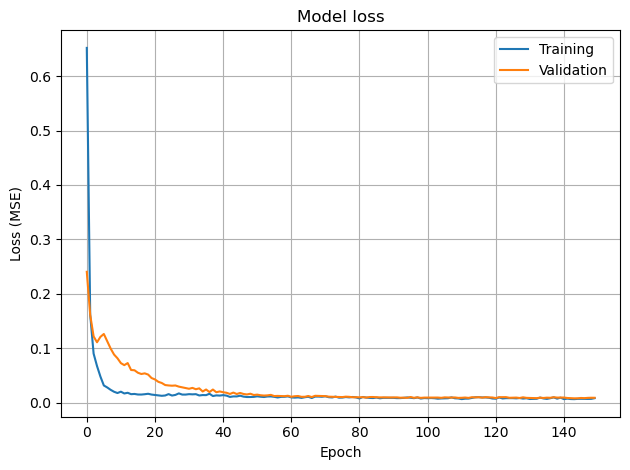

In [44]:

# summarize history for accuracy
# plt.figure()
# plt.grid()
# plt.plot(history.history['accuracy'])
# plt.plot(history.history['val_accuracy'])
# plt.title('model accuracy')
# plt.ylabel('accuracy')
# plt.xlabel('epoch')
# plt.legend(['train', 'test'], loc='upper left')
# plt.tight_layout()
# plt.savefig('autoencoder_learning_curve_accuracy.png', dpi=300)
# plt.show()

# summarize history for loss
plt.figure()
plt.grid()
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss (MSE)')
plt.xlabel('Epoch')
plt.legend(['Training', 'Validation'], loc='upper right')
plt.tight_layout()
plt.savefig('autoencoder_learning_curve_loss.png', dpi=300)
plt.show()

In [45]:
auto_encoder.encoder.save_weights("data/models/cd_encoder")